#Sine-Gordon

#Sine-Gordon random ini 1 soliton(run1)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-1, 1)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=1) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [2] + [500] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
'''
model.train(iterations=50000)

model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)
/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


Compiling model...
Building feed-forward neural network...
'build' took 0.108405 s

'compile' took 1.268084 s



'\nmodel.train(iterations=50000)\n\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

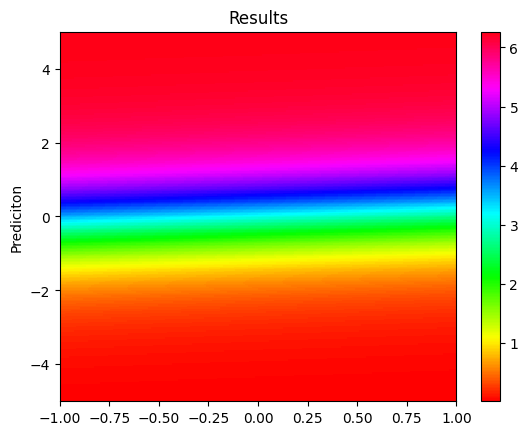

'\nx = np.linspace(-5, 5, 256)\nt = np.linspace(-1, 1, 256)\nX, T = np.meshgrid(x, t)\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\nreal=func(X_star)\nprediction=prediction-real\n#prediction=np.sqrt(prediction*prediction)\n\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Errors")\nax.set_ylabel("Prediciton - real value")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="hsv",\n    extent=[-1, 1, -5, 5],\n    origin="lower",\n    aspect="auto",\n)\nfig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)\nplt.show()\n'

In [ ]:
def func(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v= 1.0 , 0.2
    gamma = 1/(1-v**2)
    delt=0

    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = func(X_star)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)
X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''

In [ ]:
#!mkdir /content/drive/MyDrive/trained_models/sine-gordon/random-ini/1

Compiling model...
'compile' took 1.011993 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.10e-05, 1.44e+01, 1.06e-01]    [1.10e-05, 1.44e+01, 1.06e-01]    [1.04e+00]    
858       [2.85e-08, 2.19e-08, 1.48e-08]    [2.85e-08, 2.19e-08, 1.48e-08]    [9.01e-03]    

Best model at step 858:
  train loss: 6.52e-08
  test loss: 6.52e-08
  test metric: [9.01e-03]

Epoch 858: saving model to /content/drive/MyDrive/trained_models/sine-gordon/random-ini/1/model.ckpt-858.ckpt ...

'train' took 756.079773 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


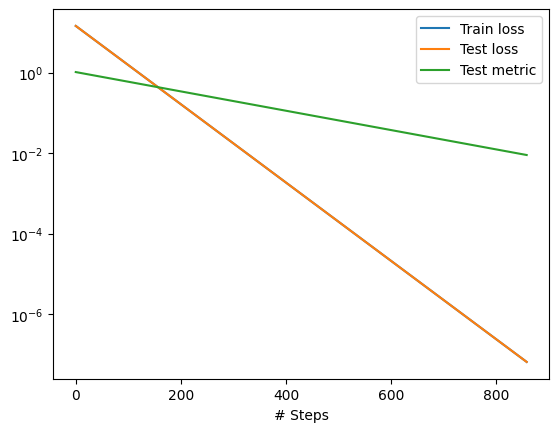

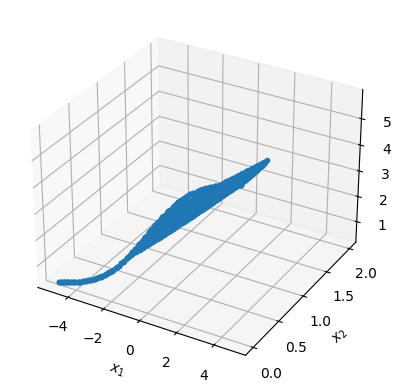

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon/random-ini/1/model.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

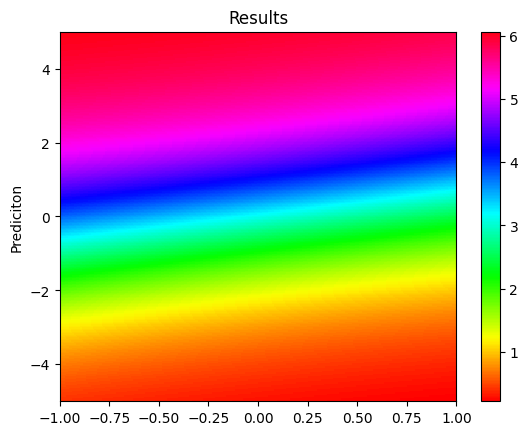

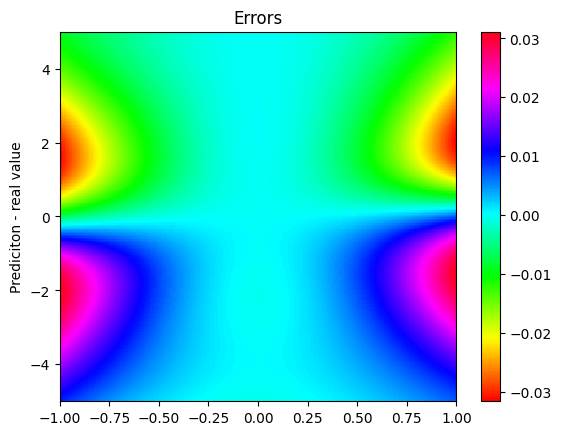

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#Sine-Gordon random ini 1 soliton(run2)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-1, 1)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=1) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [2] + [500] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
'''
model.train(iterations=50000)

model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)


Compiling model...
Building feed-forward neural network...


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'build' took 0.328454 s

'compile' took 2.059966 s



'\nmodel.train(iterations=50000)\n\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

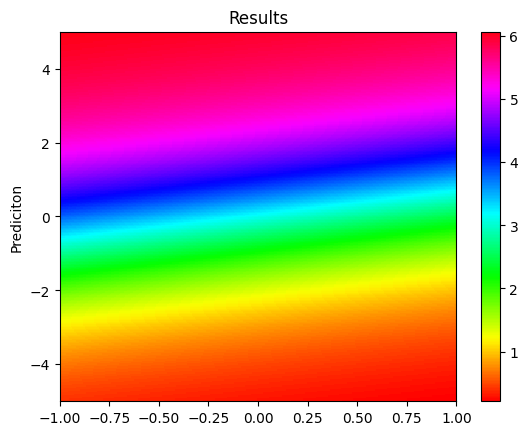

'\nx = np.linspace(-5, 5, 256)\nt = np.linspace(-1, 1, 256)\nX, T = np.meshgrid(x, t)\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\nreal=func(X_star)\nprediction=prediction-real\n#prediction=np.sqrt(prediction*prediction)\n\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Errors")\nax.set_ylabel("Prediciton - real value")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="hsv",\n    extent=[-1, 1, -5, 5],\n    origin="lower",\n    aspect="auto",\n)\nfig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)\nplt.show()\n'

In [ ]:
def func(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v= 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = func(X_star)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)
X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon/random-ini/2

Compiling model...
'compile' took 1.773005 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.18e-05, 1.35e+01, 1.74e-01]    [1.18e-05, 1.35e+01, 1.74e-01]    [9.96e-01]    
963       [1.00e-07, 3.82e-08, 2.55e-08]    [1.00e-07, 3.82e-08, 2.55e-08]    [9.01e-03]    

Best model at step 963:
  train loss: 1.64e-07
  test loss: 1.64e-07
  test metric: [9.01e-03]

Epoch 963: saving model to /content/drive/MyDrive/trained_models/sine-gordon/random-ini/2/model.ckpt-963.ckpt ...

'train' took 1419.548486 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


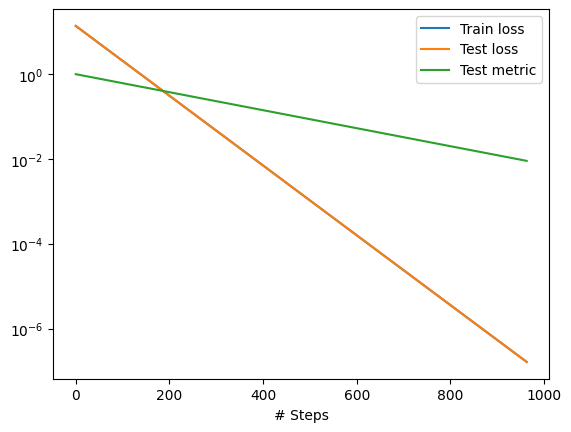

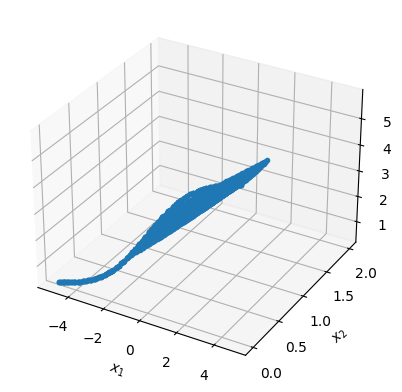

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon/random-ini/2/model.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

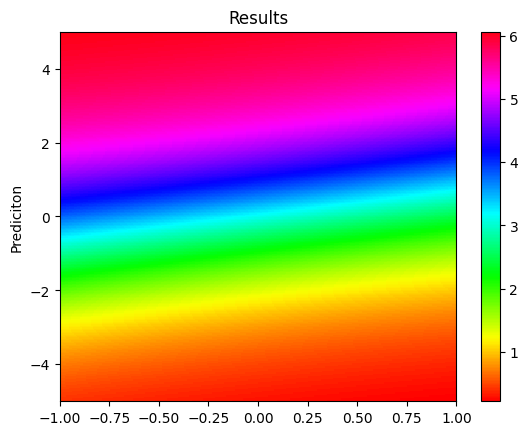

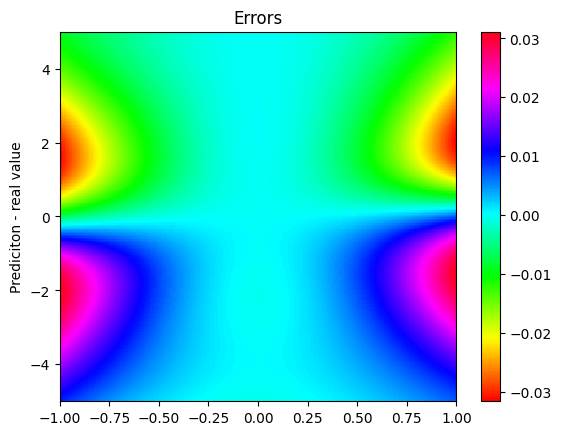

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#Sine-Gordon transfer learning 1 soliton(run1)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-1, 1)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=1) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [2] + [500] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(model_restore_path="/content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/1/model.ckpt-463.ckpt", iterations=0)
'''
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)
/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


Compiling model...
Building feed-forward neural network...
'build' took 0.135428 s

'compile' took 1.970287 s

Restoring model from /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/1/model.ckpt-463.ckpt ...

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.53e-08, 1.01e-07, 6.62e-08]    [9.53e-08, 1.01e-07, 6.62e-08]    [8.99e-03]    

Best model at step 0:
  train loss: 2.63e-07
  test loss: 2.63e-07
  test metric: [8.99e-03]

'train' took 8.124020 s



'\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

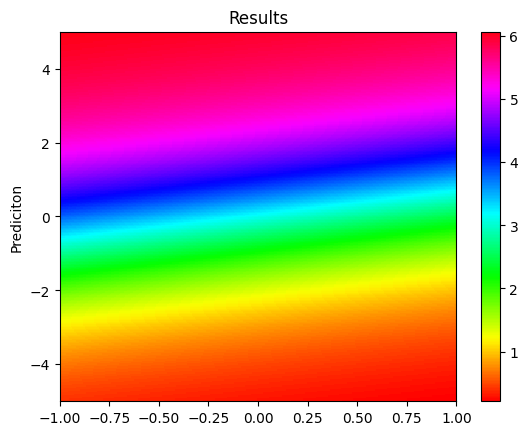

'\nx = np.linspace(-5, 5, 256)\nt = np.linspace(-1, 1, 256)\nX, T = np.meshgrid(x, t)\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\nreal=func(X_star)\nprediction=prediction-real\n#prediction=np.sqrt(prediction*prediction)\n\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Errors")\nax.set_ylabel("Prediciton - real value")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="hsv",\n    extent=[-1, 1, -5, 5],\n    origin="lower",\n    aspect="auto",\n)\nfig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)\nplt.show()\n'

In [ ]:
def func(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v= 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = func(X_star)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)
X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''

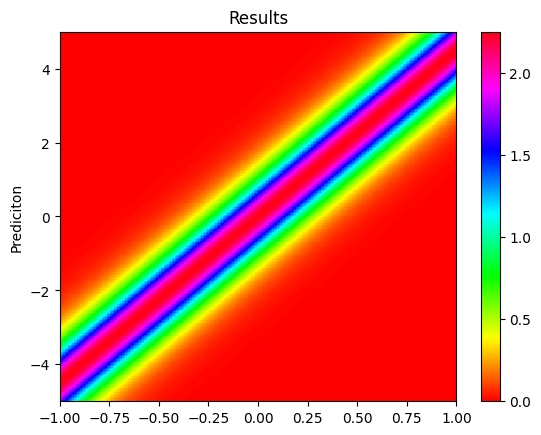

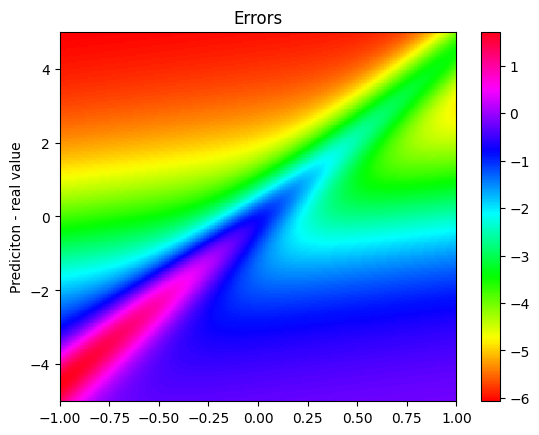

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/1

Compiling model...
'compile' took 1.475742 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [7.81e-06, 1.34e+01, 1.79e-01]    [7.81e-06, 1.34e+01, 1.79e-01]    [9.94e-01]    
463       [9.53e-08, 1.01e-07, 6.62e-08]    [9.53e-08, 1.01e-07, 6.62e-08]    [8.99e-03]    

Best model at step 463:
  train loss: 2.63e-07
  test loss: 2.63e-07
  test metric: [8.99e-03]

Epoch 463: saving model to /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/1/model.ckpt-463.ckpt ...

'train' took 642.977616 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


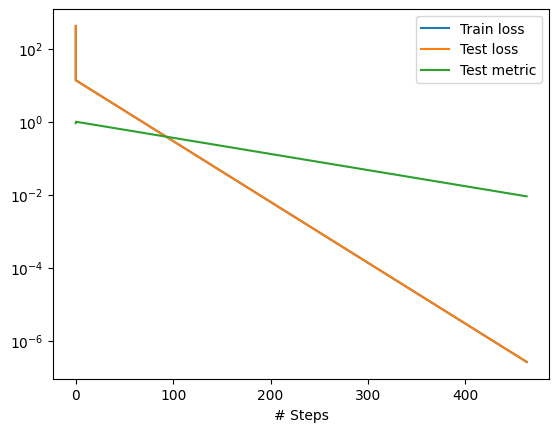

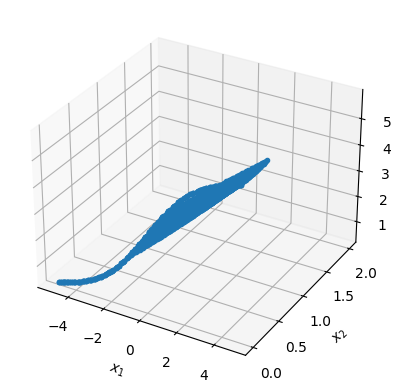

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/1/model.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

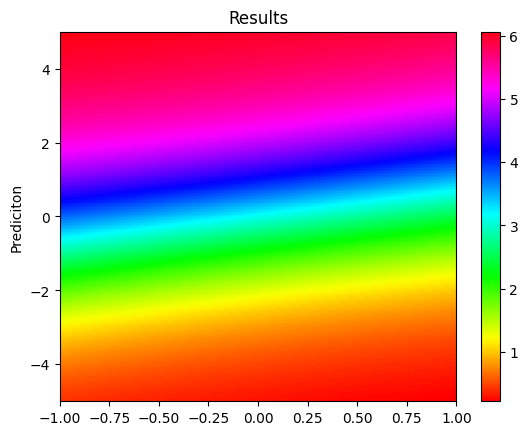

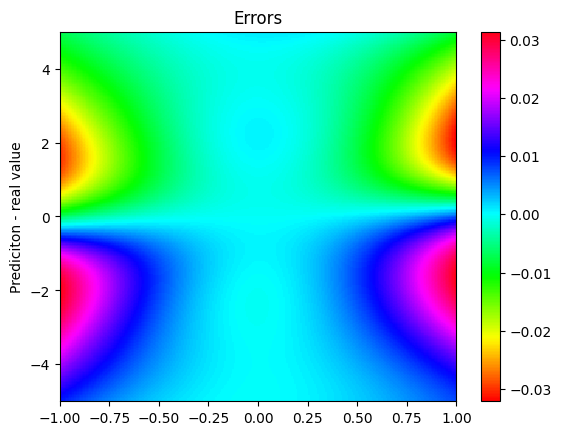

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#Sine-gordon 1 soliton transfer learning (run2)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-1, 1)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=1) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [2] + [500] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)


'''
model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(model_restore_path="/content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/1/model.ckpt-463.ckpt", iterations=0)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)


'\nmodel.compile(\n    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)\n)\n\nmodel.train(model_restore_path="/content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/1/model.ckpt-463.ckpt", iterations=0)\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

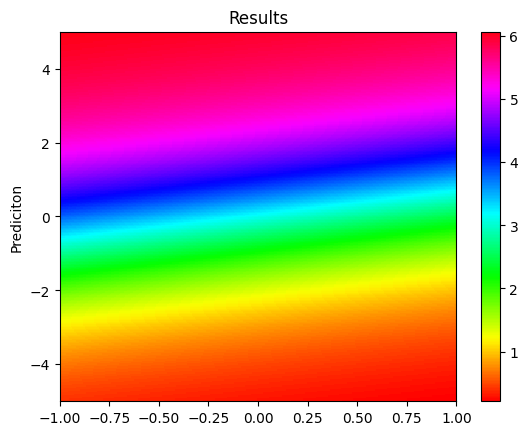

'\nx = np.linspace(-5, 5, 256)\nt = np.linspace(-1, 1, 256)\nX, T = np.meshgrid(x, t)\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\nreal=func(X_star)\nprediction=prediction-real\n#prediction=np.sqrt(prediction*prediction)\n\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Errors")\nax.set_ylabel("Prediciton - real value")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="hsv",\n    extent=[-1, 1, -5, 5],\n    origin="lower",\n    aspect="auto",\n)\nfig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)\nplt.show()\n'

In [ ]:
def func(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v= 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = func(X_star)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)
X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''

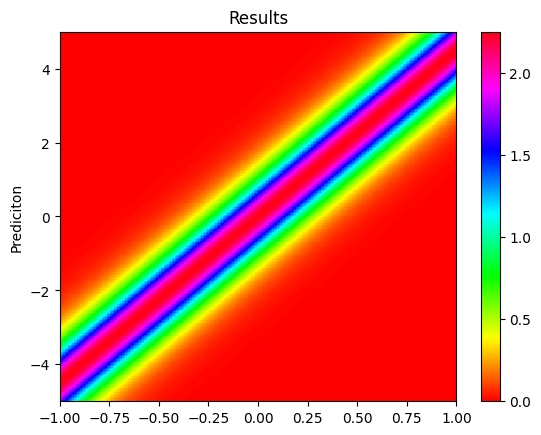

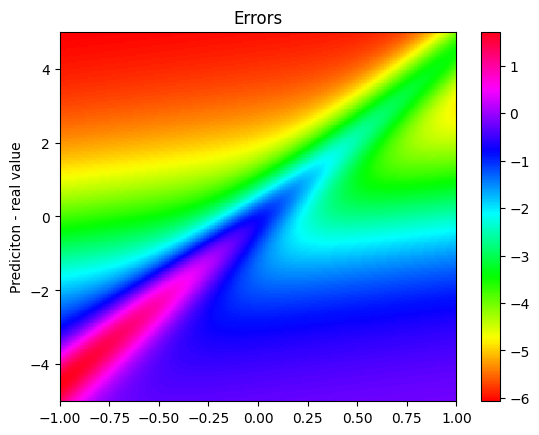

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/2

Compiling model...
Building feed-forward neural network...


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'build' took 0.308730 s

'compile' took 2.656069 s

Restoring model from /content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt ...

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.93e+02, 1.17e+01, 1.19e+01]    [3.93e+02, 1.17e+01, 1.19e+01]    [9.10e-01]    
1000      [9.62e-08, 3.82e-08, 3.14e-08]    [9.62e-08, 3.82e-08, 3.14e-08]                  
1239      [4.58e-08, 1.88e-08, 9.56e-09]    [4.58e-08, 1.88e-08, 9.56e-09]    [9.12e-03]    

Best model at step 1239:
  train loss: 7.42e-08
  test loss: 7.42e-08
  test metric: [9.12e-03]

Epoch 1239: saving model to /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/2/model.ckpt-1239.ckpt ...

'train' took 1863.205093 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


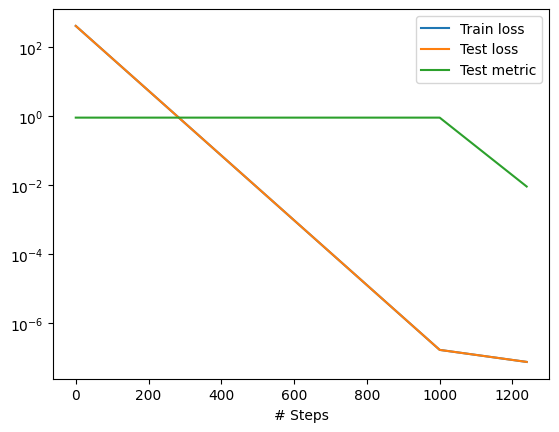

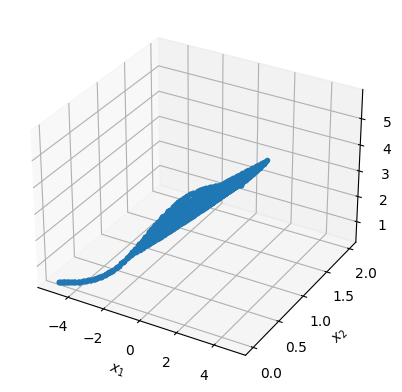

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_restore_path="/content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt", model_save_path="/content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/2/model.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

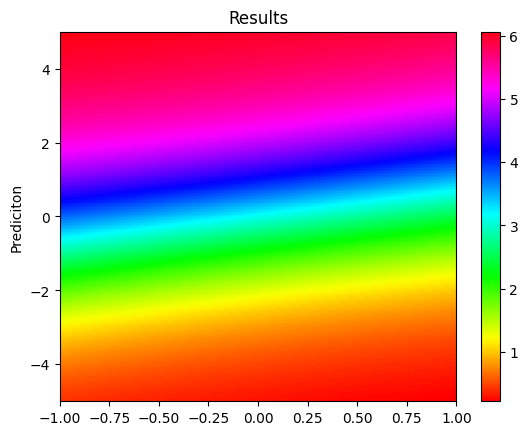

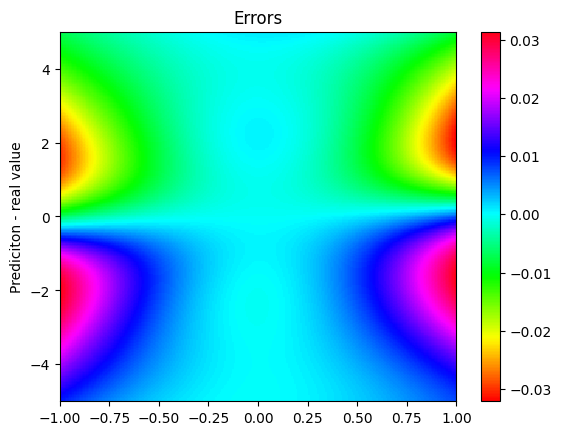

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#Sine-gordon 1 soliton transfer learning (run3)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-1, 1)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=1) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [2] + [500] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)



model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(model_restore_path="/content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt", iterations=0)
'''
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)
/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


Compiling model...
Building feed-forward neural network...
'build' took 0.116769 s

'compile' took 1.646958 s

Restoring model from /content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt ...

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.93e+02, 1.17e+01, 1.19e+01]    [3.93e+02, 1.17e+01, 1.19e+01]    [9.10e-01]    

Best model at step 0:
  train loss: 4.17e+02
  test loss: 4.17e+02
  test metric: [9.10e-01]

'train' took 12.268355 s



'\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

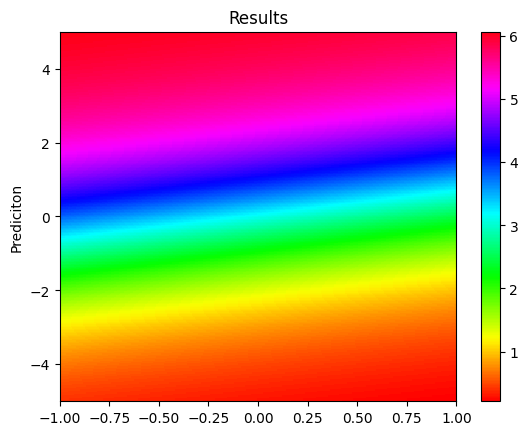

'\nx = np.linspace(-5, 5, 256)\nt = np.linspace(-1, 1, 256)\nX, T = np.meshgrid(x, t)\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\nreal=func(X_star)\nprediction=prediction-real\n#prediction=np.sqrt(prediction*prediction)\n\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Errors")\nax.set_ylabel("Prediciton - real value")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="hsv",\n    extent=[-1, 1, -5, 5],\n    origin="lower",\n    aspect="auto",\n)\nfig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)\nplt.show()\n'

In [ ]:
def func(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v= 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = func(X_star)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)
X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''

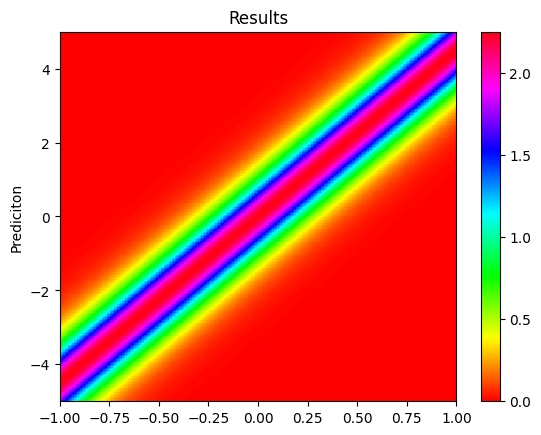

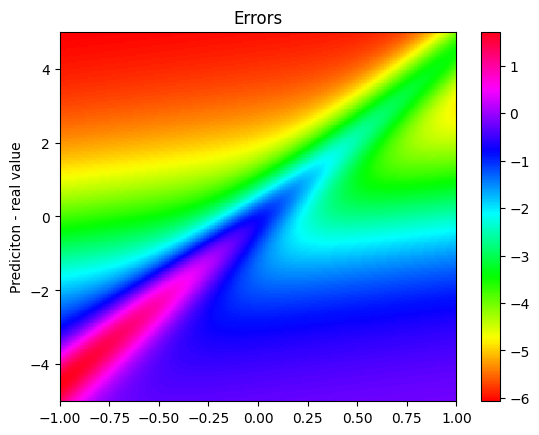

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/2

Compiling model...
'compile' took 1.768254 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.42e-04, 1.31e+01, 7.24e-02]    [2.42e-04, 1.31e+01, 7.24e-02]    [1.04e+00]    
845       [9.58e-08, 4.28e-08, 5.28e-08]    [9.58e-08, 4.28e-08, 5.28e-08]    [9.02e-03]    

Best model at step 845:
  train loss: 1.91e-07
  test loss: 1.91e-07
  test metric: [9.02e-03]

Epoch 845: saving model to /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/2/model.ckpt-845.ckpt ...

'train' took 726.474954 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


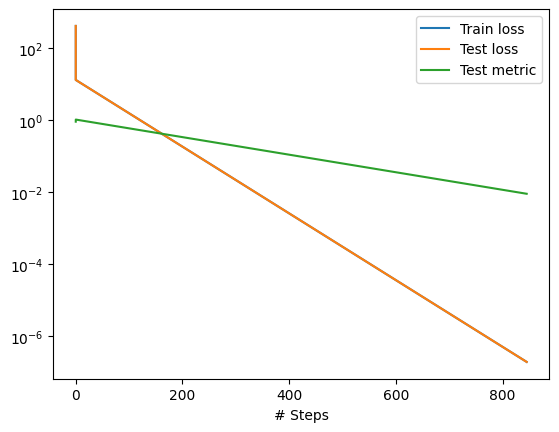

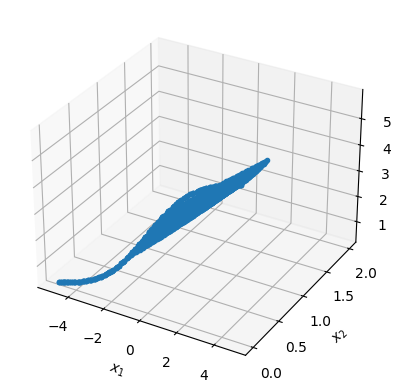

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/2/model.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

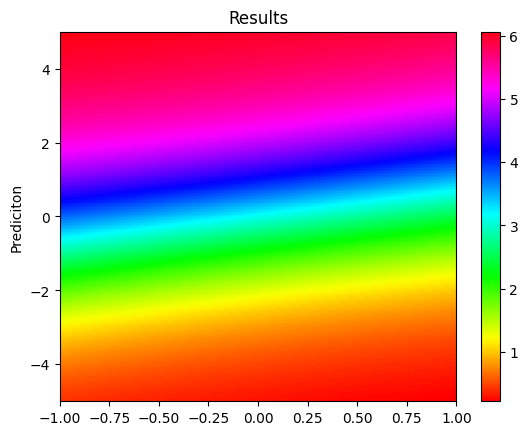

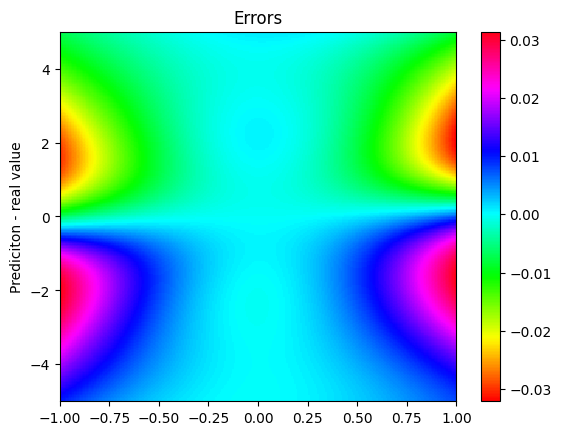

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#Sine-gordon 1 soliton transfer learning (run4)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-1, 1)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=1) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [2] + [500] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)


'''
model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(model_restore_path="/content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt", iterations=0)

model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)


'\nmodel.compile(\n    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)\n)\n\nmodel.train(model_restore_path="/content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt", iterations=0)\n\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

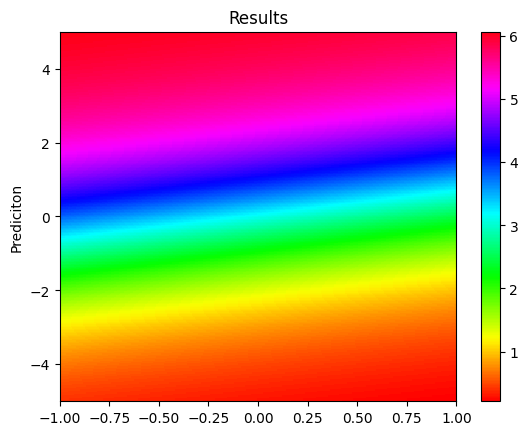

'\nx = np.linspace(-5, 5, 256)\nt = np.linspace(-1, 1, 256)\nX, T = np.meshgrid(x, t)\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\nreal=func(X_star)\nprediction=prediction-real\n#prediction=np.sqrt(prediction*prediction)\n\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Errors")\nax.set_ylabel("Prediciton - real value")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="hsv",\n    extent=[-1, 1, -5, 5],\n    origin="lower",\n    aspect="auto",\n)\nfig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)\nplt.show()\n'

In [ ]:
def func(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v= 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = func(X_star)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)
X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''

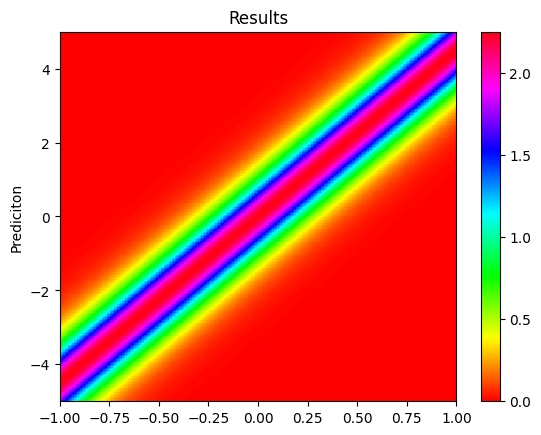

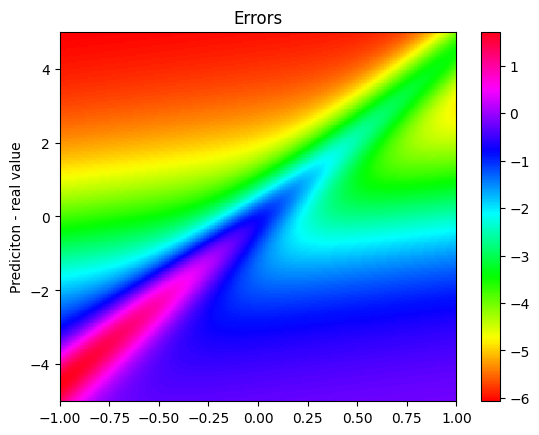

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/4

Compiling model...
Building feed-forward neural network...
'build' took 0.162982 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.359401 s

Restoring model from /content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt ...

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.93e+02, 1.17e+01, 1.19e+01]    [3.93e+02, 1.17e+01, 1.19e+01]    [9.10e-01]    
1000      [1.23e-07, 2.62e-08, 8.76e-09]    [1.23e-07, 2.62e-08, 8.76e-09]                  
1262      [8.48e-08, 2.01e-08, 1.01e-08]    [8.48e-08, 2.01e-08, 1.01e-08]    [9.14e-03]    

Best model at step 1262:
  train loss: 1.15e-07
  test loss: 1.15e-07
  test metric: [9.14e-03]

Epoch 1262: saving model to /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/4/model.ckpt-1262.ckpt ...

'train' took 944.201536 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


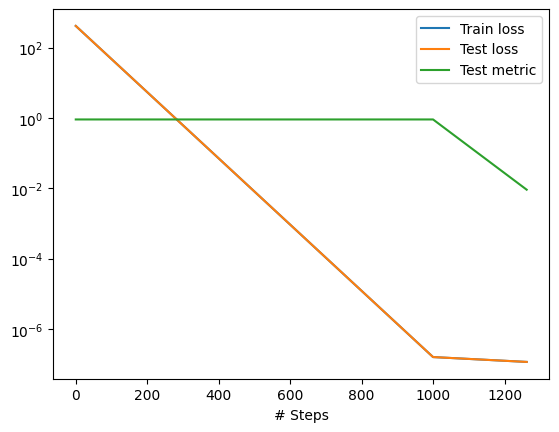

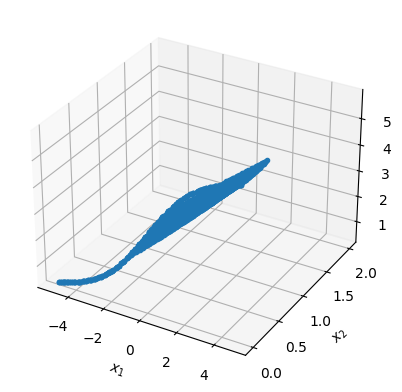

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_restore_path="/content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt" ,model_save_path="/content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/4/model.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

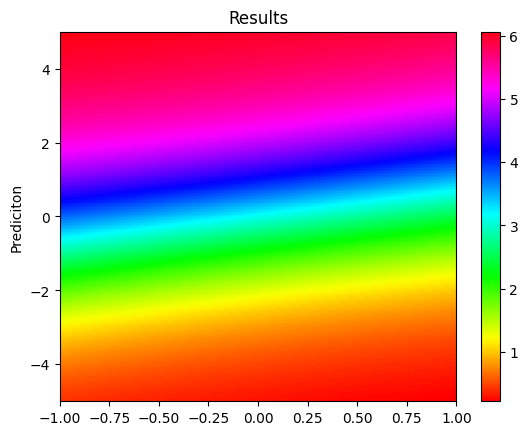

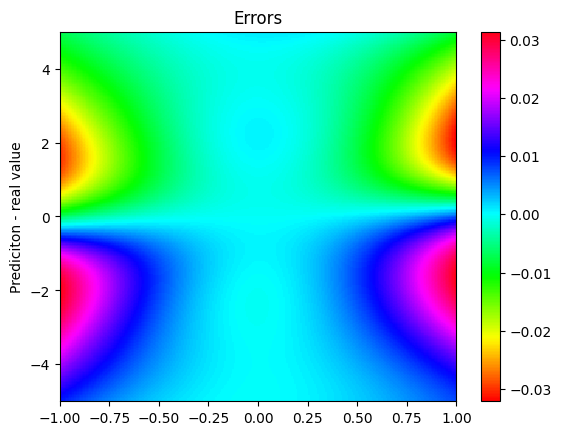

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#Sine-Gordon transfer learning 1 soliton(run1)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-1, 1)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=1) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [2] + [500] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(model_restore_path="/content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt", iterations=0)
'''
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)


Compiling model...
Building feed-forward neural network...
'build' took 0.197323 s


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(



'compile' took 2.468278 s

Restoring model from /content/drive/MyDrive/trained_models/transfer_learning/1_soliton_500-5_second_L-BFGS.ckpt-4951.ckpt ...

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.93e+02, 1.17e+01, 1.19e+01]    [3.93e+02, 1.17e+01, 1.19e+01]    [9.10e-01]    

Best model at step 0:
  train loss: 4.17e+02
  test loss: 4.17e+02
  test metric: [9.10e-01]

'train' took 9.703195 s



'\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

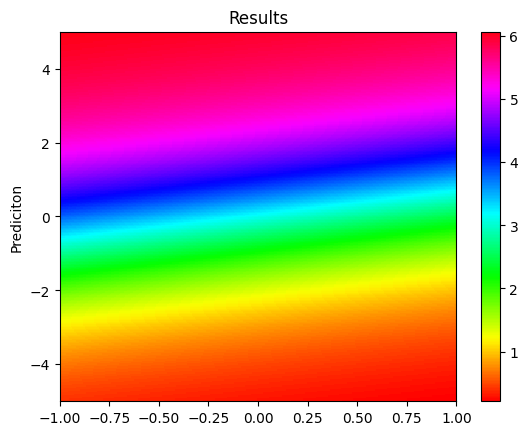

'\nx = np.linspace(-5, 5, 256)\nt = np.linspace(-1, 1, 256)\nX, T = np.meshgrid(x, t)\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\nreal=func(X_star)\nprediction=prediction-real\n#prediction=np.sqrt(prediction*prediction)\n\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Errors")\nax.set_ylabel("Prediciton - real value")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="hsv",\n    extent=[-1, 1, -5, 5],\n    origin="lower",\n    aspect="auto",\n)\nfig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)\nplt.show()\n'

In [ ]:
def func(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v= 0.3, 0.65
    gamma = 1/(1-v**2)
    delt=0

    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = func(X_star)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)
X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()
'''

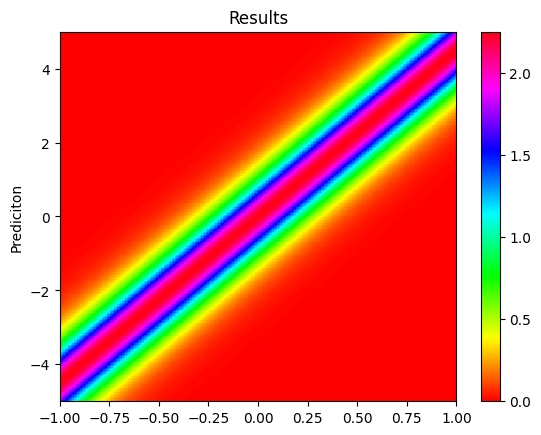

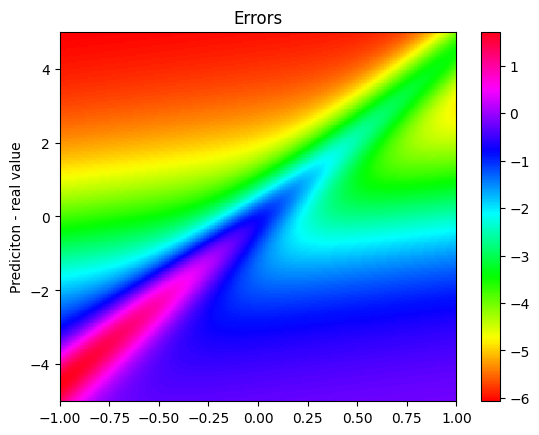

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/5

Compiling model...
'compile' took 1.229296 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.60e-05, 1.38e+01, 2.35e-01]    [1.60e-05, 1.38e+01, 2.35e-01]    [9.80e-01]    
596       [6.48e-08, 8.94e-08, 4.18e-08]    [6.48e-08, 8.94e-08, 4.18e-08]    [9.00e-03]    

Best model at step 596:
  train loss: 1.96e-07
  test loss: 1.96e-07
  test metric: [9.00e-03]

Epoch 596: saving model to /content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/5/model.ckpt-596.ckpt ...

'train' took 487.255628 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


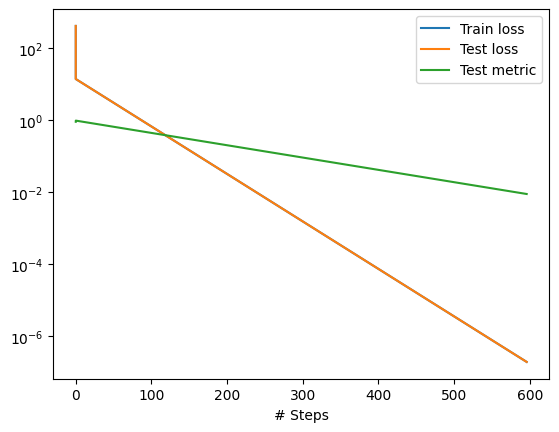

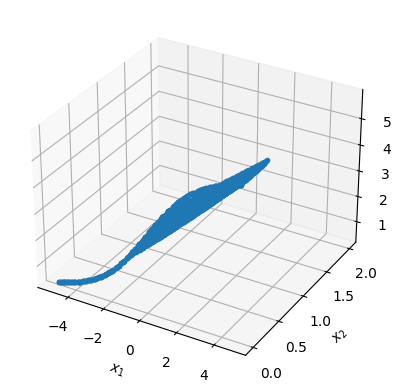

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon/transfer_learning/5/model.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

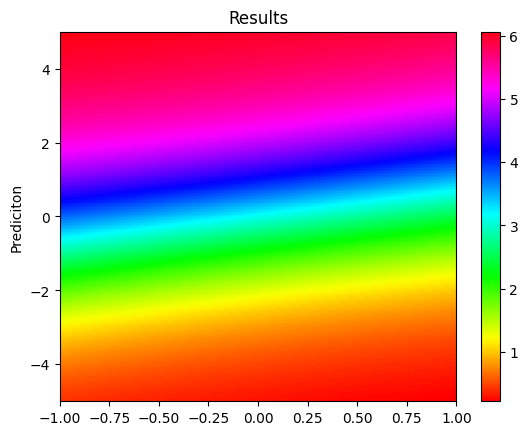

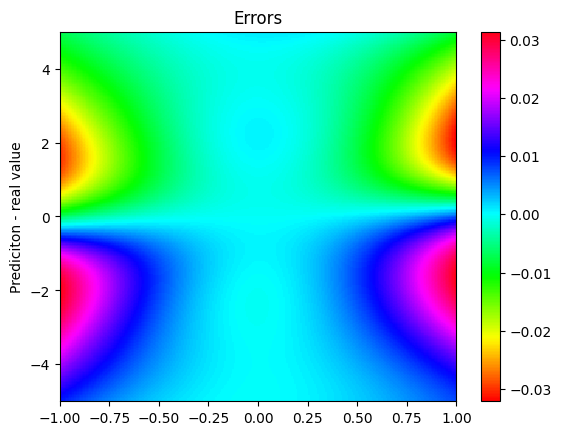

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#Sine-Gordon coeficiente variável

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/1

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [500] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/1/model.ckpt")


/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)


Compiling model...
Building feed-forward neural network...
'build' took 0.181285 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.989631 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.14e-03, 1.47e+01, 9.53e-02]    [1.14e-03, 1.47e+01, 9.53e-02]    [1.03e+00]    
1000      [6.74e-04, 1.95e-06, 1.82e-06]    [6.74e-04, 1.95e-06, 1.82e-06]    [1.06e-01]    
2000      [5.74e-04, 3.33e-06, 7.26e-07]    [5.74e-04, 3.33e-06, 7.26e-07]    [1.09e-01]    
3000      [4.19e-04, 8.79e-06, 1.79e-06]    [4.19e-04, 8.79e-06, 1.79e-06]    [1.03e-01]    
4000      [3.60e-04, 1.47e-02, 2.67e-05]    [3.60e-04, 1.47e-02, 2.67e-05]    [1.31e-01]    
5000      [1.55e-04, 1.03e-04, 1.12e-06]    [1.55e-04, 1.03e-04, 1.12e-06]    [1.01e-01]    
6000      [1.05e-04, 3.10e-05, 2.17e-07]    [1.05e-04, 3.10e-05, 2.17e-07]    [9.98e-02]    
7000      [1.36e-04, 2.59e-04, 2.87e-05]    [1.36e-04, 2.59e-04, 2.87e-05]    [8.90e-02]    
8000      [6.16e-05, 1.03e-05, 3.10e-05]    [6.16e-05, 1.03e-05, 3.10e-05]    [9.57e-02]    
9000      [4.70e-05, 4.1

In [ ]:
func(X_star_m)

array([[0.41600399],
       [0.42450214],
       [0.43317123],
       ...,
       [5.85001407],
       [5.85868316],
       [5.86718132]])

In [ ]:
X_star_m= np.concatenate((x1,m,t1), axis=1)
X_star_m

array([[-5.        ,  0.3       , -1.        ],
       [-4.96078431,  0.3       , -1.        ],
       [-4.92156863,  0.3       , -1.        ],
       ...,
       [ 4.92156863,  0.3       ,  1.        ],
       [ 4.96078431,  0.3       ,  1.        ],
       [ 5.        ,  0.3       ,  1.        ]])

array([[-1.],
       [-1.],
       [-1.],
       ...,
       [ 1.],
       [ 1.],
       [ 1.]])

In [ ]:
prediction = func(X_star)
prediction

X_star_m

array([[-5.        ,  0.3       , -1.        ],
       [-5.        ,  0.3       , -0.99215686],
       [-5.        ,  0.3       , -0.98431373],
       ...,
       [ 5.        ,  0.3       ,  0.98431373],
       [ 5.        ,  0.3       ,  0.99215686],
       [ 5.        ,  0.3       ,  1.        ]])

In [ ]:
X_star

x1,t1=np.split(X_star, 2, axis=1)

[[-1.]
 [-1.]
 [-1.]
 ...
 [ 1.]
 [ 1.]
 [ 1.]]


##script plotagem função 3 variaveis com uma delas fixa:

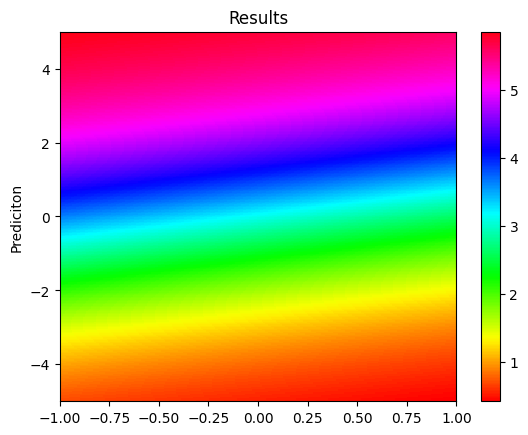

In [ ]:
def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))


x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.3
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)
prediction = func(X_star_m)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

##plotagem resultado treinamento Adam

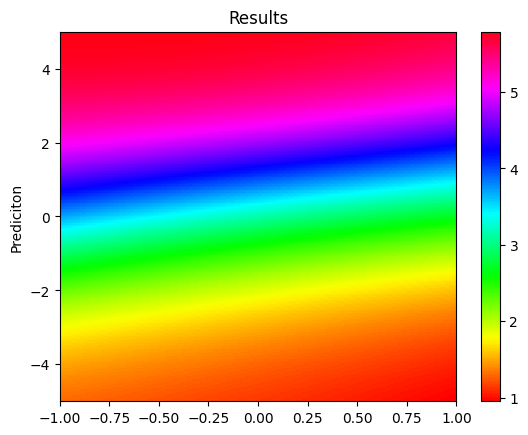

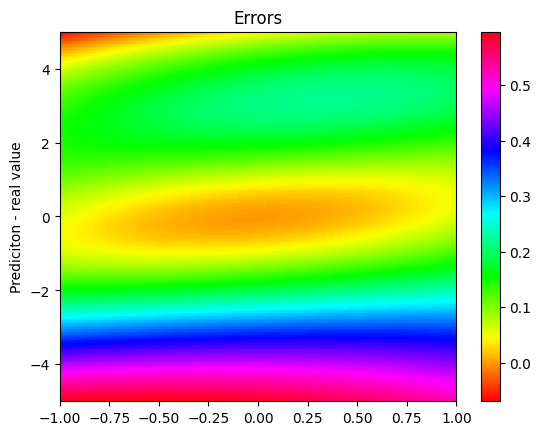

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.3
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

prediction = model.predict(X_star_m, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star_m, operator=None)
real=func(X_star_m)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

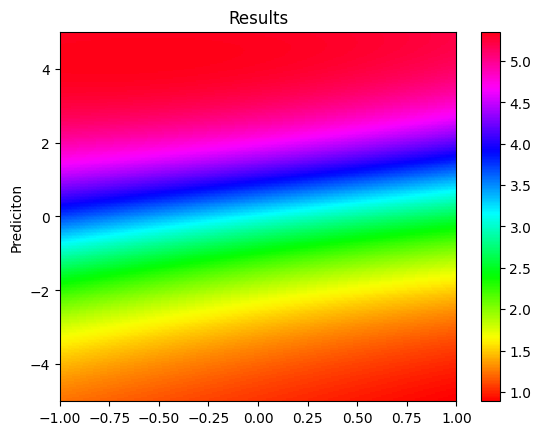

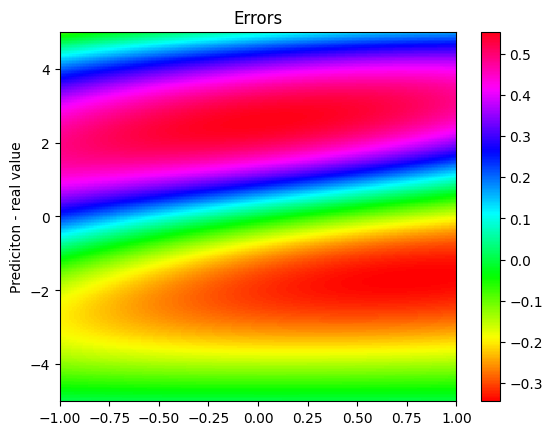

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.2
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

prediction = model.predict(X_star_m, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star_m, operator=None)
real=func(X_star_m)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

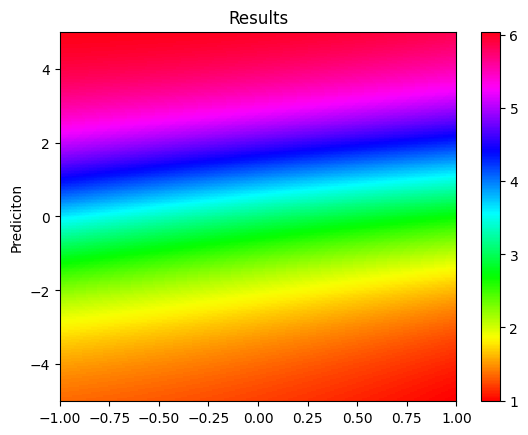

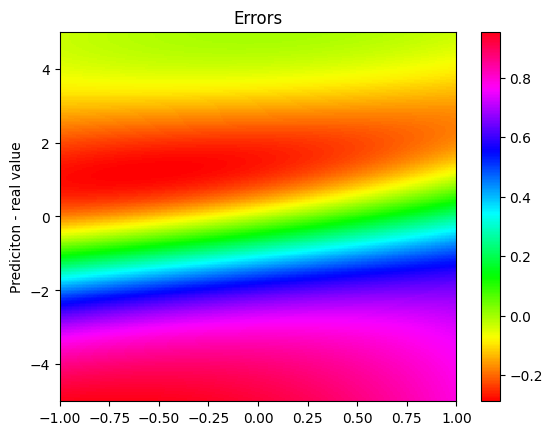

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.4
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

prediction = model.predict(X_star_m, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star_m, operator=None)
real=func(X_star_m)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

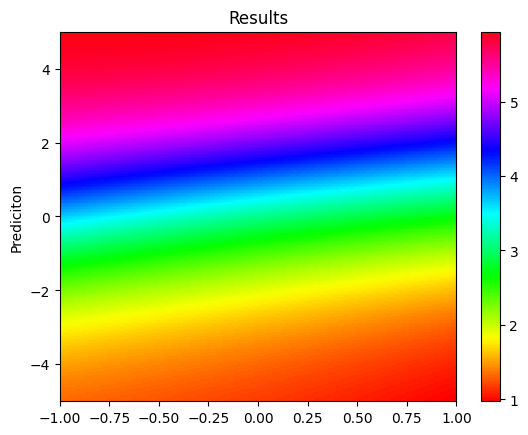

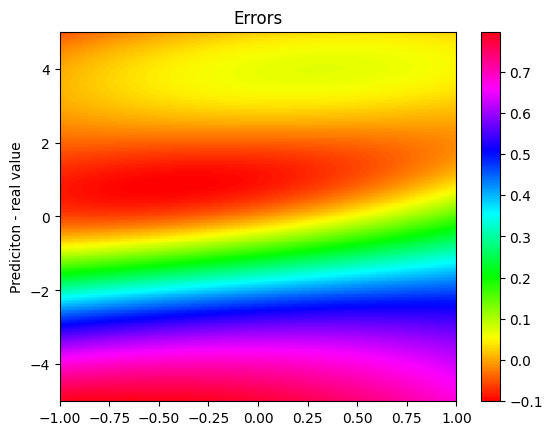

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.35
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

prediction = model.predict(X_star_m, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star_m, operator=None)
real=func(X_star_m)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

##Treinamento lbfgs e plotagem

Compiling model...
'compile' took 1.589239 s

Training model...

Step      Train loss                        Test loss                         Test metric   
20000     [1.29e-05, 2.86e-07, 2.60e-07]    [1.29e-05, 2.86e-07, 2.60e-07]    [8.01e-02]    
21000     [3.83e-07, 1.71e-08, 8.39e-09]    [3.83e-07, 1.71e-08, 8.39e-09]                  
22000     [9.81e-08, 1.03e-08, 4.08e-09]    [9.81e-08, 1.03e-08, 4.08e-09]                  
22120     [9.15e-08, 1.02e-08, 3.49e-09]    [9.15e-08, 1.02e-08, 3.49e-09]    [8.02e-02]    

Best model at step 22120:
  train loss: 1.05e-07
  test loss: 1.05e-07
  test metric: [8.02e-02]

Epoch 22120: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/1/model_lbfgs.ckpt-22120.ckpt ...

'train' took 3235.543771 s

Saving loss history to /content/drive/.shortcut-targets-by-id/10McNpxVfpOzj9gY2uFfO1oDCRrSzcSYW/trained_models/sine-gordon_variable/1/loss.dat ...
Saving training data to /content/drive/.shortcut-targets-by-id/10McNpxVfp

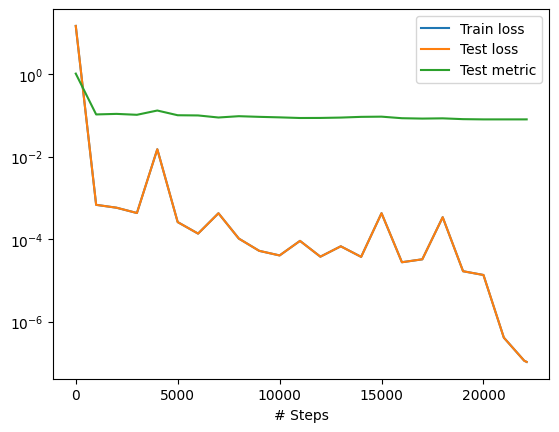

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/1/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

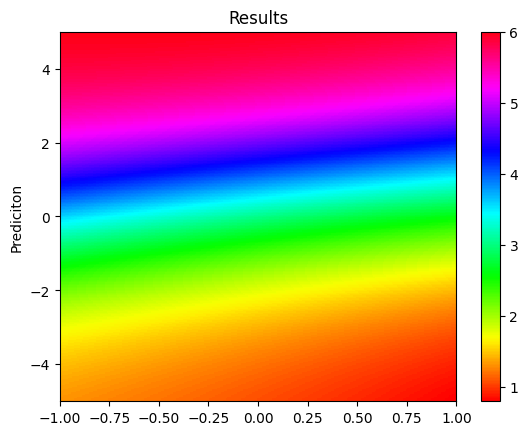

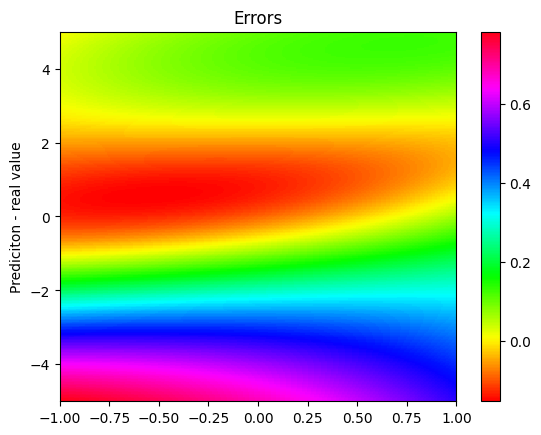

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.35
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

prediction = model.predict(X_star_m, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star_m, operator=None)
real=func(X_star_m)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

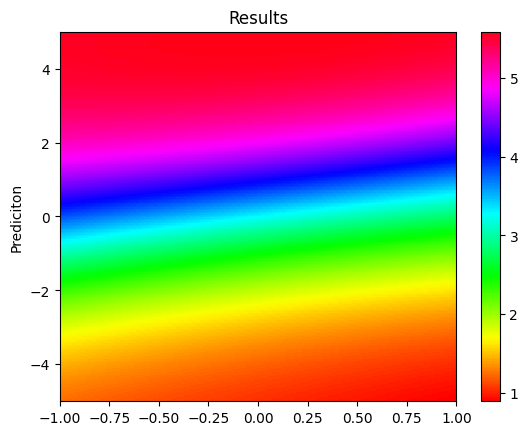

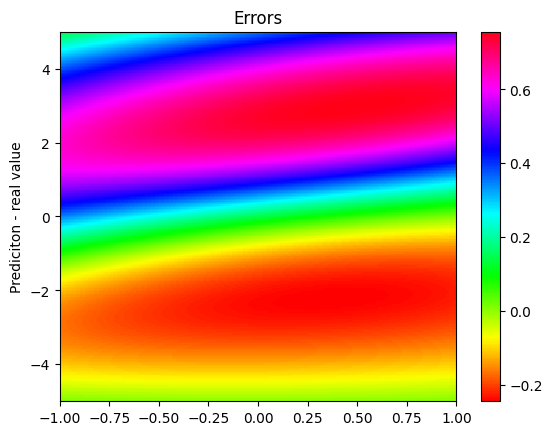

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.2
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

prediction = model.predict(X_star_m, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star_m, operator=None)
real=func(X_star_m)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

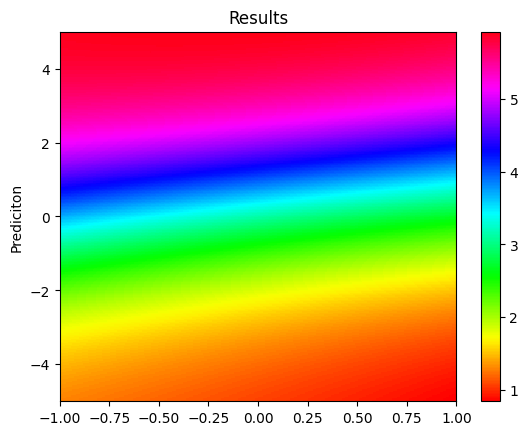

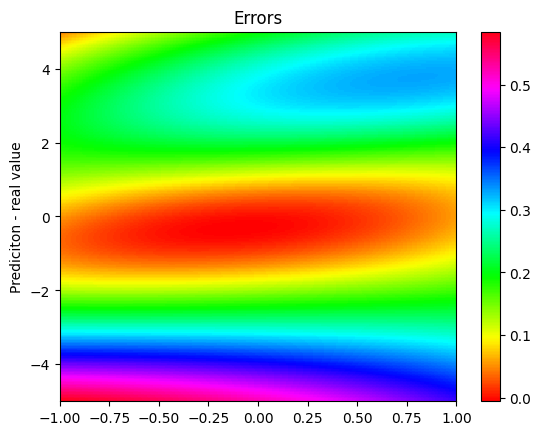

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.3
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

prediction = model.predict(X_star_m, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star_m, operator=None)
real=func(X_star_m)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

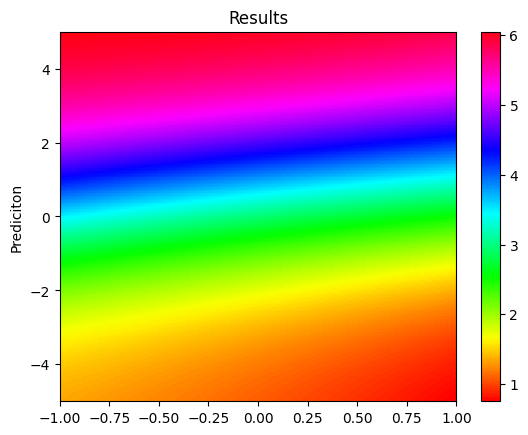

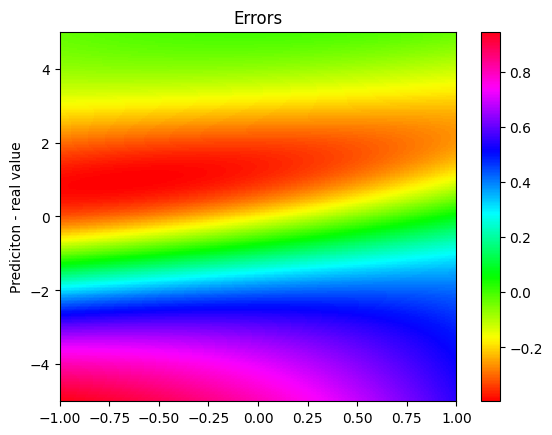

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
m= np.ones(65536)*0.4
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

prediction = model.predict(X_star_m, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star_m, operator=None)
real=func(X_star_m)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#Rede menos densa:

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/2

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sample = sampler.random(100)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(100))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [100] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=50000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/2/model.ckpt")


/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)


Compiling model...
Building feed-forward neural network...
'build' took 0.161071 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 2.067839 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.49e-04, 1.36e+01, 9.38e-02]    [1.49e-04, 1.36e+01, 9.38e-02]    [9.90e-01]    
1000      [7.30e-04, 8.75e-06, 2.19e-06]    [7.30e-04, 8.75e-06, 2.19e-06]    [1.12e-01]    
2000      [4.57e-04, 4.57e-06, 1.27e-06]    [4.57e-04, 4.57e-06, 1.27e-06]    [1.16e-01]    
3000      [2.80e-04, 3.30e-06, 1.25e-06]    [2.80e-04, 3.30e-06, 1.25e-06]    [1.21e-01]    
4000      [1.74e-04, 3.64e-06, 1.40e-06]    [1.74e-04, 3.64e-06, 1.40e-06]    [1.25e-01]    
5000      [1.25e-04, 1.85e-06, 7.17e-07]    [1.25e-04, 1.85e-06, 7.17e-07]    [1.26e-01]    
6000      [9.27e-05, 1.34e-06, 4.44e-07]    [9.27e-05, 1.34e-06, 4.44e-07]    [1.27e-01]    
7000      [7.28e-05, 1.05e-06, 4.02e-07]    [7.28e-05, 1.05e-06, 4.02e-07]    [1.26e-01]    
8000      [1.01e-04, 3.16e-03, 3.78e-05]    [1.01e-04, 3.16e-03, 3.78e-05]    [1.20e-01]    
9000      [4.45e-05, 6.0

m =  0.2 

 ####################################################


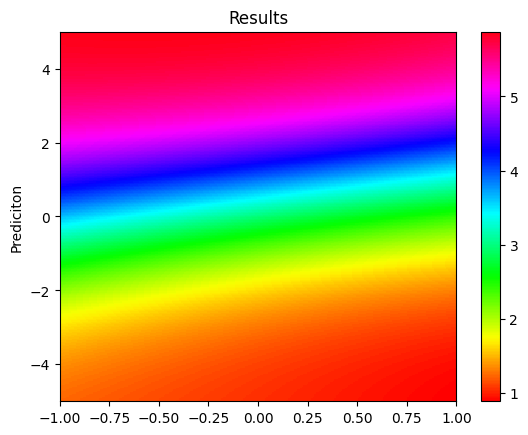

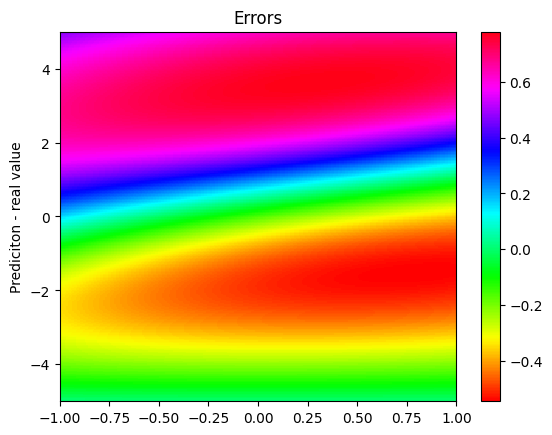

m =  0.25 

 ####################################################


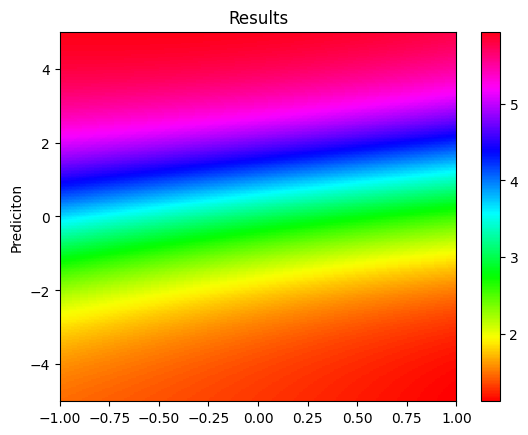

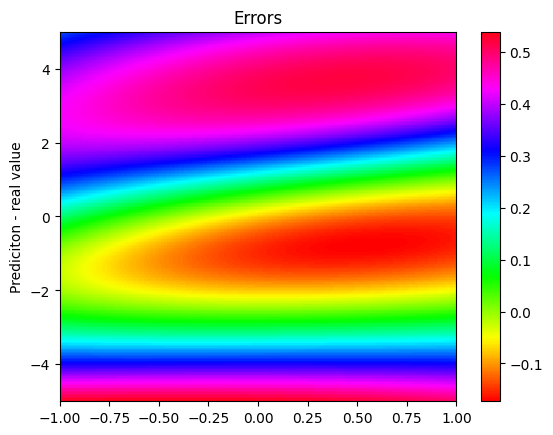

m =  0.3 

 ####################################################


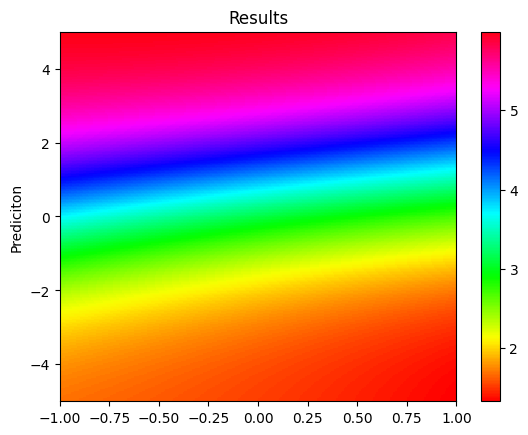

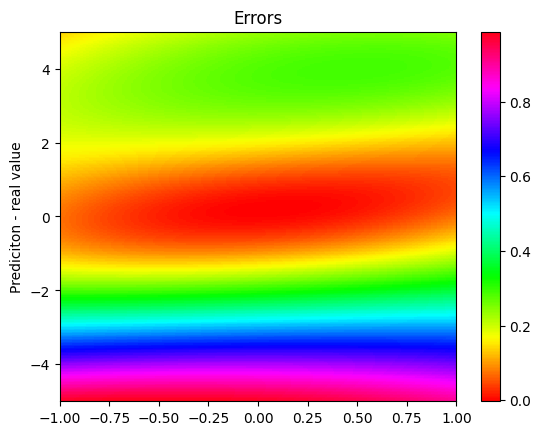

m =  0.35 

 ####################################################


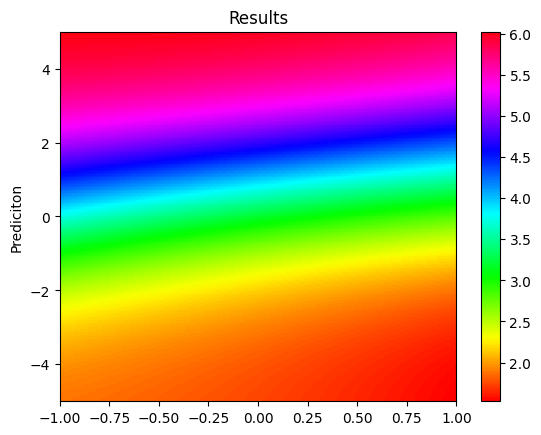

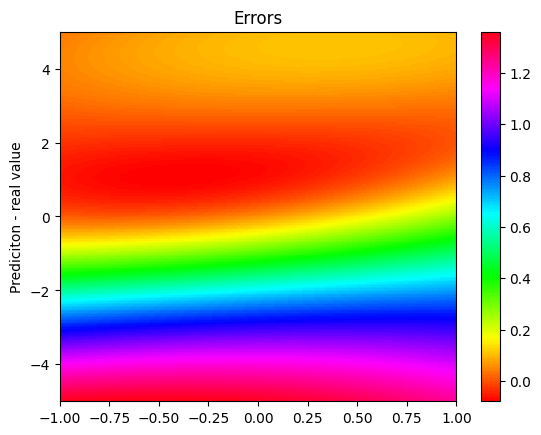

m =  0.4 

 ####################################################


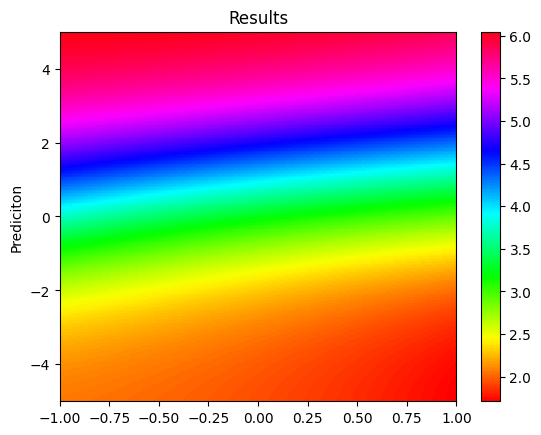

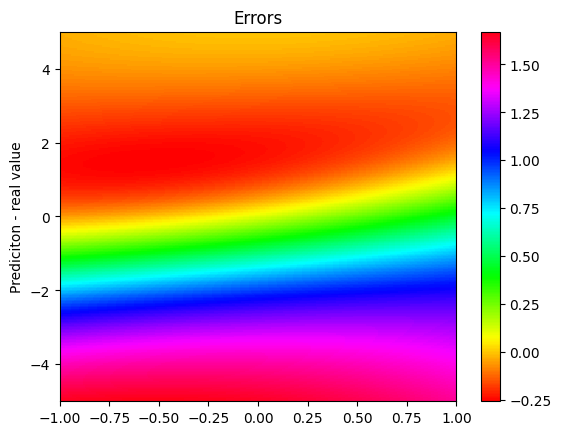

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

##diferente numero de pontos iniciais

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=200
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [100] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=50000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/2/model.ckpt")


/usr/local/lib/python3.10/dist-packages/scipy/stats/_qmc.py:804: UserWarning: The balance properties of Sobol' points require n to be a power of 2.
  sample = self._random(n, workers=workers)


Compiling model...
Building feed-forward neural network...
'build' took 0.127684 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 2.224535 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.34e-03, 1.32e+01, 1.01e-01]    [2.34e-03, 1.32e+01, 1.01e-01]    [9.71e-01]    
1000      [8.26e-04, 1.51e-05, 1.21e-05]    [8.26e-04, 1.51e-05, 1.21e-05]    [9.90e-02]    
2000      [4.57e-04, 2.02e-06, 4.73e-06]    [4.57e-04, 2.02e-06, 4.73e-06]    [1.02e-01]    
3000      [2.22e-04, 1.40e-06, 2.31e-06]    [2.22e-04, 1.40e-06, 2.31e-06]    [1.11e-01]    
4000      [1.22e-04, 9.38e-06, 8.93e-07]    [1.22e-04, 9.38e-06, 8.93e-07]    [1.17e-01]    
5000      [7.74e-05, 7.66e-07, 4.32e-07]    [7.74e-05, 7.66e-07, 4.32e-07]    [1.20e-01]    
6000      [6.33e-05, 5.23e-07, 2.82e-07]    [6.33e-05, 5.23e-07, 2.82e-07]    [1.19e-01]    
7000      [5.43e-05, 3.74e-07, 2.30e-07]    [5.43e-05, 3.74e-07, 2.30e-07]    [1.19e-01]    
8000      [5.16e-05, 6.93e-05, 4.78e-07]    [5.16e-05, 6.93e-05, 4.78e-07]    [1.20e-01]    
9000      [4.30e-05, 5.9


 m =  0.2 

 ####################################################


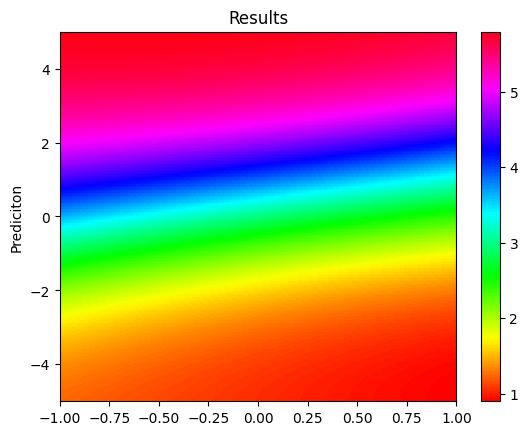

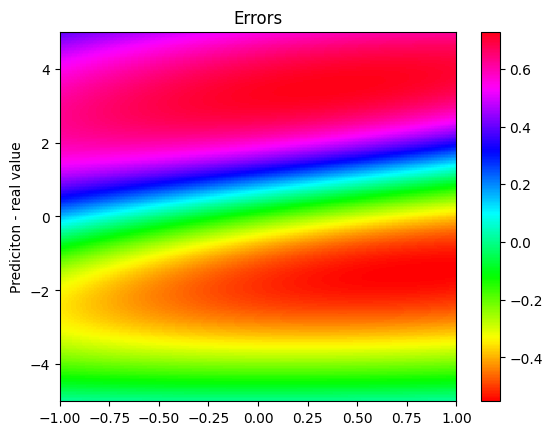


 m =  0.25 

 ####################################################


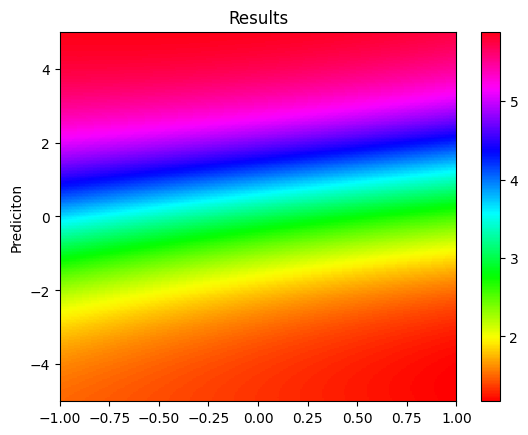

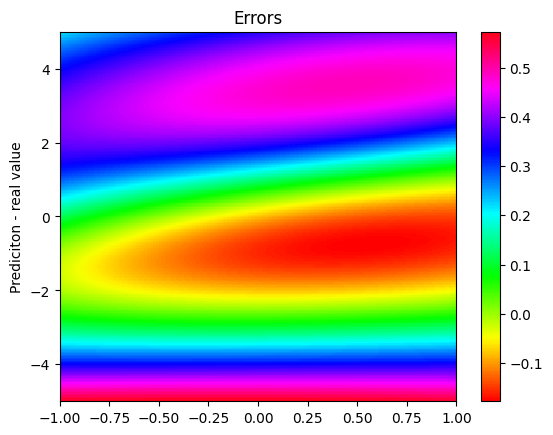


 m =  0.3 

 ####################################################


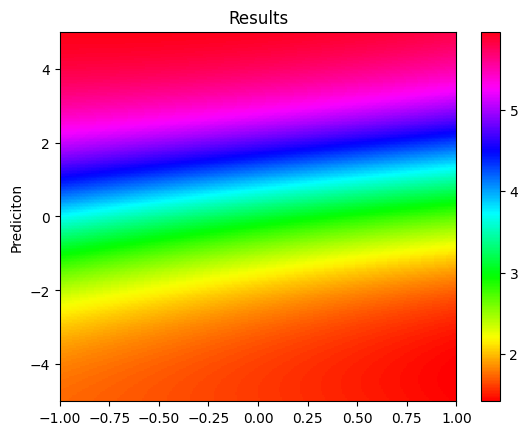

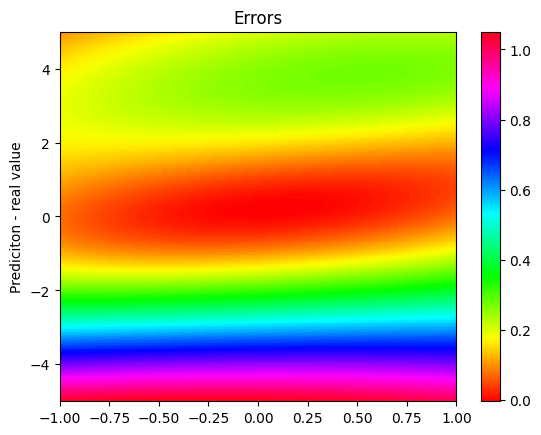


 m =  0.35 

 ####################################################


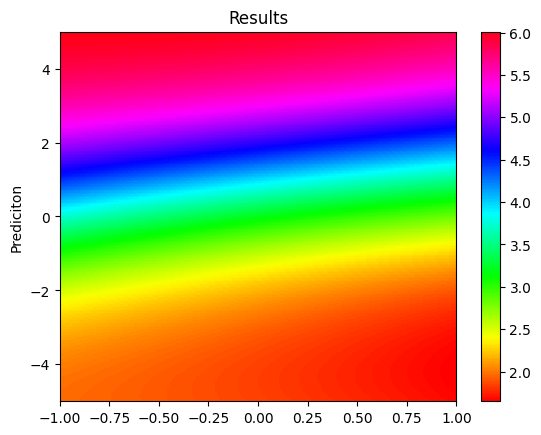

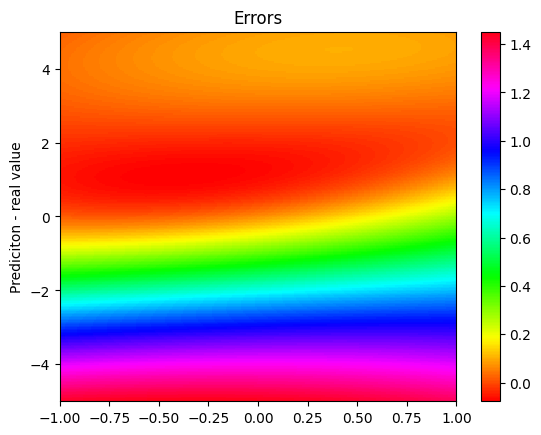


 m =  0.4 

 ####################################################


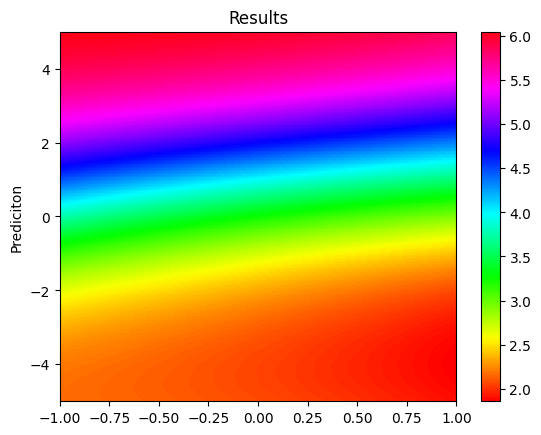

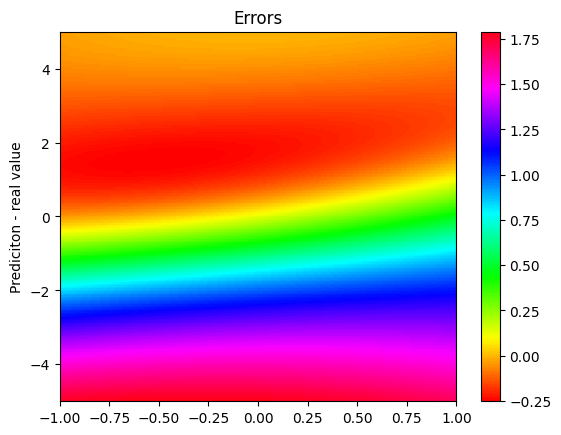

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

## 2x inicias e 2x ed

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=200
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=4000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [100] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/2/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.177687 s

'compile' took 2.088816 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.27e-03, 1.54e+01, 1.69e-01]    [1.27e-03, 1.54e+01, 1.69e-01]    [1.05e+00]    
1000      [8.18e-04, 3.85e-06, 1.11e-06]    [8.18e-04, 3.85e-06, 1.11e-06]    [1.03e-01]    
2000      [5.86e-04, 3.37e-06, 2.22e-06]    [5.86e-04, 3.37e-06, 2.22e-06]    [1.05e-01]    
3000      [3.58e-04, 1.43e-05, 2.26e-06]    [3.58e-04, 1.43e-05, 2.26e-06]    [1.10e-01]    
4000      [1.68e-04, 1.34e-06, 1.18e-06]    [1.68e-04, 1.34e-06, 1.18e-06]    [1.16e-01]    
5000      [9.57e-05, 1.98e-06, 5.15e-07]    [9.57e-05, 1.98e-06, 5.15e-07]    [1.18e-01]    
6000      [6.93e-05, 2.93e-05, 5.15e-07]    [6.93e-05, 2.93e-05, 5.15e-07]    [1.18e-01]    
7000      [4.84e-05, 6.17e-06, 1.94e-07]    [4.84e-05, 6.17e-06, 1.94e-07]    [1.20e-01]    
8000      [4.09e-05, 1.83e-06, 9.


 m =  0.2 

 ####################################################


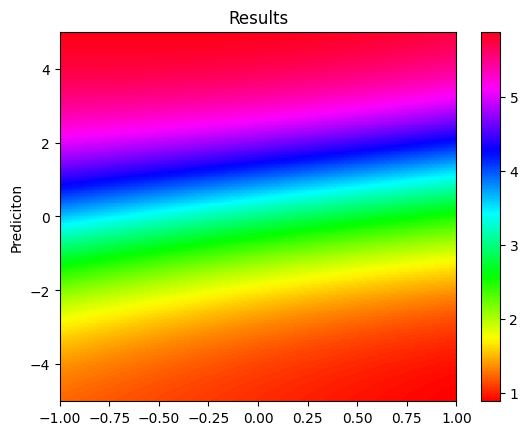

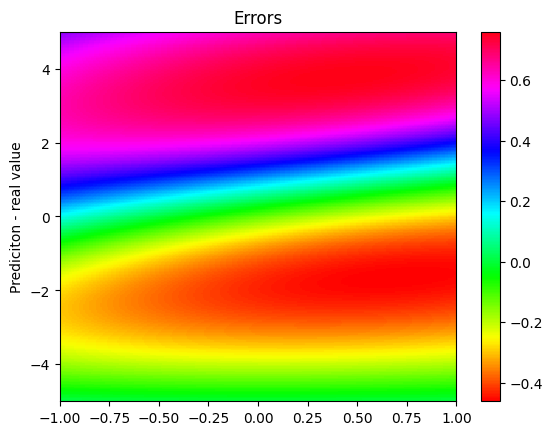


 m =  0.25 

 ####################################################


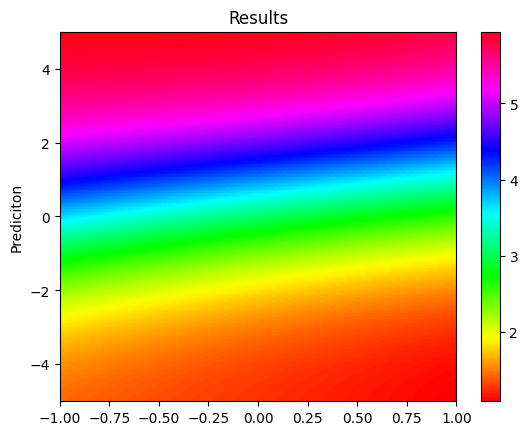

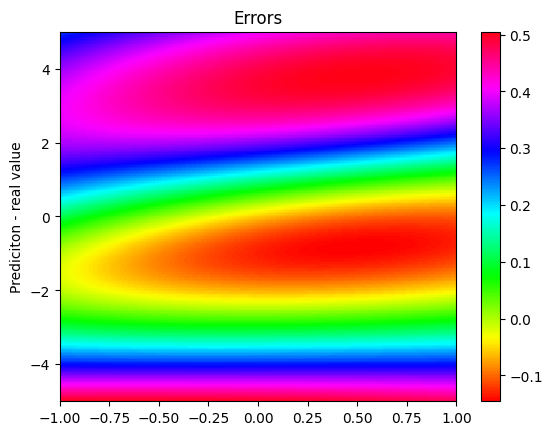


 m =  0.3 

 ####################################################


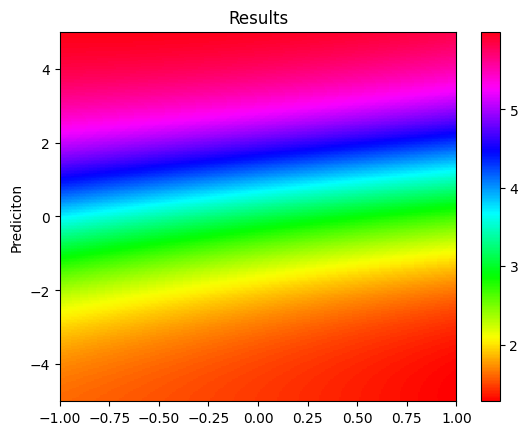

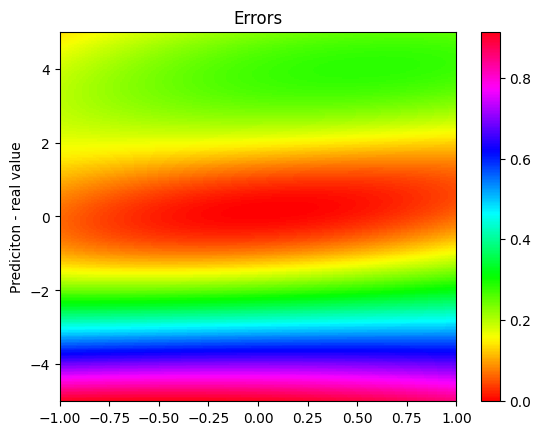


 m =  0.35 

 ####################################################


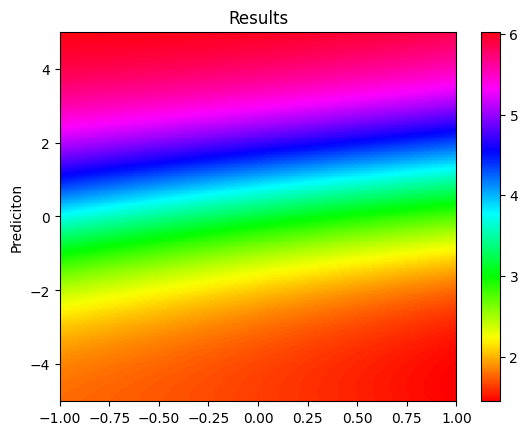

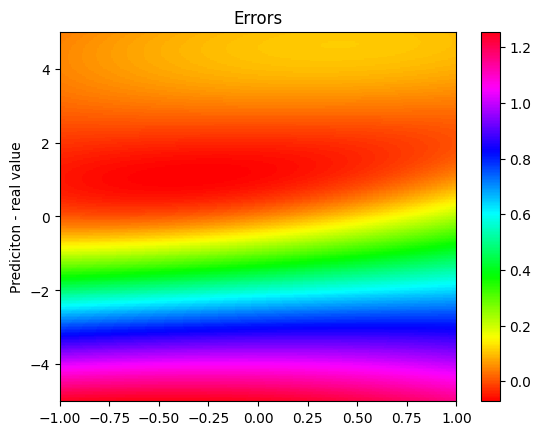


 m =  0.4 

 ####################################################


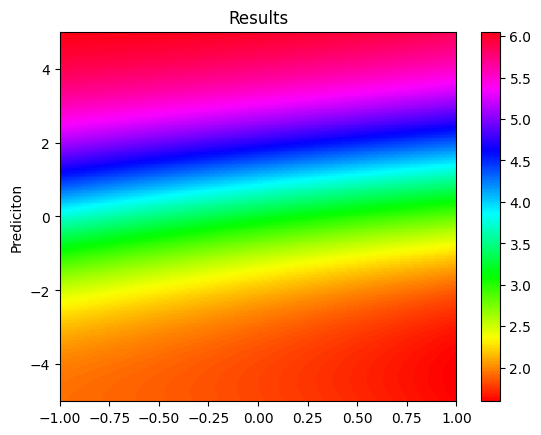

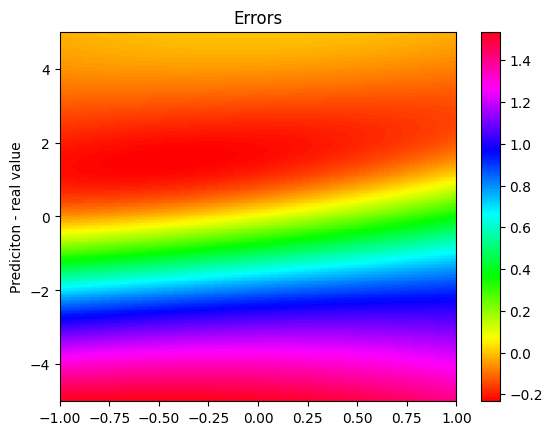

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

##test pontos

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=2
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=10,
    num_boundary=3,
    num_initial=4,
    solution=func,
    num_test=None,
    #anchors=X_anchors
)

layer_size = [3] + [100] * 5 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=1)#, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/2/model.ckpt")


[[ 5.          0.4         0.        ]
 [ 5.          0.4         0.        ]
 [ 0.          0.24000001 -1.        ]
 [-2.5         0.28       -1.        ]
 [ 2.5         0.32       -1.        ]
 [-3.75        0.36       -1.        ]
 [ 5.          0.4         0.        ]
 [ 0.0999999   0.2         0.5       ]
 [-0.09999943  0.4        -0.5       ]
 [ 0.          0.26666668 -0.8181818 ]
 [-2.5         0.33333334 -0.6363636 ]
 [ 2.5         0.22222222 -0.45454544]
 [-3.75        0.2888889  -0.27272725]
 [ 1.25        0.35555556 -0.09090906]
 [-1.25        0.24444444  0.09090912]
 [ 3.75        0.31111112  0.27272725]
 [-4.375       0.37777779  0.4545455 ]
 [ 0.625       0.20740741  0.6363636 ]
 [-1.875       0.27407408  0.8181819 ]] 
 (19, 3)
[[ 5.          0.4         0.        ]
 [ 5.          0.4         0.        ]
 [ 0.          0.24000001 -1.        ]
 [-2.5         0.28       -1.        ]
 [ 2.5         0.32       -1.        ]
 [-3.75        0.36       -1.        ]
 [ 5.         


 m =  0.2 

 ####################################################


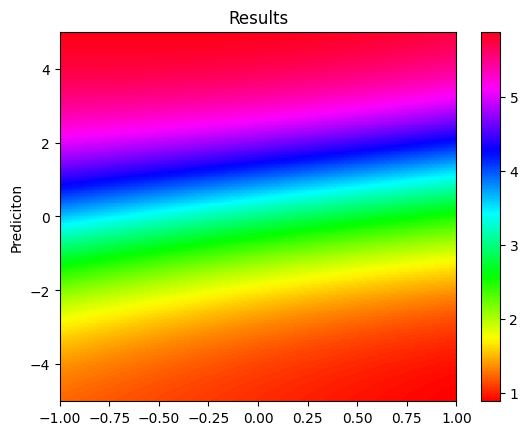

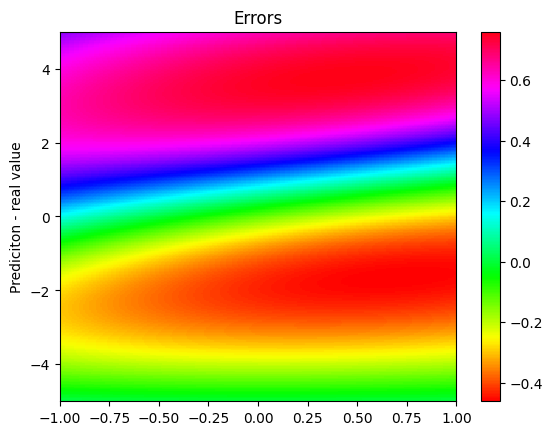


 m =  0.25 

 ####################################################


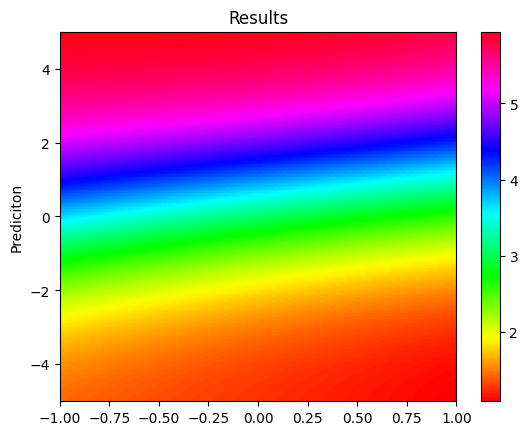

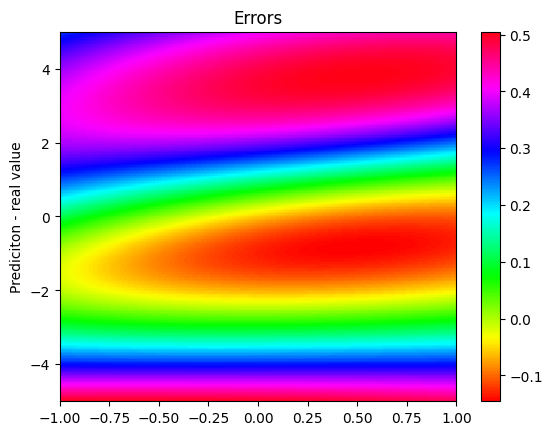


 m =  0.3 

 ####################################################


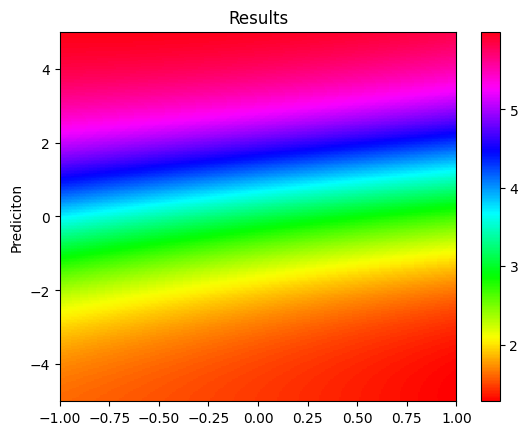

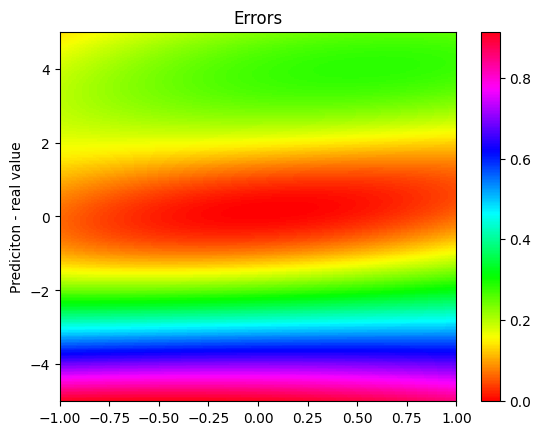


 m =  0.35 

 ####################################################


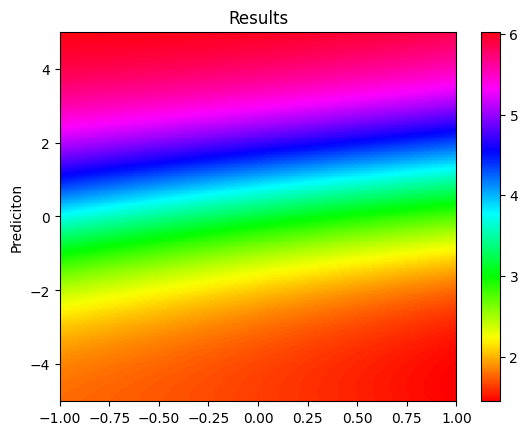

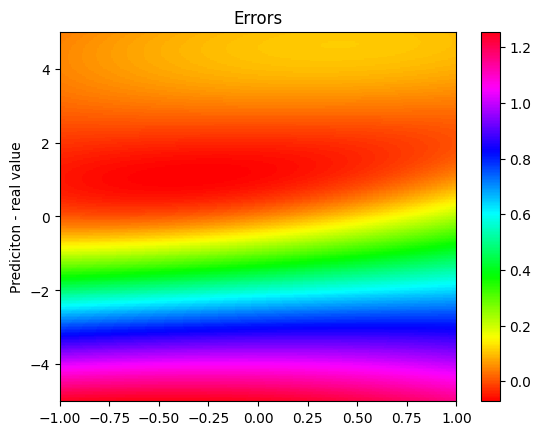


 m =  0.4 

 ####################################################


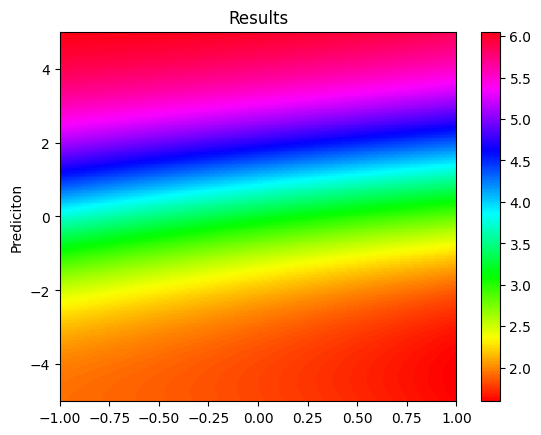

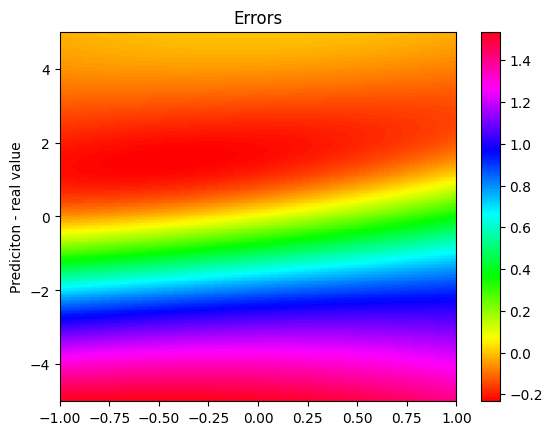

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/3

##teste rede mais otimizada

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [1000] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=50000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/3/model.ckpt")


Compiling model...
Building feed-forward neural network...


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'build' took 0.329891 s

'compile' took 2.107303 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.18e-05, 1.38e+01, 1.11e-01]    [6.18e-05, 1.38e+01, 1.11e-01]    [9.95e-01]    
1000      [7.62e-04, 2.30e-05, 1.61e-05]    [7.62e-04, 2.30e-05, 1.61e-05]    [8.73e-02]    
2000      [5.31e-04, 3.97e-06, 6.63e-07]    [5.31e-04, 3.97e-06, 6.63e-07]    [8.76e-02]    
3000      [4.46e-04, 2.81e-05, 2.13e-06]    [4.46e-04, 2.81e-05, 2.13e-06]    [8.34e-02]    
4000      [5.03e-04, 1.73e-05, 5.26e-06]    [5.03e-04, 1.73e-05, 5.26e-06]    [9.18e-02]    
5000      [2.40e-04, 9.97e-05, 2.67e-06]    [2.40e-04, 9.97e-05, 2.67e-06]    [8.53e-02]    
6000      [1.00e-04, 1.29e-06, 1.54e-06]    [1.00e-04, 1.29e-06, 1.54e-06]    [8.99e-02]    
7000      [1.31e-03, 1.03e-04, 9.25e-05]    [1.31e-03, 1.03e-04, 9.25e-05]    [1.07e-01]    
8000      [7.22e-04, 2.20e-05, 1.84e-05]    [7.22e-04, 2.20e-05, 1.84e-05]    [1.04e-01]    


 m =  0.2 

 ####################################################


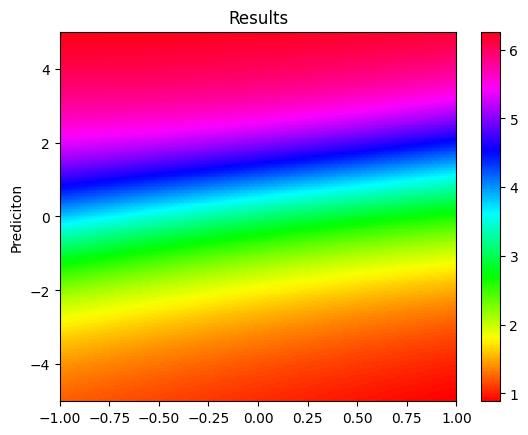

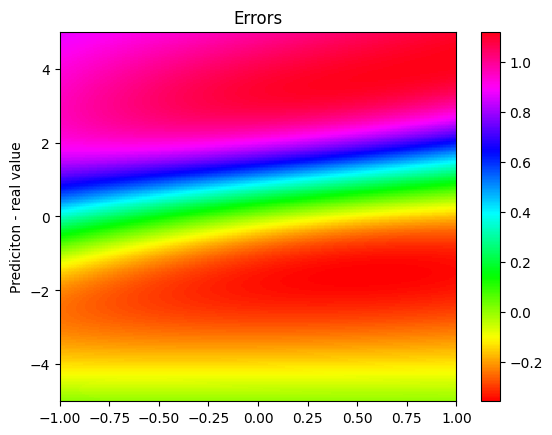


 m =  0.25 

 ####################################################


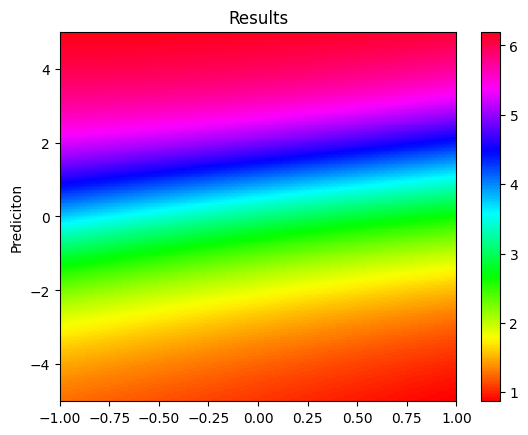

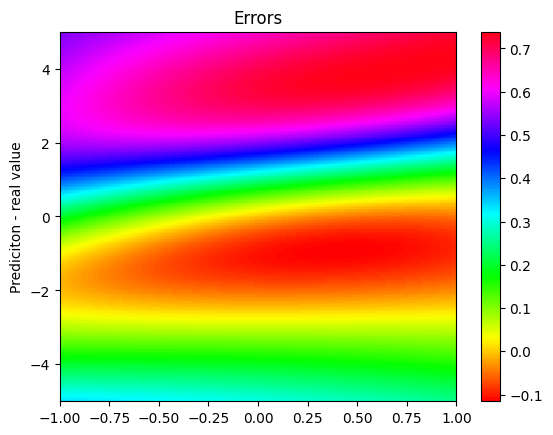


 m =  0.3 

 ####################################################


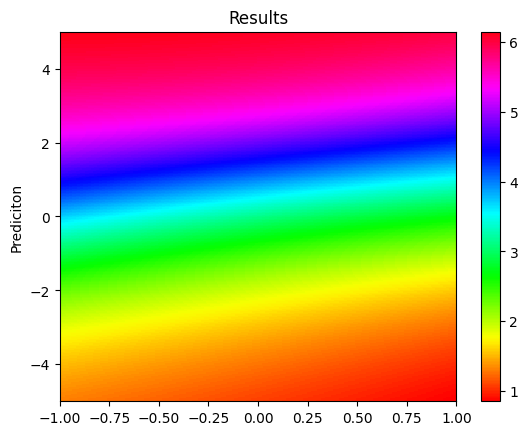

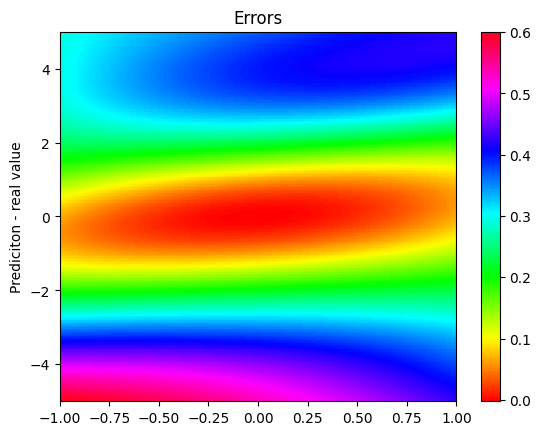


 m =  0.35 

 ####################################################


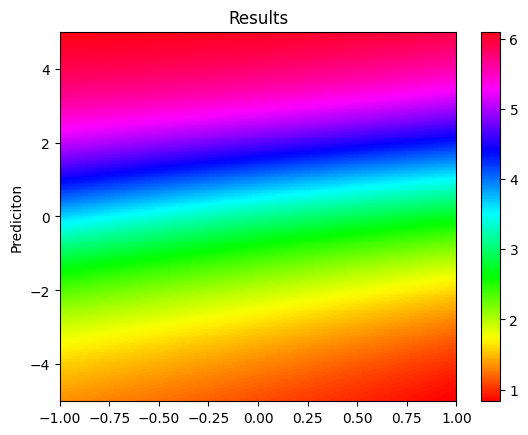

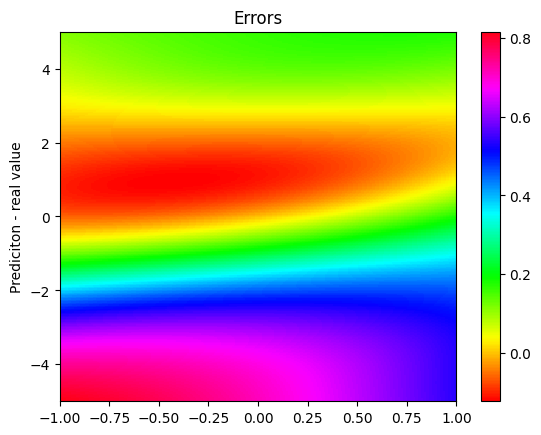


 m =  0.4 

 ####################################################


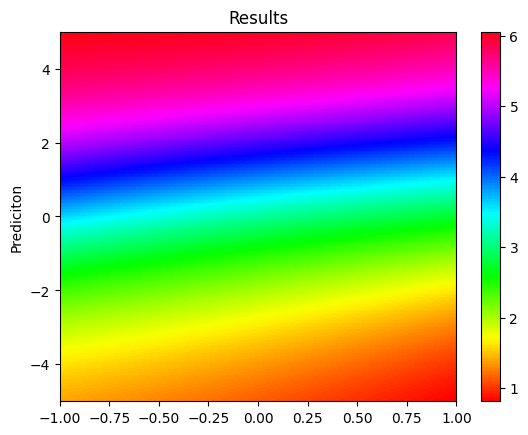

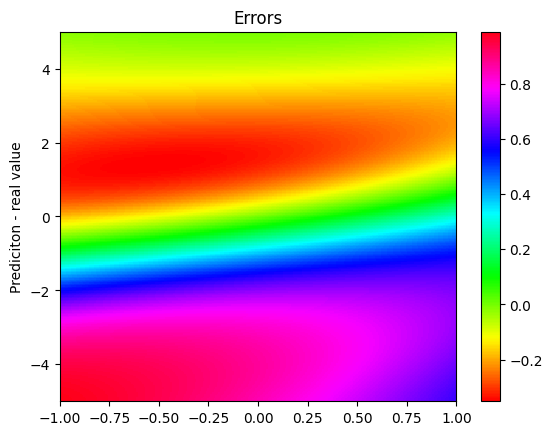

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

Compiling model...
'compile' took 0.989462 s

Training model...

Step      Train loss                        Test loss                         Test metric   
50000     [3.31e-06, 8.10e-06, 3.78e-07]    [3.31e-06, 8.10e-06, 3.78e-07]    [1.03e-01]    
51000     [1.68e-07, 1.95e-09, 1.88e-09]    [1.68e-07, 1.95e-09, 1.88e-09]                  
51741     [1.40e-07, 1.34e-09, 1.49e-09]    [1.40e-07, 1.34e-09, 1.49e-09]    [1.04e-01]    

Best model at step 51741:
  train loss: 1.43e-07
  test loss: 1.43e-07
  test metric: [1.04e-01]

Epoch 51741: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/1/model_lbfgs.ckpt-51741.ckpt ...

'train' took 5296.174792 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


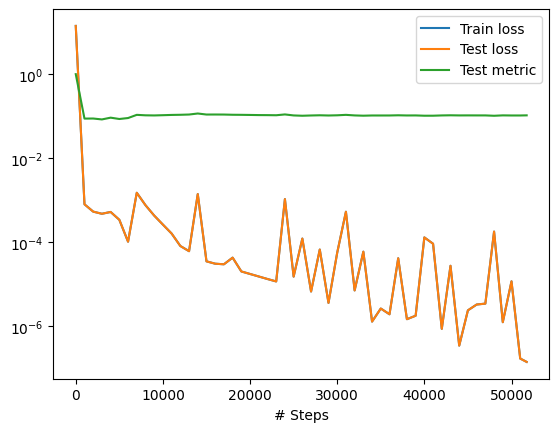

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/1/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)


 m =  0.2 

 ####################################################


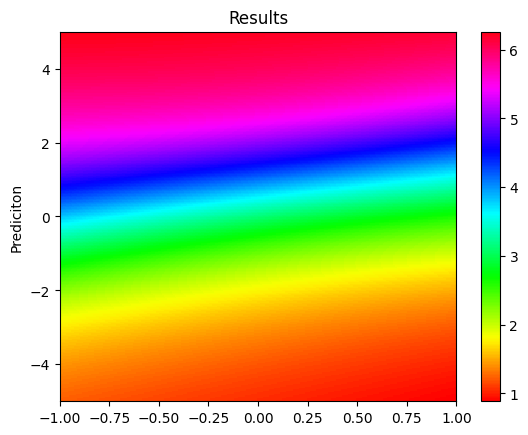

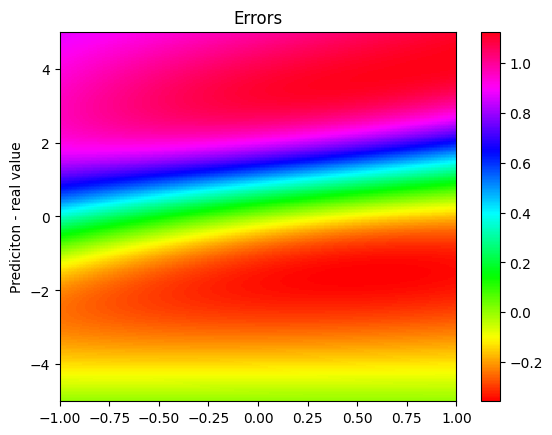


 m =  0.25 

 ####################################################


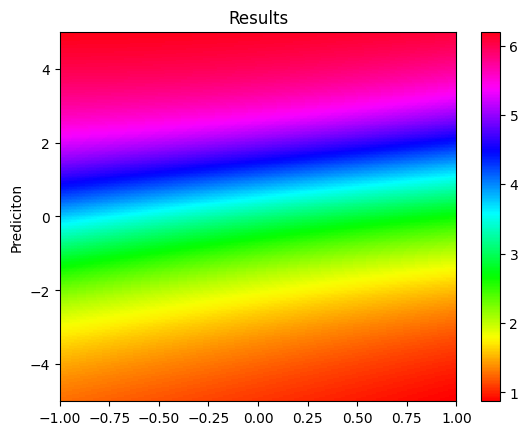

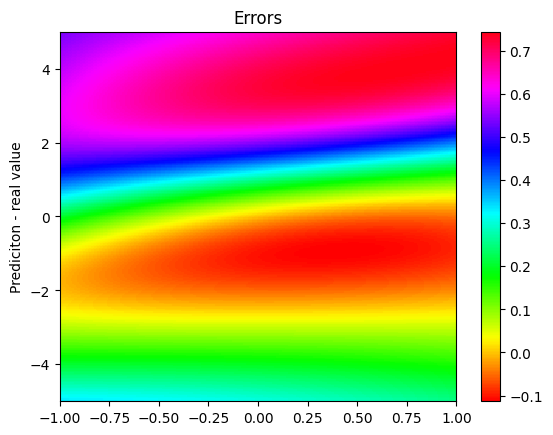


 m =  0.3 

 ####################################################


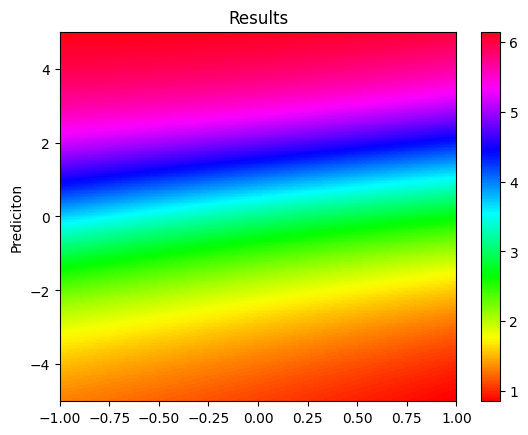

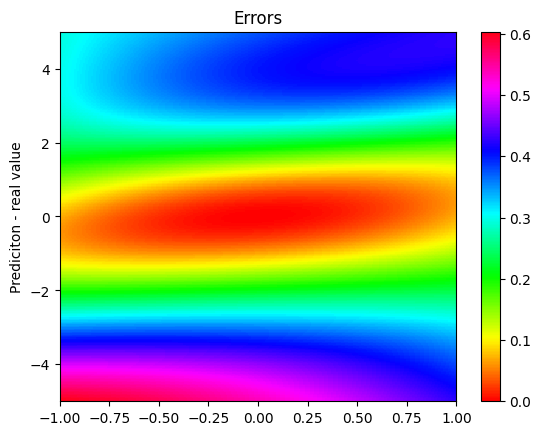


 m =  0.35 

 ####################################################


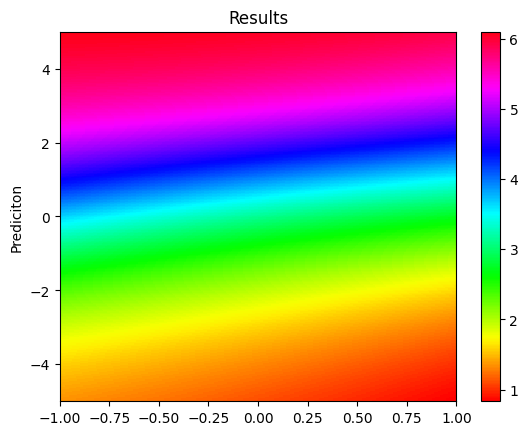

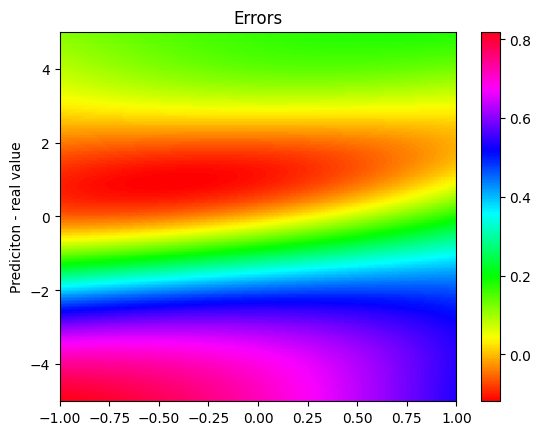


 m =  0.4 

 ####################################################


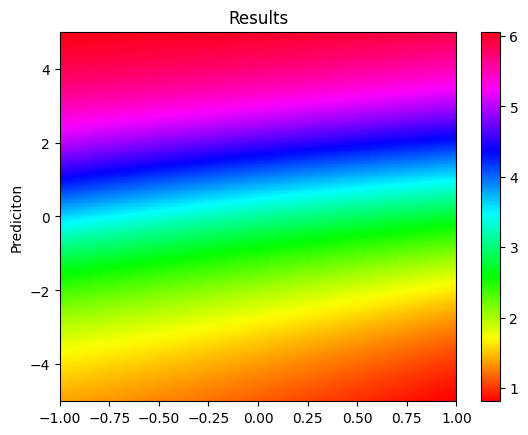

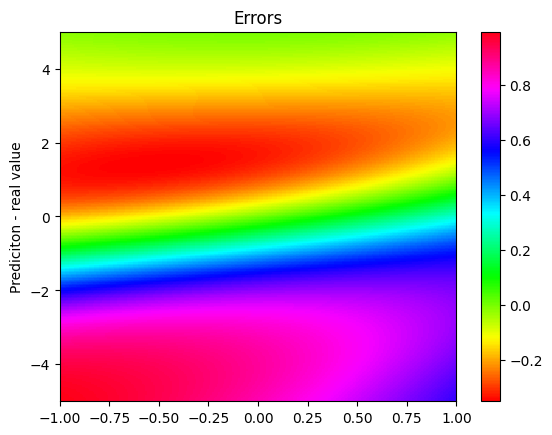

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

##teste rede mais otimizada 2

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [160] * 4 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=50000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/3/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.135735 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.322173 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.38e-03, 1.48e+01, 2.13e-01]    [1.38e-03, 1.48e+01, 2.13e-01]    [1.03e+00]    
1000      [7.04e-04, 1.05e-05, 5.24e-06]    [7.04e-04, 1.05e-05, 5.24e-06]    [1.25e-01]    
2000      [5.75e-04, 3.56e-05, 5.66e-06]    [5.75e-04, 3.56e-05, 5.66e-06]    [1.27e-01]    
3000      [4.42e-04, 7.65e-06, 5.94e-06]    [4.42e-04, 7.65e-06, 5.94e-06]    [1.29e-01]    
4000      [2.69e-04, 2.43e-05, 6.52e-06]    [2.69e-04, 2.43e-05, 6.52e-06]    [1.34e-01]    
5000      [1.71e-04, 4.38e-06, 4.58e-06]    [1.71e-04, 4.38e-06, 4.58e-06]    [1.35e-01]    
6000      [9.26e-05, 4.63e-06, 3.49e-06]    [9.26e-05, 4.63e-06, 3.49e-06]    [1.38e-01]    
7000      [6.44e-05, 3.98e-06, 1.90e-06]    [6.44e-05, 3.98e-06, 1.90e-06]    [1.37e-01]    
8000      [4.98e-05, 4.05e-06, 1.35e-06]    [4.98e-05, 4.05e-06, 1.35e-06]    [1.37e-01]    
9000      [4.17e-05, 3.1


 m =  0.2 

 ####################################################


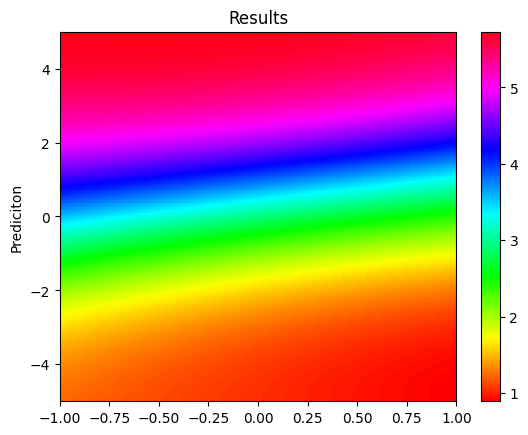

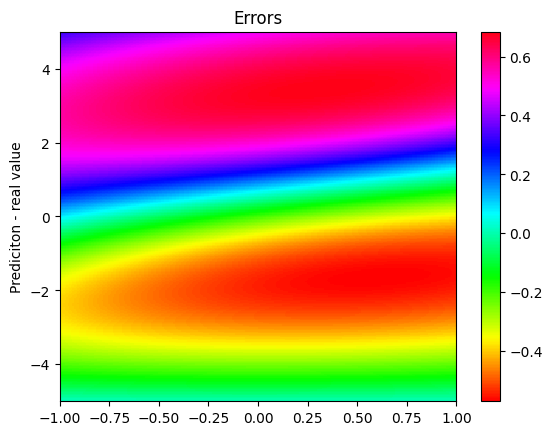


 m =  0.25 

 ####################################################


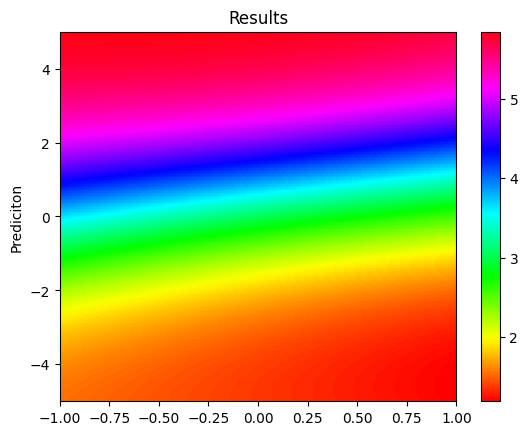

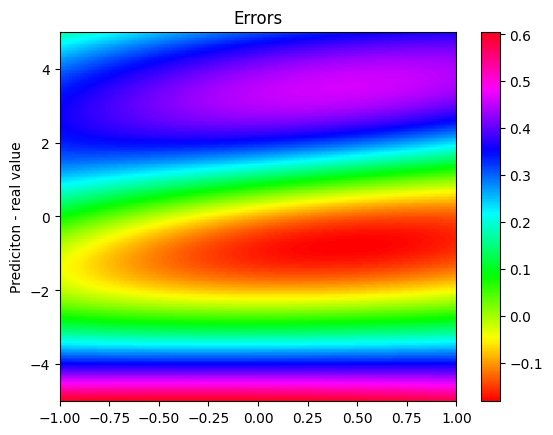


 m =  0.3 

 ####################################################


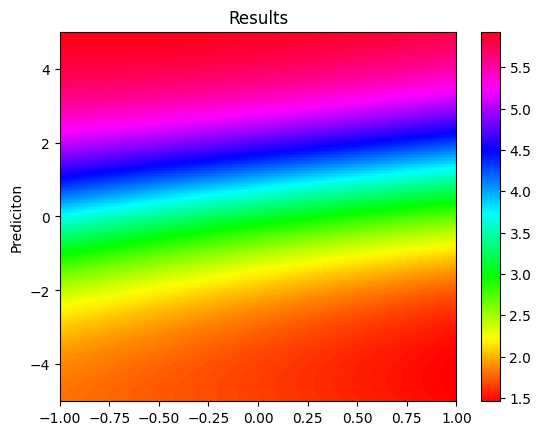

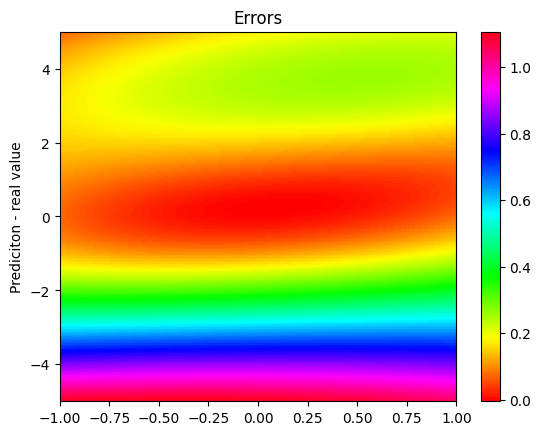


 m =  0.35 

 ####################################################


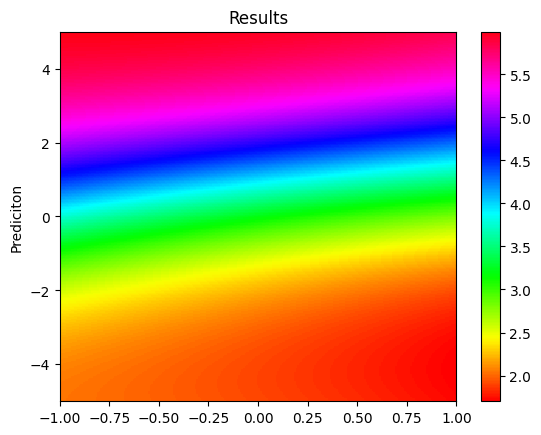

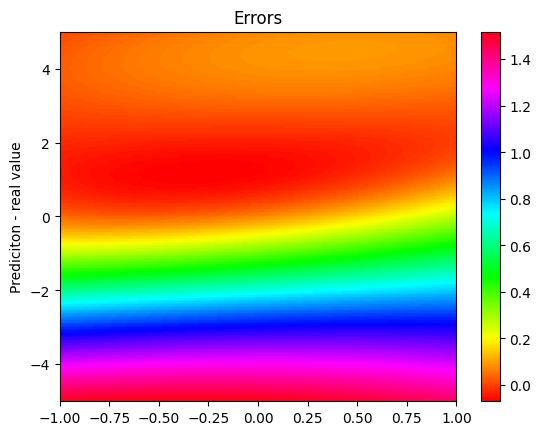


 m =  0.4 

 ####################################################


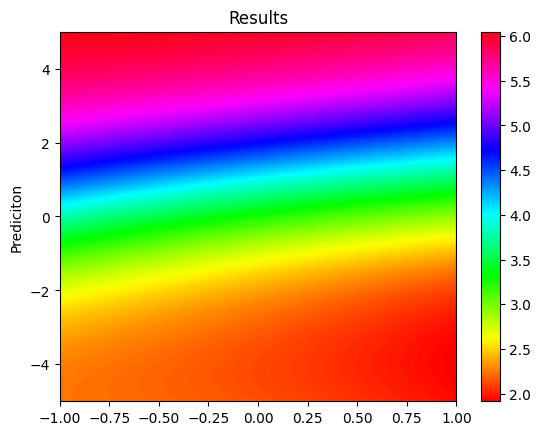

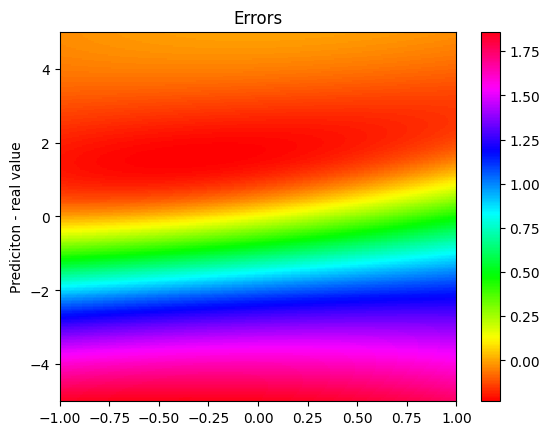

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

Compiling model...
'compile' took 0.799577 s

Training model...

Step      Train loss                        Test loss                         Test metric   
50000     [3.27e-06, 3.45e-07, 5.53e-08]    [3.27e-06, 3.45e-07, 5.53e-08]    [1.36e-01]    
51000     [6.55e-07, 3.32e-08, 1.59e-08]    [6.55e-07, 3.32e-08, 1.59e-08]                  
52000     [3.94e-07, 7.48e-09, 2.80e-09]    [3.94e-07, 7.48e-09, 2.80e-09]                  
53000     [2.87e-07, 3.81e-09, 1.64e-09]    [2.87e-07, 3.81e-09, 1.64e-09]                  
54000     [2.27e-07, 2.31e-09, 1.74e-09]    [2.27e-07, 2.31e-09, 1.74e-09]                  
55000     [1.64e-07, 1.30e-09, 1.26e-09]    [1.64e-07, 1.30e-09, 1.26e-09]                  
55614     [1.37e-07, 8.81e-10, 9.83e-10]    [1.37e-07, 8.81e-10, 9.83e-10]    [1.35e-01]    

Best model at step 55614:
  train loss: 1.39e-07
  test loss: 1.39e-07
  test metric: [1.35e-01]

Epoch 55614: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/1/mo

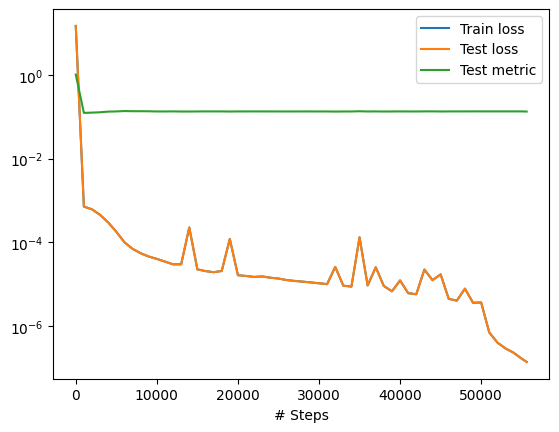

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/1/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)


 m =  0.2 

 ####################################################


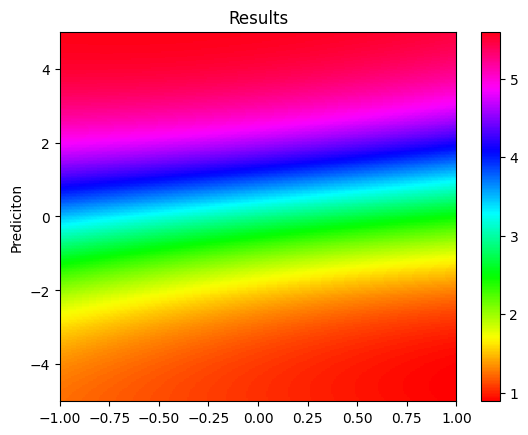

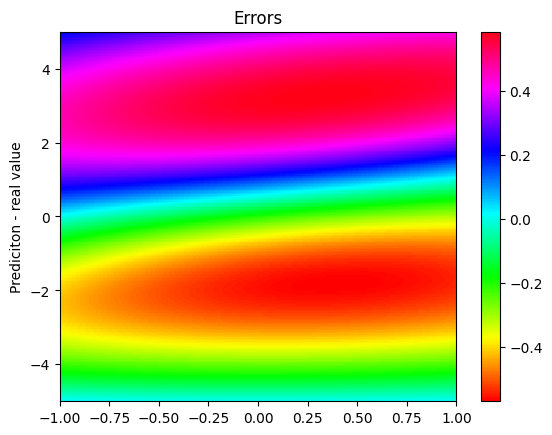


 m =  0.25 

 ####################################################


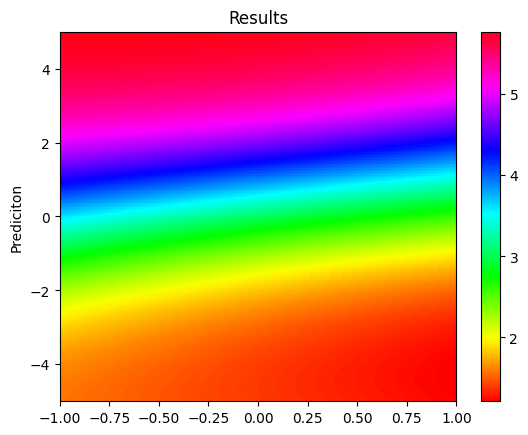

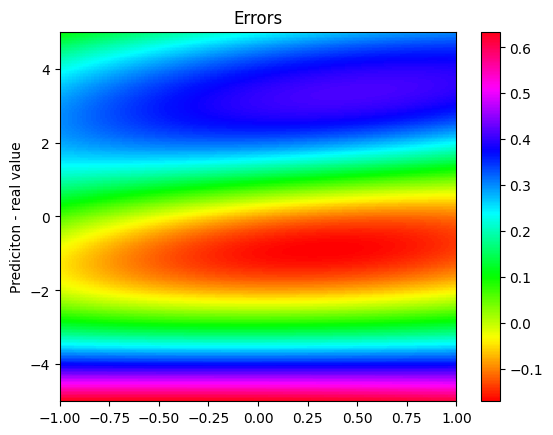


 m =  0.3 

 ####################################################


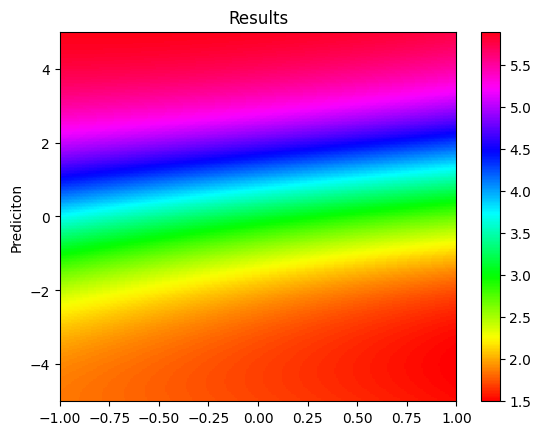

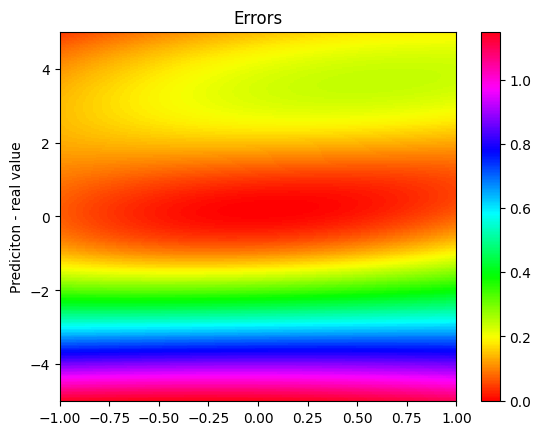


 m =  0.35 

 ####################################################


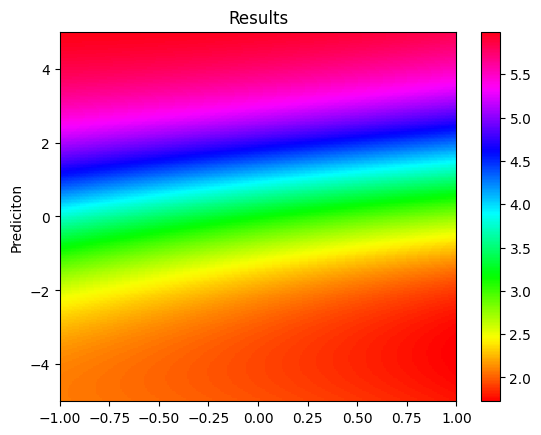

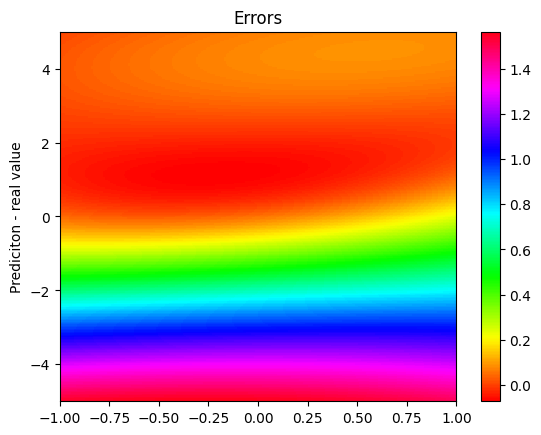


 m =  0.4 

 ####################################################


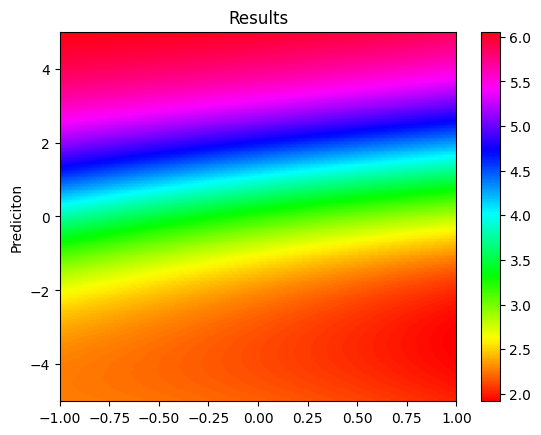

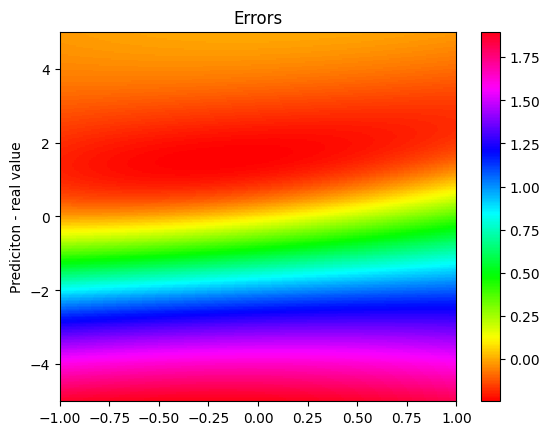

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

In [ ]:
!mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/4

##teste rede mais otimizada 3

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [1000] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=3000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/4/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.154853 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.818062 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.86e-05, 1.42e+01, 1.27e-01]    [3.86e-05, 1.42e+01, 1.27e-01]    [1.01e+00]    
1000      [7.08e-04, 2.66e-06, 1.46e-06]    [7.08e-04, 2.66e-06, 1.46e-06]    [9.79e-02]    
2000      [6.02e-04, 4.35e-06, 1.45e-06]    [6.02e-04, 4.35e-06, 1.45e-06]    [8.98e-02]    
3000      [4.47e-04, 5.88e-06, 7.81e-07]    [4.47e-04, 5.88e-06, 7.81e-07]    [8.81e-02]    

Best model at step 3000:
  train loss: 4.54e-04
  test loss: 4.54e-04
  test metric: [8.81e-02]

Epoch 3000: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/4/model.ckpt-3000.ckpt ...

'train' took 370.822341 s




 m =  0.2 

 ####################################################


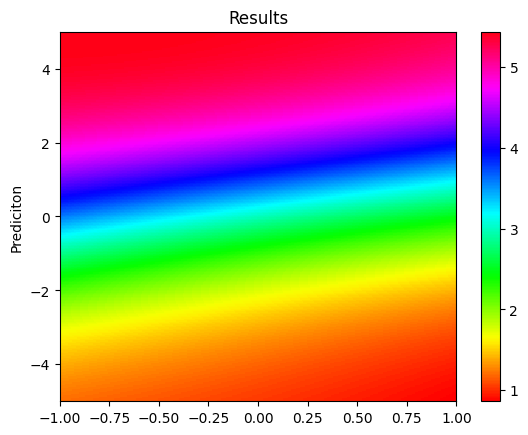

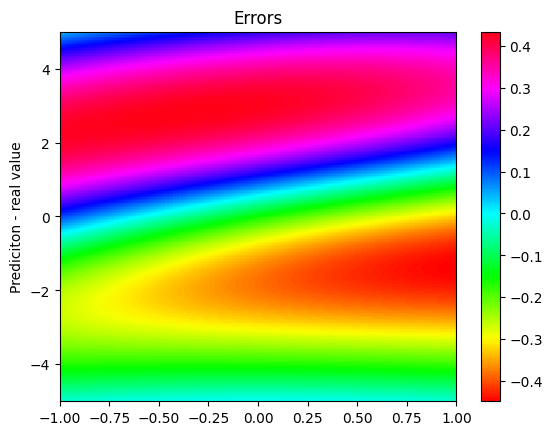


 m =  0.25 

 ####################################################


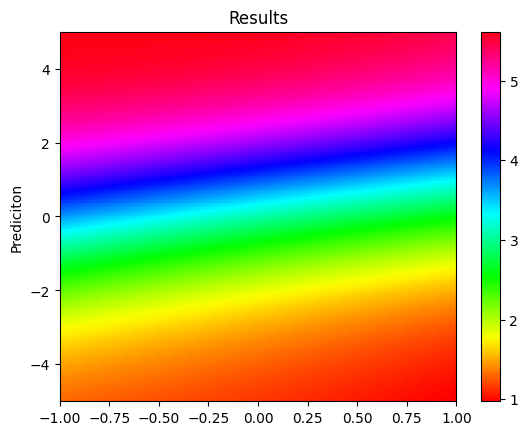

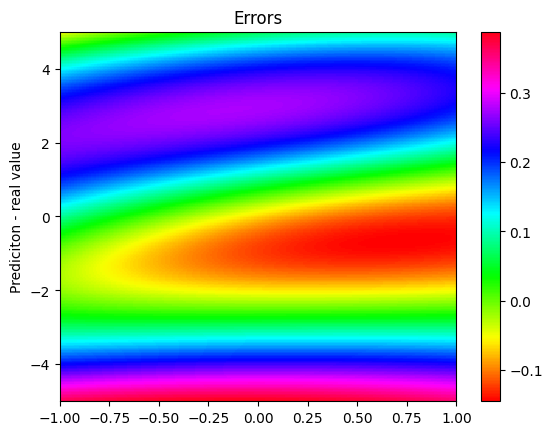


 m =  0.3 

 ####################################################


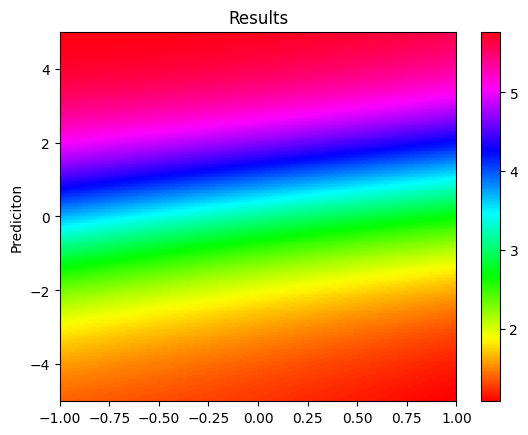

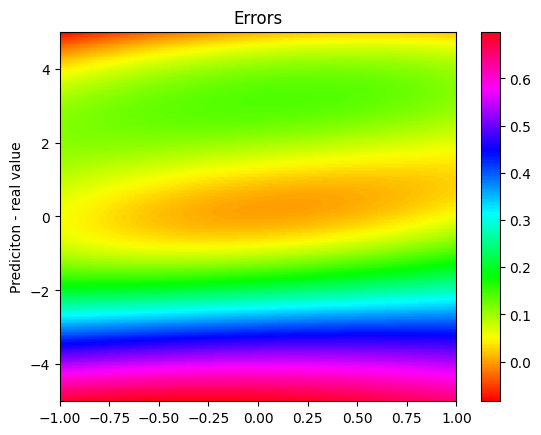


 m =  0.35 

 ####################################################


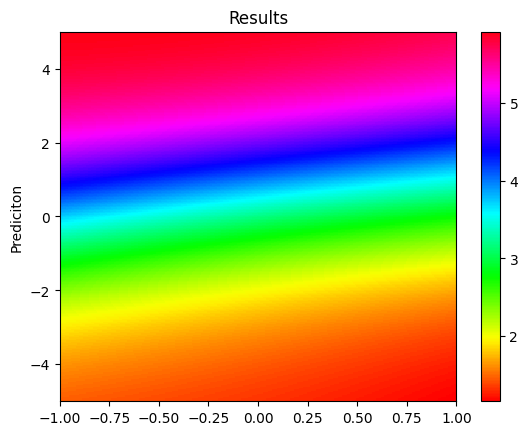

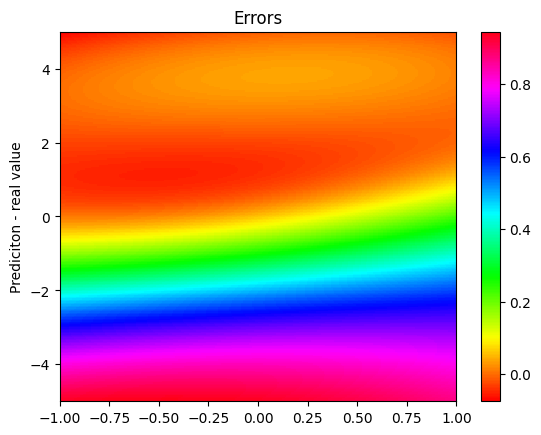


 m =  0.4 

 ####################################################


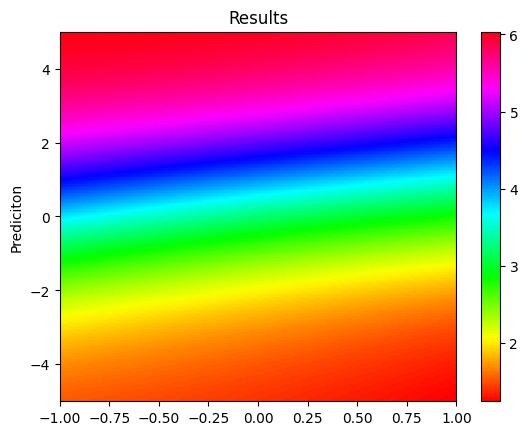

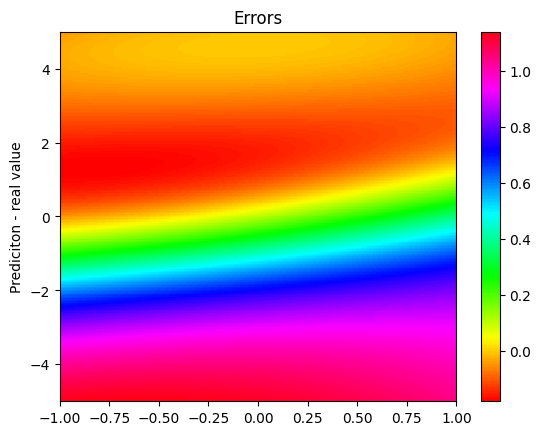

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=10000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/1/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

Compiling model...
'compile' took 1.167981 s

Training model...

Step      Train loss                        Test loss                         Test metric   
3000      [4.47e-04, 5.88e-06, 7.81e-07]    [4.47e-04, 5.88e-06, 7.81e-07]    [8.81e-02]    


KeyboardInterrupt: 


 m =  0.2 

 ####################################################


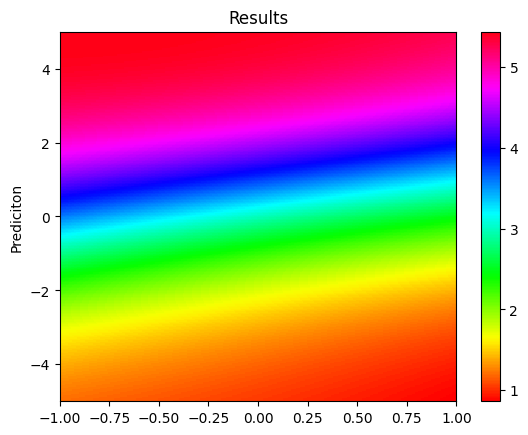

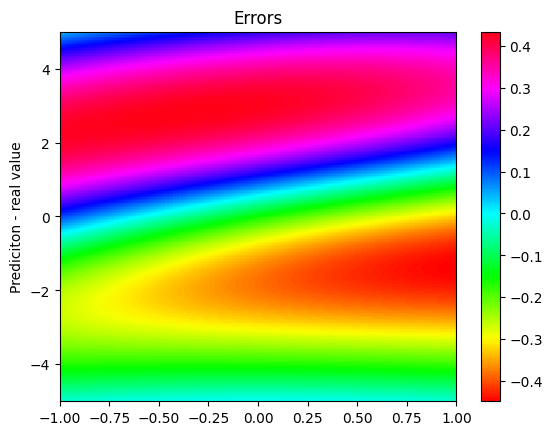


 m =  0.25 

 ####################################################


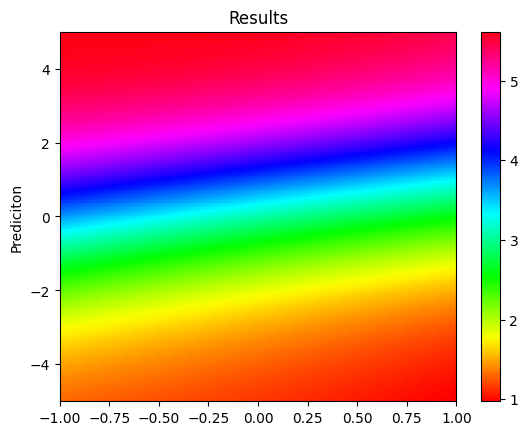

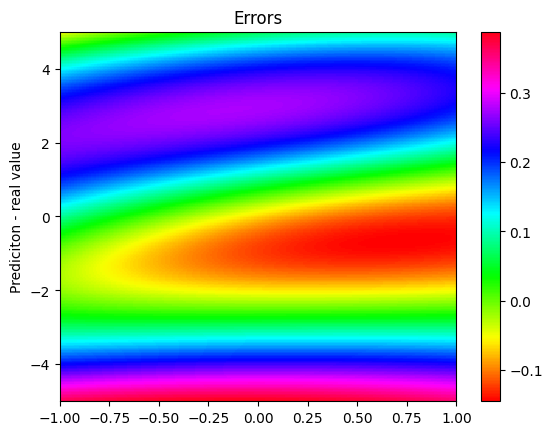


 m =  0.3 

 ####################################################


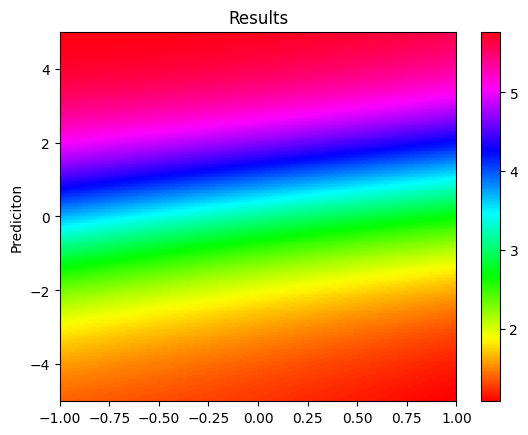

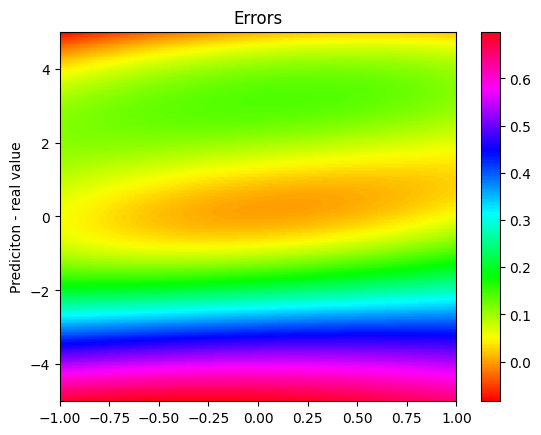


 m =  0.35 

 ####################################################


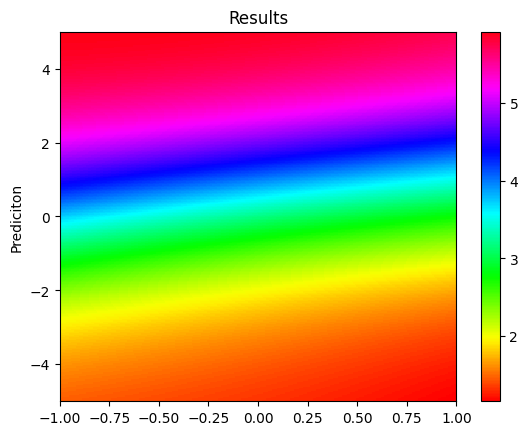

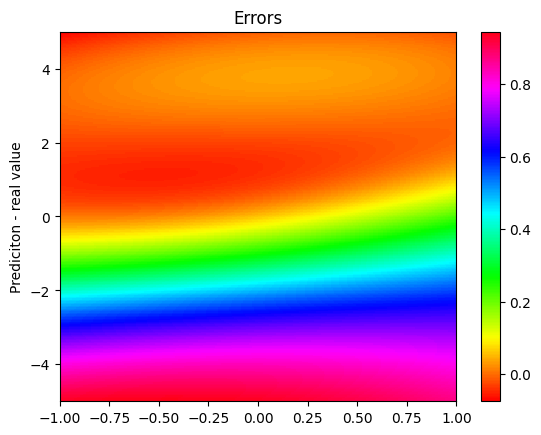


 m =  0.4 

 ####################################################


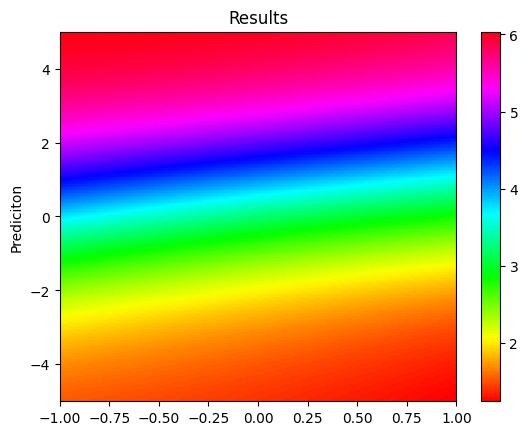

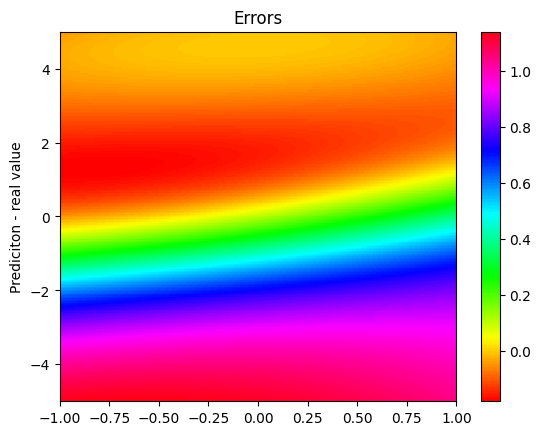

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

##teste rede mais otimizada 4 (boundary condition)

In [ ]:
mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/5

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2, bc],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=512,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [1000] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=3000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/5/model.ckpt")


Compiling model...
Building feed-forward neural network...


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'build' took 0.269023 s

'compile' took 3.067370 s

Training model...

0         [5.39e-04, 1.43e+01, 1.49e-01, 1.34e+01][5.39e-04, 1.43e+01, 1.49e-01, 1.34e+01][1.02e+00]    
1000      [2.07e-04, 4.33e-04, 1.33e-04, 9.95e-04][2.07e-04, 4.33e-04, 1.33e-04, 9.95e-04][1.16e-02]    
2000      [1.38e-04, 2.30e-04, 5.04e-05, 6.14e-04][1.38e-04, 2.30e-04, 5.04e-05, 6.14e-04][9.20e-03]    
3000      [2.00e-04, 7.00e-03, 5.19e-05, 7.77e-03][2.00e-04, 7.00e-03, 5.19e-05, 7.77e-03][2.73e-02]    

Best model at step 2000:
  train loss: 1.03e-03
  test loss: 1.03e-03
  test metric: [9.20e-03]

Epoch 3000: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/5/model.ckpt-3000.ckpt ...

'train' took 531.440878 s




 m =  0.2 

 ####################################################


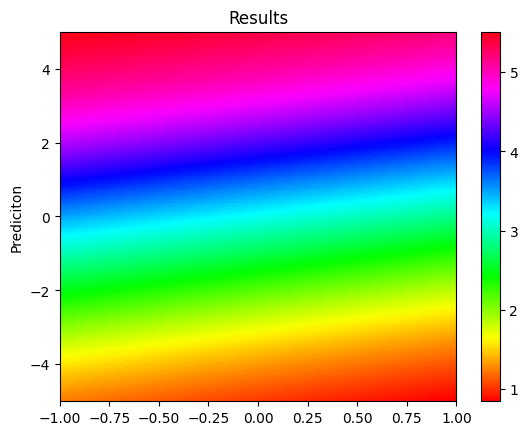

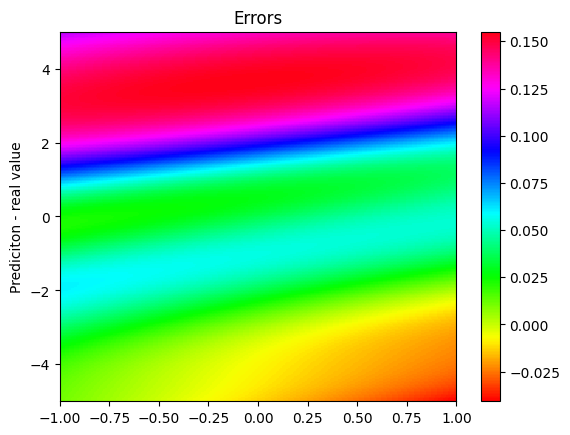


 m =  0.25 

 ####################################################


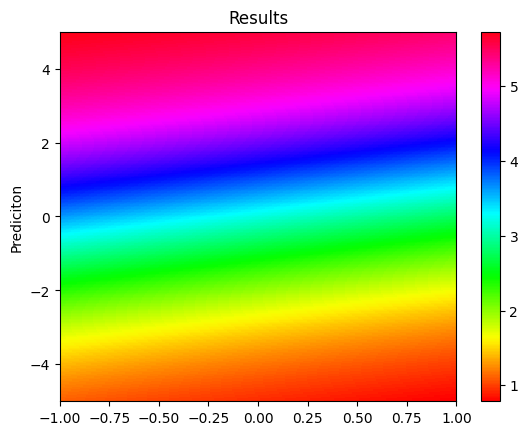

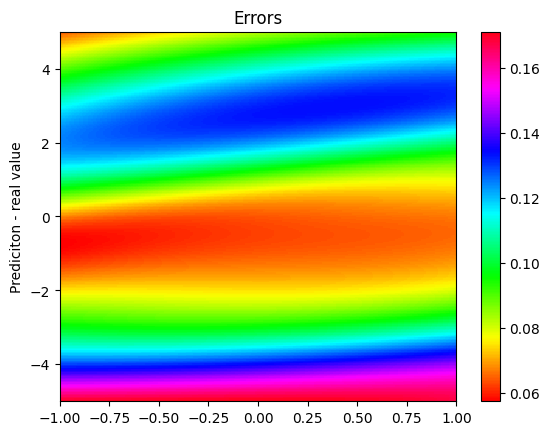


 m =  0.3 

 ####################################################


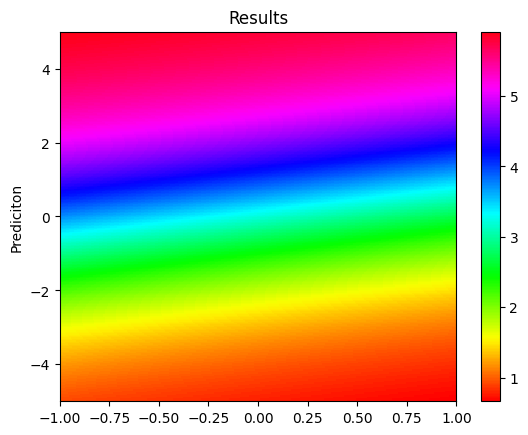

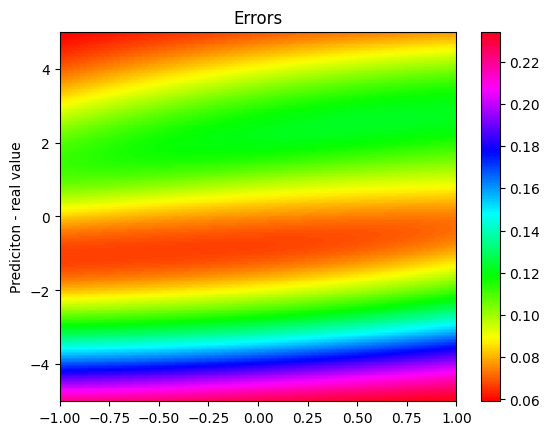


 m =  0.35 

 ####################################################


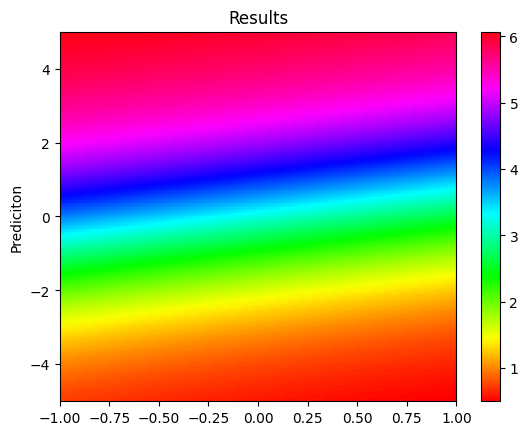

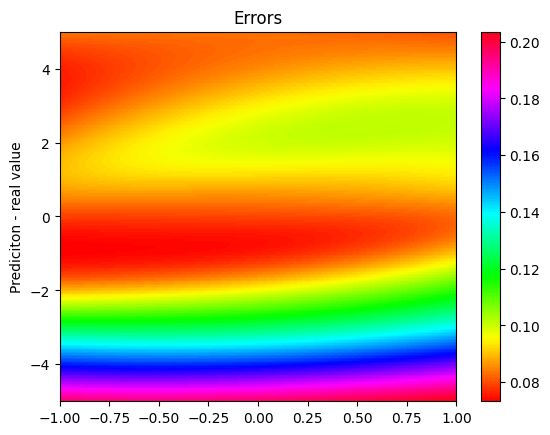


 m =  0.4 

 ####################################################


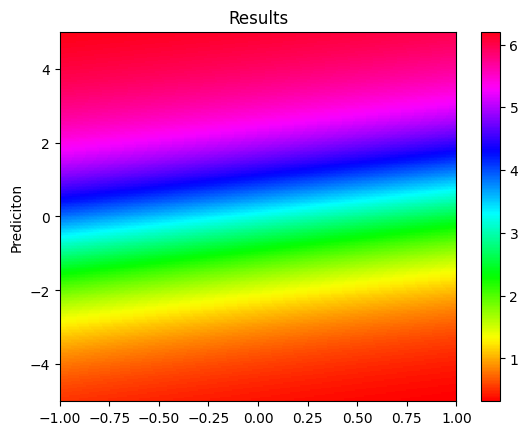

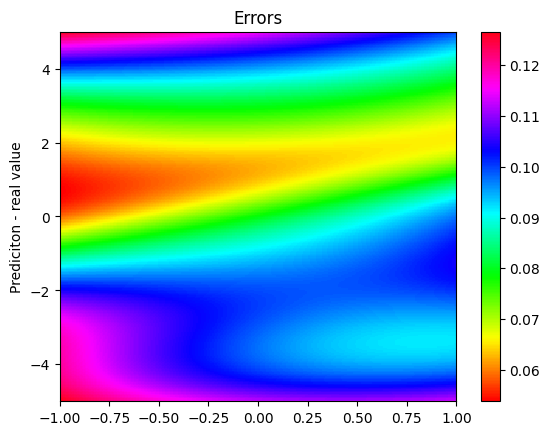

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2, bc],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=512,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [1000] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

Compiling model...
Building feed-forward neural network...
'build' took 0.187119 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.396171 s

Restoring model from /content/drive/MyDrive/trained_models/sine-gordon_variable/5/model.ckpt-3000.ckpt ...

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.40e-03, 1.50e+01, 8.35e-02, 1.40e+01]    [1.40e-03, 1.50e+01, 8.35e-02, 1.40e+01]    [1.04e+00]    
564       [6.58e-05, 7.94e-05, 1.33e-05, 3.02e-04]    [6.58e-05, 7.94e-05, 1.33e-05, 3.02e-04]    [8.27e-03]    

Best model at step 564:
  train loss: 4.61e-04
  test loss: 4.61e-04
  test metric: [8.27e-03]

Epoch 564: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/5/model_lbfgs.ckpt-564.ckpt ...

'train' took 2059.100577 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


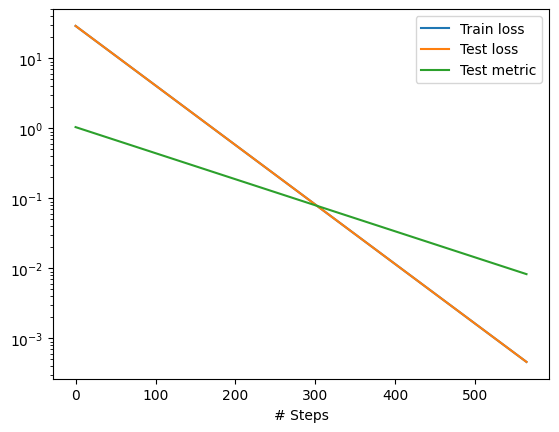

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=500,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_restore_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/5/model.ckpt-3000.ckpt", model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/5/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)


 m =  0.2 

 ####################################################


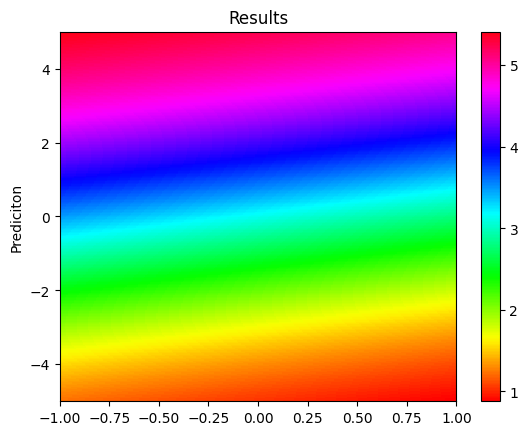

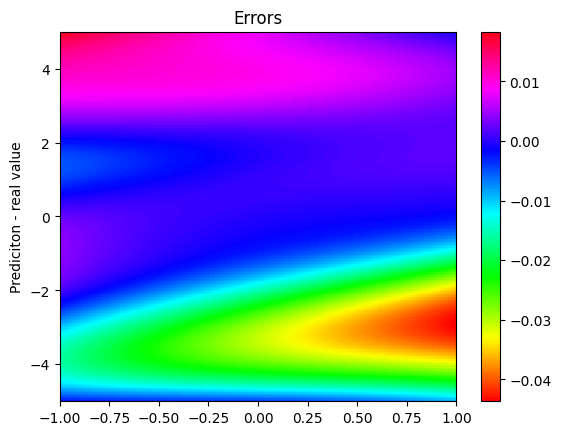


 m =  0.25 

 ####################################################


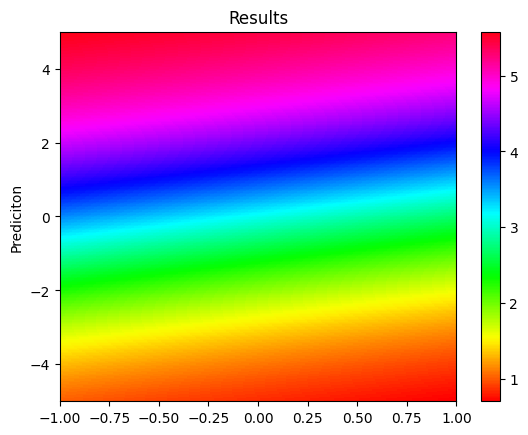

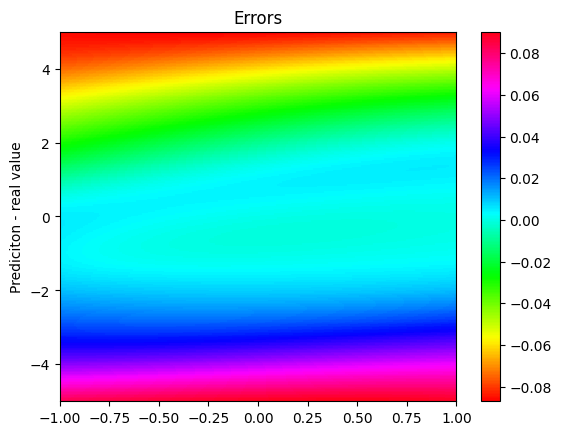


 m =  0.3 

 ####################################################


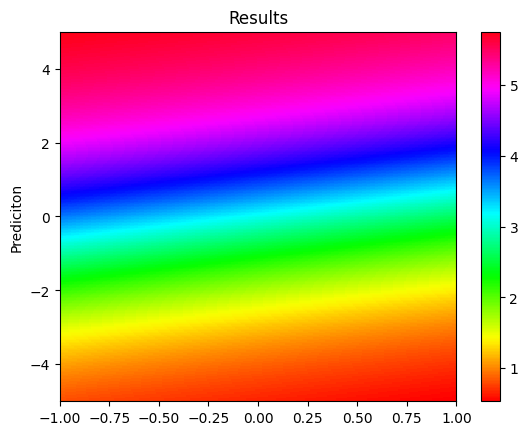

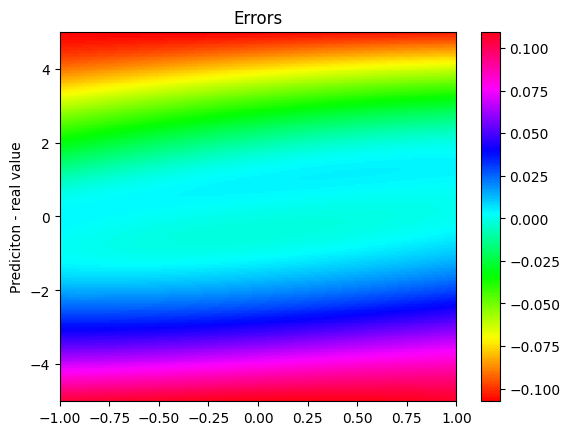


 m =  0.35 

 ####################################################


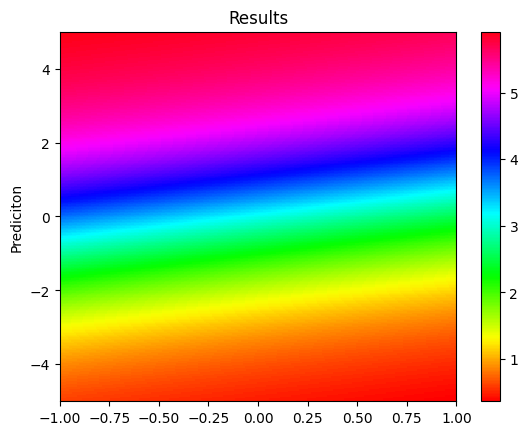

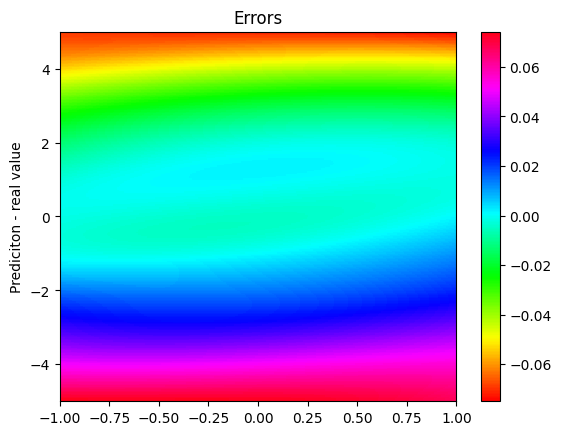


 m =  0.4 

 ####################################################


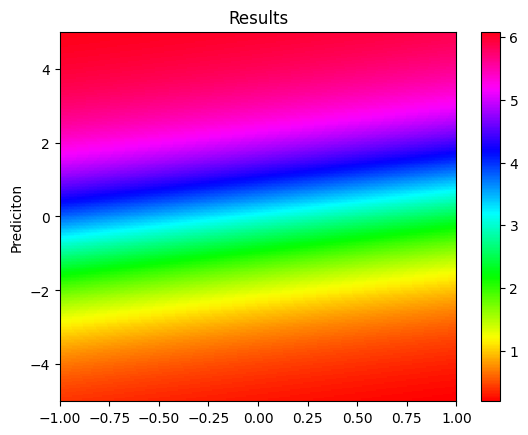

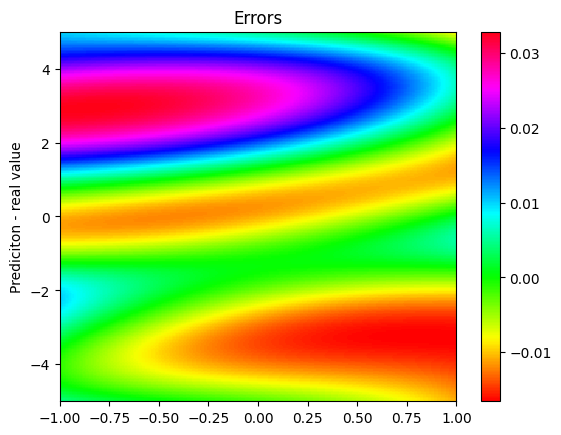

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

##teste rede mais otimizada 5 (boundary condition)

In [ ]:
#mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/6

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=512,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [1000] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=5000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/6/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.157643 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 2.009823 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [4.31e-04, 1.47e+01, 1.34e-01, 3.54e+01, 1.72e-01]    [4.31e-04, 1.47e+01, 1.34e-01, 3.54e+01, 1.72e-01]    [1.03e+00]    
1000      [9.10e-04, 6.23e-04, 2.27e-04, 1.74e-04, 2.51e-04]    [9.10e-04, 6.23e-04, 2.27e-04, 1.74e-04, 2.51e-04]    [3.19e-02]    
2000      [3.17e-04, 3.37e-03, 2.28e-04, 1.52e-03, 5.23e-03]    [3.17e-04, 3.37e-03, 2.28e-04, 1.52e-03, 5.23e-03]    [2.46e-02]    
3000      [2.60e-04, 1.30e-03, 1.69e-04, 1.04e-03, 1.64e-03]    [2.60e-04, 1.30e-03, 1.69e-04, 1.04e-03, 1.64e-03]    [2.10e-02]    
4000      [2.38e-04, 6.92e-04, 8.87e-05, 5.45e-04, 8.04e-04]    [2.38e-04, 6.92e-04, 8.87e-05, 5.45e-04, 8.04e-04]    [1.82e-02]    
5000      [2.44e-04, 2.82e-03, 4.66e-05, 1.85e-03, 4.67e-03]    [2.44e-04, 2.82e-03, 4.66e-05, 1.85e-03, 4.67e-03]    [2.72e-02]    

Best model at step 100


 m =  0.2 

 ####################################################


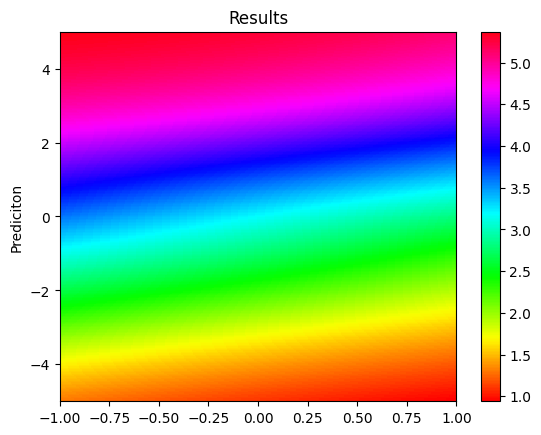

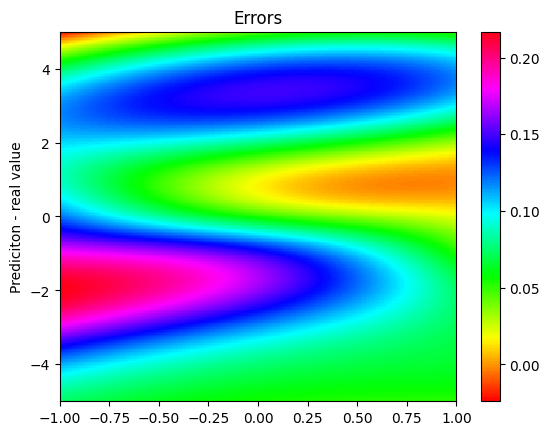


 m =  0.25 

 ####################################################


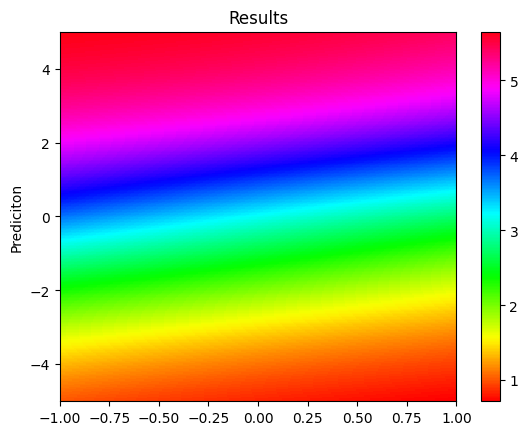

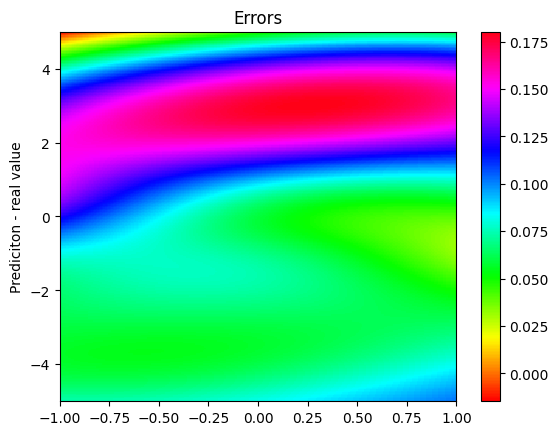


 m =  0.3 

 ####################################################


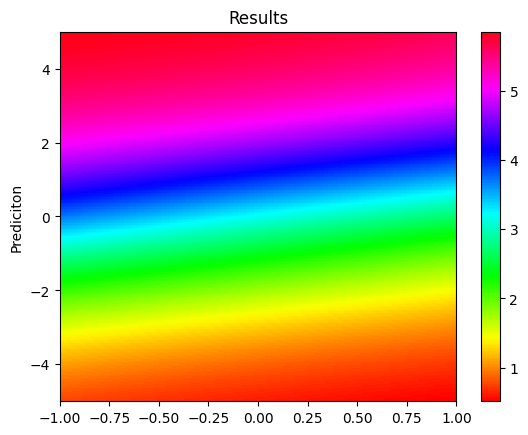

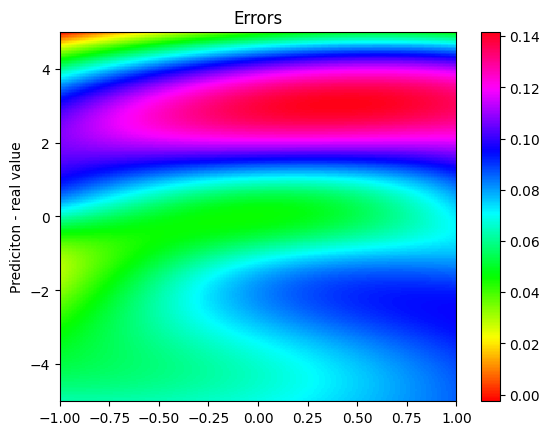


 m =  0.35 

 ####################################################


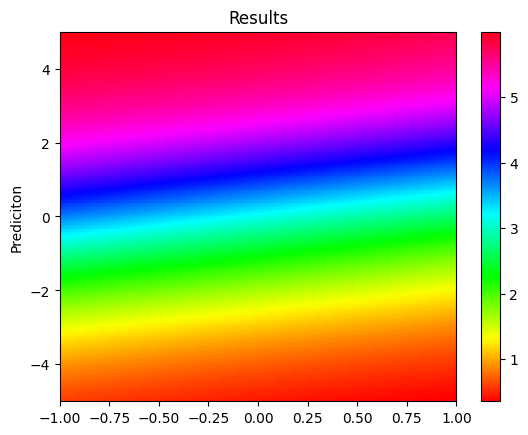

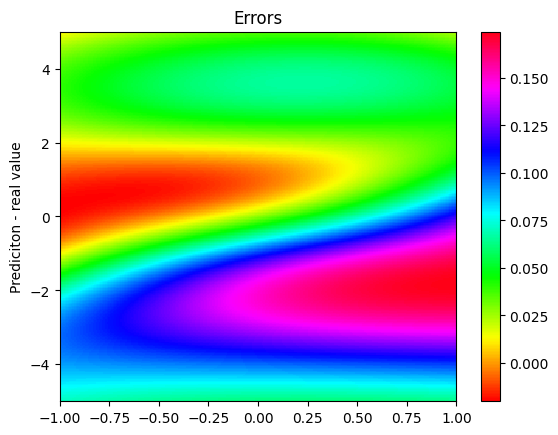


 m =  0.4 

 ####################################################


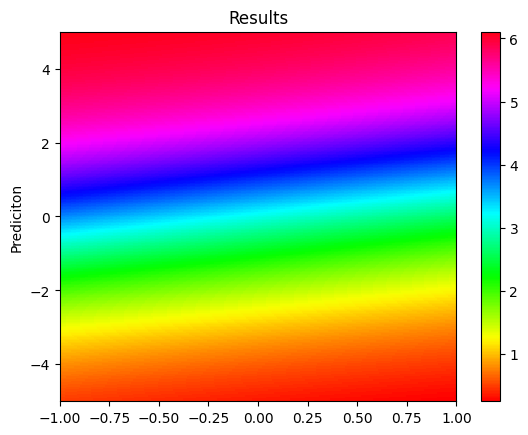

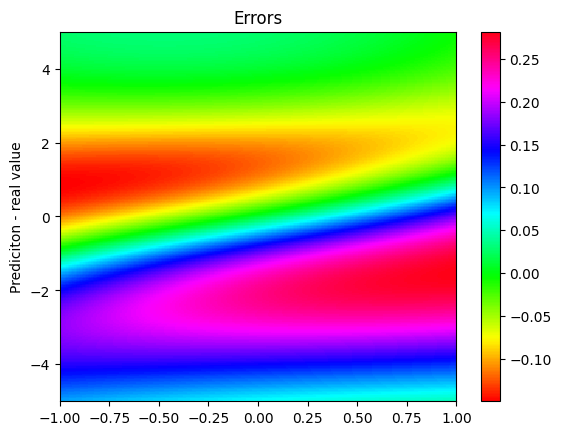

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

Compiling model...
'compile' took 1.613635 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
5000      [2.44e-04, 2.82e-03, 4.66e-05, 1.85e-03, 4.67e-03]    [2.44e-04, 2.82e-03, 4.66e-05, 1.85e-03, 4.67e-03]    [2.72e-02]    
5537      [3.09e-05, 1.24e-06, 2.52e-06, 1.62e-06, 2.22e-06]    [3.09e-05, 1.24e-06, 2.52e-06, 1.62e-06, 2.22e-06]    [9.38e-03]    

Best model at step 5537:
  train loss: 3.85e-05
  test loss: 3.85e-05
  test metric: [9.38e-03]

Epoch 5537: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/6/model_lbfgs.ckpt-5537.ckpt ...

'train' took 1633.712888 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


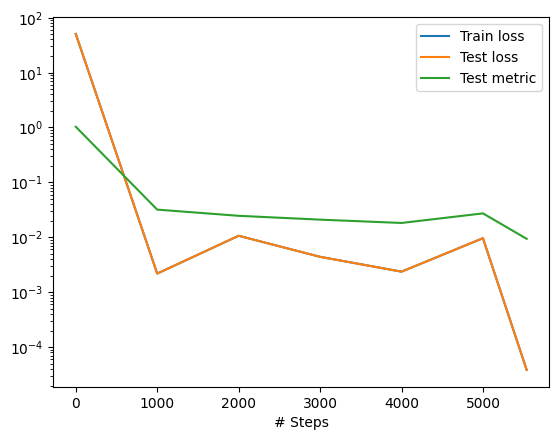

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=500,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/6/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)


 m =  0.2 

 ####################################################


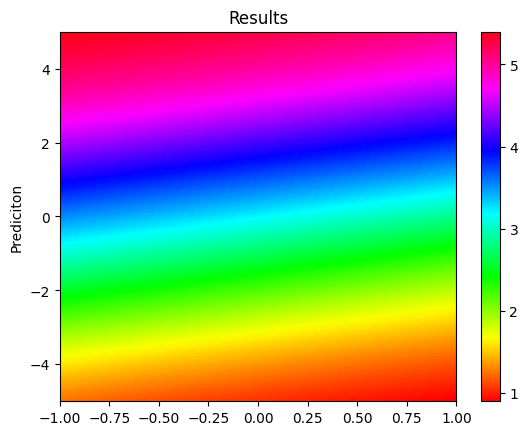

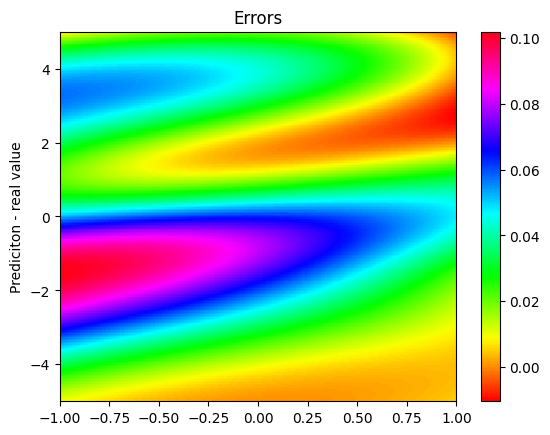


 m =  0.25 

 ####################################################


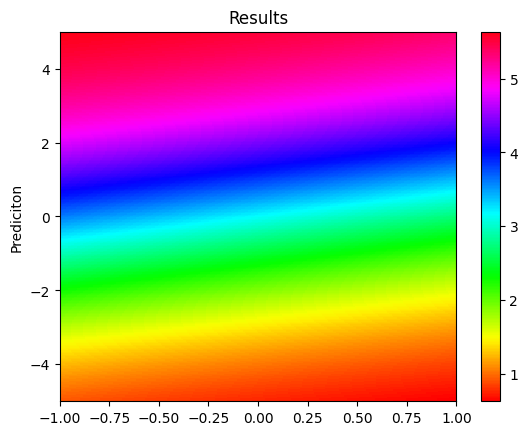

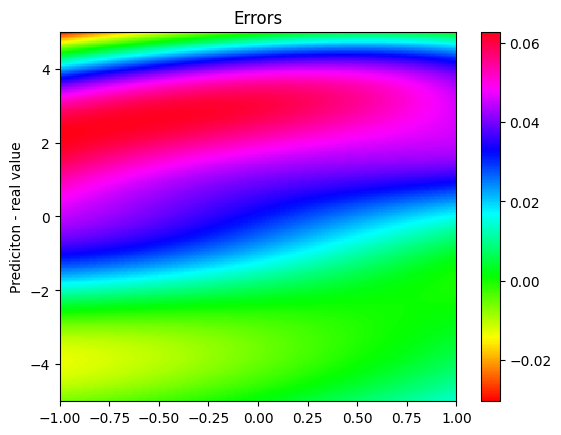


 m =  0.3 

 ####################################################


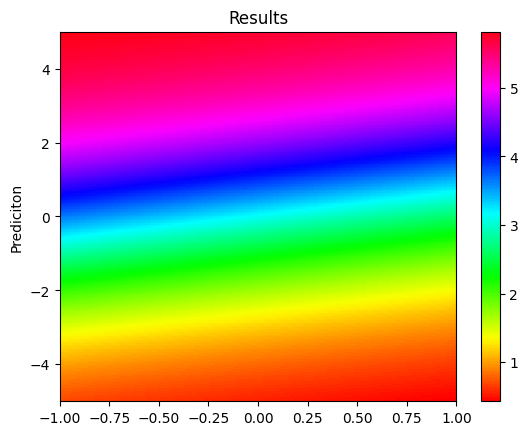

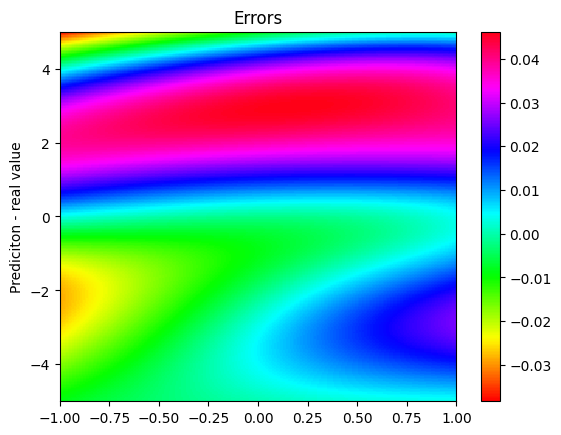


 m =  0.35 

 ####################################################


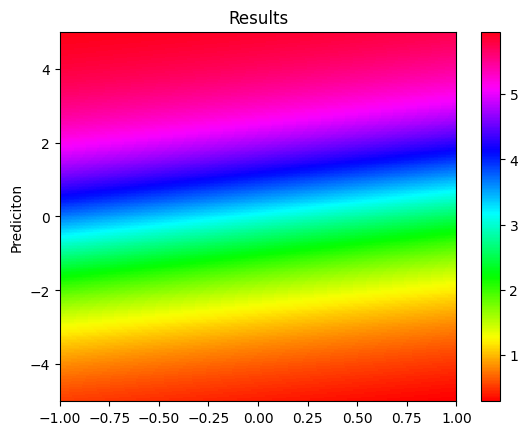

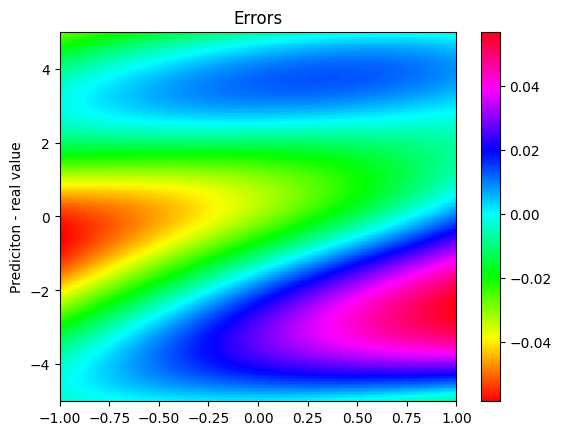


 m =  0.4 

 ####################################################


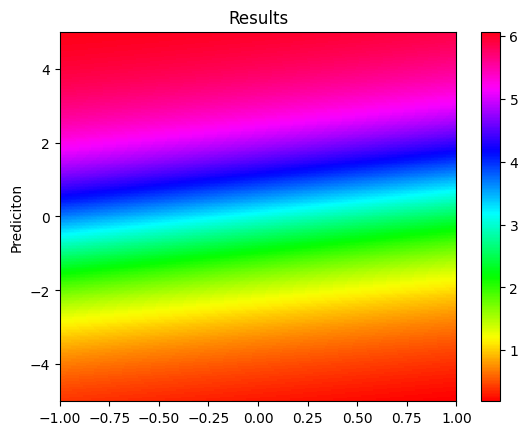

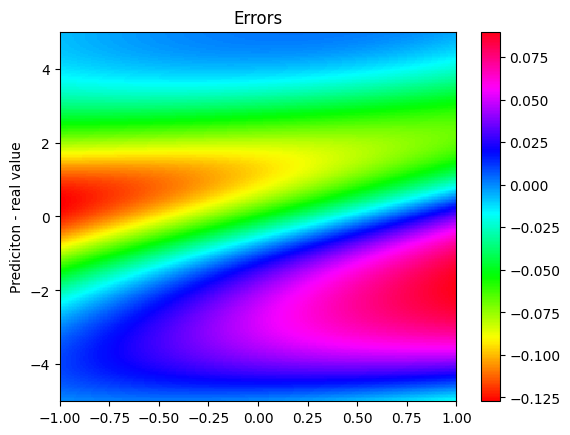

In [ ]:
for i in [0.2,0.25,0.3,0.35,0.4]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

#Sine-gordon velocidade variável

In [ ]:
mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/v_variable/1

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*3+5)/10#(0.5,0.8), representa v
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.5], [5, 0.8])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, v, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, v, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    m = 0.3
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, v, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    m = 0.3
    gamma = tf.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=512,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=5000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/6/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.297494 s

'compile' took 2.860396 s

Training model...

0         [9.95e-04, 1.37e+01, 5.70e-02, 3.48e+01, 1.35e-01]    [9.95e-04, 1.37e+01, 5.70e-02, 3.48e+01, 1.35e-01]    [1.01e+00]    
1000      [2.63e-04, 1.11e-04, 3.19e-05, 1.03e-03, 2.17e-04]    [2.63e-04, 1.11e-04, 3.19e-05, 1.03e-03, 2.17e-04]    [3.93e-02]    
2000      [1.44e-04, 5.12e-05, 2.73e-05, 6.95e-04, 1.19e-04]    [1.44e-04, 5.12e-05, 2.73e-05, 6.95e-04, 1.19e-04]    [3.62e-02]    
3000      [1.08e-04, 2.78e-05, 2.61e-05, 5.70e-04, 1.39e-04]    [1.08e-04, 2.78e-05, 2.61e-05, 5.70e-04, 1.39e-04]    [3.31e-02]    
4000      [8.98e-05, 2.73e-05, 3.06e-05, 4.88e-04, 7.85e-05]    [8.98e-05, 2.73e-05, 3.06e-05, 4.88e-04, 7.85e-05]    [3.09e-02]    
5000      [7.59e-05, 2.72e-05, 3.10e-05, 4.30e-04, 7.15e-05]    [7.59e-05, 2.72e-05, 3.10e-05, 4.30e-04, 7.15e-05]    [2.92e-02]    

Best model at step 5000:
  train loss: 6.36e-04
  test loss: 6.36e-04
 


 m =  0.5 

 ####################################################


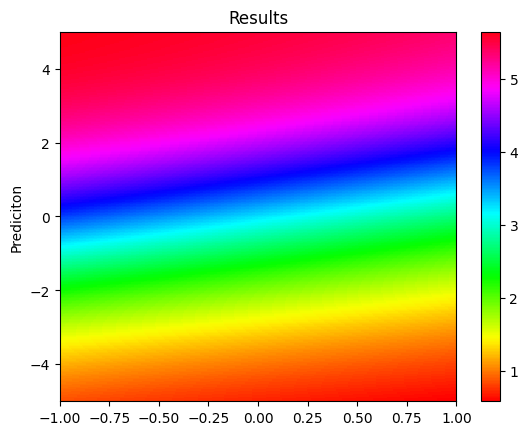

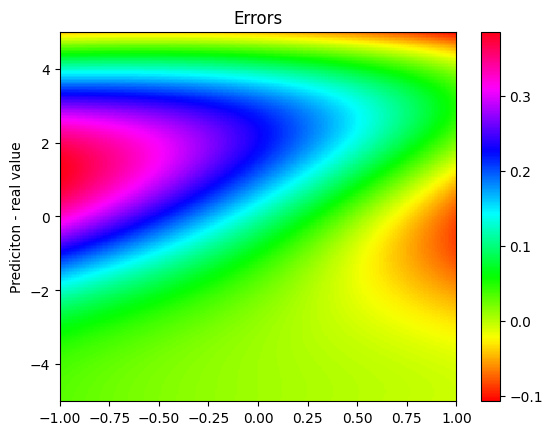


 m =  0.55 

 ####################################################


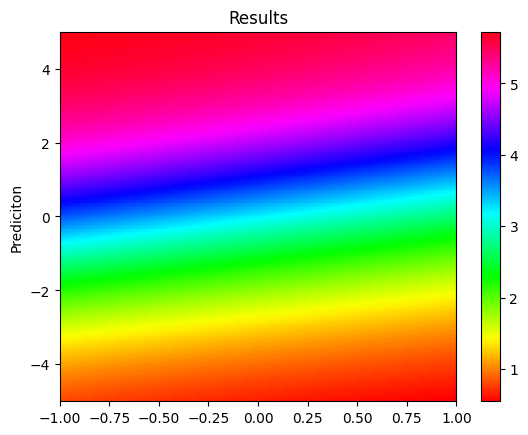

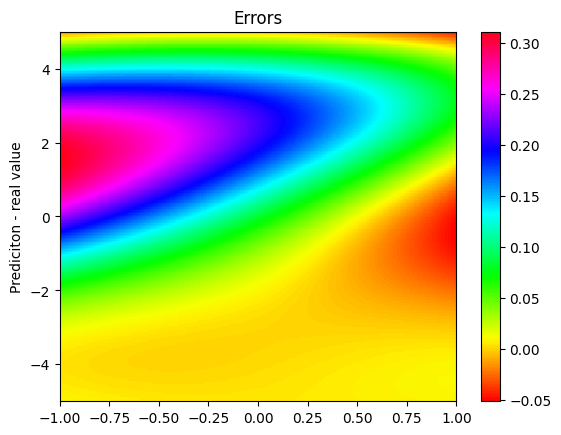


 m =  0.6 

 ####################################################


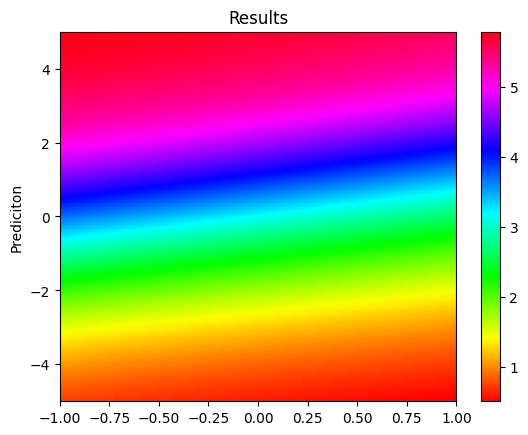

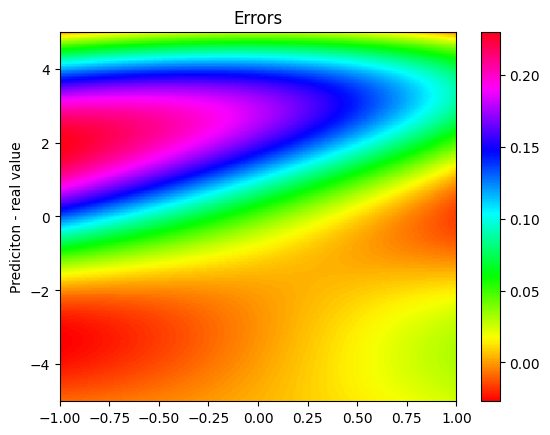


 m =  0.65 

 ####################################################


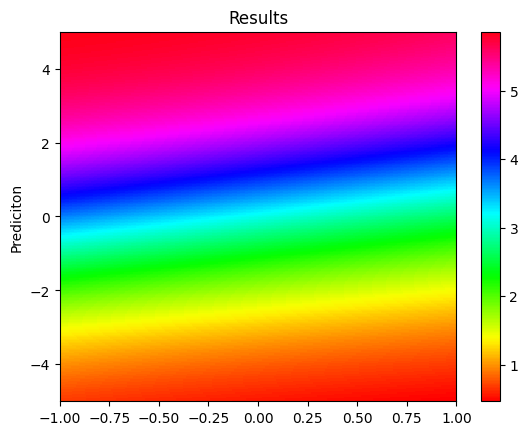

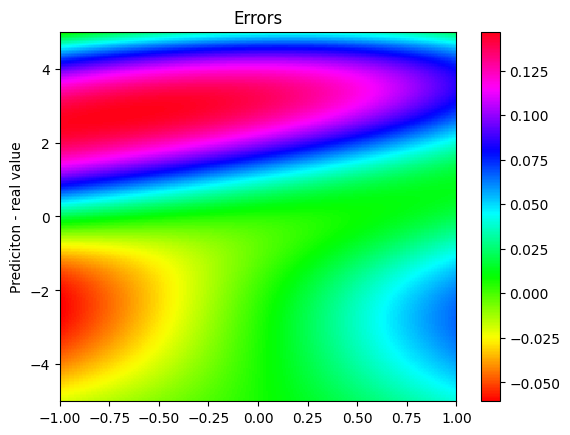


 m =  0.7 

 ####################################################


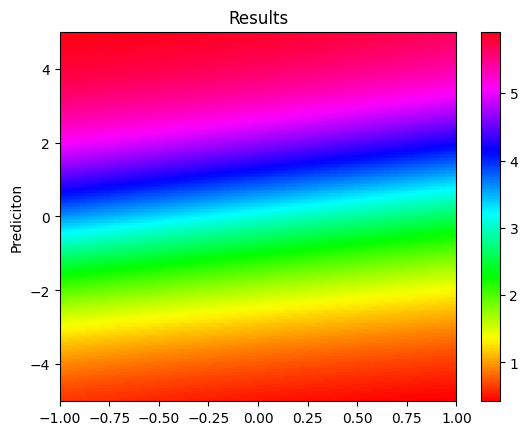

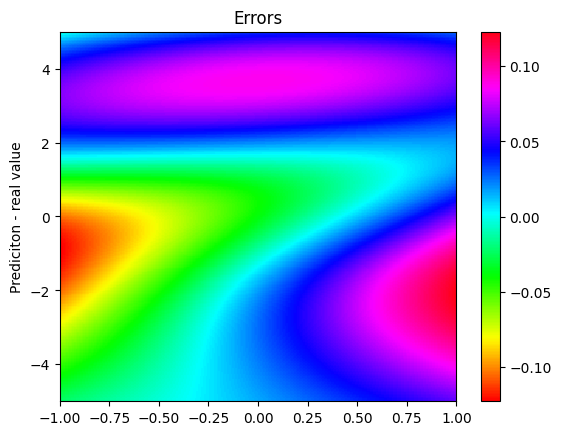


 m =  0.75 

 ####################################################


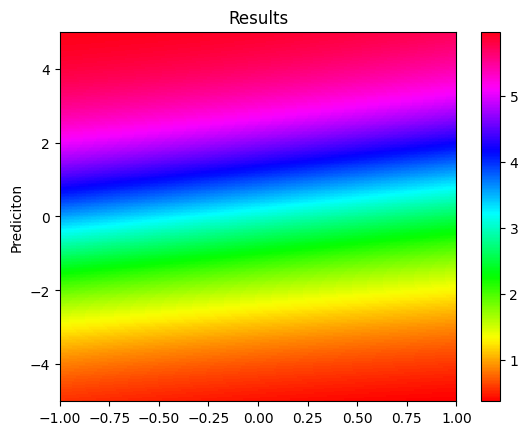

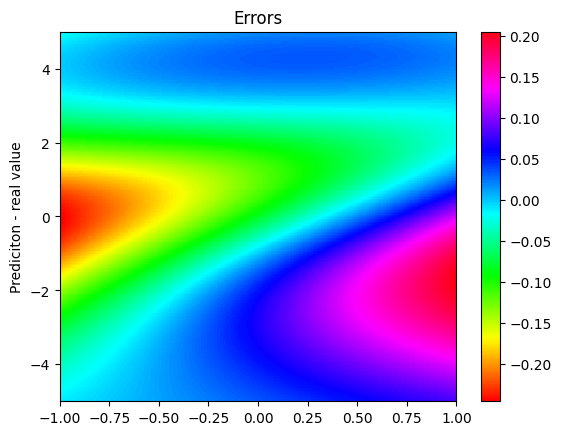


 m =  0.8 

 ####################################################


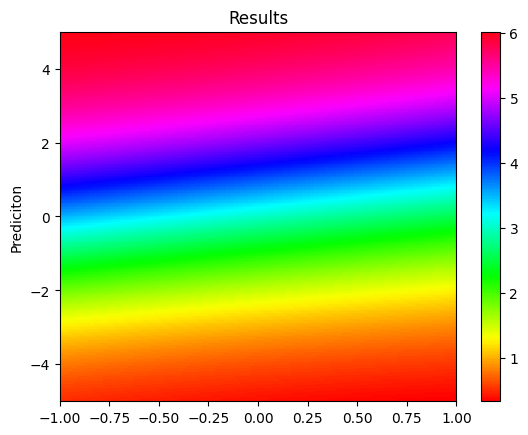

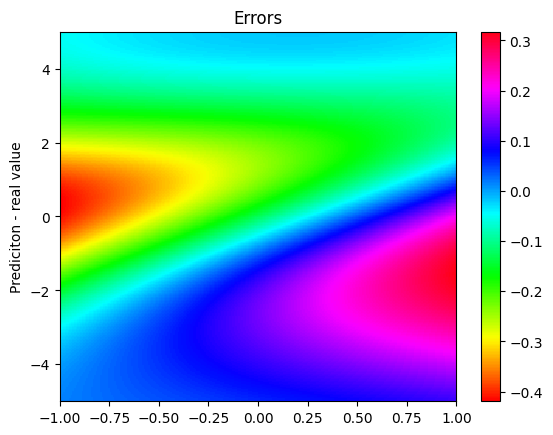

In [ ]:
for i in [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=500,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/6/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

Compiling model...
'compile' took 1.496975 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
5000      [7.59e-05, 2.72e-05, 3.10e-05, 4.30e-04, 7.15e-05]    [7.59e-05, 2.72e-05, 3.10e-05, 4.30e-04, 7.15e-05]    [2.92e-02]    


In [ ]:
for i in [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

#Sine-gordon velocidade variável 1

In [ ]:
#mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/v_variable/1

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*3+5)/10#(0.5,0.8), representa v
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.5], [5, 0.8])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, v, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, v, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    m = 0.3
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, v, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    m = 0.3
    gamma = tf.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=512,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/v_variable/1/model.ckpt")


Compiling model...
Building feed-forward neural network...


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'build' took 0.630996 s

'compile' took 5.617981 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [1.59e-04, 1.44e+01, 1.20e-01, 3.43e+01, 3.79e-01]    [1.59e-04, 1.44e+01, 1.20e-01, 3.43e+01, 3.79e-01]    [1.03e+00]    
1000      [2.38e-04, 1.37e-04, 6.42e-05, 8.29e-04, 2.06e-04]    [2.38e-04, 1.37e-04, 6.42e-05, 8.29e-04, 2.06e-04]    [3.82e-02]    
2000      [1.52e-04, 1.86e-04, 1.28e-04, 9.04e-04, 7.26e-04]    [1.52e-04, 1.86e-04, 1.28e-04, 9.04e-04, 7.26e-04]    [3.30e-02]    
3000      [9.42e-05, 7.75e-05, 6.04e-05, 4.11e-04, 1.10e-04]    [9.42e-05, 7.75e-05, 6.04e-05, 4.11e-04, 1.10e-04]    [2.99e-02]    
4000      [8.01e-05, 6.33e-05, 5.34e-05, 3.56e-04, 7.81e-05]    [8.01e-05, 6.33e-05, 5.34e-05, 3.56e-04, 7.81e-05]    [2.78e-02]    
5000      [7.15e-05, 7.59e-03, 3.49e-05, 9.77e-03, 2.89e-03]    [7.15e-05, 7.59e-03, 3.49e-05, 9.77e-03, 2.89e-03]    [3.09e-02]   


 m =  0.5 

 ####################################################


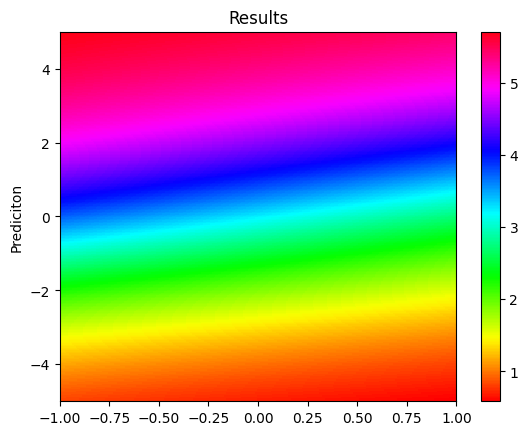

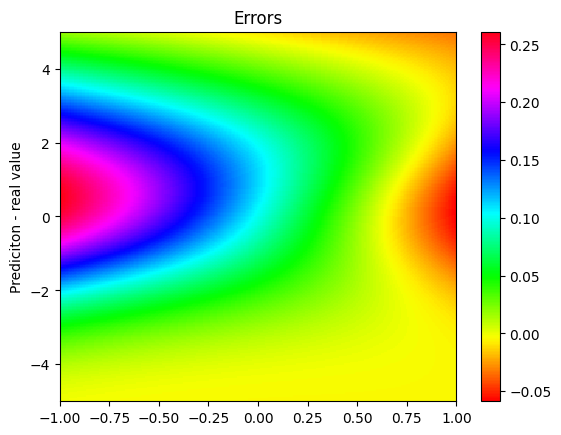


 m =  0.55 

 ####################################################


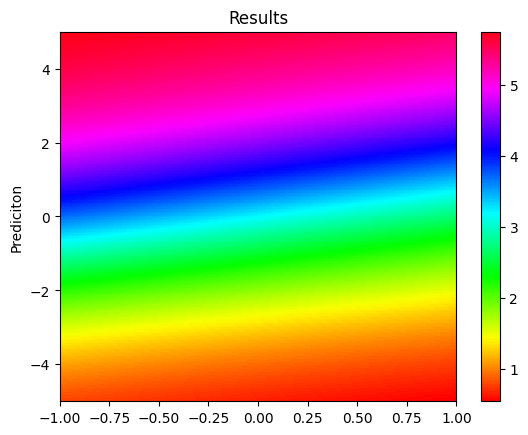

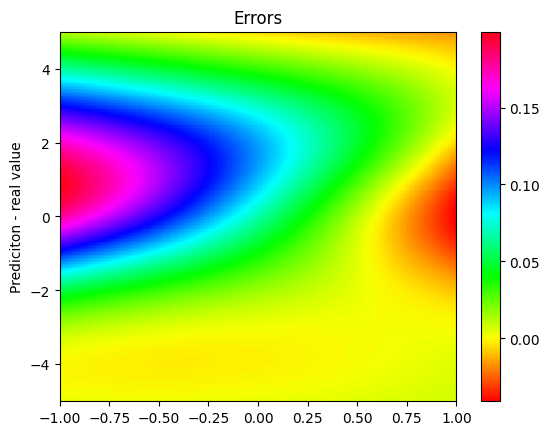


 m =  0.6 

 ####################################################


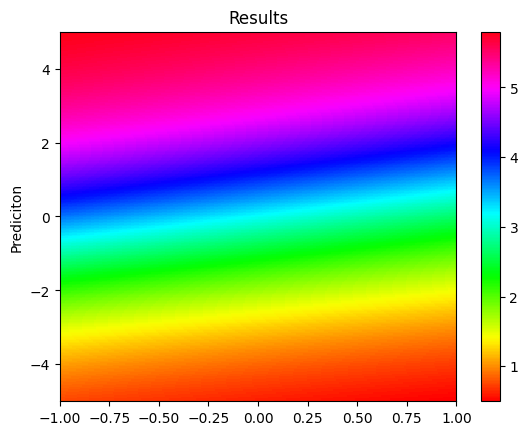

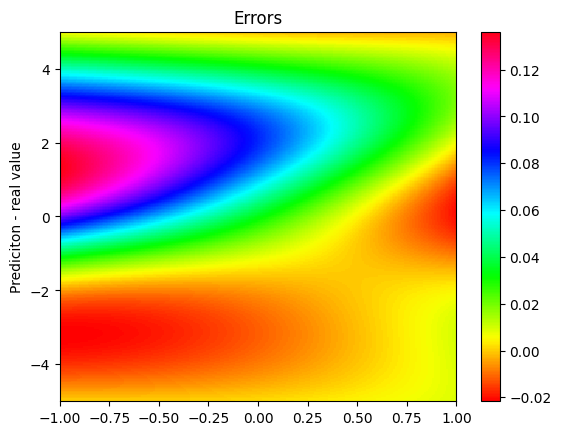


 m =  0.65 

 ####################################################


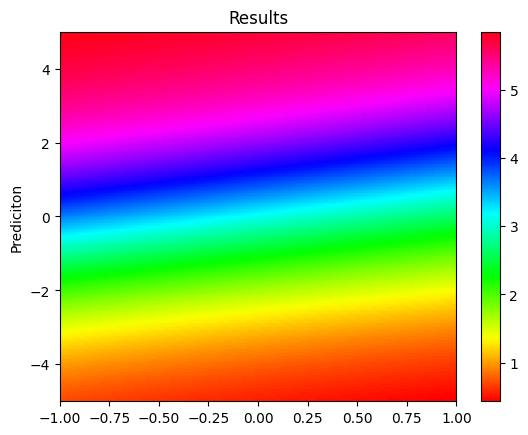

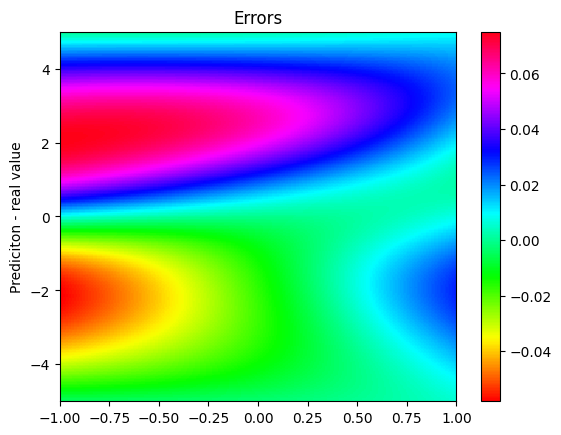


 m =  0.7 

 ####################################################


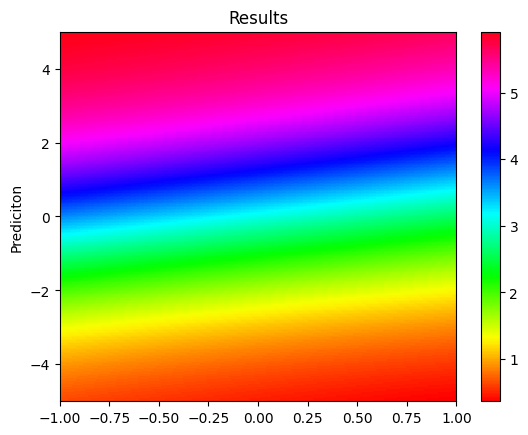

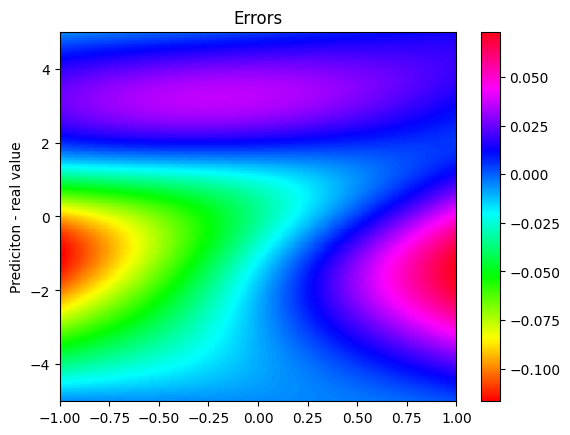


 m =  0.75 

 ####################################################


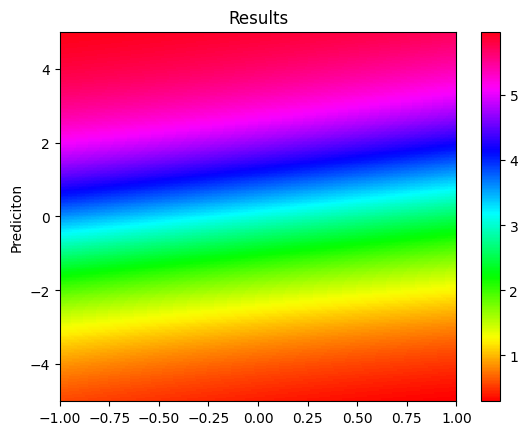

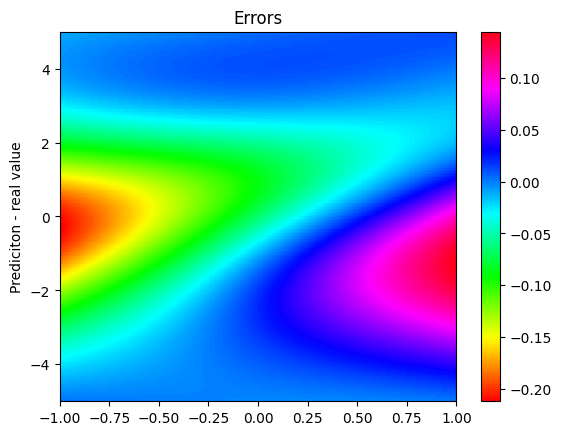


 m =  0.8 

 ####################################################


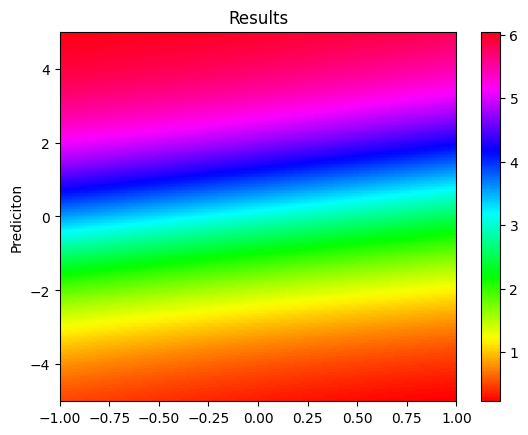

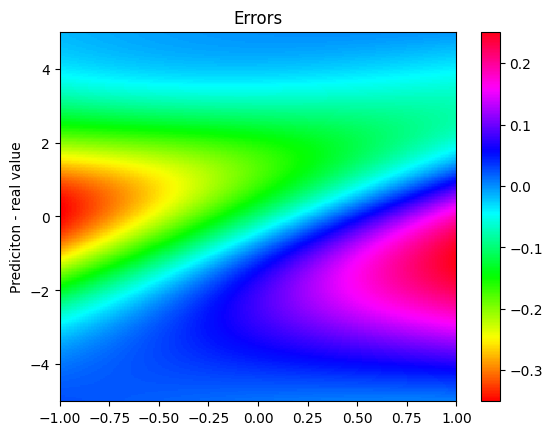

In [ ]:
for i in [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

Compiling model...
'compile' took 2.695246 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
20000     [6.04e-06, 1.13e-06, 2.27e-06, 8.48e-06, 9.32e-06]    [6.04e-06, 1.13e-06, 2.27e-06, 8.48e-06, 9.32e-06]    [1.83e-02]    
20532     [3.16e-06, 3.43e-07, 4.05e-07, 6.54e-07, 1.67e-06]    [3.16e-06, 3.43e-07, 4.05e-07, 6.54e-07, 1.67e-06]    [1.76e-02]    

Best model at step 20532:
  train loss: 6.23e-06
  test loss: 6.23e-06
  test metric: [1.76e-02]

Epoch 20532: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/v_variable/model_lbfgs.ckpt-20532.ckpt ...

'train' took 176.508777 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


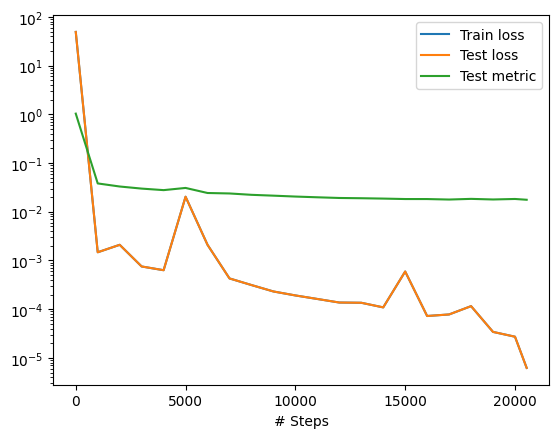

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=500,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/v_variable/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)


 m =  0.5 

 ####################################################


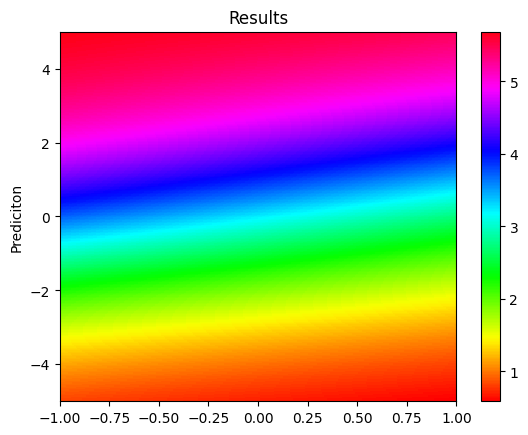

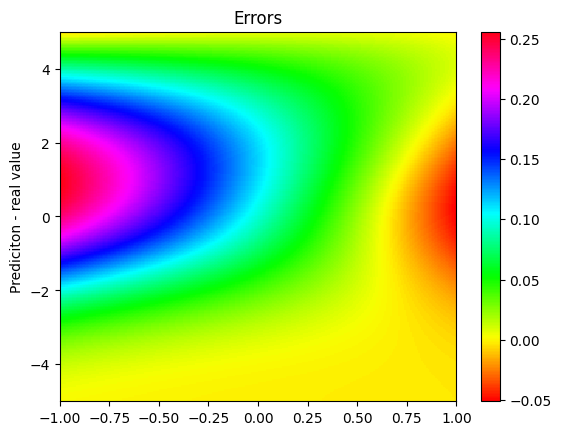


 m =  0.55 

 ####################################################


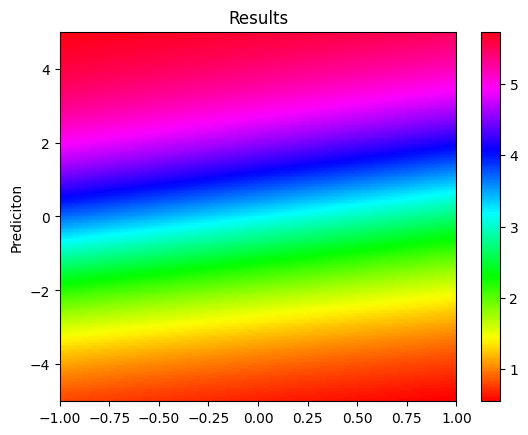

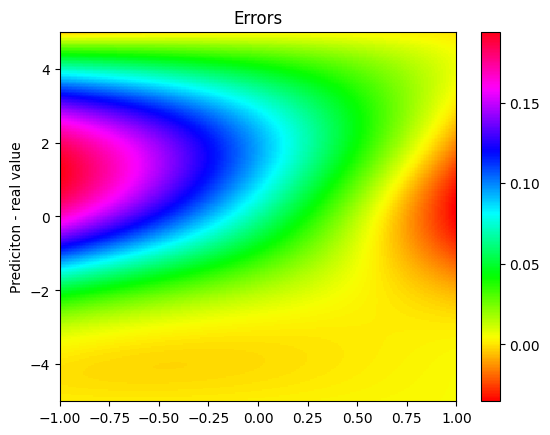


 m =  0.6 

 ####################################################


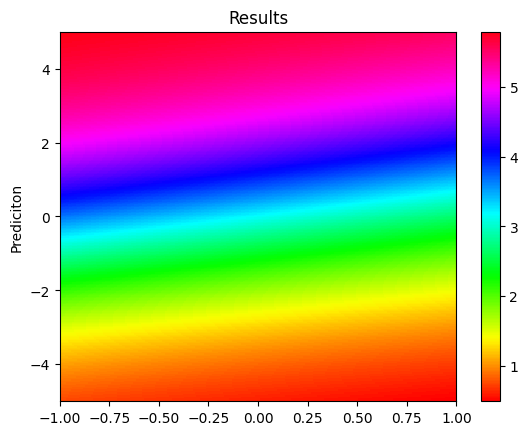

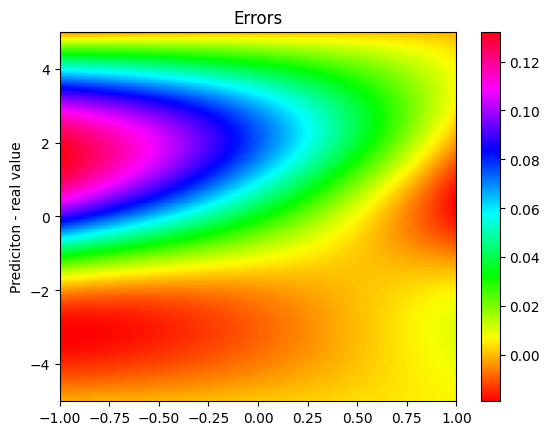


 m =  0.65 

 ####################################################


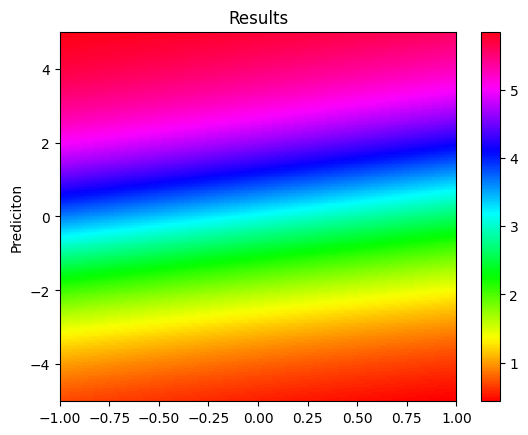

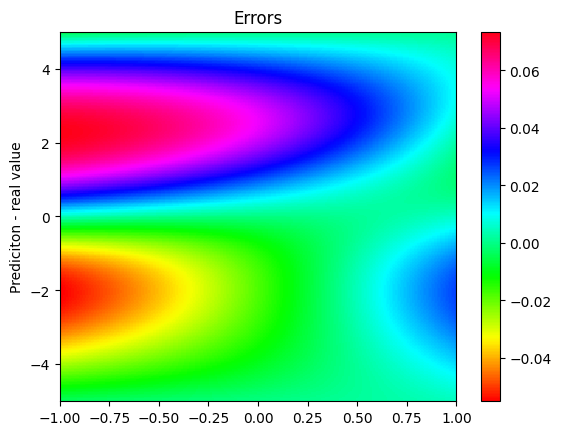


 m =  0.7 

 ####################################################


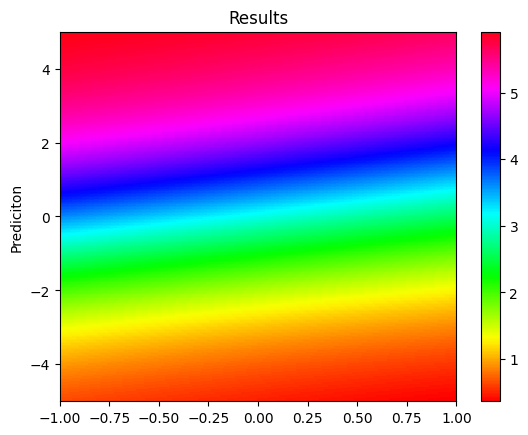

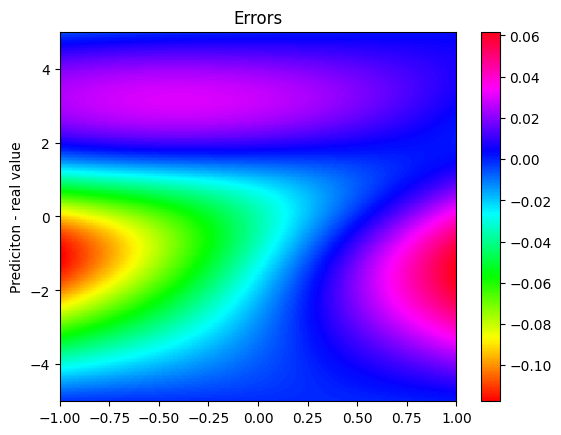


 m =  0.75 

 ####################################################


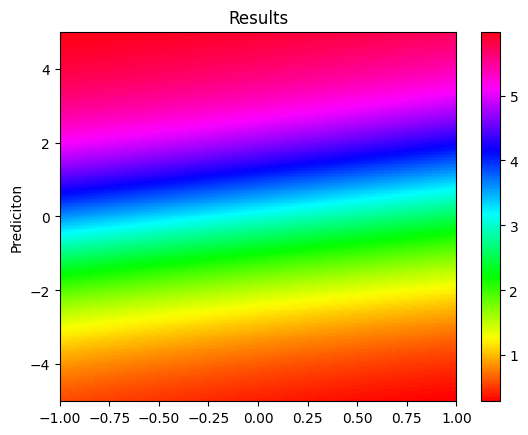

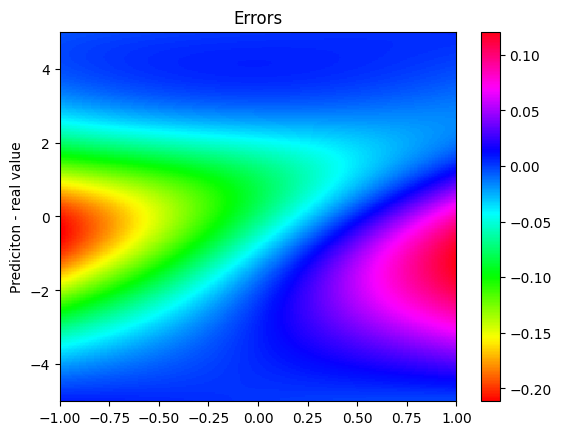


 m =  0.8 

 ####################################################


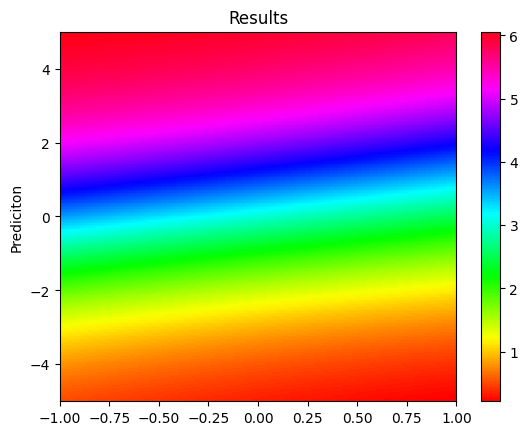

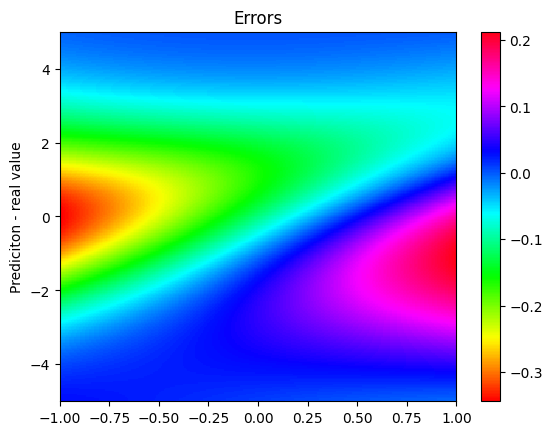

In [ ]:
for i in [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

#Sine-gordon 2 parâmetros variáveis


In [ ]:
mkdir /content/drive/MyDrive/trained_models/sine-gordon_variable/2_parameters/1

In [ ]:
import deepxde as dde

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*3+5)/10#(0.5,0.8), representa v
x3 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,x3,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Cuboid([-5, 0.5,0.2], [5, 0.8,0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=3, j=3)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, v, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3], x[:, 3:4]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, v, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3], x[:, 3:4]
    #m = 0.3
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, v, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3], x[:, 3:4]
    #m = 0.3
    gamma = tf.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[3],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=3) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=1024,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [4] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/2_parameters/1")


Compiling model...
Building feed-forward neural network...
'build' took 0.150018 s

'compile' took 1.577871 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [1.10e-03, 1.33e+01, 9.51e-02, 2.86e+01, 8.67e-01]    [1.10e-03, 1.33e+01, 9.51e-02, 2.86e+01, 8.67e-01]    [9.52e-01]    
1000      [1.23e-03, 2.42e-04, 1.46e-04, 3.13e-04, 1.44e-03]    [1.23e-03, 2.42e-04, 1.46e-04, 3.13e-04, 1.44e-03]    [8.72e-02]    
2000      [7.49e-04, 1.05e-03, 1.06e-04, 2.38e-03, 3.40e-03]    [7.49e-04, 1.05e-03, 1.06e-04, 2.38e-03, 3.40e-03]    [8.81e-02]    
3000      [4.83e-04, 1.59e-03, 6.40e-05, 1.20e-03, 4.23e-03]    [4.83e-04, 1.59e-03, 6.40e-05, 1.20e-03, 4.23e-03]    [8.24e-02]    
4000      [3.12e-04, 4.92e-04, 4.55e-05, 2.51e-04, 1.46e-03]    [3.12e-04, 4.92e-04, 4.55e-05, 2.51e-04, 1.46e-03]    [7.62e-02]    
5000      [2.29e-04, 4.01e-04, 3.34e-05, 1.44e-04, 1.25e-03]    [2.29e-0

In [ ]:
m

array([[0.20333333],
       [0.20333333],
       [0.20333333],
       ...,
       [0.20333333],
       [0.20333333],
       [0.20333333]])


 m =  0.5 v =  0.2000033333333333 

 ####################################################


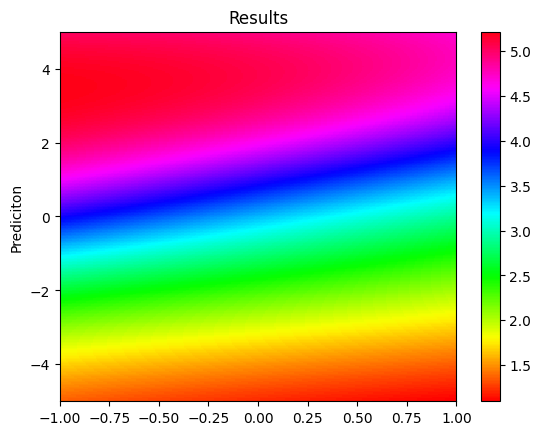

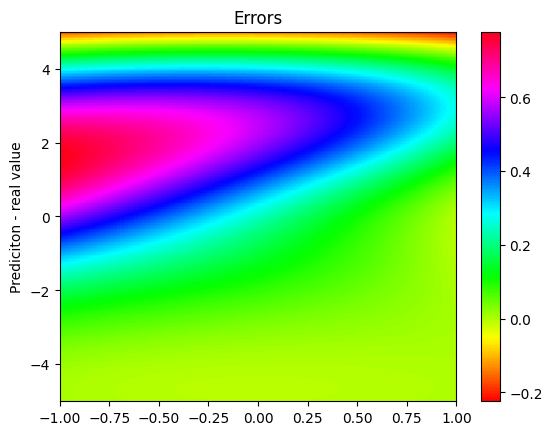


 m =  0.55 v =  0.2333366666666667 

 ####################################################


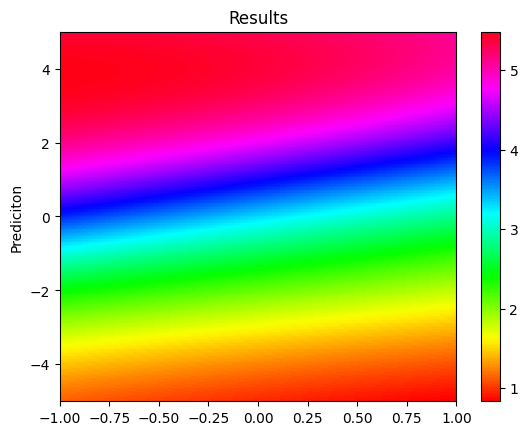

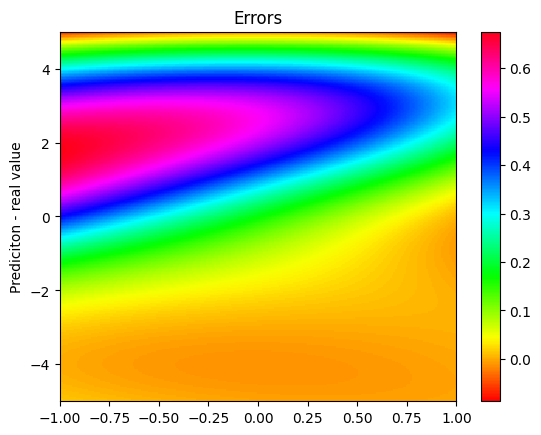


 m =  0.6 v =  0.26666999999999996 

 ####################################################


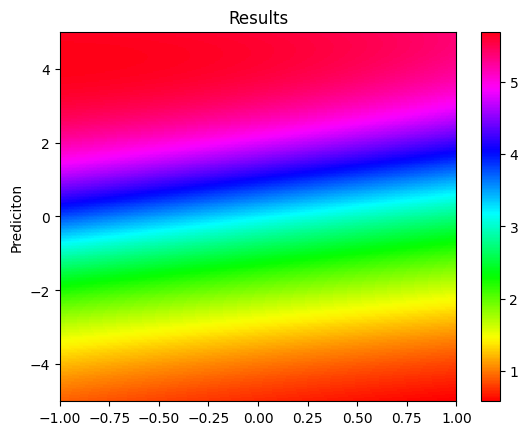

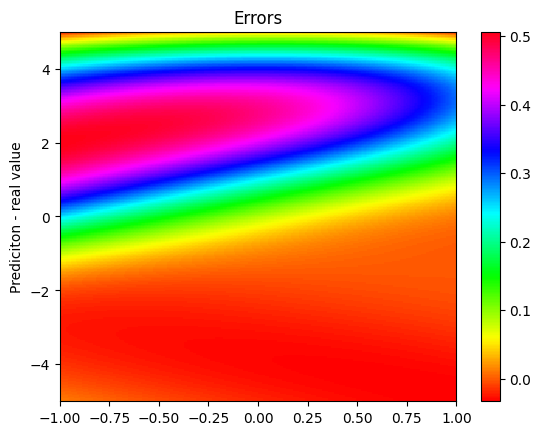


 m =  0.65 v =  0.30000333333333334 

 ####################################################


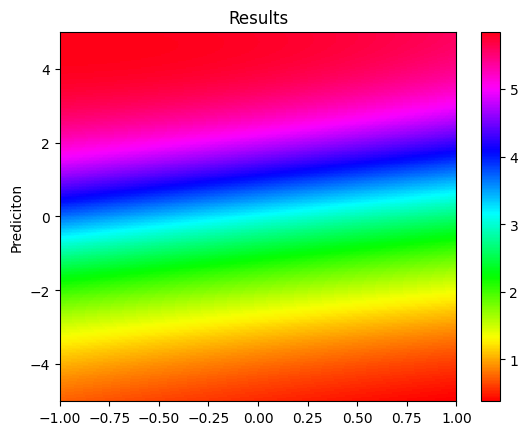

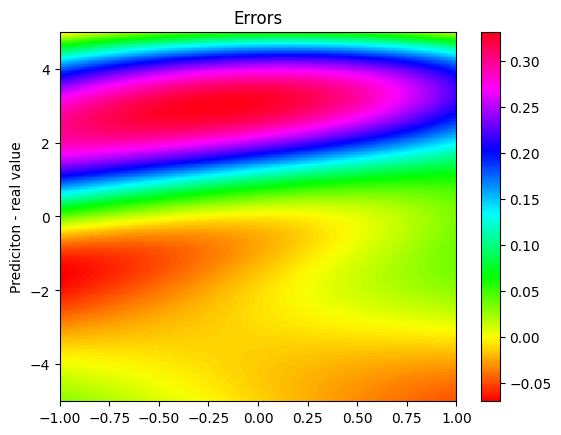


 m =  0.7 v =  0.3333366666666666 

 ####################################################


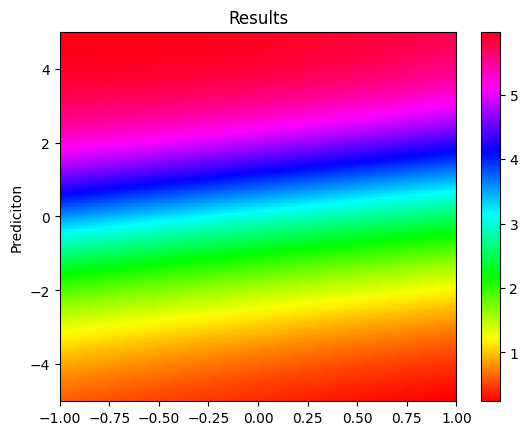

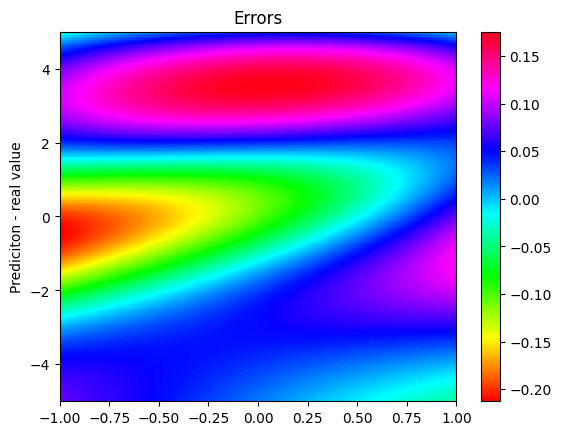


 m =  0.75 v =  0.36667 

 ####################################################


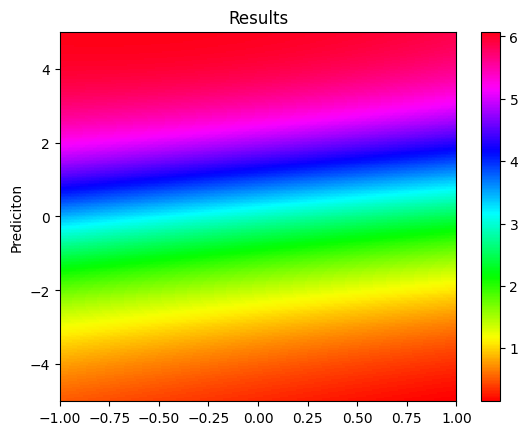

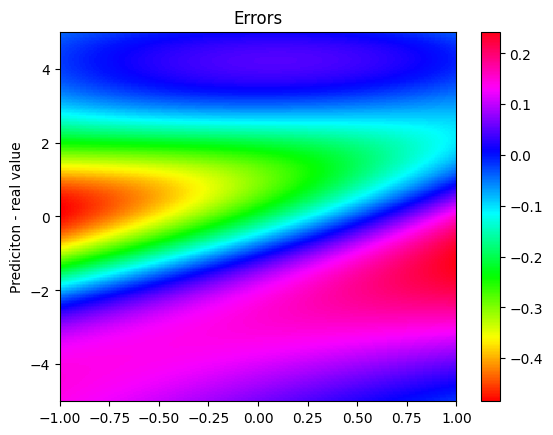


 m =  0.8 v =  0.4000033333333333 

 ####################################################


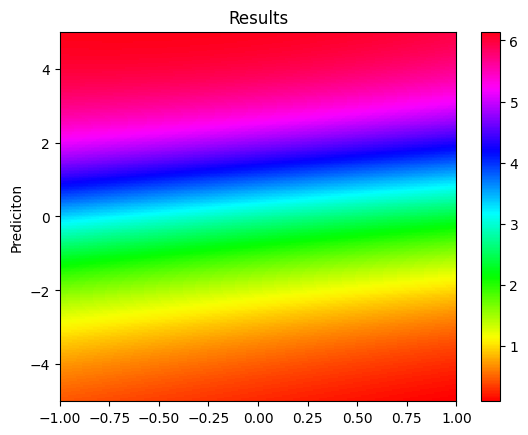

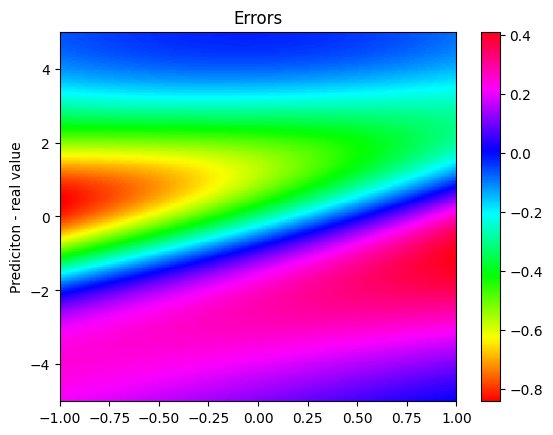

In [ ]:
for i in [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8]:
    print("\n m = ",i, "v = ", i*(2/3)-0.13333, "\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i*(2/3)-0.13333
    v= (np.ones(65536)*i)
    #m=m.reshape(-1,1)
    m=np.vstack(m)
    v = np.vstack(v)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1, v, m, t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

Compiling model...
'compile' took 2.695246 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
20000     [6.04e-06, 1.13e-06, 2.27e-06, 8.48e-06, 9.32e-06]    [6.04e-06, 1.13e-06, 2.27e-06, 8.48e-06, 9.32e-06]    [1.83e-02]    
20532     [3.16e-06, 3.43e-07, 4.05e-07, 6.54e-07, 1.67e-06]    [3.16e-06, 3.43e-07, 4.05e-07, 6.54e-07, 1.67e-06]    [1.76e-02]    

Best model at step 20532:
  train loss: 6.23e-06
  test loss: 6.23e-06
  test metric: [1.76e-02]

Epoch 20532: saving model to /content/drive/MyDrive/trained_models/sine-gordon_variable/v_variable/model_lbfgs.ckpt-20532.ckpt ...

'train' took 176.508777 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


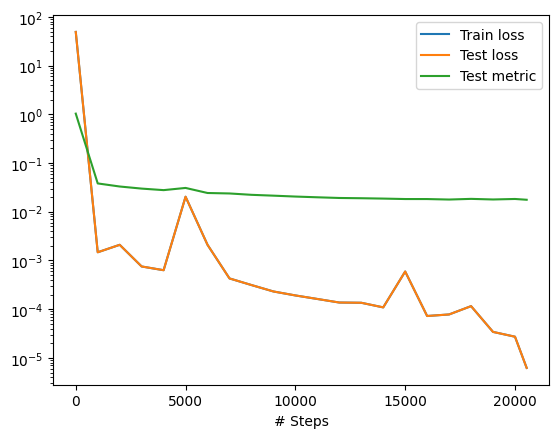

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=500,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_variable/v_variable/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)


 m =  0.5 

 ####################################################


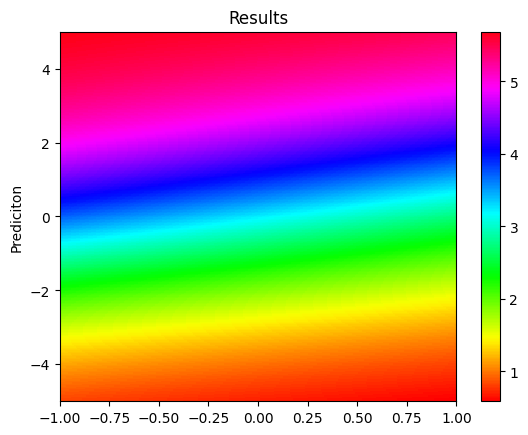

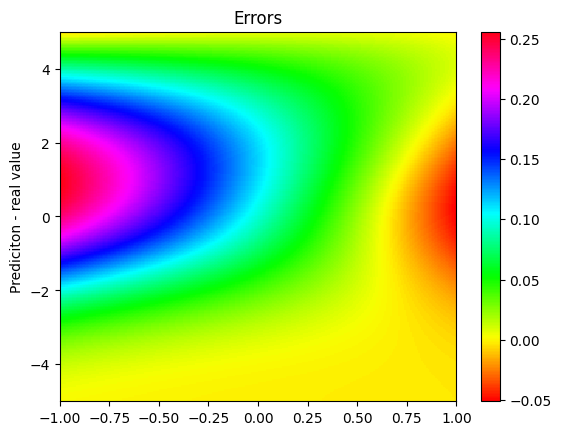


 m =  0.55 

 ####################################################


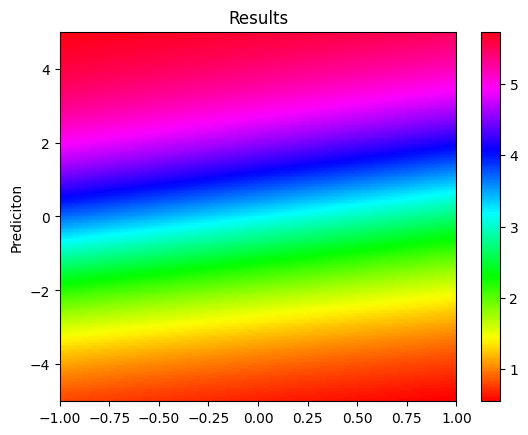

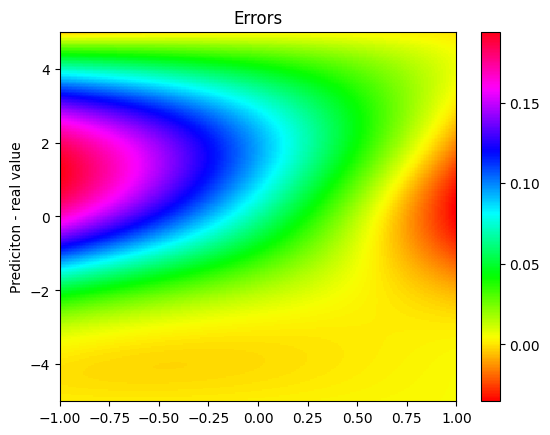


 m =  0.6 

 ####################################################


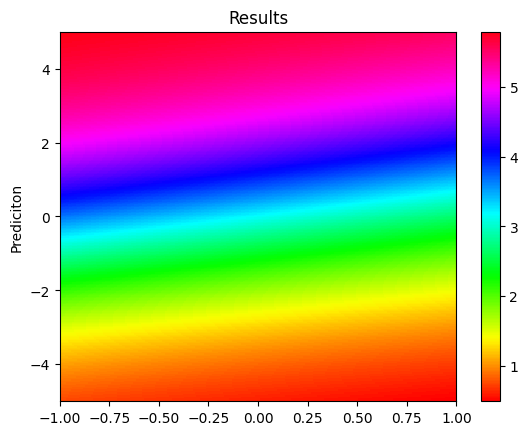

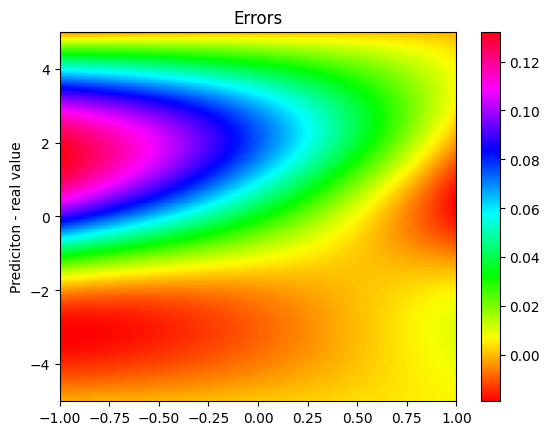


 m =  0.65 

 ####################################################


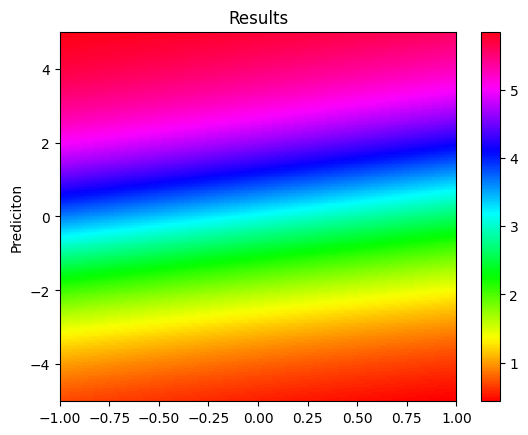

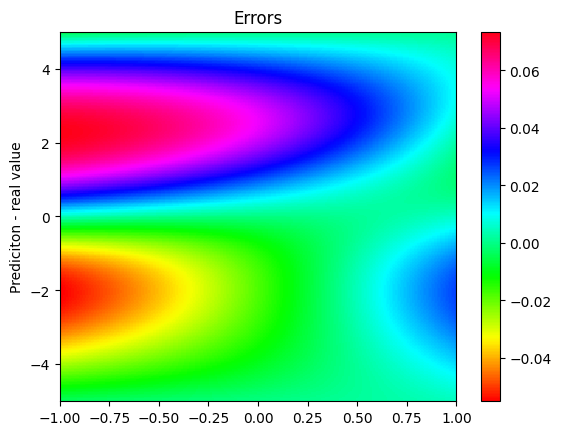


 m =  0.7 

 ####################################################


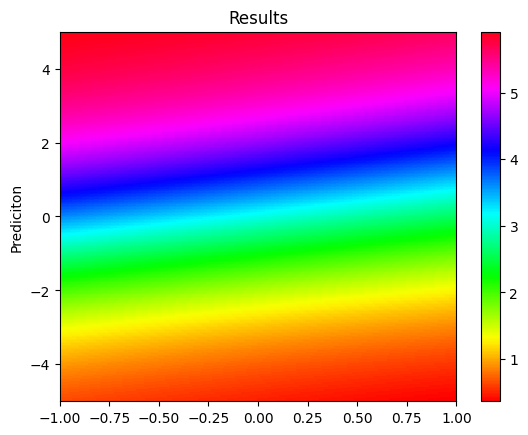

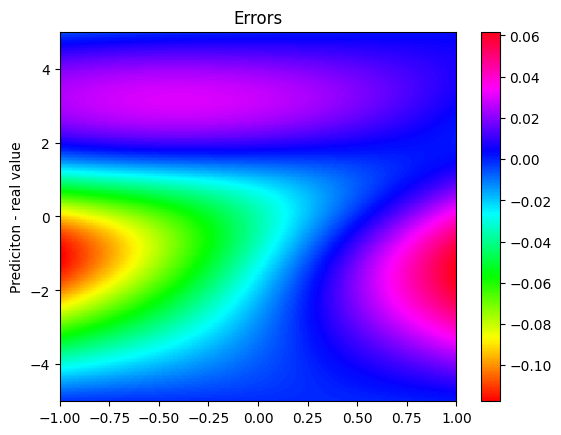


 m =  0.75 

 ####################################################


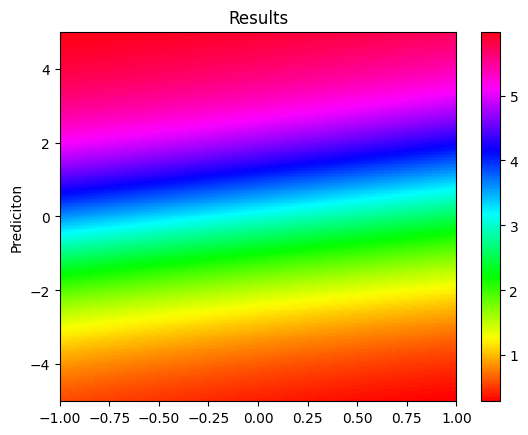

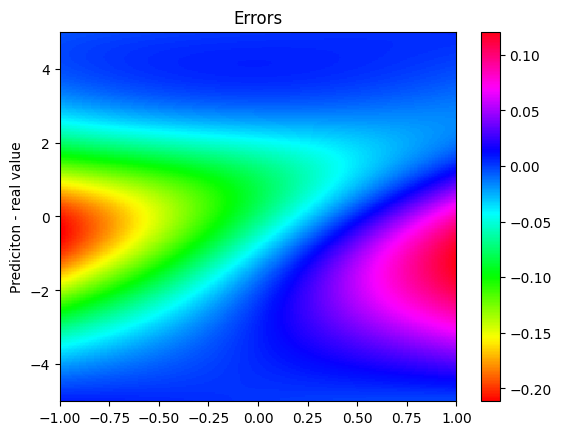


 m =  0.8 

 ####################################################


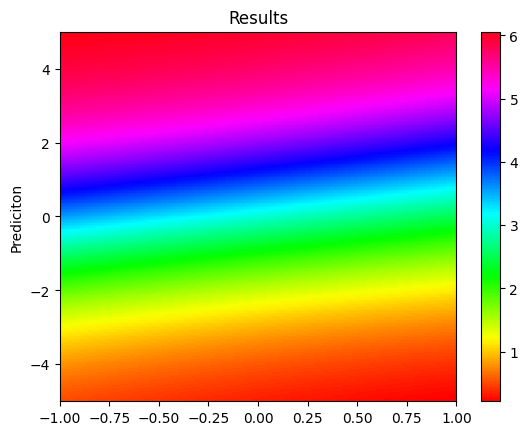

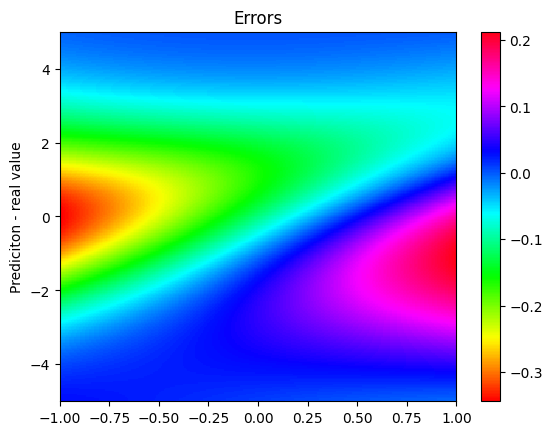

In [ ]:
for i in [0.5, 0.55, 0.6, 0.65, 0.7, 0.75, 0.8]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(-1, 1, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[-1, 1, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

#optuna:

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)


In [ ]:
def objective(trial):

    n_layers = trial.suggest_int('n_layers', 1, 10)
    n_neurons = trial.suggest_int('n_neurons', 8, 1024)
    #name_activation = trial.suggest_categorical('activation', ['relu', 'sigmoid', 'tanh'])
    #n_lr = trial.suggest_float('n_lr', 0.0001, 0.01)

    layer_size = [3] + [n_neurons] * n_layers + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)
    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )

    early_stopping=dde.callbacks.EarlyStopping(monitor='loss_test', min_delta=1e-6, patience=100)

    losshistory, train_state = model.train(epochs=2000, callbacks=[early_stopping],display_every=10)

    score = losshistory.loss_test[-1][0]+losshistory.loss_test[-1][1]+losshistory.loss_test[-1][2]
    trial.set_user_attr("Score", score)

    return score

study = optuna.create_study(direction='minimize')#(direction='maximize')
study.optimize(objective, n_trials=50, gc_after_trial=True)

[I 2024-02-07 21:54:31,126] A new study created in memory with name: no-name-be52335f-2969-4f44-b74f-0da2cbe9d959


Compiling model...
Building feed-forward neural network...
'build' took 0.154029 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 2.472915 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.81e-05, 1.38e+01, 1.39e-01]    [1.81e-05, 1.38e+01, 1.39e-01]    [9.94e-01]    
10        [1.06e-02, 3.60e+00, 1.60e-01]    [1.06e-02, 3.60e+00, 1.60e-01]    [4.59e-01]    
20        [1.45e-02, 4.78e-01, 2.38e-01]    [1.45e-02, 4.78e-01, 2.38e-01]    [2.29e-01]    
30        [2.85e-03, 2.91e-01, 9.91e-02]    [2.85e-03, 2.91e-01, 9.91e-02]    [1.25e-01]    
40        [2.44e-03, 1.88e-01, 1.30e-02]    [2.44e-03, 1.88e-01, 1.30e-02]    [1.07e-01]    
50        [2.39e-03, 8.99e-02, 1.20e-02]    [2.39e-03, 8.99e-02, 1.20e-02]    [1.17e-01]    
60        [1.94e-03, 6.20e-02, 1.07e-02]    [1.94e-03, 6.20e-02, 1.07e-02]    [1.23e-01]    
70        [1.59e-03, 3.97e-02, 7.66e-03]    [1.59e-03, 3.97e-02, 7.66e-03]    [1.06e-01]    
80        [2.09e-03, 1.93e-02, 4.37e-03]    [2.09e-03, 1.93e-02, 4.37e-03]    [1.08e-01]    
90        [3.34e-03, 5.8

[I 2024-02-07 21:56:23,945] Trial 0 finished with value: 0.0007424238719977438 and parameters: {'n_layers': 5, 'n_neurons': 707}. Best is trial 0 with value: 0.0007424238719977438.


Compiling model...
Building feed-forward neural network...
'build' took 0.234427 s

'compile' took 5.145657 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.13e-03, 1.38e+01, 1.52e-01]    [1.13e-03, 1.38e+01, 1.52e-01]    [9.93e-01]    
10        [6.99e-02, 4.56e+00, 1.01e-01]    [6.99e-02, 4.56e+00, 1.01e-01]    [5.74e-01]    
20        [1.14e-02, 1.05e+00, 1.96e-01]    [1.14e-02, 1.05e+00, 1.96e-01]    [3.24e-01]    
30        [3.23e-02, 3.95e-01, 4.38e-02]    [3.23e-02, 3.95e-01, 4.38e-02]    [1.95e-01]    
40        [3.53e-02, 2.08e-01, 1.31e-02]    [3.53e-02, 2.08e-01, 1.31e-02]    [1.37e-01]    
50        [7.38e-03, 3.97e-02, 8.54e-03]    [7.38e-03, 3.97e-02, 8.54e-03]    [1.11e-01]    
60        [3.61e-03, 9.50e-03, 4.28e-03]    [3.61e-03, 9.50e-03, 4.28e-03]    [1.08e-01]    
70        [6.55e-03, 3.20e-03, 2.68e-03]    [6.55e-03, 3.20e-03, 2.68e-03]    [1.14e-01]    
80        [4.09e-03, 3.29e-03, 1.

[I 2024-02-07 21:56:53,961] Trial 1 finished with value: 0.0007730508223176003 and parameters: {'n_layers': 10, 'n_neurons': 45}. Best is trial 0 with value: 0.0007424238719977438.


Compiling model...
Building feed-forward neural network...
'build' took 0.336364 s

'compile' took 3.943006 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.92e-03, 1.49e+01, 6.36e-02]    [1.92e-03, 1.49e+01, 6.36e-02]    [1.04e+00]    
10        [2.68e-02, 1.31e+00, 2.25e-01]    [2.68e-02, 1.31e+00, 2.25e-01]    [4.08e-01]    
20        [1.24e-02, 3.55e-01, 3.37e-02]    [1.24e-02, 3.55e-01, 3.37e-02]    [1.91e-01]    
30        [1.02e-02, 1.48e-01, 3.62e-02]    [1.02e-02, 1.48e-01, 3.62e-02]    [1.57e-01]    
40        [5.44e-03, 4.48e-02, 1.51e-02]    [5.44e-03, 4.48e-02, 1.51e-02]    [1.08e-01]    
50        [6.90e-03, 8.59e-03, 3.50e-03]    [6.90e-03, 8.59e-03, 3.50e-03]    [9.92e-02]    
60        [7.19e-03, 1.93e-03, 3.97e-03]    [7.19e-03, 1.93e-03, 3.97e-03]    [1.00e-01]    
70        [3.87e-03, 2.09e-03, 3.58e-03]    [3.87e-03, 2.09e-03, 3.58e-03]    [9.61e-02]    
80        [3.98e-03, 1.95e-03, 1.

[I 2024-02-07 21:57:31,148] Trial 2 finished with value: 0.0006818857509642839 and parameters: {'n_layers': 7, 'n_neurons': 253}. Best is trial 2 with value: 0.0006818857509642839.


Compiling model...
Building feed-forward neural network...
'build' took 0.039986 s

'compile' took 0.958338 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.43e-05, 1.43e+01, 1.10e-01]    [2.43e-05, 1.43e+01, 1.10e-01]    [1.01e+00]    
10        [5.98e-03, 8.30e+00, 1.69e-02]    [5.98e-03, 8.30e+00, 1.69e-02]    [7.51e-01]    
20        [5.69e-03, 5.41e+00, 2.08e-02]    [5.69e-03, 5.41e+00, 2.08e-02]    [5.96e-01]    
30        [3.88e-03, 2.68e+00, 1.64e-02]    [3.88e-03, 2.68e+00, 1.64e-02]    [4.13e-01]    
40        [4.48e-03, 7.85e-01, 1.56e-02]    [4.48e-03, 7.85e-01, 1.56e-02]    [2.10e-01]    
50        [4.62e-03, 9.59e-02, 1.52e-02]    [4.62e-03, 9.59e-02, 1.52e-02]    [9.26e-02]    
60        [4.66e-03, 1.09e-01, 1.52e-02]    [4.66e-03, 1.09e-01, 1.52e-02]    [1.49e-01]    
70        [4.49e-03, 1.09e-01, 1.51e-02]    [4.49e-03, 1.09e-01, 1.51e-02]    [1.43e-01]    
80        [4.63e-03, 6.94e-02, 1.

[I 2024-02-07 21:57:46,416] Trial 3 finished with value: 0.0008475826471112669 and parameters: {'n_layers': 1, 'n_neurons': 934}. Best is trial 2 with value: 0.0006818857509642839.


Compiling model...
Building feed-forward neural network...
'build' took 0.119478 s

'compile' took 2.596664 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.32e-05, 1.39e+01, 2.74e-02]    [4.32e-05, 1.39e+01, 2.74e-02]    [9.99e-01]    
10        [1.01e-02, 1.74e+00, 1.55e-01]    [1.01e-02, 1.74e+00, 1.55e-01]    [4.04e-01]    
20        [1.04e-02, 1.02e+00, 5.83e-02]    [1.04e-02, 1.02e+00, 5.83e-02]    [2.23e-01]    
30        [5.10e-03, 3.32e-01, 1.08e-01]    [5.10e-03, 3.32e-01, 1.08e-01]    [1.95e-01]    
40        [1.21e-02, 1.28e-01, 9.77e-02]    [1.21e-02, 1.28e-01, 9.77e-02]    [1.38e-01]    
50        [3.76e-03, 9.92e-02, 3.62e-02]    [3.76e-03, 9.92e-02, 3.62e-02]    [1.41e-01]    
60        [4.08e-03, 8.95e-02, 1.56e-02]    [4.08e-03, 8.95e-02, 1.56e-02]    [1.26e-01]    
70        [2.24e-03, 5.94e-02, 1.25e-02]    [2.24e-03, 5.94e-02, 1.25e-02]    [1.12e-01]    
80        [2.35e-03, 3.62e-02, 6.

[I 2024-02-07 21:58:36,225] Trial 4 finished with value: 0.0005960675771348178 and parameters: {'n_layers': 5, 'n_neurons': 399}. Best is trial 4 with value: 0.0005960675771348178.


Compiling model...
Building feed-forward neural network...
'build' took 0.045563 s

'compile' took 1.028134 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.03e-03, 1.32e+01, 1.68e-01]    [1.03e-03, 1.32e+01, 1.68e-01]    [9.69e-01]    
10        [5.49e-03, 8.17e+00, 1.51e-02]    [5.49e-03, 8.17e+00, 1.51e-02]    [7.44e-01]    
20        [5.18e-03, 4.90e+00, 3.11e-02]    [5.18e-03, 4.90e+00, 3.11e-02]    [5.67e-01]    
30        [3.96e-03, 2.16e+00, 1.54e-02]    [3.96e-03, 2.16e+00, 1.54e-02]    [3.68e-01]    
40        [4.62e-03, 4.29e-01, 1.54e-02]    [4.62e-03, 4.29e-01, 1.54e-02]    [1.46e-01]    
50        [4.97e-03, 7.67e-02, 1.55e-02]    [4.97e-03, 7.67e-02, 1.55e-02]    [1.31e-01]    
60        [4.56e-03, 1.49e-01, 1.53e-02]    [4.56e-03, 1.49e-01, 1.53e-02]    [1.61e-01]    
70        [4.76e-03, 8.70e-02, 1.51e-02]    [4.76e-03, 8.70e-02, 1.51e-02]    [1.36e-01]    
80        [4.76e-03, 6.59e-02, 1.

[I 2024-02-07 21:58:52,958] Trial 5 finished with value: 0.001002678764052689 and parameters: {'n_layers': 1, 'n_neurons': 1022}. Best is trial 4 with value: 0.0005960675771348178.


Compiling model...
Building feed-forward neural network...
'build' took 0.078779 s

'compile' took 2.029309 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.84e-04, 1.45e+01, 2.26e-01]    [1.84e-04, 1.45e+01, 2.26e-01]    [1.02e+00]    
10        [3.58e-03, 7.56e-01, 1.92e-02]    [3.58e-03, 7.56e-01, 1.92e-02]    [2.75e-01]    
20        [6.68e-03, 1.02e-01, 1.61e-02]    [6.68e-03, 1.02e-01, 1.61e-02]    [1.62e-01]    
30        [6.84e-03, 1.04e-01, 2.32e-02]    [6.84e-03, 1.04e-01, 2.32e-02]    [1.36e-01]    
40        [6.32e-03, 1.23e-01, 1.81e-02]    [6.32e-03, 1.23e-01, 1.81e-02]    [1.30e-01]    
50        [6.30e-03, 9.19e-02, 1.35e-02]    [6.30e-03, 9.19e-02, 1.35e-02]    [1.51e-01]    
60        [6.04e-03, 8.12e-02, 1.34e-02]    [6.04e-03, 8.12e-02, 1.34e-02]    [1.46e-01]    
70        [5.81e-03, 7.78e-02, 1.35e-02]    [5.81e-03, 7.78e-02, 1.35e-02]    [1.67e-01]    
80        [5.15e-03, 7.17e-02, 1.

[I 2024-02-07 21:59:38,937] Trial 6 finished with value: 0.0007565380656160414 and parameters: {'n_layers': 3, 'n_neurons': 595}. Best is trial 4 with value: 0.0005960675771348178.


Compiling model...
Building feed-forward neural network...
'build' took 0.211706 s

'compile' took 2.538389 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.56e-05, 1.38e+01, 7.48e-02]    [4.56e-05, 1.38e+01, 7.48e-02]    [9.93e-01]    
10        [4.69e-02, 2.15e+00, 3.13e-01]    [4.69e-02, 2.15e+00, 3.13e-01]    [4.85e-01]    
20        [1.53e-02, 2.82e-01, 4.00e-02]    [1.53e-02, 2.82e-01, 4.00e-02]    [1.40e-01]    
30        [2.80e-03, 6.60e-02, 4.17e-03]    [2.80e-03, 6.60e-02, 4.17e-03]    [8.35e-02]    
40        [7.15e-03, 1.85e-02, 4.62e-03]    [7.15e-03, 1.85e-02, 4.62e-03]    [1.36e-01]    
50        [5.10e-03, 1.15e-02, 3.53e-03]    [5.10e-03, 1.15e-02, 3.53e-03]    [1.21e-01]    
60        [3.77e-03, 1.74e-03, 2.12e-03]    [3.77e-03, 1.74e-03, 2.12e-03]    [1.03e-01]    
70        [4.42e-03, 2.27e-03, 5.78e-04]    [4.42e-03, 2.27e-03, 5.78e-04]    [9.56e-02]    
80        [3.83e-03, 5.22e-04, 9.

[I 2024-02-07 22:00:35,337] Trial 7 finished with value: 0.0007811541436240077 and parameters: {'n_layers': 9, 'n_neurons': 292}. Best is trial 4 with value: 0.0005960675771348178.


Compiling model...
Building feed-forward neural network...
'build' took 0.110645 s

'compile' took 1.859176 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.98e-03, 1.53e+01, 3.52e-01]    [3.98e-03, 1.53e+01, 3.52e-01]    [1.05e+00]    
10        [1.64e-02, 8.89e+00, 4.16e-02]    [1.64e-02, 8.89e+00, 4.16e-02]    [7.86e-01]    
20        [3.46e-02, 5.84e+00, 2.49e-02]    [3.46e-02, 5.84e+00, 2.49e-02]    [6.24e-01]    
30        [4.38e-02, 2.40e+00, 4.89e-02]    [4.38e-02, 2.40e+00, 4.89e-02]    [4.11e-01]    
40        [6.42e-02, 6.06e-01, 8.47e-02]    [6.42e-02, 6.06e-01, 8.47e-02]    [2.11e-01]    
50        [4.52e-02, 4.59e-01, 7.14e-02]    [4.52e-02, 4.59e-01, 7.14e-02]    [2.06e-01]    
60        [3.06e-02, 3.86e-01, 4.68e-02]    [3.06e-02, 3.86e-01, 4.68e-02]    [1.90e-01]    
70        [2.34e-02, 2.57e-01, 1.96e-02]    [2.34e-02, 2.57e-01, 1.96e-02]    [1.56e-01]    
80        [2.02e-02, 1.99e-01, 9.

[I 2024-02-07 22:00:53,128] Trial 8 finished with value: 0.0009472773526795208 and parameters: {'n_layers': 5, 'n_neurons': 28}. Best is trial 4 with value: 0.0005960675771348178.


Compiling model...
Building feed-forward neural network...
'build' took 0.141178 s

'compile' took 2.996268 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.01e-04, 1.47e+01, 2.42e-01]    [5.01e-04, 1.47e+01, 2.42e-01]    [1.03e+00]    
10        [1.88e-02, 1.64e+01, 3.00e-02]    [1.88e-02, 1.64e+01, 3.00e-02]    [1.11e+00]    
20        [3.02e-02, 3.75e+00, 6.95e-02]    [3.02e-02, 3.75e+00, 6.95e-02]    [5.36e-01]    
30        [2.73e-03, 4.07e-01, 1.46e-02]    [2.73e-03, 4.07e-01, 1.46e-02]    [1.44e-01]    
40        [4.50e-03, 2.30e-01, 7.87e-03]    [4.50e-03, 2.30e-01, 7.87e-03]    [1.93e-01]    
50        [9.20e-03, 3.51e-02, 4.65e-03]    [9.20e-03, 3.51e-02, 4.65e-03]    [1.18e-01]    
60        [3.96e-03, 1.58e-02, 3.73e-03]    [3.96e-03, 1.58e-02, 3.73e-03]    [7.82e-02]    
70        [3.42e-03, 1.56e-02, 8.14e-04]    [3.42e-03, 1.56e-02, 8.14e-04]    [6.97e-02]    
80        [3.45e-03, 3.21e-03, 6.

[I 2024-02-07 22:05:37,046] Trial 9 finished with value: 0.0005083633586764336 and parameters: {'n_layers': 6, 'n_neurons': 996}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.271943 s

'compile' took 2.489483 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.65e-04, 1.41e+01, 7.49e-02]    [1.65e-04, 1.41e+01, 7.49e-02]    [1.01e+00]    
10        [9.36e-03, 9.69e+00, 3.77e-02]    [9.36e-03, 9.69e+00, 3.77e-02]    [8.84e-01]    
20        [3.75e-02, 2.50e+00, 3.10e-02]    [3.75e-02, 2.50e+00, 3.10e-02]    [4.89e-01]    
30        [7.31e-03, 7.07e-01, 1.39e-02]    [7.31e-03, 7.07e-01, 1.39e-02]    [2.01e-01]    
40        [7.89e-03, 1.99e-01, 6.65e-03]    [7.89e-03, 1.99e-01, 6.65e-03]    [1.79e-01]    
50        [4.48e-03, 1.14e-02, 5.66e-04]    [4.48e-03, 1.14e-02, 5.66e-04]    [8.98e-02]    
60        [4.56e-03, 2.99e-02, 7.85e-04]    [4.56e-03, 2.99e-02, 7.85e-04]    [8.83e-02]    
70        [3.41e-03, 1.68e-03, 5.26e-05]    [3.41e-03, 1.68e-03, 5.26e-05]    [9.03e-02]    
80        [2.95e-03, 2.12e-03, 1.

[I 2024-02-07 22:08:28,830] Trial 10 finished with value: 0.0007537463679909706 and parameters: {'n_layers': 7, 'n_neurons': 793}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.174663 s

'compile' took 3.862514 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.35e-05, 1.39e+01, 1.74e-01]    [3.35e-05, 1.39e+01, 1.74e-01]    [9.97e-01]    
10        [5.76e-03, 1.97e+00, 2.20e-01]    [5.76e-03, 1.97e+00, 2.20e-01]    [3.90e-01]    
20        [4.45e-02, 3.79e-01, 1.65e-01]    [4.45e-02, 3.79e-01, 1.65e-01]    [2.31e-01]    
30        [2.32e-03, 1.05e-01, 1.13e-02]    [2.32e-03, 1.05e-01, 1.13e-02]    [1.35e-01]    
40        [7.40e-03, 1.23e-02, 6.97e-03]    [7.40e-03, 1.23e-02, 6.97e-03]    [1.08e-01]    
50        [8.12e-03, 1.03e-02, 6.13e-03]    [8.12e-03, 1.03e-02, 6.13e-03]    [8.57e-02]    
60        [2.86e-03, 4.26e-03, 3.09e-03]    [2.86e-03, 4.26e-03, 3.09e-03]    [8.55e-02]    
70        [3.95e-03, 1.80e-03, 1.78e-03]    [3.95e-03, 1.80e-03, 1.78e-03]    [8.88e-02]    
80        [3.24e-03, 9.77e-04, 1.

[I 2024-02-07 22:09:35,525] Trial 11 finished with value: 0.0006963189225643873 and parameters: {'n_layers': 7, 'n_neurons': 422}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.100774 s

'compile' took 2.733336 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.65e-05, 1.43e+01, 1.21e-01]    [1.65e-05, 1.43e+01, 1.21e-01]    [1.01e+00]    
10        [1.45e-02, 1.87e+00, 1.90e-02]    [1.45e-02, 1.87e+00, 1.90e-02]    [4.80e-01]    
20        [7.53e-03, 9.37e-01, 2.43e-02]    [7.53e-03, 9.37e-01, 2.43e-02]    [2.10e-01]    
30        [8.01e-03, 3.11e-01, 3.90e-02]    [8.01e-03, 3.11e-01, 3.90e-02]    [1.94e-01]    
40        [8.62e-03, 1.43e-01, 2.15e-02]    [8.62e-03, 1.43e-01, 2.15e-02]    [1.40e-01]    
50        [7.67e-03, 1.12e-01, 2.23e-02]    [7.67e-03, 1.12e-01, 2.23e-02]    [1.29e-01]    
60        [6.57e-03, 9.48e-02, 1.45e-02]    [6.57e-03, 9.48e-02, 1.45e-02]    [1.53e-01]    
70        [6.11e-03, 8.26e-02, 1.19e-02]    [6.11e-03, 8.26e-02, 1.19e-02]    [1.45e-01]    
80        [5.59e-03, 8.08e-02, 1.

[I 2024-02-07 22:10:17,083] Trial 12 finished with value: 0.0006988843670114875 and parameters: {'n_layers': 4, 'n_neurons': 486}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.118493 s

'compile' took 2.955080 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.69e-04, 1.46e+01, 5.29e-02]    [6.69e-04, 1.46e+01, 5.29e-02]    [1.02e+00]    
10        [8.29e-03, 2.66e+00, 2.51e-02]    [8.29e-03, 2.66e+00, 2.51e-02]    [3.97e-01]    
20        [1.73e-02, 1.05e+00, 1.03e-02]    [1.73e-02, 1.05e+00, 1.03e-02]    [3.67e-01]    
30        [5.94e-03, 5.14e-01, 9.80e-03]    [5.94e-03, 5.14e-01, 9.80e-03]    [2.19e-01]    
40        [8.94e-03, 1.32e-01, 9.04e-03]    [8.94e-03, 1.32e-01, 9.04e-03]    [1.83e-01]    
50        [6.56e-03, 1.03e-01, 7.24e-03]    [6.56e-03, 1.03e-01, 7.24e-03]    [1.39e-01]    
60        [6.17e-03, 8.99e-02, 6.43e-03]    [6.17e-03, 8.99e-02, 6.43e-03]    [1.55e-01]    
70        [5.64e-03, 8.28e-02, 5.82e-03]    [5.64e-03, 8.28e-02, 5.82e-03]    [1.56e-01]    
80        [4.82e-03, 7.75e-02, 5.

[I 2024-02-07 22:10:42,916] Trial 13 finished with value: 0.0006931765237823129 and parameters: {'n_layers': 3, 'n_neurons': 299}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.143734 s

'compile' took 3.375640 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.08e-03, 1.47e+01, 1.50e-01]    [1.08e-03, 1.47e+01, 1.50e-01]    [1.03e+00]    
10        [1.17e-02, 7.51e-01, 3.94e-02]    [1.17e-02, 7.51e-01, 3.94e-02]    [2.78e-01]    
20        [3.32e-02, 8.47e-01, 3.40e-01]    [3.32e-02, 8.47e-01, 3.40e-01]    [3.04e-01]    
30        [1.64e-03, 2.68e-01, 3.74e-02]    [1.64e-03, 2.68e-01, 3.74e-02]    [1.95e-01]    
40        [2.97e-03, 1.21e-01, 1.92e-02]    [2.97e-03, 1.21e-01, 1.92e-02]    [1.62e-01]    
50        [3.04e-03, 3.46e-02, 1.55e-02]    [3.04e-03, 3.46e-02, 1.55e-02]    [1.18e-01]    
60        [4.51e-03, 1.29e-02, 8.21e-03]    [4.51e-03, 1.29e-02, 8.21e-03]    [1.04e-01]    
70        [4.39e-03, 2.64e-03, 3.38e-03]    [4.39e-03, 2.64e-03, 3.38e-03]    [1.01e-01]    
80        [2.83e-03, 7.14e-04, 2.

[I 2024-02-07 22:13:03,238] Trial 14 finished with value: 0.0007024002261459827 and parameters: {'n_layers': 6, 'n_neurons': 652}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.189373 s

'compile' took 2.837805 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.84e-03, 1.52e+01, 1.91e-01]    [1.84e-03, 1.52e+01, 1.91e-01]    [1.05e+00]    
10        [1.12e-01, 6.92e+00, 1.68e-01]    [1.12e-01, 6.92e+00, 1.68e-01]    [6.94e-01]    
20        [8.30e-02, 1.16e+00, 1.12e-01]    [8.30e-02, 1.16e+00, 1.12e-01]    [3.37e-01]    
30        [8.82e-03, 3.94e-01, 2.54e-02]    [8.82e-03, 3.94e-01, 2.54e-02]    [1.44e-01]    
40        [6.12e-03, 4.87e-02, 1.69e-02]    [6.12e-03, 4.87e-02, 1.69e-02]    [1.08e-01]    
50        [7.53e-03, 2.93e-02, 1.58e-03]    [7.53e-03, 2.93e-02, 1.58e-03]    [1.26e-01]    
60        [4.55e-03, 1.95e-02, 1.18e-03]    [4.55e-03, 1.95e-02, 1.18e-03]    [1.18e-01]    
70        [4.30e-03, 2.07e-03, 7.18e-04]    [4.30e-03, 2.07e-03, 7.18e-04]    [1.01e-01]    
80        [3.07e-03, 3.25e-03, 6.

[I 2024-02-07 22:14:44,736] Trial 15 finished with value: 0.0017022142419591546 and parameters: {'n_layers': 8, 'n_neurons': 847}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.175903 s

'compile' took 3.246758 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.72e-05, 1.44e+01, 8.80e-02]    [6.72e-05, 1.44e+01, 8.80e-02]    [1.02e+00]    
10        [4.29e-03, 8.20e-01, 1.06e-02]    [4.29e-03, 8.20e-01, 1.06e-02]    [2.14e-01]    
20        [5.20e-03, 2.21e-01, 1.42e-02]    [5.20e-03, 2.21e-01, 1.42e-02]    [1.79e-01]    
30        [4.63e-03, 2.74e-01, 1.30e-02]    [4.63e-03, 2.74e-01, 1.30e-02]    [1.47e-01]    
40        [7.10e-03, 1.78e-01, 1.05e-02]    [7.10e-03, 1.78e-01, 1.05e-02]    [2.23e-01]    
50        [4.63e-03, 1.26e-01, 1.02e-02]    [4.63e-03, 1.26e-01, 1.02e-02]    [1.38e-01]    
60        [5.35e-03, 9.32e-02, 8.63e-03]    [5.35e-03, 9.32e-02, 8.63e-03]    [1.84e-01]    
70        [4.25e-03, 7.92e-02, 7.92e-03]    [4.25e-03, 7.92e-02, 7.92e-03]    [1.52e-01]    
80        [4.14e-03, 7.16e-02, 7.

[I 2024-02-07 22:15:15,599] Trial 16 finished with value: 0.0007646560552529991 and parameters: {'n_layers': 3, 'n_neurons': 397}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.112571 s

'compile' took 2.240477 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.70e-04, 1.39e+01, 2.81e-01]    [5.70e-04, 1.39e+01, 2.81e-01]    [1.00e+00]    
10        [6.55e-03, 2.81e+00, 3.03e-02]    [6.55e-03, 2.81e+00, 3.03e-02]    [4.22e-01]    
20        [1.75e-02, 1.07e+00, 1.65e-02]    [1.75e-02, 1.07e+00, 1.65e-02]    [3.35e-01]    
30        [8.37e-03, 5.94e-01, 6.75e-03]    [8.37e-03, 5.94e-01, 6.75e-03]    [2.14e-01]    
40        [1.41e-02, 2.47e-01, 7.87e-03]    [1.41e-02, 2.47e-01, 7.87e-03]    [2.11e-01]    
50        [9.11e-03, 1.56e-01, 5.94e-03]    [9.11e-03, 1.56e-01, 5.94e-03]    [1.41e-01]    
60        [7.33e-03, 1.32e-01, 4.41e-03]    [7.33e-03, 1.32e-01, 4.41e-03]    [1.45e-01]    
70        [6.31e-03, 1.17e-01, 3.71e-03]    [6.31e-03, 1.17e-01, 3.71e-03]    [1.47e-01]    
80        [5.44e-03, 1.06e-01, 3.

[I 2024-02-07 22:15:39,516] Trial 17 finished with value: 0.0006586253875866532 and parameters: {'n_layers': 4, 'n_neurons': 168}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.266852 s

'compile' took 3.422376 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.90e-04, 1.46e+01, 1.62e-01]    [5.90e-04, 1.46e+01, 1.62e-01]    [1.03e+00]    
10        [6.52e-03, 1.88e+00, 5.69e-02]    [6.52e-03, 1.88e+00, 5.69e-02]    [3.66e-01]    
20        [4.55e-02, 2.66e-01, 3.41e-01]    [4.55e-02, 2.66e-01, 3.41e-01]    [2.09e-01]    
30        [3.61e-03, 1.35e-01, 1.75e-02]    [3.61e-03, 1.35e-01, 1.75e-02]    [1.56e-01]    
40        [2.88e-03, 8.00e-02, 1.40e-02]    [2.88e-03, 8.00e-02, 1.40e-02]    [1.39e-01]    
50        [3.49e-03, 3.79e-02, 1.01e-02]    [3.49e-03, 3.79e-02, 1.01e-02]    [1.14e-01]    
60        [5.50e-03, 5.57e-03, 6.79e-03]    [5.50e-03, 5.57e-03, 6.79e-03]    [1.01e-01]    
70        [4.62e-03, 2.26e-03, 3.82e-03]    [4.62e-03, 2.26e-03, 3.82e-03]    [9.05e-02]    
80        [2.98e-03, 4.24e-04, 3.

[I 2024-02-07 22:17:11,308] Trial 18 finished with value: 0.000757739704567939 and parameters: {'n_layers': 6, 'n_neurons': 559}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.182590 s

'compile' took 4.178757 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.64e-05, 1.41e+01, 1.02e-01]    [9.64e-05, 1.41e+01, 1.02e-01]    [1.00e+00]    
10        [2.85e-02, 1.32e+01, 5.40e-02]    [2.85e-02, 1.32e+01, 5.40e-02]    [9.85e-01]    
20        [3.83e-02, 4.10e-01, 9.20e-02]    [3.83e-02, 4.10e-01, 9.20e-02]    [1.77e-01]    
30        [1.22e-01, 2.97e-01, 1.20e-01]    [1.22e-01, 2.97e-01, 1.20e-01]    [2.14e-01]    
40        [3.99e-03, 1.57e-01, 2.33e-02]    [3.99e-03, 1.57e-01, 2.33e-02]    [9.24e-02]    
50        [1.80e-02, 4.02e-02, 4.97e-03]    [1.80e-02, 4.02e-02, 4.97e-03]    [1.20e-01]    
60        [2.83e-03, 6.77e-03, 5.88e-04]    [2.83e-03, 6.77e-03, 5.88e-04]    [8.47e-02]    
70        [3.19e-03, 4.64e-03, 1.23e-03]    [3.19e-03, 4.64e-03, 1.23e-03]    [9.22e-02]    
80        [2.91e-03, 1.05e-03, 1.

[I 2024-02-07 22:19:43,614] Trial 19 finished with value: 0.001030357088893652 and parameters: {'n_layers': 8, 'n_neurons': 746}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.102556 s

'compile' took 2.398022 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.64e-05, 1.43e+01, 1.21e-01]    [3.64e-05, 1.43e+01, 1.21e-01]    [1.01e+00]    
10        [5.79e-03, 1.64e+00, 7.59e-02]    [5.79e-03, 1.64e+00, 7.59e-02]    [3.03e-01]    
20        [3.73e-03, 7.97e-01, 1.53e-02]    [3.73e-03, 7.97e-01, 1.53e-02]    [2.21e-01]    
30        [5.14e-03, 2.24e-01, 1.11e-01]    [5.14e-03, 2.24e-01, 1.11e-01]    [2.13e-01]    
40        [7.70e-03, 1.15e-01, 7.54e-02]    [7.70e-03, 1.15e-01, 7.54e-02]    [1.68e-01]    
50        [4.40e-03, 8.77e-02, 2.14e-02]    [4.40e-03, 8.77e-02, 2.14e-02]    [1.44e-01]    
60        [4.36e-03, 8.25e-02, 1.47e-02]    [4.36e-03, 8.25e-02, 1.47e-02]    [1.22e-01]    
70        [4.07e-03, 7.68e-02, 1.43e-02]    [4.07e-03, 7.68e-02, 1.43e-02]    [1.22e-01]    
80        [3.78e-03, 7.06e-02, 1.

[I 2024-02-07 22:22:17,171] Trial 20 finished with value: 0.0006468159263022244 and parameters: {'n_layers': 4, 'n_neurons': 884}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.098038 s

'compile' took 2.413388 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.05e-05, 1.41e+01, 1.66e-01]    [1.05e-05, 1.41e+01, 1.66e-01]    [1.01e+00]    
10        [5.43e-03, 1.38e+00, 5.30e-02]    [5.43e-03, 1.38e+00, 5.30e-02]    [2.66e-01]    
20        [4.56e-03, 1.03e+00, 1.76e-02]    [4.56e-03, 1.03e+00, 1.76e-02]    [2.42e-01]    
30        [5.63e-03, 1.87e-01, 1.26e-01]    [5.63e-03, 1.87e-01, 1.26e-01]    [1.89e-01]    
40        [7.89e-03, 1.38e-01, 4.40e-02]    [7.89e-03, 1.38e-01, 4.40e-02]    [1.80e-01]    
50        [5.59e-03, 9.19e-02, 1.46e-02]    [5.59e-03, 9.19e-02, 1.46e-02]    [1.50e-01]    
60        [4.95e-03, 8.29e-02, 1.63e-02]    [4.95e-03, 8.29e-02, 1.63e-02]    [1.30e-01]    
70        [4.97e-03, 8.02e-02, 1.45e-02]    [4.97e-03, 8.02e-02, 1.45e-02]    [1.27e-01]    
80        [4.56e-03, 7.27e-02, 1.

[I 2024-02-07 22:24:58,971] Trial 21 finished with value: 0.0006630040006712079 and parameters: {'n_layers': 4, 'n_neurons': 920}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.234488 s

'compile' took 5.632975 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.37e-05, 1.39e+01, 1.30e-01]    [3.37e-05, 1.39e+01, 1.30e-01]    [9.98e-01]    
10        [8.70e-03, 1.98e+00, 1.42e-02]    [8.70e-03, 1.98e+00, 1.42e-02]    [3.38e-01]    
20        [8.50e-04, 1.99e+00, 1.72e-02]    [8.50e-04, 1.99e+00, 1.72e-02]    [4.12e-01]    
30        [5.85e-03, 3.93e-01, 2.57e-02]    [5.85e-03, 3.93e-01, 2.57e-02]    [1.86e-01]    
40        [5.05e-03, 1.18e-01, 1.28e-02]    [5.05e-03, 1.18e-01, 1.28e-02]    [1.29e-01]    
50        [4.19e-03, 5.74e-02, 8.93e-03]    [4.19e-03, 5.74e-02, 8.93e-03]    [1.09e-01]    
60        [3.40e-03, 3.31e-02, 6.78e-03]    [3.40e-03, 3.31e-02, 6.78e-03]    [7.82e-02]    
70        [3.01e-03, 1.56e-02, 2.07e-03]    [3.01e-03, 1.56e-02, 2.07e-03]    [7.90e-02]    
80        [3.43e-03, 6.04e-03, 1.

[I 2024-02-07 22:27:36,499] Trial 22 finished with value: 0.000794733059592545 and parameters: {'n_layers': 5, 'n_neurons': 1014}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.227187 s

'compile' took 4.544921 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.16e-04, 1.37e+01, 9.27e-02]    [1.16e-04, 1.37e+01, 9.27e-02]    [9.89e-01]    
10        [5.19e-03, 1.05e+01, 1.25e-02]    [5.19e-03, 1.05e+01, 1.25e-02]    [9.46e-01]    
20        [5.43e-03, 1.02e+00, 1.97e-02]    [5.43e-03, 1.02e+00, 1.97e-02]    [2.59e-01]    
30        [6.14e-03, 3.52e-01, 1.48e-02]    [6.14e-03, 3.52e-01, 1.48e-02]    [1.92e-01]    
40        [6.33e-03, 2.33e-02, 1.01e-02]    [6.33e-03, 2.33e-02, 1.01e-02]    [9.93e-02]    
50        [5.14e-03, 3.90e-02, 5.53e-03]    [5.14e-03, 3.90e-02, 5.53e-03]    [1.08e-01]    
60        [3.92e-03, 2.38e-02, 2.58e-03]    [3.92e-03, 2.38e-02, 2.58e-03]    [8.45e-02]    
70        [3.71e-03, 9.95e-03, 2.19e-03]    [3.71e-03, 9.95e-03, 2.19e-03]    [7.81e-02]    
80        [3.67e-03, 4.05e-03, 1.

[I 2024-02-07 22:30:55,767] Trial 23 finished with value: 0.0006817500106990337 and parameters: {'n_layers': 6, 'n_neurons': 866}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.160138 s

'compile' took 4.187421 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.38e-04, 1.33e+01, 1.31e-01]    [3.38e-04, 1.33e+01, 1.31e-01]    [9.76e-01]    
10        [1.10e-02, 2.40e+00, 1.73e-02]    [1.10e-02, 2.40e+00, 1.73e-02]    [3.59e-01]    
20        [2.59e-03, 1.10e+00, 1.22e-02]    [2.59e-03, 1.10e+00, 1.22e-02]    [2.74e-01]    
30        [4.76e-03, 2.81e-01, 7.32e-02]    [4.76e-03, 2.81e-01, 7.32e-02]    [2.16e-01]    
40        [6.68e-03, 1.34e-01, 1.94e-02]    [6.68e-03, 1.34e-01, 1.94e-02]    [1.80e-01]    
50        [5.55e-03, 8.40e-02, 2.32e-02]    [5.55e-03, 8.40e-02, 2.32e-02]    [1.38e-01]    
60        [4.13e-03, 8.05e-02, 1.83e-02]    [4.13e-03, 8.05e-02, 1.83e-02]    [1.26e-01]    
70        [4.04e-03, 7.28e-02, 1.28e-02]    [4.04e-03, 7.28e-02, 1.28e-02]    [1.20e-01]    
80        [3.72e-03, 6.35e-02, 1.

[I 2024-02-07 22:33:48,045] Trial 24 finished with value: 0.0006273645558394492 and parameters: {'n_layers': 4, 'n_neurons': 928}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.097960 s

'compile' took 3.417610 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [7.12e-04, 1.32e+01, 5.39e-02]    [7.12e-04, 1.32e+01, 5.39e-02]    [9.71e-01]    
10        [5.85e-03, 3.30e+00, 1.91e-02]    [5.85e-03, 3.30e+00, 1.91e-02]    [4.53e-01]    
20        [4.91e-03, 6.54e-01, 1.95e-02]    [4.91e-03, 6.54e-01, 1.95e-02]    [2.67e-01]    
30        [4.64e-03, 1.70e-01, 1.37e-02]    [4.64e-03, 1.70e-01, 1.37e-02]    [1.70e-01]    
40        [4.11e-03, 2.38e-01, 1.30e-02]    [4.11e-03, 2.38e-01, 1.30e-02]    [1.46e-01]    
50        [4.64e-03, 8.54e-02, 1.27e-02]    [4.64e-03, 8.54e-02, 1.27e-02]    [1.70e-01]    
60        [4.47e-03, 8.60e-02, 1.18e-02]    [4.47e-03, 8.60e-02, 1.18e-02]    [1.75e-01]    
70        [3.84e-03, 8.13e-02, 1.11e-02]    [3.84e-03, 8.13e-02, 1.11e-02]    [1.49e-01]    
80        [3.75e-03, 7.26e-02, 1.

[I 2024-02-07 22:34:33,197] Trial 25 finished with value: 0.0006711565656587481 and parameters: {'n_layers': 2, 'n_neurons': 475}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.245605 s

'compile' took 4.172075 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.00e-04, 1.45e+01, 8.09e-02]    [5.00e-04, 1.45e+01, 8.09e-02]    [1.02e+00]    
10        [8.21e-03, 2.37e+00, 5.17e-02]    [8.21e-03, 2.37e+00, 5.17e-02]    [3.62e-01]    
20        [8.17e-03, 6.77e-01, 1.39e-01]    [8.17e-03, 6.77e-01, 1.39e-01]    [2.38e-01]    
30        [3.49e-03, 3.22e-01, 9.33e-02]    [3.49e-03, 3.22e-01, 9.33e-02]    [1.36e-01]    
40        [3.04e-03, 1.33e-01, 1.53e-02]    [3.04e-03, 1.33e-01, 1.53e-02]    [1.16e-01]    
50        [3.79e-03, 8.75e-02, 1.59e-02]    [3.79e-03, 8.75e-02, 1.59e-02]    [1.49e-01]    
60        [2.74e-03, 7.93e-02, 1.23e-02]    [2.74e-03, 7.93e-02, 1.23e-02]    [1.49e-01]    
70        [2.29e-03, 5.75e-02, 1.13e-02]    [2.29e-03, 5.75e-02, 1.13e-02]    [1.28e-01]    
80        [1.64e-03, 3.90e-02, 7.

[I 2024-02-07 22:36:21,392] Trial 26 finished with value: 0.0007619524258188903 and parameters: {'n_layers': 5, 'n_neurons': 682}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.061883 s

'compile' took 2.644983 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.63e-04, 1.49e+01, 1.25e-01]    [6.63e-04, 1.49e+01, 1.25e-01]    [1.04e+00]    
10        [5.17e-03, 5.49e+00, 1.48e-02]    [5.17e-03, 5.49e+00, 1.48e-02]    [6.21e-01]    
20        [6.30e-03, 2.54e-01, 1.72e-02]    [6.30e-03, 2.54e-01, 1.72e-02]    [1.83e-01]    
30        [6.98e-03, 6.26e-01, 1.09e-02]    [6.98e-03, 6.26e-01, 1.09e-02]    [2.92e-01]    
40        [5.58e-03, 1.20e-01, 9.90e-03]    [5.58e-03, 1.20e-01, 9.90e-03]    [1.30e-01]    
50        [5.03e-03, 1.64e-01, 8.69e-03]    [5.03e-03, 1.64e-01, 8.69e-03]    [1.29e-01]    
60        [5.42e-03, 9.90e-02, 8.38e-03]    [5.42e-03, 9.90e-02, 8.38e-03]    [1.55e-01]    
70        [5.20e-03, 8.74e-02, 7.96e-03]    [5.20e-03, 8.74e-02, 7.96e-03]    [1.52e-01]    
80        [4.78e-03, 8.40e-02, 7.

[I 2024-02-07 22:36:57,986] Trial 27 finished with value: 0.0007192058837972581 and parameters: {'n_layers': 2, 'n_neurons': 368}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.162463 s

'compile' took 3.575629 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.05e-05, 1.42e+01, 1.34e-01]    [4.05e-05, 1.42e+01, 1.34e-01]    [1.01e+00]    
10        [9.57e-03, 1.22e+01, 9.01e-03]    [9.57e-03, 1.22e+01, 9.01e-03]    [9.69e-01]    
20        [1.70e-03, 7.88e-01, 3.04e-02]    [1.70e-03, 7.88e-01, 3.04e-02]    [2.64e-01]    
30        [6.71e-03, 7.40e-01, 1.66e-02]    [6.71e-03, 7.40e-01, 1.66e-02]    [2.98e-01]    
40        [3.73e-03, 1.59e-01, 1.41e-03]    [3.73e-03, 1.59e-01, 1.41e-03]    [1.22e-01]    
50        [3.22e-03, 2.01e-02, 6.86e-04]    [3.22e-03, 2.01e-02, 6.86e-04]    [9.12e-02]    
60        [3.84e-03, 1.22e-02, 2.32e-03]    [3.84e-03, 1.22e-02, 2.32e-03]    [9.39e-02]    
70        [2.89e-03, 6.83e-03, 7.34e-04]    [2.89e-03, 6.83e-03, 7.34e-04]    [7.06e-02]    
80        [2.99e-03, 2.20e-03, 5.

[I 2024-02-07 22:41:11,635] Trial 28 finished with value: 0.0007106327684596181 and parameters: {'n_layers': 6, 'n_neurons': 962}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.196432 s

'compile' took 3.971910 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.32e-05, 1.42e+01, 1.98e-01]    [3.32e-05, 1.42e+01, 1.98e-01]    [1.01e+00]    
10        [4.48e-02, 1.11e+01, 8.20e-02]    [4.48e-02, 1.11e+01, 8.20e-02]    [9.17e-01]    
20        [2.89e-02, 2.16e+00, 2.16e-02]    [2.89e-02, 2.16e+00, 2.16e-02]    [4.42e-01]    
30        [1.90e-01, 4.15e-01, 6.15e-02]    [1.90e-01, 4.15e-01, 6.15e-02]    [2.27e-01]    
40        [6.84e-03, 1.14e-01, 1.92e-03]    [6.84e-03, 1.14e-01, 1.92e-03]    [1.27e-01]    
50        [1.02e-02, 3.39e-02, 4.28e-03]    [1.02e-02, 3.39e-02, 4.28e-03]    [1.13e-01]    
60        [3.58e-03, 1.73e-02, 4.20e-03]    [3.58e-03, 1.73e-02, 4.20e-03]    [1.05e-01]    
70        [5.15e-03, 2.08e-03, 2.16e-03]    [5.15e-03, 2.08e-03, 2.16e-03]    [1.02e-01]    
80        [2.44e-03, 1.77e-03, 1.

[I 2024-02-07 22:45:06,379] Trial 29 finished with value: 0.0007563632098026574 and parameters: {'n_layers': 8, 'n_neurons': 770}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.150248 s

'compile' took 3.450543 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.22e-04, 1.46e+01, 7.58e-02]    [5.22e-04, 1.46e+01, 7.58e-02]    [1.02e+00]    
10        [9.97e-03, 3.28e-01, 8.04e-02]    [9.97e-03, 3.28e-01, 8.04e-02]    [1.39e-01]    
20        [1.01e-02, 8.56e-01, 1.35e-01]    [1.01e-02, 8.56e-01, 1.35e-01]    [2.36e-01]    
30        [4.82e-03, 3.53e-01, 1.02e-01]    [4.82e-03, 3.53e-01, 1.02e-01]    [1.81e-01]    
40        [4.11e-03, 1.18e-01, 2.09e-02]    [4.11e-03, 1.18e-01, 2.09e-02]    [1.36e-01]    
50        [3.95e-03, 9.87e-02, 2.35e-02]    [3.95e-03, 9.87e-02, 2.35e-02]    [1.36e-01]    
60        [2.78e-03, 8.53e-02, 1.50e-02]    [2.78e-03, 8.53e-02, 1.50e-02]    [1.41e-01]    
70        [2.72e-03, 6.53e-02, 1.33e-02]    [2.72e-03, 6.53e-02, 1.33e-02]    [1.34e-01]    
80        [1.68e-03, 4.68e-02, 8.

[I 2024-02-07 22:46:41,287] Trial 30 finished with value: 0.000758491805754602 and parameters: {'n_layers': 5, 'n_neurons': 628}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.110301 s

'compile' took 3.263862 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.83e-05, 1.46e+01, 1.08e-01]    [9.83e-05, 1.46e+01, 1.08e-01]    [1.02e+00]    
10        [3.49e-03, 9.82e-01, 8.00e-02]    [3.49e-03, 9.82e-01, 8.00e-02]    [2.63e-01]    
20        [4.15e-03, 1.01e+00, 2.14e-02]    [4.15e-03, 1.01e+00, 2.14e-02]    [2.46e-01]    
30        [5.81e-03, 2.93e-01, 1.46e-01]    [5.81e-03, 2.93e-01, 1.46e-01]    [2.41e-01]    
40        [8.03e-03, 1.63e-01, 7.75e-02]    [8.03e-03, 1.63e-01, 7.75e-02]    [1.91e-01]    
50        [5.13e-03, 1.09e-01, 1.55e-02]    [5.13e-03, 1.09e-01, 1.55e-02]    [1.57e-01]    
60        [4.56e-03, 9.10e-02, 1.70e-02]    [4.56e-03, 9.10e-02, 1.70e-02]    [1.38e-01]    
70        [4.43e-03, 7.99e-02, 1.42e-02]    [4.43e-03, 7.99e-02, 1.42e-02]    [1.31e-01]    
80        [3.82e-03, 7.05e-02, 1.

[I 2024-02-07 22:48:58,449] Trial 31 finished with value: 0.0007389953825622797 and parameters: {'n_layers': 4, 'n_neurons': 843}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.320407 s

'compile' took 4.045791 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.90e-04, 1.43e+01, 1.77e-01]    [6.90e-04, 1.43e+01, 1.77e-01]    [1.01e+00]    
10        [5.14e-03, 1.37e+00, 3.31e-02]    [5.14e-03, 1.37e+00, 3.31e-02]    [2.67e-01]    
20        [4.52e-03, 1.11e+00, 1.39e-02]    [4.52e-03, 1.11e+00, 1.39e-02]    [2.43e-01]    
30        [4.68e-03, 1.42e-01, 9.70e-02]    [4.68e-03, 1.42e-01, 9.70e-02]    [1.72e-01]    
40        [7.28e-03, 1.44e-01, 4.72e-02]    [7.28e-03, 1.44e-01, 4.72e-02]    [1.86e-01]    
50        [4.86e-03, 8.96e-02, 1.59e-02]    [4.86e-03, 8.96e-02, 1.59e-02]    [1.38e-01]    
60        [4.52e-03, 8.91e-02, 1.65e-02]    [4.52e-03, 8.91e-02, 1.65e-02]    [1.26e-01]    
70        [4.66e-03, 7.88e-02, 1.43e-02]    [4.66e-03, 7.88e-02, 1.43e-02]    [1.33e-01]    
80        [4.27e-03, 7.33e-02, 1.

[I 2024-02-07 22:51:41,281] Trial 32 finished with value: 0.000674462120514363 and parameters: {'n_layers': 4, 'n_neurons': 915}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.088907 s

'compile' took 3.275666 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.61e-03, 1.47e+01, 8.03e-02]    [1.61e-03, 1.47e+01, 8.03e-02]    [1.03e+00]    
10        [7.40e-03, 6.85e+00, 4.80e-03]    [7.40e-03, 6.85e+00, 4.80e-03]    [6.82e-01]    
20        [2.05e-02, 1.11e+00, 1.42e-02]    [2.05e-02, 1.11e+00, 1.42e-02]    [2.43e-01]    
30        [3.38e-02, 9.67e-01, 2.42e-02]    [3.38e-02, 9.67e-01, 2.42e-02]    [3.07e-01]    
40        [1.90e-02, 2.00e-01, 1.32e-02]    [1.90e-02, 2.00e-01, 1.32e-02]    [1.34e-01]    
50        [1.27e-02, 2.31e-01, 1.04e-02]    [1.27e-02, 2.31e-01, 1.04e-02]    [1.37e-01]    
60        [1.33e-02, 1.48e-01, 9.60e-03]    [1.33e-02, 1.48e-01, 9.60e-03]    [1.61e-01]    
70        [1.02e-02, 1.13e-01, 7.49e-03]    [1.02e-02, 1.13e-01, 7.49e-03]    [1.44e-01]    
80        [8.28e-03, 1.05e-01, 5.

[I 2024-02-07 22:52:15,355] Trial 33 finished with value: 0.0006153650465421379 and parameters: {'n_layers': 3, 'n_neurons': 128}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.099380 s

'compile' took 4.859594 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.83e-03, 1.22e+01, 3.64e-01]    [3.83e-03, 1.22e+01, 3.64e-01]    [9.34e-01]    
10        [1.50e-02, 7.87e+00, 9.02e-02]    [1.50e-02, 7.87e+00, 9.02e-02]    [7.31e-01]    
20        [8.31e-03, 4.42e+00, 9.67e-03]    [8.31e-03, 4.42e+00, 9.67e-03]    [5.40e-01]    
30        [5.84e-03, 1.21e+00, 1.22e-02]    [5.84e-03, 1.21e+00, 1.22e-02]    [2.75e-01]    
40        [1.49e-02, 1.65e-01, 1.08e-02]    [1.49e-02, 1.65e-01, 1.08e-02]    [1.52e-01]    
50        [1.77e-02, 3.27e-01, 7.92e-03]    [1.77e-02, 3.27e-01, 7.92e-03]    [2.16e-01]    
60        [1.33e-02, 1.29e-01, 6.95e-03]    [1.33e-02, 1.29e-01, 6.95e-03]    [1.53e-01]    
70        [1.06e-02, 1.39e-01, 5.92e-03]    [1.06e-02, 1.39e-01, 5.92e-03]    [1.38e-01]    
80        [1.04e-02, 1.15e-01, 5.

[I 2024-02-07 22:52:48,940] Trial 34 finished with value: 0.0007265157182700932 and parameters: {'n_layers': 2, 'n_neurons': 125}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.107171 s

'compile' took 3.329938 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.68e-03, 1.55e+01, 2.52e-01]    [9.68e-03, 1.55e+01, 2.52e-01]    [1.06e+00]    
10        [3.13e-02, 7.79e+00, 1.40e-02]    [3.13e-02, 7.79e+00, 1.40e-02]    [7.25e-01]    
20        [7.81e-03, 2.61e+00, 9.61e-02]    [7.81e-03, 2.61e+00, 9.61e-02]    [4.19e-01]    
30        [2.53e-02, 3.53e-01, 1.43e-02]    [2.53e-02, 3.53e-01, 1.43e-02]    [2.30e-01]    
40        [2.45e-02, 4.60e-01, 7.27e-03]    [2.45e-02, 4.60e-01, 7.27e-03]    [2.47e-01]    
50        [1.31e-02, 2.23e-01, 5.78e-03]    [1.31e-02, 2.23e-01, 5.78e-03]    [1.46e-01]    
60        [1.20e-02, 1.89e-01, 5.25e-03]    [1.20e-02, 1.89e-01, 5.25e-03]    [1.36e-01]    
70        [1.29e-02, 1.54e-01, 5.12e-03]    [1.29e-02, 1.54e-01, 5.12e-03]    [1.50e-01]    
80        [1.11e-02, 1.34e-01, 4.

[I 2024-02-07 22:53:23,732] Trial 35 finished with value: 0.0006933830445632339 and parameters: {'n_layers': 3, 'n_neurons': 106}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.325740 s

'compile' took 4.745997 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [7.65e-04, 1.36e+01, 1.93e-01]    [7.65e-04, 1.36e+01, 1.93e-01]    [9.88e-01]    
10        [4.32e-02, 1.47e+00, 3.21e-02]    [4.32e-02, 1.47e+00, 3.21e-02]    [4.40e-01]    
20        [9.74e-03, 9.29e-01, 3.44e-02]    [9.74e-03, 9.29e-01, 3.44e-02]    [2.27e-01]    
30        [1.23e-02, 3.56e-01, 7.67e-02]    [1.23e-02, 3.56e-01, 7.67e-02]    [2.54e-01]    
40        [7.49e-03, 1.91e-01, 2.50e-02]    [7.49e-03, 1.91e-01, 2.50e-02]    [1.42e-01]    
50        [5.44e-03, 1.21e-01, 9.86e-03]    [5.44e-03, 1.21e-01, 9.86e-03]    [1.59e-01]    
60        [4.63e-03, 9.78e-02, 7.00e-03]    [4.63e-03, 9.78e-02, 7.00e-03]    [1.49e-01]    
70        [4.02e-03, 8.59e-02, 5.88e-03]    [4.02e-03, 8.59e-02, 5.88e-03]    [1.35e-01]    
80        [3.88e-03, 7.13e-02, 4.

[I 2024-02-07 22:54:01,778] Trial 36 finished with value: 0.0007581922691315413 and parameters: {'n_layers': 5, 'n_neurons': 224}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.268303 s

'compile' took 6.568333 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.72e-04, 1.33e+01, 8.63e-02]    [9.72e-04, 1.33e+01, 8.63e-02]    [9.73e-01]    
10        [2.50e-02, 6.19e+00, 3.41e-02]    [2.50e-02, 6.19e+00, 3.41e-02]    [7.05e-01]    
20        [1.03e-02, 2.02e-01, 4.79e-02]    [1.03e-02, 2.02e-01, 4.79e-02]    [1.19e-01]    
30        [3.80e-03, 6.24e-02, 9.49e-03]    [3.80e-03, 6.24e-02, 9.49e-03]    [9.32e-02]    
40        [8.73e-03, 1.97e-02, 3.24e-03]    [8.73e-03, 1.97e-02, 3.24e-03]    [1.40e-01]    
50        [3.72e-03, 3.42e-02, 2.68e-03]    [3.72e-03, 3.42e-02, 2.68e-03]    [1.38e-01]    
60        [5.01e-03, 8.08e-03, 1.11e-03]    [5.01e-03, 8.08e-03, 1.11e-03]    [1.29e-01]    
70        [2.92e-03, 3.33e-03, 7.40e-04]    [2.92e-03, 3.33e-03, 7.40e-04]    [1.20e-01]    
80        [3.16e-03, 1.57e-03, 1.

[I 2024-02-07 22:55:34,851] Trial 37 finished with value: 0.0013038122560828924 and parameters: {'n_layers': 10, 'n_neurons': 547}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.048304 s

'compile' took 4.912150 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.69e-03, 1.61e+01, 2.12e-01]    [2.69e-03, 1.61e+01, 2.12e-01]    [1.08e+00]    
10        [4.46e-03, 1.05e+01, 6.19e-02]    [4.46e-03, 1.05e+01, 6.19e-02]    [8.60e-01]    
20        [7.32e-03, 7.77e+00, 1.45e-02]    [7.32e-03, 7.77e+00, 1.45e-02]    [7.27e-01]    
30        [6.57e-03, 6.07e+00, 1.82e-02]    [6.57e-03, 6.07e+00, 1.82e-02]    [6.35e-01]    
40        [5.83e-03, 4.33e+00, 1.69e-02]    [5.83e-03, 4.33e+00, 1.69e-02]    [5.30e-01]    
50        [4.30e-03, 2.79e+00, 1.36e-02]    [4.30e-03, 2.79e+00, 1.36e-02]    [4.20e-01]    
60        [3.88e-03, 1.56e+00, 1.37e-02]    [3.88e-03, 1.56e+00, 1.37e-02]    [3.06e-01]    
70        [4.19e-03, 7.06e-01, 1.37e-02]    [4.19e-03, 7.06e-01, 1.37e-02]    [1.96e-01]    
80        [4.36e-03, 2.57e-01, 1.

[I 2024-02-07 22:56:08,001] Trial 38 finished with value: 0.004071179311722517 and parameters: {'n_layers': 1, 'n_neurons': 344}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.093679 s

'compile' took 3.473815 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.42e-03, 1.59e+01, 4.07e-02]    [4.42e-03, 1.59e+01, 4.07e-02]    [1.07e+00]    
10        [3.66e-03, 5.36e+00, 6.16e-03]    [3.66e-03, 5.36e+00, 6.16e-03]    [6.14e-01]    
20        [3.38e-02, 7.33e-01, 1.97e-03]    [3.38e-02, 7.33e-01, 1.97e-03]    [3.34e-01]    
30        [1.98e-02, 2.04e-01, 3.10e-03]    [1.98e-02, 2.04e-01, 3.10e-03]    [2.07e-01]    
40        [9.99e-03, 3.18e-01, 2.84e-03]    [9.99e-03, 3.18e-01, 2.84e-03]    [1.76e-01]    
50        [1.33e-02, 1.66e-01, 2.48e-03]    [1.33e-02, 1.66e-01, 2.48e-03]    [1.88e-01]    
60        [8.93e-03, 1.14e-01, 2.57e-03]    [8.93e-03, 1.14e-01, 2.57e-03]    [1.44e-01]    
70        [7.54e-03, 1.07e-01, 2.53e-03]    [7.54e-03, 1.07e-01, 2.53e-03]    [1.41e-01]    
80        [7.06e-03, 9.99e-02, 2.

[I 2024-02-07 22:56:50,024] Trial 39 finished with value: 0.0006455346010625362 and parameters: {'n_layers': 3, 'n_neurons': 215}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.170556 s

'compile' took 4.411424 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [8.02e-06, 1.38e+01, 1.32e-01]    [8.02e-06, 1.38e+01, 1.32e-01]    [9.94e-01]    
10        [2.15e-01, 1.32e+01, 1.34e-02]    [2.15e-01, 1.32e+01, 1.34e-02]    [9.83e-01]    
20        [1.35e-01, 2.87e+00, 1.33e-01]    [1.35e-01, 2.87e+00, 1.33e-01]    [4.59e-01]    
30        [4.30e-03, 1.10e+00, 1.78e-02]    [4.30e-03, 1.10e+00, 1.78e-02]    [3.45e-01]    
40        [8.05e-02, 1.91e-01, 2.54e-02]    [8.05e-02, 1.91e-01, 2.54e-02]    [1.97e-01]    
50        [2.17e-03, 6.65e-02, 2.18e-02]    [2.17e-03, 6.65e-02, 2.18e-02]    [9.89e-02]    
60        [6.51e-03, 1.02e-02, 3.46e-03]    [6.51e-03, 1.02e-02, 3.46e-03]    [1.07e-01]    
70        [5.88e-03, 1.15e-02, 1.33e-03]    [5.88e-03, 1.15e-02, 1.33e-03]    [1.11e-01]    
80        [4.23e-03, 5.46e-03, 1.

[I 2024-02-07 23:03:19,169] Trial 40 finished with value: 0.0007810262613929808 and parameters: {'n_layers': 7, 'n_neurons': 999}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.182716 s

'compile' took 6.492664 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.58e-03, 1.54e+01, 1.05e-01]    [2.58e-03, 1.54e+01, 1.05e-01]    [1.06e+00]    
10        [5.36e-03, 5.46e+00, 4.60e-02]    [5.36e-03, 5.46e+00, 4.60e-02]    [6.20e-01]    
20        [3.95e-02, 6.65e-01, 2.56e-02]    [3.95e-02, 6.65e-01, 2.56e-02]    [3.22e-01]    
30        [2.03e-02, 1.48e-01, 2.12e-02]    [2.03e-02, 1.48e-01, 2.12e-02]    [1.78e-01]    
40        [1.13e-02, 2.96e-01, 1.57e-02]    [1.13e-02, 2.96e-01, 1.57e-02]    [1.62e-01]    
50        [1.36e-02, 1.65e-01, 1.29e-02]    [1.36e-02, 1.65e-01, 1.29e-02]    [1.80e-01]    
60        [9.43e-03, 1.11e-01, 1.13e-02]    [9.43e-03, 1.11e-01, 1.13e-02]    [1.37e-01]    
70        [8.39e-03, 9.68e-02, 9.86e-03]    [8.39e-03, 9.68e-02, 9.86e-03]    [1.43e-01]    
80        [7.87e-03, 8.99e-02, 8.

[I 2024-02-07 23:04:09,456] Trial 41 finished with value: 0.002238439628854394 and parameters: {'n_layers': 3, 'n_neurons': 211}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.071078 s

'compile' took 4.825711 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.37e-03, 1.48e+01, 1.83e-01]    [1.37e-03, 1.48e+01, 1.83e-01]    [1.04e+00]    
10        [2.66e-02, 8.96e+00, 1.07e-01]    [2.66e-02, 8.96e+00, 1.07e-01]    [7.85e-01]    
20        [2.40e-02, 6.86e+00, 7.63e-03]    [2.40e-02, 6.86e+00, 7.63e-03]    [6.77e-01]    
30        [9.89e-03, 4.38e+00, 1.70e-02]    [9.89e-03, 4.38e+00, 1.70e-02]    [5.41e-01]    
40        [8.55e-03, 2.12e+00, 1.85e-02]    [8.55e-03, 2.12e+00, 1.85e-02]    [3.67e-01]    
50        [1.61e-02, 6.03e-01, 7.20e-03]    [1.61e-02, 6.03e-01, 7.20e-03]    [1.88e-01]    
60        [2.82e-02, 1.56e-01, 9.56e-03]    [2.82e-02, 1.56e-01, 9.56e-03]    [1.45e-01]    
70        [3.15e-02, 1.96e-01, 8.51e-03]    [3.15e-02, 1.96e-01, 8.51e-03]    [1.67e-01]    
80        [2.75e-02, 1.57e-01, 8.

[I 2024-02-07 23:04:53,958] Trial 42 finished with value: 0.000985516351647675 and parameters: {'n_layers': 2, 'n_neurons': 77}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.178599 s

'compile' took 6.398584 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.33e-03, 1.60e+01, 1.35e-01]    [5.33e-03, 1.60e+01, 1.35e-01]    [1.08e+00]    
10        [3.90e-03, 6.00e+00, 2.55e-03]    [3.90e-03, 6.00e+00, 2.55e-03]    [6.46e-01]    
20        [2.20e-02, 2.11e-01, 6.38e-03]    [2.20e-02, 2.11e-01, 6.38e-03]    [1.55e-01]    
30        [3.17e-02, 5.89e-01, 2.45e-03]    [3.17e-02, 5.89e-01, 2.45e-03]    [2.86e-01]    
40        [1.19e-02, 2.98e-01, 2.25e-03]    [1.19e-02, 2.98e-01, 2.25e-03]    [1.65e-01]    
50        [1.23e-02, 1.39e-01, 2.56e-03]    [1.23e-02, 1.39e-01, 2.56e-03]    [1.50e-01]    
60        [1.20e-02, 1.44e-01, 2.06e-03]    [1.20e-02, 1.44e-01, 2.06e-03]    [1.73e-01]    
70        [8.38e-03, 1.21e-01, 2.02e-03]    [8.38e-03, 1.21e-01, 2.02e-03]    [1.46e-01]    
80        [7.77e-03, 1.04e-01, 1.

[I 2024-02-07 23:05:45,121] Trial 43 finished with value: 0.0006313119665719569 and parameters: {'n_layers': 3, 'n_neurons': 172}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.199857 s

'compile' took 5.869883 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.27e-02, 1.55e+01, 1.92e-01]    [1.27e-02, 1.55e+01, 1.92e-01]    [1.06e+00]    
10        [3.59e-03, 1.28e+01, 1.68e-01]    [3.59e-03, 1.28e+01, 1.68e-01]    [9.57e-01]    
20        [3.42e-02, 1.09e+01, 1.35e-01]    [3.42e-02, 1.09e+01, 1.35e-01]    [8.78e-01]    
30        [7.13e-02, 9.37e+00, 8.17e-02]    [7.13e-02, 9.37e+00, 8.17e-02]    [8.09e-01]    
40        [7.07e-02, 7.82e+00, 2.56e-02]    [7.07e-02, 7.82e+00, 2.56e-02]    [7.35e-01]    
50        [5.46e-02, 6.04e+00, 3.23e-02]    [5.46e-02, 6.04e+00, 3.23e-02]    [6.44e-01]    
60        [6.18e-02, 4.34e+00, 7.04e-02]    [6.18e-02, 4.34e+00, 7.04e-02]    [5.50e-01]    
70        [5.91e-02, 3.11e+00, 6.04e-02]    [5.91e-02, 3.11e+00, 6.04e-02]    [4.66e-01]    
80        [4.01e-02, 2.29e+00, 5.

[I 2024-02-07 23:06:35,998] Trial 44 finished with value: 0.0016135874902829528 and parameters: {'n_layers': 5, 'n_neurons': 12}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.097614 s

'compile' took 4.099504 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.13e-05, 1.41e+01, 1.38e-01]    [4.13e-05, 1.41e+01, 1.38e-01]    [1.01e+00]    
10        [9.31e-03, 2.70e+00, 7.13e-03]    [9.31e-03, 2.70e+00, 7.13e-03]    [3.97e-01]    
20        [2.21e-02, 1.09e+00, 6.97e-03]    [2.21e-02, 1.09e+00, 6.97e-03]    [3.79e-01]    
30        [6.04e-03, 5.25e-01, 5.07e-03]    [6.04e-03, 5.25e-01, 5.07e-03]    [2.16e-01]    
40        [9.46e-03, 1.54e-01, 5.19e-03]    [9.46e-03, 1.54e-01, 5.19e-03]    [1.79e-01]    
50        [6.91e-03, 1.12e-01, 4.71e-03]    [6.91e-03, 1.12e-01, 4.71e-03]    [1.46e-01]    
60        [6.09e-03, 1.03e-01, 4.29e-03]    [6.09e-03, 1.03e-01, 4.29e-03]    [1.61e-01]    
70        [5.19e-03, 9.31e-02, 3.79e-03]    [5.19e-03, 9.31e-02, 3.79e-03]    [1.54e-01]    
80        [4.39e-03, 8.52e-02, 3.

[I 2024-02-07 23:07:11,094] Trial 45 finished with value: 0.0006378854741342366 and parameters: {'n_layers': 3, 'n_neurons': 291}. Best is trial 9 with value: 0.0005083633586764336.


Compiling model...
Building feed-forward neural network...
'build' took 0.071349 s

'compile' took 3.133762 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.06e-02, 1.28e+01, 2.87e-01]    [1.06e-02, 1.28e+01, 2.87e-01]    [9.52e-01]    
10        [1.67e-02, 1.72e+00, 1.75e-02]    [1.67e-02, 1.72e+00, 1.75e-02]    [3.12e-01]    
20        [3.28e-02, 5.16e-01, 5.77e-03]    [3.28e-02, 5.16e-01, 5.77e-03]    [2.57e-01]    
30        [1.25e-02, 4.66e-01, 1.62e-02]    [1.25e-02, 4.66e-01, 1.62e-02]    [1.77e-01]    
40        [1.70e-02, 2.45e-01, 7.48e-03]    [1.70e-02, 2.45e-01, 7.48e-03]    [2.13e-01]    
50        [8.99e-03, 1.59e-01, 3.98e-03]    [8.99e-03, 1.59e-01, 3.98e-03]    [1.37e-01]    
60        [1.02e-02, 1.08e-01, 3.18e-03]    [1.02e-02, 1.08e-01, 3.18e-03]    [1.64e-01]    
70        [7.89e-03, 8.88e-02, 2.23e-03]    [7.89e-03, 8.88e-02, 2.23e-03]    [1.40e-01]    
80        [7.77e-03, 7.31e-02, 1.

[I 2024-02-07 23:07:41,252] Trial 46 finished with value: 0.0004708260530605912 and parameters: {'n_layers': 4, 'n_neurons': 160}. Best is trial 46 with value: 0.0004708260530605912.


Compiling model...
Building feed-forward neural network...
'build' took 0.101672 s

'compile' took 2.613842 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.50e-04, 1.48e+01, 1.68e-01]    [6.50e-04, 1.48e+01, 1.68e-01]    [1.03e+00]    
10        [2.20e-02, 7.89e-01, 2.21e-02]    [2.20e-02, 7.89e-01, 2.21e-02]    [2.81e-01]    
20        [2.71e-02, 2.46e-01, 1.74e-01]    [2.71e-02, 2.46e-01, 1.74e-01]    [1.49e-01]    
30        [5.49e-03, 1.77e-01, 2.07e-02]    [5.49e-03, 1.77e-01, 2.07e-02]    [1.40e-01]    
40        [2.70e-03, 1.24e-01, 1.37e-02]    [2.70e-03, 1.24e-01, 1.37e-02]    [1.15e-01]    
50        [1.80e-03, 5.47e-02, 3.78e-03]    [1.80e-03, 5.47e-02, 3.78e-03]    [9.05e-02]    
60        [2.89e-03, 5.57e-03, 1.97e-03]    [2.89e-03, 5.57e-03, 1.97e-03]    [8.19e-02]    
70        [3.82e-03, 1.90e-03, 3.52e-03]    [3.82e-03, 1.90e-03, 3.52e-03]    [9.61e-02]    
80        [3.18e-03, 1.49e-03, 2.

[I 2024-02-07 23:08:58,960] Trial 47 finished with value: 0.0006502989563159645 and parameters: {'n_layers': 6, 'n_neurons': 452}. Best is trial 46 with value: 0.0004708260530605912.


Compiling model...
Building feed-forward neural network...
'build' took 0.071747 s

'compile' took 2.400338 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.30e-03, 1.42e+01, 2.43e-01]    [1.30e-03, 1.42e+01, 2.43e-01]    [1.01e+00]    
10        [1.74e-02, 8.80e+00, 8.48e-02]    [1.74e-02, 8.80e+00, 8.48e-02]    [7.77e-01]    
20        [5.31e-02, 4.65e+00, 4.12e-02]    [5.31e-02, 4.65e+00, 4.12e-02]    [5.63e-01]    
30        [1.10e-01, 7.47e-01, 2.67e-02]    [1.10e-01, 7.47e-01, 2.67e-02]    [2.12e-01]    
40        [1.10e-01, 6.51e-01, 2.14e-02]    [1.10e-01, 6.51e-01, 2.14e-02]    [2.55e-01]    
50        [6.08e-02, 3.48e-01, 8.22e-03]    [6.08e-02, 3.48e-01, 8.22e-03]    [1.92e-01]    
60        [3.18e-02, 3.09e-01, 7.85e-03]    [3.18e-02, 3.09e-01, 7.85e-03]    [1.52e-01]    
70        [3.20e-02, 2.36e-01, 4.34e-03]    [3.20e-02, 2.36e-01, 4.34e-03]    [1.45e-01]    
80        [2.94e-02, 2.03e-01, 5.

[I 2024-02-07 23:09:23,136] Trial 48 finished with value: 0.0007724310853518546 and parameters: {'n_layers': 4, 'n_neurons': 51}. Best is trial 46 with value: 0.0004708260530605912.


Compiling model...
Building feed-forward neural network...
'build' took 0.110763 s

'compile' took 2.781691 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.55e-04, 1.37e+01, 1.09e-01]    [2.55e-04, 1.37e+01, 1.09e-01]    [9.89e-01]    
10        [5.75e-02, 1.49e+00, 1.07e-01]    [5.75e-02, 1.49e+00, 1.07e-01]    [3.78e-01]    
20        [9.77e-03, 9.93e-01, 1.39e-02]    [9.77e-03, 9.93e-01, 1.39e-02]    [2.65e-01]    
30        [7.05e-03, 3.25e-01, 4.88e-02]    [7.05e-03, 3.25e-01, 4.88e-02]    [1.85e-01]    
40        [7.62e-03, 1.36e-01, 4.61e-03]    [7.62e-03, 1.36e-01, 4.61e-03]    [1.32e-01]    
50        [5.39e-03, 6.15e-02, 2.81e-03]    [5.39e-03, 6.15e-02, 2.81e-03]    [9.67e-02]    
60        [4.58e-03, 1.23e-02, 3.71e-03]    [4.58e-03, 1.23e-02, 3.71e-03]    [9.39e-02]    
70        [5.81e-03, 8.91e-04, 3.02e-03]    [5.81e-03, 8.91e-04, 3.02e-03]    [9.92e-02]    
80        [5.31e-03, 5.54e-04, 2.

[I 2024-02-07 23:10:01,830] Trial 49 finished with value: 0.0004779116716235876 and parameters: {'n_layers': 7, 'n_neurons': 149}. Best is trial 46 with value: 0.0004708260530605912.


In [ ]:
best_params = study.best_params
print("Best Hyperparameters:", best_params)

Best Hyperparameters: {'n_layers': 4, 'n_neurons': 160}


In [ ]:
df = study.trials_dataframe()
df.to_pickle("/content/drive/MyDrive/trained_models/sine-gordon_variable/optuna_tests.pkl")

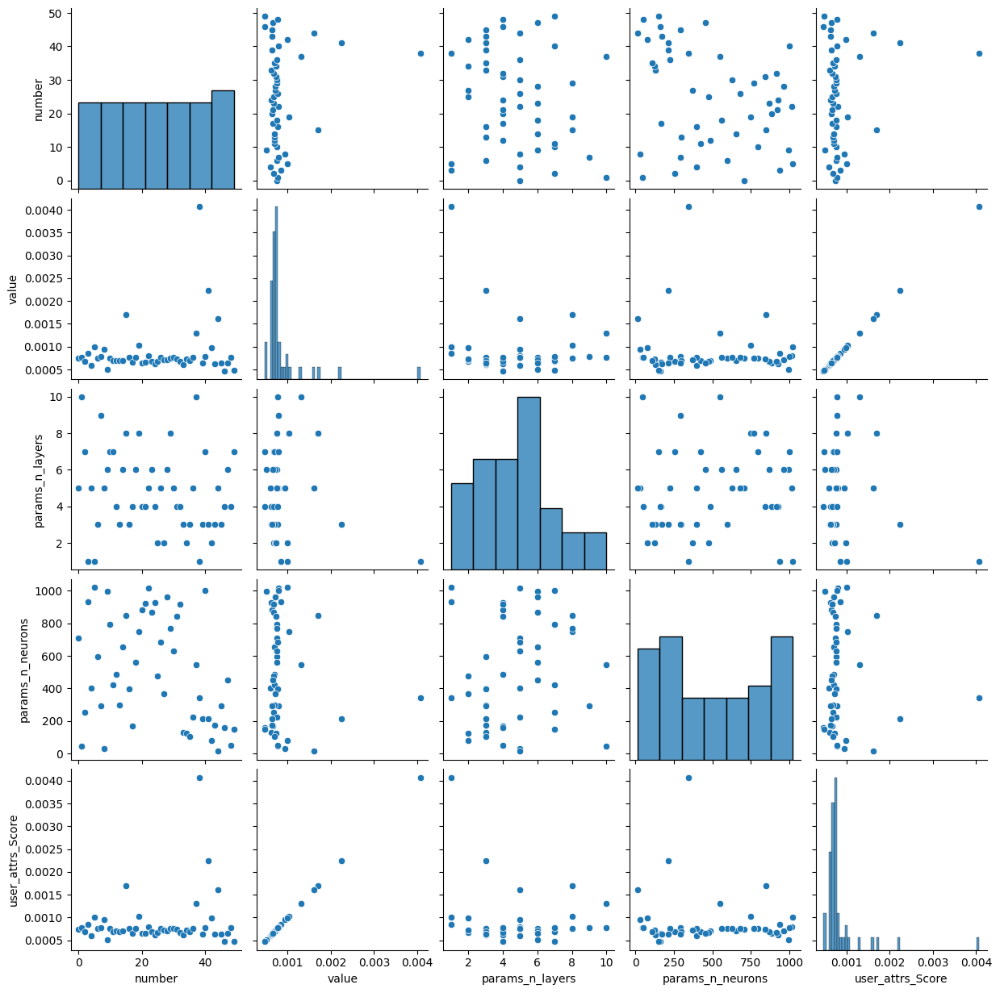

In [ ]:
sns.pairplot(df)

In [ ]:
dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
#geomtime.uniform_points

0.1742359

<Axes: >

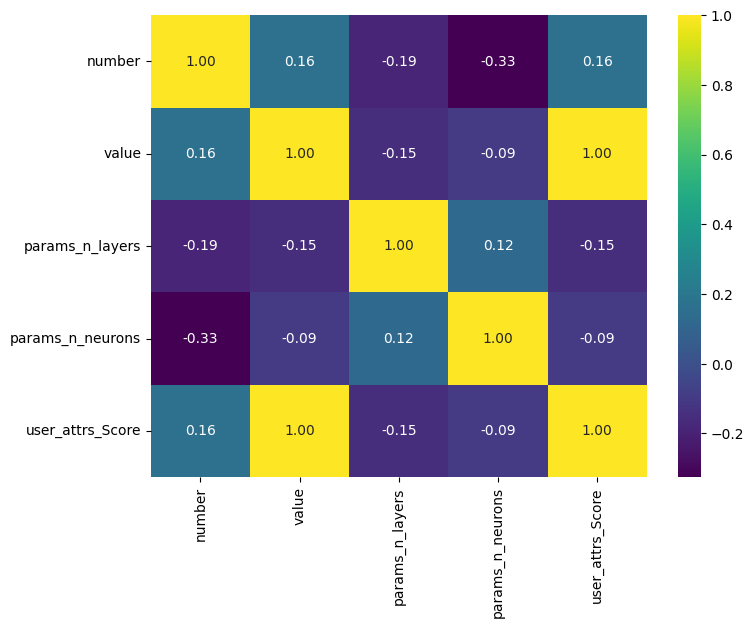

In [ ]:
numerical_columns = df.select_dtypes(include=['int', 'float'])
correlation_matrix = numerical_columns.corr()
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")

#test 2 optuna

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)


In [ ]:
def objective(trial):

    n_layers = trial.suggest_int('n_layers', 1, 10)
    n_neurons = trial.suggest_int('n_neurons', 8, 1024)
    #name_activation = trial.suggest_categorical('activation', ['relu', 'sigmoid', 'tanh'])
    #n_lr = trial.suggest_float('n_lr', 0.0001, 0.01)

    layer_size = [3] + [n_neurons] * n_layers + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)
    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )

    early_stopping=dde.callbacks.EarlyStopping(monitor='loss_test', min_delta=1e-6, patience=20)

    losshistory, train_state = model.train(epochs=200, callbacks=[early_stopping],display_every=2)

    score = losshistory.loss_test[-1][0]+losshistory.loss_test[-1][1]+losshistory.loss_test[-1][2]
    trial.set_user_attr("Score", score)

    return score

study = optuna.create_study(direction='minimize')#(direction='maximize')
study.optimize(objective, n_trials=50, gc_after_trial=True)

[I 2024-02-07 23:30:15,510] A new study created in memory with name: no-name-ec5482e0-316f-45bc-9f0e-2acdab0dbef5
/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


Compiling model...
Building feed-forward neural network...
'build' took 0.482240 s

'compile' took 5.842246 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.54e-04, 1.44e+01, 1.10e-01]    [1.54e-04, 1.44e+01, 1.10e-01]    [1.02e+00]    
2         [8.62e-03, 1.51e+01, 8.75e-02]    [8.62e-03, 1.51e+01, 8.75e-02]    [1.05e+00]    
4         [1.81e-02, 8.05e+00, 5.58e-03]    [1.81e-02, 8.05e+00, 5.58e-03]    [7.38e-01]    
6         [1.12e-02, 5.73e+00, 5.87e-02]    [1.12e-02, 5.73e+00, 5.87e-02]    [6.08e-01]    
8         [5.18e-03, 3.52e+00, 1.14e-01]    [5.18e-03, 3.52e+00, 1.14e-01]    [5.49e-01]    
10        [5.89e-03, 2.64e+00, 3.24e-02]    [5.89e-03, 2.64e+00, 3.24e-02]    [4.08e-01]    
12        [2.92e-02, 2.08e+00, 2.12e-01]    [2.92e-02, 2.08e+00, 2.12e-01]    [5.01e-01]    
14        [8.36e-03, 4.05e-01, 6.33e-02]    [8.36e-03, 4.05e-01, 6.33e-02]    [2.05e-01]    
16        [7.60e-03, 1.67e+00, 4.

[I 2024-02-07 23:31:05,328] Trial 0 finished with value: 0.003670237958431244 and parameters: {'n_layers': 6, 'n_neurons': 544}. Best is trial 0 with value: 0.003670237958431244.


Compiling model...
Building feed-forward neural network...
'build' took 0.072175 s

'compile' took 6.178781 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [7.76e-04, 1.31e+01, 1.78e-01]    [7.76e-04, 1.31e+01, 1.78e-01]    [9.66e-01]    
2         [5.75e-03, 1.06e+01, 4.19e-02]    [5.75e-03, 1.06e+01, 4.19e-02]    [8.53e-01]    
4         [5.55e-03, 7.75e+00, 2.36e-02]    [5.55e-03, 7.75e+00, 2.36e-02]    [7.39e-01]    
6         [5.40e-03, 5.34e+00, 4.91e-02]    [5.40e-03, 5.34e+00, 4.91e-02]    [6.14e-01]    
8         [5.84e-03, 3.11e+00, 2.91e-02]    [5.84e-03, 3.11e+00, 2.91e-02]    [4.33e-01]    
10        [4.70e-03, 1.70e+00, 1.29e-02]    [4.70e-03, 1.70e+00, 1.29e-02]    [2.98e-01]    
12        [4.63e-03, 3.00e-01, 3.36e-02]    [4.63e-03, 3.00e-01, 3.36e-02]    [2.05e-01]    
14        [5.98e-03, 5.88e-01, 2.30e-02]    [5.98e-03, 5.88e-01, 2.30e-02]    [3.28e-01]    
16        [4.60e-03, 6.67e-01, 1.

[I 2024-02-07 23:31:47,419] Trial 1 finished with value: 0.034757811576128006 and parameters: {'n_layers': 2, 'n_neurons': 752}. Best is trial 0 with value: 0.003670237958431244.


Compiling model...
Building feed-forward neural network...
'build' took 0.501821 s

'compile' took 5.891946 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.71e-04, 1.46e+01, 1.35e-01]    [3.71e-04, 1.46e+01, 1.35e-01]    [1.02e+00]    
2         [4.56e-02, 9.59e+00, 6.50e-03]    [4.56e-02, 9.59e+00, 6.50e-03]    [8.10e-01]    
4         [8.32e-03, 6.77e+00, 5.00e-02]    [8.32e-03, 6.77e+00, 5.00e-02]    [6.89e-01]    
6         [3.12e-02, 2.03e+00, 7.09e-02]    [3.12e-02, 2.03e+00, 7.09e-02]    [3.32e-01]    
8         [6.50e-02, 1.44e+00, 9.72e-02]    [6.50e-02, 1.44e+00, 9.72e-02]    [4.13e-01]    
10        [2.50e-02, 1.61e+00, 8.69e-02]    [2.50e-02, 1.61e+00, 8.69e-02]    [3.84e-01]    
12        [2.93e-02, 6.28e-01, 2.07e-02]    [2.93e-02, 6.28e-01, 2.07e-02]    [2.84e-01]    
14        [1.45e-02, 1.10e+00, 3.70e-02]    [1.45e-02, 1.10e+00, 3.70e-02]    [2.44e-01]    
16        [1.50e-02, 1.08e+00, 5.

[I 2024-02-07 23:32:32,641] Trial 2 finished with value: 0.0035864943638443947 and parameters: {'n_layers': 7, 'n_neurons': 241}. Best is trial 2 with value: 0.0035864943638443947.


Compiling model...
Building feed-forward neural network...
'build' took 0.163918 s

'compile' took 5.424491 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.03e-04, 1.33e+01, 1.27e-01]    [4.03e-04, 1.33e+01, 1.27e-01]    [9.75e-01]    
2         [4.83e-02, 3.18e+01, 1.54e-01]    [4.83e-02, 3.18e+01, 1.54e-01]    [1.55e+00]    
4         [2.82e-02, 1.10e+01, 5.12e-02]    [2.82e-02, 1.10e+01, 5.12e-02]    [8.72e-01]    
6         [9.54e-03, 1.14e+01, 7.86e-03]    [9.54e-03, 1.14e+01, 7.86e-03]    [9.27e-01]    
8         [3.45e-02, 7.32e+00, 1.92e-01]    [3.45e-02, 7.32e+00, 1.92e-01]    [6.84e-01]    
10        [7.53e-03, 6.44e+00, 1.72e-02]    [7.53e-03, 6.44e+00, 1.72e-02]    [7.81e-01]    
12        [1.83e-02, 2.90e+00, 8.82e-02]    [1.83e-02, 2.90e+00, 8.82e-02]    [4.17e-01]    
14        [5.22e-03, 9.03e-01, 4.16e-02]    [5.22e-03, 9.03e-01, 4.16e-02]    [2.30e-01]    
16        [1.79e-03, 1.99e+00, 1.

[I 2024-02-07 23:33:39,821] Trial 3 finished with value: 0.00285811023786664 and parameters: {'n_layers': 6, 'n_neurons': 758}. Best is trial 3 with value: 0.00285811023786664.


Compiling model...
Building feed-forward neural network...
'build' took 0.305917 s

'compile' took 7.053852 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.01e-05, 1.41e+01, 2.35e-01]    [3.01e-05, 1.41e+01, 2.35e-01]    [1.01e+00]    
2         [3.87e+00, 8.28e+01, 4.82e-01]    [3.87e+00, 8.28e+01, 4.82e-01]    [2.51e+00]    
4         [4.92e-01, 1.26e+01, 4.31e-03]    [4.92e-01, 1.26e+01, 4.31e-03]    [9.36e-01]    
6         [1.81e-02, 9.77e+00, 1.77e-03]    [1.81e-02, 9.77e+00, 1.77e-03]    [8.34e-01]    
8         [7.18e-01, 9.47e+00, 2.78e-02]    [7.18e-01, 9.47e+00, 2.78e-02]    [7.98e-01]    
10        [9.36e-02, 7.08e+00, 8.84e-02]    [9.36e-02, 7.08e+00, 8.84e-02]    [7.50e-01]    
12        [1.64e-01, 3.47e-01, 5.69e-02]    [1.64e-01, 3.47e-01, 5.69e-02]    [1.82e-01]    
14        [5.45e-02, 5.79e-01, 2.05e-01]    [5.45e-02, 5.79e-01, 2.05e-01]    [2.53e-01]    
16        [4.84e-03, 1.08e+00, 7.

[I 2024-02-07 23:34:53,150] Trial 4 finished with value: 0.00204217410646379 and parameters: {'n_layers': 10, 'n_neurons': 526}. Best is trial 4 with value: 0.00204217410646379.


Compiling model...
Building feed-forward neural network...
'build' took 0.123563 s

'compile' took 6.057371 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.10e-05, 1.38e+01, 8.78e-02]    [3.10e-05, 1.38e+01, 8.78e-02]    [9.97e-01]    
2         [1.79e-02, 9.00e+00, 4.92e-02]    [1.79e-02, 9.00e+00, 4.92e-02]    [7.85e-01]    
4         [2.71e-03, 1.15e+01, 3.08e-02]    [2.71e-03, 1.15e+01, 3.08e-02]    [9.16e-01]    
6         [9.03e-03, 8.28e+00, 1.57e-02]    [9.03e-03, 8.28e+00, 1.57e-02]    [7.43e-01]    
8         [8.12e-03, 4.16e+00, 1.82e-02]    [8.12e-03, 4.16e+00, 1.82e-02]    [5.13e-01]    
10        [2.21e-03, 3.60e+00, 6.90e-02]    [2.21e-03, 3.60e+00, 6.90e-02]    [5.57e-01]    
12        [4.13e-03, 7.20e-01, 3.30e-02]    [4.13e-03, 7.20e-01, 3.30e-02]    [2.25e-01]    
14        [4.92e-03, 1.84e+00, 6.50e-02]    [4.92e-03, 1.84e+00, 6.50e-02]    [4.04e-01]    
16        [1.48e-02, 1.84e+00, 9.

[I 2024-02-07 23:35:47,212] Trial 5 finished with value: 0.005564763676375151 and parameters: {'n_layers': 4, 'n_neurons': 677}. Best is trial 4 with value: 0.00204217410646379.


Compiling model...
Building feed-forward neural network...
'build' took 0.224204 s

'compile' took 7.203654 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [8.59e-04, 1.50e+01, 8.73e-02]    [8.59e-04, 1.50e+01, 8.73e-02]    [1.04e+00]    
2         [2.03e-02, 9.61e+00, 1.31e-02]    [2.03e-02, 9.61e+00, 1.31e-02]    [8.10e-01]    
4         [3.21e-03, 8.98e+00, 9.85e-03]    [3.21e-03, 8.98e+00, 9.85e-03]    [8.04e-01]    
6         [1.23e-02, 4.78e+00, 2.73e-02]    [1.23e-02, 4.78e+00, 2.73e-02]    [5.48e-01]    
8         [1.34e-02, 9.23e-01, 5.31e-02]    [1.34e-02, 9.23e-01, 5.31e-02]    [2.21e-01]    
10        [3.88e-02, 1.64e+00, 3.21e-02]    [3.88e-02, 1.64e+00, 3.21e-02]    [4.63e-01]    
12        [7.36e-03, 2.41e+00, 8.14e-02]    [7.36e-03, 2.41e+00, 8.14e-02]    [4.15e-01]    
14        [1.91e-02, 2.57e-01, 2.37e-02]    [1.91e-02, 2.57e-01, 2.37e-02]    [2.26e-01]    
16        [8.82e-03, 1.08e+00, 1.

[I 2024-02-07 23:36:41,993] Trial 6 finished with value: 0.005209838971495628 and parameters: {'n_layers': 5, 'n_neurons': 373}. Best is trial 4 with value: 0.00204217410646379.


Compiling model...
Building feed-forward neural network...
'build' took 0.233012 s

'compile' took 7.577747 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.07e-03, 1.28e+01, 1.39e-01]    [2.07e-03, 1.28e+01, 1.39e-01]    [9.54e-01]    
2         [4.05e-02, 9.00e+00, 2.35e-02]    [4.05e-02, 9.00e+00, 2.35e-02]    [7.87e-01]    
4         [5.14e-03, 8.37e+00, 1.49e-02]    [5.14e-03, 8.37e+00, 1.49e-02]    [7.71e-01]    
6         [2.40e-02, 5.07e+00, 1.38e-02]    [2.40e-02, 5.07e+00, 1.38e-02]    [5.61e-01]    
8         [4.51e-02, 1.27e+00, 9.09e-02]    [4.51e-02, 1.27e+00, 9.09e-02]    [3.75e-01]    
10        [2.80e-02, 1.21e+00, 5.11e-02]    [2.80e-02, 1.21e+00, 5.11e-02]    [3.59e-01]    
12        [9.44e-03, 1.05e+00, 1.13e-01]    [9.44e-03, 1.05e+00, 1.13e-01]    [2.72e-01]    
14        [9.72e-03, 1.05e+00, 2.91e-02]    [9.72e-03, 1.05e+00, 2.91e-02]    [3.22e-01]    
16        [9.32e-03, 1.07e+00, 2.

[I 2024-02-07 23:37:33,670] Trial 7 finished with value: 0.0031057344749569893 and parameters: {'n_layers': 7, 'n_neurons': 323}. Best is trial 4 with value: 0.00204217410646379.


Compiling model...
Building feed-forward neural network...
'build' took 0.147394 s

'compile' took 6.829449 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.72e-03, 1.31e+01, 1.56e-01]    [1.72e-03, 1.31e+01, 1.56e-01]    [9.66e-01]    
2         [1.60e-02, 8.66e+00, 1.11e-02]    [1.60e-02, 8.66e+00, 1.11e-02]    [7.69e-01]    
4         [3.32e-03, 1.05e+01, 3.36e-02]    [3.32e-03, 1.05e+01, 3.36e-02]    [8.76e-01]    
6         [6.88e-03, 8.35e+00, 1.63e-02]    [6.88e-03, 8.35e+00, 1.63e-02]    [7.43e-01]    
8         [4.89e-03, 2.90e+00, 4.77e-02]    [4.89e-03, 2.90e+00, 4.77e-02]    [4.29e-01]    
10        [3.05e-03, 2.98e+00, 8.23e-02]    [3.05e-03, 2.98e+00, 8.23e-02]    [5.33e-01]    
12        [4.68e-03, 1.61e+00, 1.41e-02]    [4.68e-03, 1.61e+00, 1.41e-02]    [3.28e-01]    
14        [5.55e-03, 1.34e+00, 1.05e-01]    [5.55e-03, 1.34e+00, 1.05e-01]    [3.63e-01]    
16        [1.26e-02, 1.53e+00, 6.

[I 2024-02-07 23:38:30,196] Trial 8 finished with value: 0.005099215544760227 and parameters: {'n_layers': 4, 'n_neurons': 674}. Best is trial 4 with value: 0.00204217410646379.


Compiling model...
Building feed-forward neural network...
'build' took 0.111260 s

'compile' took 6.511177 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.23e-04, 1.31e+01, 1.16e-01]    [2.23e-04, 1.31e+01, 1.16e-01]    [9.68e-01]    
2         [6.79e-03, 1.07e+01, 3.62e-02]    [6.79e-03, 1.07e+01, 3.62e-02]    [8.56e-01]    
4         [7.11e-03, 8.37e+00, 1.11e-02]    [7.11e-03, 8.37e+00, 1.11e-02]    [7.52e-01]    
6         [5.42e-03, 6.66e+00, 1.74e-02]    [5.42e-03, 6.66e+00, 1.74e-02]    [6.78e-01]    
8         [4.55e-03, 5.34e+00, 2.51e-02]    [4.55e-03, 5.34e+00, 2.51e-02]    [6.12e-01]    
10        [3.89e-03, 3.41e+00, 2.21e-02]    [3.89e-03, 3.41e+00, 2.21e-02]    [4.74e-01]    
12        [5.66e-03, 2.29e+00, 1.30e-02]    [5.66e-03, 2.29e+00, 1.30e-02]    [3.65e-01]    
14        [4.89e-03, 1.15e+00, 1.33e-02]    [4.89e-03, 1.15e+00, 1.33e-02]    [2.47e-01]    
16        [5.67e-03, 3.27e-01, 2.

[I 2024-02-07 23:39:13,714] Trial 9 finished with value: 0.046969763934612274 and parameters: {'n_layers': 2, 'n_neurons': 398}. Best is trial 4 with value: 0.00204217410646379.


Compiling model...
Building feed-forward neural network...
'build' took 0.319871 s

'compile' took 6.363841 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.84e-02, 1.56e+01, 8.22e-02]    [1.84e-02, 1.56e+01, 8.22e-02]    [1.06e+00]    
2         [6.67e-03, 1.25e+01, 7.94e-02]    [6.67e-03, 1.25e+01, 7.94e-02]    [9.46e-01]    
4         [8.27e-02, 1.05e+01, 8.64e-02]    [8.27e-02, 1.05e+01, 8.64e-02]    [8.59e-01]    
6         [2.17e-01, 9.36e+00, 9.07e-02]    [2.17e-01, 9.36e+00, 9.07e-02]    [8.06e-01]    
8         [2.48e-01, 8.40e+00, 8.55e-02]    [2.48e-01, 8.40e+00, 8.55e-02]    [7.60e-01]    
10        [1.47e-01, 7.09e+00, 7.46e-02]    [1.47e-01, 7.09e+00, 7.46e-02]    [6.95e-01]    
12        [6.41e-02, 5.45e+00, 6.23e-02]    [6.41e-02, 5.45e+00, 6.23e-02]    [6.11e-01]    
14        [6.08e-02, 4.18e+00, 5.01e-02]    [6.08e-02, 4.18e+00, 5.01e-02]    [5.44e-01]    
16        [8.03e-02, 3.09e+00, 4.

[I 2024-02-07 23:40:03,283] Trial 10 finished with value: 0.004183507990092039 and parameters: {'n_layers': 10, 'n_neurons': 30}. Best is trial 4 with value: 0.00204217410646379.


Compiling model...
Building feed-forward neural network...
'build' took 0.575509 s

'compile' took 8.525235 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [8.17e-04, 1.48e+01, 8.28e-02]    [8.17e-04, 1.48e+01, 8.28e-02]    [1.03e+00]    
2         [1.60e+01, 4.04e+01, 7.06e-01]    [1.60e+01, 4.04e+01, 7.06e-01]    [1.74e+00]    
4         [4.62e+02, 3.48e+02, 1.30e-01]    [4.62e+02, 3.48e+02, 1.30e-01]    [5.16e+00]    
6         [3.72e-01, 2.57e+01, 3.51e+00]    [3.72e-01, 2.57e+01, 3.51e+00]    [1.38e+00]    
8         [5.45e-01, 2.32e+01, 3.13e+00]    [5.45e-01, 2.32e+01, 3.13e+00]    [1.32e+00]    
10        [4.00e+00, 4.17e+01, 2.00e+00]    [4.00e+00, 4.17e+01, 2.00e+00]    [1.75e+00]    
12        [1.46e+01, 1.15e+02, 3.00e-01]    [1.46e+01, 1.15e+02, 3.00e-01]    [2.93e+00]    
14        [5.86e+00, 5.47e+01, 1.04e+00]    [5.86e+00, 5.47e+01, 1.04e+00]    [1.97e+00]    
16        [1.18e+00, 3.07e+01, 1.

[I 2024-02-07 23:42:02,085] Trial 11 finished with value: 0.0012222854420542717 and parameters: {'n_layers': 10, 'n_neurons': 1012}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.328005 s

'compile' took 8.740660 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [7.89e-05, 1.40e+01, 8.00e-02]    [7.89e-05, 1.40e+01, 8.00e-02]    [1.00e+00]    
2         [1.46e+00, 2.50e+01, 1.70e+00]    [1.46e+00, 2.50e+01, 1.70e+00]    [1.35e+00]    
4         [3.79e+02, 3.22e+02, 1.15e+01]    [3.79e+02, 3.22e+02, 1.15e+01]    [4.97e+00]    
6         [6.62e-01, 2.71e+01, 8.33e+00]    [6.62e-01, 2.71e+01, 8.33e+00]    [1.46e+00]    
8         [1.27e+00, 6.29e+01, 1.38e+01]    [1.27e+00, 6.29e+01, 1.38e+01]    [2.18e+00]    
10        [2.41e+00, 1.07e+02, 1.19e+01]    [2.41e+00, 1.07e+02, 1.19e+01]    [2.84e+00]    
12        [6.45e-01, 9.41e+00, 5.23e+00]    [6.45e-01, 9.41e+00, 5.23e+00]    [8.62e-01]    
14        [4.25e+00, 7.32e+00, 9.13e-01]    [4.25e+00, 7.32e+00, 9.13e-01]    [7.19e-01]    
16        [2.71e+00, 1.94e+01, 1.

[I 2024-02-07 23:44:02,177] Trial 12 finished with value: 0.0031008259393274784 and parameters: {'n_layers': 10, 'n_neurons': 1015}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.337928 s

'compile' took 8.866527 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.34e-04, 1.44e+01, 1.25e-01]    [1.34e-04, 1.44e+01, 1.25e-01]    [1.02e+00]    
2         [1.11e+01, 1.05e+02, 2.33e+00]    [1.11e+01, 1.05e+02, 2.33e+00]    [2.82e+00]    
4         [5.29e+01, 2.30e+02, 2.20e-01]    [5.29e+01, 2.30e+02, 2.20e-01]    [4.19e+00]    
6         [2.08e+00, 1.44e+01, 3.42e-01]    [2.08e+00, 1.44e+01, 3.42e-01]    [1.01e+00]    
8         [8.42e-01, 3.55e+01, 3.73e-01]    [8.42e-01, 3.55e+01, 3.73e-01]    [1.63e+00]    
10        [2.57e+00, 3.21e+01, 1.50e+01]    [2.57e+00, 3.21e+01, 1.50e+01]    [1.58e+00]    
12        [5.70e+00, 5.19e+01, 1.51e+00]    [5.70e+00, 5.19e+01, 1.51e+00]    [1.97e+00]    
14        [1.29e+01, 1.63e+01, 6.58e-01]    [1.29e+01, 1.63e+01, 6.58e-01]    [1.08e+00]    
16        [2.06e+00, 1.78e+01, 3.

[I 2024-02-07 23:45:55,460] Trial 13 finished with value: 0.0032862061634659767 and parameters: {'n_layers': 9, 'n_neurons': 1017}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.245170 s

'compile' took 6.991073 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.26e-04, 1.46e+01, 1.29e-01]    [5.26e-04, 1.46e+01, 1.29e-01]    [1.03e+00]    
2         [1.01e+01, 1.78e+02, 5.22e-01]    [1.01e+01, 1.78e+02, 5.22e-01]    [3.68e+00]    
4         [3.66e-02, 1.20e+01, 3.15e-02]    [3.66e-02, 1.20e+01, 3.15e-02]    [9.26e-01]    
6         [1.63e-01, 1.01e+01, 1.22e-01]    [1.63e-01, 1.01e+01, 1.22e-01]    [8.34e-01]    
8         [7.95e-01, 9.94e+00, 7.90e-02]    [7.95e-01, 9.94e+00, 7.90e-02]    [8.31e-01]    
10        [1.71e-01, 8.73e+00, 1.65e-01]    [1.71e-01, 8.73e+00, 1.65e-01]    [7.87e-01]    
12        [2.64e-01, 4.22e+00, 2.25e+00]    [2.64e-01, 4.22e+00, 2.25e+00]    [5.33e-01]    
14        [7.29e-01, 7.88e+00, 3.00e-01]    [7.29e-01, 7.88e+00, 3.00e-01]    [7.22e-01]    
16        [1.27e+00, 9.37e+00, 1.

[I 2024-02-07 23:47:39,856] Trial 14 finished with value: 0.0013898508623242378 and parameters: {'n_layers': 8, 'n_neurons': 869}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.624622 s

'compile' took 9.342639 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.48e-05, 1.40e+01, 1.36e-01]    [2.48e-05, 1.40e+01, 1.36e-01]    [1.00e+00]    
2         [6.97e+00, 1.69e+02, 4.14e-01]    [6.97e+00, 1.69e+02, 4.14e-01]    [3.59e+00]    
4         [1.14e-01, 1.19e+01, 1.79e-02]    [1.14e-01, 1.19e+01, 1.79e-02]    [9.21e-01]    
6         [4.52e-02, 9.94e+00, 9.71e-02]    [4.52e-02, 9.94e+00, 9.71e-02]    [8.29e-01]    
8         [1.94e-01, 9.99e+00, 9.49e-02]    [1.94e-01, 9.99e+00, 9.49e-02]    [8.37e-01]    
10        [9.87e-01, 6.48e+00, 3.29e-01]    [9.87e-01, 6.48e+00, 3.29e-01]    [6.54e-01]    
12        [6.45e-01, 4.40e+00, 1.64e+00]    [6.45e-01, 4.40e+00, 1.64e+00]    [6.30e-01]    
14        [6.96e-01, 7.26e+00, 4.33e-01]    [6.96e-01, 7.26e+00, 4.33e-01]    [6.92e-01]    
16        [8.64e-02, 4.03e+00, 5.

[I 2024-02-07 23:49:38,874] Trial 15 finished with value: 0.0022796441335231066 and parameters: {'n_layers': 8, 'n_neurons': 893}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.282467 s

'compile' took 10.974642 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.97e-05, 1.43e+01, 9.73e-02]    [1.97e-05, 1.43e+01, 9.73e-02]    [1.01e+00]    
2         [7.45e+00, 1.76e+02, 8.15e-01]    [7.45e+00, 1.76e+02, 8.15e-01]    [3.67e+00]    
4         [1.13e-02, 1.25e+01, 1.98e-02]    [1.13e-02, 1.25e+01, 1.98e-02]    [9.49e-01]    
6         [1.14e-01, 9.83e+00, 1.58e-01]    [1.14e-01, 9.83e+00, 1.58e-01]    [8.23e-01]    
8         [8.89e-01, 1.08e+01, 7.33e-02]    [8.89e-01, 1.08e+01, 7.33e-02]    [8.73e-01]    
10        [7.09e-01, 6.45e+00, 2.15e-01]    [7.09e-01, 6.45e+00, 2.15e-01]    [6.60e-01]    
12        [7.57e-01, 3.02e+00, 2.47e+00]    [7.57e-01, 3.02e+00, 2.47e+00]    [5.51e-01]    
14        [8.95e-01, 1.04e+01, 9.20e-01]    [8.95e-01, 1.04e+01, 9.20e-01]    [8.46e-01]    
16        [7.40e-02, 6.45e+00, 1

[I 2024-02-07 23:51:38,421] Trial 16 finished with value: 0.00283395079895854 and parameters: {'n_layers': 8, 'n_neurons': 885}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.337728 s

'compile' took 9.442721 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.34e-04, 1.41e+01, 1.08e-01]    [1.34e-04, 1.41e+01, 1.08e-01]    [1.01e+00]    
2         [3.69e+00, 1.31e+02, 9.01e-01]    [3.69e+00, 1.31e+02, 9.01e-01]    [3.16e+00]    
4         [2.17e-02, 1.46e+01, 6.70e-02]    [2.17e-02, 1.46e+01, 6.70e-02]    [1.03e+00]    
6         [6.61e-01, 1.16e+01, 6.26e-02]    [6.61e-01, 1.16e+01, 6.26e-02]    [8.98e-01]    
8         [1.13e+00, 1.36e+01, 1.33e-01]    [1.13e+00, 1.36e+01, 1.33e-01]    [9.89e-01]    
10        [1.51e-01, 6.09e+00, 1.22e+00]    [1.51e-01, 6.09e+00, 1.22e+00]    [6.38e-01]    
12        [2.32e-01, 7.96e+00, 5.84e-01]    [2.32e-01, 7.96e+00, 5.84e-01]    [8.53e-01]    
14        [3.26e-01, 5.25e+00, 1.39e+00]    [3.26e-01, 5.25e+00, 1.39e+00]    [5.99e-01]    
16        [4.75e-01, 7.90e+00, 6.

[I 2024-02-07 23:53:37,698] Trial 17 finished with value: 0.0034022454638034105 and parameters: {'n_layers': 8, 'n_neurons': 885}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.285327 s

'compile' took 9.506146 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.72e-04, 1.36e+01, 5.22e-02]    [1.72e-04, 1.36e+01, 5.22e-02]    [9.84e-01]    
2         [1.43e+01, 2.16e+02, 9.80e-01]    [1.43e+01, 2.16e+02, 9.80e-01]    [4.06e+00]    
4         [2.73e-01, 2.85e+01, 1.65e-02]    [2.73e-01, 2.85e+01, 1.65e-02]    [1.47e+00]    
6         [2.54e-01, 1.45e+01, 1.67e-01]    [2.54e-01, 1.45e+01, 1.67e-01]    [1.01e+00]    
8         [1.06e-01, 2.03e+01, 6.59e-02]    [1.06e-01, 2.03e+01, 6.59e-02]    [1.23e+00]    
10        [2.78e+00, 1.58e+01, 2.24e+00]    [2.78e+00, 1.58e+01, 2.24e+00]    [1.06e+00]    
12        [5.97e-01, 1.46e+01, 9.82e-01]    [5.97e-01, 1.46e+01, 9.82e-01]    [1.09e+00]    
14        [3.21e+00, 1.04e+01, 1.11e+00]    [3.21e+00, 1.04e+01, 1.11e+00]    [8.63e-01]    
16        [2.28e+00, 6.96e+00, 1.

[I 2024-02-07 23:55:26,901] Trial 18 finished with value: 0.003190240589901805 and parameters: {'n_layers': 8, 'n_neurons': 953}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.160200 s

'compile' took 5.130033 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.74e-04, 1.37e+01, 1.36e-01]    [2.74e-04, 1.37e+01, 1.36e-01]    [9.90e-01]    
2         [1.19e+01, 1.54e+02, 1.64e+00]    [1.19e+01, 1.54e+02, 1.64e+00]    [3.42e+00]    
4         [3.87e-01, 2.66e+01, 2.48e-01]    [3.87e-01, 2.66e+01, 2.48e-01]    [1.42e+00]    
6         [2.25e-01, 1.13e+01, 1.89e-01]    [2.25e-01, 1.13e+01, 1.89e-01]    [8.87e-01]    
8         [2.16e-01, 1.37e+01, 7.81e-02]    [2.16e-01, 1.37e+01, 7.81e-02]    [9.99e-01]    
10        [1.11e+00, 1.11e+01, 3.14e+00]    [1.11e+00, 1.11e+01, 3.14e+00]    [8.81e-01]    
12        [1.23e+01, 1.87e+01, 3.73e-01]    [1.23e+01, 1.87e+01, 3.73e-01]    [1.16e+00]    
14        [3.58e-01, 1.49e+01, 2.80e+00]    [3.58e-01, 1.49e+01, 2.80e+00]    [1.06e+00]    
16        [1.04e+00, 3.90e+00, 1.

[I 2024-02-07 23:56:42,861] Trial 19 finished with value: 0.0028015966527163982 and parameters: {'n_layers': 9, 'n_neurons': 801}. Best is trial 11 with value: 0.0012222854420542717.


Compiling model...
Building feed-forward neural network...
'build' took 0.158012 s

'compile' took 4.857482 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.08e-03, 1.29e+01, 2.58e-01]    [1.08e-03, 1.29e+01, 2.58e-01]    [9.62e-01]    
2         [3.14e+00, 1.00e+02, 9.12e-02]    [3.14e+00, 1.00e+02, 9.12e-02]    [2.76e+00]    
4         [2.19e-01, 1.15e+01, 1.59e-01]    [2.19e-01, 1.15e+01, 1.59e-01]    [8.94e-01]    
6         [8.44e-03, 9.05e+00, 1.72e-03]    [8.44e-03, 9.05e+00, 1.72e-03]    [8.04e-01]    
8         [6.25e-01, 9.61e+00, 1.73e-02]    [6.25e-01, 9.61e+00, 1.73e-02]    [8.08e-01]    
10        [1.43e-02, 1.02e+01, 5.44e-02]    [1.43e-02, 1.02e+01, 5.44e-02]    [8.69e-01]    
12        [1.50e-01, 2.11e+00, 6.65e-01]    [1.50e-01, 2.11e+00, 6.65e-01]    [3.88e-01]    
14        [6.51e-02, 2.89e+00, 1.52e+00]    [6.51e-02, 2.89e+00, 1.52e+00]    [4.77e-01]    
16        [4.08e-03, 2.88e+00, 2.

##save and analize

In [ ]:
best_params = study.best_params
print("Best Hyperparameters:", best_params)

In [ ]:
df = study.trials_dataframe()
df.to_pickle("/content/drive/MyDrive/trained_models/sine-gordon_variable/optuna_tests_2.pkl")

In [ ]:
numerical_columns = df.select_dtypes(include=['int', 'float'])
correlation_matrix = numerical_columns.corr()
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")

NameError: name 'df' is not defined

##test 3 (L2 monitorado)

In [ ]:
dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)


In [ ]:
def objective(trial):

    n_layers = trial.suggest_int('n_layers', 1, 20)
    n_neurons = trial.suggest_int('n_neurons', 8, 2048)
    #name_activation = trial.suggest_categorical('activation', ['relu', 'sigmoid', 'tanh'])
    #n_lr = trial.suggest_float('n_lr', 0.0001, 0.01)

    layer_size = [3] + [n_neurons] * n_layers + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)
    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )

    early_stopping=dde.callbacks.EarlyStopping(monitor='loss_test', min_delta=1e-5, patience=10)

    losshistory, train_state = model.train(epochs=200, callbacks=[early_stopping],display_every=1)

    loss_test = losshistory.loss_test[-1][0]+losshistory.loss_test[-1][1]+losshistory.loss_test[-1][2]
    l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

    trial.set_user_attr("Score_loss", loss_test)
    trial.set_user_attr("Score_L2", l2)

    return loss_test, l2

study = optuna.create_study(directions=['minimize','minimize'])#(direction='maximize')
study.optimize(objective, n_trials=50, gc_after_trial=True)

[I 2024-02-08 18:35:11,463] A new study created in memory with name: no-name-5c2aa23e-d3dc-4384-a49f-937b23ec12e8


Compiling model...
Building feed-forward neural network...
'build' took 0.993581 s

'compile' took 11.188893 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.83e-05, 1.36e+01, 1.79e-01]    [1.83e-05, 1.36e+01, 1.79e-01]    [9.87e-01]    
1         [6.17e+02, 4.92e+01, 3.97e-01]    [6.17e+02, 4.92e+01, 3.97e-01]    [1.92e+00]    
2         [1.41e+05, 7.71e+02, 4.83e+00]    [1.41e+05, 7.71e+02, 4.83e+00]    [7.70e+00]    
3         [6.53e+04, 4.44e+02, 1.24e+03]    [6.53e+04, 4.44e+02, 1.24e+03]    [5.83e+00]    
4         [2.95e+06, 1.85e+01, 4.69e+00]    [2.95e+06, 1.85e+01, 4.69e+00]    [1.17e+00]    
5         [3.40e+08, 1.42e+02, 2.25e+04]    [3.40e+08, 1.42e+02, 2.25e+04]    [2.66e+00]    
6         [7.34e+04, 6.66e+01, 1.07e+02]    [7.34e+04, 6.66e+01, 1.07e+02]    [2.31e+00]    
7         [8.82e+03, 1.31e+02, 2.41e+02]    [8.82e+03, 1.31e+02, 2.41e+02]    [3.14e+00]    
8         [3.07e+05, 7.80e+01, 4

[I 2024-02-08 18:36:28,420] Trial 0 finished with values: [3082437.0, 1.1299649477005005] and parameters: {'n_layers': 16, 'n_neurons': 1544}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.310844 s

'compile' took 11.709223 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.45e-05, 1.40e+01, 1.84e-01]    [4.45e-05, 1.40e+01, 1.84e-01]    [1.00e+00]    
1         [2.15e+01, 1.66e+01, 1.19e-01]    [2.15e+01, 1.66e+01, 1.19e-01]    [1.09e+00]    
2         [4.19e+01, 2.24e+01, 1.41e+00]    [4.19e+01, 2.24e+01, 1.41e+00]    [1.29e+00]    
3         [2.06e+01, 6.88e+01, 2.04e+01]    [2.06e+01, 6.88e+01, 2.04e+01]    [2.28e+00]    
4         [1.76e+01, 1.08e+01, 1.78e-01]    [1.76e+01, 1.08e+01, 1.78e-01]    [8.72e-01]    
5         [3.04e+03, 1.01e+01, 6.86e+01]    [3.04e+03, 1.01e+01, 6.86e+01]    [9.80e-01]    
6         [1.80e+00, 1.23e+01, 5.48e-01]    [1.80e+00, 1.23e+01, 5.48e-01]    [9.50e-01]    
7         [4.45e+01, 6.31e+00, 4.11e-01]    [4.45e+01, 6.31e+00, 4.11e-01]    [6.54e-01]    
8         [4.32e+01, 7.65e+00, 2

[I 2024-02-08 18:38:14,422] Trial 1 finished with values: [0.08236637711524963, 0.19887897372245789] and parameters: {'n_layers': 17, 'n_neurons': 565}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.068971 s

'compile' took 13.325412 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.00e-04, 1.37e+01, 8.64e-02]    [1.00e-04, 1.37e+01, 8.64e-02]    [9.89e-01]    
1         [2.77e+01, 1.19e+01, 1.56e-01]    [2.77e+01, 1.19e+01, 1.56e-01]    [9.11e-01]    
2         [9.24e+04, 2.81e+01, 4.20e+01]    [9.24e+04, 2.81e+01, 4.20e+01]    [1.51e+00]    
3         [7.71e+04, 1.44e+02, 1.11e+02]    [7.71e+04, 1.44e+02, 1.11e+02]    [3.31e+00]    
4         [1.04e+04, 2.69e+02, 3.43e+02]    [1.04e+04, 2.69e+02, 3.43e+02]    [4.39e+00]    
5         [1.94e+02, 9.33e+00, 7.60e+00]    [1.94e+02, 9.33e+00, 7.60e+00]    [1.07e+00]    
6         [5.66e+00, 1.62e+02, 4.91e-01]    [5.66e+00, 1.62e+02, 4.91e-01]    [3.50e+00]    
7         [1.92e+01, 1.22e+02, 1.19e+01]    [1.92e+01, 1.22e+02, 1.19e+01]    [3.40e+00]    
8         [7.90e+00, 1.82e+02, 1

[I 2024-02-08 18:39:28,781] Trial 2 finished with values: [670.8250122070312, 1.1950291395187378] and parameters: {'n_layers': 19, 'n_neurons': 981}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.429784 s

'compile' took 4.910874 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [7.48e-04, 1.46e+01, 2.46e-01]    [7.48e-04, 1.46e+01, 2.46e-01]    [1.03e+00]    
1         [2.63e-02, 2.60e+01, 9.24e-02]    [2.63e-02, 2.60e+01, 9.24e-02]    [1.37e+00]    
2         [8.66e-03, 9.20e+00, 2.37e-02]    [8.66e-03, 9.20e+00, 2.37e-02]    [7.92e-01]    
3         [5.48e-03, 1.42e+01, 1.26e-02]    [5.48e-03, 1.42e+01, 1.26e-02]    [1.02e+00]    
4         [4.65e-03, 1.23e+01, 1.35e-02]    [4.65e-03, 1.23e+01, 1.35e-02]    [9.56e-01]    
5         [5.93e-03, 7.06e+00, 1.35e-02]    [5.93e-03, 7.06e+00, 1.35e-02]    [7.05e-01]    
6         [7.15e-03, 5.60e+00, 1.29e-02]    [7.15e-03, 5.60e+00, 1.29e-02]    [6.03e-01]    
7         [5.84e-03, 6.65e+00, 1.38e-02]    [5.84e-03, 6.65e+00, 1.38e-02]    [6.52e-01]    
8         [5.93e-03, 5.32e+00, 1.

[I 2024-02-08 18:40:03,038] Trial 3 finished with values: [0.1339215636253357, 0.24944943189620972] and parameters: {'n_layers': 3, 'n_neurons': 811}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.006335 s

'compile' took 11.488559 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.95e-04, 1.36e+01, 1.04e-01]    [1.95e-04, 1.36e+01, 1.04e-01]    [9.86e-01]    
1         [1.01e+03, 1.37e+02, 2.14e-01]    [1.01e+03, 1.37e+02, 2.14e-01]    [3.22e+00]    
2         [1.37e+05, 1.13e+03, 5.48e+00]    [1.37e+05, 1.13e+03, 5.48e+00]    [9.34e+00]    
3         [3.94e+08, 6.91e+01, 7.45e+02]    [3.94e+08, 6.91e+01, 7.45e+02]    [2.35e+00]    
4         [1.22e+08, 1.48e+02, 1.14e+00]    [1.22e+08, 1.48e+02, 1.14e+00]    [3.37e+00]    
5         [4.84e+05, 4.56e+02, 1.05e+02]    [4.84e+05, 4.56e+02, 1.05e+02]    [5.57e+00]    
6         [3.12e+07, 8.47e+01, 1.94e-01]    [3.12e+07, 8.47e+01, 1.94e-01]    [2.54e+00]    
7         [9.84e+06, 2.96e+01, 5.55e+00]    [9.84e+06, 2.96e+01, 5.55e+00]    [1.53e+00]    
8         [1.65e+08, 3.12e+01, 9

[I 2024-02-08 18:41:30,788] Trial 4 finished with values: [35858220.0, 1.6718950271606445] and parameters: {'n_layers': 14, 'n_neurons': 1803}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.195448 s

'compile' took 5.282751 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.15e-04, 1.47e+01, 1.33e-01]    [4.15e-04, 1.47e+01, 1.33e-01]    [1.03e+00]    
1         [5.64e-03, 1.23e+01, 9.34e-02]    [5.64e-03, 1.23e+01, 9.34e-02]    [9.24e-01]    
2         [5.39e-03, 1.20e+01, 2.57e-02]    [5.39e-03, 1.20e+01, 2.57e-02]    [9.09e-01]    
3         [6.18e-03, 8.94e+00, 1.87e-02]    [6.18e-03, 8.94e+00, 1.87e-02]    [7.78e-01]    
4         [6.39e-03, 7.53e+00, 5.37e-02]    [6.39e-03, 7.53e+00, 5.37e-02]    [7.20e-01]    
5         [5.18e-03, 7.42e+00, 8.71e-02]    [5.18e-03, 7.42e+00, 8.71e-02]    [7.28e-01]    
6         [5.85e-03, 6.48e+00, 9.38e-02]    [5.85e-03, 6.48e+00, 9.38e-02]    [6.84e-01]    
7         [4.71e-03, 4.72e+00, 7.74e-02]    [4.71e-03, 4.72e+00, 7.74e-02]    [5.77e-01]    
8         [4.33e-03, 3.35e+00, 5.

[I 2024-02-08 18:42:06,762] Trial 5 finished with values: [0.6480801701545715, 0.28046607971191406] and parameters: {'n_layers': 2, 'n_neurons': 754}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.099241 s

'compile' took 12.686417 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.97e-05, 1.42e+01, 1.09e-01]    [2.97e-05, 1.42e+01, 1.09e-01]    [1.01e+00]    
1         [2.61e+01, 2.19e+01, 1.71e-01]    [2.61e+01, 2.19e+01, 1.71e-01]    [1.26e+00]    
2         [8.44e+03, 2.60e+02, 5.89e+00]    [8.44e+03, 2.60e+02, 5.89e+00]    [4.43e+00]    
3         [3.49e+05, 5.16e+01, 1.33e+03]    [3.49e+05, 5.16e+01, 1.33e+03]    [2.12e+00]    
4         [1.23e+03, 7.84e+01, 2.57e+01]    [1.23e+03, 7.84e+01, 2.57e+01]    [2.47e+00]    
5         [7.51e+03, 1.50e+01, 4.40e-01]    [7.51e+03, 1.50e+01, 4.40e-01]    [1.05e+00]    
6         [5.31e+05, 4.63e+01, 2.01e-01]    [5.31e+05, 4.63e+01, 2.01e-01]    [1.86e+00]    
7         [4.19e+05, 3.55e+02, 1.55e-01]    [4.19e+05, 3.55e+02, 1.55e-01]    [5.22e+00]    
8         [4.13e+02, 1.54e+02, 7

[I 2024-02-08 18:43:19,807] Trial 6 finished with values: [200.2156982421875, 1.2472543716430664] and parameters: {'n_layers': 15, 'n_neurons': 1001}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.215746 s

'compile' took 6.638220 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.64e-04, 1.32e+01, 1.18e-01]    [4.64e-04, 1.32e+01, 1.18e-01]    [9.72e-01]    
1         [9.57e-02, 7.51e+01, 2.12e-02]    [9.57e-02, 7.51e+01, 2.12e-02]    [2.36e+00]    
2         [3.12e-03, 1.35e+01, 1.58e-02]    [3.12e-03, 1.35e+01, 1.58e-02]    [9.93e-01]    
3         [6.44e-03, 3.39e+01, 1.90e-02]    [6.44e-03, 3.39e+01, 1.90e-02]    [1.61e+00]    
4         [4.72e-03, 1.33e+01, 2.06e-02]    [4.72e-03, 1.33e+01, 2.06e-02]    [9.89e-01]    
5         [6.88e-03, 9.24e+00, 1.98e-02]    [6.88e-03, 9.24e+00, 1.98e-02]    [7.92e-01]    
6         [1.16e-02, 1.63e+01, 1.34e-02]    [1.16e-02, 1.63e+01, 1.34e-02]    [1.07e+00]    
7         [7.52e-03, 1.28e+01, 1.25e-02]    [7.52e-03, 1.28e+01, 1.25e-02]    [9.41e-01]    
8         [7.31e-03, 6.42e+00, 2.

[I 2024-02-08 18:44:11,665] Trial 7 finished with values: [0.3417479991912842, 0.25413233041763306] and parameters: {'n_layers': 3, 'n_neurons': 1333}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.299671 s

'compile' took 15.856552 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.30e-05, 1.38e+01, 9.55e-02]    [9.30e-05, 1.38e+01, 9.55e-02]    [9.92e-01]    
1         [2.43e+03, 6.92e+01, 1.13e+00]    [2.43e+03, 6.92e+01, 1.13e+00]    [2.28e+00]    
2         [4.06e+08, 5.89e+02, 2.80e+02]    [4.06e+08, 5.89e+02, 2.80e+02]    [6.71e+00]    
3         [6.88e+09, 4.84e+02, 3.60e+02]    [6.88e+09, 4.84e+02, 3.60e+02]    [6.11e+00]    
4         [1.73e+03, 2.87e+02, 1.26e-01]    [1.73e+03, 2.87e+02, 1.26e-01]    [4.69e+00]    
5         [4.33e+08, 2.07e+02, 1.27e-01]    [4.33e+08, 2.07e+02, 1.27e-01]    [3.98e+00]    
6         [3.95e+01, 1.69e+02, 1.26e-01]    [3.95e+01, 1.69e+02, 1.26e-01]    [3.60e+00]    
7         [3.36e-02, 1.55e+02, 1.26e-01]    [3.36e-02, 1.55e+02, 1.26e-01]    [3.45e+00]    
8         [1.27e-02, 1.47e+02, 1

[I 2024-02-08 18:54:47,103] Trial 8 finished with values: [96.87615203857422, 1.2645490169525146] and parameters: {'n_layers': 20, 'n_neurons': 1774}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.207085 s

'compile' took 5.466985 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.21e-02, 1.36e+01, 2.29e-02]    [1.21e-02, 1.36e+01, 2.29e-02]    [9.83e-01]    
1         [1.18e-02, 1.31e+01, 2.15e-02]    [1.18e-02, 1.31e+01, 2.15e-02]    [9.66e-01]    
2         [1.17e-02, 1.27e+01, 2.02e-02]    [1.17e-02, 1.27e+01, 2.02e-02]    [9.50e-01]    
3         [1.17e-02, 1.23e+01, 1.92e-02]    [1.17e-02, 1.23e+01, 1.92e-02]    [9.35e-01]    
4         [1.20e-02, 1.20e+01, 1.83e-02]    [1.20e-02, 1.20e+01, 1.83e-02]    [9.20e-01]    
5         [1.24e-02, 1.17e+01, 1.76e-02]    [1.24e-02, 1.17e+01, 1.76e-02]    [9.06e-01]    
6         [1.30e-02, 1.13e+01, 1.71e-02]    [1.30e-02, 1.13e+01, 1.71e-02]    [8.93e-01]    
7         [1.37e-02, 1.11e+01, 1.66e-02]    [1.37e-02, 1.11e+01, 1.66e-02]    [8.80e-01]    
8         [1.46e-02, 1.08e+01, 1.

[I 2024-02-08 18:55:32,126] Trial 9 finished with values: [0.1739816516637802, 0.208748459815979] and parameters: {'n_layers': 3, 'n_neurons': 27}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.262128 s

'compile' took 5.871437 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.24e-05, 1.39e+01, 1.19e-01]    [3.24e-05, 1.39e+01, 1.19e-01]    [9.96e-01]    
1         [5.01e-01, 1.24e+02, 9.65e-03]    [5.01e-01, 1.24e+02, 9.65e-03]    [3.05e+00]    
2         [7.08e-02, 8.20e+01, 7.88e-02]    [7.08e-02, 8.20e+01, 7.88e-02]    [2.50e+00]    
3         [8.38e-04, 1.37e+01, 1.15e-01]    [8.38e-04, 1.37e+01, 1.15e-01]    [9.92e-01]    
4         [4.78e-02, 3.30e+01, 9.80e-02]    [4.78e-02, 3.30e+01, 9.80e-02]    [1.55e+00]    
5         [1.47e-02, 1.23e+01, 2.74e-02]    [1.47e-02, 1.23e+01, 2.74e-02]    [9.25e-01]    
6         [1.60e-02, 3.37e+01, 9.56e-03]    [1.60e-02, 3.37e+01, 9.56e-03]    [1.61e+00]    
7         [1.50e-02, 2.79e+01, 1.37e-02]    [1.50e-02, 2.79e+01, 1.37e-02]    [1.47e+00]    
8         [1.78e-02, 5.13e+00, 1.

[I 2024-02-08 18:56:30,575] Trial 10 finished with values: [0.3701644837856293, 0.24079270660877228] and parameters: {'n_layers': 4, 'n_neurons': 1414}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.235883 s

'compile' took 15.915318 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.44e-05, 1.39e+01, 1.72e-01]    [3.44e-05, 1.39e+01, 1.72e-01]    [9.99e-01]    
1         [3.81e+03, 9.35e+01, 5.53e-01]    [3.81e+03, 9.35e+01, 5.53e-01]    [2.66e+00]    
2         [2.49e+06, 1.15e+03, 5.43e+00]    [2.49e+06, 1.15e+03, 5.43e+00]    [9.39e+00]    
3         [1.99e+11, 3.03e+02, 3.63e+00]    [1.99e+11, 3.03e+02, 3.63e+00]    [4.82e+00]    
4         [4.52e+00, 2.82e+01, 1.26e-01]    [4.52e+00, 2.82e+01, 1.26e-01]    [1.44e+00]    
5         [3.44e+08, 1.85e+01, 1.26e-01]    [3.44e+08, 1.85e+01, 1.26e-01]    [1.16e+00]    
6         [2.75e+01, 4.43e+01, 1.26e-01]    [2.75e+01, 4.43e+01, 1.26e-01]    [1.83e+00]    
7         [2.51e+01, 6.13e+01, 1.26e-01]    [2.51e+01, 6.13e+01, 1.26e-01]    [2.16e+00]    
8         [2.47e+09, 7.21e+01, 1

[I 2024-02-08 18:58:44,987] Trial 11 finished with values: [102178800.0, 0.748272180557251] and parameters: {'n_layers': 20, 'n_neurons': 1918}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.145762 s

'compile' took 5.584291 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.18e-04, 1.34e+01, 1.20e-01]    [5.18e-04, 1.34e+01, 1.20e-01]    [9.77e-01]    
1         [2.32e-03, 1.22e+01, 9.08e-02]    [2.32e-03, 1.22e+01, 9.08e-02]    [9.30e-01]    
2         [4.50e-03, 1.12e+01, 6.63e-02]    [4.50e-03, 1.12e+01, 6.63e-02]    [8.89e-01]    
3         [6.02e-03, 1.04e+01, 4.67e-02]    [6.02e-03, 1.04e+01, 4.67e-02]    [8.52e-01]    
4         [6.47e-03, 9.76e+00, 3.19e-02]    [6.47e-03, 9.76e+00, 3.19e-02]    [8.22e-01]    
5         [6.17e-03, 9.22e+00, 2.20e-02]    [6.17e-03, 9.22e+00, 2.20e-02]    [7.96e-01]    
6         [5.66e-03, 8.80e+00, 1.66e-02]    [5.66e-03, 8.80e+00, 1.66e-02]    [7.75e-01]    
7         [5.30e-03, 8.44e+00, 1.54e-02]    [5.30e-03, 8.44e+00, 1.54e-02]    [7.58e-01]    
8         [5.15e-03, 8.11e+00, 1.

[I 2024-02-08 18:59:28,554] Trial 12 finished with values: [0.22511546313762665, 0.21329668164253235] and parameters: {'n_layers': 1, 'n_neurons': 1584}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.263035 s

'compile' took 7.880900 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.52e-04, 1.44e+01, 9.79e-02]    [2.52e-04, 1.44e+01, 9.79e-02]    [1.02e+00]    
1         [8.60e-03, 1.28e+01, 2.50e-02]    [8.60e-03, 1.28e+01, 2.50e-02]    [9.44e-01]    
2         [9.05e-03, 1.03e+01, 9.07e-03]    [9.05e-03, 1.03e+01, 9.07e-03]    [8.40e-01]    
3         [9.77e-03, 8.27e+00, 1.27e-02]    [9.77e-03, 8.27e+00, 1.27e-02]    [7.54e-01]    
4         [5.22e-03, 8.19e+00, 1.88e-02]    [5.22e-03, 8.19e+00, 1.88e-02]    [7.64e-01]    
5         [5.88e-03, 6.45e+00, 2.45e-02]    [5.88e-03, 6.45e+00, 2.45e-02]    [6.75e-01]    
6         [5.74e-03, 4.37e+00, 2.79e-02]    [5.74e-03, 4.37e+00, 2.79e-02]    [5.37e-01]    
7         [7.95e-03, 3.68e+00, 2.42e-02]    [7.95e-03, 3.68e+00, 2.42e-02]    [4.71e-01]    
8         [6.80e-03, 2.52e+00, 1.

[I 2024-02-08 19:00:19,426] Trial 13 finished with values: [0.27962037920951843, 1.8251869678497314] and parameters: {'n_layers': 3, 'n_neurons': 512}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.982656 s

'compile' took 12.174439 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [7.71e-05, 1.37e+01, 1.03e-01]    [7.71e-05, 1.37e+01, 1.03e-01]    [9.89e-01]    
1         [3.07e+02, 1.11e+02, 7.01e-01]    [3.07e+02, 1.11e+02, 7.01e-01]    [2.90e+00]    
2         [3.76e+03, 1.65e+01, 5.45e+01]    [3.76e+03, 1.65e+01, 5.45e+01]    [1.36e+00]    
3         [2.33e+04, 9.82e+00, 1.17e+01]    [2.33e+04, 9.82e+00, 1.17e+01]    [8.64e-01]    
4         [3.54e+03, 2.52e+02, 2.70e+02]    [3.54e+03, 2.52e+02, 2.70e+02]    [4.58e+00]    
5         [3.05e+03, 2.63e+02, 1.46e+02]    [3.05e+03, 2.63e+02, 1.46e+02]    [4.24e+00]    
6         [1.03e+03, 2.27e+01, 2.11e+00]    [1.03e+03, 2.27e+01, 2.11e+00]    [1.26e+00]    
7         [1.26e+02, 1.40e+02, 7.24e+00]    [1.26e+02, 1.40e+02, 7.24e+00]    [3.26e+00]    
8         [2.12e+02, 1.34e+02, 1

[I 2024-02-08 19:05:45,811] Trial 14 finished with values: [0.3743974566459656, 0.21157903969287872] and parameters: {'n_layers': 13, 'n_neurons': 1497}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.420048 s

'compile' took 8.141987 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.01e-03, 1.40e+01, 1.28e-01]    [1.01e-03, 1.40e+01, 1.28e-01]    [1.00e+00]    
1         [2.10e-03, 1.34e+01, 1.18e-01]    [2.10e-03, 1.34e+01, 1.18e-01]    [9.78e-01]    
2         [6.21e-03, 1.27e+01, 1.08e-01]    [6.21e-03, 1.27e+01, 1.08e-01]    [9.53e-01]    
3         [1.33e-02, 1.22e+01, 9.84e-02]    [1.33e-02, 1.22e+01, 9.84e-02]    [9.31e-01]    
4         [2.31e-02, 1.17e+01, 8.94e-02]    [2.31e-02, 1.17e+01, 8.94e-02]    [9.11e-01]    
5         [3.53e-02, 1.13e+01, 8.10e-02]    [3.53e-02, 1.13e+01, 8.10e-02]    [8.93e-01]    
6         [4.88e-02, 1.10e+01, 7.32e-02]    [4.88e-02, 1.10e+01, 7.32e-02]    [8.78e-01]    
7         [6.23e-02, 1.07e+01, 6.61e-02]    [6.23e-02, 1.07e+01, 6.61e-02]    [8.64e-01]    
8         [7.43e-02, 1.04e+01, 5.

[I 2024-02-08 19:06:47,081] Trial 15 finished with values: [0.008082587271928787, 0.1633368730545044] and parameters: {'n_layers': 6, 'n_neurons': 29}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.219206 s

'compile' took 8.331494 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.53e-05, 1.42e+01, 1.30e-01]    [6.53e-05, 1.42e+01, 1.30e-01]    [1.01e+00]    
1         [4.39e-02, 5.18e+01, 2.63e-02]    [4.39e-02, 5.18e+01, 2.63e-02]    [1.96e+00]    
2         [1.01e-03, 1.20e+01, 3.94e-02]    [1.01e-03, 1.20e+01, 3.94e-02]    [9.26e-01]    
3         [7.11e-03, 2.75e+01, 3.53e-02]    [7.11e-03, 2.75e+01, 3.53e-02]    [1.44e+00]    
4         [4.72e-03, 1.25e+01, 1.76e-02]    [4.72e-03, 1.25e+01, 1.76e-02]    [9.60e-01]    
5         [7.19e-03, 7.34e+00, 1.15e-02]    [7.19e-03, 7.34e+00, 1.15e-02]    [7.01e-01]    
6         [6.59e-03, 1.18e+01, 1.45e-02]    [6.59e-03, 1.18e+01, 1.45e-02]    [9.00e-01]    
7         [6.11e-03, 1.04e+01, 1.97e-02]    [6.11e-03, 1.04e+01, 1.97e-02]    [8.40e-01]    
8         [6.68e-03, 5.57e+00, 2.

[I 2024-02-08 19:07:52,025] Trial 16 finished with values: [0.19163981080055237, 0.229723259806633] and parameters: {'n_layers': 3, 'n_neurons': 1171}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.189605 s

'compile' took 16.338174 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [8.00e-05, 1.37e+01, 1.36e-01]    [8.00e-05, 1.37e+01, 1.36e-01]    [9.90e-01]    
1         [6.45e+02, 2.23e+01, 4.01e-01]    [6.45e+02, 2.23e+01, 4.01e-01]    [1.28e+00]    
2         [6.13e+08, 4.91e+02, 3.69e+02]    [6.13e+08, 4.91e+02, 3.69e+02]    [6.13e+00]    
3         [1.28e+08, 7.23e+02, 1.35e+01]    [1.28e+08, 7.23e+02, 1.35e+01]    [7.44e+00]    
4         [2.53e+08, 1.22e+02, 3.73e+03]    [2.53e+08, 1.22e+02, 3.73e+03]    [3.04e+00]    
5         [3.46e+09, 2.35e+02, 1.23e+05]    [3.46e+09, 2.35e+02, 1.23e+05]    [4.00e+00]    
6         [4.07e+07, 1.78e+02, 6.81e+03]    [4.07e+07, 1.78e+02, 6.81e+03]    [3.67e+00]    
7         [1.10e+06, 1.72e+01, 8.71e+01]    [1.10e+06, 1.72e+01, 8.71e+01]    [1.13e+00]    
8         [4.30e+05, 2.73e+01, 8

[I 2024-02-08 19:09:55,150] Trial 17 finished with values: [257033.25, 1.319035291671753] and parameters: {'n_layers': 18, 'n_neurons': 1803}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.473215 s

'compile' took 10.762608 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.97e-05, 1.35e+01, 1.45e-01]    [5.97e-05, 1.35e+01, 1.45e-01]    [9.85e-01]    
1         [1.90e+01, 2.31e+02, 7.74e-02]    [1.90e+01, 2.31e+02, 7.74e-02]    [4.18e+00]    
2         [2.01e+01, 1.53e+02, 2.41e+00]    [2.01e+01, 1.53e+02, 2.41e+00]    [3.41e+00]    
3         [2.36e+03, 9.20e+02, 6.20e+00]    [2.36e+03, 9.20e+02, 6.20e+00]    [8.38e+00]    
4         [3.82e+02, 6.85e+02, 4.54e-02]    [3.82e+02, 6.85e+02, 4.54e-02]    [7.25e+00]    
5         [8.25e-01, 1.65e+01, 2.88e+00]    [8.25e-01, 1.65e+01, 2.88e+00]    [1.11e+00]    
6         [9.94e-01, 4.47e+01, 9.20e-01]    [9.94e-01, 4.47e+01, 9.20e-01]    [1.83e+00]    
7         [9.90e+02, 9.80e+02, 2.53e+00]    [9.90e+02, 9.80e+02, 2.53e+00]    [8.67e+00]    
8         [9.20e+00, 2.28e+02, 2

[I 2024-02-08 19:11:26,823] Trial 18 finished with values: [23.885141372680664, 4.5015997886657715] and parameters: {'n_layers': 7, 'n_neurons': 1635}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.659431 s

'compile' took 12.223026 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.97e-04, 1.43e+01, 1.50e-01]    [9.97e-04, 1.43e+01, 1.50e-01]    [1.02e+00]    
1         [2.61e-01, 1.20e+01, 3.37e-01]    [2.61e-01, 1.20e+01, 3.37e-01]    [9.15e-01]    
2         [8.29e-02, 9.80e+00, 1.38e-01]    [8.29e-02, 9.80e+00, 1.38e-01]    [8.26e-01]    
3         [1.90e-02, 8.96e+00, 1.28e-02]    [1.90e-02, 8.96e+00, 1.28e-02]    [7.94e-01]    
4         [4.19e-02, 5.76e+00, 2.95e-02]    [4.19e-02, 5.76e+00, 2.95e-02]    [6.15e-01]    
5         [4.13e-02, 2.37e+00, 1.86e-01]    [4.13e-02, 2.37e+00, 1.86e-01]    [3.79e-01]    
6         [8.14e-02, 4.10e+00, 6.66e-02]    [8.14e-02, 4.10e+00, 6.66e-02]    [6.25e-01]    
7         [2.15e-02, 1.58e+00, 6.11e-02]    [2.15e-02, 1.58e+00, 6.11e-02]    [3.42e-01]    
8         [3.72e-02, 3.68e+00, 1

[I 2024-02-08 19:12:53,522] Trial 19 finished with values: [0.002055275719612837, 0.16734005510807037] and parameters: {'n_layers': 10, 'n_neurons': 219}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.205859 s

'compile' took 17.245566 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.91e-04, 1.33e+01, 9.80e-02]    [9.91e-04, 1.33e+01, 9.80e-02]    [9.74e-01]    
1         [5.89e+01, 1.67e+01, 1.21e-01]    [5.89e+01, 1.67e+01, 1.21e-01]    [1.09e+00]    
2         [3.78e-01, 1.81e+01, 1.75e-01]    [3.78e-01, 1.81e+01, 1.75e-01]    [1.14e+00]    
3         [3.77e+01, 1.51e+01, 1.15e-01]    [3.77e+01, 1.51e+01, 1.15e-01]    [1.03e+00]    
4         [2.85e+00, 2.39e+01, 1.24e+00]    [2.85e+00, 2.39e+01, 1.24e+00]    [1.30e+00]    
5         [1.53e+00, 1.68e+01, 2.11e-01]    [1.53e+00, 1.68e+01, 2.11e-01]    [1.08e+00]    
6         [9.51e+00, 9.07e+00, 1.02e+00]    [9.51e+00, 9.07e+00, 1.02e+00]    [8.16e-01]    
7         [3.65e-01, 1.06e+01, 8.05e-01]    [3.65e-01, 1.06e+01, 8.05e-01]    [8.74e-01]    
8         [9.72e-02, 1.33e+01, 3

[I 2024-02-08 19:14:42,199] Trial 20 finished with values: [0.3757264018058777, 0.21653425693511963] and parameters: {'n_layers': 20, 'n_neurons': 322}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.175831 s

'compile' took 9.259781 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [8.56e-04, 1.50e+01, 1.22e-01]    [8.56e-04, 1.50e+01, 1.22e-01]    [1.04e+00]    
1         [9.58e-03, 2.70e+01, 1.21e-01]    [9.58e-03, 2.70e+01, 1.21e-01]    [1.40e+00]    
2         [4.65e-03, 1.22e+01, 2.88e-02]    [4.65e-03, 1.22e+01, 2.88e-02]    [9.17e-01]    
3         [4.41e-03, 8.86e+00, 1.78e-02]    [4.41e-03, 8.86e+00, 1.78e-02]    [7.92e-01]    
4         [5.44e-03, 1.32e+01, 4.10e-02]    [5.44e-03, 1.32e+01, 4.10e-02]    [9.96e-01]    
5         [5.33e-03, 1.08e+01, 5.40e-02]    [5.33e-03, 1.08e+01, 5.40e-02]    [9.08e-01]    
6         [7.40e-03, 5.39e+00, 5.14e-02]    [7.40e-03, 5.39e+00, 5.14e-02]    [6.30e-01]    
7         [5.10e-03, 3.09e+00, 3.87e-02]    [5.10e-03, 3.09e+00, 3.87e-02]    [4.38e-01]    
8         [5.41e-03, 4.24e+00, 2.

[I 2024-02-08 19:15:49,292] Trial 21 finished with values: [0.4928976893424988, 1.0009666681289673] and parameters: {'n_layers': 2, 'n_neurons': 1333}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.216614 s

'compile' took 9.054351 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.65e-04, 1.34e+01, 1.65e-01]    [4.65e-04, 1.34e+01, 1.65e-01]    [9.80e-01]    
1         [6.21e-03, 1.23e+01, 1.07e-01]    [6.21e-03, 1.23e+01, 1.07e-01]    [9.23e-01]    
2         [6.28e-03, 1.10e+01, 4.24e-02]    [6.28e-03, 1.10e+01, 4.24e-02]    [8.68e-01]    
3         [7.60e-03, 8.40e+00, 1.70e-02]    [7.60e-03, 8.40e+00, 1.70e-02]    [7.55e-01]    
4         [6.51e-03, 7.52e+00, 1.58e-02]    [6.51e-03, 7.52e+00, 1.58e-02]    [7.22e-01]    
5         [5.78e-03, 7.11e+00, 2.49e-02]    [5.78e-03, 7.11e+00, 2.49e-02]    [7.12e-01]    
6         [5.83e-03, 5.76e+00, 3.37e-02]    [5.83e-03, 5.76e+00, 3.37e-02]    [6.40e-01]    
7         [4.30e-03, 4.12e+00, 3.68e-02]    [4.30e-03, 4.12e+00, 3.68e-02]    [5.30e-01]    
8         [5.32e-03, 3.14e+00, 3.

[I 2024-02-08 19:17:01,884] Trial 22 finished with values: [0.626697301864624, 0.2810992896556854] and parameters: {'n_layers': 2, 'n_neurons': 661}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.988020 s

'compile' took 15.620648 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [9.03e-04, 1.32e+01, 1.19e-01]    [9.03e-04, 1.32e+01, 1.19e-01]    [9.72e-01]    
1         [1.86e+01, 3.30e+01, 1.05e-01]    [1.86e+01, 3.30e+01, 1.05e-01]    [1.56e+00]    
2         [1.11e+00, 4.08e+01, 7.36e-01]    [1.11e+00, 4.08e+01, 7.36e-01]    [1.75e+00]    
3         [2.48e+00, 1.57e+01, 4.85e-02]    [2.48e+00, 1.57e+01, 4.85e-02]    [1.05e+00]    
4         [3.07e-01, 1.98e+01, 1.76e-01]    [3.07e-01, 1.98e+01, 1.76e-01]    [1.21e+00]    
5         [6.09e-02, 1.25e+01, 4.61e-02]    [6.09e-02, 1.25e+01, 4.61e-02]    [9.55e-01]    
6         [5.72e-01, 9.75e+00, 2.67e-01]    [5.72e-01, 9.75e+00, 2.67e-01]    [8.17e-01]    
7         [8.54e-01, 9.36e+00, 1.82e-01]    [8.54e-01, 9.36e+00, 1.82e-01]    [7.94e-01]    
8         [6.16e-01, 6.30e+00, 2

[I 2024-02-08 19:19:04,446] Trial 23 finished with values: [0.0038831343408674, 0.16475586593151093] and parameters: {'n_layers': 14, 'n_neurons': 424}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.676956 s

'compile' took 13.392367 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.24e-03, 1.24e+01, 4.80e-02]    [3.24e-03, 1.24e+01, 4.80e-02]    [9.37e-01]    
1         [3.59e+00, 3.33e+01, 3.14e-02]    [3.59e+00, 3.33e+01, 3.14e-02]    [1.56e+00]    
2         [4.76e-01, 3.31e+01, 4.55e-02]    [4.76e-01, 3.31e+01, 4.55e-02]    [1.58e+00]    
3         [2.67e-02, 1.41e+01, 9.18e-02]    [2.67e-02, 1.41e+01, 9.18e-02]    [1.01e+00]    
4         [7.81e-02, 9.27e+00, 5.80e-02]    [7.81e-02, 9.27e+00, 5.80e-02]    [7.96e-01]    
5         [1.17e-01, 8.29e+00, 1.20e-02]    [1.17e-01, 8.29e+00, 1.20e-02]    [7.45e-01]    
6         [1.86e-02, 4.83e+00, 1.01e-01]    [1.86e-02, 4.83e+00, 1.01e-01]    [5.82e-01]    
7         [5.28e-02, 4.66e+00, 9.72e-02]    [5.28e-02, 4.66e+00, 9.72e-02]    [6.25e-01]    
8         [1.10e-01, 4.37e+00, 5

[I 2024-02-08 19:20:38,051] Trial 24 finished with values: [0.1071665808558464, 0.16831932961940765] and parameters: {'n_layers': 10, 'n_neurons': 401}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.685341 s

'compile' took 13.313936 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.26e-04, 1.34e+01, 1.53e-01]    [5.26e-04, 1.34e+01, 1.53e-01]    [9.79e-01]    
1         [6.19e-02, 9.98e+00, 1.88e-02]    [6.19e-02, 9.98e+00, 1.88e-02]    [8.28e-01]    
2         [5.53e-02, 8.31e+00, 4.80e-02]    [5.53e-02, 8.31e+00, 4.80e-02]    [7.51e-01]    
3         [3.60e-02, 6.52e+00, 2.14e-01]    [3.60e-02, 6.52e+00, 2.14e-01]    [6.85e-01]    
4         [6.59e-02, 3.23e+00, 2.69e-01]    [6.59e-02, 3.23e+00, 2.69e-01]    [4.72e-01]    
5         [6.85e-02, 1.35e+00, 1.12e-01]    [6.85e-02, 1.35e+00, 1.12e-01]    [2.67e-01]    
6         [8.67e-02, 1.91e+00, 1.36e-01]    [8.67e-02, 1.91e+00, 1.36e-01]    [4.53e-01]    
7         [3.73e-02, 1.82e+00, 2.98e-01]    [3.73e-02, 1.82e+00, 2.98e-01]    [4.09e-01]    
8         [2.11e-02, 2.69e+00, 2

[I 2024-02-08 19:22:12,267] Trial 25 finished with values: [0.0022920574992895126, 0.16451922059059143] and parameters: {'n_layers': 10, 'n_neurons': 138}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.065980 s

'compile' took 18.024772 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.01e-03, 1.46e+01, 7.20e-02]    [1.01e-03, 1.46e+01, 7.20e-02]    [1.02e+00]    
1         [5.99e-01, 1.09e+01, 1.29e-01]    [5.99e-01, 1.09e+01, 1.29e-01]    [8.73e-01]    
2         [3.79e-01, 1.61e+01, 5.02e-01]    [3.79e-01, 1.61e+01, 5.02e-01]    [1.11e+00]    
3         [2.67e+01, 1.84e+01, 4.70e-01]    [2.67e+01, 1.84e+01, 4.70e-01]    [1.15e+00]    
4         [2.11e-02, 9.45e+00, 5.26e-02]    [2.11e-02, 9.45e+00, 5.26e-02]    [8.12e-01]    
5         [6.05e-03, 1.50e+01, 2.39e-01]    [6.05e-03, 1.50e+01, 2.39e-01]    [1.04e+00]    
6         [7.78e-03, 1.14e+01, 7.69e-02]    [7.78e-03, 1.14e+01, 7.69e-02]    [9.02e-01]    
7         [1.56e-01, 8.43e+00, 1.73e-02]    [1.56e-01, 8.43e+00, 1.73e-02]    [7.77e-01]    
8         [4.59e-01, 6.53e+00, 1

[I 2024-02-08 19:24:16,987] Trial 26 finished with values: [0.0017829808639362454, 0.16584578156471252] and parameters: {'n_layers': 17, 'n_neurons': 257}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.971933 s

'compile' took 16.749753 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.22e-04, 1.35e+01, 1.36e-01]    [2.22e-04, 1.35e+01, 1.36e-01]    [9.82e-01]    
1         [2.38e+03, 1.83e+02, 8.96e-01]    [2.38e+03, 1.83e+02, 8.96e-01]    [3.73e+00]    
2         [3.52e+05, 1.10e+03, 1.42e+01]    [3.52e+05, 1.10e+03, 1.42e+01]    [9.18e+00]    
3         [4.66e+08, 8.76e+01, 7.42e+01]    [4.66e+08, 8.76e+01, 7.42e+01]    [2.59e+00]    
4         [2.35e+10, 1.92e+01, 6.85e-01]    [2.35e+10, 1.92e+01, 6.85e-01]    [1.19e+00]    
5         [1.61e+10, 2.83e+02, 1.46e-01]    [1.61e+10, 2.83e+02, 1.46e-01]    [4.66e+00]    
6         [5.54e+13, 3.03e+02, 1.42e-01]    [5.54e+13, 3.03e+02, 1.42e-01]    [4.82e+00]    
7         [3.00e+07, 1.25e+02, 1.36e-01]    [3.00e+07, 1.25e+02, 1.36e-01]    [3.08e+00]    
8         [1.01e+10, 1.32e+02, 1

[I 2024-02-08 19:26:40,165] Trial 27 finished with values: [2721561.25, 0.944296658039093] and parameters: {'n_layers': 14, 'n_neurons': 2040}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.134868 s

'compile' took 10.078442 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.36e-04, 1.33e+01, 1.62e-01]    [5.36e-04, 1.33e+01, 1.62e-01]    [9.75e-01]    
1         [1.39e-03, 1.27e+01, 1.42e-01]    [1.39e-03, 1.27e+01, 1.42e-01]    [9.51e-01]    
2         [2.53e-03, 1.21e+01, 1.23e-01]    [2.53e-03, 1.21e+01, 1.23e-01]    [9.27e-01]    
3         [3.80e-03, 1.16e+01, 1.06e-01]    [3.80e-03, 1.16e+01, 1.06e-01]    [9.05e-01]    
4         [5.02e-03, 1.11e+01, 8.99e-02]    [5.02e-03, 1.11e+01, 8.99e-02]    [8.84e-01]    
5         [6.06e-03, 1.07e+01, 7.58e-02]    [6.06e-03, 1.07e+01, 7.58e-02]    [8.65e-01]    
6         [6.84e-03, 1.03e+01, 6.33e-02]    [6.84e-03, 1.03e+01, 6.33e-02]    [8.47e-01]    
7         [7.31e-03, 9.92e+00, 5.23e-02]    [7.31e-03, 9.92e+00, 5.23e-02]    [8.30e-01]    
8         [7.52e-03, 9.60e+00, 4

[I 2024-02-08 19:28:06,379] Trial 28 finished with values: [0.10622953623533249, 0.19370950758457184] and parameters: {'n_layers': 1, 'n_neurons': 439}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.191488 s

'compile' took 20.261521 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.19e-04, 1.40e+01, 1.09e-01]    [1.19e-04, 1.40e+01, 1.09e-01]    [1.00e+00]    
1         [2.97e+01, 1.39e+01, 1.12e-01]    [2.97e+01, 1.39e+01, 1.12e-01]    [9.91e-01]    
2         [6.10e+00, 1.76e+01, 6.92e-01]    [6.10e+00, 1.76e+01, 6.92e-01]    [1.13e+00]    
3         [3.39e+01, 4.63e+01, 1.28e-01]    [3.39e+01, 4.63e+01, 1.28e-01]    [1.87e+00]    
4         [6.38e+00, 3.96e+01, 5.44e+00]    [6.38e+00, 3.96e+01, 5.44e+00]    [1.71e+00]    
5         [4.12e+00, 2.73e+01, 2.62e+00]    [4.12e+00, 2.73e+01, 2.62e+00]    [1.43e+00]    
6         [1.09e+00, 1.62e+01, 8.94e-01]    [1.09e+00, 1.62e+01, 8.94e-01]    [1.05e+00]    
7         [1.28e+00, 1.06e+01, 2.60e+00]    [1.28e+00, 1.06e+01, 2.60e+00]    [8.64e-01]    
8         [4.33e-01, 4.41e+00, 5

[I 2024-02-08 19:30:53,459] Trial 29 finished with values: [0.004582909867167473, 0.17354130744934082] and parameters: {'n_layers': 18, 'n_neurons': 467}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.184783 s

'compile' took 20.554578 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.04e-05, 1.41e+01, 1.17e-01]    [3.04e-05, 1.41e+01, 1.17e-01]    [1.00e+00]    
1         [1.19e+02, 1.93e+01, 1.02e-01]    [1.19e+02, 1.93e+01, 1.02e-01]    [1.18e+00]    
2         [3.74e+04, 6.84e+01, 9.71e+00]    [3.74e+04, 6.84e+01, 9.71e+00]    [2.30e+00]    
3         [4.11e+07, 1.52e+02, 2.85e+04]    [4.11e+07, 1.52e+02, 2.85e+04]    [3.21e+00]    
4         [3.70e+05, 8.97e+01, 2.45e+01]    [3.70e+05, 8.97e+01, 2.45e+01]    [2.61e+00]    
5         [3.60e+04, 4.04e+02, 1.08e+02]    [3.60e+04, 4.04e+02, 1.08e+02]    [5.54e+00]    
6         [1.54e+03, 2.60e+02, 1.50e+02]    [1.54e+03, 2.60e+02, 1.50e+02]    [4.49e+00]    
7         [2.45e+02, 1.79e+02, 3.29e+01]    [2.45e+02, 1.79e+02, 3.29e+01]    [3.64e+00]    
8         [1.91e+02, 2.11e+02, 3

[I 2024-02-08 19:33:25,186] Trial 30 finished with values: [395.44134521484375, 2.9606142044067383] and parameters: {'n_layers': 17, 'n_neurons': 1280}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.771153 s

'compile' took 19.145055 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.13e-05, 1.38e+01, 1.02e-01]    [1.13e-05, 1.38e+01, 1.02e-01]    [9.95e-01]    
1         [3.76e+02, 9.79e+01, 3.09e-01]    [3.76e+02, 9.79e+01, 3.09e-01]    [2.72e+00]    
2         [2.51e+05, 1.17e+03, 1.62e+01]    [2.51e+05, 1.17e+03, 1.62e+01]    [9.50e+00]    
3         [1.41e+07, 8.91e+02, 1.11e+01]    [1.41e+07, 8.91e+02, 1.11e+01]    [8.25e+00]    
4         [2.04e+08, 1.83e+01, 1.38e+04]    [2.04e+08, 1.83e+01, 1.38e+04]    [1.13e+00]    
5         [6.00e+07, 1.40e+02, 1.39e+00]    [6.00e+07, 1.40e+02, 1.39e+00]    [3.27e+00]    
6         [3.34e+06, 2.31e+02, 1.45e+00]    [3.34e+06, 2.31e+02, 1.45e+00]    [4.20e+00]    
7         [1.35e+06, 3.49e+01, 9.37e+00]    [1.35e+06, 3.49e+01, 9.37e+00]    [1.62e+00]    
8         [7.54e+08, 1.59e+01, 3

[I 2024-02-08 19:36:11,953] Trial 31 finished with values: [69735096320.0, 1.6044095754623413] and parameters: {'n_layers': 13, 'n_neurons': 2020}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.133379 s

'compile' took 20.191577 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.21e-04, 1.43e+01, 1.23e-01]    [3.21e-04, 1.43e+01, 1.23e-01]    [1.01e+00]    
1         [5.18e+01, 2.99e+01, 1.67e-01]    [5.18e+01, 2.99e+01, 1.67e-01]    [1.48e+00]    
2         [4.56e+04, 3.16e+01, 3.07e+01]    [4.56e+04, 3.16e+01, 3.07e+01]    [1.63e+00]    
3         [1.06e+03, 1.16e+02, 1.70e+03]    [1.06e+03, 1.16e+02, 1.70e+03]    [2.99e+00]    
4         [2.05e+05, 6.23e+01, 1.70e+03]    [2.05e+05, 6.23e+01, 1.70e+03]    [2.20e+00]    
5         [3.96e+07, 2.59e+02, 1.35e-01]    [3.96e+07, 2.59e+02, 1.35e-01]    [4.45e+00]    
6         [4.35e+05, 2.40e+01, 1.28e-01]    [4.35e+05, 2.40e+01, 1.28e-01]    [1.33e+00]    
7         [3.20e+06, 2.93e+01, 5.74e+00]    [3.20e+06, 2.93e+01, 5.74e+00]    [1.48e+00]    
8         [1.61e+08, 2.93e+02, 1

[I 2024-02-08 19:38:54,585] Trial 32 finished with values: [1809.3681640625, 1.1082340478897095] and parameters: {'n_layers': 15, 'n_neurons': 1320}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.171582 s

'compile' took 13.951234 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.29e-04, 1.33e+01, 1.15e-01]    [6.29e-04, 1.33e+01, 1.15e-01]    [9.76e-01]    


[W 2024-02-08 19:40:24,364] Trial 33 failed with parameters: {'n_layers': 19, 'n_neurons': 1851} because of the following error: ResourceExhaustedError().
Traceback (most recent call last):
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/client/session.py", line 1402, in _do_call
    return fn(*args)
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/client/session.py", line 1385, in _run_fn
    return self._call_tf_sessionrun(options, feed_dict, fetch_list,
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/client/session.py", line 1478, in _call_tf_sessionrun
    return tf_session.TF_SessionRun_wrapper(self._session, options, feed_dict,
tensorflow.python.framework.errors_impl.ResourceExhaustedError: 2 root error(s) found.
  (0) RESOURCE_EXHAUSTED: Out of memory while trying to allocate 5508234680 bytes.
BufferAssignment OOM Debugging.
BufferAssignment stats:
             parameter allocation:  235.45MiB
              constant allocation

ResourceExhaustedError: Graph execution error:

2 root error(s) found.
  (0) RESOURCE_EXHAUSTED: Out of memory while trying to allocate 5508234680 bytes.
BufferAssignment OOM Debugging.
BufferAssignment stats:
             parameter allocation:  235.45MiB
              constant allocation:    56.4KiB
        maybe_live_out allocation:  235.42MiB
     preallocated temp allocation:    5.13GiB
  preallocated temp fragmentation:    18.7KiB (0.00%)
                 total allocation:    5.59GiB
              total fragmentation:   52.47MiB (0.92%)
Peak buffers:
	Buffer 1:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_417/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 2:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_416/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 3:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_415/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 4:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_414/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 5:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_413/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 6:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_412/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 7:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_411/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 8:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_410/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 9:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_409/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 10:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_408/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 11:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_407/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 12:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_406/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 13:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_405/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 14:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_404/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 15:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_403/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================


	 [[{{node cluster_173_1/xla_run}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.

	 [[Adam_34/update/_18]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.

  (1) RESOURCE_EXHAUSTED: Out of memory while trying to allocate 5508234680 bytes.
BufferAssignment OOM Debugging.
BufferAssignment stats:
             parameter allocation:  235.45MiB
              constant allocation:    56.4KiB
        maybe_live_out allocation:  235.42MiB
     preallocated temp allocation:    5.13GiB
  preallocated temp fragmentation:    18.7KiB (0.00%)
                 total allocation:    5.59GiB
              total fragmentation:   52.47MiB (0.92%)
Peak buffers:
	Buffer 1:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_417/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 2:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_416/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 3:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_415/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 4:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_414/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 5:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_413/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 6:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_412/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 7:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_411/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 8:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_410/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 9:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_409/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 10:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_408/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 11:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_407/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 12:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_406/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 13:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_405/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 14:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_404/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================

	Buffer 15:
		Size: 16.83MiB
		Operator: op_type="Tanh" op_name="dense_403/Tanh" deduplicated_name="fusion.179"
		XLA Label: fusion
		Shape: f32[2384,1851]
		==========================


	 [[{{node cluster_173_1/xla_run}}]]
Hint: If you want to see a list of allocated tensors when OOM happens, add report_tensor_allocations_upon_oom to RunOptions for current allocation info. This isn't available when running in Eager mode.

0 successful operations.
0 derived errors ignored.

In [ ]:
gc.collect()

668

###save and analize

In [ ]:
best_params = study.best_params
print("Best Hyperparameters:", best_params)

NameError: name 'study' is not defined

In [ ]:
df = study.trials_dataframe()
df.to_pickle("/content/drive/MyDrive/trained_models/sine-gordon_variable/optuna_tests_3.pkl")

NameError: name 'study' is not defined

In [ ]:
numerical_columns = df.select_dtypes(include=['int', 'float'])
correlation_matrix = numerical_columns.corr()
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")

##test 4 (L2 monitorado)

In [ ]:
#dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)


In [ ]:
def objective(trial):

    n_layers = trial.suggest_int('n_layers', 1, 20)
    n_neurons = trial.suggest_int('n_neurons', 8, 2048)
    #name_activation = trial.suggest_categorical('activation', ['relu', 'sigmoid', 'tanh'])
    #n_lr = trial.suggest_float('n_lr', 0.0001, 0.01)

    layer_size = [3] + [n_neurons] * n_layers + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)
    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )

    early_stopping=dde.callbacks.EarlyStopping(monitor='loss_test', min_delta=1e-5, patience=100)

    losshistory, train_state = model.train(epochs=2000, callbacks=[early_stopping],display_every=10)

    loss_test = losshistory.loss_test[-1][0]+losshistory.loss_test[-1][1]+losshistory.loss_test[-1][2]
    l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

    trial.set_user_attr("Score_loss", loss_test)
    trial.set_user_attr("Score_L2", l2)

    return loss_test, l2

study = optuna.create_study(directions=['minimize','minimize'])#(direction='maximize')
study.optimize(objective, n_trials=20, gc_after_trial=True)

[I 2024-02-08 19:46:48,816] A new study created in memory with name: no-name-bd5e93e2-7598-4ed3-aced-5bb830613448
/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


Compiling model...
Building feed-forward neural network...
'build' took 0.741974 s

'compile' took 6.861290 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.71e-02, 1.56e+01, 9.40e-02]    [2.71e-02, 1.56e+01, 9.40e-02]    [1.06e+00]    
10        [2.10e-03, 1.27e+01, 1.08e-01]    [2.10e-03, 1.27e+01, 1.08e-01]    [9.52e-01]    
20        [1.67e-02, 1.03e+01, 1.41e-01]    [1.67e-02, 1.03e+01, 1.41e-01]    [8.56e-01]    
30        [3.77e-02, 8.26e+00, 1.46e-01]    [3.77e-02, 8.26e+00, 1.46e-01]    [7.61e-01]    
40        [3.48e-02, 6.07e+00, 1.22e-01]    [3.48e-02, 6.07e+00, 1.22e-01]    [6.49e-01]    
50        [2.91e-02, 4.00e+00, 9.77e-02]    [2.91e-02, 4.00e+00, 9.77e-02]    [5.25e-01]    
60        [2.47e-02, 2.50e+00, 8.59e-02]    [2.47e-02, 2.50e+00, 8.59e-02]    [4.12e-01]    
70        [1.90e-02, 1.61e+00, 7.47e-02]    [1.90e-02, 1.61e+00, 7.47e-02]    [3.27e-01]    
80        [1.58e-02, 1.15e+00, 6.

[I 2024-02-08 19:47:33,490] Trial 0 finished with values: [0.0018791676266118884, 0.13550634682178497] and parameters: {'n_layers': 7, 'n_neurons': 11}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.918722 s

'compile' took 12.291658 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.45e-05, 1.35e+01, 8.45e-02]    [6.45e-05, 1.35e+01, 8.45e-02]    [9.85e-01]    
10        [6.33e+05, 2.19e+01, 4.41e+00]    [6.33e+05, 2.19e+01, 4.41e+00]    [1.27e+00]    
20        [1.52e+08, 1.61e+02, 7.76e-01]    [1.52e+08, 1.61e+02, 7.76e-01]    [3.51e+00]    
30        [2.82e+09, 1.18e+01, 1.05e+00]    [2.82e+09, 1.18e+01, 1.05e+00]    [9.09e-01]    
40        [2.40e+08, 3.11e+01, 1.31e-01]    [2.40e+08, 3.11e+01, 1.31e-01]    [1.52e+00]    
50        [3.96e+08, 8.72e+01, 1.59e-01]    [3.96e+08, 8.72e+01, 1.59e-01]    [2.58e+00]    
60        [4.29e+10, 1.67e+02, 2.00e+04]    [4.29e+10, 1.67e+02, 2.00e+04]    [3.55e+00]    
70        [3.51e+04, 1.51e+02, 6.93e+00]    [3.51e+04, 1.51e+02, 6.93e+00]    [3.39e+00]    
80        [6.47e+13, 6.68e+01, 2

[I 2024-02-08 19:50:03,842] Trial 1 finished with values: [64.69692993164062, 0.9206389784812927] and parameters: {'n_layers': 12, 'n_neurons': 1756}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.083320 s

'compile' took 14.210118 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.17e-04, 1.34e+01, 1.44e-01]    [2.17e-04, 1.34e+01, 1.44e-01]    [9.81e-01]    
10        [1.65e+05, 2.31e+02, 1.25e+03]    [1.65e+05, 2.31e+02, 1.25e+03]    [4.24e+00]    
20        [1.20e+08, 3.51e+02, 1.26e-01]    [1.20e+08, 3.51e+02, 1.26e-01]    [5.19e+00]    
30        [5.84e-01, 2.32e+02, 1.26e-01]    [5.84e-01, 2.32e+02, 1.26e-01]    [4.22e+00]    
40        [5.68e+00, 1.93e+02, 1.26e-01]    [5.68e+00, 1.93e+02, 1.26e-01]    [3.86e+00]    
50        [2.04e+09, 1.07e+02, 1.72e+01]    [2.04e+09, 1.07e+02, 1.72e+01]    [2.86e+00]    
60        [1.47e+01, 9.88e+01, 1.26e-01]    [1.47e+01, 9.88e+01, 1.26e-01]    [2.75e+00]    
70        [1.45e+00, 9.54e+01, 1.26e-01]    [1.45e+00, 9.54e+01, 1.26e-01]    [2.70e+00]    
80        [2.23e+03, 9.48e+01, 1

[I 2024-02-08 19:53:01,025] Trial 2 finished with values: [93.0161361694336, 1.206677794456482] and parameters: {'n_layers': 15, 'n_neurons': 1558}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.318261 s

'compile' took 8.683354 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.68e-04, 1.34e+01, 1.42e-01]    [2.68e-04, 1.34e+01, 1.42e-01]    [9.78e-01]    
10        [3.20e+02, 9.46e+01, 5.79e+01]    [3.20e+02, 9.46e+01, 5.79e+01]    [2.60e+00]    
20        [1.88e+02, 2.79e+02, 9.41e+01]    [1.88e+02, 2.79e+02, 9.41e+01]    [4.59e+00]    
30        [1.31e+01, 2.94e+01, 2.27e+00]    [1.31e+01, 2.94e+01, 2.27e+00]    [1.51e+00]    
40        [2.07e+00, 1.11e+01, 8.77e-01]    [2.07e+00, 1.11e+01, 8.77e-01]    [9.25e-01]    
50        [8.63e-01, 1.50e+00, 4.22e-01]    [8.63e-01, 1.50e+00, 4.22e-01]    [3.08e-01]    
60        [2.34e-01, 4.73e-01, 2.38e-01]    [2.34e-01, 4.73e-01, 2.38e-01]    [2.69e-01]    
70        [1.39e-01, 1.30e-01, 2.33e-01]    [1.39e-01, 1.30e-01, 2.33e-01]    [1.63e-01]    
80        [7.71e-02, 6.46e-02, 1.

[I 2024-02-08 20:19:00,239] Trial 3 finished with values: [0.002287896815687418, 0.17444053292274475] and parameters: {'n_layers': 9, 'n_neurons': 1780}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.838594 s

'compile' took 8.427769 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [8.67e-05, 1.40e+01, 1.53e-01]    [8.67e-05, 1.40e+01, 1.53e-01]    [1.00e+00]    
10        [7.02e+04, 4.20e+01, 2.68e+02]    [7.02e+04, 4.20e+01, 2.68e+02]    [1.86e+00]    
20        [8.47e+04, 5.52e+01, 4.52e+01]    [8.47e+04, 5.52e+01, 4.52e+01]    [2.04e+00]    
30        [1.11e+05, 5.48e+01, 7.05e-01]    [1.11e+05, 5.48e+01, 7.05e-01]    [2.03e+00]    
40        [6.39e+04, 2.06e+01, 2.57e+00]    [6.39e+04, 2.06e+01, 2.57e+00]    [1.23e+00]    
50        [2.80e+05, 2.04e+01, 5.31e+00]    [2.80e+05, 2.04e+01, 5.31e+00]    [1.22e+00]    
60        [6.17e+05, 2.03e+01, 4.70e+00]    [6.17e+05, 2.03e+01, 4.70e+00]    [1.22e+00]    
70        [8.88e+05, 2.04e+01, 1.60e+00]    [8.88e+05, 2.04e+01, 1.60e+00]    [1.22e+00]    
80        [4.31e+05, 2.03e+01, 8.

[I 2024-02-08 20:20:59,655] Trial 4 finished with values: [188223.828125, 0.7953165769577026] and parameters: {'n_layers': 17, 'n_neurons': 1210}. 


Compiling model...
Building feed-forward neural network...
'build' took 1.538141 s

'compile' took 9.074648 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.20e-04, 1.35e+01, 1.53e-01]    [2.20e-04, 1.35e+01, 1.53e-01]    [9.85e-01]    
10        [4.60e+07, 1.94e+02, 6.29e+01]    [4.60e+07, 1.94e+02, 6.29e+01]    [3.84e+00]    
20        [5.88e+06, 1.05e+02, 1.95e+02]    [5.88e+06, 1.05e+02, 1.95e+02]    [2.83e+00]    
30        [2.74e+06, 1.01e+01, 1.74e+03]    [2.74e+06, 1.01e+01, 1.74e+03]    [1.27e+00]    
40        [2.87e+05, 9.74e+00, 5.93e+02]    [2.87e+05, 9.74e+00, 5.93e+02]    [1.22e+00]    
50        [6.31e+05, 7.20e+01, 2.43e+02]    [6.31e+05, 7.20e+01, 2.43e+02]    [2.13e+00]    
60        [5.69e+03, 2.12e+02, 1.26e-01]    [5.69e+03, 2.12e+02, 1.26e-01]    [4.03e+00]    
70        [9.47e-02, 3.18e+02, 1.26e-01]    [9.47e-02, 3.18e+02, 1.26e-01]    [4.93e+00]    
80        [3.43e-01, 2.70e+02, 1.

[I 2024-02-08 20:23:30,769] Trial 5 finished with values: [239.7003173828125, 1.144911766052246] and parameters: {'n_layers': 16, 'n_neurons': 1424}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.877053 s

'compile' took 7.769164 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.67e-04, 1.45e+01, 9.45e-02]    [3.67e-04, 1.45e+01, 9.45e-02]    [1.02e+00]    
10        [1.66e-01, 9.27e+00, 1.09e-02]    [1.66e-01, 9.27e+00, 1.09e-02]    [7.98e-01]    
20        [6.48e+00, 6.38e+01, 3.63e+00]    [6.48e+00, 6.38e+01, 3.63e+00]    [2.20e+00]    
30        [6.17e+04, 4.12e+02, 1.06e+03]    [6.17e+04, 4.12e+02, 1.06e+03]    [5.52e+00]    
40        [1.06e+02, 1.92e+01, 6.29e+00]    [1.06e+02, 1.92e+01, 6.29e+00]    [1.13e+00]    
50        [1.62e+02, 2.50e+01, 6.67e+00]    [1.62e+02, 2.50e+01, 6.67e+00]    [1.35e+00]    
60        [6.22e+01, 2.17e+01, 3.86e+00]    [6.22e+01, 2.17e+01, 3.86e+00]    [1.26e+00]    
70        [2.15e+01, 1.96e+01, 2.79e+00]    [2.15e+01, 1.96e+01, 2.79e+00]    [1.19e+00]    
80        [7.19e+00, 1.80e+01, 1.

[I 2024-02-08 20:25:10,281] Trial 6 finished with values: [16.985332489013672, 23.8267822265625] and parameters: {'n_layers': 10, 'n_neurons': 1392}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.804140 s

'compile' took 7.295707 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.63e-03, 1.31e+01, 1.44e-01]    [1.63e-03, 1.31e+01, 1.44e-01]    [9.65e-01]    
10        [9.49e+03, 1.19e+02, 4.01e+01]    [9.49e+03, 1.19e+02, 4.01e+01]    [2.74e+00]    
20        [2.00e+02, 9.00e+00, 3.19e+00]    [2.00e+02, 9.00e+00, 3.19e+00]    [7.96e-01]    
30        [1.61e+06, 1.34e+02, 2.12e+01]    [1.61e+06, 1.34e+02, 2.12e+01]    [3.17e+00]    
40        [1.94e+05, 4.28e+01, 9.28e-01]    [1.94e+05, 4.28e+01, 9.28e-01]    [1.78e+00]    
50        [2.18e+09, 1.09e+01, 8.04e+04]    [2.18e+09, 1.09e+01, 8.04e+04]    [9.78e-01]    
60        [5.67e+07, 3.82e+01, 1.59e-01]    [5.67e+07, 3.82e+01, 1.59e-01]    [1.69e+00]    
70        [1.27e+05, 1.25e+01, 2.42e+01]    [1.27e+05, 1.25e+01, 2.42e+01]    [9.61e-01]    
80        [1.67e+06, 1.36e+01, 9.

[I 2024-02-08 20:26:42,536] Trial 7 finished with values: [199060.953125, 101.87106323242188] and parameters: {'n_layers': 11, 'n_neurons': 1221}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.857316 s

'compile' took 11.131697 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [8.85e-05, 1.42e+01, 1.34e-01]    [8.85e-05, 1.42e+01, 1.34e-01]    [1.01e+00]    
10        [4.16e+08, 1.08e+02, 2.05e+04]    [4.16e+08, 1.08e+02, 2.05e+04]    [2.83e+00]    
20        [7.54e+10, 1.03e+02, 1.72e+04]    [7.54e+10, 1.03e+02, 1.72e+04]    [2.56e+00]    
30        [8.63e+08, 3.70e+01, 1.78e+04]    [8.63e+08, 3.70e+01, 1.78e+04]    [1.53e+00]    
40        [8.18e+07, 2.35e+01, 2.17e+04]    [8.18e+07, 2.35e+01, 2.17e+04]    [1.45e+00]    
50        [6.17e+07, 3.89e+01, 9.14e+03]    [6.17e+07, 3.89e+01, 9.14e+03]    [1.53e+00]    
60        [1.02e+07, 4.48e+01, 8.31e+03]    [1.02e+07, 4.48e+01, 8.31e+03]    [1.57e+00]    
70        [1.09e+07, 4.58e+01, 7.52e+03]    [1.09e+07, 4.58e+01, 7.52e+03]    [1.58e+00]    
80        [8.00e+06, 4.55e+01, 7

[I 2024-02-08 20:30:57,536] Trial 8 finished with values: [3771562.75, 1.1535745859146118] and parameters: {'n_layers': 16, 'n_neurons': 1981}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.848304 s

'compile' took 11.602592 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.64e-04, 1.37e+01, 8.10e-02]    [2.64e-04, 1.37e+01, 8.10e-02]    [9.90e-01]    
10        [3.58e+02, 1.61e+01, 3.24e+00]    [3.58e+02, 1.61e+01, 3.24e+00]    [1.08e+00]    
20        [5.92e+01, 1.86e+01, 2.87e+00]    [5.92e+01, 1.86e+01, 2.87e+00]    [1.18e+00]    
30        [3.80e-01, 4.76e+00, 3.48e-01]    [3.80e-01, 4.76e+00, 3.48e-01]    [6.36e-01]    
40        [3.51e-01, 1.86e+00, 6.37e-01]    [3.51e-01, 1.86e+00, 6.37e-01]    [3.89e-01]    
50        [1.44e+00, 7.86e-01, 1.25e-01]    [1.44e+00, 7.86e-01, 1.25e-01]    [3.03e-01]    
60        [5.97e-01, 5.49e-01, 1.22e-01]    [5.97e-01, 5.49e-01, 1.22e-01]    [2.07e-01]    
70        [3.15e-01, 1.72e-01, 1.70e-01]    [3.15e-01, 1.72e-01, 1.70e-01]    [1.36e-01]    
80        [2.17e-01, 1.44e-01, 1

[I 2024-02-08 20:45:04,876] Trial 9 finished with values: [0.004455839283764362, 0.1753871887922287] and parameters: {'n_layers': 17, 'n_neurons': 882}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.871516 s

'compile' took 8.124689 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.17e-03, 1.38e+01, 5.98e-02]    [1.17e-03, 1.38e+01, 5.98e-02]    [9.94e-01]    
10        [2.20e-02, 1.94e+00, 2.03e-01]    [2.20e-02, 1.94e+00, 2.03e-01]    [3.89e-01]    
20        [2.08e-02, 3.81e-01, 3.88e-02]    [2.08e-02, 3.81e-01, 3.88e-02]    [1.96e-01]    
30        [5.12e-03, 9.61e-02, 3.80e-02]    [5.12e-03, 9.61e-02, 3.80e-02]    [1.08e-01]    
40        [5.43e-03, 1.56e-02, 1.33e-02]    [5.43e-03, 1.56e-02, 1.33e-02]    [1.05e-01]    
50        [4.74e-03, 8.03e-03, 5.94e-03]    [4.74e-03, 8.03e-03, 5.94e-03]    [1.08e-01]    
60        [3.54e-03, 2.38e-03, 3.60e-03]    [3.54e-03, 2.38e-03, 3.60e-03]    [1.24e-01]    
70        [3.54e-03, 1.10e-03, 9.14e-04]    [3.54e-03, 1.10e-03, 9.14e-04]    [1.16e-01]    
80        [3.11e-03, 5.31e-04, 9.

[I 2024-02-08 20:46:13,827] Trial 10 finished with values: [0.000604586151894182, 0.16187457740306854] and parameters: {'n_layers': 10, 'n_neurons': 113}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.379977 s

'compile' took 4.718581 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.12e-05, 1.42e+01, 1.54e-01]    [2.12e-05, 1.42e+01, 1.54e-01]    [1.01e+00]    
10        [9.98e-03, 9.44e-01, 1.87e-01]    [9.98e-03, 9.44e-01, 1.87e-01]    [2.14e-01]    
20        [8.58e-03, 1.04e+00, 1.85e-01]    [8.58e-03, 1.04e+00, 1.85e-01]    [2.91e-01]    
30        [3.18e-03, 2.04e-01, 2.60e-01]    [3.18e-03, 2.04e-01, 2.60e-01]    [1.37e-01]    
40        [4.42e-03, 1.62e-01, 4.33e-02]    [4.42e-03, 1.62e-01, 4.33e-02]    [1.11e-01]    
50        [2.16e-03, 8.00e-02, 3.01e-02]    [2.16e-03, 8.00e-02, 3.01e-02]    [1.27e-01]    
60        [2.94e-03, 6.40e-02, 1.80e-02]    [2.94e-03, 6.40e-02, 1.80e-02]    [1.27e-01]    
70        [1.79e-03, 4.24e-02, 1.30e-02]    [1.79e-03, 4.24e-02, 1.30e-02]    [1.13e-01]    
80        [2.35e-03, 2.12e-02, 9.

[I 2024-02-08 20:47:57,025] Trial 11 finished with values: [0.0007762910099700093, 0.15464439988136292] and parameters: {'n_layers': 5, 'n_neurons': 626}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.327301 s

'compile' took 4.943471 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.86e-04, 1.46e+01, 1.17e-01]    [1.86e-04, 1.46e+01, 1.17e-01]    [1.02e+00]    
10        [4.33e+03, 6.27e+01, 3.25e+02]    [4.33e+03, 6.27e+01, 3.25e+02]    [2.28e+00]    
20        [1.38e+03, 1.61e+02, 1.52e+02]    [1.38e+03, 1.61e+02, 1.52e+02]    [3.62e+00]    
30        [6.96e+02, 8.60e+01, 1.42e+02]    [6.96e+02, 8.60e+01, 1.42e+02]    [2.69e+00]    
40        [2.51e+02, 8.46e+01, 3.51e+01]    [2.51e+02, 8.46e+01, 3.51e+01]    [2.57e+00]    
50        [8.40e+01, 5.12e+01, 1.48e+01]    [8.40e+01, 5.12e+01, 1.48e+01]    [2.01e+00]    
60        [4.09e+01, 2.82e+01, 9.50e+00]    [4.09e+01, 2.82e+01, 9.50e+00]    [1.51e+00]    
70        [2.43e+01, 1.76e+01, 6.74e+00]    [2.43e+01, 1.76e+01, 6.74e+00]    [1.19e+00]    
80        [1.62e+01, 1.35e+01, 5.

[I 2024-02-08 20:51:02,624] Trial 12 finished with values: [22.781435012817383, 1.8493419885635376] and parameters: {'n_layers': 12, 'n_neurons': 1963}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.279337 s

'compile' took 5.386372 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.85e-07, 1.39e+01, 1.38e-01]    [5.85e-07, 1.39e+01, 1.38e-01]    [1.00e+00]    
10        [1.06e+03, 3.92e+01, 6.50e+00]    [1.06e+03, 3.92e+01, 6.50e+00]    [1.68e+00]    
20        [1.06e+02, 1.84e+01, 1.40e+01]    [1.06e+02, 1.84e+01, 1.40e+01]    [1.17e+00]    
30        [5.68e+00, 5.55e+00, 2.95e+00]    [5.68e+00, 5.55e+00, 2.95e+00]    [8.93e-01]    
40        [1.85e-02, 3.05e+00, 2.31e-01]    [1.85e-02, 3.05e+00, 2.31e-01]    [5.26e-01]    
50        [4.78e-03, 2.50e+00, 1.57e-01]    [4.78e-03, 2.50e+00, 1.57e-01]    [4.47e-01]    
60        [2.84e-03, 2.52e+00, 1.52e-01]    [2.84e-03, 2.52e+00, 1.52e-01]    [4.40e-01]    
70        [2.88e-03, 2.48e+00, 1.54e-01]    [2.88e-03, 2.48e+00, 1.54e-01]    [4.36e-01]    
80        [3.68e-03, 2.37e+00, 1.

[I 2024-02-08 21:17:37,923] Trial 13 finished with values: [0.005475899670273066, 0.18031184375286102] and parameters: {'n_layers': 10, 'n_neurons': 1573}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.089109 s

'compile' took 1.863011 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.64e-05, 1.42e+01, 7.28e-02]    [4.64e-05, 1.42e+01, 7.28e-02]    [1.01e+00]    
10        [1.28e-02, 3.96e+00, 3.50e-02]    [1.28e-02, 3.96e+00, 3.50e-02]    [4.83e-01]    
20        [1.79e-02, 4.70e-01, 2.60e-01]    [1.79e-02, 4.70e-01, 2.60e-01]    [2.52e-01]    
30        [3.82e-03, 1.49e-01, 5.43e-02]    [3.82e-03, 1.49e-01, 5.43e-02]    [1.27e-01]    
40        [2.96e-03, 1.98e-01, 1.53e-02]    [2.96e-03, 1.98e-01, 1.53e-02]    [1.13e-01]    
50        [2.91e-03, 1.21e-01, 1.39e-02]    [2.91e-03, 1.21e-01, 1.39e-02]    [1.09e-01]    
60        [2.85e-03, 7.50e-02, 1.40e-02]    [2.85e-03, 7.50e-02, 1.40e-02]    [1.18e-01]    
70        [2.41e-03, 5.99e-02, 1.14e-02]    [2.41e-03, 5.99e-02, 1.14e-02]    [1.18e-01]    
80        [1.62e-03, 3.94e-02, 8.

[I 2024-02-08 21:19:27,260] Trial 14 finished with values: [0.0008486979058943689, 0.16133776307106018] and parameters: {'n_layers': 5, 'n_neurons': 734}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.133180 s

'compile' took 3.162829 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.01e-05, 1.40e+01, 1.21e-01]    [5.01e-05, 1.40e+01, 1.21e-01]    [1.00e+00]    
10        [2.87e+01, 5.17e+01, 8.36e+01]    [2.87e+01, 5.17e+01, 8.36e+01]    [2.17e+00]    
20        [1.11e+02, 7.74e+01, 8.06e+00]    [1.11e+02, 7.74e+01, 8.06e+00]    [2.40e+00]    
30        [1.00e+01, 2.99e+01, 8.95e+00]    [1.00e+01, 2.99e+01, 8.95e+00]    [1.60e+00]    
40        [4.06e+00, 3.13e+00, 7.57e-01]    [4.06e+00, 3.13e+00, 7.57e-01]    [4.77e-01]    
50        [8.87e-01, 5.94e-01, 4.76e-01]    [8.87e-01, 5.94e-01, 4.76e-01]    [2.88e-01]    
60        [3.80e-01, 1.88e-01, 3.46e-01]    [3.80e-01, 1.88e-01, 3.46e-01]    [1.77e-01]    
70        [8.97e-02, 1.34e-01, 2.42e-01]    [8.97e-02, 1.34e-01, 2.42e-01]    [1.54e-01]    
80        [7.09e-02, 3.51e-02, 1.

[I 2024-02-08 21:40:42,204] Trial 15 finished with values: [0.001466970657929778, 0.1607285887002945] and parameters: {'n_layers': 8, 'n_neurons': 1683}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.278553 s

'compile' took 3.583728 s



In [ ]:
gc.collect()

###save and analize

In [ ]:
best_params = study.best_params
print("Best Hyperparameters:", best_params)

In [ ]:
df = study.trials_dataframe()
df.to_pickle("/content/drive/MyDrive/trained_models/sine-gordon_variable/optuna_tests_4.pkl")

In [ ]:
numerical_columns = df.select_dtypes(include=['int', 'float'])
correlation_matrix = numerical_columns.corr()
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")

##test 5 (L2 monitorado)

In [ ]:
#dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)


In [ ]:
def objective(trial):

    n_layers = trial.suggest_int('n_layers', 1, 10)
    n_neurons = trial.suggest_int('n_neurons', 8, 1300)
    #name_activation = trial.suggest_categorical('activation', ['relu', 'sigmoid', 'tanh'])
    #n_lr = trial.suggest_float('n_lr', 0.0001, 0.01)

    layer_size = [3] + [n_neurons] * n_layers + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)
    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )

    early_stopping=dde.callbacks.EarlyStopping(monitor='loss_test', min_delta=1e-5, patience=100)

    losshistory, train_state = model.train(epochs=2000, callbacks=[early_stopping],display_every=10)

    loss_test = losshistory.loss_test[-1][0]+losshistory.loss_test[-1][1]+losshistory.loss_test[-1][2]
    l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

    trial.set_user_attr("Score_loss", loss_test)
    trial.set_user_attr("Score_L2", l2)

    return loss_test, l2

study = optuna.create_study(directions=['minimize','minimize'])#(direction='maximize')
study.optimize(objective, n_trials=50, gc_after_trial=True)

[I 2024-02-09 19:15:30,043] A new study created in memory with name: no-name-286448de-f005-4649-9063-6d85d2819453


Compiling model...
Building feed-forward neural network...
'build' took 0.114528 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.393072 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.78e-04, 1.37e+01, 1.15e-01]    [4.78e-04, 1.37e+01, 1.15e-01]    [9.88e-01]    
10        [1.35e+00, 9.33e+00, 5.77e-01]    [1.35e+00, 9.33e+00, 5.77e-01]    [7.98e-01]    
20        [1.13e-01, 1.73e+00, 4.86e-02]    [1.13e-01, 1.73e+00, 4.86e-02]    [4.14e-01]    
30        [2.93e-02, 1.58e-01, 5.72e-02]    [2.93e-02, 1.58e-01, 5.72e-02]    [1.73e-01]    
40        [1.36e-02, 3.46e-02, 3.83e-02]    [1.36e-02, 3.46e-02, 3.83e-02]    [1.19e-01]    
50        [4.47e-03, 2.78e-02, 1.26e-03]    [4.47e-03, 2.78e-02, 1.26e-03]    [9.37e-02]    
60        [9.79e-03, 1.28e-02, 6.69e-04]    [9.79e-03, 1.28e-02, 6.69e-04]    [1.26e-01]    
70        [4.91e-03, 7.68e-03, 6.64e-04]    [4.91e-03, 7.68e-03, 6.64e-04]    [9.79e-02]    
80        [4.47e-03, 9.66e-04, 1.15e-03]    [4.47e-03, 9.66e-04, 1.15e-03]    [1.13e-01]    
90        [3.09e-03, 1.2

[I 2024-02-09 19:19:21,315] Trial 0 finished with values: [0.0012673945166170597, 0.16246984899044037] and parameters: {'n_layers': 8, 'n_neurons': 885}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.068738 s

'compile' took 0.971973 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.41e-05, 1.41e+01, 1.40e-01]    [6.41e-05, 1.41e+01, 1.40e-01]    [1.01e+00]    
10        [3.25e-02, 1.08e+01, 5.79e-02]    [3.25e-02, 1.08e+01, 5.79e-02]    [8.49e-01]    
20        [6.73e-04, 1.79e+00, 1.74e-02]    [6.73e-04, 1.79e+00, 1.74e-02]    [4.12e-01]    
30        [5.89e-03, 2.56e-01, 1.79e-02]    [5.89e-03, 2.56e-01, 1.79e-02]    [2.09e-01]    
40        [4.81e-03, 2.07e-01, 2.02e-02]    [4.81e-03, 2.07e-01, 2.02e-02]    [1.38e-01]    
50        [4.94e-03, 9.51e-02, 1.97e-02]    [4.94e-03, 9.51e-02, 1.97e-02]    [1.18e-01]    
60        [6.12e-03, 8.24e-02, 1.61e-02]    [6.12e-03, 8.24e-02, 1.61e-02]    [1.27e-01]    
70        [4.92e-03, 6.49e-02, 1.58e-02]    [4.92e-03, 6.49e-02, 1.58e-02]    [1.21e-01]    
80        [4.36e-03, 4.87e-02, 1.

[I 2024-02-09 19:22:33,685] Trial 1 finished with values: [0.0006670716684311628, 0.166282519698143] and parameters: {'n_layers': 4, 'n_neurons': 1170}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.105952 s

'compile' took 1.547818 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.68e-03, 1.26e+01, 8.71e-02]    [1.68e-03, 1.26e+01, 8.71e-02]    [9.47e-01]    
10        [7.52e-03, 2.57e+00, 8.81e-02]    [7.52e-03, 2.57e+00, 8.81e-02]    [4.21e-01]    
20        [2.57e-02, 4.03e-01, 2.76e-02]    [2.57e-02, 4.03e-01, 2.76e-02]    [2.42e-01]    
30        [7.52e-03, 2.54e-01, 1.02e-02]    [7.52e-03, 2.54e-01, 1.02e-02]    [1.79e-01]    
40        [2.78e-03, 7.23e-02, 1.26e-02]    [2.78e-03, 7.23e-02, 1.26e-02]    [1.12e-01]    
50        [3.05e-03, 1.74e-02, 6.28e-03]    [3.05e-03, 1.74e-02, 6.28e-03]    [8.98e-02]    
60        [5.47e-03, 5.14e-03, 6.73e-03]    [5.47e-03, 5.14e-03, 6.73e-03]    [9.07e-02]    
70        [3.34e-03, 1.79e-03, 4.39e-03]    [3.34e-03, 1.79e-03, 4.39e-03]    [9.35e-02]    
80        [3.42e-03, 2.28e-03, 1.

[I 2024-02-09 19:23:03,409] Trial 2 finished with values: [0.0006186977261677384, 0.1539032757282257] and parameters: {'n_layers': 7, 'n_neurons': 226}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.027239 s

'compile' took 0.480285 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.94e-06, 1.40e+01, 1.30e-01]    [5.94e-06, 1.40e+01, 1.30e-01]    [1.00e+00]    
10        [8.56e-03, 9.75e+00, 3.55e-02]    [8.56e-03, 9.75e+00, 3.55e-02]    [8.24e-01]    
20        [9.14e-03, 7.66e+00, 1.30e-02]    [9.14e-03, 7.66e+00, 1.30e-02]    [7.21e-01]    
30        [8.23e-03, 6.10e+00, 1.95e-02]    [8.23e-03, 6.10e+00, 1.95e-02]    [6.37e-01]    
40        [6.71e-03, 4.48e+00, 1.56e-02]    [6.71e-03, 4.48e+00, 1.56e-02]    [5.41e-01]    
50        [4.63e-03, 3.05e+00, 1.31e-02]    [4.63e-03, 3.05e+00, 1.31e-02]    [4.41e-01]    
60        [3.75e-03, 1.83e+00, 1.32e-02]    [3.75e-03, 1.83e+00, 1.32e-02]    [3.33e-01]    
70        [3.60e-03, 9.27e-01, 1.32e-02]    [3.60e-03, 9.27e-01, 1.32e-02]    [2.27e-01]    
80        [3.63e-03, 3.88e-01, 1.

[I 2024-02-09 19:23:10,605] Trial 3 finished with values: [0.0015418143011629581, 0.1637887954711914] and parameters: {'n_layers': 1, 'n_neurons': 280}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.114499 s

'compile' took 1.356479 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.55e-03, 1.32e+01, 4.99e-02]    [4.55e-03, 1.32e+01, 4.99e-02]    [9.72e-01]    
10        [9.55e-02, 8.55e-01, 7.09e-02]    [9.55e-02, 8.55e-01, 7.09e-02]    [2.66e-01]    
20        [1.82e-02, 5.59e-01, 3.07e-02]    [1.82e-02, 5.59e-01, 3.07e-02]    [2.00e-01]    
30        [1.64e-02, 1.64e-01, 1.27e-02]    [1.64e-02, 1.64e-01, 1.27e-02]    [1.37e-01]    
40        [4.48e-03, 4.86e-02, 1.73e-03]    [4.48e-03, 4.86e-02, 1.73e-03]    [1.04e-01]    
50        [6.88e-03, 2.44e-02, 4.95e-03]    [6.88e-03, 2.44e-02, 4.95e-03]    [1.25e-01]    
60        [5.90e-03, 5.46e-03, 1.46e-03]    [5.90e-03, 5.46e-03, 1.46e-03]    [1.17e-01]    
70        [5.91e-03, 2.19e-03, 7.56e-04]    [5.91e-03, 2.19e-03, 7.56e-04]    [1.15e-01]    
80        [4.72e-03, 8.72e-04, 1.

[I 2024-02-09 19:23:30,644] Trial 4 finished with values: [0.0005002403049729764, 0.17056384682655334] and parameters: {'n_layers': 8, 'n_neurons': 87}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.080525 s

'compile' took 1.026932 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.46e-04, 1.42e+01, 1.44e-01]    [6.46e-04, 1.42e+01, 1.44e-01]    [1.01e+00]    
10        [3.03e-02, 1.54e+00, 1.46e-02]    [3.03e-02, 1.54e+00, 1.46e-02]    [4.38e-01]    
20        [1.73e-02, 7.92e-01, 1.38e-01]    [1.73e-02, 7.92e-01, 1.38e-01]    [1.93e-01]    
30        [4.63e-03, 2.84e-01, 9.53e-02]    [4.63e-03, 2.84e-01, 9.53e-02]    [1.37e-01]    
40        [5.65e-03, 1.52e-01, 2.03e-02]    [5.65e-03, 1.52e-01, 2.03e-02]    [1.26e-01]    
50        [4.02e-03, 1.09e-01, 1.36e-02]    [4.02e-03, 1.09e-01, 1.36e-02]    [1.34e-01]    
60        [3.20e-03, 8.15e-02, 1.13e-02]    [3.20e-03, 8.15e-02, 1.13e-02]    [1.30e-01]    
70        [2.46e-03, 5.66e-02, 9.03e-03]    [2.46e-03, 5.66e-02, 9.03e-03]    [1.22e-01]    
80        [2.09e-03, 2.95e-02, 5.

[I 2024-02-09 19:24:20,705] Trial 5 finished with values: [0.0006923576584085822, 0.1630237102508545] and parameters: {'n_layers': 5, 'n_neurons': 426}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.137600 s

'compile' took 1.636607 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.29e-03, 1.32e+01, 2.49e-01]    [1.29e-03, 1.32e+01, 2.49e-01]    [9.72e-01]    
10        [5.67e-01, 4.60e+00, 1.06e+00]    [5.67e-01, 4.60e+00, 1.06e+00]    [5.67e-01]    
20        [1.13e-01, 2.03e+00, 2.52e-01]    [1.13e-01, 2.03e+00, 2.52e-01]    [4.19e-01]    
30        [8.42e-02, 7.71e-01, 1.40e-01]    [8.42e-02, 7.71e-01, 1.40e-01]    [2.36e-01]    
40        [1.34e-02, 1.91e-01, 2.56e-02]    [1.34e-02, 1.91e-01, 2.56e-02]    [1.91e-01]    
50        [1.99e-03, 7.20e-02, 1.32e-02]    [1.99e-03, 7.20e-02, 1.32e-02]    [1.05e-01]    
60        [5.44e-03, 2.46e-02, 1.06e-03]    [5.44e-03, 2.46e-02, 1.06e-03]    [1.33e-01]    
70        [6.62e-03, 1.01e-02, 3.67e-04]    [6.62e-03, 1.01e-02, 3.67e-04]    [1.00e-01]    
80        [6.50e-03, 2.86e-03, 3.

[I 2024-02-09 19:27:14,177] Trial 6 finished with values: [0.0014803637750446796, 0.16223403811454773] and parameters: {'n_layers': 10, 'n_neurons': 650}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.027331 s

'compile' took 0.630796 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.21e-06, 1.38e+01, 1.25e-01]    [6.21e-06, 1.38e+01, 1.25e-01]    [9.96e-01]    
10        [5.78e-03, 8.04e+00, 1.65e-02]    [5.78e-03, 8.04e+00, 1.65e-02]    [7.38e-01]    
20        [5.58e-03, 5.11e+00, 2.25e-02]    [5.58e-03, 5.11e+00, 2.25e-02]    [5.78e-01]    
30        [3.88e-03, 2.49e+00, 1.67e-02]    [3.88e-03, 2.49e+00, 1.67e-02]    [3.99e-01]    
40        [4.63e-03, 7.11e-01, 1.56e-02]    [4.63e-03, 7.11e-01, 1.56e-02]    [1.98e-01]    
50        [4.84e-03, 8.99e-02, 1.54e-02]    [4.84e-03, 8.99e-02, 1.54e-02]    [9.61e-02]    
60        [4.79e-03, 1.06e-01, 1.54e-02]    [4.79e-03, 1.06e-01, 1.54e-02]    [1.48e-01]    
70        [4.63e-03, 1.06e-01, 1.53e-02]    [4.63e-03, 1.06e-01, 1.53e-02]    [1.43e-01]    
80        [4.77e-03, 7.02e-02, 1.

[I 2024-02-09 19:27:26,422] Trial 7 finished with values: [0.0008934449288062751, 0.16473008692264557] and parameters: {'n_layers': 1, 'n_neurons': 910}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.066321 s

'compile' took 1.002474 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.26e-04, 1.35e+01, 9.29e-02]    [1.26e-04, 1.35e+01, 9.29e-02]    [9.83e-01]    
10        [3.20e-02, 9.18e+00, 3.69e-02]    [3.20e-02, 9.18e+00, 3.69e-02]    [7.76e-01]    
20        [1.19e-03, 2.43e+00, 1.31e-02]    [1.19e-03, 2.43e+00, 1.31e-02]    [4.65e-01]    
30        [5.22e-03, 6.41e-01, 4.37e-02]    [5.22e-03, 6.41e-01, 4.37e-02]    [2.98e-01]    
40        [7.44e-03, 1.19e-01, 3.88e-02]    [7.44e-03, 1.19e-01, 3.88e-02]    [1.70e-01]    
50        [4.72e-03, 1.20e-01, 1.44e-02]    [4.72e-03, 1.20e-01, 1.44e-02]    [1.28e-01]    
60        [4.61e-03, 8.40e-02, 1.73e-02]    [4.61e-03, 8.40e-02, 1.73e-02]    [1.23e-01]    
70        [5.13e-03, 6.47e-02, 1.51e-02]    [5.13e-03, 6.47e-02, 1.51e-02]    [1.25e-01]    
80        [4.48e-03, 6.00e-02, 1.

[I 2024-02-09 19:30:41,733] Trial 8 finished with values: [0.0006700338562950492, 0.16954660415649414] and parameters: {'n_layers': 4, 'n_neurons': 1126}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.120668 s

'compile' took 1.598236 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [4.36e-05, 1.35e+01, 1.45e-01]    [4.36e-05, 1.35e+01, 1.45e-01]    [9.85e-01]    
10        [2.02e-02, 2.00e+00, 1.54e-01]    [2.02e-02, 2.00e+00, 1.54e-01]    [3.59e-01]    
20        [8.68e-03, 1.83e-01, 1.95e-02]    [8.68e-03, 1.83e-01, 1.95e-02]    [1.31e-01]    
30        [4.81e-03, 4.86e-02, 4.14e-02]    [4.81e-03, 4.86e-02, 4.14e-02]    [1.14e-01]    
40        [4.25e-03, 2.78e-02, 9.48e-03]    [4.25e-03, 2.78e-02, 9.48e-03]    [1.29e-01]    
50        [4.64e-03, 8.67e-03, 1.62e-03]    [4.64e-03, 8.67e-03, 1.62e-03]    [1.03e-01]    
60        [4.76e-03, 4.40e-03, 3.65e-04]    [4.76e-03, 4.40e-03, 3.65e-04]    [1.02e-01]    
70        [3.78e-03, 3.18e-03, 4.66e-04]    [3.78e-03, 3.18e-03, 4.66e-04]    [1.08e-01]    
80        [3.62e-03, 1.02e-03, 6.

[I 2024-02-09 19:31:27,259] Trial 9 finished with values: [0.0010075820609927177, 0.15931198000907898] and parameters: {'n_layers': 9, 'n_neurons': 363}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.074427 s

'compile' took 1.168078 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.85e-05, 1.41e+01, 1.60e-01]    [1.85e-05, 1.41e+01, 1.60e-01]    [1.01e+00]    
10        [5.41e-03, 1.01e+00, 1.12e-02]    [5.41e-03, 1.01e+00, 1.12e-02]    [2.15e-01]    
20        [8.58e-03, 2.29e-01, 7.10e-02]    [8.58e-03, 2.29e-01, 7.10e-02]    [1.38e-01]    
30        [5.43e-03, 1.62e-01, 1.32e-02]    [5.43e-03, 1.62e-01, 1.32e-02]    [1.48e-01]    
40        [3.56e-03, 2.88e-02, 1.61e-02]    [3.56e-03, 2.88e-02, 1.61e-02]    [8.31e-02]    
50        [3.98e-03, 2.96e-02, 1.10e-02]    [3.98e-03, 2.96e-02, 1.10e-02]    [9.59e-02]    
60        [3.80e-03, 2.12e-02, 7.04e-03]    [3.80e-03, 2.12e-02, 7.04e-03]    [9.80e-02]    
70        [3.54e-03, 9.82e-03, 1.17e-03]    [3.54e-03, 9.82e-03, 1.17e-03]    [9.15e-02]    
80        [3.69e-03, 3.86e-03, 1.

[I 2024-02-09 19:33:02,179] Trial 10 finished with values: [0.0009073024848476052, 0.157608762383461] and parameters: {'n_layers': 5, 'n_neurons': 942}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.039410 s

'compile' took 0.864172 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.67e-04, 1.44e+01, 1.07e-01]    [2.67e-04, 1.44e+01, 1.07e-01]    [1.02e+00]    
10        [5.01e-03, 5.50e+00, 1.50e-02]    [5.01e-03, 5.50e+00, 1.50e-02]    [6.21e-01]    
20        [5.82e-03, 2.95e-01, 1.26e-02]    [5.82e-03, 2.95e-01, 1.26e-02]    [1.57e-01]    
30        [8.17e-03, 6.62e-01, 1.09e-02]    [8.17e-03, 6.62e-01, 1.09e-02]    [2.82e-01]    
40        [5.95e-03, 1.20e-01, 8.46e-03]    [5.95e-03, 1.20e-01, 8.46e-03]    [1.34e-01]    
50        [5.18e-03, 1.67e-01, 8.50e-03]    [5.18e-03, 1.67e-01, 8.50e-03]    [1.34e-01]    
60        [5.79e-03, 8.91e-02, 7.66e-03]    [5.79e-03, 8.91e-02, 7.66e-03]    [1.55e-01]    
70        [5.51e-03, 8.79e-02, 7.20e-03]    [5.51e-03, 8.79e-02, 7.20e-03]    [1.60e-01]    
80        [4.77e-03, 8.16e-02, 6.

[I 2024-02-09 19:33:18,348] Trial 11 finished with values: [0.0007114055333659053, 0.21340759098529816] and parameters: {'n_layers': 2, 'n_neurons': 326}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.050057 s

'compile' took 1.086657 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.79e-04, 1.49e+01, 1.14e-01]    [1.79e-04, 1.49e+01, 1.14e-01]    [1.03e+00]    
10        [6.48e-03, 1.49e+00, 1.20e-02]    [6.48e-03, 1.49e+00, 1.20e-02]    [2.83e-01]    
20        [1.01e-02, 2.87e-01, 1.61e-02]    [1.01e-02, 2.87e-01, 1.61e-02]    [2.30e-01]    
30        [5.99e-03, 3.90e-01, 1.21e-02]    [5.99e-03, 3.90e-01, 1.21e-02]    [1.57e-01]    
40        [9.94e-03, 2.23e-01, 1.06e-02]    [9.94e-03, 2.23e-01, 1.06e-02]    [2.39e-01]    
50        [5.71e-03, 1.38e-01, 9.78e-03]    [5.71e-03, 1.38e-01, 9.78e-03]    [1.39e-01]    
60        [6.60e-03, 9.69e-02, 9.00e-03]    [6.60e-03, 9.69e-02, 9.00e-03]    [1.87e-01]    
70        [4.92e-03, 8.02e-02, 8.08e-03]    [4.92e-03, 8.02e-02, 8.08e-03]    [1.51e-01]    
80        [4.81e-03, 7.10e-02, 7.

[I 2024-02-09 19:33:38,554] Trial 12 finished with values: [0.0007853853167034686, 0.2175803780555725] and parameters: {'n_layers': 3, 'n_neurons': 379}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.027511 s

'compile' took 0.769138 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.76e-03, 1.54e+01, 9.01e-02]    [2.76e-03, 1.54e+01, 9.01e-02]    [1.05e+00]    
10        [8.45e-04, 1.19e+01, 2.80e-02]    [8.45e-04, 1.19e+01, 2.80e-02]    [9.18e-01]    
20        [5.62e-03, 9.38e+00, 8.00e-03]    [5.62e-03, 9.38e+00, 8.00e-03]    [8.09e-01]    
30        [7.36e-03, 7.74e+00, 7.97e-03]    [7.36e-03, 7.74e+00, 7.97e-03]    [7.27e-01]    
40        [7.15e-03, 6.54e+00, 7.67e-03]    [7.15e-03, 6.54e+00, 7.67e-03]    [6.63e-01]    
50        [6.64e-03, 5.46e+00, 6.20e-03]    [6.64e-03, 5.46e+00, 6.20e-03]    [6.01e-01]    
60        [5.75e-03, 4.41e+00, 6.11e-03]    [5.75e-03, 4.41e+00, 6.11e-03]    [5.36e-01]    
70        [4.82e-03, 3.42e+00, 6.18e-03]    [4.82e-03, 3.42e+00, 6.18e-03]    [4.68e-01]    
80        [4.47e-03, 2.54e+00, 6.

[I 2024-02-09 19:33:47,842] Trial 13 finished with values: [0.005017498508095741, 0.16321706771850586] and parameters: {'n_layers': 1, 'n_neurons': 125}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.206437 s

'compile' took 2.661552 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.13e-06, 1.38e+01, 8.50e-02]    [5.13e-06, 1.38e+01, 8.50e-02]    [9.93e-01]    
10        [4.52e-01, 5.84e+00, 1.31e-01]    [4.52e-01, 5.84e+00, 1.31e-01]    [6.05e-01]    
20        [1.82e-02, 1.36e+00, 7.34e-01]    [1.82e-02, 1.36e+00, 7.34e-01]    [3.33e-01]    
30        [1.09e-02, 4.09e-02, 1.13e-02]    [1.09e-02, 4.09e-02, 1.13e-02]    [1.62e-01]    
40        [6.39e-03, 6.66e-02, 5.24e-02]    [6.39e-03, 6.66e-02, 5.24e-02]    [1.62e-01]    
50        [8.27e-03, 2.88e-02, 4.32e-03]    [8.27e-03, 2.88e-02, 4.32e-03]    [1.46e-01]    
60        [4.05e-03, 5.16e-03, 3.66e-03]    [4.05e-03, 5.16e-03, 3.66e-03]    [1.20e-01]    
70        [4.07e-03, 2.55e-03, 1.97e-03]    [4.07e-03, 2.55e-03, 1.97e-03]    [1.06e-01]    
80        [4.25e-03, 8.89e-04, 4.

[I 2024-02-09 19:35:18,878] Trial 14 finished with values: [0.0026186155155301094, 0.16546863317489624] and parameters: {'n_layers': 10, 'n_neurons': 706}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.076592 s

'compile' took 1.338065 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.50e-04, 1.39e+01, 2.74e-01]    [1.50e-04, 1.39e+01, 2.74e-01]    [1.00e+00]    
10        [2.05e-02, 1.59e+00, 3.81e-02]    [2.05e-02, 1.59e+00, 3.81e-02]    [4.46e-01]    
20        [1.01e-02, 9.63e-01, 1.08e-01]    [1.01e-02, 9.63e-01, 1.08e-01]    [2.11e-01]    
30        [4.33e-03, 2.70e-01, 8.33e-02]    [4.33e-03, 2.70e-01, 8.33e-02]    [1.34e-01]    
40        [6.23e-03, 1.33e-01, 1.95e-02]    [6.23e-03, 1.33e-01, 1.95e-02]    [1.41e-01]    
50        [4.64e-03, 1.07e-01, 1.15e-02]    [4.64e-03, 1.07e-01, 1.15e-02]    [1.51e-01]    
60        [3.43e-03, 8.32e-02, 9.82e-03]    [3.43e-03, 8.32e-02, 9.82e-03]    [1.42e-01]    
70        [2.70e-03, 6.25e-02, 8.15e-03]    [2.70e-03, 6.25e-02, 8.15e-03]    [1.29e-01]    
80        [1.89e-03, 3.92e-02, 5.

[I 2024-02-09 19:36:10,863] Trial 15 finished with values: [0.000695224676746875, 0.1589442640542984] and parameters: {'n_layers': 5, 'n_neurons': 432}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.148909 s

'compile' took 1.889565 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.25e-05, 1.38e+01, 1.55e-01]    [1.25e-05, 1.38e+01, 1.55e-01]    [9.96e-01]    
10        [5.65e-01, 1.56e+01, 6.25e+00]    [5.65e-01, 1.56e+01, 6.25e+00]    [1.11e+00]    
20        [8.47e+00, 1.22e+01, 2.68e+00]    [8.47e+00, 1.22e+01, 2.68e+00]    [9.44e-01]    
30        [4.36e-01, 1.05e+00, 4.11e-01]    [4.36e-01, 1.05e+00, 4.11e-01]    [2.52e-01]    
40        [1.74e-01, 4.01e-01, 1.89e-01]    [1.74e-01, 4.01e-01, 1.89e-01]    [1.49e-01]    
50        [2.65e-02, 1.08e-01, 1.19e-01]    [2.65e-02, 1.08e-01, 1.19e-01]    [1.04e-01]    
60        [2.42e-02, 4.31e-02, 8.72e-03]    [2.42e-02, 4.31e-02, 8.72e-03]    [9.56e-02]    
70        [1.04e-02, 2.00e-02, 4.84e-03]    [1.04e-02, 2.00e-02, 4.84e-03]    [1.02e-01]    
80        [7.94e-03, 6.38e-03, 6.

[I 2024-02-09 19:45:57,396] Trial 16 finished with values: [0.0005607276689261198, 0.1453467458486557] and parameters: {'n_layers': 9, 'n_neurons': 1092}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.098604 s

'compile' took 2.111346 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.51e-04, 1.44e+01, 2.22e-01]    [2.51e-04, 1.44e+01, 2.22e-01]    [1.02e+00]    
10        [2.33e-03, 2.59e+00, 2.36e-02]    [2.33e-03, 2.59e+00, 2.36e-02]    [4.48e-01]    
20        [4.00e-03, 4.92e-01, 1.20e-02]    [4.00e-03, 4.92e-01, 1.20e-02]    [1.68e-01]    
30        [5.63e-03, 7.67e-02, 8.98e-03]    [5.63e-03, 7.67e-02, 8.98e-03]    [1.11e-01]    
40        [6.72e-03, 1.46e-01, 1.30e-02]    [6.72e-03, 1.46e-01, 1.30e-02]    [1.56e-01]    
50        [5.54e-03, 5.54e-02, 7.48e-03]    [5.54e-03, 5.54e-02, 7.48e-03]    [1.22e-01]    
60        [4.24e-03, 1.19e-02, 1.35e-03]    [4.24e-03, 1.19e-02, 1.35e-03]    [8.78e-02]    
70        [4.39e-03, 6.42e-03, 1.15e-03]    [4.39e-03, 6.42e-03, 1.15e-03]    [7.60e-02]    
80        [4.27e-03, 3.09e-03, 1.

[I 2024-02-09 19:47:28,760] Trial 17 finished with values: [0.001132115488871932, 0.14893826842308044] and parameters: {'n_layers': 6, 'n_neurons': 828}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.095244 s

'compile' took 1.600701 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.93e-05, 1.35e+01, 8.91e-02]    [5.93e-05, 1.35e+01, 8.91e-02]    [9.84e-01]    
10        [1.83e-01, 2.82e+01, 2.21e-02]    [1.83e-01, 2.82e+01, 2.21e-02]    [1.46e+00]    
20        [2.38e-01, 2.78e+00, 4.39e-02]    [2.38e-01, 2.78e+00, 4.39e-02]    [4.09e-01]    
30        [3.97e-03, 4.39e-01, 5.80e-02]    [3.97e-03, 4.39e-01, 5.80e-02]    [1.77e-01]    
40        [9.11e-03, 1.69e-01, 9.49e-03]    [9.11e-03, 1.69e-01, 9.49e-03]    [1.20e-01]    
50        [1.08e-02, 9.24e-02, 5.08e-03]    [1.08e-02, 9.24e-02, 5.08e-03]    [1.33e-01]    
60        [4.77e-03, 4.93e-02, 5.26e-03]    [4.77e-03, 4.93e-02, 5.26e-03]    [9.74e-02]    
70        [4.73e-03, 1.08e-02, 2.11e-03]    [4.73e-03, 1.08e-02, 2.11e-03]    [9.85e-02]    
80        [4.29e-03, 9.01e-03, 1.

[I 2024-02-09 19:54:38,232] Trial 18 finished with values: [0.0007222120184451342, 0.14998425543308258] and parameters: {'n_layers': 6, 'n_neurons': 1183}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.110427 s

'compile' took 1.845798 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.75e-05, 1.40e+01, 1.80e-01]    [2.75e-05, 1.40e+01, 1.80e-01]    [1.00e+00]    
10        [9.61e+00, 1.52e+01, 2.92e-01]    [9.61e+00, 1.52e+01, 2.92e-01]    [1.04e+00]    
20        [4.32e-01, 2.42e+01, 1.87e+00]    [4.32e-01, 2.42e+01, 1.87e+00]    [1.30e+00]    
30        [1.98e-01, 3.63e-01, 8.92e-01]    [1.98e-01, 3.63e-01, 8.92e-01]    [2.25e-01]    
40        [1.78e-01, 6.36e-01, 6.90e-01]    [1.78e-01, 6.36e-01, 6.90e-01]    [2.67e-01]    
50        [1.35e-02, 5.08e-02, 1.62e-01]    [1.35e-02, 5.08e-02, 1.62e-01]    [1.33e-01]    
60        [1.85e-02, 8.50e-02, 1.92e-02]    [1.85e-02, 8.50e-02, 1.92e-02]    [1.21e-01]    
70        [2.35e-02, 2.35e-02, 8.50e-03]    [2.35e-02, 2.35e-02, 8.50e-03]    [1.02e-01]    
80        [1.15e-02, 3.01e-03, 2.

[I 2024-02-09 20:03:51,910] Trial 19 finished with values: [0.0009246570989489555, 0.1636299192905426] and parameters: {'n_layers': 7, 'n_neurons': 1188}. 


In [ ]:
gc.collect()

###save and analize

In [ ]:
best_params = study.best_params
print("Best Hyperparameters:", best_params)

In [ ]:
df = study.trials_dataframe()
df.to_pickle("/content/drive/MyDrive/trained_models/sine-gordon_variable/optuna_tests_5.pkl")

In [ ]:
numerical_columns = df.select_dtypes(include=['int', 'float'])
correlation_matrix = numerical_columns.corr()
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")

##test 6 (L2 monitorado)

In [ ]:
#dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)


bc = dde.icbc.DirichletBC(geomtime, func, lambda _, on_boundary: on_boundary)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)


In [ ]:
def objective(trial):

    n_layers = trial.suggest_int('n_layers', 1, 10)
    n_neurons = trial.suggest_int('n_neurons', 8, 1300)
    #name_activation = trial.suggest_categorical('activation', ['relu', 'sigmoid', 'tanh'])
    #n_lr = trial.suggest_float('n_lr', 0.0001, 0.01)

    layer_size = [3] + [n_neurons] * n_layers + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)
    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )

    early_stopping=dde.callbacks.EarlyStopping(monitor='loss_test', min_delta=1e-5, patience=100)

    losshistory, train_state = model.train(epochs=2000, callbacks=[early_stopping],display_every=10)

    loss_test = losshistory.loss_test[-1][0]+losshistory.loss_test[-1][1]+losshistory.loss_test[-1][2]
    l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

    trial.set_user_attr("Score_loss", loss_test)
    trial.set_user_attr("Score_L2", l2)

    return loss_test, l2

study = optuna.create_study(directions=['minimize','minimize'])#(direction='maximize')
study.optimize(objective, n_trials=15, gc_after_trial=True)

[I 2024-02-09 20:27:24,251] A new study created in memory with name: no-name-219fd143-bbce-42ba-b8e4-419dd0fdb0e6


Compiling model...
Building feed-forward neural network...
'build' took 0.174353 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 2.008836 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.41e-05, 1.36e+01, 1.75e-01]    [5.41e-05, 1.36e+01, 1.75e-01]    [9.88e-01]    
10        [2.00e-02, 1.28e+01, 9.40e-03]    [2.00e-02, 1.28e+01, 9.40e-03]    [9.69e-01]    
20        [2.09e-02, 7.73e-01, 6.89e-03]    [2.09e-02, 7.73e-01, 6.89e-03]    [2.17e-01]    
30        [1.25e-02, 7.71e-01, 3.05e-02]    [1.25e-02, 7.71e-01, 3.05e-02]    [3.01e-01]    
40        [1.16e-02, 5.97e-02, 1.58e-02]    [1.16e-02, 5.97e-02, 1.58e-02]    [1.10e-01]    
50        [4.11e-03, 6.26e-02, 4.15e-03]    [4.11e-03, 6.26e-02, 4.15e-03]    [1.05e-01]    
60        [3.68e-03, 3.58e-02, 1.20e-03]    [3.68e-03, 3.58e-02, 1.20e-03]    [1.04e-01]    
70        [4.49e-03, 7.42e-03, 8.92e-04]    [4.49e-03, 7.42e-03, 8.92e-04]    [9.30e-02]    
80        [3.65e-03, 8.52e-04, 3.26e-04]    [3.65e-03, 8.52e-04, 3.26e-04]    [9.44e-02]    
90        [3.31e-03, 6.2

[I 2024-02-09 20:31:16,671] Trial 0 finished with values: [0.0007316899136640131, 0.15327930450439453] and parameters: {'n_layers': 8, 'n_neurons': 757}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.291678 s

'compile' took 2.695296 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.31e-04, 1.33e+01, 1.54e-01]    [5.31e-04, 1.33e+01, 1.54e-01]    [9.76e-01]    
10        [4.27e-03, 6.53e+00, 2.43e-02]    [4.27e-03, 6.53e+00, 2.43e-02]    [7.49e-01]    
20        [9.82e-02, 6.09e-01, 1.28e-02]    [9.82e-02, 6.09e-01, 1.28e-02]    [2.40e-01]    
30        [5.79e-03, 2.24e-01, 1.51e-02]    [5.79e-03, 2.24e-01, 1.51e-02]    [1.34e-01]    
40        [9.92e-03, 4.68e-02, 7.36e-03]    [9.92e-03, 4.68e-02, 7.36e-03]    [1.55e-01]    
50        [6.41e-03, 3.20e-02, 2.36e-03]    [6.41e-03, 3.20e-02, 2.36e-03]    [9.72e-02]    
60        [3.79e-03, 8.65e-03, 1.06e-03]    [3.79e-03, 8.65e-03, 1.06e-03]    [8.63e-02]    
70        [3.21e-03, 3.95e-03, 1.06e-03]    [3.21e-03, 3.95e-03, 1.06e-03]    [9.79e-02]    
80        [2.95e-03, 1.12e-03, 5.

[I 2024-02-09 20:34:25,806] Trial 1 finished with values: [0.0008457747171632946, 0.15624672174453735] and parameters: {'n_layers': 7, 'n_neurons': 760}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.136519 s

'compile' took 1.701709 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.76e-03, 1.63e+01, 2.40e-01]    [6.76e-03, 1.63e+01, 2.40e-01]    [1.09e+00]    
10        [8.53e-03, 2.22e+00, 9.60e-02]    [8.53e-03, 2.22e+00, 9.60e-02]    [4.34e-01]    
20        [2.00e-02, 4.01e-01, 1.13e-01]    [2.00e-02, 4.01e-01, 1.13e-01]    [2.25e-01]    
30        [5.26e-03, 1.95e-01, 3.11e-02]    [5.26e-03, 1.95e-01, 3.11e-02]    [1.54e-01]    
40        [3.90e-03, 1.26e-01, 1.33e-02]    [3.90e-03, 1.26e-01, 1.33e-02]    [1.26e-01]    
50        [4.22e-03, 6.13e-02, 1.01e-02]    [4.22e-03, 6.13e-02, 1.01e-02]    [1.24e-01]    
60        [4.08e-03, 2.53e-02, 4.55e-03]    [4.08e-03, 2.53e-02, 4.55e-03]    [1.19e-01]    
70        [4.59e-03, 3.70e-03, 4.01e-03]    [4.59e-03, 3.70e-03, 4.01e-03]    [1.03e-01]    
80        [4.71e-03, 8.03e-04, 5.

[I 2024-02-09 20:35:05,137] Trial 2 finished with values: [0.0006613730802200735, 0.1669335663318634] and parameters: {'n_layers': 6, 'n_neurons': 269}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.065872 s

'compile' took 0.982551 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.44e-03, 1.09e+01, 3.70e-03]    [6.44e-03, 1.09e+01, 3.70e-03]    [8.78e-01]    
10        [1.31e-02, 9.89e+00, 4.89e-03]    [1.31e-02, 9.89e+00, 4.89e-03]    [8.29e-01]    
20        [1.33e-02, 9.08e+00, 6.29e-03]    [1.33e-02, 9.08e+00, 6.29e-03]    [7.91e-01]    
30        [8.88e-03, 8.32e+00, 6.66e-03]    [8.88e-03, 8.32e+00, 6.66e-03]    [7.54e-01]    
40        [5.10e-03, 7.48e+00, 4.99e-03]    [5.10e-03, 7.48e+00, 4.99e-03]    [7.12e-01]    
50        [3.75e-03, 6.55e+00, 2.62e-03]    [3.75e-03, 6.55e+00, 2.62e-03]    [6.64e-01]    
60        [4.29e-03, 5.54e+00, 1.45e-03]    [4.29e-03, 5.54e+00, 1.45e-03]    [6.09e-01]    
70        [5.97e-03, 4.51e+00, 1.55e-03]    [5.97e-03, 4.51e+00, 1.55e-03]    [5.46e-01]    
80        [8.45e-03, 3.49e+00, 2.

[I 2024-02-09 20:35:19,035] Trial 3 finished with values: [0.0013587233843281865, 0.17565083503723145] and parameters: {'n_layers': 2, 'n_neurons': 16}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.092104 s

'compile' took 1.214672 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.88e-04, 1.30e+01, 2.58e-01]    [6.88e-04, 1.30e+01, 2.58e-01]    [9.63e-01]    
10        [1.40e-02, 8.77e+00, 2.23e-02]    [1.40e-02, 8.77e+00, 2.23e-02]    [7.73e-01]    
20        [6.44e-03, 5.71e+00, 2.12e-02]    [6.44e-03, 5.71e+00, 2.12e-02]    [6.23e-01]    
30        [9.06e-03, 2.74e+00, 2.04e-02]    [9.06e-03, 2.74e+00, 2.04e-02]    [4.16e-01]    
40        [1.68e-02, 6.52e-01, 2.12e-02]    [1.68e-02, 6.52e-01, 2.12e-02]    [2.11e-01]    
50        [3.28e-02, 2.01e-01, 2.06e-02]    [3.28e-02, 2.01e-01, 2.06e-02]    [1.62e-01]    
60        [3.15e-02, 2.72e-01, 1.84e-02]    [3.15e-02, 2.72e-01, 1.84e-02]    [1.90e-01]    
70        [2.43e-02, 1.62e-01, 1.42e-02]    [2.43e-02, 1.62e-01, 1.42e-02]    [1.55e-01]    
80        [1.85e-02, 1.50e-01, 1.

[I 2024-02-09 20:35:33,980] Trial 4 finished with values: [0.0007551203016191721, 0.18402332067489624] and parameters: {'n_layers': 2, 'n_neurons': 91}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.100898 s

'compile' took 1.266174 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.12e-03, 1.49e+01, 2.53e-01]    [1.12e-03, 1.49e+01, 2.53e-01]    [1.04e+00]    
10        [2.48e-03, 1.03e+00, 1.31e-02]    [2.48e-03, 1.03e+00, 1.31e-02]    [3.37e-01]    
20        [3.82e-03, 7.56e-01, 1.34e-02]    [3.82e-03, 7.56e-01, 1.34e-02]    [2.99e-01]    
30        [8.67e-03, 3.81e-01, 1.49e-02]    [8.67e-03, 3.81e-01, 1.49e-02]    [2.76e-01]    
40        [7.04e-03, 2.03e-01, 2.42e-02]    [7.04e-03, 2.03e-01, 2.42e-02]    [1.73e-01]    
50        [6.82e-03, 9.86e-02, 2.59e-02]    [6.82e-03, 9.86e-02, 2.59e-02]    [1.79e-01]    
60        [6.38e-03, 7.74e-02, 1.39e-02]    [6.38e-03, 7.74e-02, 1.39e-02]    [1.45e-01]    
70        [6.16e-03, 7.37e-02, 1.36e-02]    [6.16e-03, 7.37e-02, 1.36e-02]    [1.45e-01]    
80        [5.91e-03, 7.26e-02, 1.

[I 2024-02-09 20:36:47,979] Trial 5 finished with values: [0.0006665164837613702, 0.20037932693958282] and parameters: {'n_layers': 3, 'n_neurons': 745}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.135392 s

'compile' took 1.821242 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.22e-04, 1.45e+01, 2.57e-01]    [1.22e-04, 1.45e+01, 2.57e-01]    [1.02e+00]    
10        [4.95e-03, 9.63e+00, 1.64e-02]    [4.95e-03, 9.63e+00, 1.64e-02]    [8.99e-01]    
20        [1.34e-02, 8.73e-01, 1.64e-02]    [1.34e-02, 8.73e-01, 1.64e-02]    [2.73e-01]    
30        [1.35e-02, 1.14e-01, 1.30e-02]    [1.35e-02, 1.14e-01, 1.30e-02]    [1.12e-01]    
40        [6.85e-03, 5.58e-02, 1.08e-02]    [6.85e-03, 5.58e-02, 1.08e-02]    [1.31e-01]    
50        [5.67e-03, 8.95e-02, 8.56e-03]    [5.67e-03, 8.95e-02, 8.56e-03]    [1.43e-01]    
60        [4.57e-03, 1.39e-02, 2.07e-03]    [4.57e-03, 1.39e-02, 2.07e-03]    [9.00e-02]    
70        [4.38e-03, 9.34e-03, 1.08e-03]    [4.38e-03, 9.34e-03, 1.08e-03]    [6.78e-02]    
80        [4.05e-03, 2.26e-03, 2.

[I 2024-02-09 20:38:06,686] Trial 6 finished with values: [0.00138852430973202, 0.14856788516044617] and parameters: {'n_layers': 6, 'n_neurons': 888}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.096642 s

'compile' took 1.363675 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [3.51e-04, 1.50e+01, 2.34e-01]    [3.51e-04, 1.50e+01, 2.34e-01]    [1.04e+00]    
10        [1.34e-02, 5.95e+00, 1.94e-02]    [1.34e-02, 5.95e+00, 1.94e-02]    [6.37e-01]    
20        [1.36e-02, 3.32e-01, 7.81e-03]    [1.36e-02, 3.32e-01, 7.81e-03]    [1.42e-01]    
30        [2.33e-02, 6.82e-01, 7.36e-03]    [2.33e-02, 6.82e-01, 7.36e-03]    [2.87e-01]    
40        [1.08e-02, 2.45e-01, 9.40e-03]    [1.08e-02, 2.45e-01, 9.40e-03]    [1.47e-01]    
50        [1.17e-02, 1.50e-01, 7.70e-03]    [1.17e-02, 1.50e-01, 7.70e-03]    [1.40e-01]    
60        [1.26e-02, 1.41e-01, 7.40e-03]    [1.26e-02, 1.41e-01, 7.40e-03]    [1.73e-01]    
70        [9.96e-03, 1.11e-01, 5.70e-03]    [9.96e-03, 1.11e-01, 5.70e-03]    [1.48e-01]    
80        [9.26e-03, 1.00e-01, 5.

[I 2024-02-09 20:38:23,383] Trial 7 finished with values: [0.0006712240283377469, 0.19578050076961517] and parameters: {'n_layers': 3, 'n_neurons': 142}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.171441 s

'compile' took 2.280652 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [6.64e-05, 1.38e+01, 1.26e-01]    [6.64e-05, 1.38e+01, 1.26e-01]    [9.92e-01]    
10        [1.55e-03, 4.86e+00, 5.13e-02]    [1.55e-03, 4.86e+00, 5.13e-02]    [6.48e-01]    
20        [5.46e-03, 2.57e-02, 2.21e-02]    [5.46e-03, 2.57e-02, 2.21e-02]    [7.45e-02]    
30        [8.81e-03, 1.57e-01, 1.55e-02]    [8.81e-03, 1.57e-01, 1.55e-02]    [1.11e-01]    
40        [5.61e-03, 1.21e-01, 6.29e-03]    [5.61e-03, 1.21e-01, 6.29e-03]    [1.12e-01]    
50        [3.87e-03, 3.90e-02, 6.14e-03]    [3.87e-03, 3.90e-02, 6.14e-03]    [8.71e-02]    
60        [4.31e-03, 4.96e-03, 1.10e-03]    [4.31e-03, 4.96e-03, 1.10e-03]    [8.80e-02]    
70        [5.32e-03, 5.86e-03, 1.12e-03]    [5.32e-03, 5.86e-03, 1.12e-03]    [9.23e-02]    
80        [3.55e-03, 2.21e-03, 1.

[I 2024-02-09 20:39:34,946] Trial 8 finished with values: [0.0012557308655232191, 0.15147322416305542] and parameters: {'n_layers': 7, 'n_neurons': 701}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.247010 s

'compile' took 4.725576 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.02e-04, 1.36e+01, 1.44e-01]    [1.02e-04, 1.36e+01, 1.44e-01]    [9.86e-01]    
10        [3.42e+00, 1.97e+01, 1.68e+01]    [3.42e+00, 1.97e+01, 1.68e+01]    [1.27e+00]    
20        [3.42e+00, 8.68e+00, 1.66e+00]    [3.42e+00, 8.68e+00, 1.66e+00]    [7.81e-01]    
30        [5.00e-01, 1.90e+00, 8.72e-01]    [5.00e-01, 1.90e+00, 8.72e-01]    [3.85e-01]    
40        [2.46e-01, 9.73e-01, 1.90e-01]    [2.46e-01, 9.73e-01, 1.90e-01]    [2.41e-01]    
50        [1.04e-01, 3.27e-01, 5.73e-02]    [1.04e-01, 3.27e-01, 5.73e-02]    [1.55e-01]    
60        [1.85e-02, 1.22e-01, 1.75e-02]    [1.85e-02, 1.22e-01, 1.75e-02]    [9.90e-02]    
70        [1.25e-02, 3.27e-02, 2.29e-02]    [1.25e-02, 3.27e-02, 2.29e-02]    [8.56e-02]    
80        [1.04e-02, 1.58e-02, 7.

[I 2024-02-09 20:50:35,659] Trial 9 finished with values: [0.0004253969236742705, 0.14760303497314453] and parameters: {'n_layers': 9, 'n_neurons': 1103}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.162289 s

'compile' took 2.170041 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [5.69e-03, 1.58e+01, 5.02e-02]    [5.69e-03, 1.58e+01, 5.02e-02]    [1.07e+00]    
10        [3.07e-02, 2.15e+00, 1.98e-01]    [3.07e-02, 2.15e+00, 1.98e-01]    [4.22e-01]    
20        [2.09e-02, 2.52e-01, 6.62e-02]    [2.09e-02, 2.52e-01, 6.62e-02]    [1.79e-01]    
30        [8.92e-03, 2.32e-01, 2.37e-02]    [8.92e-03, 2.32e-01, 2.37e-02]    [1.48e-01]    
40        [4.55e-03, 1.25e-01, 6.89e-02]    [4.55e-03, 1.25e-01, 6.89e-02]    [1.66e-01]    
50        [5.62e-03, 8.30e-02, 1.91e-02]    [5.62e-03, 8.30e-02, 1.91e-02]    [1.25e-01]    
60        [3.98e-03, 4.74e-02, 5.59e-03]    [3.98e-03, 4.74e-02, 5.59e-03]    [1.18e-01]    
70        [4.28e-03, 2.05e-02, 5.15e-03]    [4.28e-03, 2.05e-02, 5.15e-03]    [1.18e-01]    
80        [4.04e-03, 4.35e-03, 3.

[I 2024-02-09 20:51:07,371] Trial 10 finished with values: [0.0008258997113443911, 0.17233265936374664] and parameters: {'n_layers': 6, 'n_neurons': 264}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.090348 s

'compile' took 1.903025 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.52e-03, 1.30e+01, 1.80e-01]    [1.52e-03, 1.30e+01, 1.80e-01]    [9.64e-01]    
10        [6.39e-03, 8.52e+00, 1.82e-02]    [6.39e-03, 8.52e+00, 1.82e-02]    [7.62e-01]    
20        [5.91e-03, 5.75e+00, 2.76e-02]    [5.91e-03, 5.75e+00, 2.76e-02]    [6.17e-01]    
30        [4.02e-03, 3.23e+00, 1.57e-02]    [4.02e-03, 3.23e+00, 1.57e-02]    [4.57e-01]    
40        [4.13e-03, 1.24e+00, 1.55e-02]    [4.13e-03, 1.24e+00, 1.55e-02]    [2.68e-01]    
50        [4.39e-03, 2.35e-01, 1.45e-02]    [4.39e-03, 2.35e-01, 1.45e-02]    [1.19e-01]    
60        [4.31e-03, 7.17e-02, 1.41e-02]    [4.31e-03, 7.17e-02, 1.41e-02]    [1.19e-01]    
70        [4.23e-03, 1.11e-01, 1.40e-02]    [4.23e-03, 1.11e-01, 1.40e-02]    [1.47e-01]    
80        [4.19e-03, 8.38e-02, 1.

[I 2024-02-09 20:51:26,500] Trial 11 finished with values: [0.0008760712225921452, 0.16435793042182922] and parameters: {'n_layers': 1, 'n_neurons': 724}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.297071 s

'compile' took 3.202958 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [2.14e-04, 1.42e+01, 1.64e-01]    [2.14e-04, 1.42e+01, 1.64e-01]    [1.01e+00]    
10        [1.34e-01, 9.88e+00, 2.04e-01]    [1.34e-01, 9.88e+00, 2.04e-01]    [8.70e-01]    
20        [2.59e-02, 9.53e-01, 2.87e-03]    [2.59e-02, 9.53e-01, 2.87e-03]    [3.23e-01]    
30        [2.39e-03, 2.85e-01, 3.84e-03]    [2.39e-03, 2.85e-01, 3.84e-03]    [2.16e-01]    
40        [2.66e-03, 2.73e-01, 1.45e-02]    [2.66e-03, 2.73e-01, 1.45e-02]    [1.42e-01]    
50        [4.15e-03, 3.81e-02, 2.27e-03]    [4.15e-03, 3.81e-02, 2.27e-03]    [1.38e-01]    
60        [4.28e-03, 1.07e-02, 3.36e-03]    [4.28e-03, 1.07e-02, 3.36e-03]    [1.12e-01]    
70        [4.48e-03, 1.08e-02, 1.03e-03]    [4.48e-03, 1.08e-02, 1.03e-03]    [1.01e-01]    
80        [4.03e-03, 1.04e-03, 3.

[I 2024-02-09 20:53:51,291] Trial 12 finished with values: [0.0015513021498918533, 0.1638595312833786] and parameters: {'n_layers': 9, 'n_neurons': 676}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.172245 s

'compile' took 2.440144 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [7.02e-03, 1.57e+01, 1.37e-01]    [7.02e-03, 1.57e+01, 1.37e-01]    [1.06e+00]    
10        [3.11e-02, 5.67e+00, 1.04e-01]    [3.11e-02, 5.67e+00, 1.04e-01]    [6.26e-01]    
20        [3.41e-02, 1.70e+00, 7.04e-02]    [3.41e-02, 1.70e+00, 7.04e-02]    [3.90e-01]    
30        [1.22e-02, 6.77e-01, 1.42e-02]    [1.22e-02, 6.77e-01, 1.42e-02]    [2.18e-01]    
40        [1.56e-02, 2.20e-01, 6.96e-03]    [1.56e-02, 2.20e-01, 6.96e-03]    [1.51e-01]    
50        [9.18e-03, 1.35e-01, 3.08e-03]    [9.18e-03, 1.35e-01, 3.08e-03]    [1.12e-01]    
60        [8.29e-03, 6.61e-02, 6.40e-04]    [8.29e-03, 6.61e-02, 6.40e-04]    [1.06e-01]    
70        [6.12e-03, 2.83e-02, 9.67e-04]    [6.12e-03, 2.83e-02, 9.67e-04]    [9.50e-02]    
80        [6.90e-03, 9.11e-03, 1.

[I 2024-02-09 20:54:20,335] Trial 13 finished with values: [0.0006437029805965722, 0.1611466258764267] and parameters: {'n_layers': 6, 'n_neurons': 100}. 


Compiling model...
Building feed-forward neural network...
'build' took 0.290994 s

'compile' took 3.393787 s

Training model...

Step      Train loss                        Test loss                         Test metric   
0         [1.18e-04, 1.38e+01, 5.72e-02]    [1.18e-04, 1.38e+01, 5.72e-02]    [9.93e-01]    
10        [9.66e-02, 4.32e+00, 3.63e-01]    [9.66e-02, 4.32e+00, 3.63e-01]    [6.42e-01]    
20        [1.13e-02, 5.67e-01, 3.03e-02]    [1.13e-02, 5.67e-01, 3.03e-02]    [1.74e-01]    
30        [2.18e-03, 8.49e-02, 3.14e-02]    [2.18e-03, 8.49e-02, 3.14e-02]    [1.69e-01]    
40        [6.17e-03, 2.12e-02, 6.29e-03]    [6.17e-03, 2.12e-02, 6.29e-03]    [1.16e-01]    
50        [4.64e-03, 2.07e-02, 7.53e-03]    [4.64e-03, 2.07e-02, 7.53e-03]    [9.52e-02]    
60        [6.24e-03, 7.19e-03, 5.78e-04]    [6.24e-03, 7.19e-03, 5.78e-04]    [9.90e-02]    
70        [4.06e-03, 1.88e-03, 9.37e-04]    [4.06e-03, 1.88e-03, 9.37e-04]    [1.05e-01]    
80        [3.98e-03, 5.26e-04, 8.

[I 2024-02-09 20:56:11,205] Trial 14 finished with values: [0.0008114241645671427, 0.15795168280601501] and parameters: {'n_layers': 10, 'n_neurons': 417}. 


In [ ]:
gc.collect()

###save and analize

In [ ]:
#best_params = study.best_params
best_params =study.best_trials

print("Best Hyperparameters:", best_params)

Best Hyperparameters: [FrozenTrial(number=9, state=TrialState.COMPLETE, values=[0.0004253969236742705, 0.14760303497314453], datetime_start=datetime.datetime(2024, 2, 9, 20, 39, 35, 407898), datetime_complete=datetime.datetime(2024, 2, 9, 20, 50, 35, 658759), params={'n_layers': 9, 'n_neurons': 1103}, user_attrs={'Score_loss': 0.00042539692, 'Score_L2': 0.14760303}, system_attrs={'nsga2:generation': 0}, intermediate_values={}, distributions={'n_layers': IntDistribution(high=10, log=False, low=1, step=1), 'n_neurons': IntDistribution(high=1300, log=False, low=8, step=1)}, trial_id=9, value=None)]


In [ ]:
df = study.trials_dataframe()
df.to_pickle("/content/drive/MyDrive/trained_models/sine-gordon_variable/optuna_tests_6.pkl")

<Axes: >

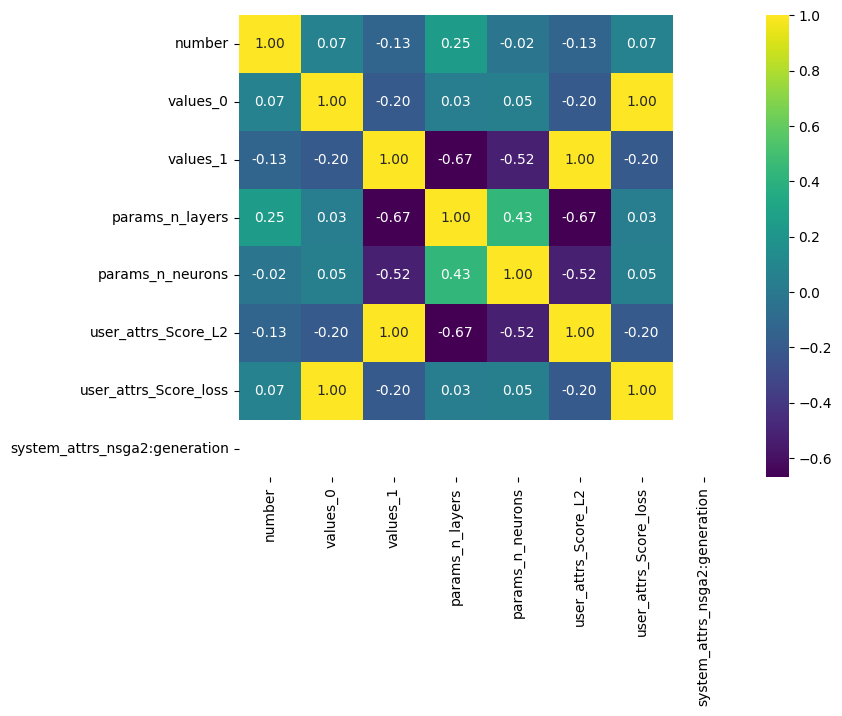

In [ ]:
numerical_columns = df.select_dtypes(include=['int', 'float'])
correlation_matrix = numerical_columns.corr()
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")

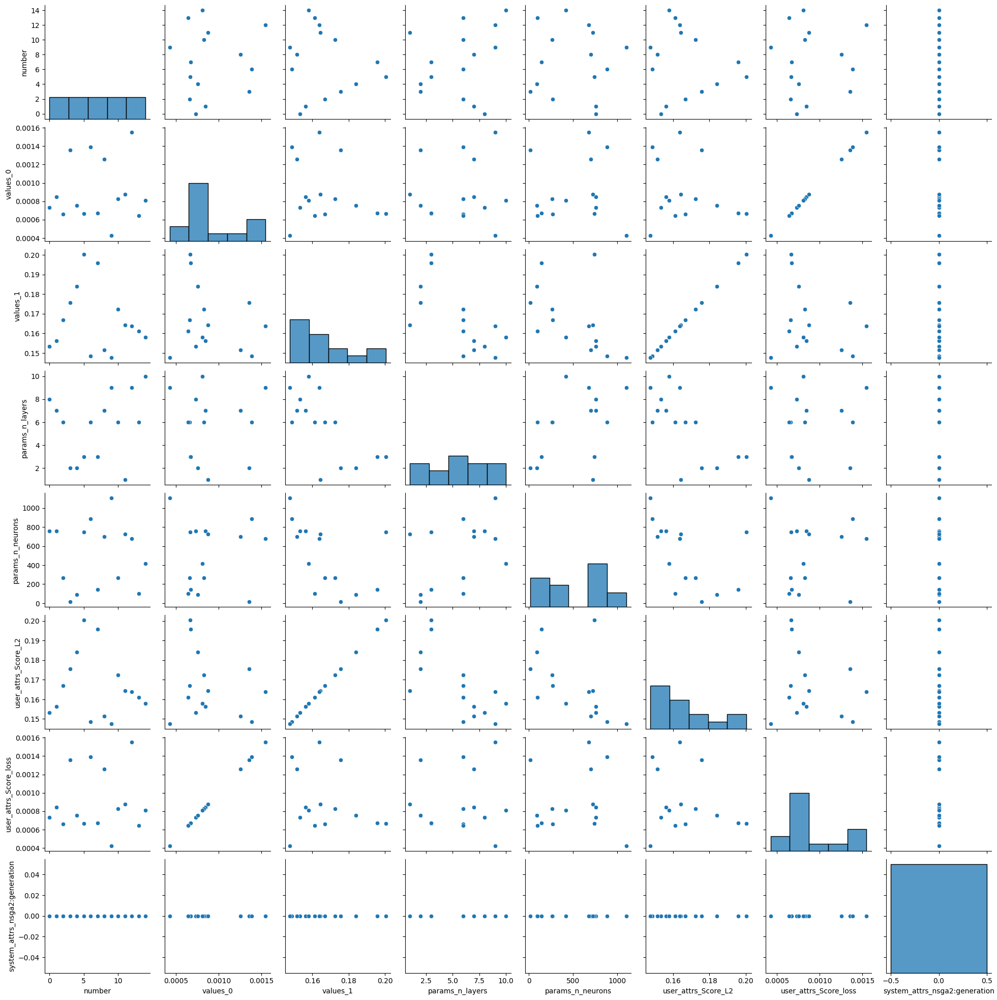

In [ ]:
sns.pairplot(df)

##test 7 (L2 monitorado), BC

In [ ]:
#dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, ic_2, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=512,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)



In [ ]:
def objective(trial):

    n_layers = trial.suggest_int('n_layers', 1, 10)
    n_neurons = trial.suggest_int('n_neurons', 8, 1300)
    #name_activation = trial.suggest_categorical('activation', ['relu', 'sigmoid', 'tanh'])
    #n_lr = trial.suggest_float('n_lr', 0.0001, 0.01)

    layer_size = [3] + [n_neurons] * n_layers + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)
    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )

    early_stopping=dde.callbacks.EarlyStopping(monitor='loss_test', min_delta=1e-5, patience=100)

    losshistory, train_state = model.train(epochs=2000, callbacks=[early_stopping],display_every=10)

    loss_test = losshistory.loss_test[-1][0]+losshistory.loss_test[-1][1]+losshistory.loss_test[-1][2]
    l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

    #trial.set_user_attr("Score_loss", loss_test)
    trial.set_user_attr("Score_L2", l2)

    return l2

study = optuna.create_study(direction='minimize')#directions=['minimize','minimize']
study.optimize(objective, n_trials=15, gc_after_trial=True)

[I 2024-02-16 21:29:04,891] A new study created in memory with name: no-name-9771fdb7-fbd8-4c07-9008-c704aa240827
/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


Compiling model...
Building feed-forward neural network...
'build' took 0.230010 s

'compile' took 2.284352 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [6.33e-04, 1.32e+01, 1.52e-01, 2.86e+01, 1.04e+00]    [6.33e-04, 1.32e+01, 1.52e-01, 2.86e+01, 1.04e+00]    [9.68e-01]    
10        [1.71e-02, 1.01e+01, 3.53e-02, 1.41e+00, 3.21e+01]    [1.71e-02, 1.01e+01, 3.53e-02, 1.41e+00, 3.21e+01]    [8.37e-01]    
20        [8.12e-03, 1.67e-01, 3.96e-01, 1.12e-01, 4.79e-01]    [8.12e-03, 1.67e-01, 3.96e-01, 1.12e-01, 4.79e-01]    [1.61e-01]    
30        [3.91e-03, 2.61e-01, 1.90e-01, 1.67e-01, 6.77e-01]    [3.91e-03, 2.61e-01, 1.90e-01, 1.67e-01, 6.77e-01]    [1.41e-01]    
40        [3.65e-03, 1.80e-01, 4.84e-02, 4.18e-02, 3.89e-01]    [3.65e-03, 1.80e-01, 4.84e-02, 4.18e-02, 3.89e-01]    [1.46e-01]    
50        [4.97e-03, 2.09e-01, 1.56e-02, 9.17e-02, 3.72e-01]    [4.97e-0

[I 2024-02-16 21:32:50,365] Trial 0 finished with value: 0.05397028848528862 and parameters: {'n_layers': 4, 'n_neurons': 1140}. Best is trial 0 with value: 0.05397028848528862.


Compiling model...
Building feed-forward neural network...
'build' took 0.362209 s

'compile' took 4.658335 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [6.73e-05, 1.38e+01, 8.59e-02, 3.19e+01, 5.57e-01]    [6.73e-05, 1.38e+01, 8.59e-02, 3.19e+01, 5.57e-01]    [9.94e-01]    
10        [2.51e-01, 8.35e+00, 2.74e-01, 3.36e+00, 1.44e+01]    [2.51e-01, 8.35e+00, 2.74e-01, 3.36e+00, 1.44e+01]    [7.53e-01]    
20        [2.38e-02, 1.50e+00, 9.54e-02, 2.63e-01, 1.14e+00]    [2.38e-02, 1.50e+00, 9.54e-02, 2.63e-01, 1.14e+00]    [3.51e-01]    
30        [2.33e-02, 2.89e-01, 8.00e-02, 7.57e-02, 1.13e-01]    [2.33e-02, 2.89e-01, 8.00e-02, 7.57e-02, 1.13e-01]    [1.89e-01]    
40        [3.11e-03, 3.53e-01, 1.03e-02, 1.94e-01, 9.89e-02]    [3.11e-03, 3.53e-01, 1.03e-02, 1.94e-01, 9.89e-02]    [1.42e-01]    
50        [3.57e-03, 6.42e-02, 6.44e-03, 7.59e-02, 1.85e-01]    [3.57e-0

[I 2024-02-16 21:33:39,805] Trial 1 finished with value: 0.15096691250801086 and parameters: {'n_layers': 9, 'n_neurons': 450}. Best is trial 0 with value: 0.05397028848528862.


Compiling model...
Building feed-forward neural network...
'build' took 0.056419 s

'compile' took 1.317130 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [1.57e-03, 1.31e+01, 1.72e-01, 2.67e+01, 1.67e+00]    [1.57e-03, 1.31e+01, 1.72e-01, 2.67e+01, 1.67e+00]    [9.65e-01]    
10        [1.01e-02, 7.95e+00, 2.00e-02, 1.02e+01, 4.42e+00]    [1.01e-02, 7.95e+00, 2.00e-02, 1.02e+01, 4.42e+00]    [7.39e-01]    
20        [1.20e-02, 3.90e+00, 3.50e-01, 2.13e+00, 5.02e+00]    [1.20e-02, 3.90e+00, 3.50e-01, 2.13e+00, 5.02e+00]    [5.07e-01]    
30        [1.60e-02, 6.56e-01, 3.97e-01, 4.99e-01, 9.08e-01]    [1.60e-02, 6.56e-01, 3.97e-01, 4.99e-01, 9.08e-01]    [2.13e-01]    
40        [1.62e-02, 2.17e-01, 2.62e-02, 2.29e-02, 4.57e-01]    [1.62e-02, 2.17e-01, 2.62e-02, 2.29e-02, 4.57e-01]    [1.93e-01]    
50        [1.55e-02, 2.54e-01, 2.53e-01, 3.84e-02, 3.80e-01]    [1.55e-0

[I 2024-02-16 21:33:59,039] Trial 2 finished with value: 0.08308780193328857 and parameters: {'n_layers': 2, 'n_neurons': 191}. Best is trial 0 with value: 0.05397028848528862.


Compiling model...
Building feed-forward neural network...
'build' took 0.107828 s

'compile' took 1.866914 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [4.16e-05, 1.39e+01, 1.48e-01, 3.35e+01, 3.15e-01]    [4.16e-05, 1.39e+01, 1.48e-01, 3.35e+01, 3.15e-01]    [9.99e-01]    
10        [8.53e-03, 9.15e+00, 2.96e-02, 1.15e+01, 4.99e+00]    [8.53e-03, 9.15e+00, 2.96e-02, 1.15e+01, 4.99e+00]    [7.95e-01]    
20        [7.53e-03, 7.07e+00, 2.89e-02, 3.58e+00, 9.13e+00]    [7.53e-03, 7.07e+00, 2.89e-02, 3.58e+00, 9.13e+00]    [6.90e-01]    
30        [6.61e-03, 5.26e+00, 1.54e-01, 2.98e+00, 5.99e+00]    [6.61e-03, 5.26e+00, 1.54e-01, 2.98e+00, 5.99e+00]    [5.92e-01]    
40        [5.03e-03, 3.68e+00, 3.13e-01, 3.38e+00, 2.55e+00]    [5.03e-03, 3.68e+00, 3.13e-01, 3.38e+00, 2.55e+00]    [4.96e-01]    
50        [4.61e-03, 2.32e+00, 3.58e-01, 2.06e+00, 1.62e+00]    [4.61e-0

[I 2024-02-16 21:34:14,925] Trial 3 finished with value: 0.1460184007883072 and parameters: {'n_layers': 1, 'n_neurons': 384}. Best is trial 0 with value: 0.05397028848528862.


Compiling model...
Building feed-forward neural network...
'build' took 0.330968 s

'compile' took 2.537710 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [4.12e-04, 1.48e+01, 1.47e-01, 3.63e+01, 1.99e-01]    [4.12e-04, 1.48e+01, 1.47e-01, 3.63e+01, 1.99e-01]    [1.03e+00]    
10        [1.25e-02, 8.43e+00, 4.77e-02, 3.55e-01, 2.50e+01]    [1.25e-02, 8.43e+00, 4.77e-02, 3.55e-01, 2.50e+01]    [7.57e-01]    
20        [6.59e-03, 9.59e-01, 3.50e-01, 1.73e+00, 2.07e+00]    [6.59e-03, 9.59e-01, 3.50e-01, 1.73e+00, 2.07e+00]    [2.54e-01]    
30        [3.41e-03, 4.87e-01, 2.27e-01, 3.75e-01, 1.84e+00]    [3.41e-03, 4.87e-01, 2.27e-01, 3.75e-01, 1.84e+00]    [1.86e-01]    
40        [5.54e-03, 1.89e-01, 2.40e-02, 6.98e-02, 3.50e-01]    [5.54e-03, 1.89e-01, 2.40e-02, 6.98e-02, 3.50e-01]    [1.78e-01]    
50        [6.33e-03, 1.52e-01, 1.71e-02, 3.87e-02, 3.81e-01]    [6.33e-0

[I 2024-02-16 21:38:19,753] Trial 4 finished with value: 0.05277644842863083 and parameters: {'n_layers': 4, 'n_neurons': 1147}. Best is trial 4 with value: 0.05277644842863083.


Compiling model...
Building feed-forward neural network...
'build' took 0.111445 s

'compile' took 1.744302 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [1.54e-04, 1.43e+01, 9.17e-02, 3.45e+01, 2.71e-01]    [1.54e-04, 1.43e+01, 9.17e-02, 3.45e+01, 2.71e-01]    [1.01e+00]    
10        [6.49e-03, 3.76e+00, 5.38e-01, 2.13e+00, 4.12e+00]    [6.49e-03, 3.76e+00, 5.38e-01, 2.13e+00, 4.12e+00]    [5.02e-01]    
20        [1.18e-02, 5.53e-01, 1.33e-02, 2.82e-01, 3.06e+00]    [1.18e-02, 5.53e-01, 1.33e-02, 2.82e-01, 3.06e+00]    [3.12e-01]    
30        [5.89e-03, 2.74e-01, 3.36e-01, 9.31e-01, 2.65e-01]    [5.89e-03, 2.74e-01, 3.36e-01, 9.31e-01, 2.65e-01]    [2.02e-01]    
40        [7.77e-03, 1.03e-01, 6.79e-02, 9.31e-02, 6.74e-01]    [7.77e-03, 1.03e-01, 6.79e-02, 9.31e-02, 6.74e-01]    [1.69e-01]    
50        [5.70e-03, 1.12e-01, 2.03e-02, 1.07e-01, 3.13e-01]    [5.70e-0

[I 2024-02-16 21:39:46,142] Trial 5 finished with value: 0.0505552776157856 and parameters: {'n_layers': 3, 'n_neurons': 627}. Best is trial 5 with value: 0.0505552776157856.


Compiling model...
Building feed-forward neural network...
'build' took 0.090799 s

'compile' took 1.483178 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [1.90e-04, 1.43e+01, 1.33e-01, 3.49e+01, 2.50e-01]    [1.90e-04, 1.43e+01, 1.33e-01, 3.49e+01, 2.50e-01]    [1.01e+00]    
10        [5.86e-03, 7.81e+00, 1.99e-02, 3.97e+00, 9.87e+00]    [5.86e-03, 7.81e+00, 1.99e-02, 3.97e+00, 9.87e+00]    [7.28e-01]    
20        [5.50e-03, 4.90e+00, 2.56e-01, 2.09e+00, 5.98e+00]    [5.50e-03, 4.90e+00, 2.56e-01, 2.09e+00, 5.98e+00]    [5.71e-01]    
30        [4.66e-03, 2.62e+00, 4.96e-01, 2.85e+00, 1.06e+00]    [4.66e-03, 2.62e+00, 4.96e-01, 2.85e+00, 1.06e+00]    [4.25e-01]    
40        [5.21e-03, 9.10e-01, 3.02e-01, 4.17e-01, 9.06e-01]    [5.21e-03, 9.10e-01, 3.02e-01, 4.17e-01, 9.06e-01]    [2.41e-01]    
50        [5.64e-03, 2.01e-01, 4.34e-02, 7.43e-02, 2.94e-01]    [5.64e-0

[I 2024-02-16 21:40:08,505] Trial 6 finished with value: 0.1318998634815216 and parameters: {'n_layers': 1, 'n_neurons': 1095}. Best is trial 5 with value: 0.0505552776157856.


Compiling model...
Building feed-forward neural network...
'build' took 0.116228 s

'compile' took 2.121118 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [7.91e-05, 1.41e+01, 1.93e-01, 3.22e+01, 6.45e-01]    [7.91e-05, 1.41e+01, 1.93e-01, 3.22e+01, 6.45e-01]    [1.00e+00]    
10        [1.87e-02, 3.73e+00, 3.34e-01, 1.06e+00, 6.92e+00]    [1.87e-02, 3.73e+00, 3.34e-01, 1.06e+00, 6.92e+00]    [4.88e-01]    
20        [2.69e-02, 9.38e-01, 2.79e-01, 1.36e-01, 9.81e-01]    [2.69e-02, 9.38e-01, 2.79e-01, 1.36e-01, 9.81e-01]    [3.46e-01]    
30        [9.69e-03, 2.71e-01, 5.71e-02, 7.34e-02, 7.10e-01]    [9.69e-03, 2.71e-01, 5.71e-02, 7.34e-02, 7.10e-01]    [1.42e-01]    
40        [1.66e-02, 1.51e-01, 9.10e-02, 7.26e-02, 5.35e-01]    [1.66e-02, 1.51e-01, 9.10e-02, 7.26e-02, 5.35e-01]    [1.75e-01]    
50        [7.45e-03, 1.29e-01, 8.55e-02, 5.44e-02, 3.11e-01]    [7.45e-0

[I 2024-02-16 21:40:49,305] Trial 7 finished with value: 0.046892549842596054 and parameters: {'n_layers': 4, 'n_neurons': 255}. Best is trial 7 with value: 0.046892549842596054.


Compiling model...
Building feed-forward neural network...
'build' took 0.173204 s

'compile' took 2.528110 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [3.05e-02, 1.22e+01, 8.76e-02, 2.08e+01, 3.36e+00]    [3.05e-02, 1.22e+01, 8.76e-02, 2.08e+01, 3.36e+00]    [9.25e-01]    
10        [6.30e-02, 9.10e+00, 1.08e-02, 7.10e+00, 9.51e+00]    [6.30e-02, 9.10e+00, 1.08e-02, 7.10e+00, 9.51e+00]    [7.90e-01]    
20        [5.54e-02, 5.32e+00, 2.37e-01, 8.32e+00, 2.53e+00]    [5.54e-02, 5.32e+00, 2.37e-01, 8.32e+00, 2.53e+00]    [6.04e-01]    
30        [1.23e-01, 1.56e+00, 5.09e-01, 2.47e+00, 1.10e+00]    [1.23e-01, 1.56e+00, 5.09e-01, 2.47e+00, 1.10e+00]    [3.23e-01]    
40        [1.01e-01, 3.45e-01, 1.37e-01, 1.10e-01, 4.02e-01]    [1.01e-01, 3.45e-01, 1.37e-01, 1.10e-01, 4.02e-01]    [1.65e-01]    
50        [6.56e-02, 6.28e-01, 1.98e-01, 5.28e-02, 3.01e-01]    [6.56e-0

[I 2024-02-16 21:41:10,441] Trial 8 finished with value: 0.0916866809129715 and parameters: {'n_layers': 4, 'n_neurons': 39}. Best is trial 7 with value: 0.046892549842596054.


Compiling model...
Building feed-forward neural network...
'build' took 0.190970 s

'compile' took 3.324465 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [5.05e-05, 1.36e+01, 3.30e-01, 3.17e+01, 6.24e-01]    [5.05e-05, 1.36e+01, 3.30e-01, 3.17e+01, 6.24e-01]    [9.89e-01]    
10        [3.10e-02, 3.69e+00, 4.55e-01, 1.93e+00, 5.89e+00]    [3.10e-02, 3.69e+00, 4.55e-01, 1.93e+00, 5.89e+00]    [4.88e-01]    
20        [1.57e-02, 1.24e+00, 5.31e-01, 3.85e-01, 5.26e-01]    [1.57e-02, 1.24e+00, 5.31e-01, 3.85e-01, 5.26e-01]    [3.41e-01]    
30        [1.15e-02, 2.17e-01, 2.08e-02, 3.64e-01, 3.78e-01]    [1.15e-02, 2.17e-01, 2.08e-02, 3.64e-01, 3.78e-01]    [1.79e-01]    
40        [9.81e-03, 1.89e-01, 3.62e-02, 7.86e-02, 3.85e-01]    [9.81e-03, 1.89e-01, 3.62e-02, 7.86e-02, 3.85e-01]    [1.28e-01]    
50        [5.16e-03, 2.03e-01, 4.21e-02, 6.03e-03, 2.79e-01]    [5.16e-0

[I 2024-02-16 21:41:52,611] Trial 9 finished with value: 0.04280467703938484 and parameters: {'n_layers': 5, 'n_neurons': 200}. Best is trial 9 with value: 0.04280467703938484.


Compiling model...
Building feed-forward neural network...
'build' took 0.473980 s

'compile' took 4.738996 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [1.16e-04, 1.38e+01, 1.31e-01, 3.10e+01, 7.18e-01]    [1.16e-04, 1.38e+01, 1.31e-01, 3.10e+01, 7.18e-01]    [9.90e-01]    
10        [2.73e+00, 1.00e+01, 9.39e-02, 2.21e+01, 1.66e+00]    [2.73e+00, 1.00e+01, 9.39e-02, 2.21e+01, 1.66e+00]    [8.35e-01]    
20        [2.08e-01, 1.07e+00, 1.89e-01, 2.80e+00, 4.37e-01]    [2.08e-01, 1.07e+00, 1.89e-01, 2.80e+00, 4.37e-01]    [2.65e-01]    
30        [9.67e-03, 6.46e-01, 8.80e-02, 2.32e+00, 1.01e-01]    [9.67e-03, 6.46e-01, 8.80e-02, 2.32e+00, 1.01e-01]    [2.24e-01]    
40        [5.76e-03, 2.33e-01, 1.05e-01, 3.58e-01, 2.37e-01]    [5.76e-03, 2.33e-01, 1.05e-01, 3.58e-01, 2.37e-01]    [1.21e-01]    
50        [1.17e-02, 1.79e-02, 6.24e-02, 1.67e-02, 2.18e-01]    [1.17e-0

[I 2024-02-16 21:43:25,752] Trial 10 finished with value: 0.14870774745941162 and parameters: {'n_layers': 7, 'n_neurons': 817}. Best is trial 9 with value: 0.04280467703938484.


Compiling model...
Building feed-forward neural network...
'build' took 0.158128 s

'compile' took 3.004262 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [8.07e-04, 1.38e+01, 2.93e-02, 3.03e+01, 7.94e-01]    [8.07e-04, 1.38e+01, 2.93e-02, 3.03e+01, 7.94e-01]    [9.91e-01]    
10        [9.04e-03, 3.14e+00, 2.21e-01, 1.02e+01, 2.57e-01]    [9.04e-03, 3.14e+00, 2.21e-01, 1.02e+01, 2.57e-01]    [4.82e-01]    
20        [1.99e-02, 4.69e-01, 6.27e-01, 2.04e+00, 4.37e-01]    [1.99e-02, 4.69e-01, 6.27e-01, 2.04e+00, 4.37e-01]    [2.70e-01]    
30        [7.45e-03, 4.54e-01, 2.33e-02, 2.25e-01, 4.75e-01]    [7.45e-03, 4.54e-01, 2.33e-02, 2.25e-01, 4.75e-01]    [2.04e-01]    
40        [6.30e-03, 1.28e-01, 8.17e-03, 1.94e-02, 2.45e-01]    [6.30e-03, 1.28e-01, 8.17e-03, 1.94e-02, 2.45e-01]    [1.20e-01]    
50        [3.65e-03, 5.76e-02, 3.42e-02, 1.08e-01, 1.63e-01]    [3.65e-0

[I 2024-02-16 21:43:52,024] Trial 11 finished with value: 0.07742679119110107 and parameters: {'n_layers': 6, 'n_neurons': 294}. Best is trial 9 with value: 0.04280467703938484.


Compiling model...
Building feed-forward neural network...
'build' took 0.173091 s

'compile' took 2.792123 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [3.55e-02, 1.53e+01, 3.06e-01, 3.66e+01, 1.53e-01]    [3.55e-02, 1.53e+01, 3.06e-01, 3.66e+01, 1.53e-01]    [1.05e+00]    
10        [2.96e-01, 9.48e+00, 3.89e-01, 9.82e+00, 8.60e+00]    [2.96e-01, 9.48e+00, 3.89e-01, 9.82e+00, 8.60e+00]    [8.11e-01]    
20        [6.16e-02, 5.25e+00, 8.11e-02, 1.01e+01, 3.06e+00]    [6.16e-02, 5.25e+00, 8.11e-02, 1.01e+01, 3.06e+00]    [5.94e-01]    
30        [1.52e-01, 6.19e-01, 7.19e-02, 1.83e+00, 3.45e-01]    [1.52e-01, 6.19e-01, 7.19e-02, 1.83e+00, 3.45e-01]    [2.08e-01]    
40        [5.91e-02, 1.57e+00, 9.60e-02, 4.20e-02, 4.89e-01]    [5.91e-02, 1.57e+00, 9.60e-02, 4.20e-02, 4.89e-01]    [3.84e-01]    
50        [3.56e-02, 1.02e+00, 1.10e-01, 5.92e-02, 3.15e-01]    [3.56e-0

[I 2024-02-16 21:44:22,159] Trial 12 finished with value: 0.12268475443124771 and parameters: {'n_layers': 7, 'n_neurons': 42}. Best is trial 9 with value: 0.04280467703938484.


Compiling model...
Building feed-forward neural network...
'build' took 0.156260 s

'compile' took 4.662477 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [1.02e-04, 1.37e+01, 1.06e-01, 3.10e+01, 6.93e-01]    [1.02e-04, 1.37e+01, 1.06e-01, 3.10e+01, 6.93e-01]    [9.87e-01]    
10        [5.23e-03, 6.98e+00, 7.58e-02, 1.69e+01, 4.16e-01]    [5.23e-03, 6.98e+00, 7.58e-02, 1.69e+01, 4.16e-01]    [7.01e-01]    
20        [7.95e-03, 4.76e-01, 2.29e-02, 3.22e-01, 5.78e-01]    [7.95e-03, 4.76e-01, 2.29e-02, 3.22e-01, 5.78e-01]    [2.09e-01]    
30        [8.79e-03, 3.47e-01, 1.53e-01, 3.12e-01, 9.94e-01]    [8.79e-03, 3.47e-01, 1.53e-01, 3.12e-01, 9.94e-01]    [2.41e-01]    
40        [7.37e-03, 1.72e-01, 2.12e-02, 2.74e-01, 3.88e-01]    [7.37e-03, 1.72e-01, 2.12e-02, 2.74e-01, 3.88e-01]    [1.54e-01]    
50        [5.06e-03, 1.28e-01, 2.04e-02, 1.52e-01, 2.28e-01]    [5.06e-0

[I 2024-02-16 21:45:55,051] Trial 13 finished with value: 0.04770728945732117 and parameters: {'n_layers': 5, 'n_neurons': 594}. Best is trial 9 with value: 0.04280467703938484.


Compiling model...
Building feed-forward neural network...
'build' took 0.147988 s

'compile' took 3.895546 s

Training model...

Step      Train loss                                            Test loss                                             Test metric   
0         [4.07e-04, 1.43e+01, 3.94e-01, 3.36e+01, 5.07e-01]    [4.07e-04, 1.43e+01, 3.94e-01, 3.36e+01, 5.07e-01]    [1.01e+00]    
10        [5.56e-02, 1.62e+00, 6.46e-01, 4.53e+00, 5.24e-01]    [5.56e-02, 1.62e+00, 6.46e-01, 4.53e+00, 5.24e-01]    [3.52e-01]    
20        [1.68e-02, 2.88e-01, 7.50e-01, 8.14e-01, 2.54e-01]    [1.68e-02, 2.88e-01, 7.50e-01, 8.14e-01, 2.54e-01]    [2.23e-01]    
30        [1.25e-02, 4.64e-01, 1.98e-02, 2.14e-02, 4.33e-01]    [1.25e-02, 4.64e-01, 1.98e-02, 2.14e-02, 4.33e-01]    [2.31e-01]    
40        [8.48e-03, 2.50e-01, 1.93e-02, 6.68e-02, 4.48e-01]    [8.48e-03, 2.50e-01, 1.93e-02, 6.68e-02, 4.48e-01]    [1.27e-01]    
50        [4.54e-03, 1.29e-01, 2.52e-02, 2.51e-02, 2.25e-01]    [4.54e-0

[I 2024-02-16 21:46:44,763] Trial 14 finished with value: 0.04060859605669975 and parameters: {'n_layers': 6, 'n_neurons': 206}. Best is trial 14 with value: 0.04060859605669975.


In [ ]:
gc.collect()

###save and analize

In [ ]:
best_params = study.best_params
#best_params =study.best_trials

print("Best Hyperparameters:", best_params)

Best Hyperparameters: {'n_layers': 6, 'n_neurons': 206}


In [ ]:
df = study.trials_dataframe()
df.to_pickle("/content/drive/MyDrive/trained_models/sine-gordon_variable/optuna_tests_7.pkl")

<Axes: >

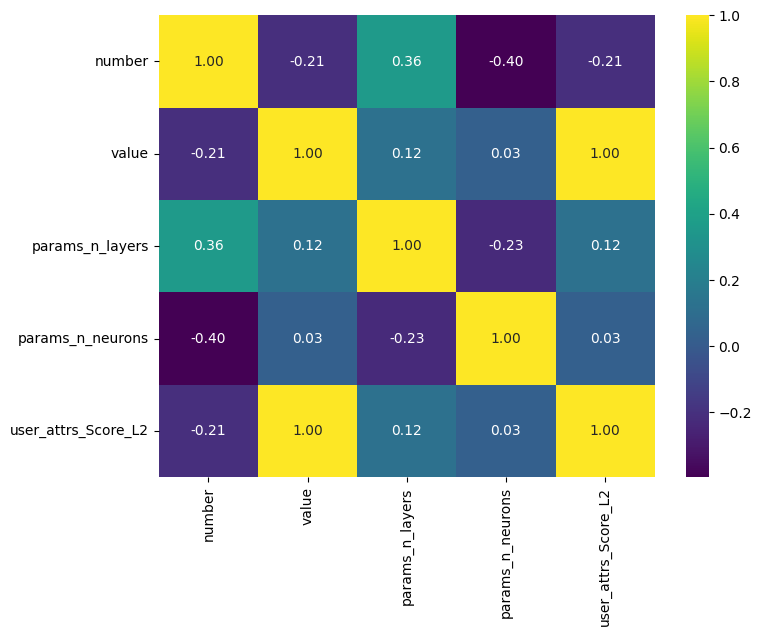

In [ ]:
numerical_columns = df.select_dtypes(include=['int', 'float'])
correlation_matrix = numerical_columns.corr()
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")

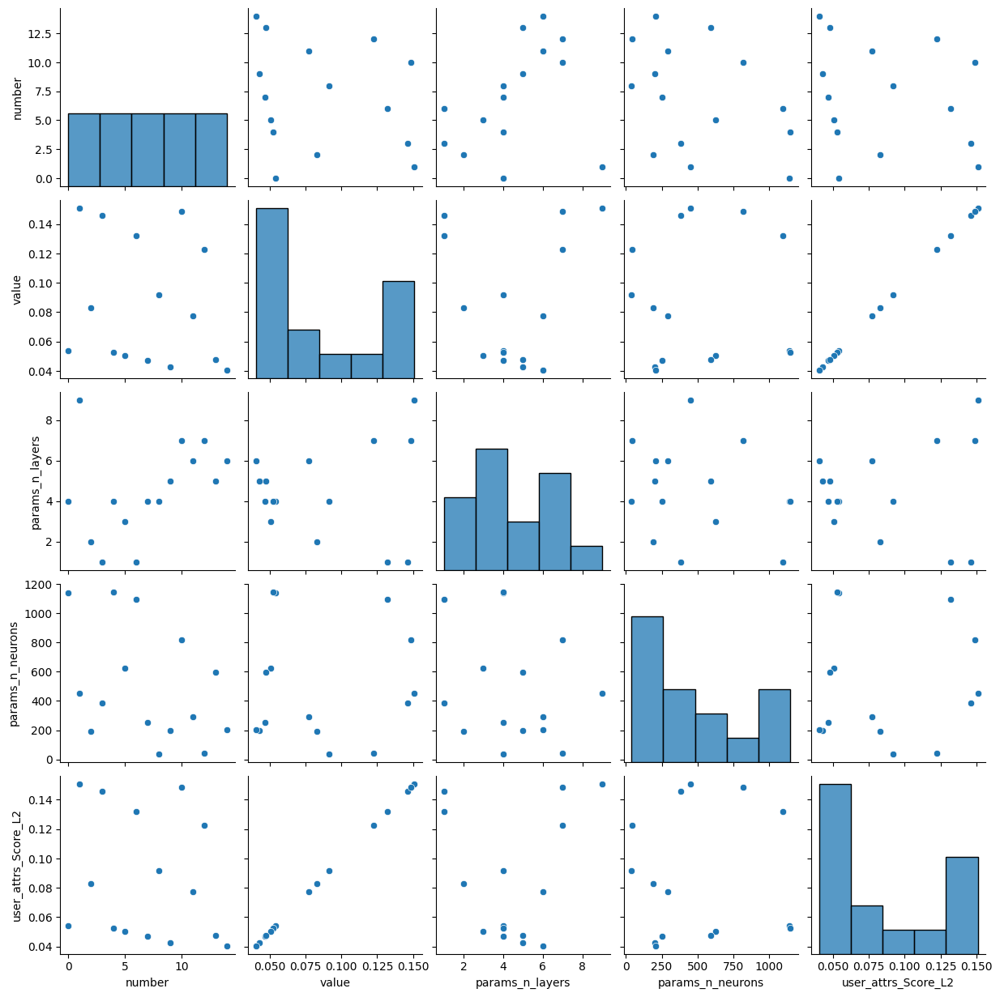

In [ ]:
sns.pairplot(df)

##test 8 (L2 monitorado), BC, sem ic derivada

In [ ]:
#dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
n_rand=128
sample = sampler.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
x1 = (sample -0.5)*10#(-5,5)
x2 = (sample*2+2)/10#(0.2,0.4), representa m
t0 = np.vstack(np.zeros(n_rand))
X_anchors=np.concatenate((x1,x2,t0), axis=1)



timedomain = dde.geometry.TimeDomain(-1, 1)
geom = dde.geometry.Rectangle([-5, 0.2], [5, 0.4])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    #m=0.3

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    #print(x,"\n", np.shape(x))
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=512,
    num_initial=0,
    solution=func,
    num_test=None,
    anchors=X_anchors
)



In [ ]:
def objective(trial):

    n_layers = trial.suggest_int('n_layers', 1, 10)
    n_neurons = trial.suggest_int('n_neurons', 8, 1300)
    #name_activation = trial.suggest_categorical('activation', ['relu', 'sigmoid', 'tanh'])
    #n_lr = trial.suggest_float('n_lr', 0.0001, 0.01)

    layer_size = [3] + [n_neurons] * n_layers + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)
    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )

    early_stopping=dde.callbacks.EarlyStopping(monitor='loss_test', min_delta=1e-5, patience=100)

    losshistory, train_state = model.train(epochs=2000, callbacks=[early_stopping],display_every=10)

    loss_test = losshistory.loss_test[-1][0]+losshistory.loss_test[-1][1]+losshistory.loss_test[-1][2]
    l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))

    #trial.set_user_attr("Score_loss", loss_test)
    trial.set_user_attr("Score_L2", l2)

    return l2

study = optuna.create_study(direction='minimize')#directions=['minimize','minimize']
study.optimize(objective, n_trials=45, gc_after_trial=True)

[I 2024-02-16 23:37:07,132] A new study created in memory with name: no-name-cd96175f-6dfa-409c-ad12-4c69f4674b0b
/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


Compiling model...
Building feed-forward neural network...
'build' took 0.287992 s

'compile' took 2.590859 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.90e-03, 1.26e+01, 2.46e+01, 1.84e+00]    [3.90e-03, 1.26e+01, 2.46e+01, 1.84e+00]    [9.42e-01]    
10        [9.26e-03, 3.21e+00, 1.00e+00, 5.90e+00]    [9.26e-03, 3.21e+00, 1.00e+00, 5.90e+00]    [4.44e-01]    
20        [1.38e-02, 1.10e+00, 1.21e-01, 2.68e+00]    [1.38e-02, 1.10e+00, 1.21e-01, 2.68e+00]    [3.83e-01]    
30        [5.03e-03, 4.44e-01, 8.23e-02, 1.17e+00]    [5.03e-03, 4.44e-01, 8.23e-02, 1.17e+00]    [1.74e-01]    
40        [6.67e-03, 1.61e-01, 1.88e-02, 3.96e-01]    [6.67e-03, 1.61e-01, 1.88e-02, 3.96e-01]    [1.66e-01]    
50        [6.46e-03, 8.91e-02, 6.87e-02, 3.66e-01]    [6.46e-03, 8.91e-02, 6.87e-02, 3.66e-01]    [1.53e-01]    
60        [5.69e-03, 1.10e-01, 9.35e-03, 3.49e-01]    [5.69e-03, 1.10e-01, 9.35

[I 2024-02-16 23:37:46,462] Trial 0 finished with value: 0.053180720657110214 and parameters: {'n_layers': 3, 'n_neurons': 361}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.336525 s

'compile' took 4.697776 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.40e-05, 1.42e+01, 3.30e+01, 4.43e-01]    [3.40e-05, 1.42e+01, 3.30e+01, 4.43e-01]    [1.01e+00]    
10        [1.10e+00, 9.27e+00, 1.50e+00, 1.91e+01]    [1.10e+00, 9.27e+00, 1.50e+00, 1.91e+01]    [8.00e-01]    
20        [7.43e-03, 1.12e+00, 3.91e+00, 1.31e+00]    [7.43e-03, 1.12e+00, 3.91e+00, 1.31e+00]    [3.41e-01]    
30        [5.06e-03, 1.18e+00, 1.35e-01, 7.39e-01]    [5.06e-03, 1.18e+00, 1.35e-01, 7.39e-01]    [2.65e-01]    
40        [1.10e-02, 1.47e-01, 4.30e-02, 1.14e-01]    [1.10e-02, 1.47e-01, 4.30e-02, 1.14e-01]    [1.30e-01]    
50        [7.93e-03, 3.24e-02, 1.52e-02, 2.34e-01]    [7.93e-03, 3.24e-02, 1.52e-02, 2.34e-01]    [1.29e-01]    
60        [6.10e-03, 2.78e-02, 1.68e-02, 1.99e-01]    [6.10e-03, 2.78e-02, 1.68

[I 2024-02-16 23:38:47,925] Trial 1 finished with value: 0.1390954554080963 and parameters: {'n_layers': 7, 'n_neurons': 615}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.351110 s

'compile' took 4.822957 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [6.15e-04, 1.35e+01, 2.88e+01, 1.01e+00]    [6.15e-04, 1.35e+01, 2.88e+01, 1.01e+00]    [9.79e-01]    
10        [1.02e-01, 3.97e+00, 3.72e+00, 7.19e+00]    [1.02e-01, 3.97e+00, 3.72e+00, 7.19e+00]    [5.02e-01]    
20        [4.16e-02, 4.57e-01, 1.07e+00, 2.89e-01]    [4.16e-02, 4.57e-01, 1.07e+00, 2.89e-01]    [1.78e-01]    
30        [1.57e-02, 2.37e-01, 1.40e-01, 1.95e-01]    [1.57e-02, 2.37e-01, 1.40e-01, 1.95e-01]    [1.43e-01]    
40        [7.95e-03, 8.09e-02, 1.42e-01, 1.13e-01]    [7.95e-03, 8.09e-02, 1.42e-01, 1.13e-01]    [1.19e-01]    
50        [4.26e-03, 8.64e-02, 8.39e-02, 1.08e-01]    [4.26e-03, 8.64e-02, 8.39e-02, 1.08e-01]    [1.22e-01]    
60        [4.60e-03, 6.61e-02, 7.64e-02, 1.10e-01]    [4.60e-03, 6.61e-02, 7.64

[I 2024-02-16 23:39:26,420] Trial 2 finished with value: 0.20653322339057922 and parameters: {'n_layers': 10, 'n_neurons': 340}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.232819 s

'compile' took 2.799371 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.02e-05, 1.40e+01, 3.16e+01, 6.02e-01]    [3.02e-05, 1.40e+01, 3.16e+01, 6.02e-01]    [1.00e+00]    
10        [6.77e-03, 6.53e+00, 9.57e+00, 2.72e+00]    [6.77e-03, 6.53e+00, 9.57e+00, 2.72e+00]    [6.68e-01]    
20        [7.66e-03, 1.19e-01, 2.20e-01, 5.47e-01]    [7.66e-03, 1.19e-01, 2.20e-01, 5.47e-01]    [1.71e-01]    
30        [6.51e-03, 8.89e-02, 3.97e-02, 2.88e-01]    [6.51e-03, 8.89e-02, 3.97e-02, 2.88e-01]    [1.46e-01]    
40        [5.05e-03, 2.03e-01, 1.86e-01, 6.66e-01]    [5.05e-03, 2.03e-01, 1.86e-01, 6.66e-01]    [1.32e-01]    
50        [5.93e-03, 1.19e-01, 1.42e-01, 2.92e-01]    [5.93e-03, 1.19e-01, 1.42e-01, 2.92e-01]    [1.45e-01]    
60        [6.51e-03, 9.70e-02, 2.09e-02, 2.55e-01]    [6.51e-03, 9.70e-02, 2.09

[I 2024-02-16 23:41:36,387] Trial 3 finished with value: 0.05345386266708374 and parameters: {'n_layers': 3, 'n_neurons': 893}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.520606 s

'compile' took 4.850871 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.94e-03, 1.55e+01, 3.88e+01, 8.07e-02]    [1.94e-03, 1.55e+01, 3.88e+01, 8.07e-02]    [1.05e+00]    
10        [2.12e+00, 1.95e+01, 8.60e-02, 3.48e+01]    [2.12e+00, 1.95e+01, 8.60e-02, 3.48e+01]    [1.18e+00]    
20        [8.51e+00, 6.29e+00, 8.50e+00, 4.66e+00]    [8.51e+00, 6.29e+00, 8.50e+00, 4.66e+00]    [6.53e-01]    
30        [3.29e-01, 3.91e-01, 6.84e-01, 8.83e-01]    [3.29e-01, 3.91e-01, 6.84e-01, 8.83e-01]    [1.81e-01]    
40        [1.24e-01, 2.77e-01, 1.10e+00, 1.47e-01]    [1.24e-01, 2.77e-01, 1.10e+00, 1.47e-01]    [1.51e-01]    
50        [1.68e-02, 2.23e-01, 2.52e-01, 1.15e-01]    [1.68e-02, 2.23e-01, 2.52e-01, 1.15e-01]    [1.78e-01]    
60        [1.25e-02, 6.86e-02, 9.09e-02, 1.37e-01]    [1.25e-02, 6.86e-02, 9.09

[I 2024-02-16 23:43:42,675] Trial 4 finished with value: 0.15411418676376343 and parameters: {'n_layers': 10, 'n_neurons': 790}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.414081 s

'compile' took 6.724165 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.51e-04, 1.35e+01, 3.28e+01, 2.89e-01]    [2.51e-04, 1.35e+01, 3.28e+01, 2.89e-01]    [9.85e-01]    
10        [3.17e-01, 1.81e+00, 3.40e-01, 1.76e+00]    [3.17e-01, 1.81e+00, 3.40e-01, 1.76e+00]    [4.15e-01]    
20        [1.28e-02, 6.10e-01, 1.68e-01, 1.30e+00]    [1.28e-02, 6.10e-01, 1.68e-01, 1.30e+00]    [2.03e-01]    
30        [7.42e-03, 1.70e-01, 8.62e-02, 1.94e-01]    [7.42e-03, 1.70e-01, 8.62e-02, 1.94e-01]    [1.20e-01]    
40        [7.96e-03, 1.01e-01, 6.22e-02, 1.25e-01]    [7.96e-03, 1.01e-01, 6.22e-02, 1.25e-01]    [1.17e-01]    
50        [1.20e-02, 9.44e-02, 3.88e-02, 1.20e-01]    [1.20e-02, 9.44e-02, 3.88e-02, 1.20e-01]    [1.21e-01]    
60        [6.43e-03, 6.31e-02, 3.00e-02, 1.27e-01]    [6.43e-03, 6.31e-02, 3.00

[I 2024-02-16 23:44:15,256] Trial 5 finished with value: 0.14631211757659912 and parameters: {'n_layers': 10, 'n_neurons': 165}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.383056 s

'compile' took 4.069733 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.68e-04, 1.36e+01, 3.05e+01, 6.29e-01]    [1.68e-04, 1.36e+01, 3.05e+01, 6.29e-01]    [9.83e-01]    
10        [4.84e-02, 9.02e+00, 2.89e-01, 2.74e+01]    [4.84e-02, 9.02e+00, 2.89e-01, 2.74e+01]    [7.84e-01]    
20        [6.72e-03, 5.61e-01, 3.98e-02, 4.49e-01]    [6.72e-03, 5.61e-01, 3.98e-02, 4.49e-01]    [2.59e-01]    
30        [2.48e-03, 9.07e-01, 1.18e+00, 5.64e-01]    [2.48e-03, 9.07e-01, 1.18e+00, 5.64e-01]    [2.93e-01]    
40        [4.91e-03, 2.48e-01, 2.95e-01, 2.76e-01]    [4.91e-03, 2.48e-01, 2.95e-01, 2.76e-01]    [1.78e-01]    
50        [5.62e-03, 9.24e-02, 3.90e-02, 1.95e-01]    [5.62e-03, 9.24e-02, 3.90e-02, 1.95e-01]    [1.24e-01]    
60        [5.12e-03, 6.58e-02, 1.06e-02, 1.64e-01]    [5.12e-03, 6.58e-02, 1.06

[I 2024-02-16 23:46:22,147] Trial 6 finished with value: 0.06398782879114151 and parameters: {'n_layers': 5, 'n_neurons': 895}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.403995 s

'compile' took 5.563785 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [5.08e-05, 1.43e+01, 3.36e+01, 3.54e-01]    [5.08e-05, 1.43e+01, 3.36e+01, 3.54e-01]    [1.01e+00]    
10        [2.47e-02, 1.44e+00, 3.46e+00, 1.74e+00]    [2.47e-02, 1.44e+00, 3.46e+00, 1.74e+00]    [2.96e-01]    
20        [3.59e-02, 3.32e-01, 1.14e+00, 1.64e-01]    [3.59e-02, 3.32e-01, 1.14e+00, 1.64e-01]    [1.56e-01]    
30        [1.89e-02, 1.16e-01, 5.31e-01, 1.37e-01]    [1.89e-02, 1.16e-01, 5.31e-01, 1.37e-01]    [1.74e-01]    
40        [1.51e-02, 1.19e-01, 7.73e-02, 1.44e-01]    [1.51e-02, 1.19e-01, 7.73e-02, 1.44e-01]    [1.25e-01]    
50        [1.41e-02, 6.47e-02, 6.16e-02, 1.36e-01]    [1.41e-02, 6.47e-02, 6.16e-02, 1.36e-01]    [1.19e-01]    
60        [7.16e-03, 4.09e-02, 5.25e-02, 1.55e-01]    [7.16e-03, 4.09e-02, 5.25

[I 2024-02-16 23:47:02,970] Trial 7 finished with value: 0.1523543745279312 and parameters: {'n_layers': 10, 'n_neurons': 274}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.433156 s

'compile' took 5.613760 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.56e-03, 1.30e+01, 2.83e+01, 1.00e+00]    [1.56e-03, 1.30e+01, 2.83e+01, 1.00e+00]    [9.63e-01]    
10        [1.27e-01, 8.24e-01, 1.87e+00, 7.83e-01]    [1.27e-01, 8.24e-01, 1.87e+00, 7.83e-01]    [2.56e-01]    
20        [1.88e-02, 3.45e-01, 8.45e-01, 2.08e-01]    [1.88e-02, 3.45e-01, 8.45e-01, 2.08e-01]    [1.92e-01]    
30        [1.12e-02, 5.74e-02, 1.85e-01, 1.57e-01]    [1.12e-02, 5.74e-02, 1.85e-01, 1.57e-01]    [1.35e-01]    
40        [1.76e-02, 8.25e-02, 1.44e-01, 1.38e-01]    [1.76e-02, 8.25e-02, 1.44e-01, 1.38e-01]    [1.40e-01]    
50        [8.54e-03, 7.07e-02, 4.78e-02, 1.28e-01]    [8.54e-03, 7.07e-02, 4.78e-02, 1.28e-01]    [1.30e-01]    
60        [4.75e-03, 4.24e-02, 2.83e-02, 1.12e-01]    [4.75e-03, 4.24e-02, 2.83

[I 2024-02-16 23:47:43,956] Trial 8 finished with value: 0.14764949679374695 and parameters: {'n_layers': 10, 'n_neurons': 269}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.060456 s

'compile' took 2.384184 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.10e-04, 1.41e+01, 3.46e+01, 1.79e-01]    [2.10e-04, 1.41e+01, 3.46e+01, 1.79e-01]    [1.01e+00]    
10        [9.67e-03, 9.47e+00, 1.36e+01, 4.03e+00]    [9.67e-03, 9.47e+00, 1.36e+01, 4.03e+00]    [8.11e-01]    
20        [9.95e-03, 7.37e+00, 4.61e+00, 8.90e+00]    [9.95e-03, 7.37e+00, 4.61e+00, 8.90e+00]    [7.05e-01]    
30        [8.65e-03, 5.76e+00, 3.17e+00, 7.63e+00]    [8.65e-03, 5.76e+00, 3.17e+00, 7.63e+00]    [6.18e-01]    
40        [6.46e-03, 4.23e+00, 3.73e+00, 3.99e+00]    [6.46e-03, 4.23e+00, 3.73e+00, 3.99e+00]    [5.28e-01]    
50        [4.67e-03, 2.90e+00, 3.06e+00, 2.30e+00]    [4.67e-03, 2.90e+00, 3.06e+00, 2.30e+00]    [4.32e-01]    
60        [3.95e-03, 1.75e+00, 1.49e+00, 1.78e+00]    [3.95e-03, 1.75e+00, 1.49

[I 2024-02-16 23:48:08,329] Trial 9 finished with value: 0.15847229957580566 and parameters: {'n_layers': 1, 'n_neurons': 340}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.130531 s

'compile' took 2.985452 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.25e-05, 1.41e+01, 3.25e+01, 4.61e-01]    [1.25e-05, 1.41e+01, 3.25e+01, 4.61e-01]    [1.00e+00]    
10        [5.89e-03, 7.76e+00, 3.19e+00, 1.15e+01]    [5.89e-03, 7.76e+00, 3.19e+00, 1.15e+01]    [7.24e-01]    
20        [5.22e-03, 4.55e+00, 3.15e+00, 4.76e+00]    [5.22e-03, 4.55e+00, 3.15e+00, 4.76e+00]    [5.50e-01]    
30        [4.24e-03, 2.16e+00, 2.47e+00, 1.11e+00]    [4.24e-03, 2.16e+00, 2.47e+00, 1.11e+00]    [3.71e-01]    
40        [4.97e-03, 5.39e-01, 9.13e-02, 8.33e-01]    [4.97e-03, 5.39e-01, 9.13e-02, 8.33e-01]    [1.74e-01]    
50        [5.48e-03, 9.12e-02, 1.65e-02, 2.17e-01]    [5.48e-03, 9.12e-02, 1.65e-02, 2.17e-01]    [1.33e-01]    
60        [5.03e-03, 8.10e-02, 1.19e-01, 2.39e-01]    [5.03e-03, 8.10e-02, 1.19

[I 2024-02-16 23:48:38,261] Trial 10 finished with value: 0.15335223078727722 and parameters: {'n_layers': 1, 'n_neurons': 1210}. Best is trial 0 with value: 0.053180720657110214.


Compiling model...
Building feed-forward neural network...
'build' took 0.199531 s

'compile' took 3.312037 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [9.41e-04, 1.51e+01, 3.83e+01, 8.84e-02]    [9.41e-04, 1.51e+01, 3.83e+01, 8.84e-02]    [1.04e+00]    
10        [6.10e-03, 7.95e+00, 1.73e+01, 5.80e-01]    [6.10e-03, 7.95e+00, 1.73e+01, 5.80e-01]    [7.48e-01]    
20        [6.62e-03, 3.55e-01, 8.68e-01, 3.59e-01]    [6.62e-03, 3.55e-01, 8.68e-01, 3.59e-01]    [1.92e-01]    
30        [4.89e-03, 2.02e-01, 3.76e-01, 3.47e-01]    [4.89e-03, 2.02e-01, 3.76e-01, 3.47e-01]    [1.67e-01]    
40        [4.40e-03, 2.49e-01, 2.40e-01, 8.69e-01]    [4.40e-03, 2.49e-01, 2.40e-01, 8.69e-01]    [1.39e-01]    
50        [6.57e-03, 1.08e-01, 4.32e-02, 4.25e-01]    [6.57e-03, 1.08e-01, 4.32e-02, 4.25e-01]    [1.66e-01]    
60        [6.14e-03, 1.20e-01, 6.00e-02, 2.44e-01]    [6.14e-03, 1.20e-01, 6.00

[I 2024-02-16 23:51:41,594] Trial 11 finished with value: 0.05162736400961876 and parameters: {'n_layers': 3, 'n_neurons': 1052}. Best is trial 11 with value: 0.05162736400961876.


Compiling model...
Building feed-forward neural network...
'build' took 0.222100 s

'compile' took 3.882804 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [5.16e-04, 1.35e+01, 2.90e+01, 9.68e-01]    [5.16e-04, 1.35e+01, 2.90e+01, 9.68e-01]    [9.79e-01]    
10        [3.18e-02, 1.18e+01, 2.33e+00, 3.82e+01]    [3.18e-02, 1.18e+01, 2.33e+00, 3.82e+01]    [9.07e-01]    
20        [3.09e-03, 2.80e-01, 3.88e-02, 5.36e-01]    [3.09e-03, 2.80e-01, 3.88e-02, 5.36e-01]    [1.66e-01]    
30        [4.12e-03, 3.81e-01, 4.70e-01, 8.24e-01]    [4.12e-03, 3.81e-01, 4.70e-01, 8.24e-01]    [1.49e-01]    
40        [2.74e-03, 2.85e-01, 7.90e-02, 2.87e-01]    [2.74e-03, 2.85e-01, 7.90e-02, 2.87e-01]    [2.01e-01]    
50        [3.47e-03, 2.70e-01, 1.73e-01, 2.72e-01]    [3.47e-03, 2.70e-01, 1.73e-01, 2.72e-01]    [1.98e-01]    
60        [4.07e-03, 1.40e-01, 7.13e-02, 2.87e-01]    [4.07e-03, 1.40e-01, 7.13

[I 2024-02-16 23:57:03,224] Trial 12 finished with value: 0.06213189661502838 and parameters: {'n_layers': 4, 'n_neurons': 1183}. Best is trial 11 with value: 0.05162736400961876.


Compiling model...
Building feed-forward neural network...
'build' took 0.167262 s

'compile' took 4.432776 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [8.53e-04, 1.32e+01, 2.82e+01, 1.03e+00]    [8.53e-04, 1.32e+01, 2.82e+01, 1.03e+00]    [9.69e-01]    
10        [7.16e-03, 4.55e+00, 1.85e+00, 7.21e+00]    [7.16e-03, 4.55e+00, 1.85e+00, 7.21e+00]    [5.41e-01]    
20        [1.42e-02, 1.02e+00, 1.73e-01, 4.50e+00]    [1.42e-02, 1.02e+00, 1.73e-01, 4.50e+00]    [3.90e-01]    
30        [5.50e-03, 3.57e-01, 8.03e-01, 3.40e-01]    [5.50e-03, 3.57e-01, 8.03e-01, 3.40e-01]    [2.00e-01]    
40        [6.60e-03, 1.06e-01, 2.01e-03, 4.04e-01]    [6.60e-03, 1.06e-01, 2.01e-03, 4.04e-01]    [1.70e-01]    
50        [5.98e-03, 1.10e-01, 2.74e-03, 3.42e-01]    [5.98e-03, 1.10e-01, 2.74e-03, 3.42e-01]    [1.26e-01]    
60        [5.82e-03, 9.93e-02, 1.29e-02, 3.12e-01]    [5.82e-03, 9.93e-02, 1.29

[I 2024-02-16 23:58:18,690] Trial 13 finished with value: 0.05295677110552788 and parameters: {'n_layers': 3, 'n_neurons': 582}. Best is trial 11 with value: 0.05162736400961876.


Compiling model...
Building feed-forward neural network...
'build' took 0.386054 s

'compile' took 5.196899 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.12e-04, 1.39e+01, 3.11e+01, 6.59e-01]    [2.12e-04, 1.39e+01, 3.11e+01, 6.59e-01]    [9.96e-01]    
10        [5.80e-01, 9.16e+00, 1.55e+00, 1.85e+01]    [5.80e-01, 9.16e+00, 1.55e+00, 1.85e+01]    [7.89e-01]    
20        [1.27e-02, 7.09e-01, 1.35e+00, 8.65e-01]    [1.27e-02, 7.09e-01, 1.35e+00, 8.65e-01]    [2.78e-01]    
30        [2.47e-03, 4.09e-01, 3.10e-01, 1.55e-01]    [2.47e-03, 4.09e-01, 3.10e-01, 1.55e-01]    [1.48e-01]    
40        [1.50e-02, 4.96e-01, 3.69e-02, 3.46e-01]    [1.50e-02, 4.96e-01, 3.69e-02, 3.46e-01]    [1.76e-01]    
50        [6.74e-03, 1.89e-01, 3.49e-02, 1.24e-01]    [6.74e-03, 1.89e-01, 3.49e-02, 1.24e-01]    [1.12e-01]    
60        [8.62e-03, 7.63e-02, 1.84e-02, 1.06e-01]    [8.62e-03, 7.63e-02, 1.84

[I 2024-02-16 23:59:30,105] Trial 14 finished with value: 0.1119622215628624 and parameters: {'n_layers': 7, 'n_neurons': 578}. Best is trial 11 with value: 0.05162736400961876.


Compiling model...
Building feed-forward neural network...
'build' took 0.167546 s

'compile' took 3.388977 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.88e-04, 1.35e+01, 2.95e+01, 8.50e-01]    [2.88e-04, 1.35e+01, 2.95e+01, 8.50e-01]    [9.81e-01]    
10        [6.24e-03, 4.47e+00, 2.32e-01, 1.35e+01]    [6.24e-03, 4.47e+00, 2.32e-01, 1.35e+01]    [5.29e-01]    
20        [4.51e-03, 1.04e+00, 2.87e+00, 1.30e+00]    [4.51e-03, 1.04e+00, 2.87e+00, 1.30e+00]    [2.68e-01]    
30        [3.41e-03, 3.65e-01, 7.85e-01, 4.70e-01]    [3.41e-03, 3.65e-01, 7.85e-01, 4.70e-01]    [2.08e-01]    
40        [4.13e-03, 1.91e-01, 1.06e-01, 3.91e-01]    [4.13e-03, 1.91e-01, 1.06e-01, 3.91e-01]    [1.39e-01]    
50        [4.38e-03, 8.05e-02, 6.64e-02, 3.72e-01]    [4.38e-03, 8.05e-02, 6.64e-02, 3.72e-01]    [1.49e-01]    
60        [4.04e-03, 8.17e-02, 1.75e-02, 3.91e-01]    [4.04e-03, 8.17e-02, 1.75

[I 2024-02-17 00:01:11,240] Trial 15 finished with value: 0.06264898180961609 and parameters: {'n_layers': 2, 'n_neurons': 1019}. Best is trial 11 with value: 0.05162736400961876.


Compiling model...
Building feed-forward neural network...
'build' took 0.325771 s

'compile' took 6.686120 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.41e-02, 1.22e+01, 2.35e+01, 2.17e+00]    [3.41e-02, 1.22e+01, 2.35e+01, 2.17e+00]    [9.28e-01]    
10        [1.91e-01, 9.32e+00, 1.17e+01, 6.27e+00]    [1.91e-01, 9.32e+00, 1.17e+01, 6.27e+00]    [8.03e-01]    
20        [6.83e-02, 5.25e+00, 9.44e+00, 3.00e+00]    [6.83e-02, 5.25e+00, 9.44e+00, 3.00e+00]    [5.99e-01]    
30        [4.04e-02, 1.30e+00, 3.89e+00, 7.16e-01]    [4.04e-02, 1.30e+00, 3.89e+00, 7.16e-01]    [2.90e-01]    
40        [2.94e-02, 6.04e-01, 6.77e-01, 3.90e-01]    [2.94e-02, 6.04e-01, 6.77e-01, 3.90e-01]    [2.30e-01]    
50        [2.12e-02, 1.01e+00, 1.04e-01, 4.54e-01]    [2.12e-02, 1.01e+00, 1.04e-01, 4.54e-01]    [3.06e-01]    
60        [1.96e-02, 8.28e-01, 8.07e-02, 3.56e-01]    [1.96e-02, 8.28e-01, 8.07

[I 2024-02-17 00:01:53,047] Trial 16 finished with value: 0.0974833071231842 and parameters: {'n_layers': 6, 'n_neurons': 25}. Best is trial 11 with value: 0.05162736400961876.


Compiling model...
Building feed-forward neural network...
'build' took 0.181684 s

'compile' took 3.630400 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.28e-04, 1.40e+01, 3.32e+01, 3.64e-01]    [1.28e-04, 1.40e+01, 3.32e+01, 3.64e-01]    [1.00e+00]    
10        [7.57e-03, 3.87e+00, 1.34e+00, 6.61e+00]    [7.57e-03, 3.87e+00, 1.34e+00, 6.61e+00]    [4.94e-01]    
20        [1.57e-02, 1.11e+00, 2.68e-02, 4.07e+00]    [1.57e-02, 1.11e+00, 2.68e-02, 4.07e+00]    [3.96e-01]    
30        [6.10e-03, 3.74e-01, 3.57e-01, 6.26e-01]    [6.10e-03, 3.74e-01, 3.57e-01, 6.26e-01]    [1.78e-01]    
40        [7.11e-03, 1.84e-01, 1.24e-01, 3.65e-01]    [7.11e-03, 1.84e-01, 1.24e-01, 3.65e-01]    [1.69e-01]    
50        [6.36e-03, 1.31e-01, 7.95e-04, 3.91e-01]    [6.36e-03, 1.31e-01, 7.95e-04, 3.91e-01]    [1.25e-01]    
60        [6.68e-03, 9.14e-02, 4.14e-03, 3.17e-01]    [6.68e-03, 9.14e-02, 4.14

[I 2024-02-17 00:03:03,780] Trial 17 finished with value: 0.05312240496277809 and parameters: {'n_layers': 3, 'n_neurons': 497}. Best is trial 11 with value: 0.05162736400961876.


Compiling model...
Building feed-forward neural network...
'build' took 0.253660 s

'compile' took 4.945467 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.49e-03, 1.50e+01, 3.74e+01, 1.11e-01]    [1.49e-03, 1.50e+01, 3.74e+01, 1.11e-01]    [1.04e+00]    
10        [3.98e-02, 6.28e+00, 7.94e-01, 1.52e+01]    [3.98e-02, 6.28e+00, 7.94e-01, 1.52e+01]    [6.43e-01]    
20        [2.60e-03, 6.29e-01, 3.50e-01, 6.10e-01]    [2.60e-03, 6.29e-01, 3.50e-01, 6.10e-01]    [2.38e-01]    
30        [3.62e-03, 7.65e-01, 6.20e-01, 3.70e-01]    [3.62e-03, 7.65e-01, 6.20e-01, 3.70e-01]    [2.94e-01]    
40        [5.69e-03, 1.13e-01, 1.24e-01, 2.32e-01]    [5.69e-03, 1.13e-01, 1.24e-01, 2.32e-01]    [1.36e-01]    
50        [5.36e-03, 1.48e-01, 2.38e-01, 2.04e-01]    [5.36e-03, 1.48e-01, 2.38e-01, 2.04e-01]    [1.26e-01]    
60        [4.55e-03, 8.04e-02, 1.49e-02, 2.07e-01]    [4.55e-03, 8.04e-02, 1.49

[I 2024-02-17 00:05:49,758] Trial 18 finished with value: 0.06413450092077255 and parameters: {'n_layers': 5, 'n_neurons': 749}. Best is trial 11 with value: 0.05162736400961876.


Compiling model...
Building feed-forward neural network...
'build' took 0.257898 s

'compile' took 4.496493 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.34e-03, 1.30e+01, 2.62e+01, 1.48e+00]    [1.34e-03, 1.30e+01, 2.62e+01, 1.48e+00]    [9.59e-01]    
10        [4.63e-02, 1.52e+01, 5.98e+00, 5.13e+01]    [4.63e-02, 1.52e+01, 5.98e+00, 5.13e+01]    [1.04e+00]    
20        [2.49e-03, 2.56e-01, 2.43e-02, 6.52e-01]    [2.49e-03, 2.56e-01, 2.43e-02, 6.52e-01]    [1.41e-01]    
30        [3.92e-03, 4.92e-01, 2.14e-02, 1.86e+00]    [3.92e-03, 4.92e-01, 2.14e-02, 1.86e+00]    [1.54e-01]    
40        [3.17e-03, 5.62e-01, 4.48e-01, 3.44e-01]    [3.17e-03, 5.62e-01, 4.48e-01, 3.44e-01]    [2.64e-01]    
50        [4.00e-03, 2.43e-01, 1.91e-01, 2.91e-01]    [4.00e-03, 2.43e-01, 1.91e-01, 2.91e-01]    [1.86e-01]    
60        [5.11e-03, 1.22e-01, 3.12e-02, 2.57e-01]    [5.11e-03, 1.22e-01, 3.12

In [ ]:
gc.collect()

###save and analize

In [ ]:
best_params = study.best_params
#best_params =study.best_trials

print("Best Hyperparameters:", best_params)

In [ ]:
df = study.trials_dataframe()
df.to_pickle("/content/drive/MyDrive/trained_models/sine-gordon_variable/optuna_tests_8.pkl")

In [ ]:
numerical_columns = df.select_dtypes(include=['int', 'float'])
correlation_matrix = numerical_columns.corr()
plt.figure(figsize=(8, 6))  # Set the figure size
sns.heatmap(correlation_matrix, annot=True, cmap='viridis', fmt=".2f")

In [ ]:
sns.pairplot(df)

#Benchmark (1 soliton)

In [ ]:
mkdir /content/drive/MyDrive/trained_models/sine-gordon_benchmark/2

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

#Boundary points
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*2+29)/100#m entre (0.29,0.31)
t0 = sample*2

#X_anchors=np.concatenate((x1,m,t0), axis=1)
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-5, 5)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    print(x,"\n #####################################")
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=256,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=None
)

layer_size = [2] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(iterations=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/2/model.ckpt")
'''
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

[[ 0.         0.       ]
 [-2.5        0.       ]
 [ 2.5        0.       ]
 ...
 [-0.4736328  1.9970015]
 [ 4.526367   1.998001 ]
 [-4.536133   1.9990005]] 
 #####################################
[[ 0.         0.       ]
 [-2.5        0.       ]
 [ 2.5        0.       ]
 ...
 [-0.4736328  1.9970015]
 [ 4.526367   1.998001 ]
 [-4.536133   1.9990005]] 
 #####################################
Compiling model...
Building feed-forward neural network...
'build' took 0.142966 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


[[ 0.         0.       ]
 [-2.5        0.       ]
 [ 2.5        0.       ]
 [-3.75       0.       ]
 [ 1.25       0.       ]
 [-1.25       0.       ]
 [ 3.75       0.       ]
 [-4.375      0.       ]
 [ 0.625      0.       ]
 [-1.875      0.       ]
 [ 3.125      0.       ]
 [-3.125      0.       ]
 [ 1.875      0.       ]
 [-0.625      0.       ]
 [ 4.375      0.       ]
 [-4.6875     0.       ]
 [ 0.3125     0.       ]
 [-2.1875     0.       ]
 [ 2.8125     0.       ]
 [-3.4375     0.       ]
 [ 1.5625     0.       ]
 [-0.9375     0.       ]
 [ 4.0625     0.       ]
 [-4.0625     0.       ]
 [ 0.9375     0.       ]
 [-1.5625     0.       ]
 [ 3.4375     0.       ]
 [-2.8125     0.       ]
 [ 2.1875     0.       ]
 [-0.3125     0.       ]
 [ 4.6875     0.       ]
 [-4.84375    0.       ]
 [ 0.15625    0.       ]
 [-2.34375    0.       ]
 [ 2.65625    0.       ]
 [-3.59375    0.       ]
 [ 1.40625    0.       ]
 [-1.09375    0.       ]
 [ 3.90625    0.       ]
 [-4.21875    0.       ]


'\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

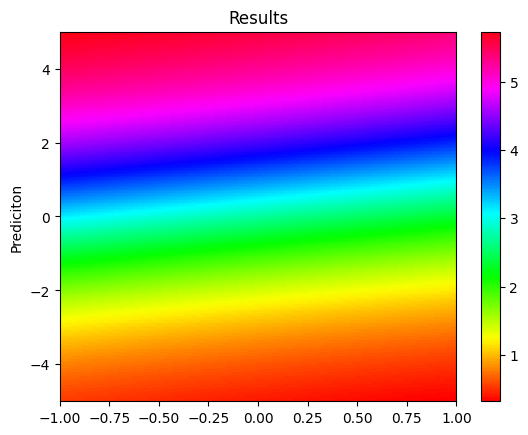

[[-5.          0.        ]
 [-4.96078431  0.        ]
 [-4.92156863  0.        ]
 ...
 [ 4.92156863  2.        ]
 [ 4.96078431  2.        ]
 [ 5.          2.        ]] 
 #####################################


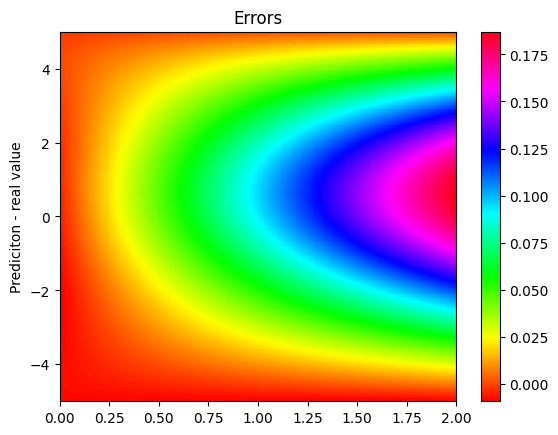

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

[[-5.         0.       ]
 [-4.9825177  0.       ]
 [-4.965035   0.       ]
 ...
 [ 4.965035   2.       ]
 [ 4.9825177  2.       ]
 [ 5.         2.       ]] 
 #####################################
Erro L2 encontrado:  0.024526607


[[-5.          0.25      ]
 [-4.96078431  0.25      ]
 [-4.92156863  0.25      ]
 [-4.88235294  0.25      ]
 [-4.84313725  0.25      ]
 [-4.80392157  0.25      ]
 [-4.76470588  0.25      ]
 [-4.7254902   0.25      ]
 [-4.68627451  0.25      ]
 [-4.64705882  0.25      ]
 [-4.60784314  0.25      ]
 [-4.56862745  0.25      ]
 [-4.52941176  0.25      ]
 [-4.49019608  0.25      ]
 [-4.45098039  0.25      ]
 [-4.41176471  0.25      ]
 [-4.37254902  0.25      ]
 [-4.33333333  0.25      ]
 [-4.29411765  0.25      ]
 [-4.25490196  0.25      ]
 [-4.21568627  0.25      ]
 [-4.17647059  0.25      ]
 [-4.1372549   0.25      ]
 [-4.09803922  0.25      ]
 [-4.05882353  0.25      ]
 [-4.01960784  0.25      ]
 [-3.98039216  0.25      ]
 [-3.94117647  0.25      ]
 [-3.90196078  0.25      ]
 [-3.8627451   0.25      ]
 [-3.82352941  0.25      ]
 [-3.78431373  0.25      ]
 [-3.74509804  0.25      ]
 [-3.70588235  0.25      ]
 [-3.66666667  0.25      ]
 [-3.62745098  0.25      ]
 [-3.58823529  0.25      ]
 

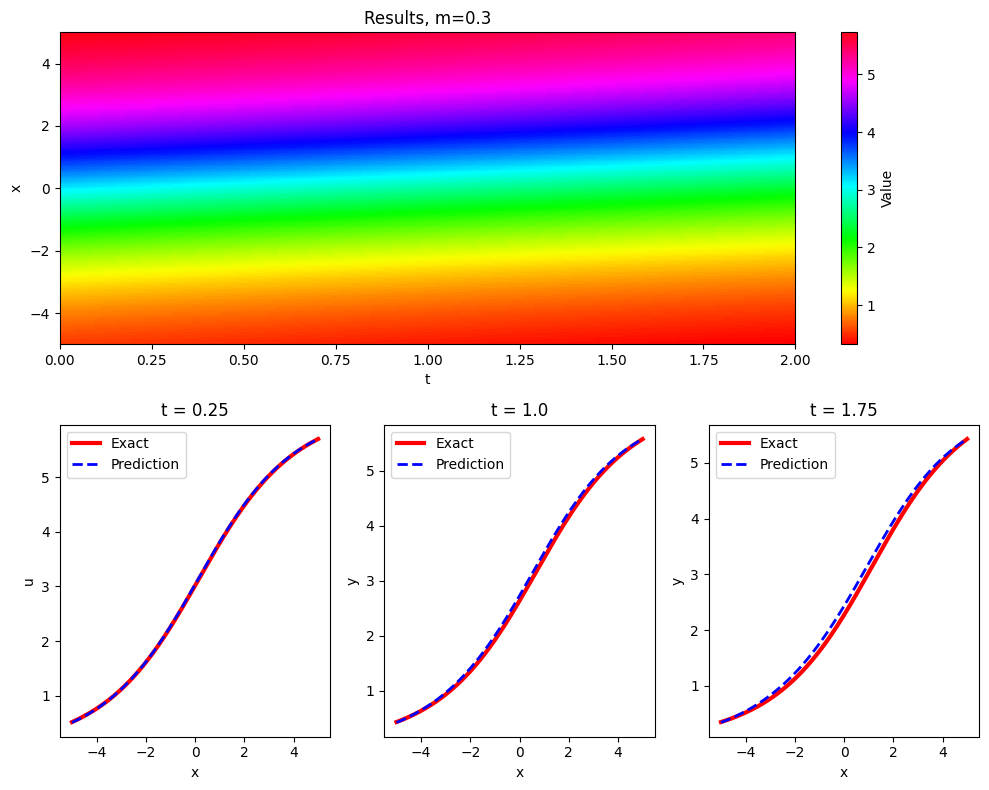

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the main function as a grid of a function of two variables:
#simply model.predict(X)

# Generate x and y values for the grid
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
m= np.ones(65536)*0.3
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

#definir função auxiliar que cria o grid com m e t fixos:
def make_X_m_t(t_value):
    X_star_2d = np.concatenate((np.vstack(x),np.vstack(np.ones(256)*t_value)),axis=1)
    return X_star_2d

# Calculate the main function values for the grid
prediction = model.predict(X_star, operator=None)
v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

# Create a figure and axis objects
fig = plt.figure(figsize=(10, 8))

# Main function subplot (upper half)
ax_main = fig.add_subplot(2, 1, 1)
#im = ax_main.imshow(prediction, extent=(0, 2*np.pi, 0, 2*np.pi), origin='lower', cmap='viridis',aspect='auto')
im=ax_main.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",#viridis,hsv
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
ax_main.set_title('Results, m=0.3')
ax_main.set_xlabel('t')
ax_main.set_ylabel('x')
#ax_main.legend()
fig.colorbar(im, ax=ax_main, label='Value')

# Subfunction subplots (lower half)
ax1 = fig.add_subplot(2, 3, 4)
x_1=make_X_m_t(0.25)
ax1.plot(x,func(x_1), 'r-', linewidth = 3, label = 'Exact')
ax1.plot(x,model.predict(x_1), 'b--', linewidth = 2, label = 'Prediction')
#ax1.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax1.set_title("t = 0.25")
ax1.set_xlabel('x')
ax1.set_ylabel('u')
ax1.legend()

ax2 = fig.add_subplot(2, 3, 5)
x_2=make_X_m_t(1.0)
ax2.plot(x,func(x_2), 'r-', linewidth = 3, label = 'Exact')
ax2.plot(x,model.predict(x_2), 'b--', linewidth = 2, label = 'Prediction')
ax2.set_title("t = 1.0")
ax2.set_xlabel('x')
ax2.set_ylabel('y')
ax2.legend()

ax3 = fig.add_subplot(2, 3, 6)
x_3=make_X_m_t(1.75)
ax3.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax3.plot(x,model.predict(x_3), 'b--', linewidth = 2, label = 'Prediction')
ax3.set_title("t = 1.75")
ax3.set_xlabel('x')
ax3.set_ylabel('y')
ax3.legend()

plt.tight_layout()
plt.show()

#Benchmark (1 soliton)-LBFGS

In [ ]:
mkdir /content/drive/MyDrive/trained_models/sine-gordon_benchmark/3

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

#Boundary points
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*2+29)/100#m entre (0.29,0.31)
t0 = sample*2

#X_anchors=np.concatenate((x1,m,t0), axis=1)
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-5, 5)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=256,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=None
)

layer_size = [2] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(iterations=10000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model.ckpt")
'''
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

Compiling model...
Building feed-forward neural network...
'build' took 0.129807 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.472265 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [8.81e-04, 1.20e+01, 2.77e+01, 6.13e-01]    [8.81e-04, 1.20e+01, 2.77e+01, 6.13e-01]    [9.68e-01]    
1000      [1.03e-04, 6.04e-05, 7.51e-06, 8.75e-06]    [1.03e-04, 6.04e-05, 7.51e-06, 8.75e-06]    [2.41e-02]    
2000      [2.60e-05, 5.83e-06, 1.18e-06, 1.15e-06]    [2.60e-05, 5.83e-06, 1.18e-06, 1.15e-06]    [2.05e-02]    
3000      [1.10e-05, 2.78e-06, 6.97e-07, 5.43e-07]    [1.10e-05, 2.78e-06, 6.97e-07, 5.43e-07]    [1.89e-02]    
4000      [6.14e-06, 2.25e-06, 9.91e-07, 5.02e-07]    [6.14e-06, 2.25e-06, 9.91e-07, 5.02e-07]    [1.82e-02]    
5000      [4.00e-06, 2.33e-06, 1.41e-06, 3.10e-07]    [4.00e-06, 2.33e-06, 1.41e-06, 3.10e-07]    [1.73e-02]    
6000      [2.79e-06, 2.34e-06, 1.83e-06, 2.70e-07]    [2.79e-06, 2.34e-06, 1.83e-06, 2.70e-07]    [1.65e-02]    
7000      [2.93e-06, 1.55e-05, 3.53e-06, 4.50e-05]

'\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

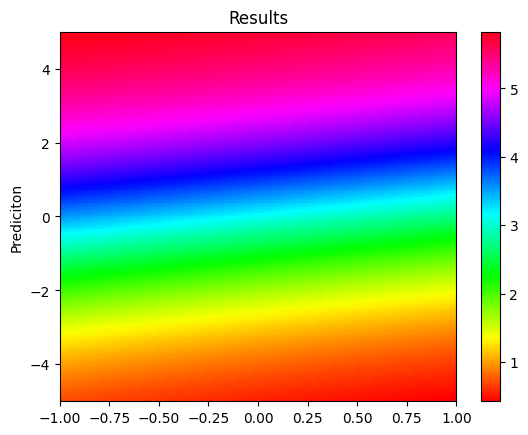

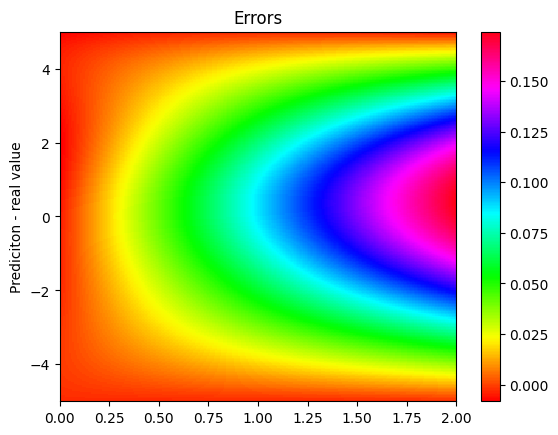

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.025008552


Compiling model...
'compile' took 1.266501 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
10000     [9.73e-07, 2.28e-05, 2.51e-05, 8.40e-06]    [9.73e-07, 2.28e-05, 2.51e-05, 8.40e-06]    [1.66e-02]    
10273     [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.40e-02]    

Best model at step 10273:
  train loss: 2.67e-07
  test loss: 2.67e-07
  test metric: [1.40e-02]

Epoch 10273: saving model to /content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model-lbfgs.ckpt-10273.ckpt ...

'train' took 88.950058 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


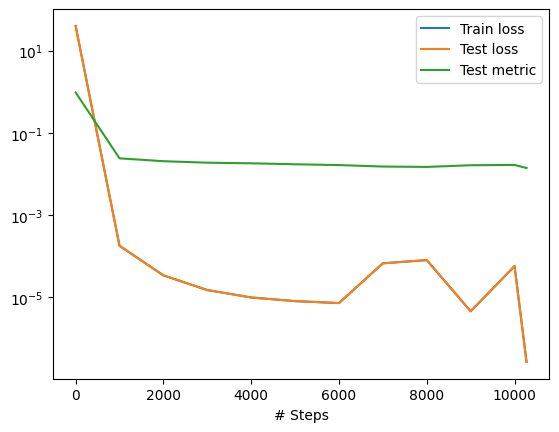

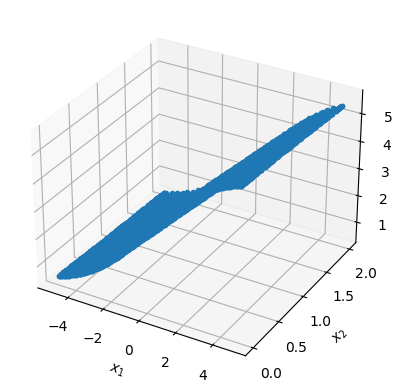

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
#!mkdir /content/drive/MyDrive/trained_models/why_not_working
#!mkdir /content/drive/MyDrive/trained_models/why_not_working/1

losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model-lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

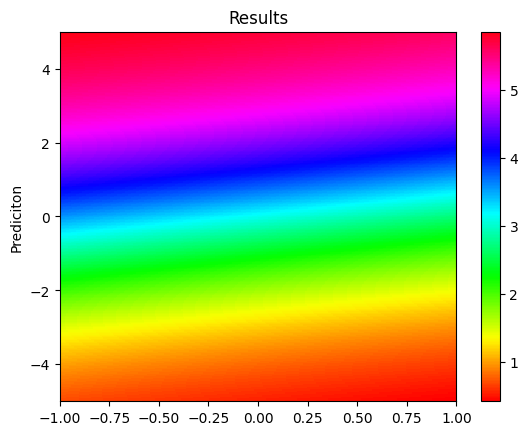

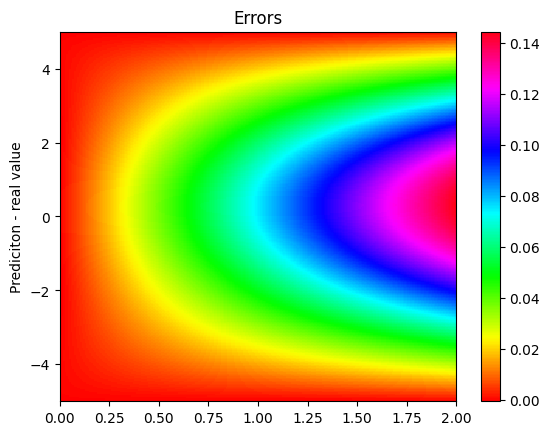

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(-1, 1, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.021915296


Compiling model...
'compile' took 1.141112 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
10273     [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.40e-02]    
10294     [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.40e-02]    

Best model at step 10273:
  train loss: 2.67e-07
  test loss: 2.67e-07
  test metric: [1.40e-02]

Epoch 10294: saving model to /content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model-lbfgs.ckpt-10294.ckpt ...

'train' took 9.171517 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


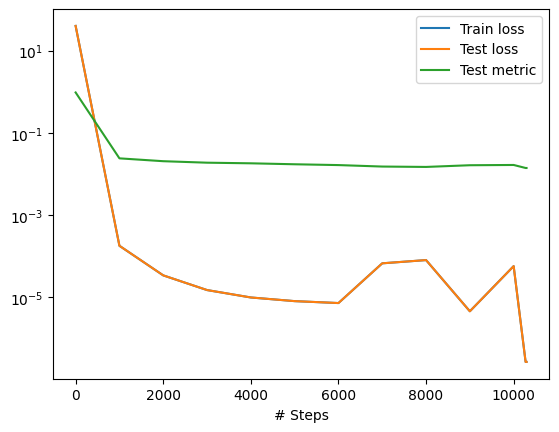

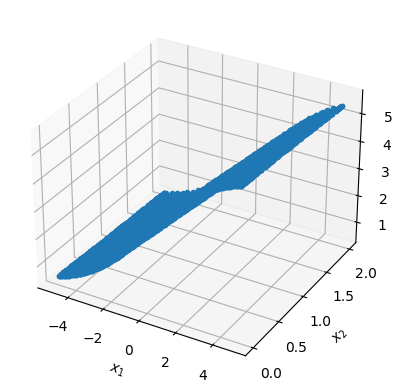

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
#!mkdir /content/drive/MyDrive/trained_models/why_not_working
#!mkdir /content/drive/MyDrive/trained_models/why_not_working/1

losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model-lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

#Benchmark (1 soliton)-LBFGS_2

In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/4

In [ ]:
mkdir /content/drive/MyDrive/trained_models/sine-gordon_benchmark/4

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

#Boundary points
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*2+29)/100#m entre (0.29,0.31)
t0 = sample*2

#X_anchors=np.concatenate((x1,m,t0), axis=1)
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-5, 5)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=256,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=None
)

layer_size = [2] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(iterations=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/4/model.ckpt")
'''
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

Compiling model...
Building feed-forward neural network...
'build' took 0.141420 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.540290 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.13e-03, 1.18e+01, 2.58e+01, 6.30e-01]    [1.13e-03, 1.18e+01, 2.58e+01, 6.30e-01]    [9.35e-01]    
1000      [1.12e-04, 9.68e-05, 3.37e-05, 6.29e-05]    [1.12e-04, 9.68e-05, 3.37e-05, 6.29e-05]    [1.58e-02]    
2000      [3.85e-05, 3.31e-05, 5.04e-06, 3.85e-06]    [3.85e-05, 3.31e-05, 5.04e-06, 3.85e-06]    [1.52e-02]    
3000      [1.22e-05, 6.46e-06, 1.42e-06, 6.79e-07]    [1.22e-05, 6.46e-06, 1.42e-06, 6.79e-07]    [1.47e-02]    
4000      [5.32e-06, 1.93e-06, 7.45e-07, 3.15e-07]    [5.32e-06, 1.93e-06, 7.45e-07, 3.15e-07]    [1.45e-02]    
5000      [4.59e-06, 2.20e-05, 7.37e-05, 1.43e-05]    [4.59e-06, 2.20e-05, 7.37e-05, 1.43e-05]    [1.48e-02]    
6000      [2.60e-06, 1.89e-04, 4.29e-04, 2.82e-07]    [2.60e-06, 1.89e-04, 4.29e-04, 2.82e-07]    [1.68e-02]    
7000      [1.47e-06, 5.92e-07, 6.44e-07, 5.14e-08]

'\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

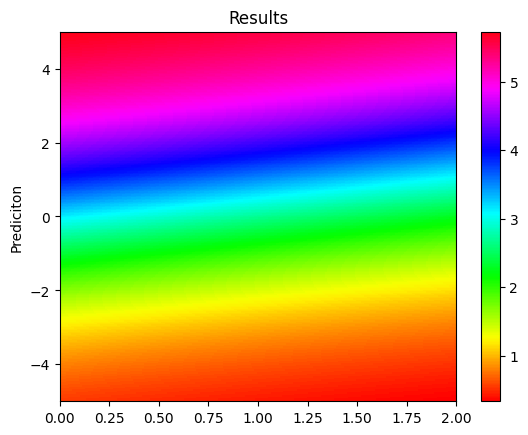

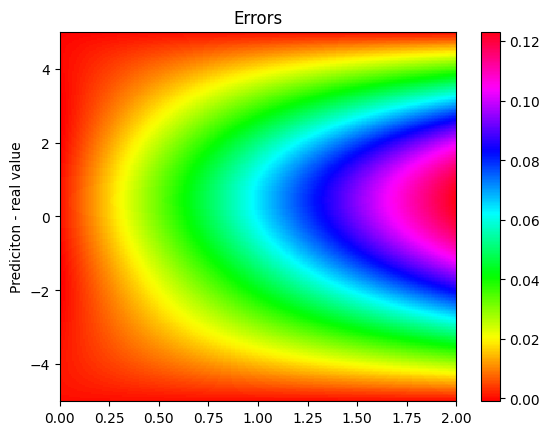

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.018929416


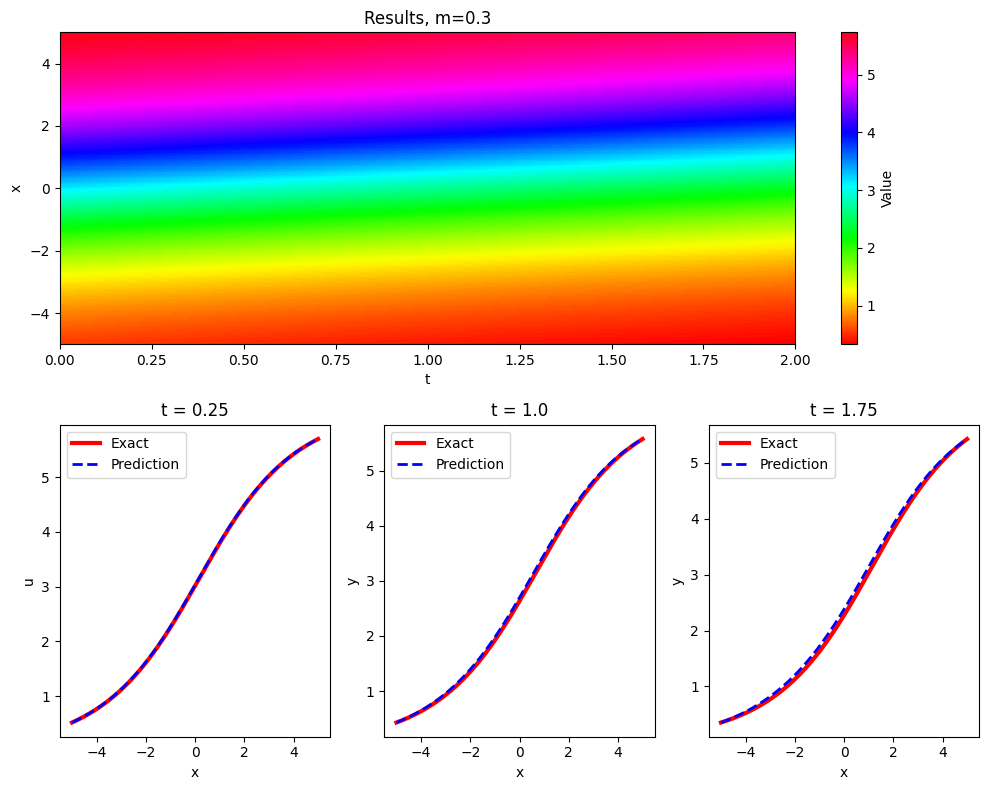

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the main function as a grid of a function of two variables:
#simply model.predict(X)

# Generate x and y values for the grid
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
m= np.ones(65536)*0.3
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

#definir função auxiliar que cria o grid com m e t fixos:
def make_X_m_t(t_value):
    X_star_2d = np.concatenate((np.vstack(x),np.vstack(np.ones(256)*t_value)),axis=1)
    return X_star_2d

# Calculate the main function values for the grid
prediction = model.predict(X_star, operator=None)
v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

# Create a figure and axis objects
fig = plt.figure(figsize=(10, 8))

# Main function subplot (upper half)
ax_main = fig.add_subplot(2, 1, 1)
#im = ax_main.imshow(prediction, extent=(0, 2*np.pi, 0, 2*np.pi), origin='lower', cmap='viridis',aspect='auto')
im=ax_main.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",#viridis,hsv
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
ax_main.set_title('Results, m=0.3')
ax_main.set_xlabel('t')
ax_main.set_ylabel('x')
#ax_main.legend()
fig.colorbar(im, ax=ax_main, label='Value')

# Subfunction subplots (lower half)
ax1 = fig.add_subplot(2, 3, 4)
x_1=make_X_m_t(0.25)
ax1.plot(x,func(x_1), 'r-', linewidth = 3, label = 'Exact')
ax1.plot(x,model.predict(x_1), 'b--', linewidth = 2, label = 'Prediction')
#ax1.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax1.set_title("t = 0.25")
ax1.set_xlabel('x')
ax1.set_ylabel('u')
ax1.legend()

ax2 = fig.add_subplot(2, 3, 5)
x_2=make_X_m_t(1.0)
ax2.plot(x,func(x_2), 'r-', linewidth = 3, label = 'Exact')
ax2.plot(x,model.predict(x_2), 'b--', linewidth = 2, label = 'Prediction')
ax2.set_title("t = 1.0")
ax2.set_xlabel('x')
ax2.set_ylabel('y')
ax2.legend()

ax3 = fig.add_subplot(2, 3, 6)
x_3=make_X_m_t(1.75)
ax3.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax3.plot(x,model.predict(x_3), 'b--', linewidth = 2, label = 'Prediction')
ax3.set_title("t = 1.75")
ax3.set_xlabel('x')
ax3.set_ylabel('y')
ax3.legend()

plt.tight_layout()
plt.show()

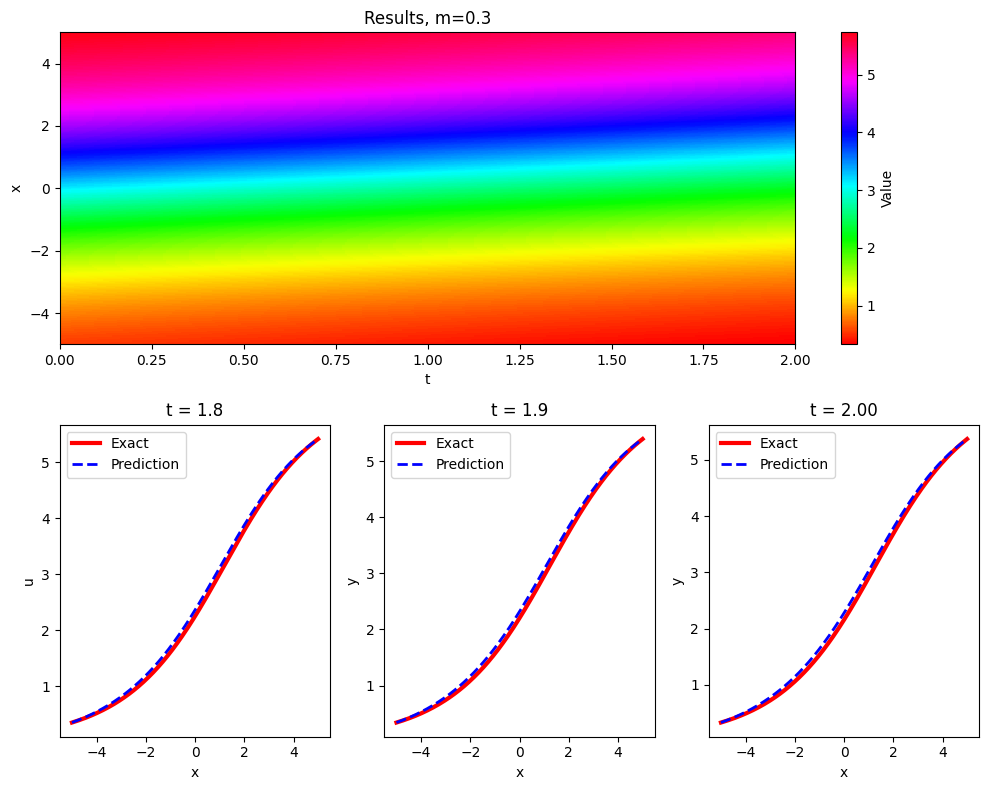

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the main function as a grid of a function of two variables:
#simply model.predict(X)

# Generate x and y values for the grid
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
m= np.ones(65536)*0.3
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

#definir função auxiliar que cria o grid com m e t fixos:
def make_X_m_t(t_value):
    X_star_2d = np.concatenate((np.vstack(x),np.vstack(np.ones(256)*t_value)),axis=1)
    return X_star_2d

# Calculate the main function values for the grid
prediction = model.predict(X_star, operator=None)
v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

# Create a figure and axis objects
fig = plt.figure(figsize=(10, 8))

# Main function subplot (upper half)
ax_main = fig.add_subplot(2, 1, 1)
#im = ax_main.imshow(prediction, extent=(0, 2*np.pi, 0, 2*np.pi), origin='lower', cmap='viridis',aspect='auto')
im=ax_main.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",#viridis,hsv
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
ax_main.set_title('Results, m=0.3')
ax_main.set_xlabel('t')
ax_main.set_ylabel('x')
#ax_main.legend()
fig.colorbar(im, ax=ax_main, label='Value')

# Subfunction subplots (lower half)
ax1 = fig.add_subplot(2, 3, 4)
x_1=make_X_m_t(1.8)
ax1.plot(x,func(x_1), 'r-', linewidth = 3, label = 'Exact')
ax1.plot(x,model.predict(x_1), 'b--', linewidth = 2, label = 'Prediction')
#ax1.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax1.set_title("t = 1.8")
ax1.set_xlabel('x')
ax1.set_ylabel('u')
ax1.legend()

ax2 = fig.add_subplot(2, 3, 5)
x_2=make_X_m_t(1.9)
ax2.plot(x,func(x_2), 'r-', linewidth = 3, label = 'Exact')
ax2.plot(x,model.predict(x_2), 'b--', linewidth = 2, label = 'Prediction')
ax2.set_title("t = 1.9")
ax2.set_xlabel('x')
ax2.set_ylabel('y')
ax2.legend()

ax3 = fig.add_subplot(2, 3, 6)
x_3=make_X_m_t(2.00)
ax3.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax3.plot(x,model.predict(x_3), 'b--', linewidth = 2, label = 'Prediction')
ax3.set_title("t = 2.00")
ax3.set_xlabel('x')
ax3.set_ylabel('y')
ax3.legend()

plt.tight_layout()
plt.show()

Compiling model...
'compile' took 0.951233 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
20000     [3.45e-07, 4.14e-07, 8.15e-08, 8.85e-08]    [3.45e-07, 4.14e-07, 8.15e-08, 8.85e-08]    [1.20e-02]    
20268     [6.94e-08, 1.34e-08, 3.87e-09, 1.35e-08]    [6.94e-08, 1.34e-08, 3.87e-09, 1.35e-08]    [9.70e-03]    

Best model at step 20268:
  train loss: 1.00e-07
  test loss: 1.00e-07
  test metric: [9.70e-03]

Epoch 20268: saving model to /content/drive/MyDrive/trained_models/sine-gordon_benchmark/4/model-lbfgs.ckpt-20268.ckpt ...

'train' took 86.119087 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


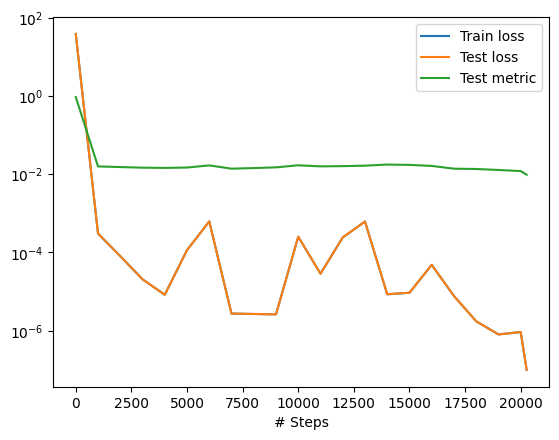

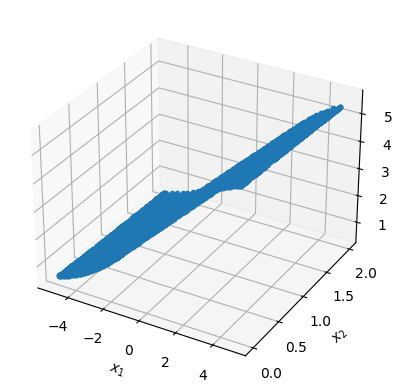

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
#!mkdir /content/drive/MyDrive/trained_models/why_not_working
#!mkdir /content/drive/MyDrive/trained_models/why_not_working/1

losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/4/model-lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

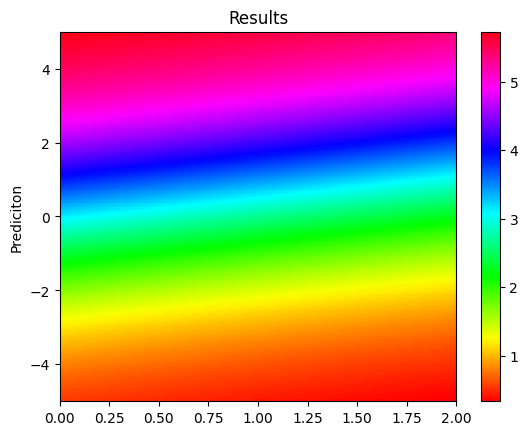

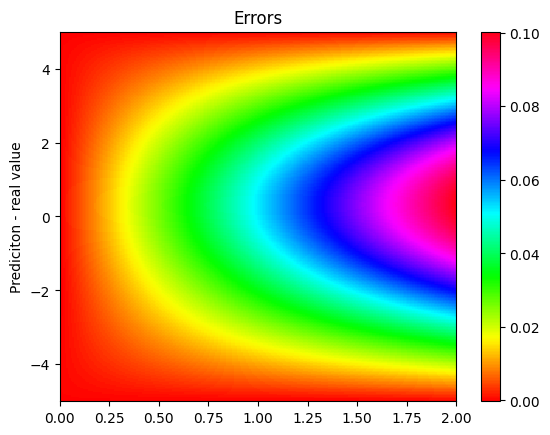

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.015277351


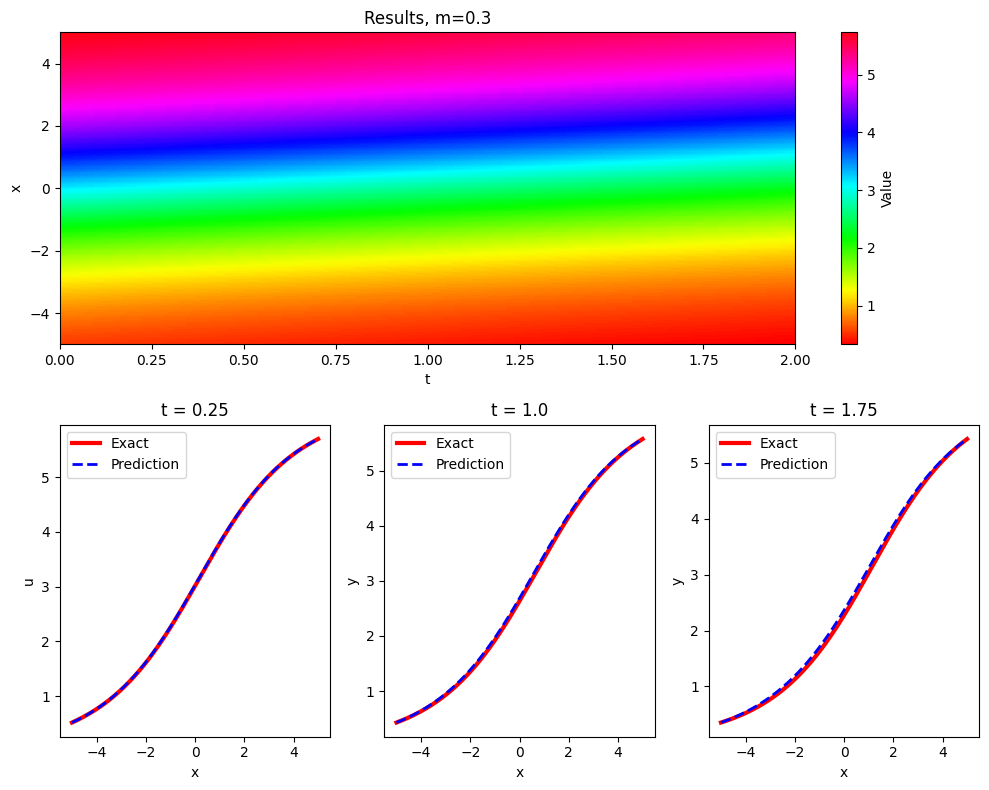

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the main function as a grid of a function of two variables:
#simply model.predict(X)

# Generate x and y values for the grid
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
m= np.ones(65536)*0.3
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

#definir função auxiliar que cria o grid com m e t fixos:
def make_X_m_t(t_value):
    X_star_2d = np.concatenate((np.vstack(x),np.vstack(np.ones(256)*t_value)),axis=1)
    return X_star_2d

# Calculate the main function values for the grid
prediction = model.predict(X_star, operator=None)
v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

# Create a figure and axis objects
fig = plt.figure(figsize=(10, 8))

# Main function subplot (upper half)
ax_main = fig.add_subplot(2, 1, 1)
#im = ax_main.imshow(prediction, extent=(0, 2*np.pi, 0, 2*np.pi), origin='lower', cmap='viridis',aspect='auto')
im=ax_main.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",#viridis,hsv
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
ax_main.set_title('Results, m=0.3')
ax_main.set_xlabel('t')
ax_main.set_ylabel('x')
#ax_main.legend()
fig.colorbar(im, ax=ax_main, label='Value')

# Subfunction subplots (lower half)
ax1 = fig.add_subplot(2, 3, 4)
x_1=make_X_m_t(0.25)
ax1.plot(x,func(x_1), 'r-', linewidth = 3, label = 'Exact')
ax1.plot(x,model.predict(x_1), 'b--', linewidth = 2, label = 'Prediction')
#ax1.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax1.set_title("t = 0.25")
ax1.set_xlabel('x')
ax1.set_ylabel('u')
ax1.legend()

ax2 = fig.add_subplot(2, 3, 5)
x_2=make_X_m_t(1.0)
ax2.plot(x,func(x_2), 'r-', linewidth = 3, label = 'Exact')
ax2.plot(x,model.predict(x_2), 'b--', linewidth = 2, label = 'Prediction')
ax2.set_title("t = 1.0")
ax2.set_xlabel('x')
ax2.set_ylabel('y')
ax2.legend()

ax3 = fig.add_subplot(2, 3, 6)
x_3=make_X_m_t(1.75)
ax3.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax3.plot(x,model.predict(x_3), 'b--', linewidth = 2, label = 'Prediction')
ax3.set_title("t = 1.75")
ax3.set_xlabel('x')
ax3.set_ylabel('y')
ax3.legend()

plt.tight_layout()
plt.show()

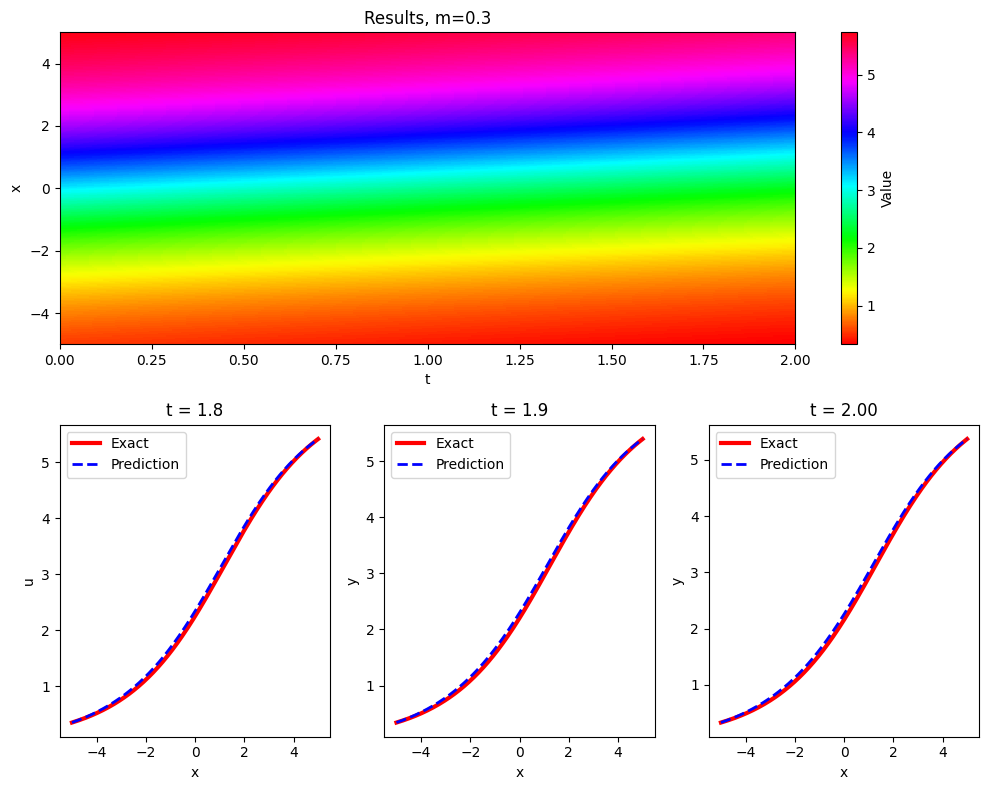

In [ ]:
import numpy as np
import matplotlib.pyplot as plt

# Define the main function as a grid of a function of two variables:
#simply model.predict(X)

# Generate x and y values for the grid
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
m= np.ones(65536)*0.3
#m=m.reshape(-1,1)
m=np.vstack(m)

X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
x1,t1=np.split(X_star, 2, axis=1)
X_star_m= np.concatenate((x1,m,t1), axis=1)

#definir função auxiliar que cria o grid com m e t fixos:
def make_X_m_t(t_value):
    X_star_2d = np.concatenate((np.vstack(x),np.vstack(np.ones(256)*t_value)),axis=1)
    return X_star_2d

# Calculate the main function values for the grid
prediction = model.predict(X_star, operator=None)
v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

# Create a figure and axis objects
fig = plt.figure(figsize=(10, 8))

# Main function subplot (upper half)
ax_main = fig.add_subplot(2, 1, 1)
#im = ax_main.imshow(prediction, extent=(0, 2*np.pi, 0, 2*np.pi), origin='lower', cmap='viridis',aspect='auto')
im=ax_main.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",#viridis,hsv
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
ax_main.set_title('Results, m=0.3')
ax_main.set_xlabel('t')
ax_main.set_ylabel('x')
#ax_main.legend()
fig.colorbar(im, ax=ax_main, label='Value')

# Subfunction subplots (lower half)
ax1 = fig.add_subplot(2, 3, 4)
x_1=make_X_m_t(1.8)
ax1.plot(x,func(x_1), 'r-', linewidth = 3, label = 'Exact')
ax1.plot(x,model.predict(x_1), 'b--', linewidth = 2, label = 'Prediction')
#ax1.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax1.set_title("t = 1.8")
ax1.set_xlabel('x')
ax1.set_ylabel('u')
ax1.legend()

ax2 = fig.add_subplot(2, 3, 5)
x_2=make_X_m_t(1.9)
ax2.plot(x,func(x_2), 'r-', linewidth = 3, label = 'Exact')
ax2.plot(x,model.predict(x_2), 'b--', linewidth = 2, label = 'Prediction')
ax2.set_title("t = 1.9")
ax2.set_xlabel('x')
ax2.set_ylabel('y')
ax2.legend()

ax3 = fig.add_subplot(2, 3, 6)
x_3=make_X_m_t(2.00)
ax3.plot(x,func(x_3), 'r-', linewidth = 3, label = 'Exact')
ax3.plot(x,model.predict(x_3), 'b--', linewidth = 2, label = 'Prediction')
ax3.set_title("t = 2.00")
ax3.set_xlabel('x')
ax3.set_ylabel('y')
ax3.legend()

plt.tight_layout()
plt.show()

Compiling model...
'compile' took 1.141112 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
10273     [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.40e-02]    
10294     [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.55e-07, 7.24e-08, 7.74e-09, 3.13e-08]    [1.40e-02]    

Best model at step 10273:
  train loss: 2.67e-07
  test loss: 2.67e-07
  test metric: [1.40e-02]

Epoch 10294: saving model to /content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model-lbfgs.ckpt-10294.ckpt ...

'train' took 9.171517 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


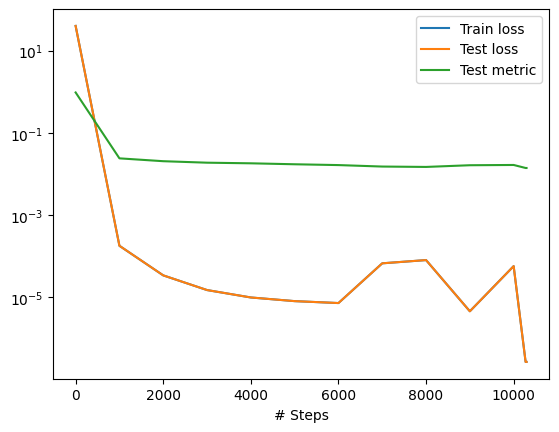

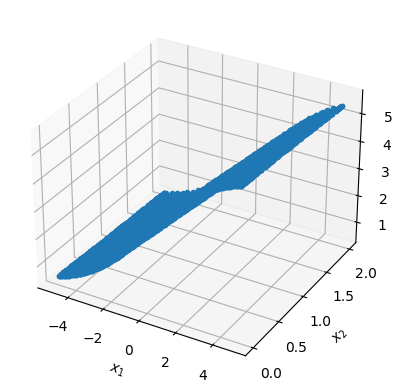

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
#!mkdir /content/drive/MyDrive/trained_models/why_not_working
#!mkdir /content/drive/MyDrive/trained_models/why_not_working/1

losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model-lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

# Benchmark 1 soliton 3 bc

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

#Boundary points
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*2+29)/100#m entre (0.29,0.31)
t0 = sample*2

#X_anchors=np.concatenate((x1,m,t0), axis=1)
X_anchors=np.concatenate((x1,t0), axis=1)


geom = dde.geometry.Interval(-5, 5)
timedomain = dde.geometry.TimeDomain(0, 2)
geomtime = dde.geometry.GeometryXTime(geom, timedomain)


# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin



def pde(x, y):
    alpha = -1
    m=0.3

    dy_tt = dde.grad.hessian(y, x, i=1, j=1)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, t = x[:, 0:1], x[:, 1:2]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, t = x[:, 0:1], x[:, 1:2]

    m, v = 0.3, 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, t = x[:, 0:1], x[:, 1:2]
    m, v = 0.3, 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[1],0)

def boundary_tf(x,_):
    return np.isclose(x[1],2)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=256,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=None
)

layer_size = [2] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)

model.train(iterations=20000)#, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model.ckpt")
'''
model.compile("L-BFGS", metrics=["l2 relative error"])
losshistory, train_state = model.train()
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

x = np.linspace(-1, 1, 256)
t = np.linspace(0, 10, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="viridis",
    extent=[0, 10, -1, 1],
    origin="lower",
    aspect="auto",
)
plt.show()
'''

Compiling model...
Building feed-forward neural network...
'build' took 0.130002 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.659703 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [4.11e-04, 1.30e+01, 3.45e+01, 2.75e-01]    [4.11e-04, 1.30e+01, 3.45e+01, 2.75e-01]    [1.07e+00]    
1000      [1.45e-04, 1.68e-04, 4.21e-05, 2.07e-05]    [1.45e-04, 1.68e-04, 4.21e-05, 2.07e-05]    [2.21e-02]    
2000      [5.19e-05, 5.43e-05, 8.38e-06, 5.84e-06]    [5.19e-05, 5.43e-05, 8.38e-06, 5.84e-06]    [2.26e-02]    
3000      [2.98e-05, 3.61e-05, 2.48e-05, 1.21e-04]    [2.98e-05, 3.61e-05, 2.48e-05, 1.21e-04]    [1.97e-02]    
4000      [7.11e-06, 2.91e-06, 1.22e-06, 2.81e-07]    [7.11e-06, 2.91e-06, 1.22e-06, 2.81e-07]    [1.95e-02]    
5000      [7.04e-06, 4.67e-05, 1.79e-04, 3.13e-05]    [7.04e-06, 4.67e-05, 1.79e-04, 3.13e-05]    [1.90e-02]    
6000      [2.38e-06, 4.46e-07, 1.03e-06, 3.67e-08]    [2.38e-06, 4.46e-07, 1.03e-06, 3.67e-08]    [1.68e-02]    
7000      [1.61e-06, 4.00e-07, 1.15e-06, 3.61e-08]

'\nmodel.compile("L-BFGS", metrics=["l2 relative error"])\nlosshistory, train_state = model.train()\ndde.saveplot(losshistory, train_state, issave=True, isplot=True)\n\nx = np.linspace(-1, 1, 256)\nt = np.linspace(0, 10, 256)\nX, T = np.meshgrid(x, t)\n\nX_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))\nprediction = model.predict(X_star, operator=None)\n\nv = griddata(X_star, prediction[:, 0], (X, T), method="cubic")\n\nfig, ax = plt.subplots()\nax.set_title("Results")\nax.set_ylabel("Prediciton")\nax.imshow(\n    v.T,\n    interpolation="nearest",\n    cmap="viridis",\n    extent=[0, 10, -1, 1],\n    origin="lower",\n    aspect="auto",\n)\nplt.show()\n'

In [ ]:
l2 = dde.metrics.l2_relative_error(func(geomtime.uniform_points(65536, boundary=True)), model.predict(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.023149345


In [ ]:
random_points=geomtime.random_points(65536)
l2_rand = dde.metrics.l2_relative_error(func(random_points), model.predict(random_points))
print("Erro L2 encontrado: ",l2_rand)

Erro L2 encontrado:  0.023080926


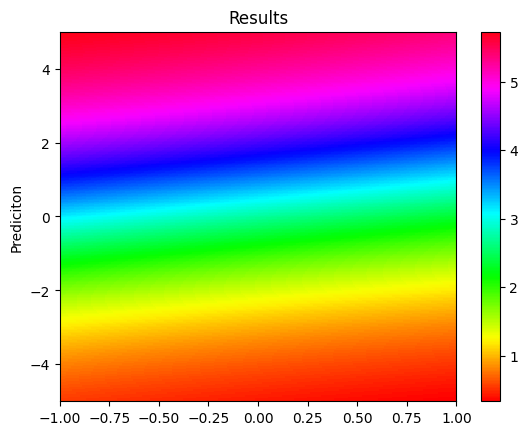

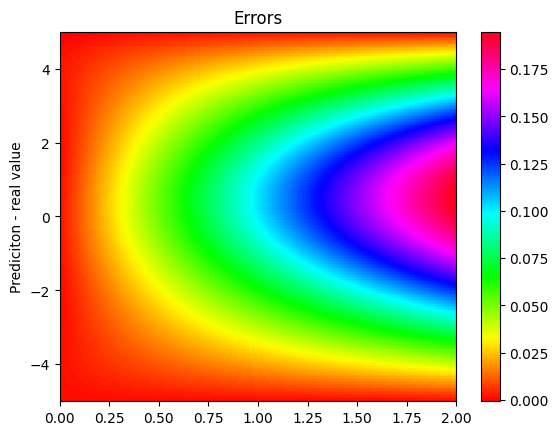

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

Compiling model...
'compile' took 0.699860 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
20000     [2.35e-07, 1.64e-06, 1.07e-06, 8.60e-07]    [2.35e-07, 1.64e-06, 1.07e-06, 8.60e-07]    [1.90e-02]    
20185     [1.15e-07, 9.34e-08, 1.74e-08, 5.94e-09]    [1.15e-07, 9.34e-08, 1.74e-08, 5.94e-09]    [1.54e-02]    

Best model at step 20185:
  train loss: 2.31e-07
  test loss: 2.31e-07
  test metric: [1.54e-02]

Epoch 20185: saving model to /content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model-lbfgs.ckpt-20185.ckpt ...

'train' took 42.158644 s

Saving loss history to /content/loss.dat ...
Saving training data to /content/train.dat ...
Saving test data to /content/test.dat ...


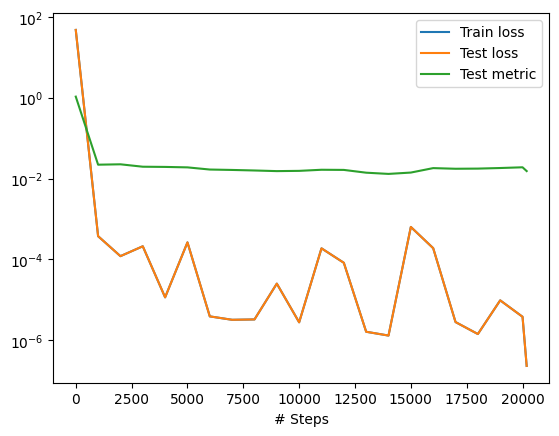

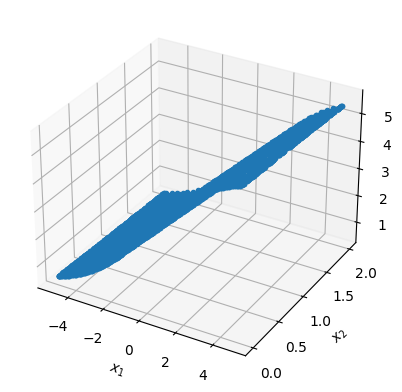

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
#!mkdir /content/drive/MyDrive/trained_models/why_not_working
#!mkdir /content/drive/MyDrive/trained_models/why_not_working/1

losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/3/model-lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

In [ ]:
l2 = dde.metrics.l2_relative_error(func(geomtime.uniform_points(65536, boundary=True)), model.predict(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)
random_points=geomtime.random_points(65536)
l2_rand = dde.metrics.l2_relative_error(func(random_points), model.predict(random_points))
print("Erro L2 encontrado: ",l2_rand)

Erro L2 encontrado:  0.018660897
Erro L2 encontrado:  0.018601863


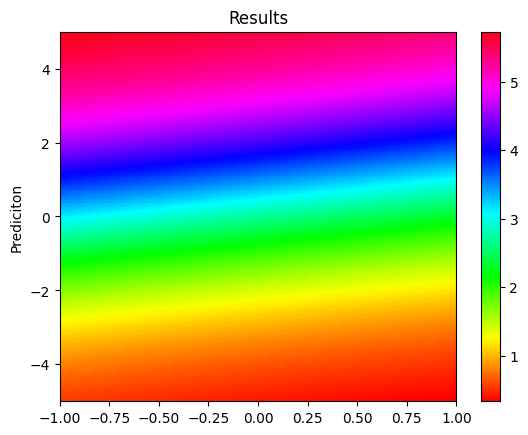

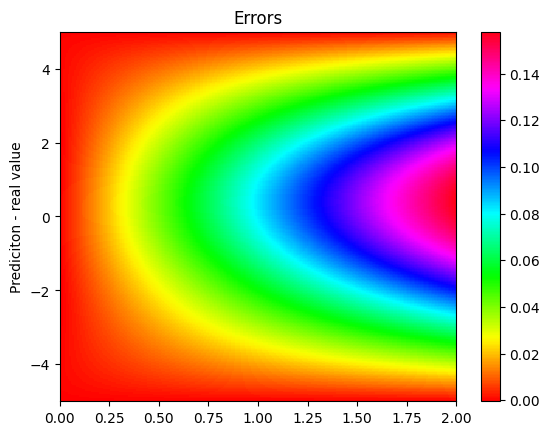

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[-1, 1, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

#1 soliton variável

In [ ]:
for x in X_anchors:
    if np.isclose(x[0],5.0):
        print(x)

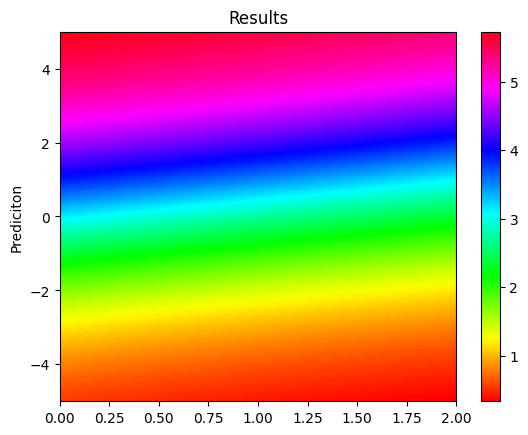

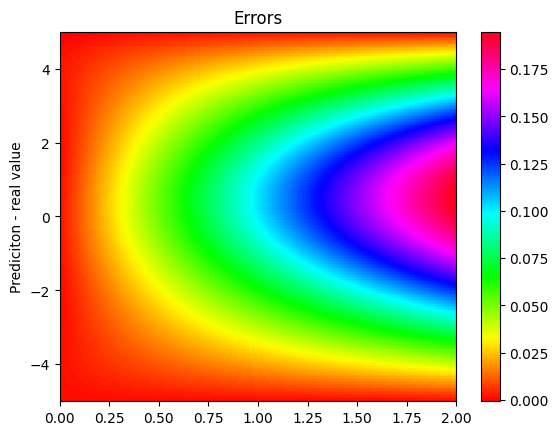

In [ ]:
x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)

v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Results")
ax.set_ylabel("Prediciton")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

x = np.linspace(-5, 5, 256)
t = np.linspace(0, 2, 256)
X, T = np.meshgrid(x, t)

X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
prediction = model.predict(X_star, operator=None)
real=func(X_star)
prediction=prediction-real
#prediction=np.sqrt(prediction*prediction)


v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

fig, ax = plt.subplots()
ax.set_title("Errors")
ax.set_ylabel("Prediciton - real value")
ax.imshow(
    v.T,
    interpolation="nearest",
    cmap="hsv",
    extent=[0, 2, -5, 5],
    origin="lower",
    aspect="auto",
)
fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
plt.show()

##m in (0.29,0.31)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

#Boundary points
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*2+29)/100#m entre (0.29,0.31)
t0 = sample*2

X_anchors=np.concatenate((x1,m,t0), axis=1)



timedomain = dde.geometry.TimeDomain(0, 2)
geom = dde.geometry.Rectangle([-5, 0.29], [5, 0.31])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    v=0.65

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = tf.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/1/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.259954 s

'compile' took 2.642397 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.68e-04, 1.29e+01, 3.13e+01, 1.66e-01]    [3.68e-04, 1.29e+01, 3.13e+01, 1.66e-01]    [1.01e+00]    
1000      [1.10e-04, 7.72e-04, 1.47e-05, 1.21e-04]    [1.10e-04, 7.72e-04, 1.47e-05, 1.21e-04]    [1.23e-02]    
2000      [4.81e-05, 6.26e-04, 9.44e-06, 5.63e-05]    [4.81e-05, 6.26e-04, 9.44e-06, 5.63e-05]    [1.22e-02]    
3000      [3.21e-05, 5.90e-04, 1.24e-05, 3.91e-05]    [3.21e-05, 5.90e-04, 1.24e-05, 3.91e-05]    [1.52e-02]    
4000      [2.55e-05, 5.63e-04, 1.02e-05, 3.52e-05]    [2.55e-05, 5.63e-04, 1.02e-05, 3.52e-05]    [1.85e-02]    
5000      [2.08e-05, 5.50e-04, 9.71e-06, 3.05e-05]    [2.08e-05, 5.50e-04, 9.71e-06, 3.05e-05]    [2.21e-02]    
6000      [1.63e-05, 5.21e-04, 9.02e-06, 2.63e-05]    [1.63e-05, 5.21e-04, 9.02

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.0265593



 m =  0.29 

 ####################################################


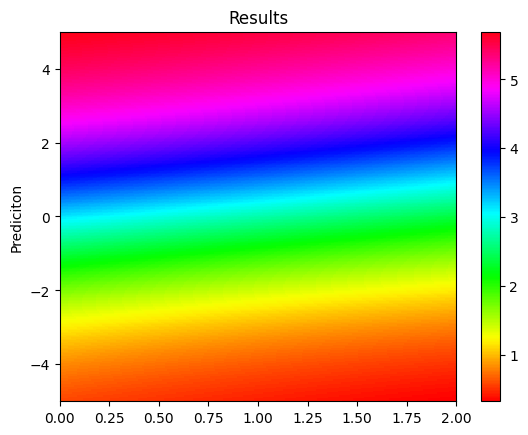

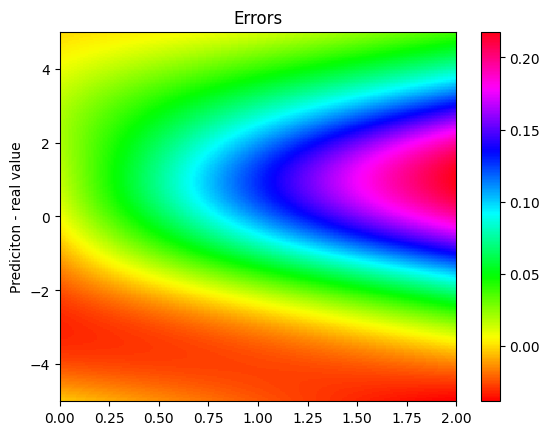


 m =  0.295 

 ####################################################


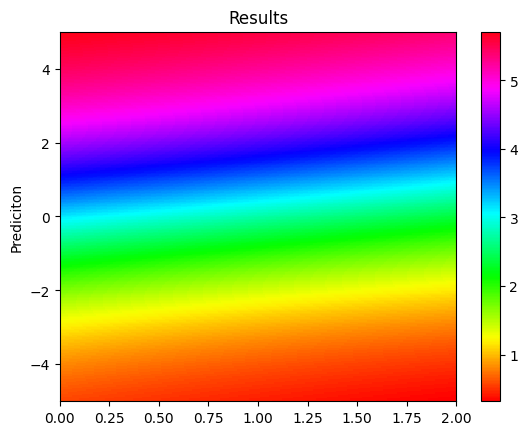

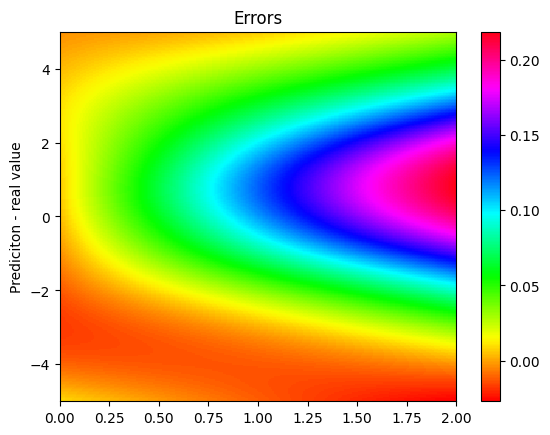


 m =  0.3 

 ####################################################


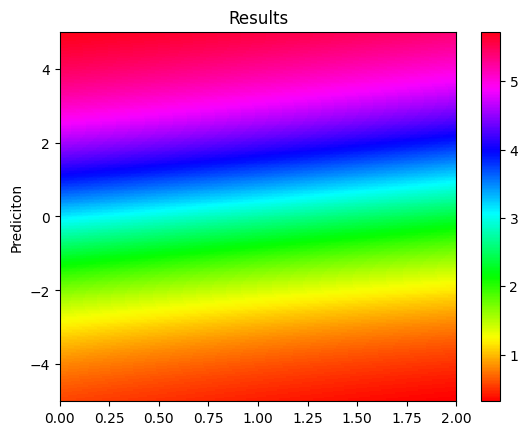

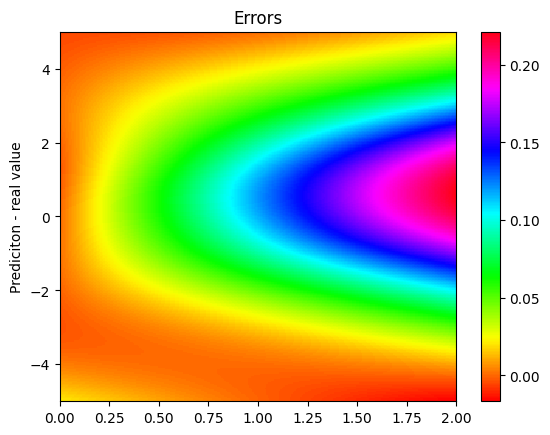


 m =  0.305 

 ####################################################


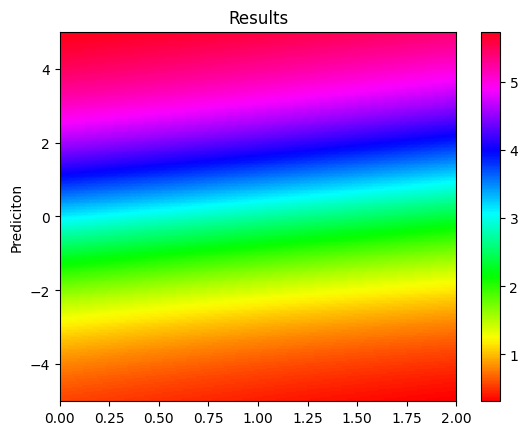

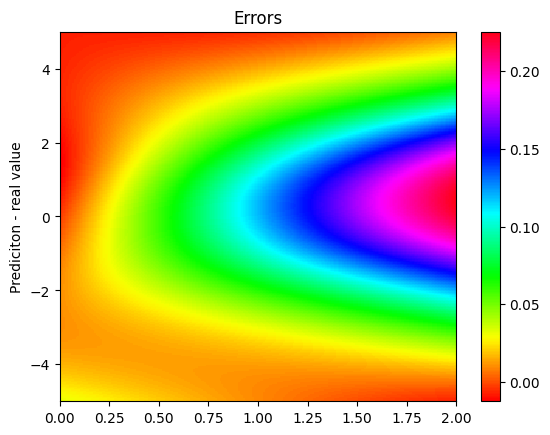


 m =  0.31 

 ####################################################


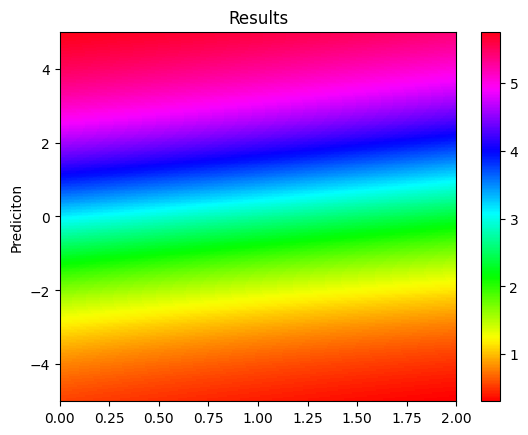

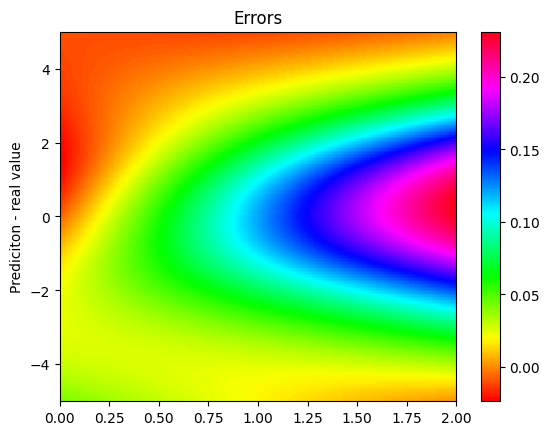

In [ ]:
for i in [0.29,0.295,0.3,0.305,0.31]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

##m in (0.28,0.32)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

#Boundary points
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*4+28)/100#m entre (0.28,0.32)
t0 = sample*2

X_anchors=np.concatenate((x1,m,t0), axis=1)



timedomain = dde.geometry.TimeDomain(0, 2)
geom = dde.geometry.Rectangle([-5, 0.28], [5, 0.32])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    v=0.65

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = tf.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/1/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.140986 s

'compile' took 2.201501 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.07e-04, 1.36e+01, 3.31e+01, 1.84e-01]    [1.07e-04, 1.36e+01, 3.31e+01, 1.84e-01]    [1.03e+00]    
1000      [9.08e-05, 2.39e-03, 3.44e-05, 2.86e-04]    [9.08e-05, 2.39e-03, 3.44e-05, 2.86e-04]    [2.08e-02]    
2000      [9.51e-05, 1.86e-03, 8.79e-04, 4.65e-04]    [9.51e-05, 1.86e-03, 8.79e-04, 4.65e-04]    [2.59e-02]    
3000      [6.25e-05, 1.43e-03, 1.60e-05, 8.49e-05]    [6.25e-05, 1.43e-03, 1.60e-05, 8.49e-05]    [2.63e-02]    
4000      [5.80e-05, 1.51e-03, 4.95e-05, 5.93e-05]    [5.80e-05, 1.51e-03, 4.95e-05, 5.93e-05]    [2.27e-02]    
5000      [5.27e-05, 1.13e-03, 1.77e-05, 1.13e-04]    [5.27e-05, 1.13e-03, 1.77e-05, 1.13e-04]    [1.57e-02]    
6000      [4.45e-05, 1.14e-03, 2.04e-05, 4.20e-05]    [4.45e-05, 1.14e-03, 2.04

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.02279709



 m =  0.28 

 ####################################################


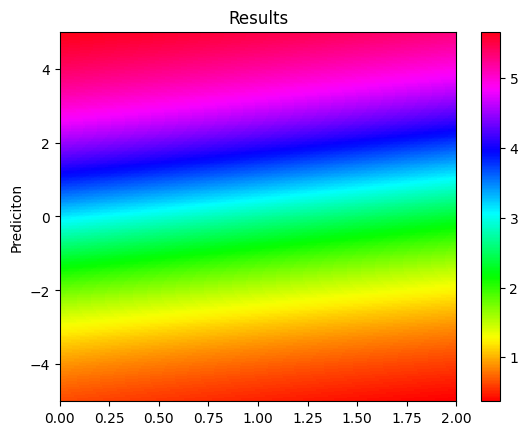

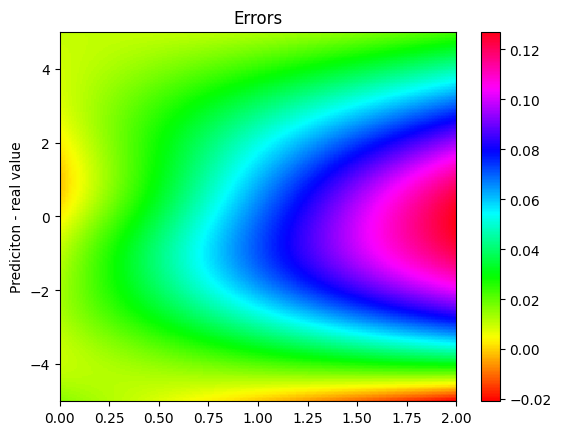


 m =  0.29 

 ####################################################


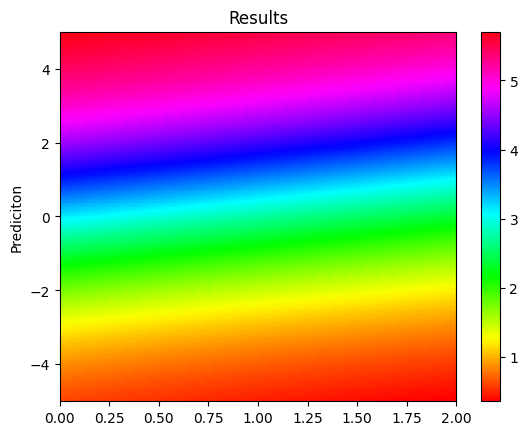

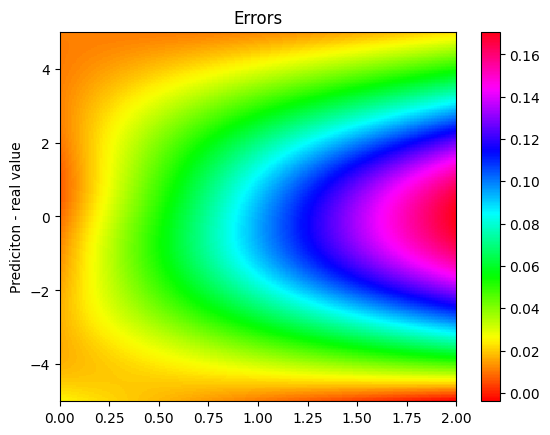


 m =  0.3 

 ####################################################


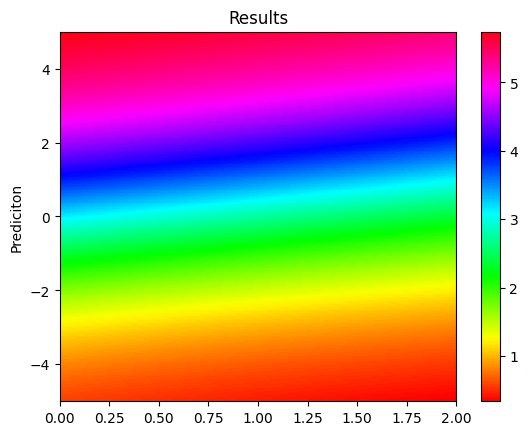

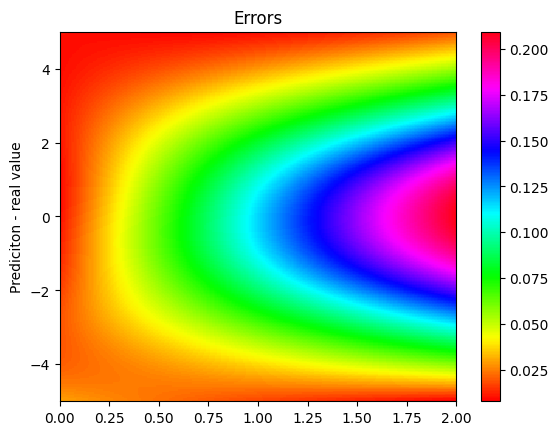


 m =  0.31 

 ####################################################


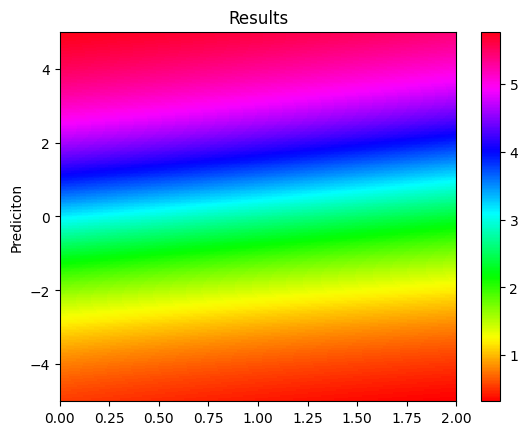

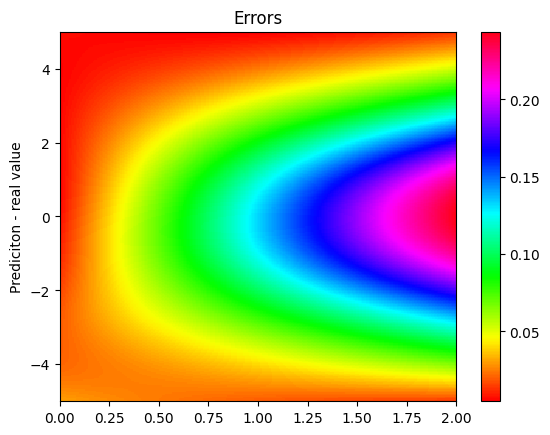


 m =  0.32 

 ####################################################


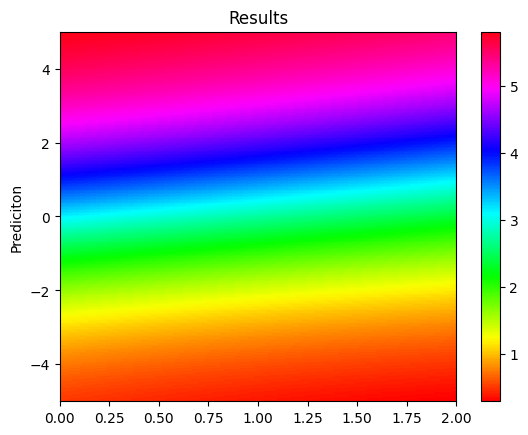

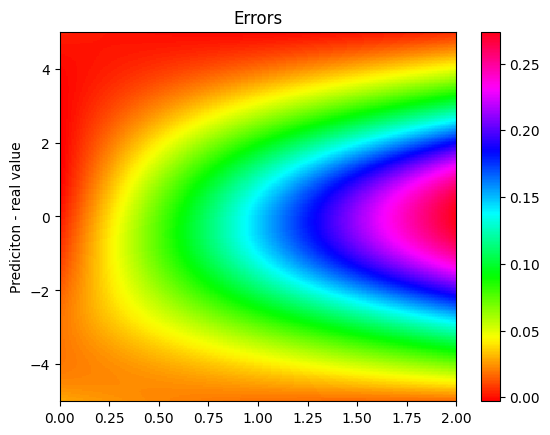

In [ ]:
for i in [0.28,0.29,0.3,0.31,0.32]:
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

##m in (0.27,0.33)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

#em centésimos
upper=33
botton=27

#Boundary points
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
t0 = sample*2

X_anchors=np.concatenate((x1,m,t0), axis=1)



timedomain = dde.geometry.TimeDomain(0, 2)
geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    v=0.65

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = tf.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/1/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.168855 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 3.218614 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.48e-03, 1.44e+01, 3.79e+01, 7.20e-03]    [1.48e-03, 1.44e+01, 3.79e+01, 7.20e-03]    [1.08e+00]    
1000      [1.17e-04, 4.78e-03, 3.92e-05, 4.53e-04]    [1.17e-04, 4.78e-03, 3.92e-05, 4.53e-04]    [3.96e-02]    
2000      [7.87e-05, 3.47e-03, 3.26e-05, 1.55e-04]    [7.87e-05, 3.47e-03, 3.26e-05, 1.55e-04]    [4.72e-02]    
3000      [9.00e-05, 2.31e-03, 2.00e-05, 7.17e-05]    [9.00e-05, 2.31e-03, 2.00e-05, 7.17e-05]    [4.05e-02]    
4000      [1.11e-04, 2.66e-03, 8.62e-05, 2.46e-04]    [1.11e-04, 2.66e-03, 8.62e-05, 2.46e-04]    [3.26e-02]    
5000      [5.41e-05, 1.37e-03, 3.93e-05, 3.06e-05]    [5.41e-05, 1.37e-03, 3.93e-05, 3.06e-05]    [2.62e-02]    
6000      [1.39e-04, 1.56e-03, 3.41e-04, 1.33e-03]    [1.39e-04, 1.56e-03, 3.41e-04, 1.33e-03]    [2.73e-02]    
7000      [4.68e-05, 3.02e-04, 1.45e-05, 8.61e-06]

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.021874469



 m =  0.27 

 ####################################################


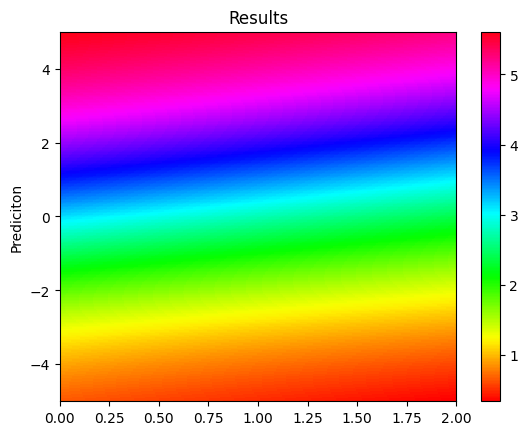

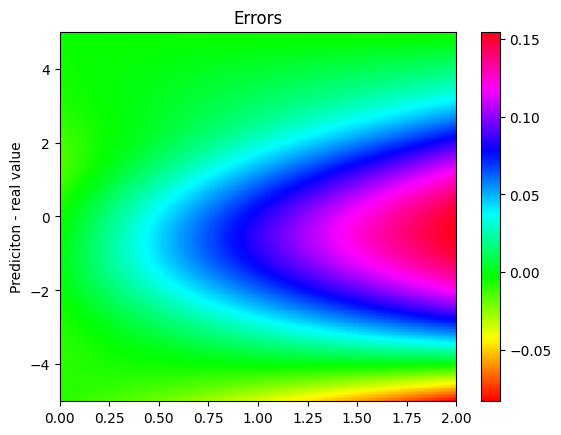


 m =  0.28500000000000003 

 ####################################################


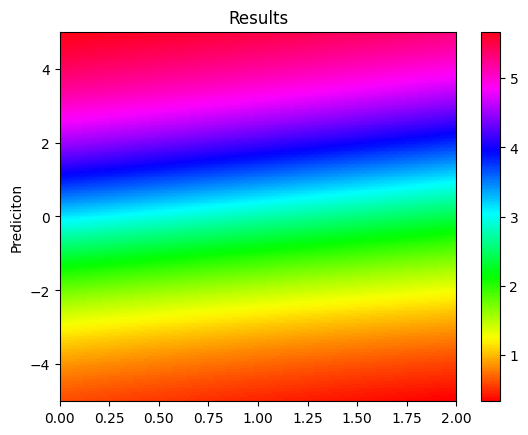

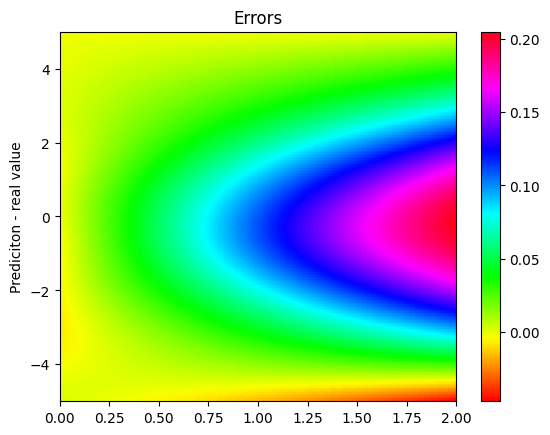


 m =  0.30000000000000004 

 ####################################################


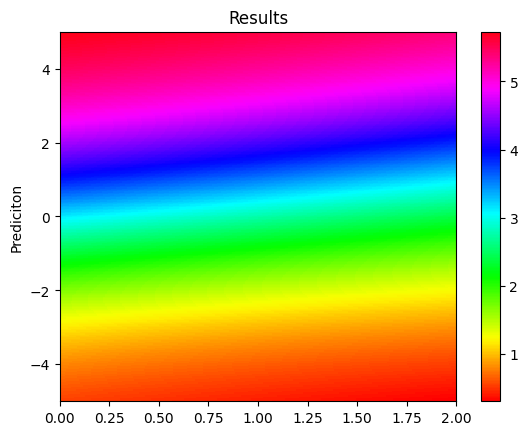

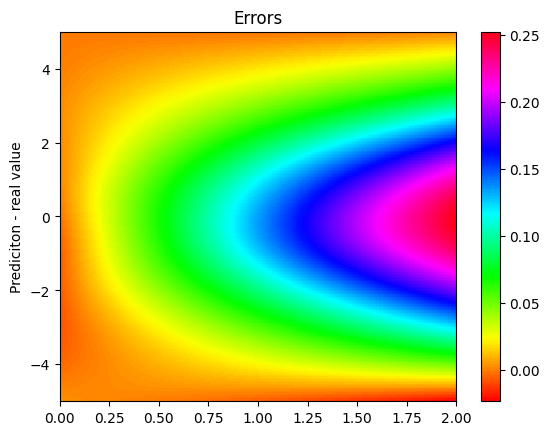


 m =  0.315 

 ####################################################


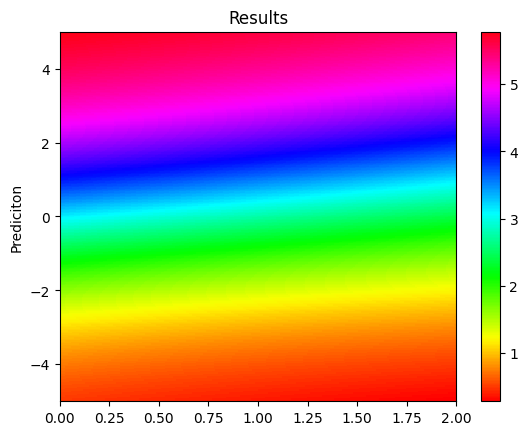

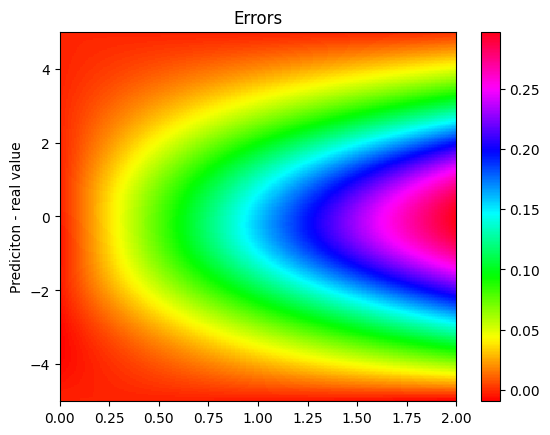


 m =  0.33 

 ####################################################


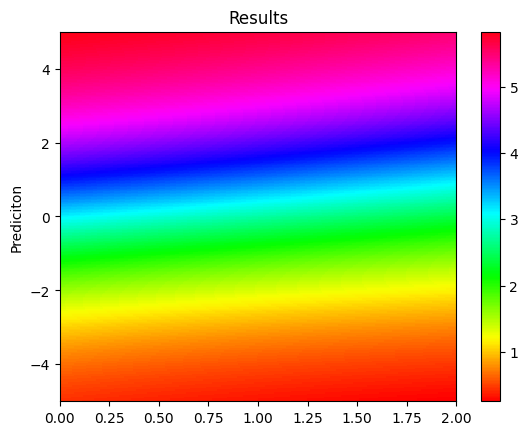

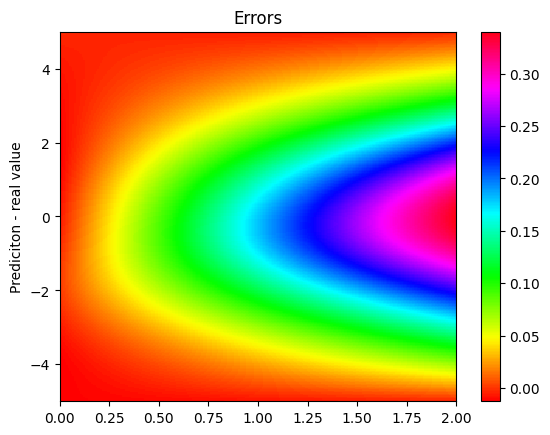

In [ ]:
for i in np.linspace(botton/100,upper/100, 5):
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

In [ ]:
i=123
print("string %s",i)
!mkdir /content/str(i)


string %s 123
/bin/bash: -c: line 1: syntax error near unexpected token `('
/bin/bash: -c: line 1: `mkdir /content/str(i)'


##m in (0.26,0.34)

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

#em centésimos
upper=34
botton=26

#Boundary points
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
t0 = sample*2

X_anchors=np.concatenate((x1,m,t0), axis=1)



timedomain = dde.geometry.TimeDomain(0, 2)
geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    v=0.65

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = tf.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile(
    "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
)
losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/1/model.ckpt")


Compiling model...
Building feed-forward neural network...
'build' took 0.138917 s

'compile' took 3.407254 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [7.47e-05, 1.29e+01, 3.00e+01, 2.42e-01]    [7.47e-05, 1.29e+01, 3.00e+01, 2.42e-01]    [9.81e-01]    
1000      [2.70e-04, 7.23e-03, 3.28e-04, 1.69e-03]    [2.70e-04, 7.23e-03, 3.28e-04, 1.69e-03]    [4.72e-02]    
2000      [1.70e-04, 3.40e-03, 4.05e-05, 1.61e-04]    [1.70e-04, 3.40e-03, 4.05e-05, 1.61e-04]    [3.21e-02]    
3000      [1.22e-04, 2.32e-03, 2.72e-05, 9.97e-05]    [1.22e-04, 2.32e-03, 2.72e-05, 9.97e-05]    [2.78e-02]    
4000      [8.67e-05, 6.30e-04, 2.09e-05, 3.45e-05]    [8.67e-05, 6.30e-04, 2.09e-05, 3.45e-05]    [1.91e-02]    
5000      [4.11e-04, 4.81e-03, 1.90e-03, 3.09e-03]    [4.11e-04, 4.81e-03, 1.90e-03, 3.09e-03]    [3.48e-02]    
6000      [7.05e-05, 2.80e-04, 5.54e-04, 9.61e-05]    [7.05e-05, 2.80e-04, 5.54

In [ ]:
l2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("Erro L2 encontrado: ",l2)

Erro L2 encontrado:  0.021874469



 m =  0.27 

 ####################################################


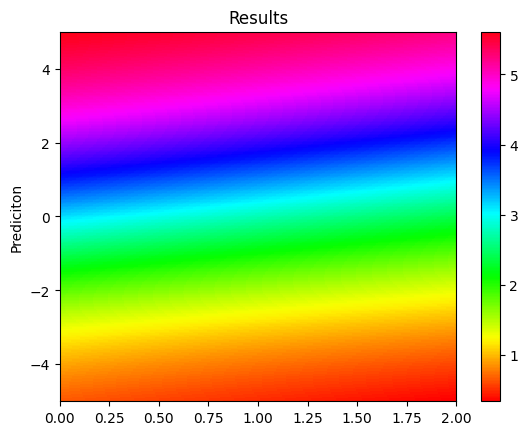

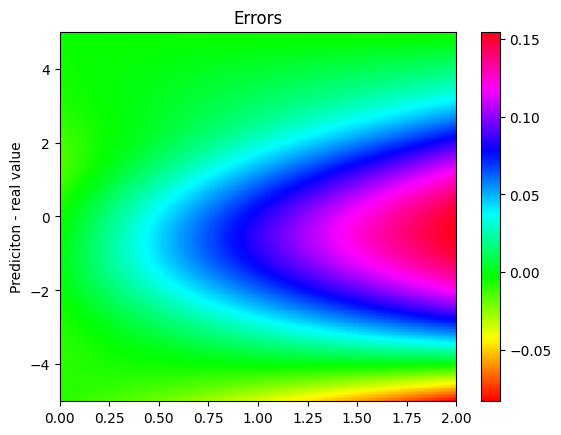


 m =  0.28500000000000003 

 ####################################################


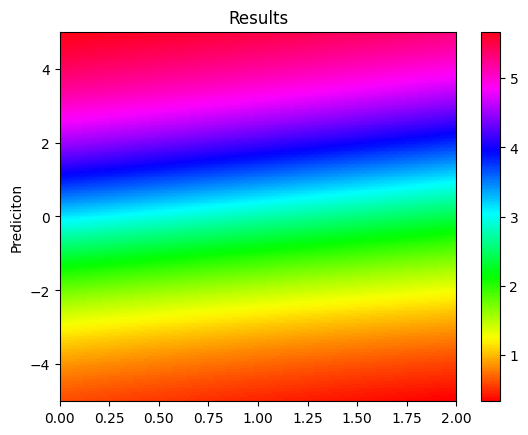

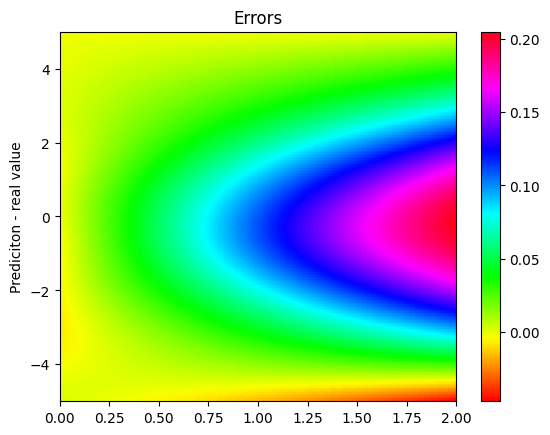


 m =  0.30000000000000004 

 ####################################################


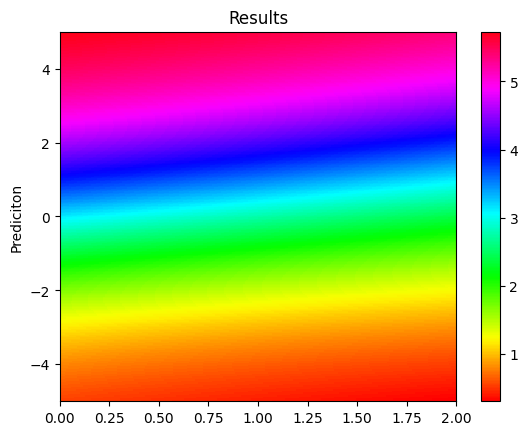

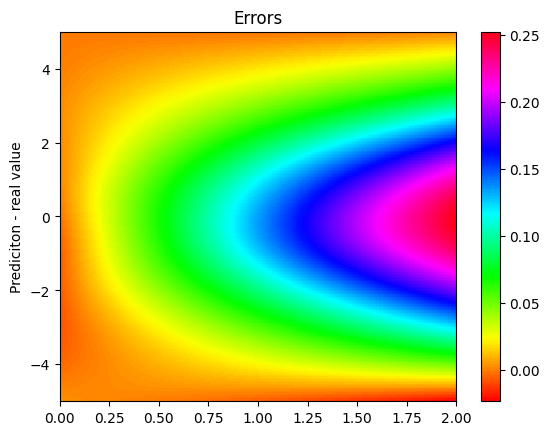


 m =  0.315 

 ####################################################


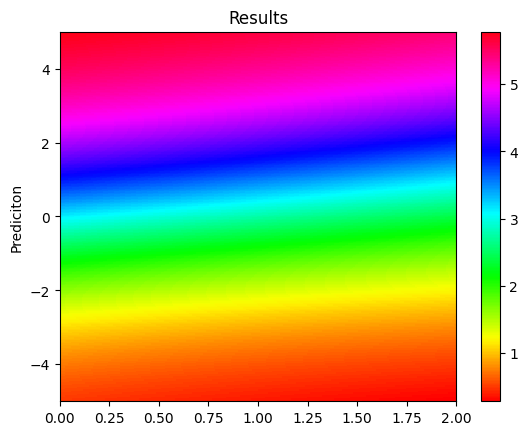

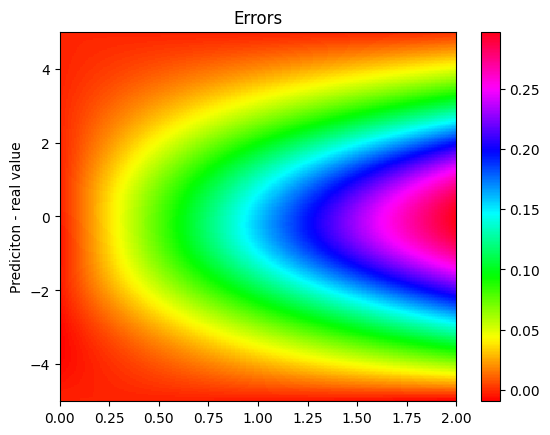


 m =  0.33 

 ####################################################


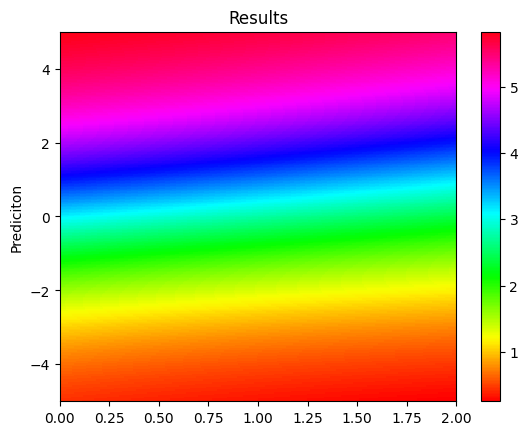

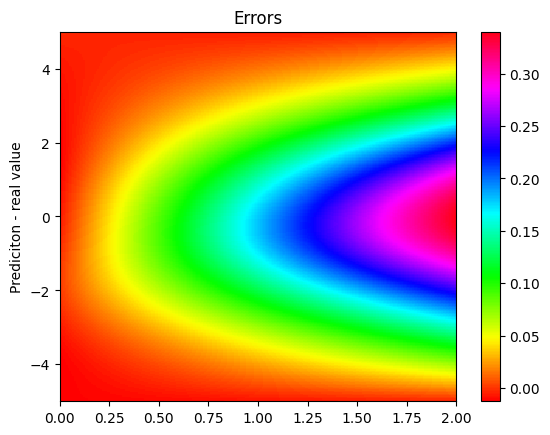

In [ ]:
for i in np.linspace(botton/100,upper/100, 5):
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

#automatizando:

In [ ]:
L2_list=np.array([])
!mkdir /content/data

In [ ]:
cd /content/data/models/

/content/data/models


10/  12/  3/  0/  14/  11/  4/  7/  13/  8/  19/  20/  16/  1/  15/  2/  9/  17/  6/  18/  5/


In [ ]:
mkdir {21..100}

In [ ]:
L2_list=np.append(L2_list,1)

In [ ]:
loaded = np.load("/content/data/L2_errors_5.npy")

In [ ]:
loaded

array([1., 1., 1., 1., 1.])

In [ ]:
L2_list

array([1., 1., 1., 1., 1.])

In [ ]:
ls /content/data

L2_errors_0.npy  L2_errors_2.npy  L2_errors_4.npy
L2_errors_1.npy  L2_errors_3.npy  L2_errors_5.npy


In [ ]:
L2_list=np.append(L2_list,1)
np.save('/content/data/L2_errors_'+str(np.shape(L2_list)[0])+'.npy',L2_list)

In [ ]:
mkdir /content/data/model/

mkdir: cannot create directory ‘/content/data/model/’: File exists


In [ ]:
ls /content/data/model

0/  1/  10/  11/  12/  13/  14/  2/  3/  4/  5/  6/  7/  8/  9/


In [ ]:
for i in range(10):


In [ ]:
print(L2_list)

[1. 1.]


In [ ]:
cd /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/

/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models


In [ ]:
mkdir {0..100}

In [ ]:
mkdir /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models

Compiling model...
Building feed-forward neural network...
'build' took 0.162312 s

'compile' took 1.660472 s

Training model...

0         [1.69e-04, 1.34e+01, 3.26e+01, 4.97e-02]    [1.69e-04, 1.34e+01, 3.26e+01, 4.97e-02]    [1.01e+00]    
1000      [4.37e-04, 1.01e-02, 7.57e-04, 1.47e-03]    [4.37e-04, 1.01e-02, 7.57e-04, 1.47e-03]    [4.27e-02]    
2000      [2.59e-04, 5.65e-03, 1.28e-05, 4.23e-04]    [2.59e-04, 5.65e-03, 1.28e-05, 4.23e-04]    [4.78e-02]    
3000      [1.14e-04, 1.09e-03, 1.71e-05, 7.88e-05]    [1.14e-04, 1.09e-03, 1.71e-05, 7.88e-05]    [3.41e-02]    
4000      [8.38e-05, 3.20e-04, 8.45e-06, 6.27e-05]    [8.38e-05, 3.20e-04, 8.45e-06, 6.27e-05]    [4.03e-02]    
5000      [7.72e-05, 1.29e-04, 6.69e-06, 3.58e-05]    [7.72e-05, 1.29e-04, 6.69e-06, 3.58e-05]    [4.79e-02]    
6000      [5.96e-05, 8.68e-05, 5.00e-06, 1.72e-05]    [5.96e-05, 8.68e-05, 5.00e-06, 1.72e-05]    [5.26e-02]    
7000      [4.69e-05, 9.63e-05, 5.62e-06, 4.77e-05]    [4.69e-05, 9.63e-05, 5.62

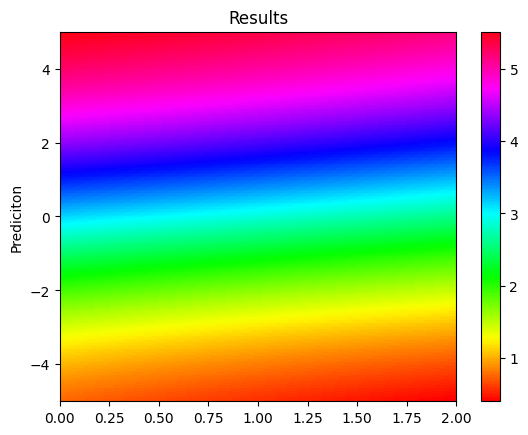

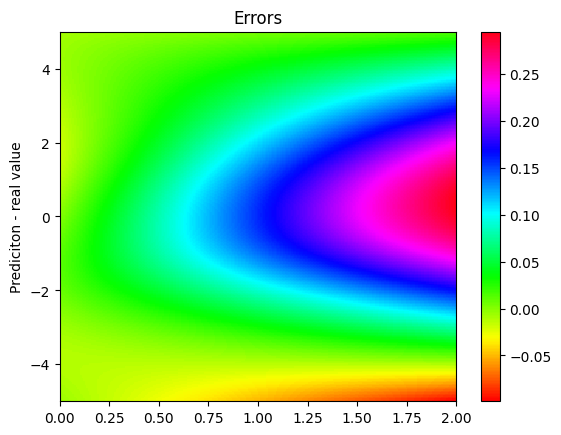


 m =  0.275 

 ####################################################


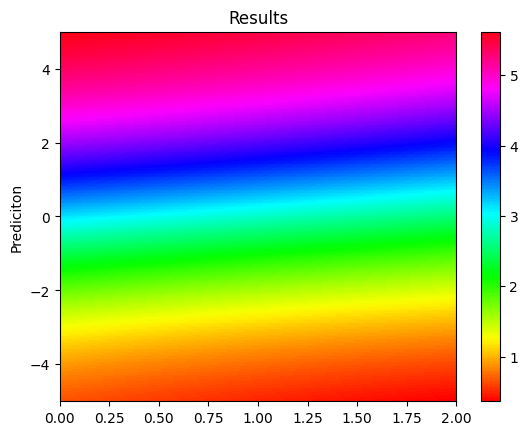

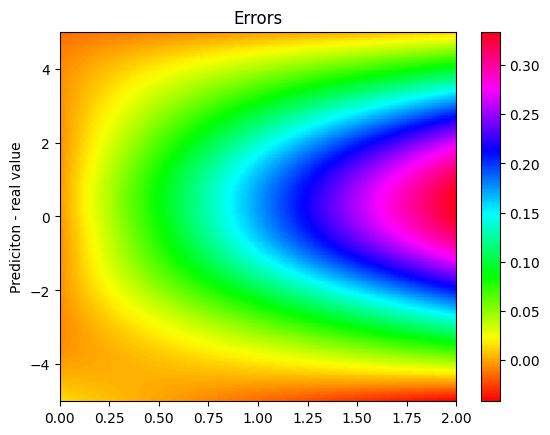


 m =  0.3 

 ####################################################


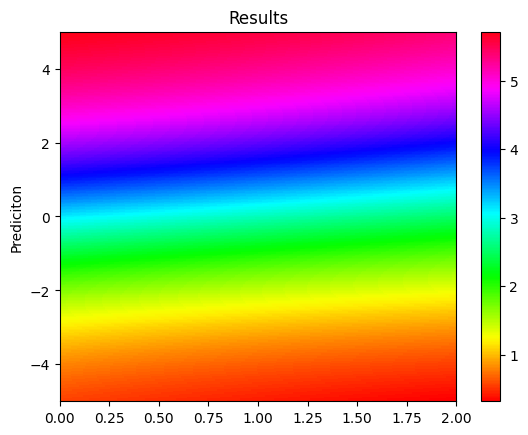

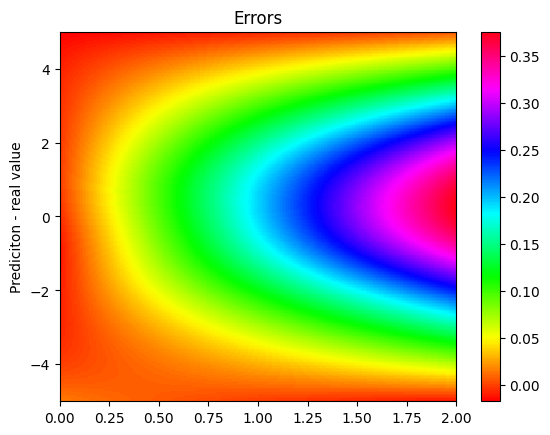


 m =  0.32499999999999996 

 ####################################################


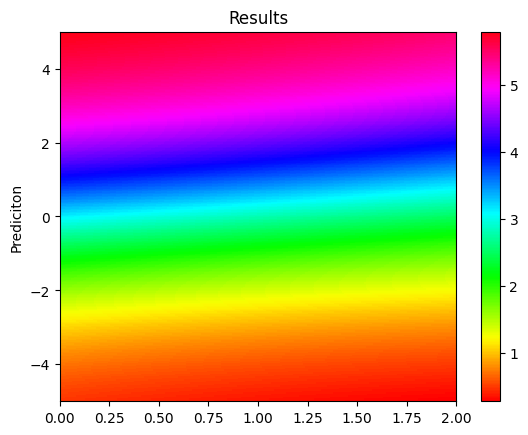

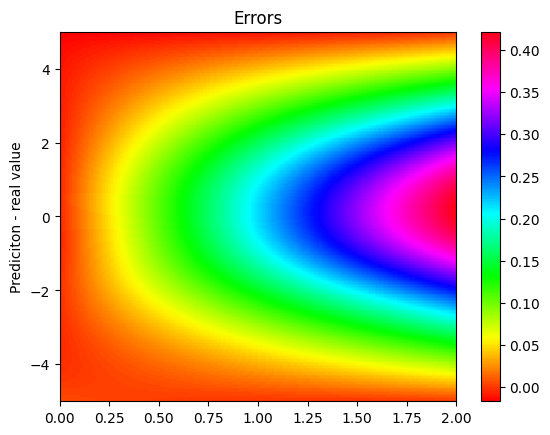


 m =  0.35 

 ####################################################


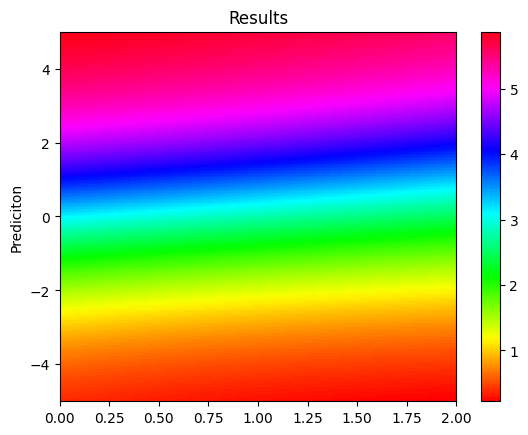

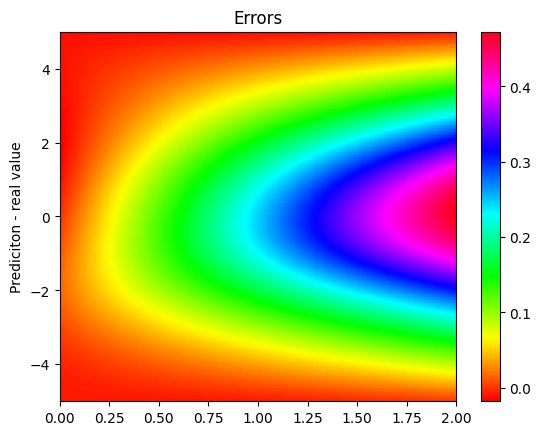

L2:  0.051551525 at variation:  25 ,  35 

L2_list=  [0.05155152]  at identifier:  1 

Compiling model...
Building feed-forward neural network...
'build' took 0.140283 s

'compile' took 1.633215 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.73e-03, 1.51e+01, 3.94e+01, 1.36e-02]    [1.73e-03, 1.51e+01, 3.94e+01, 1.36e-02]    [1.11e+00]    
1000      [3.08e-04, 1.02e-02, 3.18e-05, 7.09e-04]    [3.08e-04, 1.02e-02, 3.18e-05, 7.09e-04]    [5.80e-02]    
2000      [7.43e-04, 4.23e-02, 1.36e-01, 4.48e-02]    [7.43e-04, 4.23e-02, 1.36e-01, 4.48e-02]    [9.81e-02]    
3000      [1.39e-04, 9.66e-04, 2.54e-05, 7.70e-05]    [1.39e-04, 9.66e-04, 2.54e-05, 7.70e-05]    [4.39e-02]    
4000      [7.87e-05, 5.00e-04, 8.94e-05, 8.69e-05]    [7.87e-05, 5.00e-04, 8.94e-05, 8.69e-05]    [5.33e-02]    
5000      [6.84e-05, 1.63e-04, 3.24e-05, 1.77e-05]    [6.84e-05, 1.63e-04, 3.24e-05, 1.77e-05]    [5.80e-

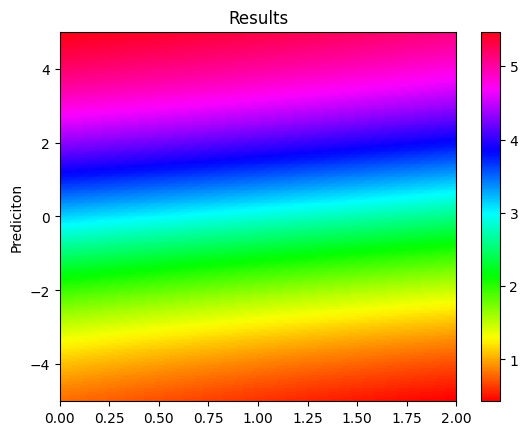

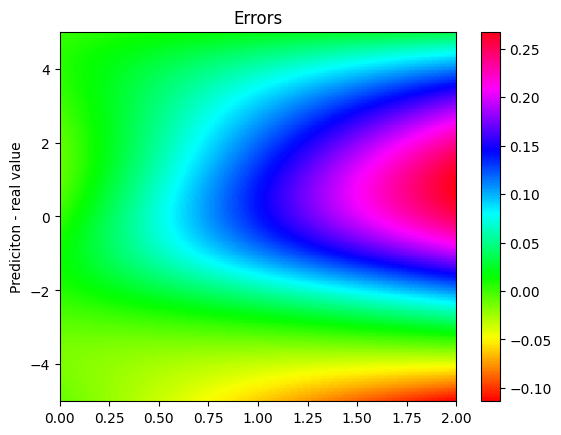


 m =  0.27 

 ####################################################


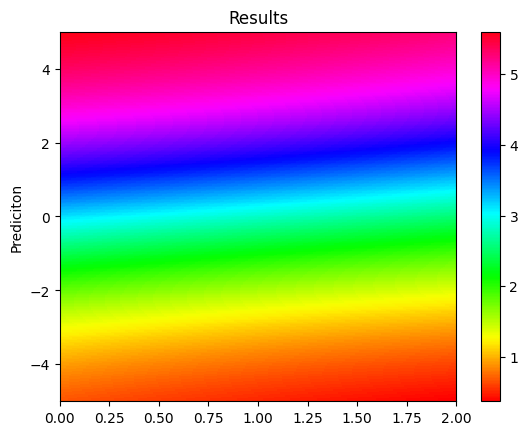

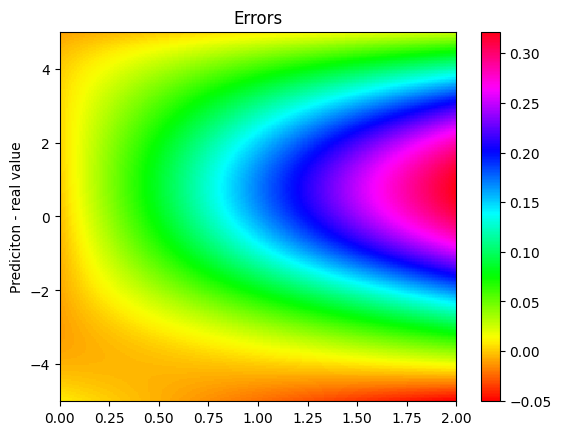


 m =  0.3 

 ####################################################


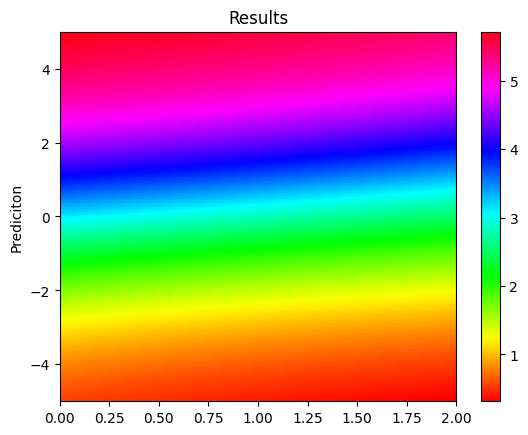

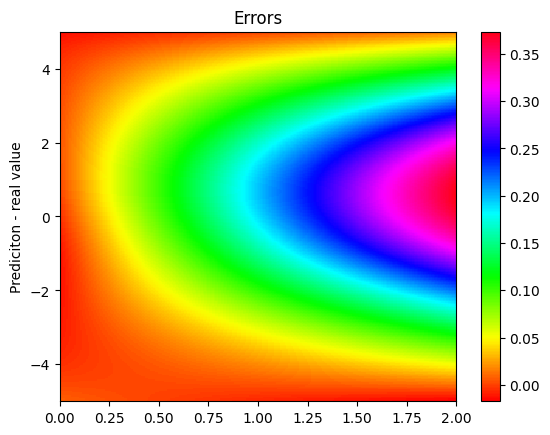


 m =  0.32999999999999996 

 ####################################################


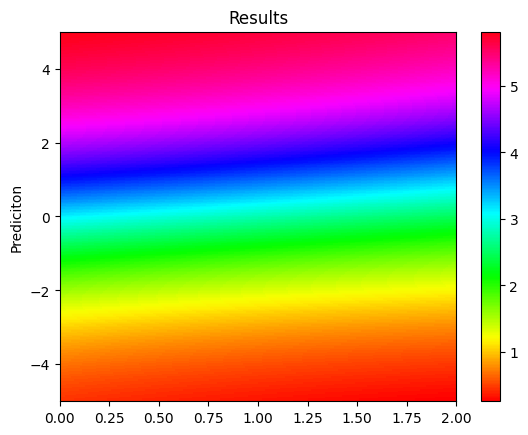

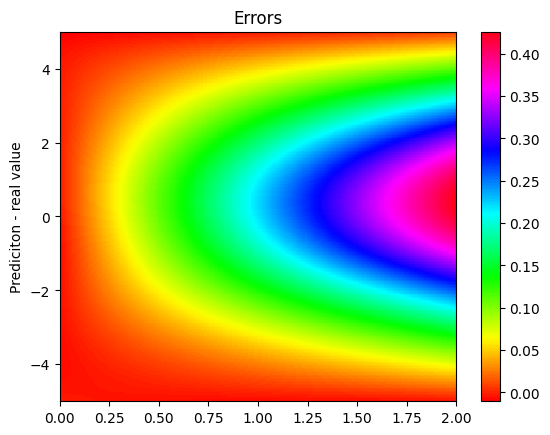


 m =  0.36 

 ####################################################


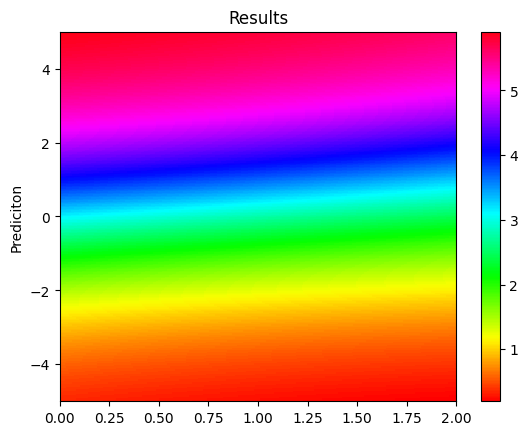

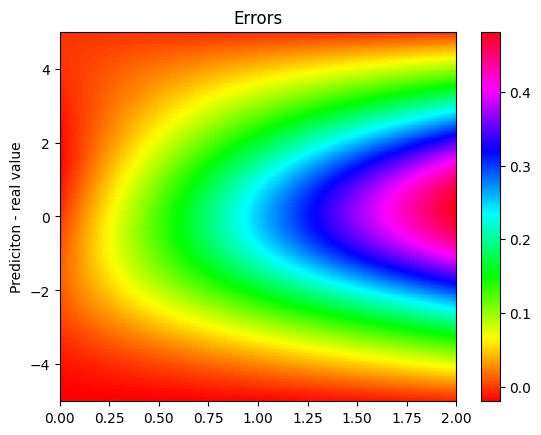

L2:  0.050429005 at variation:  24 ,  36 

L2_list=  [0.05155152 0.05042901]  at identifier:  2 

Compiling model...
Building feed-forward neural network...
'build' took 0.132199 s

'compile' took 1.502954 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [7.32e-04, 1.19e+01, 2.71e+01, 6.25e-01]    [7.32e-04, 1.19e+01, 2.71e+01, 6.25e-01]    [9.52e-01]    
1000      [5.86e-04, 6.46e-03, 1.34e-03, 3.53e-04]    [5.86e-04, 6.46e-03, 1.34e-03, 3.53e-04]    [6.03e-02]    
2000      [2.34e-04, 2.16e-03, 1.97e-03, 6.85e-04]    [2.34e-04, 2.16e-03, 1.97e-03, 6.85e-04]    [4.80e-02]    
3000      [2.64e-04, 4.03e-03, 1.15e-03, 5.03e-03]    [2.64e-04, 4.03e-03, 1.15e-03, 5.03e-03]    [6.02e-02]    
4000      [8.63e-05, 1.75e-04, 4.24e-05, 2.83e-05]    [8.63e-05, 1.75e-04, 4.24e-05, 2.83e-05]    [5.25e-02]    
5000      [6.78e-05, 1.47e-04, 6.72e-06, 1.28e-04]    [6.78e-05, 1.47e-04, 6.72e-06, 1.28e-04]

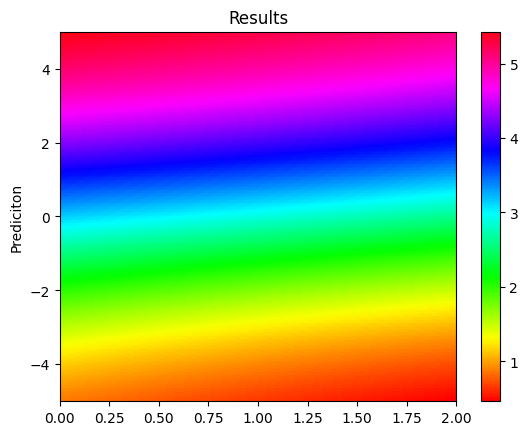

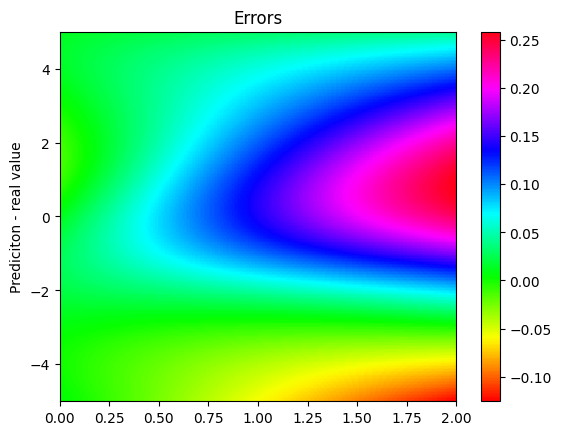


 m =  0.265 

 ####################################################


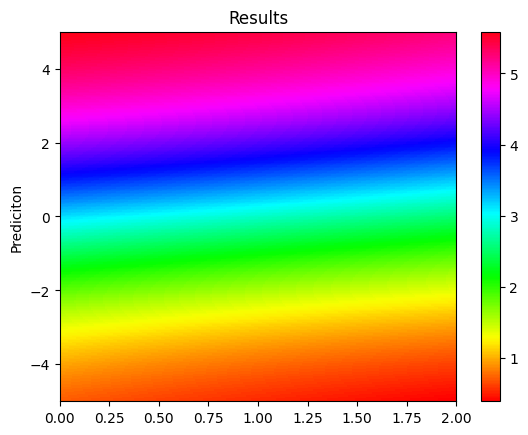

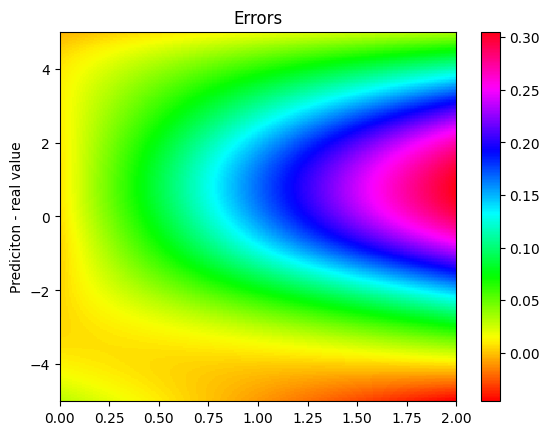


 m =  0.3 

 ####################################################


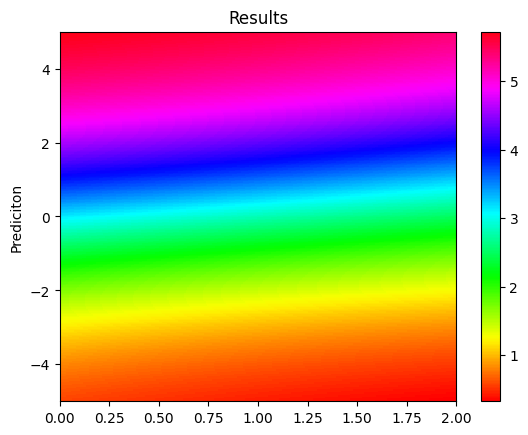

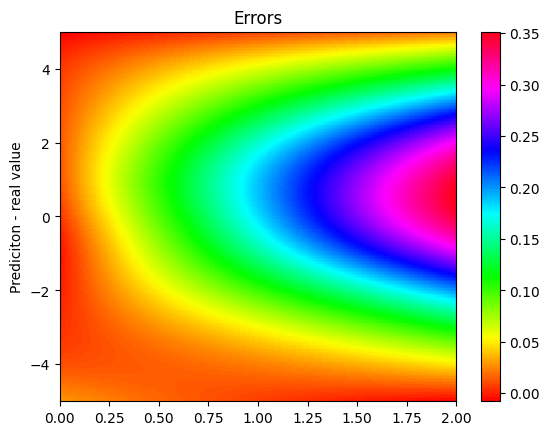


 m =  0.33499999999999996 

 ####################################################


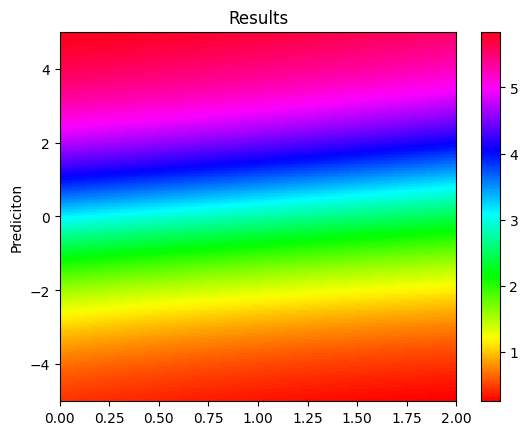

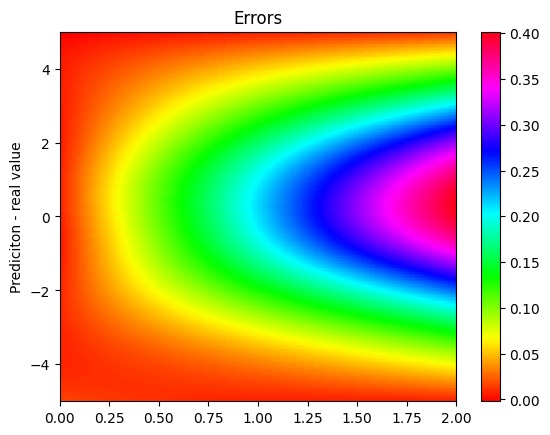


 m =  0.37 

 ####################################################


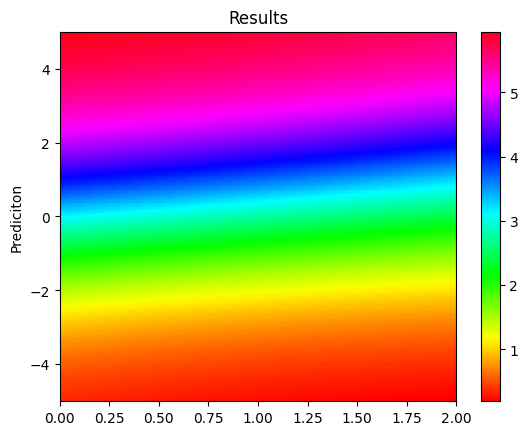

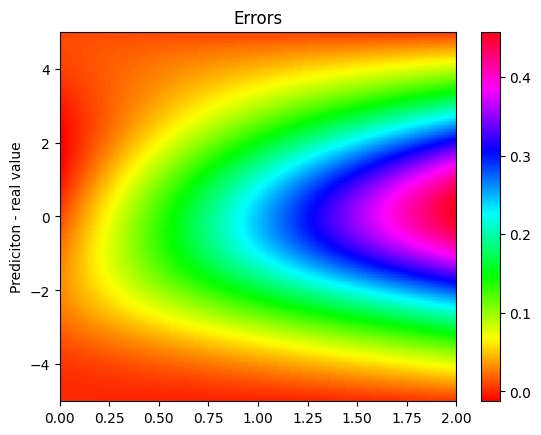

L2:  0.050601523 at variation:  23 ,  37 

L2_list=  [0.05155152 0.05042901 0.05060152]  at identifier:  3 

Compiling model...
Building feed-forward neural network...
'build' took 0.140005 s

'compile' took 1.265307 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [4.41e-04, 1.32e+01, 3.24e+01, 9.34e-02]    [4.41e-04, 1.32e+01, 3.24e+01, 9.34e-02]    [1.01e+00]    
1000      [6.34e-04, 9.74e-03, 6.52e-05, 5.57e-04]    [6.34e-04, 9.74e-03, 6.52e-05, 5.57e-04]    [6.25e-02]    
2000      [1.29e-04, 6.16e-04, 2.54e-05, 2.03e-04]    [1.29e-04, 6.16e-04, 2.54e-05, 2.03e-04]    [6.59e-02]    
3000      [1.20e-04, 4.44e-04, 3.72e-06, 1.33e-04]    [1.20e-04, 4.44e-04, 3.72e-06, 1.33e-04]    [7.64e-02]    
4000      [1.19e-04, 2.83e-03, 6.03e-04, 6.79e-03]    [1.19e-04, 2.83e-03, 6.03e-04, 6.79e-03]    [6.57e-02]    
5000      [6.86e-05, 6.83e-04, 1.09e-03, 9.71e-04]    [6.86e-05, 6.83e-04, 1.09e-03

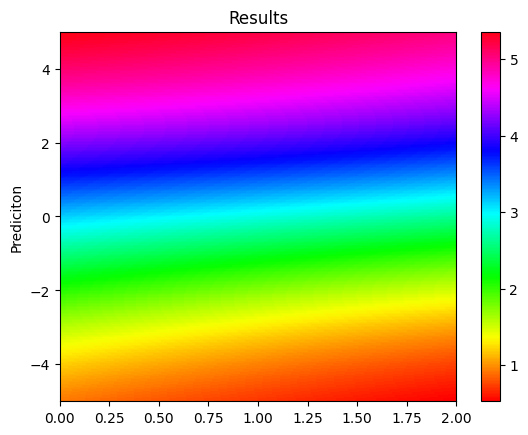

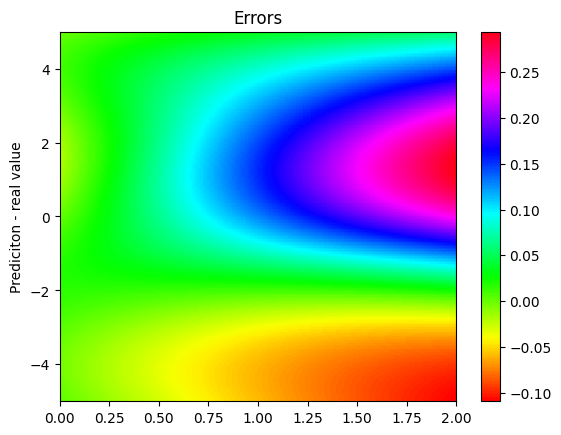


 m =  0.26 

 ####################################################


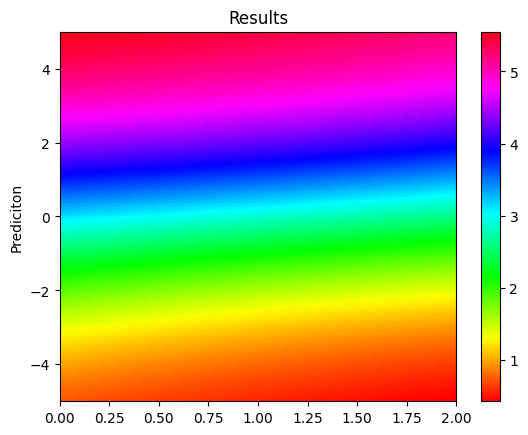

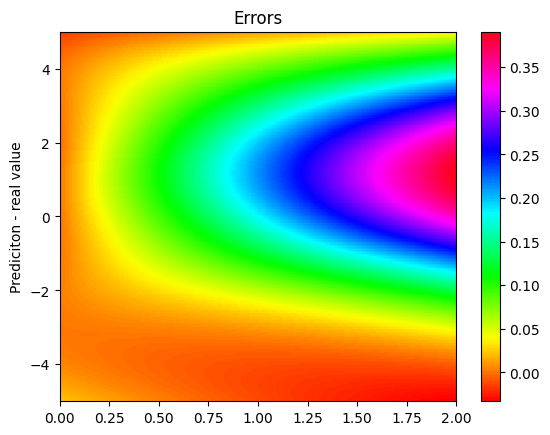


 m =  0.3 

 ####################################################


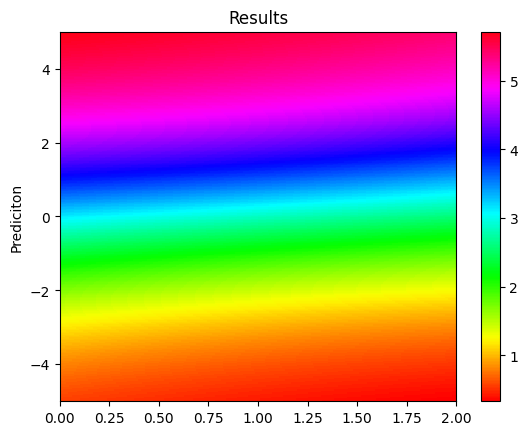

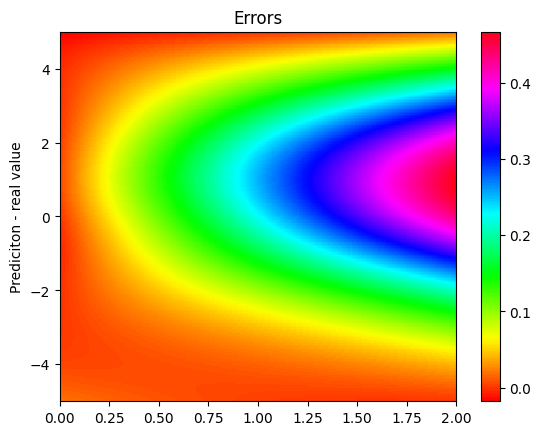


 m =  0.33999999999999997 

 ####################################################


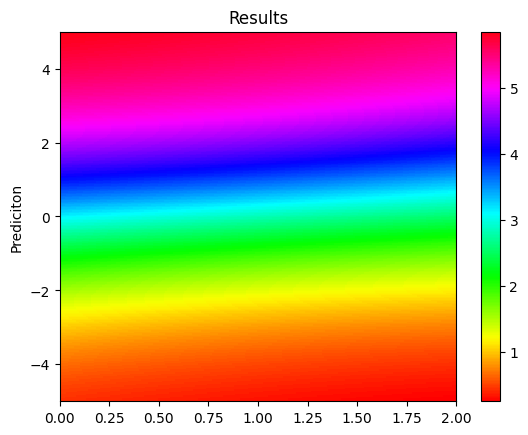

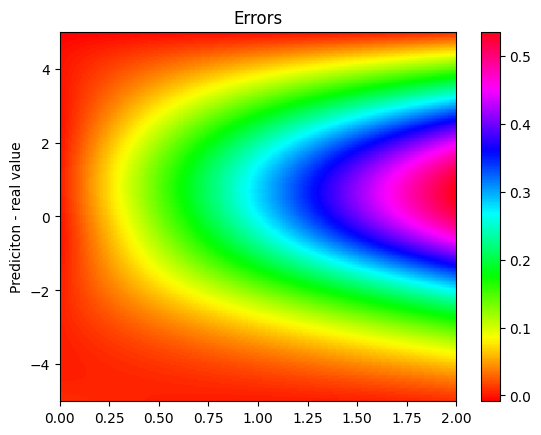


 m =  0.38 

 ####################################################


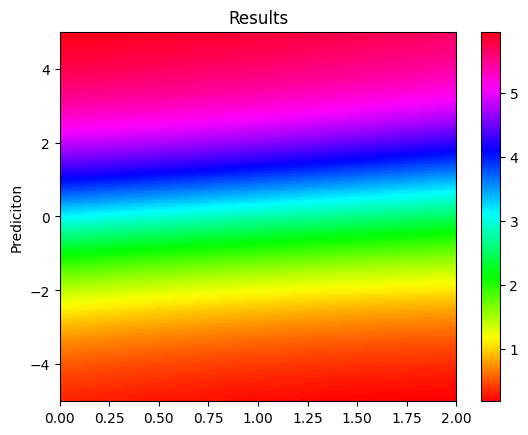

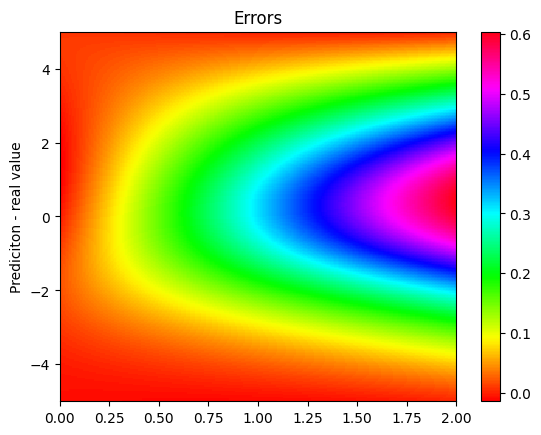

L2:  0.055972278 at variation:  22 ,  38 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228]  at identifier:  4 

Compiling model...
Building feed-forward neural network...
'build' took 0.102678 s

'compile' took 1.212542 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.70e-03, 1.20e+01, 2.67e+01, 9.52e-01]    [1.70e-03, 1.20e+01, 2.67e+01, 9.52e-01]    [9.63e-01]    
1000      [5.73e-04, 5.51e-03, 8.91e-05, 4.27e-04]    [5.73e-04, 5.51e-03, 8.91e-05, 4.27e-04]    [4.70e-02]    
2000      [2.55e-04, 1.96e-03, 2.93e-03, 5.88e-04]    [2.55e-04, 1.96e-03, 2.93e-03, 5.88e-04]    [5.68e-02]    
3000      [1.58e-04, 3.54e-04, 1.57e-05, 2.11e-05]    [1.58e-04, 3.54e-04, 1.57e-05, 2.11e-05]    [5.64e-02]    
4000      [1.13e-04, 2.66e-04, 1.20e-04, 3.26e-05]    [1.13e-04, 2.66e-04, 1.20e-04, 3.26e-05]    [5.48e-02]    
5000      [9.23e-05, 2.03e-04, 1.41e-05, 2.03e-05]    [9.23e-05, 2.03e-0

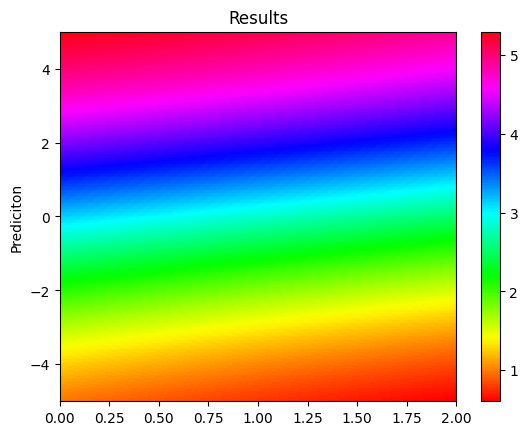

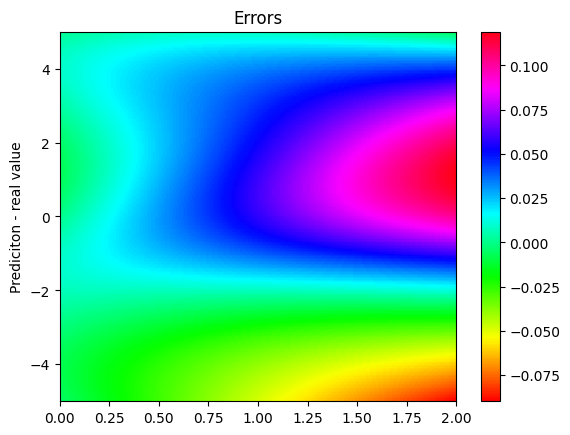


 m =  0.255 

 ####################################################


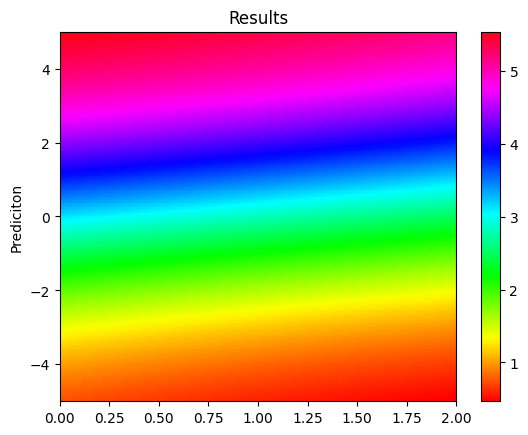

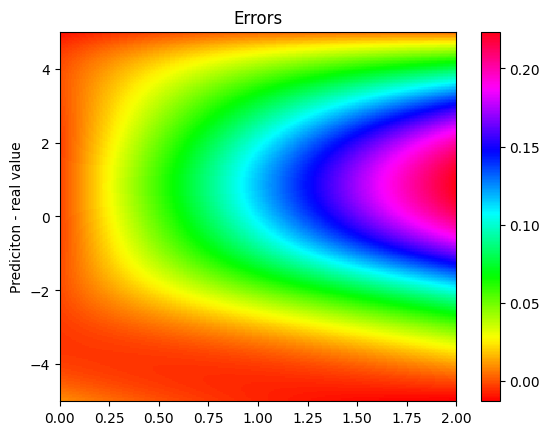


 m =  0.3 

 ####################################################


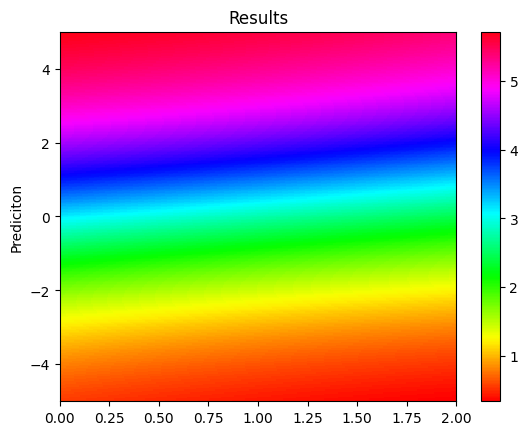

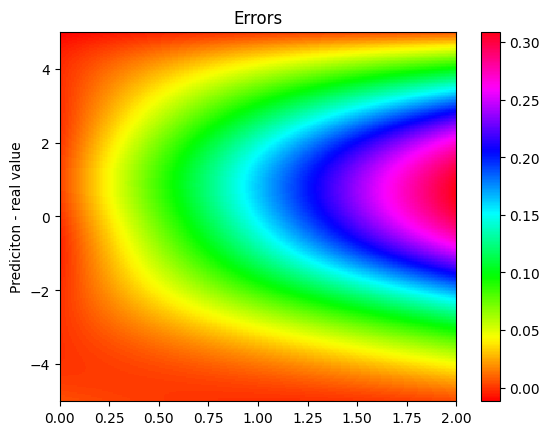


 m =  0.345 

 ####################################################


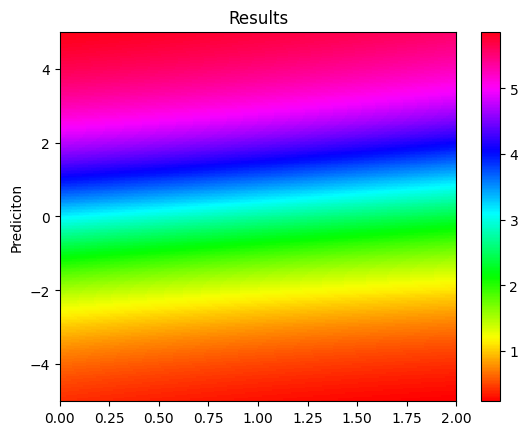

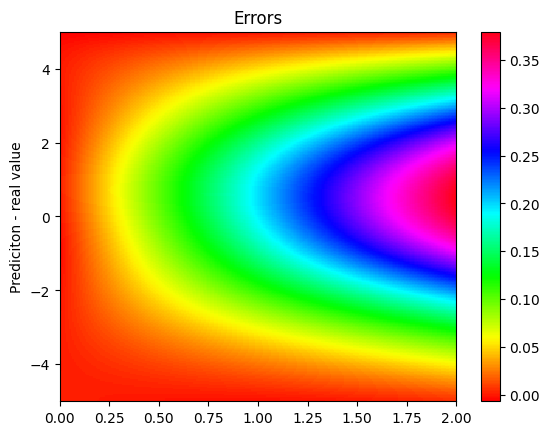


 m =  0.39 

 ####################################################


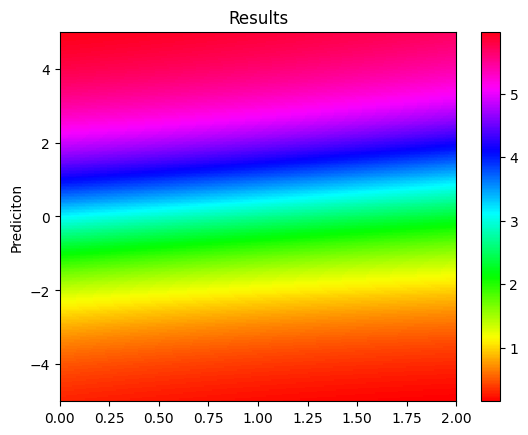

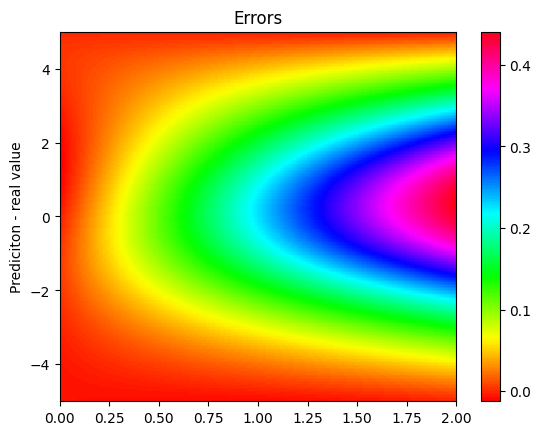

L2:  0.03927689 at variation:  21 ,  39 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689]  at identifier:  5 

Compiling model...
Building feed-forward neural network...
'build' took 0.099693 s

'compile' took 1.269166 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.25e-03, 1.37e+01, 3.32e+01, 1.45e-01]    [1.25e-03, 1.37e+01, 3.32e+01, 1.45e-01]    [1.03e+00]    
1000      [4.73e-04, 3.04e-03, 8.59e-05, 7.36e-04]    [4.73e-04, 3.04e-03, 8.59e-05, 7.36e-04]    [4.37e-02]    
2000      [2.87e-04, 4.50e-04, 6.58e-05, 7.08e-05]    [2.87e-04, 4.50e-04, 6.58e-05, 7.08e-05]    [6.33e-02]    
3000      [1.59e-04, 3.67e-04, 5.27e-05, 3.16e-05]    [1.59e-04, 3.67e-04, 5.27e-05, 3.16e-05]    [6.44e-02]    
4000      [1.40e-04, 1.07e-03, 9.90e-04, 1.18e-03]    [1.40e-04, 1.07e-03, 9.90e-04, 1.18e-03]    [5.32e-02]    
5000      [9.26e-05, 2.78e-04, 1.01e-04, 6.06e-05]    [9.26e-0

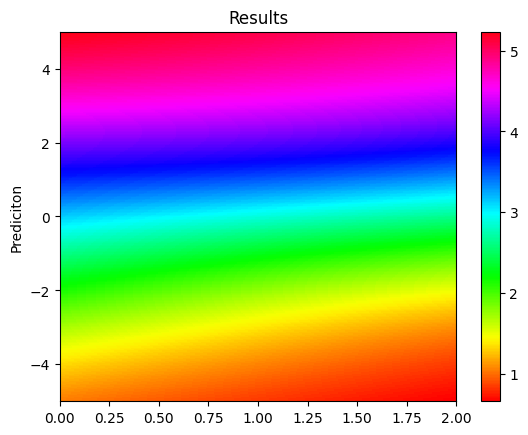

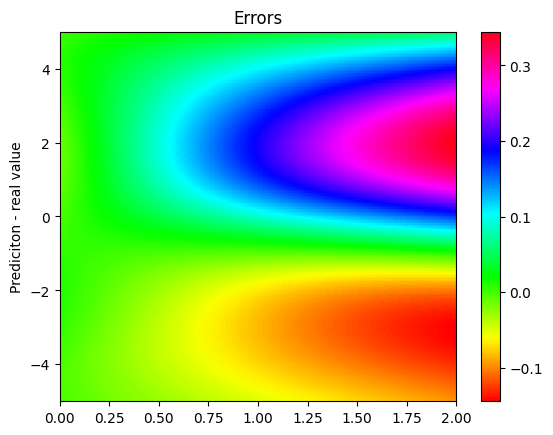


 m =  0.25 

 ####################################################


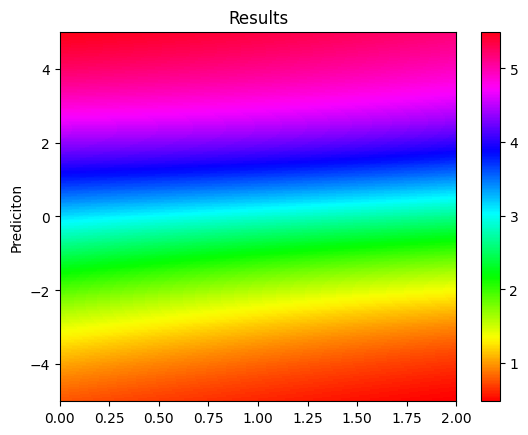

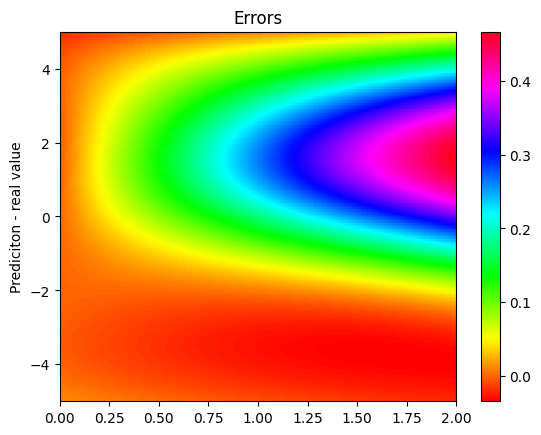


 m =  0.30000000000000004 

 ####################################################


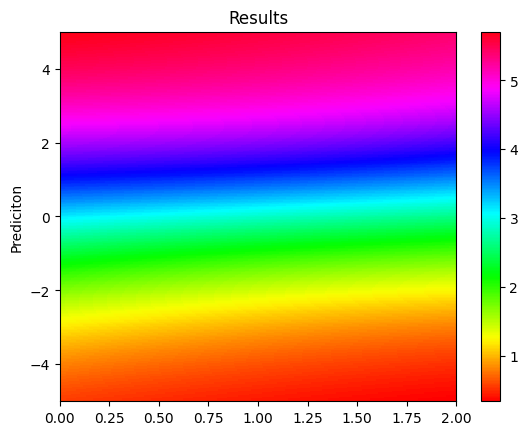

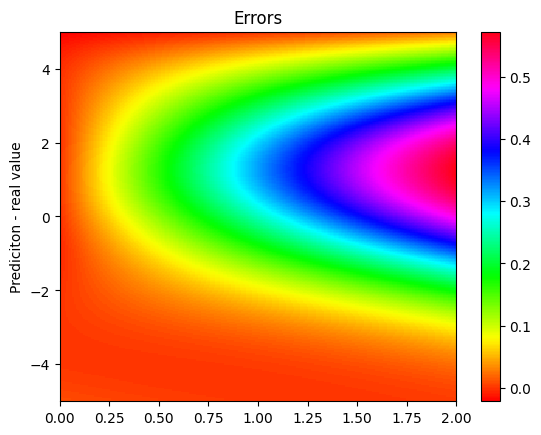


 m =  0.35000000000000003 

 ####################################################


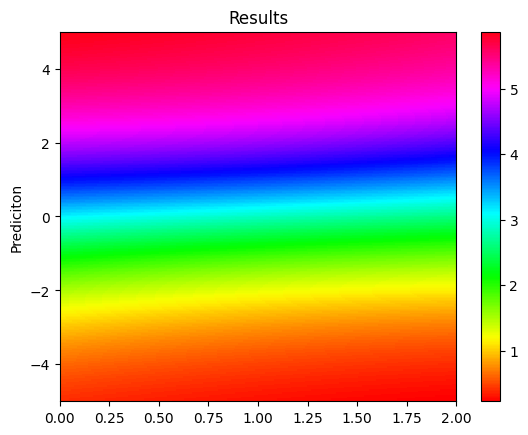

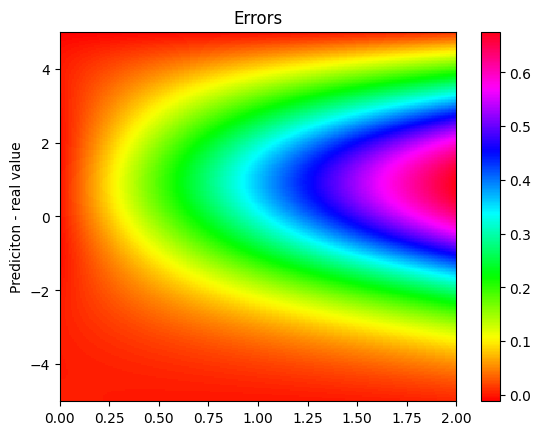


 m =  0.4 

 ####################################################


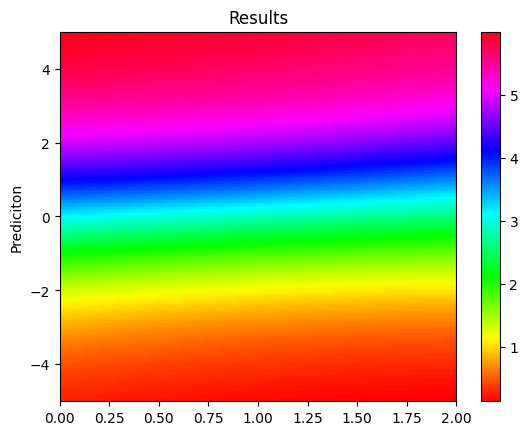

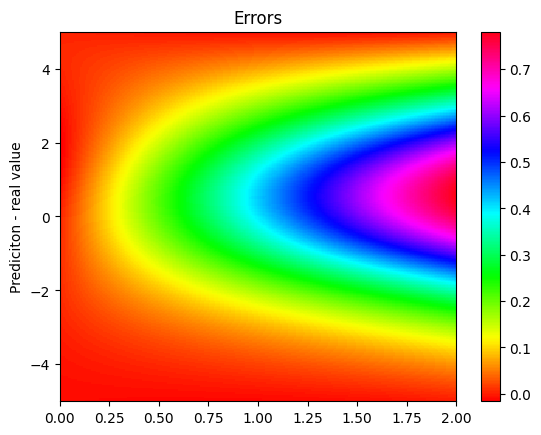

L2:  0.058898255 at variation:  20 ,  40 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826]  at identifier:  6 

Compiling model...
Building feed-forward neural network...
'build' took 0.097163 s

'compile' took 1.302048 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.22e-03, 1.22e+01, 2.84e+01, 7.69e-01]    [2.22e-03, 1.22e+01, 2.84e+01, 7.69e-01]    [9.83e-01]    
1000      [4.88e-04, 1.84e-03, 1.15e-04, 6.59e-04]    [4.88e-04, 1.84e-03, 1.15e-04, 6.59e-04]    [5.61e-02]    
2000      [3.12e-04, 4.71e-04, 1.74e-04, 1.18e-04]    [3.12e-04, 4.71e-04, 1.74e-04, 1.18e-04]    [6.37e-02]    
3000      [2.21e-04, 3.13e-04, 2.03e-05, 2.76e-05]    [2.21e-04, 3.13e-04, 2.03e-05, 2.76e-05]    [5.78e-02]    
4000      [1.75e-04, 4.26e-04, 1.56e-04, 3.02e-04]    [1.75e-04, 4.26e-04, 1.56e-04, 3.02e-04]    [4.68e-02]    
5000      [1.46e-04, 6.43e-04, 1.09e-03, 1.81e-05]

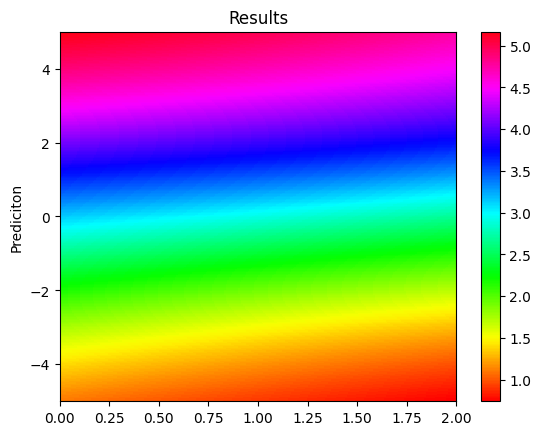

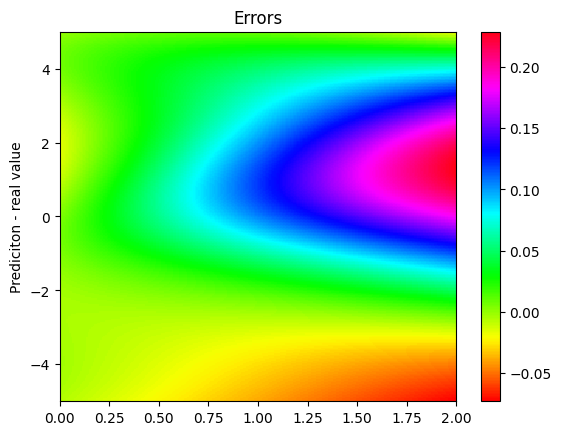


 m =  0.245 

 ####################################################


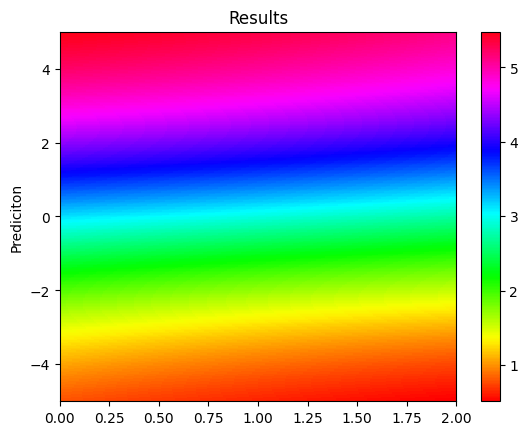

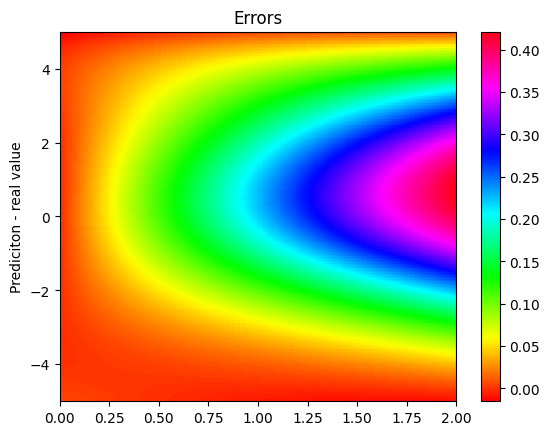


 m =  0.3 

 ####################################################


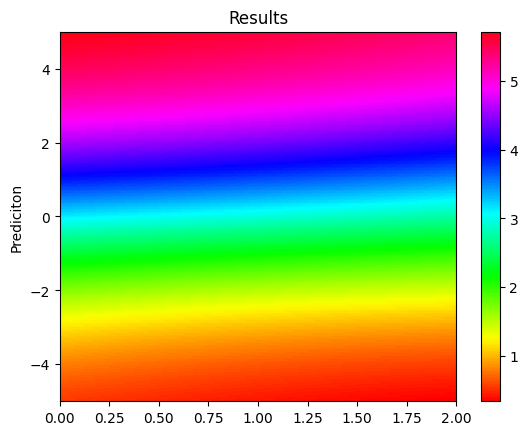

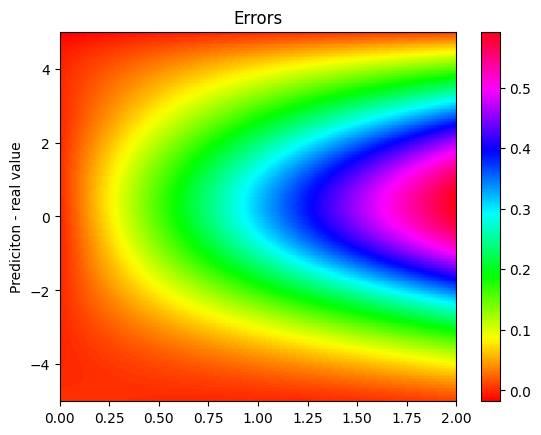


 m =  0.355 

 ####################################################


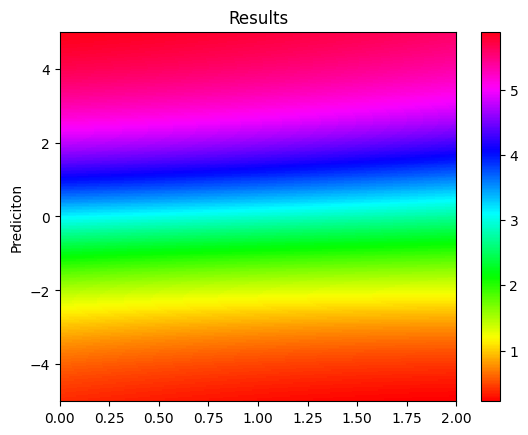

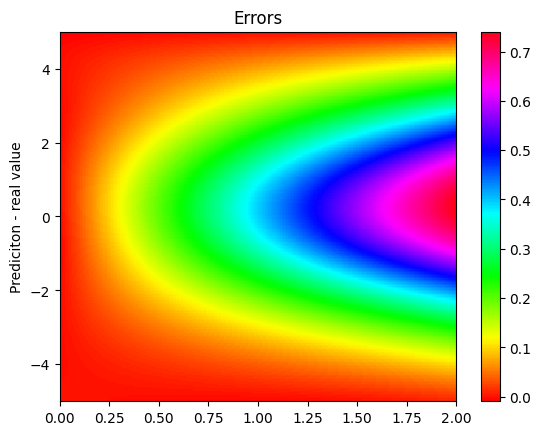


 m =  0.41 

 ####################################################


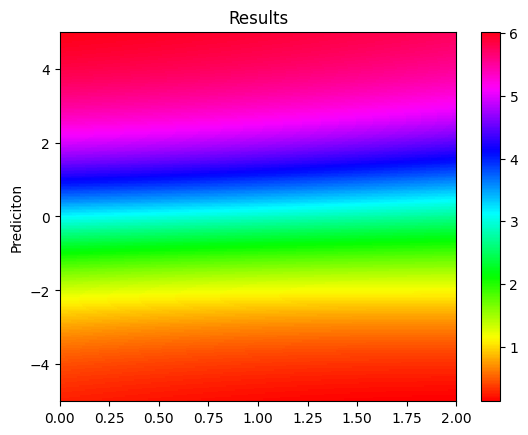

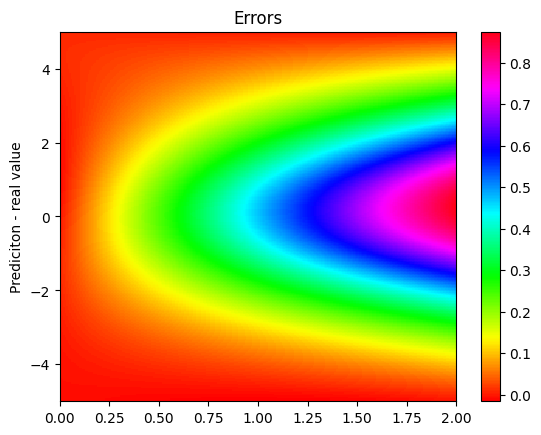

L2:  0.066731915 at variation:  19 ,  41 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191]  at identifier:  7 

Compiling model...
Building feed-forward neural network...
'build' took 0.100639 s

'compile' took 1.360931 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.26e-04, 1.31e+01, 3.30e+01, 2.34e-01]    [1.26e-04, 1.31e+01, 3.30e+01, 2.34e-01]    [1.03e+00]    
1000      [6.40e-04, 1.46e-03, 1.04e-04, 5.62e-04]    [6.40e-04, 1.46e-03, 1.04e-04, 5.62e-04]    [3.63e-02]    
2000      [3.25e-04, 1.60e-03, 8.24e-04, 1.47e-03]    [3.25e-04, 1.60e-03, 8.24e-04, 1.47e-03]    [5.97e-02]    
3000      [2.18e-04, 2.97e-03, 2.35e-03, 4.27e-03]    [2.18e-04, 2.97e-03, 2.35e-03, 4.27e-03]    [4.95e-02]    
4000      [1.42e-04, 1.04e-03, 2.32e-03, 2.32e-04]    [1.42e-04, 1.04e-03, 2.32e-03, 2.32e-04]    [5.86e-02]    
5000      [1.16e-04, 3.67e-04, 7.82e-0

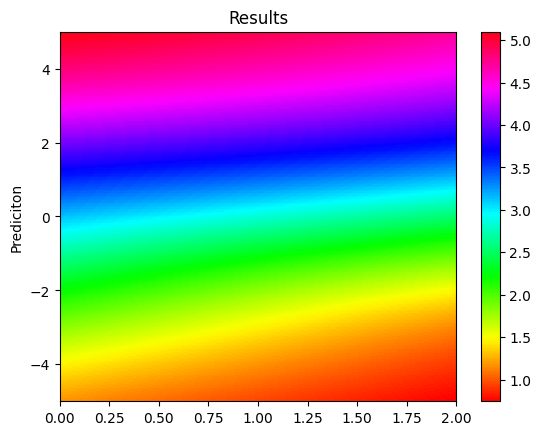

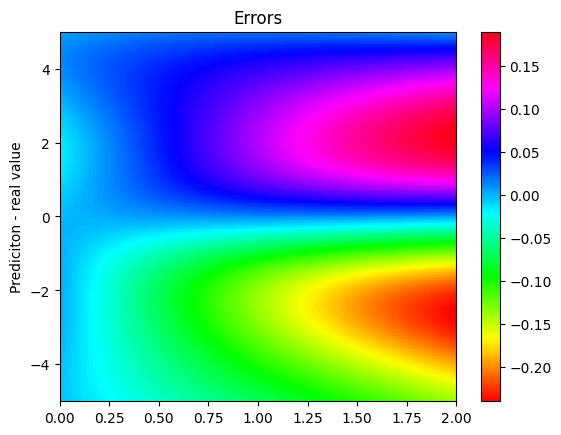


 m =  0.24 

 ####################################################


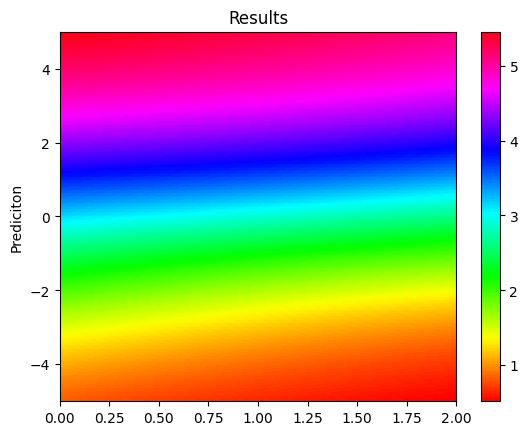

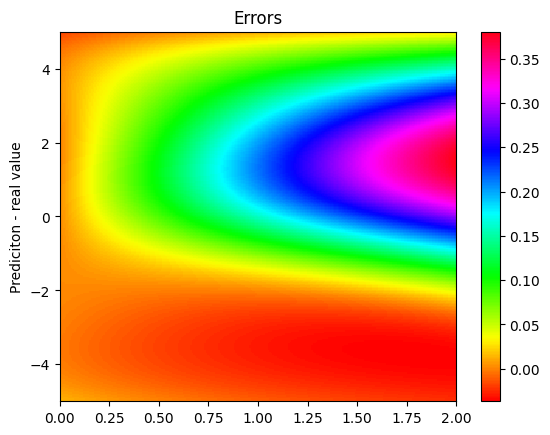


 m =  0.3 

 ####################################################


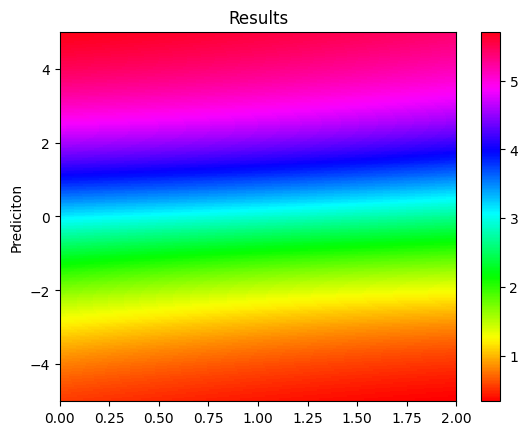

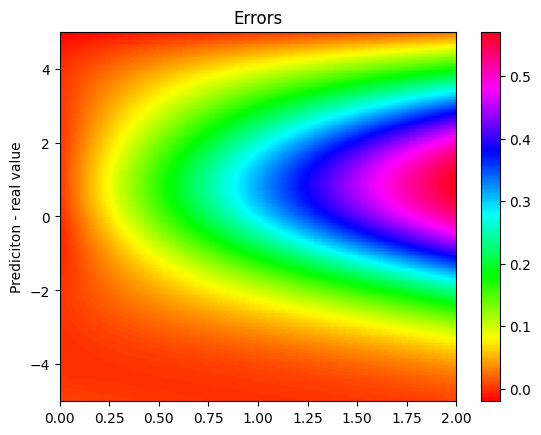


 m =  0.36 

 ####################################################


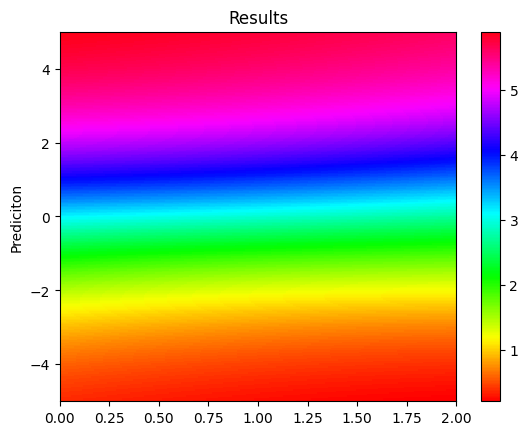

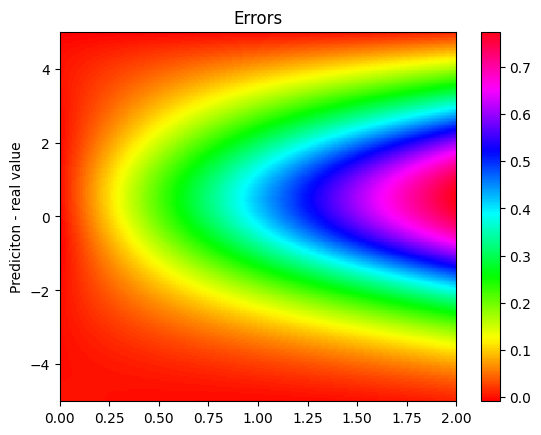


 m =  0.42 

 ####################################################


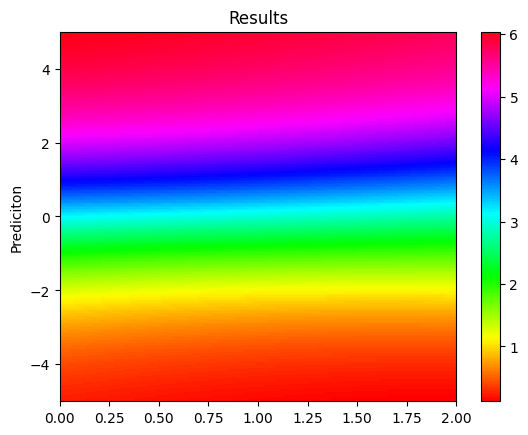

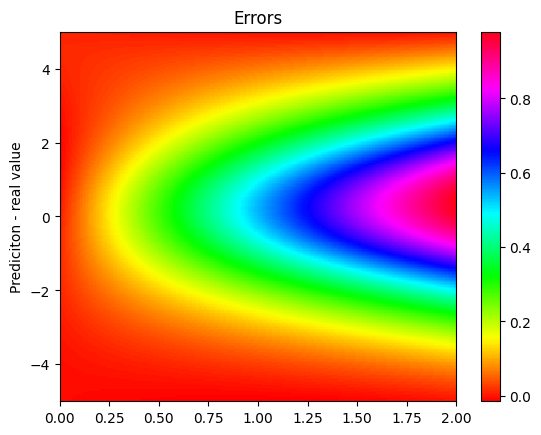

L2:  0.07043135 at variation:  18 ,  42 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135]  at identifier:  8 

Compiling model...
Building feed-forward neural network...
'build' took 0.133845 s

'compile' took 1.964655 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [8.31e-03, 1.54e+01, 4.01e+01, 2.28e-01]    [8.31e-03, 1.54e+01, 4.01e+01, 2.28e-01]    [1.10e+00]    
1000      [1.27e-03, 4.70e-03, 2.04e-04, 7.89e-04]    [1.27e-03, 4.70e-03, 2.04e-04, 7.89e-04]    [6.48e-02]    
2000      [5.10e-04, 3.27e-03, 3.14e-03, 4.96e-03]    [5.10e-04, 3.27e-03, 3.14e-03, 4.96e-03]    [5.45e-02]    
3000      [2.19e-04, 4.43e-04, 6.65e-05, 4.56e-05]    [2.19e-04, 4.43e-04, 6.65e-05, 4.56e-05]    [5.46e-02]    
4000      [1.70e-04, 4.38e-04, 1.12e-04, 5.77e-05]    [1.70e-04, 4.38e-04, 1.12e-04, 5.77e-05]    [4.94e-02]    
5000      [1.45e-04, 3.86e-0

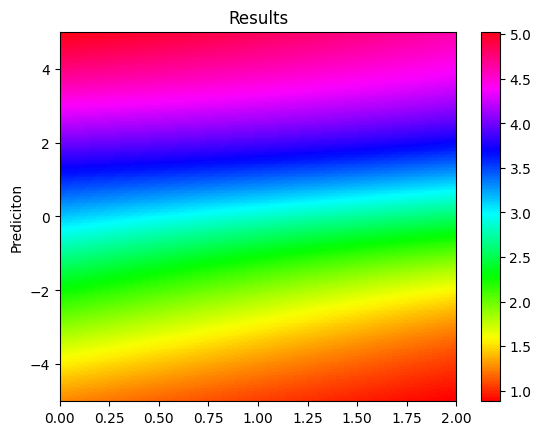

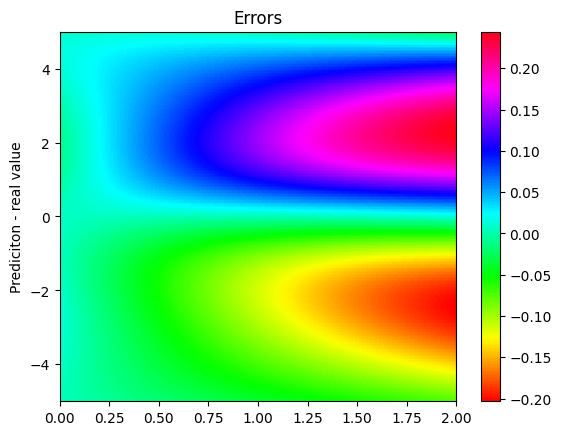


 m =  0.23500000000000001 

 ####################################################


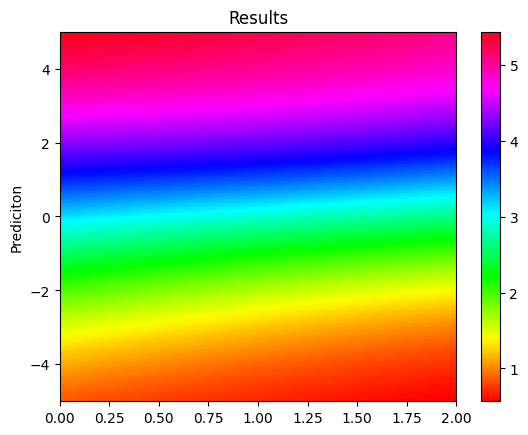

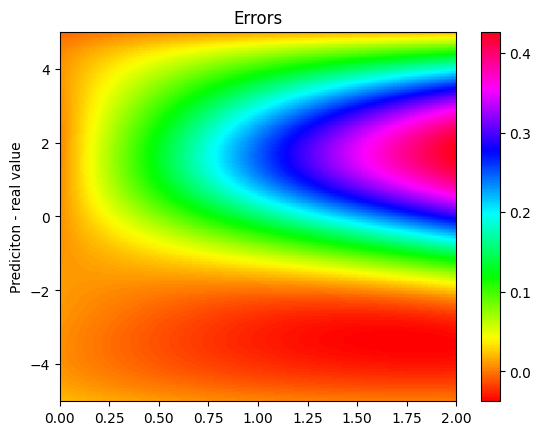


 m =  0.30000000000000004 

 ####################################################


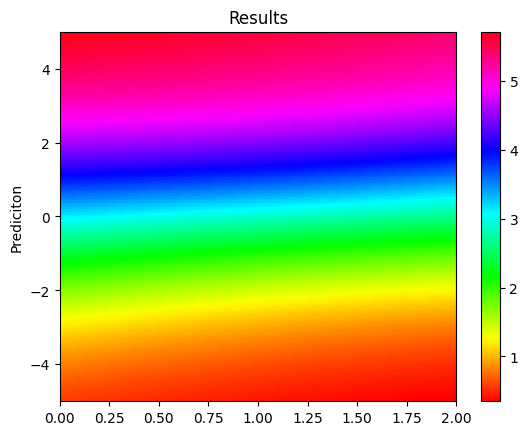

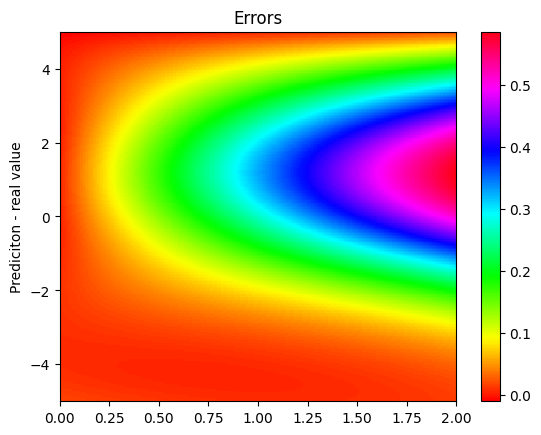


 m =  0.365 

 ####################################################


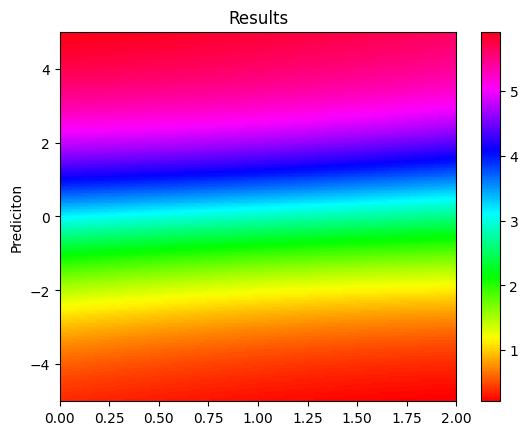

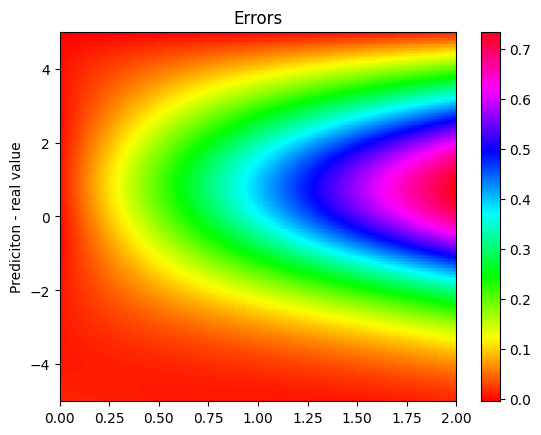


 m =  0.43 

 ####################################################


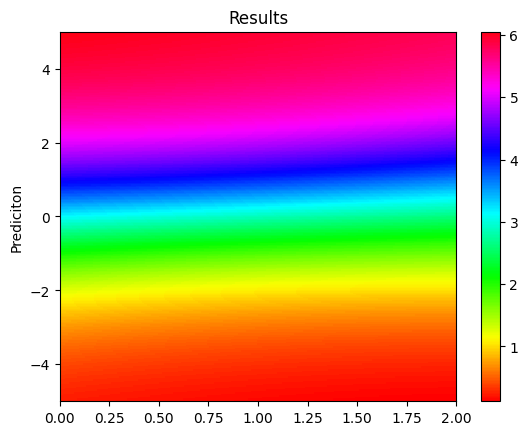

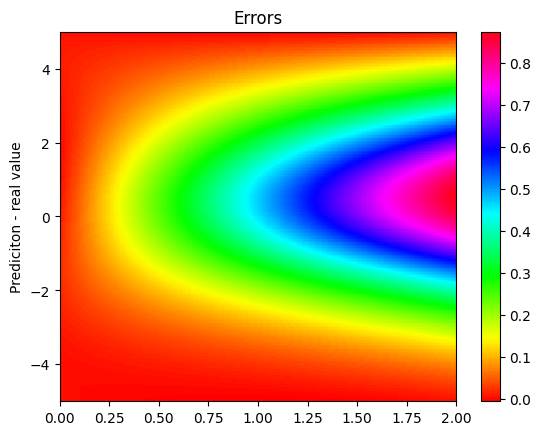

L2:  0.06481729 at variation:  17 ,  43 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729]  at identifier:  9 

Compiling model...
Building feed-forward neural network...
'build' took 0.098896 s

'compile' took 1.454433 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [4.85e-05, 1.32e+01, 3.08e+01, 3.61e-01]    [4.85e-05, 1.32e+01, 3.08e+01, 3.61e-01]    [1.00e+00]    
1000      [5.75e-04, 1.27e-03, 1.26e-04, 1.15e-04]    [5.75e-04, 1.27e-03, 1.26e-04, 1.15e-04]    [9.80e-02]    
2000      [3.02e-04, 7.16e-04, 2.27e-05, 4.32e-05]    [3.02e-04, 7.16e-04, 2.27e-05, 4.32e-05]    [8.83e-02]    
3000      [2.22e-04, 6.53e-04, 6.87e-05, 9.55e-05]    [2.22e-04, 6.53e-04, 6.87e-05, 9.55e-05]    [7.51e-02]    
4000      [1.91e-04, 5.35e-04, 1.88e-05, 1.31e-05]    [1.91e-04, 5.35e-04, 1.88e-05, 1.31e-05]    [6.55e-02]    
5000      [1.71e-

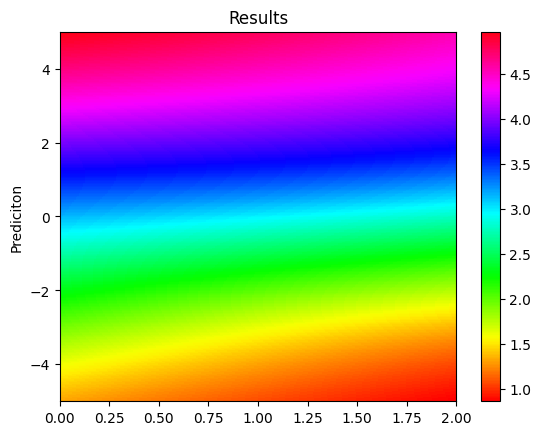

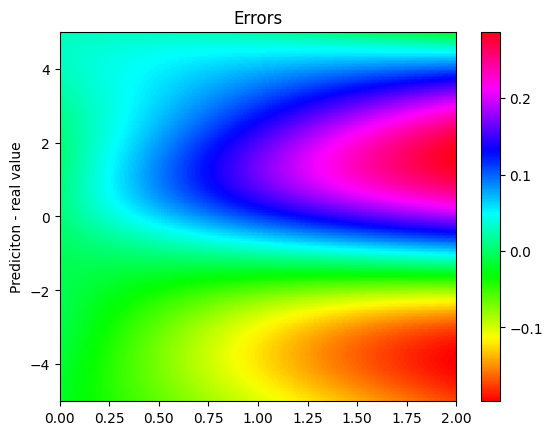


 m =  0.23 

 ####################################################


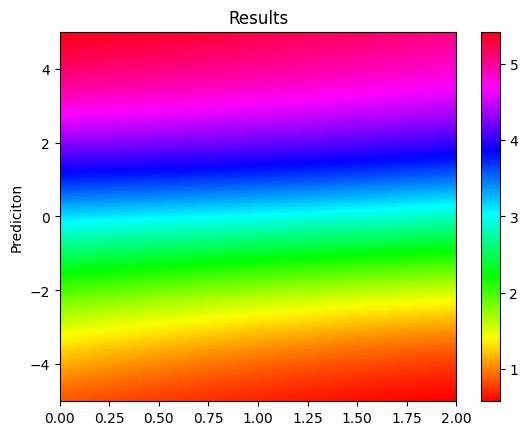

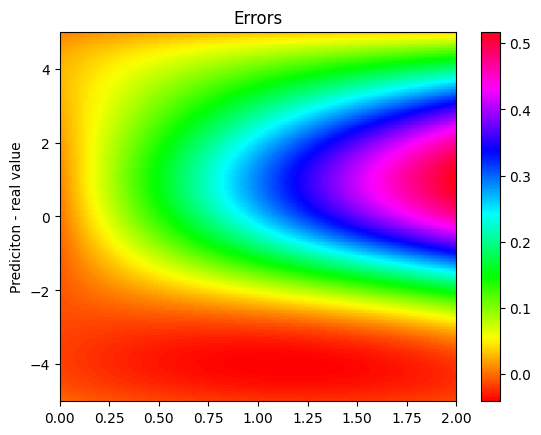


 m =  0.30000000000000004 

 ####################################################


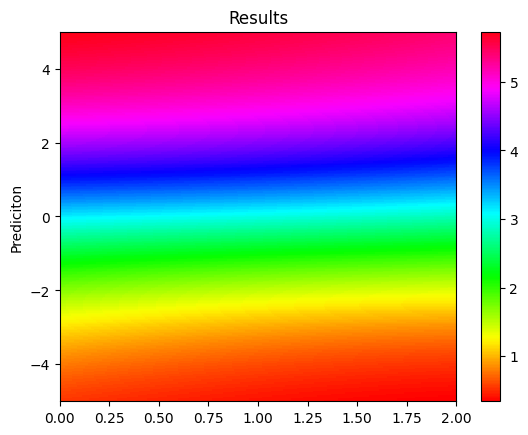

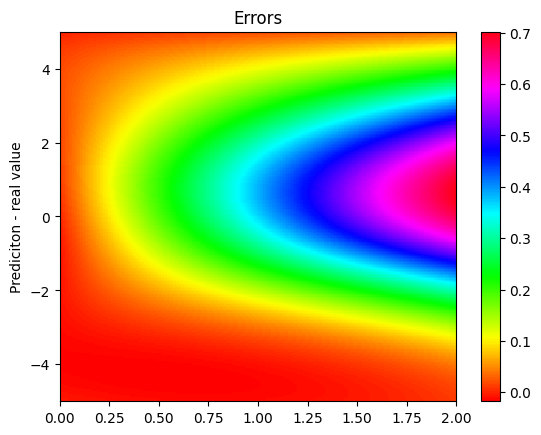


 m =  0.37 

 ####################################################


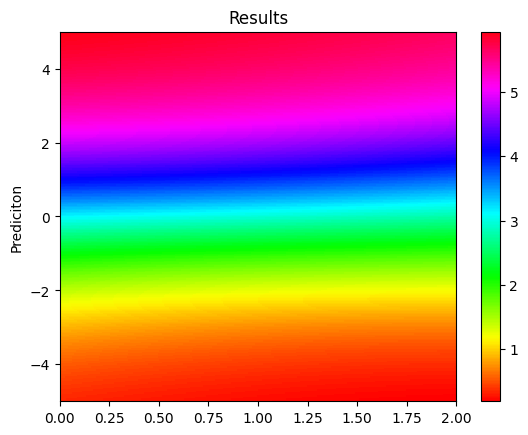

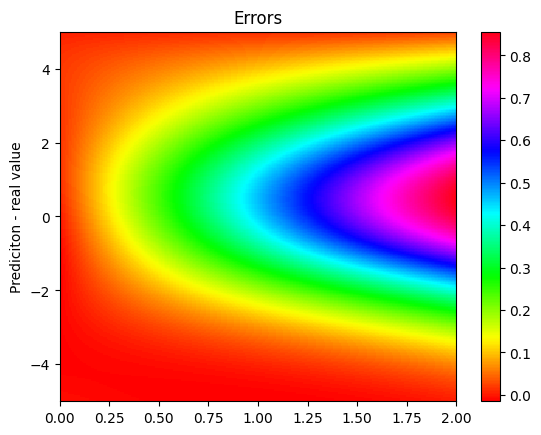


 m =  0.44 

 ####################################################


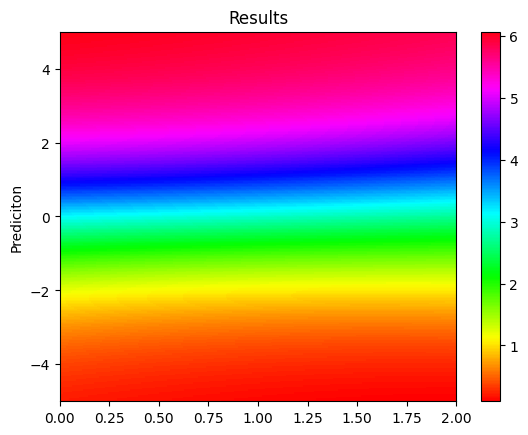

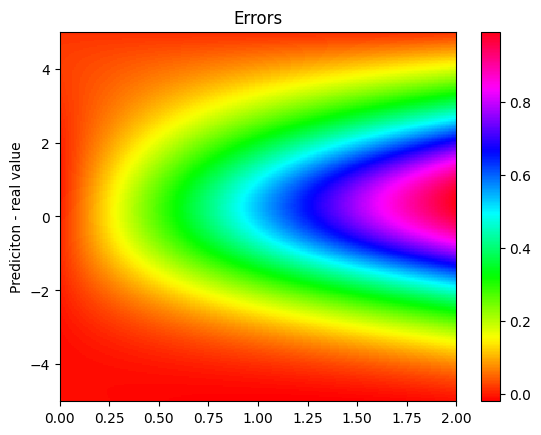

L2:  0.07471923 at variation:  16 ,  44 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923]  at identifier:  10 



In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

upper=35#centésimos
botton=25
identifier=0
L2_list=np.array([])
L2=0
while (botton>15):


    #Boundary points
    sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
    sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
    n_rand=256
    sample = sampler.random(n_rand)
    sample2 = sampler2.random(n_rand)
    #print(sample)
    #sample.sort
    #print(np.array(sample))
    #boundary condition sample:
    x1 = np.vstack(np.ones(int(n_rand/2))*5)
    x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
    m= (sample2*(upper-botton)+botton)/100#m entre (botton/100,upper/100)
    t0 = sample*2

    X_anchors=np.concatenate((x1,m,t0), axis=1)



    timedomain = dde.geometry.TimeDomain(0, 2)
    geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

    geomtime = dde.geometry.GeometryXTime(geom, timedomain)



    # Define sine function
    if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
        from deepxde.backend import tf

        cos = tf.cos
        sin = tf.sin
    elif dde.backend.backend_name == "paddle":
        import paddle

        cos = paddle.cos
        sin = paddle.sin


    def pde(x, y):
        alpha = -1
        v=0.65

        dy_tt = dde.grad.hessian(y, x, i=2, j=2)
        dy_xx = dde.grad.hessian(y, x, i=0, j=0)
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        return (
            dy_tt
            + alpha * dy_xx
            + m**2*sin(y)
        )

    def func(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

        v = 0.65
        gamma = np.sqrt(1/(1-v**2))
        delt=0


        return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
        #return x[:, 0:1] * np.cos(x[:, 1:2])

    def deriv(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        v = 0.65
        gamma = tf.sqrt(1/(1-v**2))
        delt=0

        return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


    def boundary(x,_):
        return np.isclose(x[2],0)

    def boundary_up(x,_):
        return np.isclose(x[0],5.0)
    def boundary_down(x,_):
        return np.isclose(x[0],-5.0)


    bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
    bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
    #ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
    ic_1 = dde.icbc.IC(geomtime, func, boundary)
    ic_2 = dde.icbc.OperatorBC(
        geomtime,
        lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
        boundary,
    )

    data = dde.data.TimePDE(
        geomtime,
        pde,
        [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
        num_domain=2000,
        num_boundary=0,
        num_initial=128,
        solution=func,
        num_test=None,
        anchors=X_anchors
    )

    layer_size = [3] + [200] * 6 + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)

    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )
    losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")

    for i in np.linspace(botton/100,upper/100, 5):
        print("\n m = ",i,"\n\n ####################################################")
        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        m= np.ones(65536)*i
        #m=m.reshape(-1,1)
        m=np.vstack(m)

        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        x1,t1=np.split(X_star, 2, axis=1)
        X_star_m= np.concatenate((x1,m,t1), axis=1)

        prediction = model.predict(X_star_m, operator=None)

        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Results")
        ax.set_ylabel("Prediciton")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()

        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        prediction = model.predict(X_star_m, operator=None)
        real=func(X_star_m)
        prediction=prediction-real
        #prediction=np.sqrt(prediction*prediction)


        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Errors")
        ax.set_ylabel("Prediciton - real value")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()


    L2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
    print("L2: ",L2,"at variation: ",botton, ", ",upper,"\n")

    upper+=1
    botton-=1
    identifier+=1

    L2_list=np.append(L2_list,L2)
    print("L2_list= ", L2_list, " at identifier: ",identifier , "\n")

    np.save('/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/L2_errors_'+str(np.shape(L2_list)[0])+'.npy',L2_list)





In [ ]:
L2_list

array([0.05155152, 0.05042901, 0.05060152, 0.05597228, 0.03927689,
       0.05889826, 0.06673191, 0.07043135, 0.06481729, 0.07471923])

#Continuaçao

Compiling model...
Building feed-forward neural network...
'build' took 0.153217 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 2.505168 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [7.12e-04, 1.19e+01, 2.56e+01, 8.67e-01]    [7.12e-04, 1.19e+01, 2.56e+01, 8.67e-01]    [9.41e-01]    
1000      [5.70e-04, 1.63e-03, 2.47e-04, 5.98e-04]    [5.70e-04, 1.63e-03, 2.47e-04, 5.98e-04]    [7.13e-02]    
2000      [4.57e-04, 1.13e-02, 1.37e-02, 1.35e-02]    [4.57e-04, 1.13e-02, 1.37e-02, 1.35e-02]    [5.80e-02]    
3000      [2.55e-04, 9.54e-04, 3.08e-04, 3.63e-04]    [2.55e-04, 9.54e-04, 3.08e-04, 3.63e-04]    [6.90e-02]    
4000      [2.14e-04, 7.18e-04, 4.56e-04, 6.61e-05]    [2.14e-04, 7.18e-04, 4.56e-04, 6.61e-05]    [6.88e-02]    
5000      [1.55e-04, 9.44e-04, 9.18e-04, 7.53e-04]    [1.55e-04, 9.44e-04, 9.18e-04, 7.53e-04]    [6.64e-02]    
6000      [1.28e-04, 9.19e-04, 1.08e-03, 6.20e-05]    [1.28e-04, 9.19e-04, 1.08e-03, 6.20e-05]    [6.86e-02]    
7000      [9.48e-05, 3.85e-04, 5.11e-06, 4.82e-06]

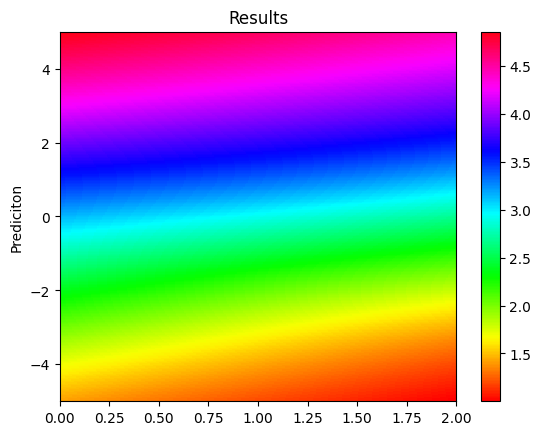

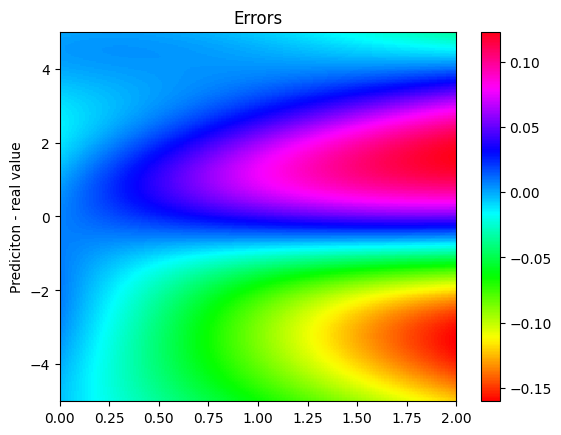


 m =  0.225 

 ####################################################


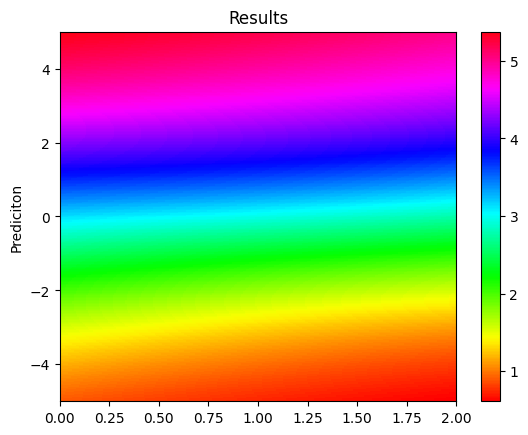

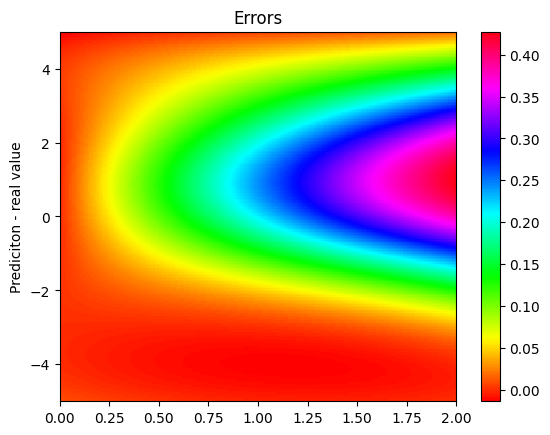


 m =  0.30000000000000004 

 ####################################################


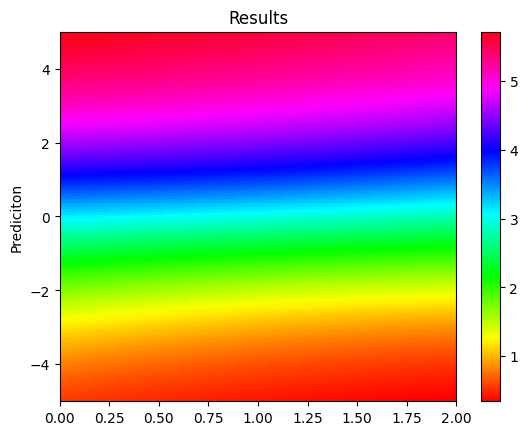

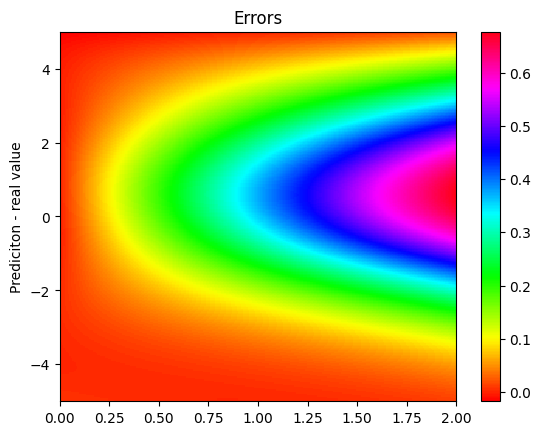


 m =  0.375 

 ####################################################


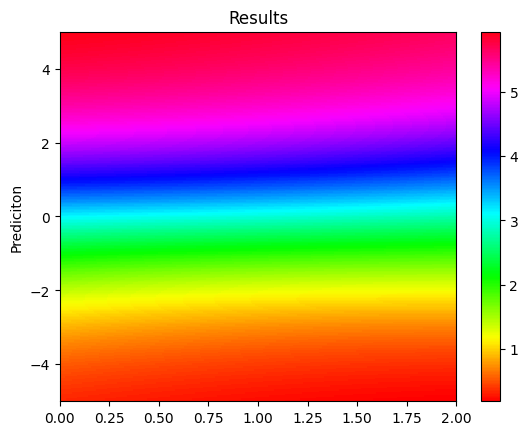

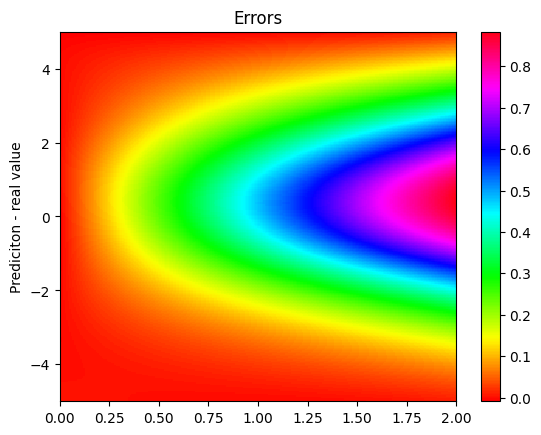


 m =  0.45 

 ####################################################


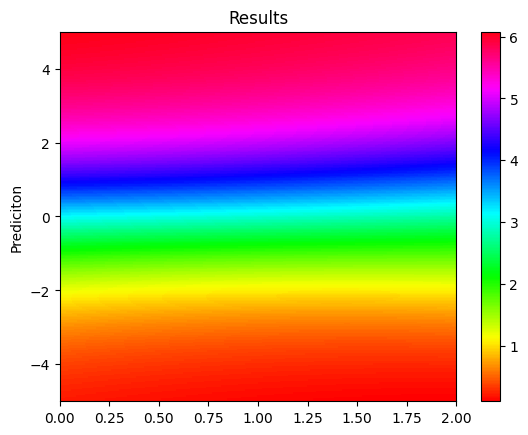

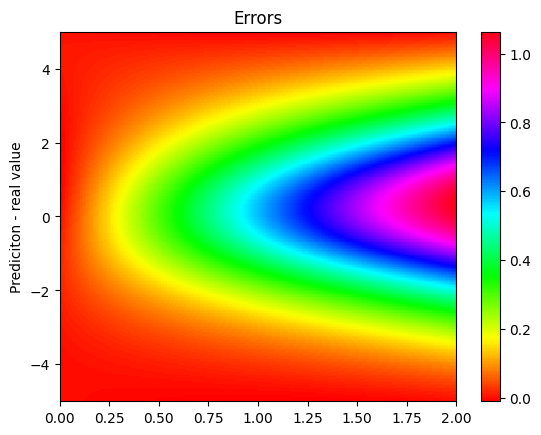

L2:  0.06993256 at variation:  15 ,  45 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256]  at identifier:  12 

Compiling model...
Building feed-forward neural network...
'build' took 0.156426 s

'compile' took 5.254241 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.29e-04, 1.26e+01, 2.82e+01, 7.69e-01]    [3.29e-04, 1.26e+01, 2.82e+01, 7.69e-01]    [9.87e-01]    
1000      [5.62e-04, 1.36e-03, 6.19e-05, 2.44e-04]    [5.62e-04, 1.36e-03, 6.19e-05, 2.44e-04]    [7.33e-02]    
2000      [3.54e-04, 1.01e-03, 1.08e-04, 8.75e-05]    [3.54e-04, 1.01e-03, 1.08e-04, 8.75e-05]    [7.74e-02]    
3000      [2.93e-04, 1.61e-03, 1.40e-03, 6.47e-04]    [2.93e-04, 1.61e-03, 1.40e-03, 6.47e-04]    [7.71e-02]    
4000      [2.26e-04, 8.16e-04, 1.25e-05, 1.89e-05]    [2.26e-04, 8.16e-04, 1.25e-05, 1.89e-05]    [8.16e-02

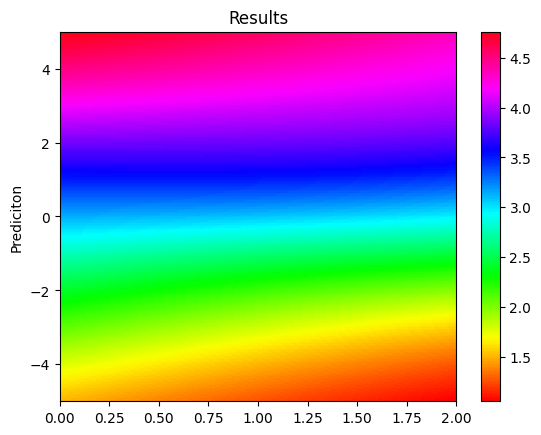

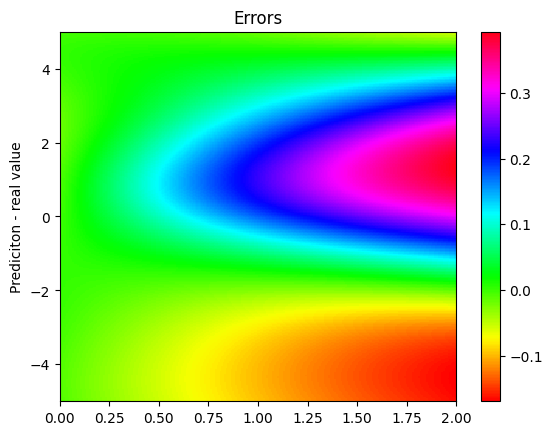


 m =  0.22000000000000003 

 ####################################################


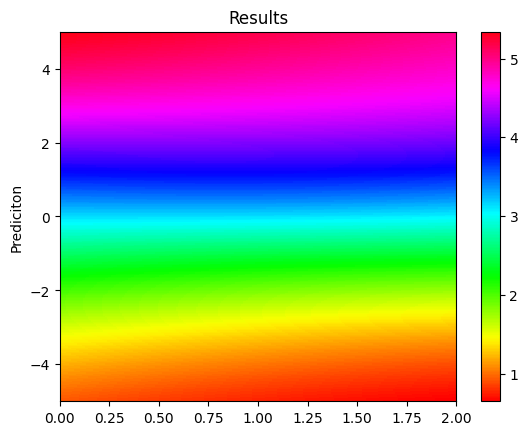

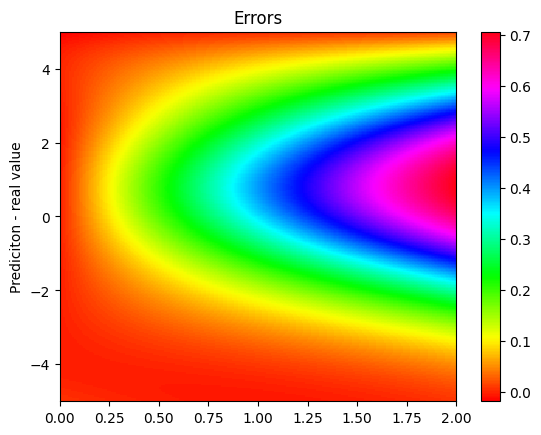


 m =  0.30000000000000004 

 ####################################################


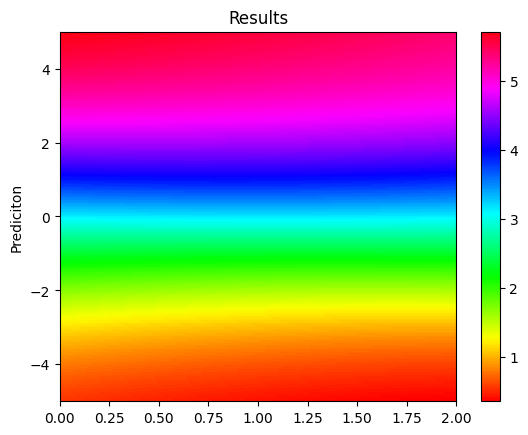

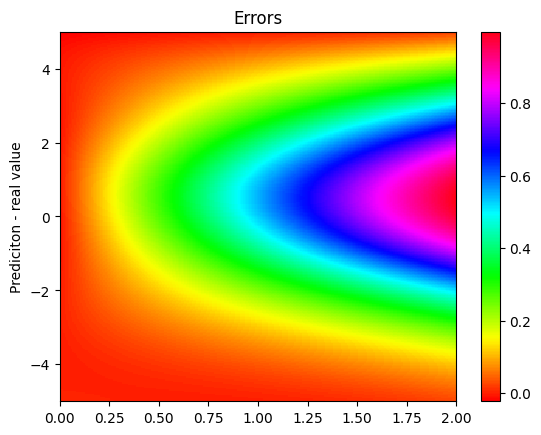


 m =  0.38 

 ####################################################


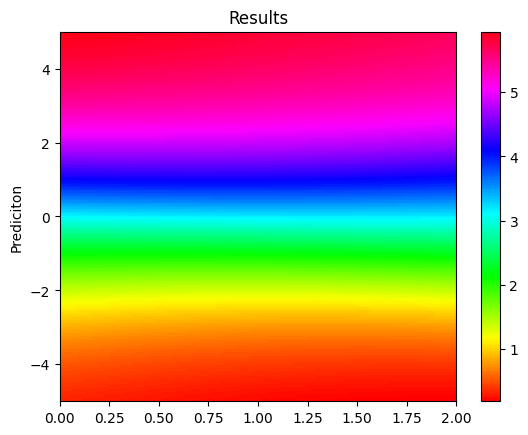

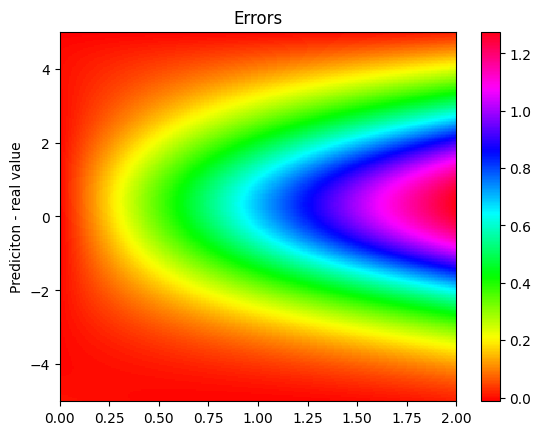


 m =  0.46 

 ####################################################


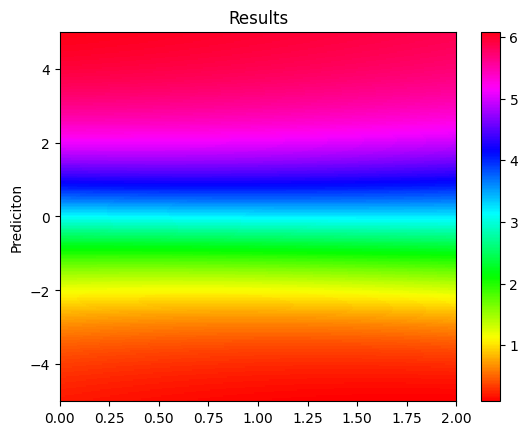

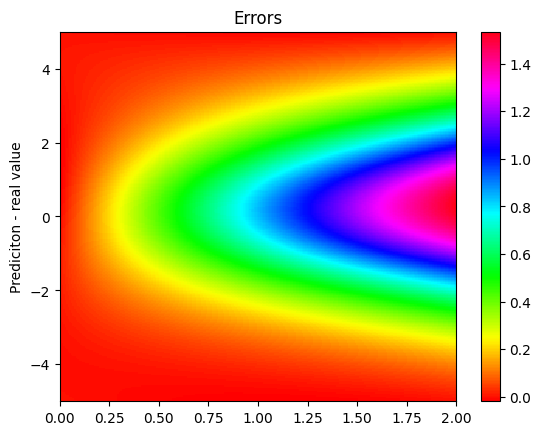

L2:  0.09809513 at variation:  14 ,  46 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513]  at identifier:  13 

Compiling model...
Building feed-forward neural network...
'build' took 0.150256 s

'compile' took 2.422522 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.03e-03, 1.38e+01, 3.35e+01, 2.47e-01]    [2.03e-03, 1.38e+01, 3.35e+01, 2.47e-01]    [1.03e+00]    
1000      [7.75e-04, 1.68e-03, 7.94e-05, 1.54e-04]    [7.75e-04, 1.68e-03, 7.94e-05, 1.54e-04]    [7.13e-02]    
2000      [4.92e-04, 6.40e-03, 5.46e-03, 7.95e-03]    [4.92e-04, 6.40e-03, 5.46e-03, 7.95e-03]    [7.74e-02]    
3000      [3.32e-04, 1.22e-03, 1.56e-04, 4.97e-04]    [3.32e-04, 1.22e-03, 1.56e-04, 4.97e-04]    [6.71e-02]    
4000      [2.76e-04, 9.99e-04, 7.54e-05, 1.03e-05]    [2.76e-04, 9.99e-04, 7.54e-05, 1.03e-05]  

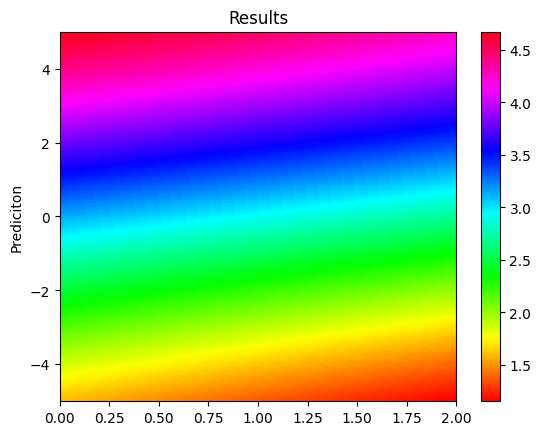

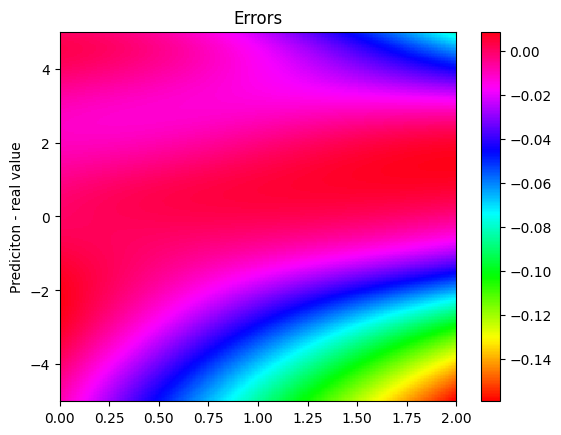


 m =  0.215 

 ####################################################


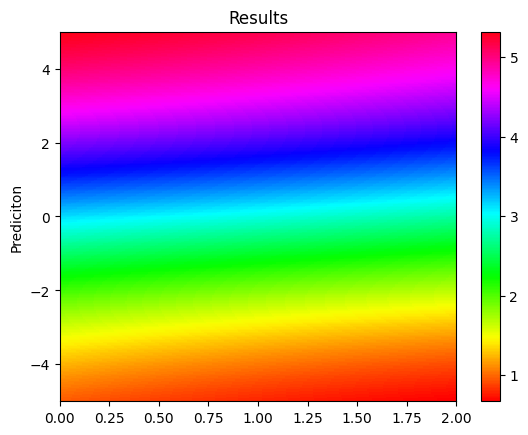

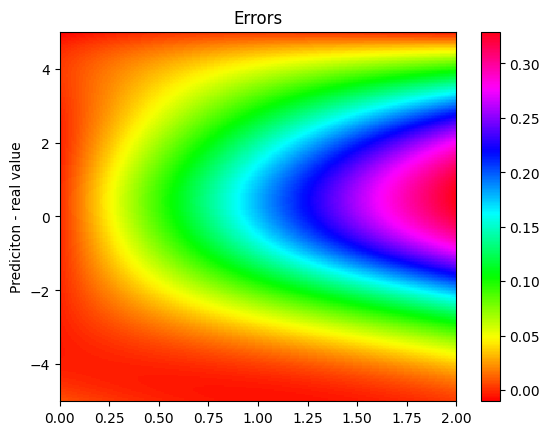


 m =  0.3 

 ####################################################


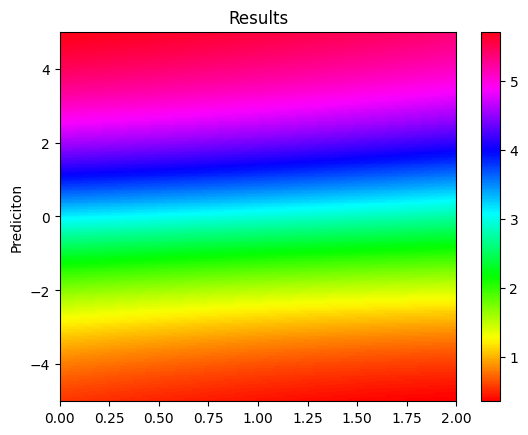

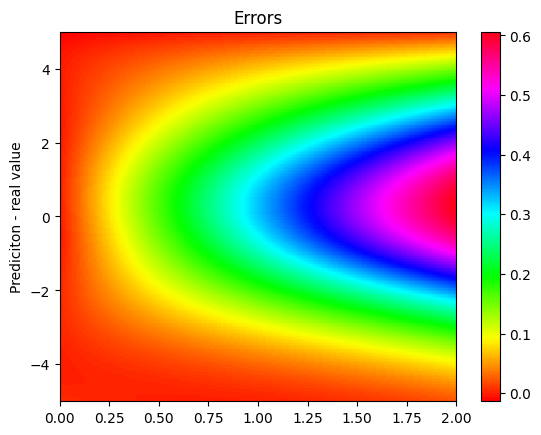


 m =  0.385 

 ####################################################


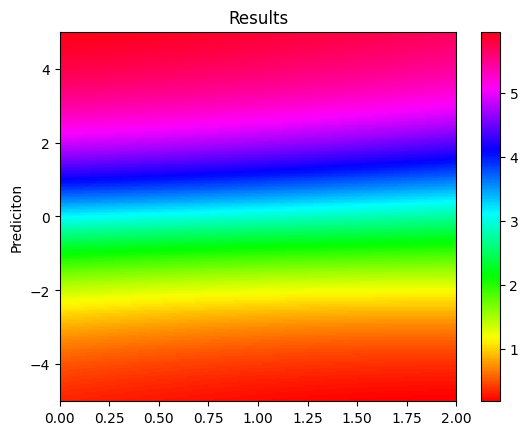

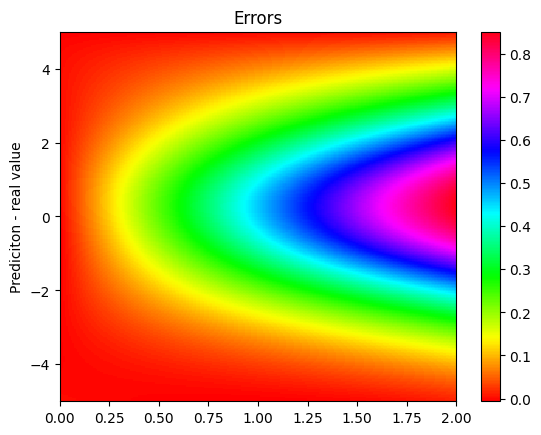


 m =  0.47 

 ####################################################


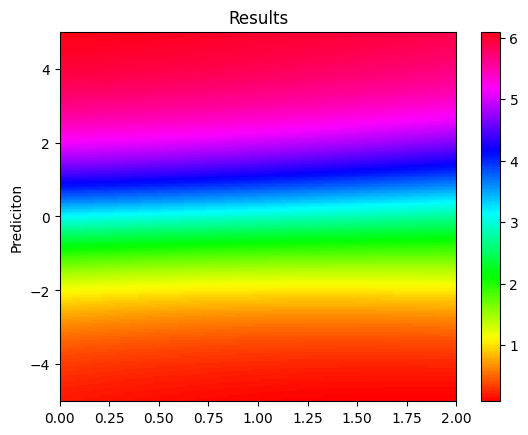

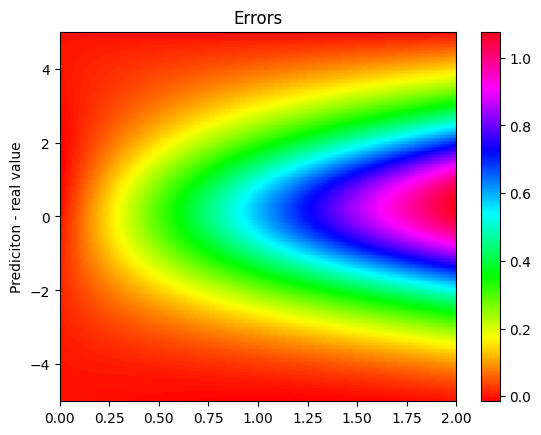

L2:  0.07051634 at variation:  13 ,  47 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634]  at identifier:  14 

Compiling model...
Building feed-forward neural network...
'build' took 0.108903 s

'compile' took 1.762040 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.27e-03, 1.40e+01, 3.35e+01, 2.80e-01]    [1.27e-03, 1.40e+01, 3.35e+01, 2.80e-01]    [1.04e+00]    
1000      [7.19e-04, 1.97e-03, 9.86e-05, 2.59e-04]    [7.19e-04, 1.97e-03, 9.86e-05, 2.59e-04]    [6.51e-02]    
2000      [4.85e-04, 1.37e-03, 8.29e-05, 6.09e-05]    [4.85e-04, 1.37e-03, 8.29e-05, 6.09e-05]    [6.05e-02]    
3000      [4.02e-04, 1.37e-03, 4.22e-04, 9.26e-05]    [4.02e-04, 1.37e-03, 4.22e-04, 9.26e-05]    [5.74e-02]    
4000      [3.06e-04, 1.49e-03, 1.38e-03, 4.60e-04]    [3.06e-04, 1.49e-03, 1.38e-03,

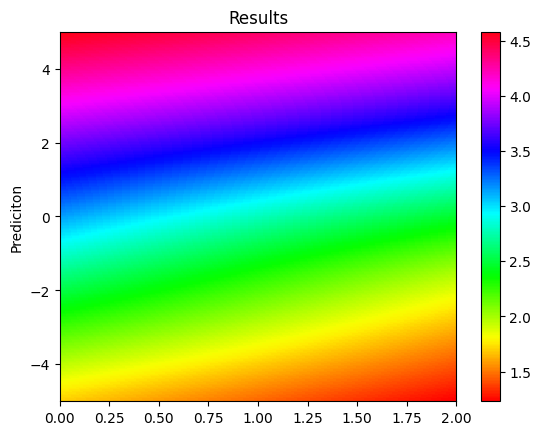

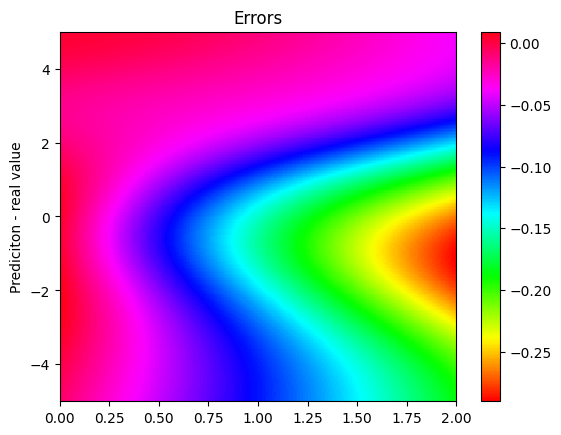


 m =  0.21 

 ####################################################


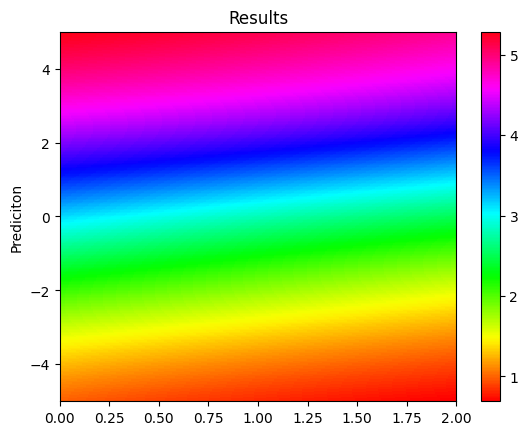

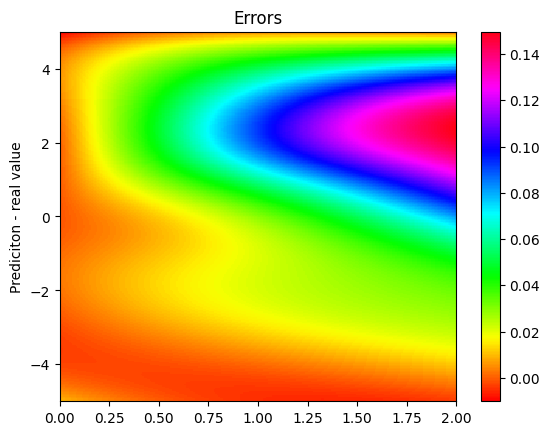


 m =  0.3 

 ####################################################


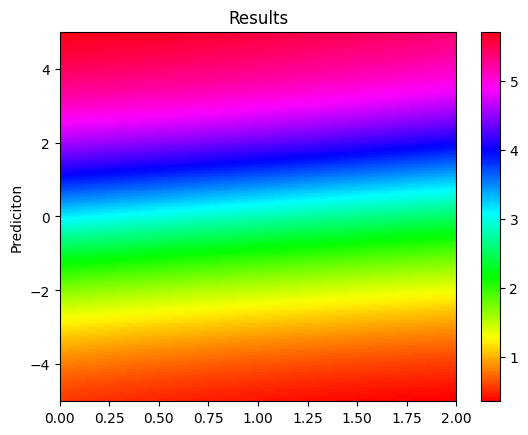

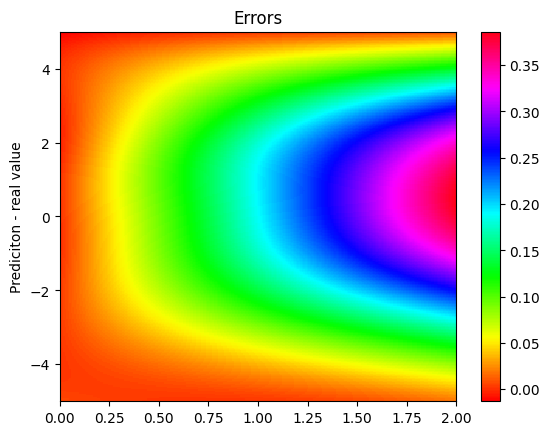


 m =  0.39 

 ####################################################


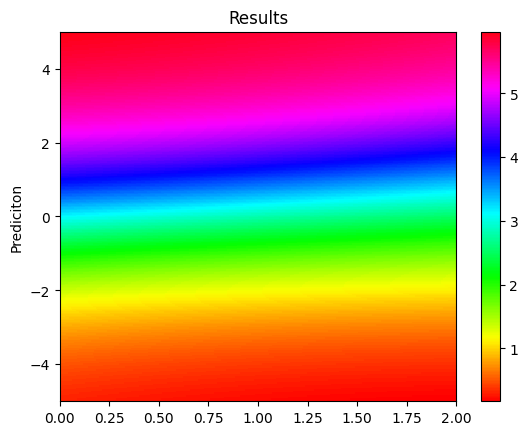

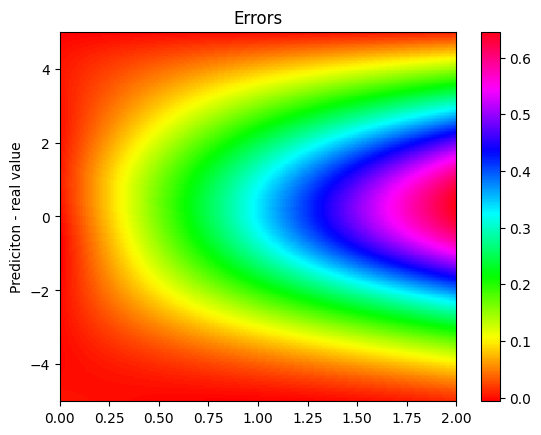


 m =  0.48 

 ####################################################


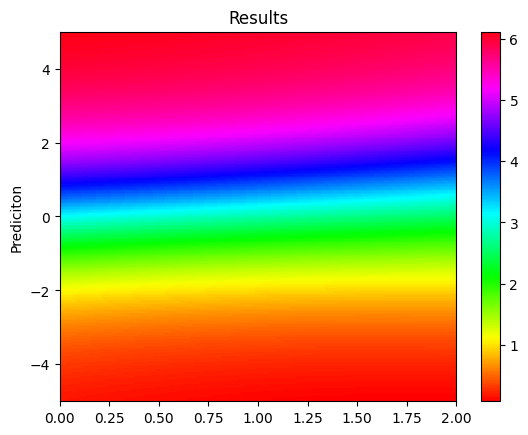

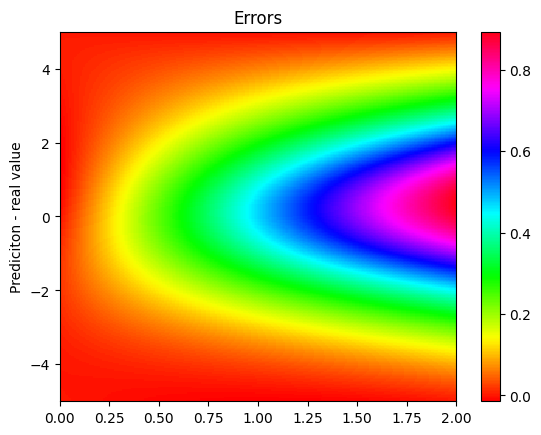

L2:  0.06758372 at variation:  12 ,  48 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634 0.06758372]  at identifier:  15 

Compiling model...
Building feed-forward neural network...
'build' took 0.144950 s

'compile' took 2.143832 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.64e-04, 1.26e+01, 3.04e+01, 5.37e-01]    [3.64e-04, 1.26e+01, 3.04e+01, 5.37e-01]    [1.01e+00]    
1000      [7.08e-04, 1.75e-03, 1.38e-04, 1.55e-04]    [7.08e-04, 1.75e-03, 1.38e-04, 1.55e-04]    [6.67e-02]    
2000      [4.31e-04, 1.39e-03, 1.25e-04, 3.65e-05]    [4.31e-04, 1.39e-03, 1.25e-04, 3.65e-05]    [7.65e-02]    
3000      [3.15e-04, 2.88e-03, 4.20e-03, 9.41e-04]    [3.15e-04, 2.88e-03, 4.20e-03, 9.41e-04]    [8.93e-02]    
4000      [2.27e-04, 8.14e-04, 7.02e-06, 3.21e-05]    [2.27e-04, 8.14e-04

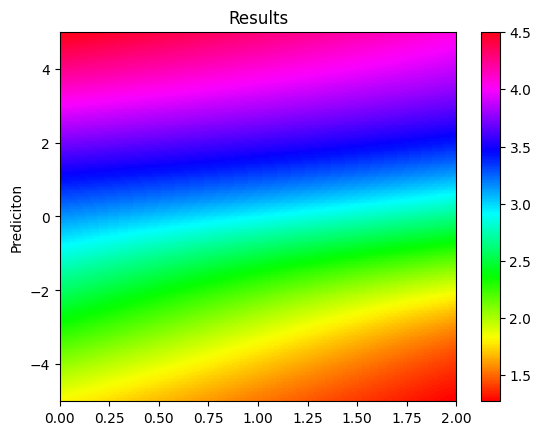

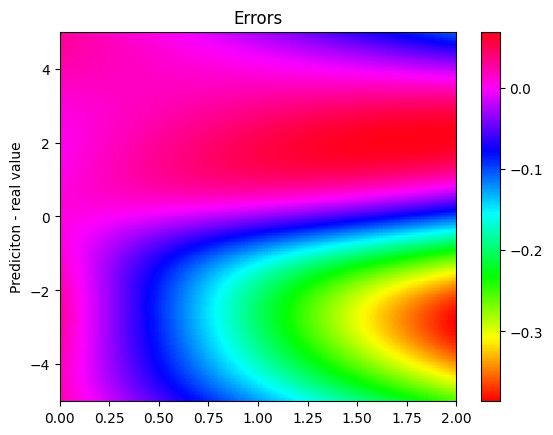


 m =  0.20500000000000002 

 ####################################################


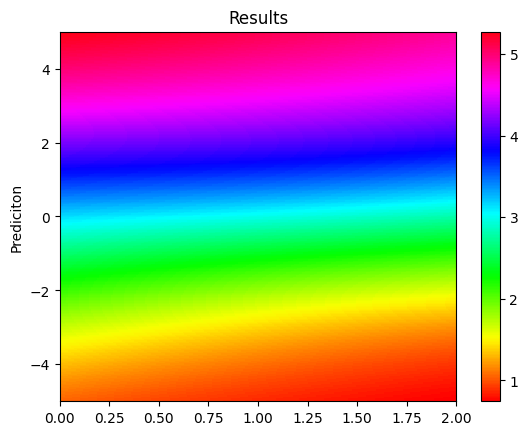

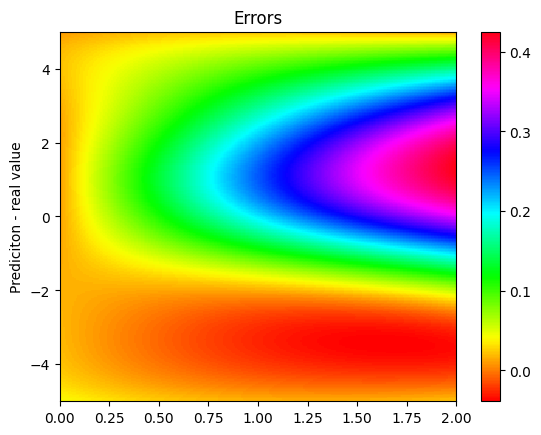


 m =  0.3 

 ####################################################


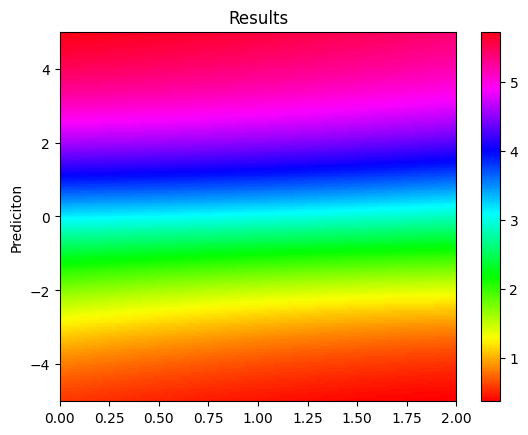

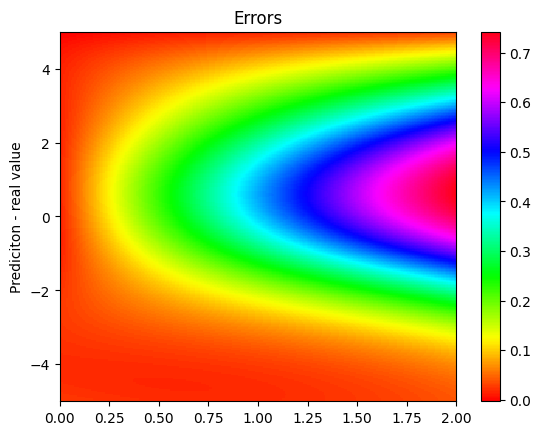


 m =  0.395 

 ####################################################


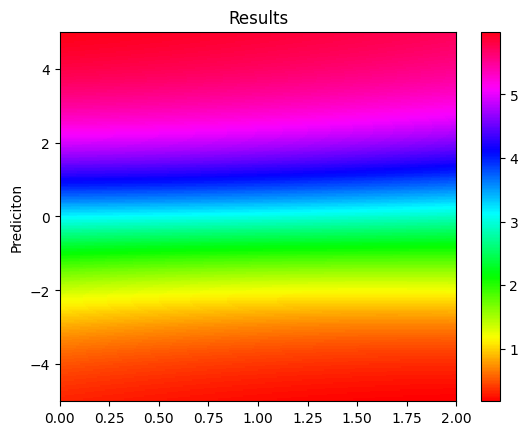

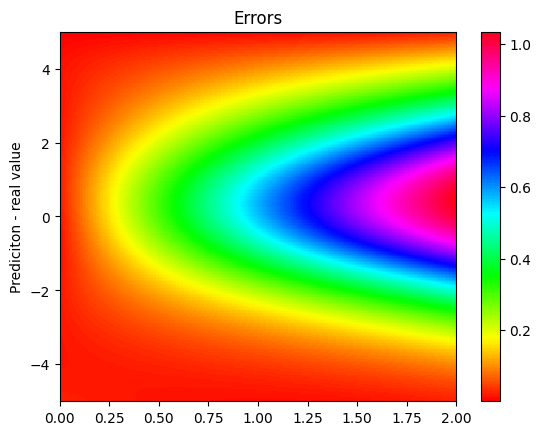


 m =  0.49 

 ####################################################


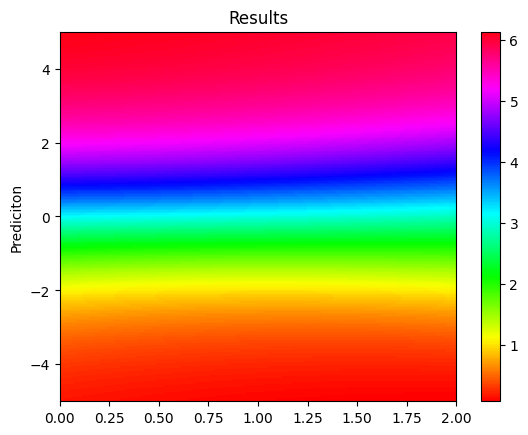

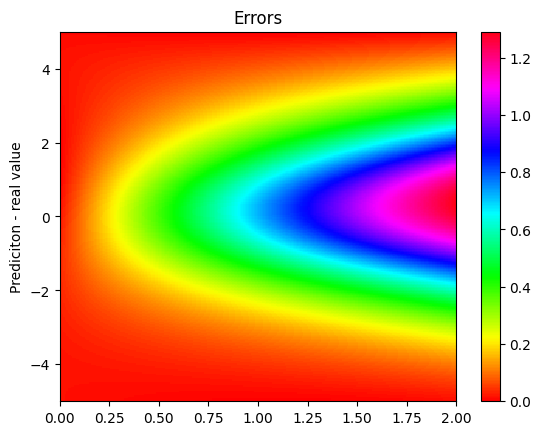

L2:  0.089211255 at variation:  11 ,  49 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634 0.06758372 0.08921126]  at identifier:  16 

Compiling model...
Building feed-forward neural network...
'build' took 0.101581 s

'compile' took 1.725895 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.09e-03, 1.35e+01, 3.33e+01, 3.27e-01]    [1.09e-03, 1.35e+01, 3.33e+01, 3.27e-01]    [1.03e+00]    
1000      [6.82e-04, 1.97e-03, 6.00e-05, 6.67e-05]    [6.82e-04, 1.97e-03, 6.00e-05, 6.67e-05]    [7.69e-02]    
2000      [5.14e-04, 1.83e-03, 4.84e-04, 2.59e-04]    [5.14e-04, 1.83e-03, 4.84e-04, 2.59e-04]    [8.47e-02]    
3000      [3.72e-04, 2.07e-03, 5.99e-04, 1.45e-03]    [3.72e-04, 2.07e-03, 5.99e-04, 1.45e-03]    [8.85e-02]    
4000      [2.71e-04, 1.03e-03, 3.93e-06, 2.84e-05]    [2.71e-

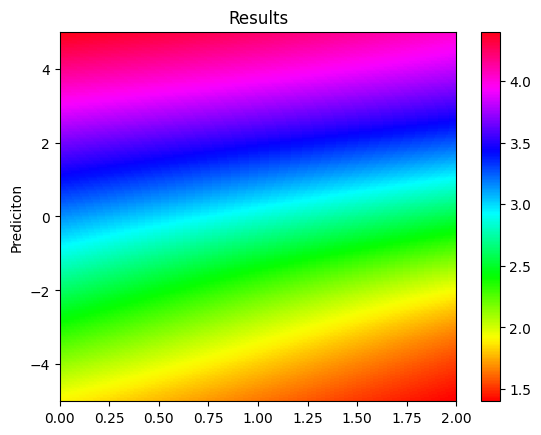

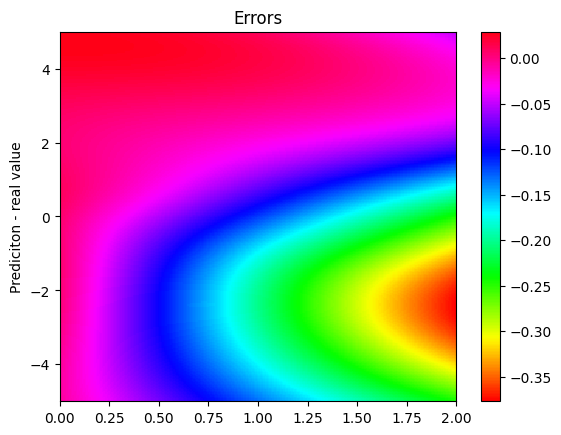


 m =  0.2 

 ####################################################


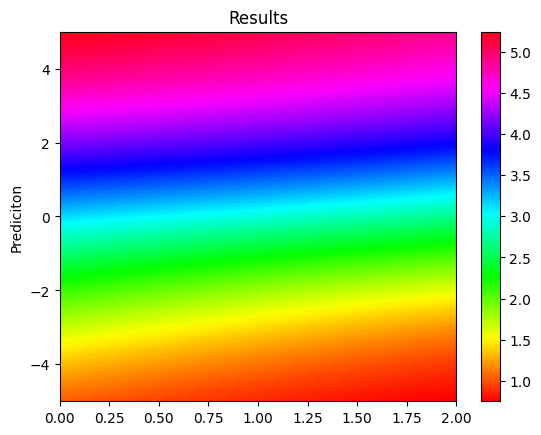

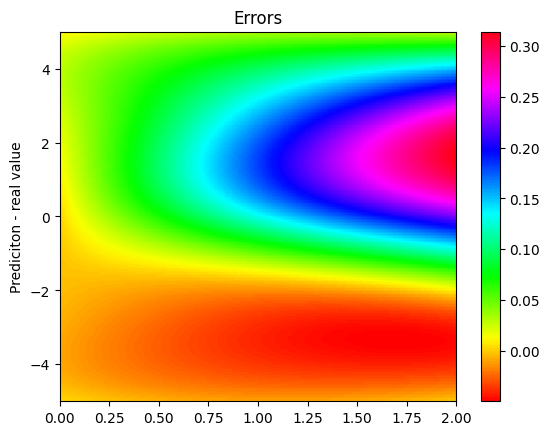


 m =  0.30000000000000004 

 ####################################################


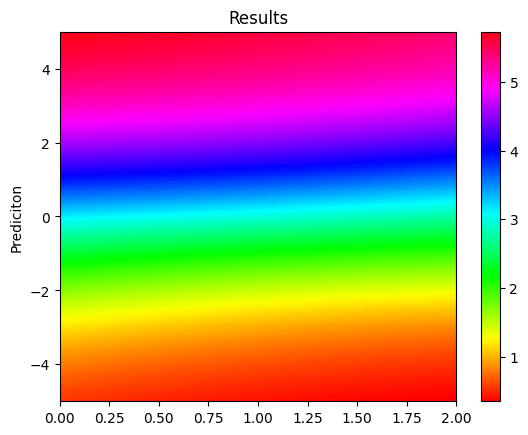

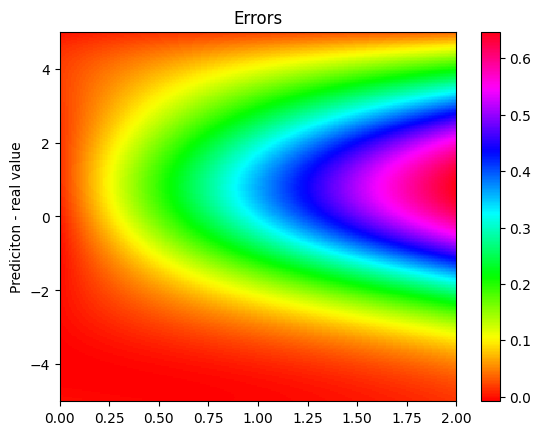


 m =  0.4 

 ####################################################


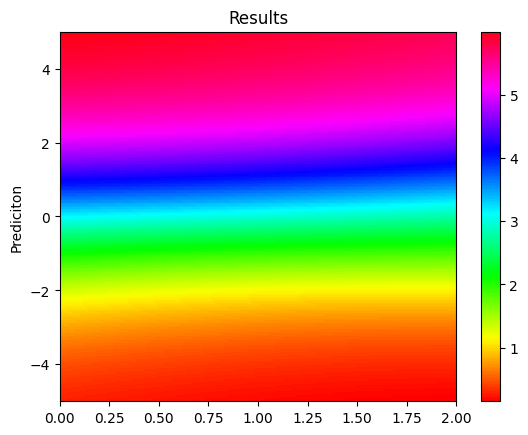

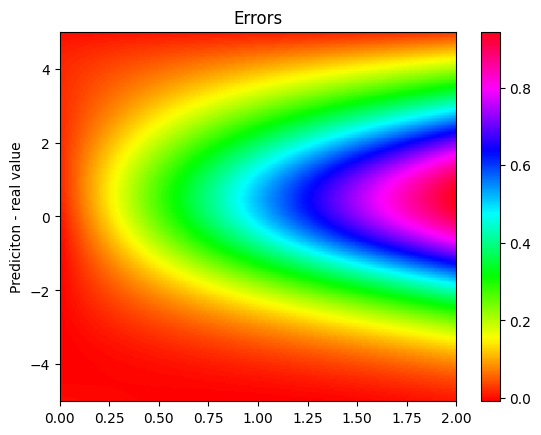


 m =  0.5 

 ####################################################


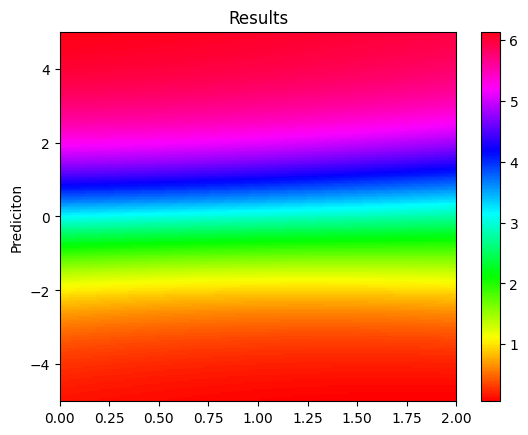

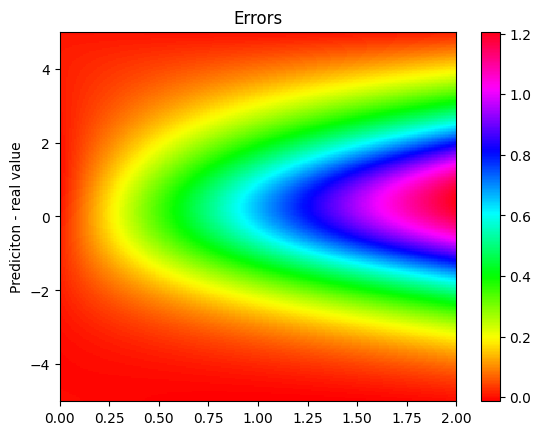

L2:  0.078502364 at variation:  10 ,  50 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634 0.06758372 0.08921126 0.07850236]  at identifier:  17 

Compiling model...
Building feed-forward neural network...
'build' took 0.117774 s

'compile' took 1.761963 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.63e-04, 1.28e+01, 3.12e+01, 6.05e-01]    [2.63e-04, 1.28e+01, 3.12e+01, 6.05e-01]    [1.02e+00]    
1000      [8.58e-04, 2.89e-03, 1.40e-04, 2.42e-04]    [8.58e-04, 2.89e-03, 1.40e-04, 2.42e-04]    [7.11e-02]    
2000      [6.62e-04, 2.22e-03, 5.91e-05, 6.99e-05]    [6.62e-04, 2.22e-03, 5.91e-05, 6.99e-05]    [8.49e-02]    
3000      [5.83e-04, 3.00e-03, 1.95e-03, 7.46e-04]    [5.83e-04, 3.00e-03, 1.95e-03, 7.46e-04]    [8.68e-02]    
4000      [3.68e-04, 1.31e-03, 3.99e-05, 1.15e-04]

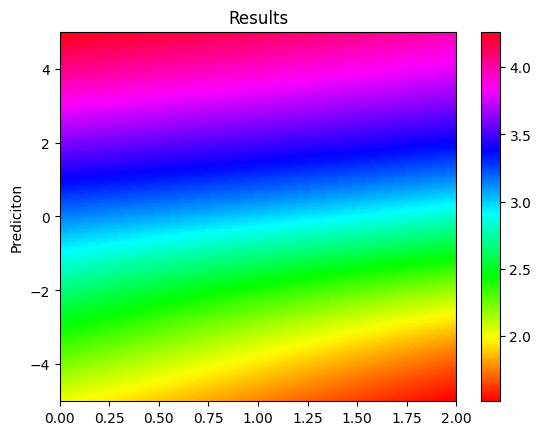

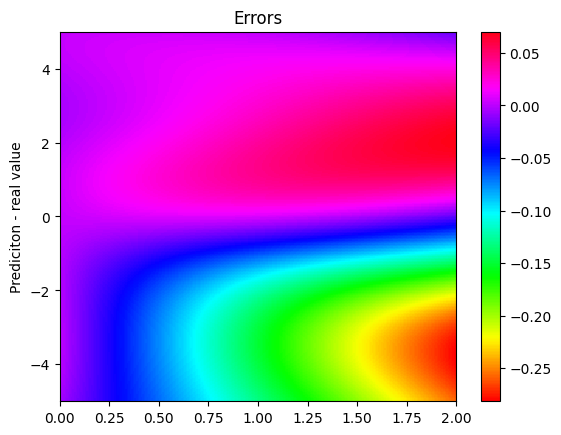


 m =  0.195 

 ####################################################


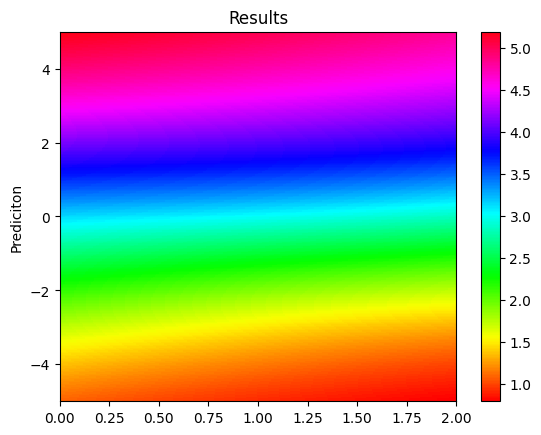

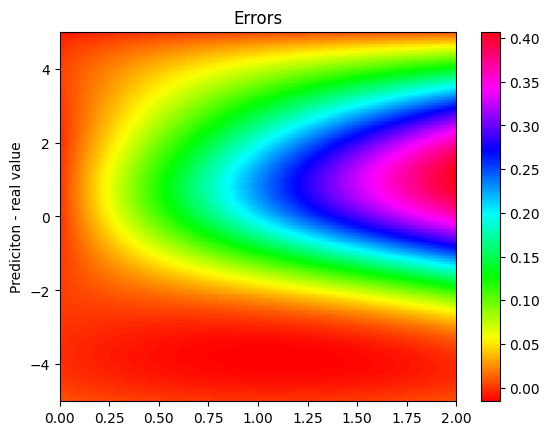


 m =  0.30000000000000004 

 ####################################################


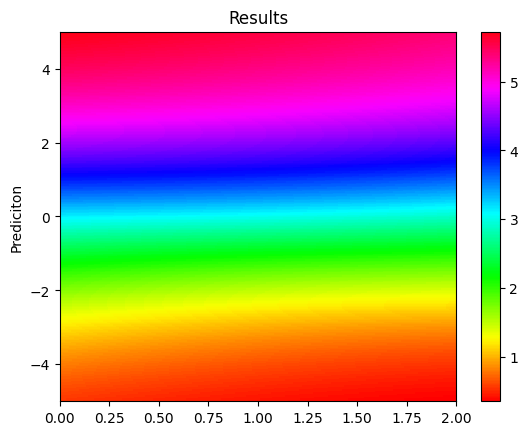

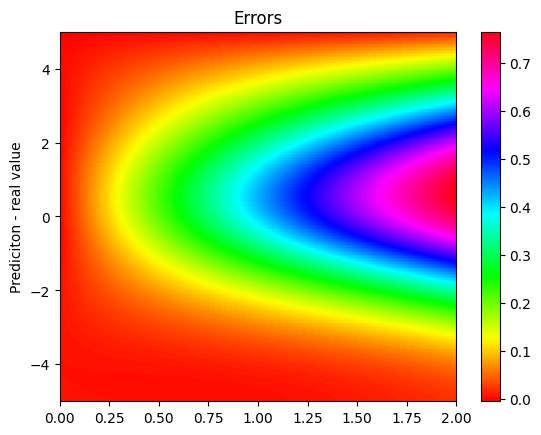


 m =  0.405 

 ####################################################


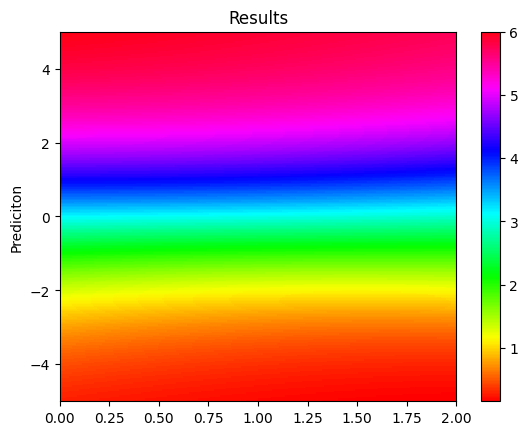

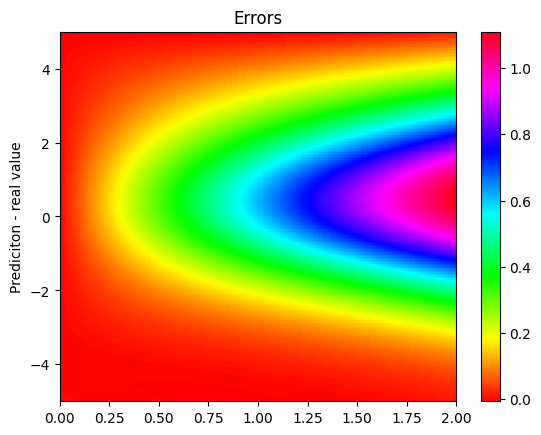


 m =  0.51 

 ####################################################


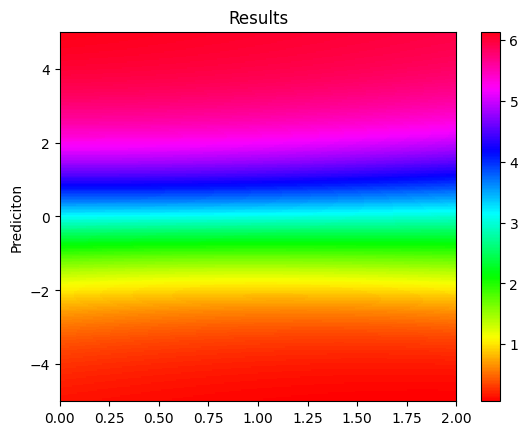

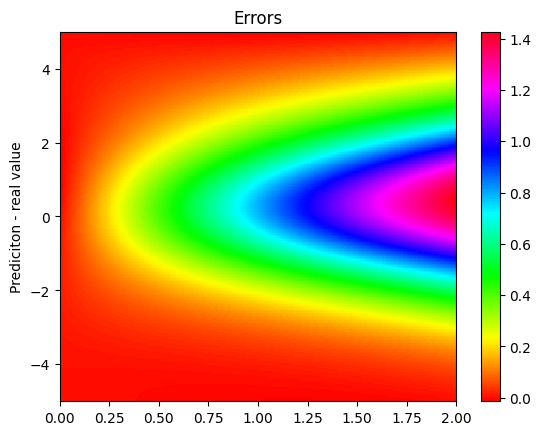

L2:  0.079702206 at variation:  9 ,  51 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634 0.06758372 0.08921126 0.07850236 0.07970221]  at identifier:  18 

Compiling model...
Building feed-forward neural network...
'build' took 0.123493 s

'compile' took 1.885652 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.80e-03, 1.21e+01, 2.57e+01, 1.80e+00]    [1.80e-03, 1.21e+01, 2.57e+01, 1.80e+00]    [9.82e-01]    
1000      [9.46e-04, 3.06e-03, 1.58e-04, 1.26e-04]    [9.46e-04, 3.06e-03, 1.58e-04, 1.26e-04]    [7.72e-02]    
2000      [9.58e-04, 1.17e-02, 1.36e-02, 1.57e-02]    [9.58e-04, 1.17e-02, 1.36e-02, 1.57e-02]    [6.80e-02]    
3000      [5.56e-04, 2.19e-03, 8.24e-04, 4.71e-04]    [5.56e-04, 2.19e-03, 8.24e-04, 4.71e-04]    [7.12e-02]    
4000      [4.26e-04, 1.41e-03, 4.55e-05,

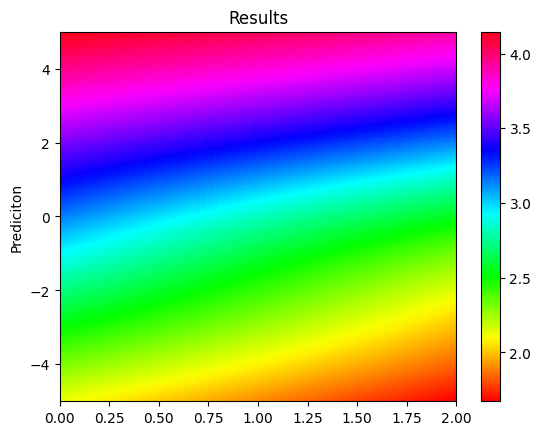

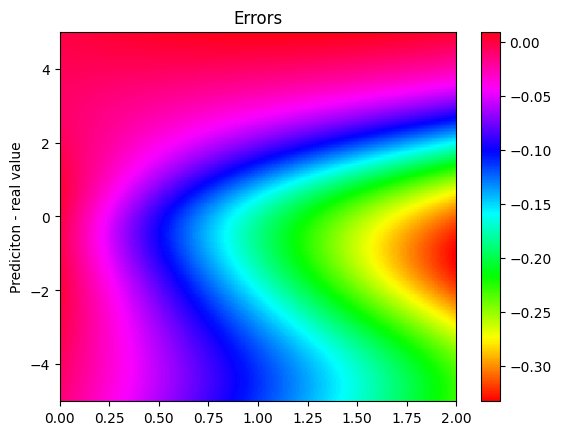


 m =  0.19 

 ####################################################


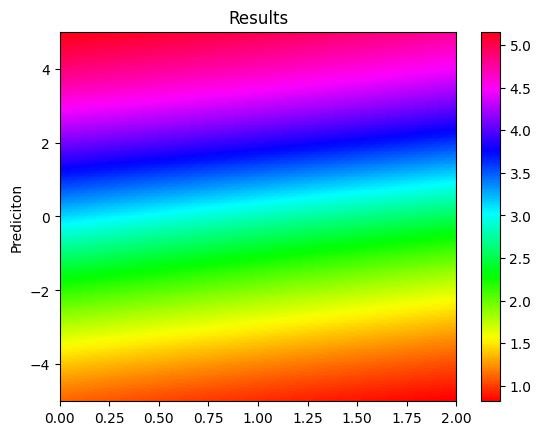

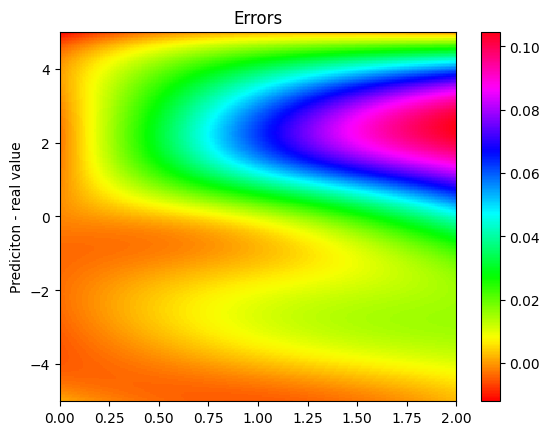


 m =  0.3 

 ####################################################


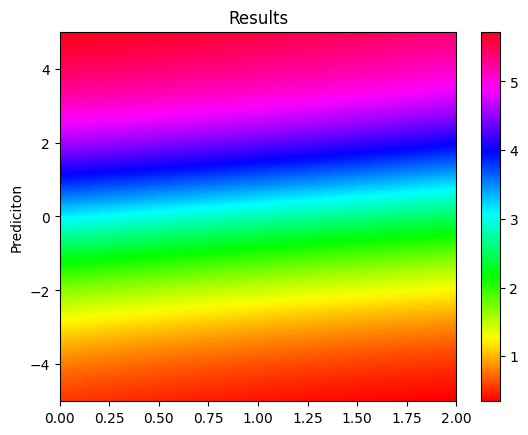

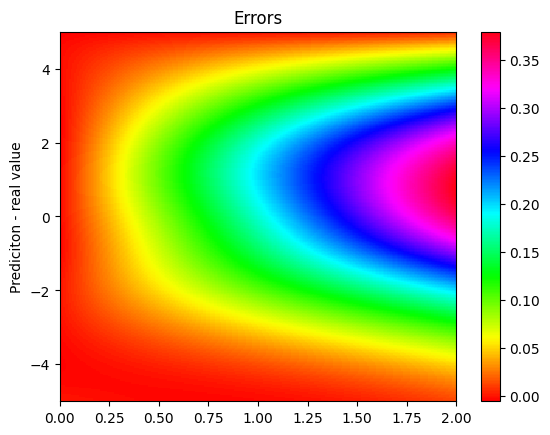


 m =  0.41000000000000003 

 ####################################################


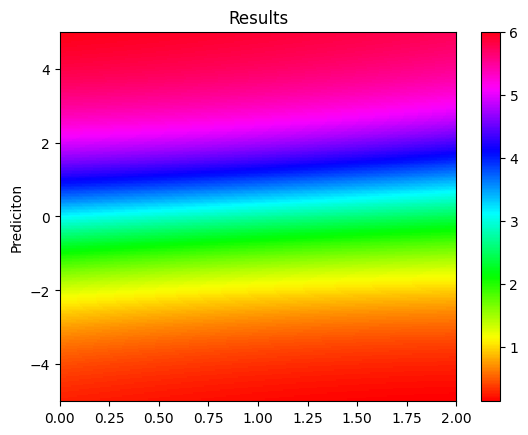

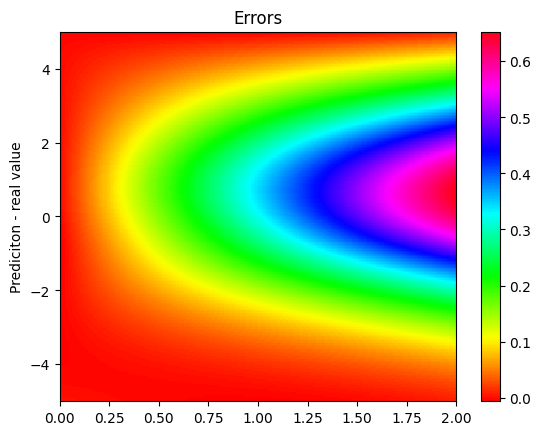


 m =  0.52 

 ####################################################


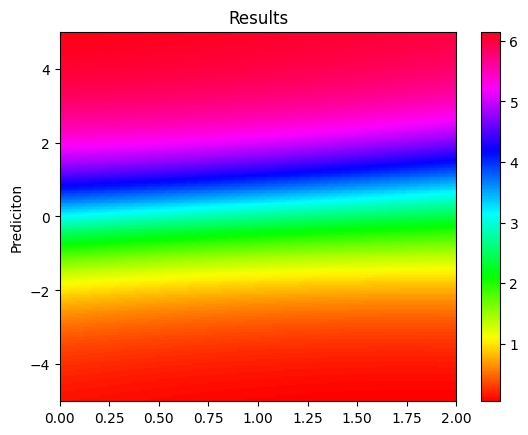

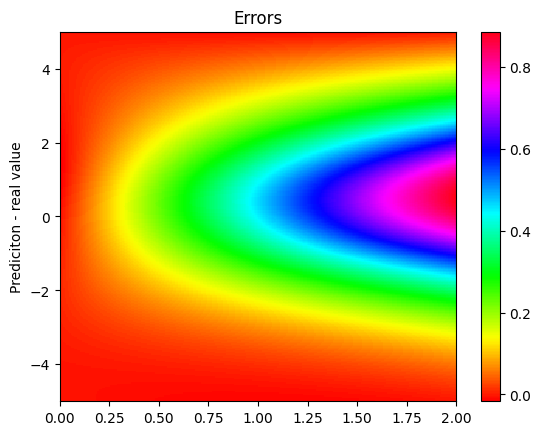

L2:  0.057362568 at variation:  8 ,  52 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634 0.06758372 0.08921126 0.07850236 0.07970221 0.05736257]  at identifier:  19 

Compiling model...
Building feed-forward neural network...
'build' took 0.105719 s

'compile' took 1.858165 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.71e-03, 1.20e+01, 2.60e+01, 1.32e+00]    [1.71e-03, 1.20e+01, 2.60e+01, 1.32e+00]    [9.65e-01]    
1000      [1.23e-03, 1.81e-02, 1.95e-02, 1.37e-02]    [1.23e-03, 1.81e-02, 1.95e-02, 1.37e-02]    [9.02e-02]    
2000      [5.80e-04, 2.28e-03, 3.27e-04, 2.32e-04]    [5.80e-04, 2.28e-03, 3.27e-04, 2.32e-04]    [7.04e-02]    
3000      [4.52e-04, 1.67e-03, 1.71e-05, 1.45e-04]    [4.52e-04, 1.67e-03, 1.71e-05, 1.45e-04]    [7.17e-02]    
4000      [3.16e-04, 1.76e-03

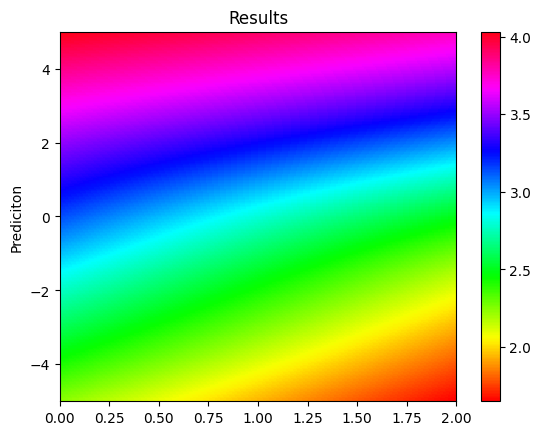

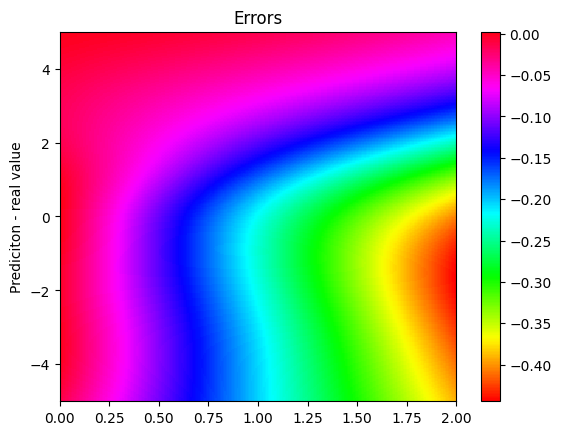


 m =  0.185 

 ####################################################


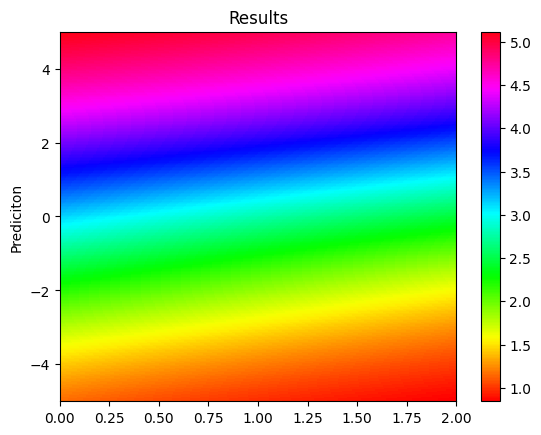

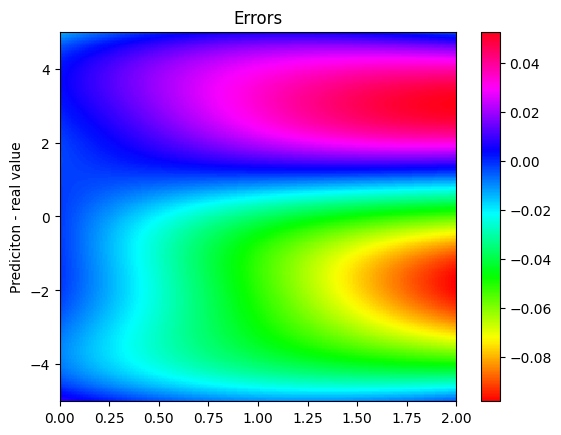


 m =  0.30000000000000004 

 ####################################################


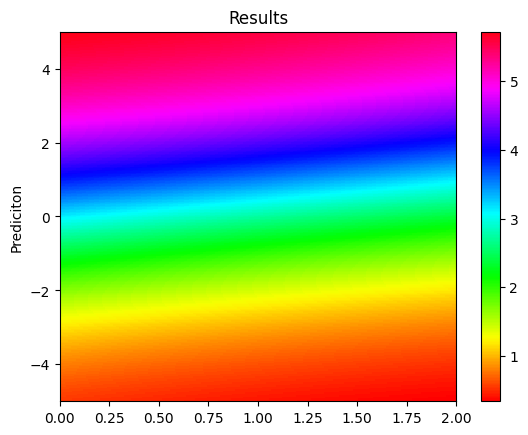

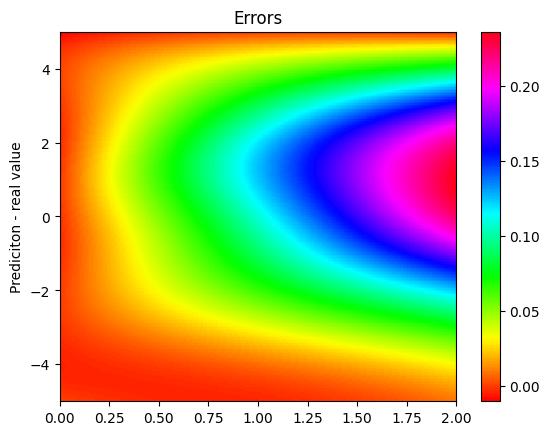


 m =  0.41500000000000004 

 ####################################################


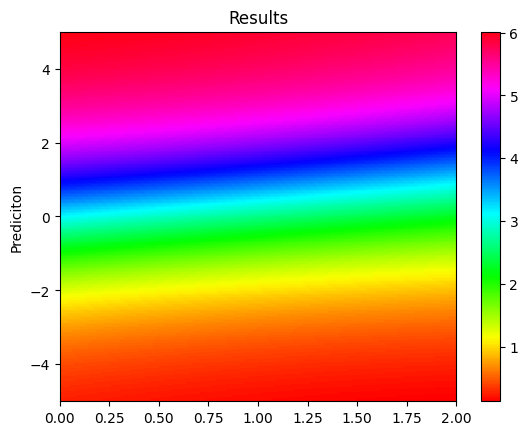

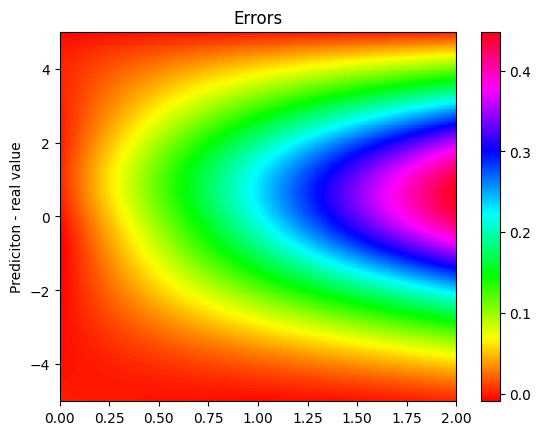


 m =  0.53 

 ####################################################


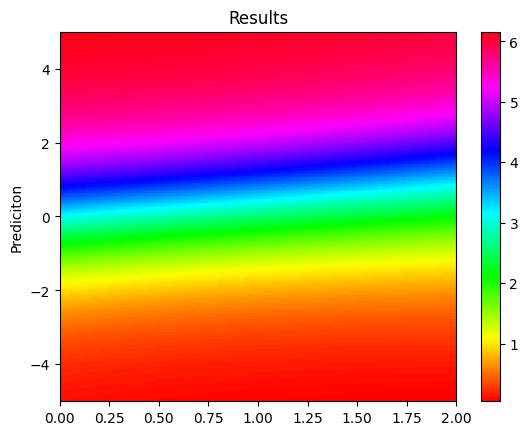

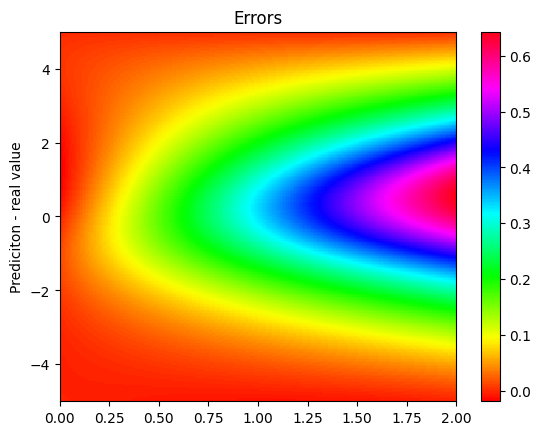

L2:  0.054831013 at variation:  7 ,  53 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634 0.06758372 0.08921126 0.07850236 0.07970221 0.05736257
 0.05483101]  at identifier:  20 

Compiling model...
Building feed-forward neural network...
'build' took 0.104226 s

'compile' took 2.046695 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.47e-03, 1.38e+01, 3.33e+01, 5.24e-01]    [2.47e-03, 1.38e+01, 3.33e+01, 5.24e-01]    [1.05e+00]    
1000      [1.19e-03, 3.97e-03, 1.31e-04, 1.43e-04]    [1.19e-03, 3.97e-03, 1.31e-04, 1.43e-04]    [7.93e-02]    
2000      [8.03e-04, 2.94e-03, 5.27e-05, 5.70e-05]    [8.03e-04, 2.94e-03, 5.27e-05, 5.70e-05]    [9.01e-02]    
3000      [6.29e-04, 2.22e-03, 5.08e-05, 1.71e-04]    [6.29e-04, 2.22e-03, 5.08e-05, 1.71e-04]    [9.36e-02]    
4000      [4.80e-

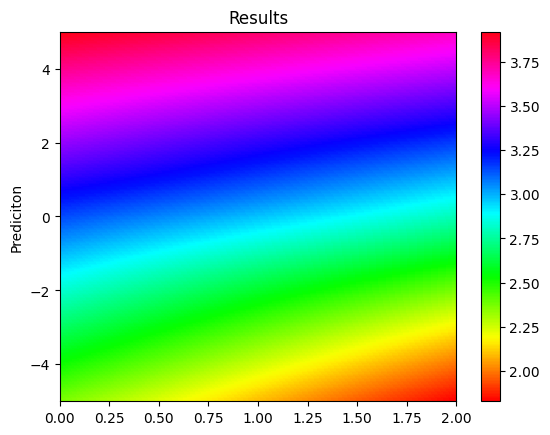

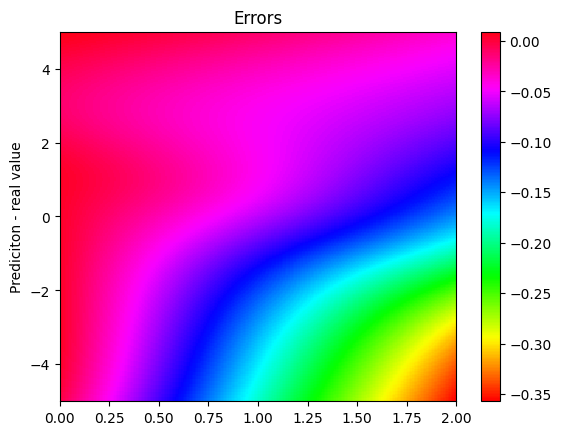


 m =  0.18 

 ####################################################


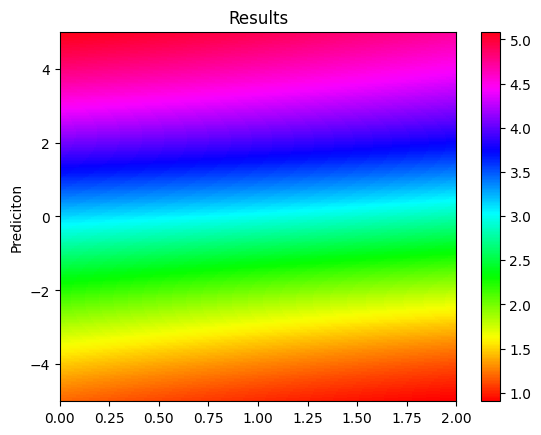

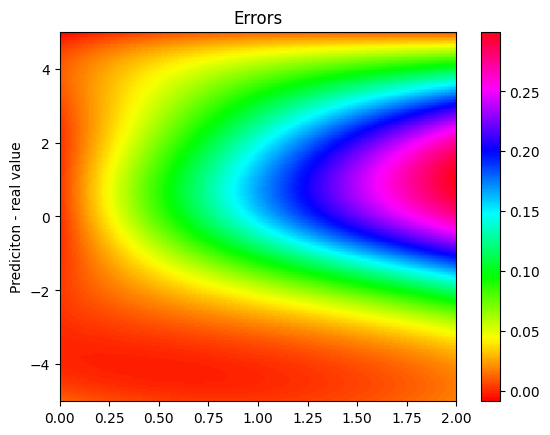


 m =  0.30000000000000004 

 ####################################################


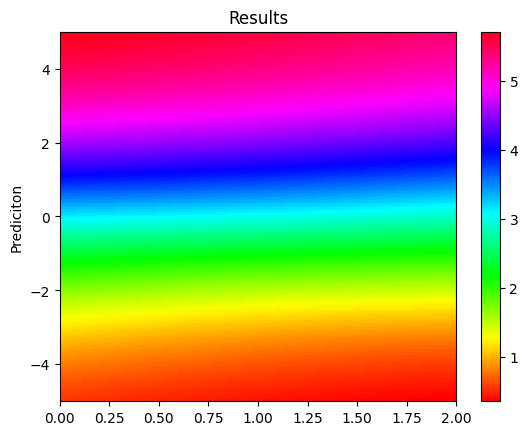

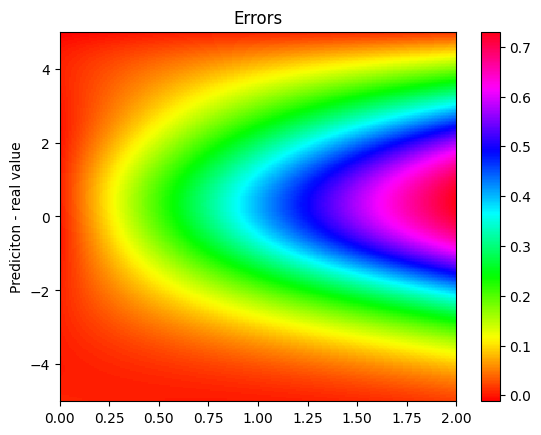


 m =  0.42000000000000004 

 ####################################################


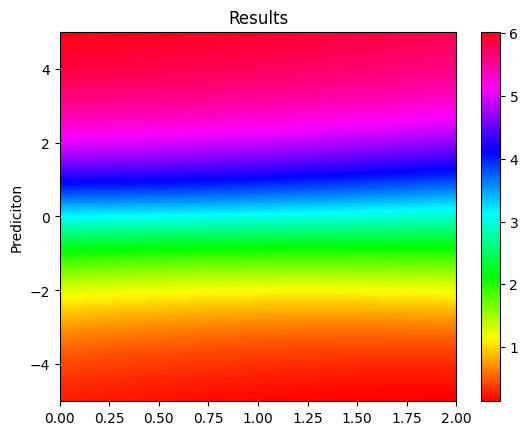

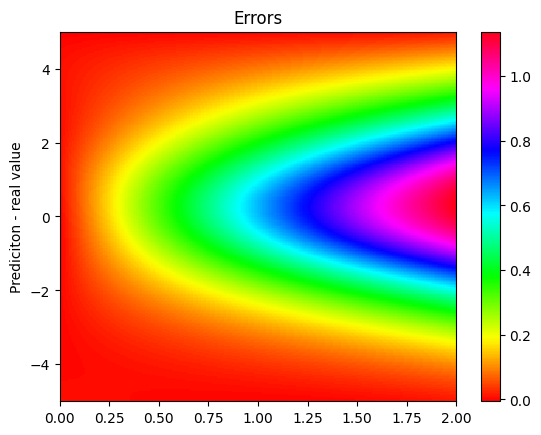


 m =  0.54 

 ####################################################


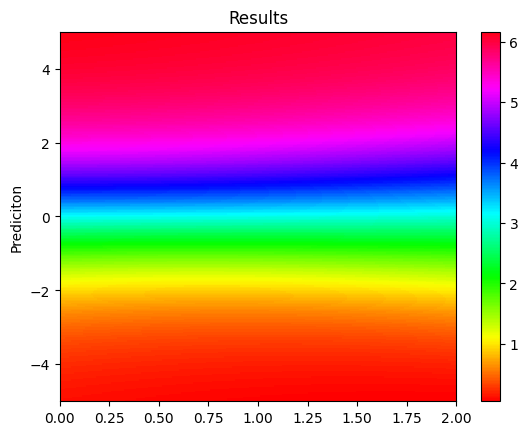

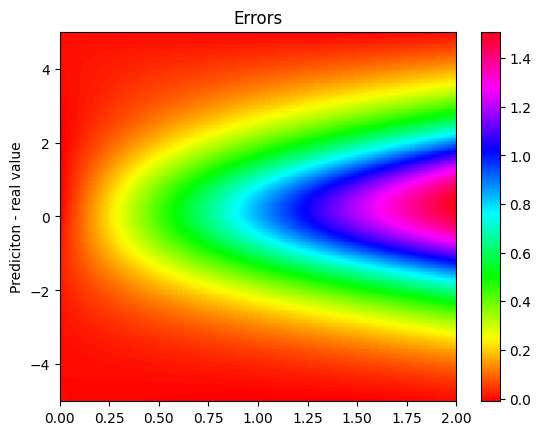

L2:  0.0879201 at variation:  6 ,  54 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634 0.06758372 0.08921126 0.07850236 0.07970221 0.05736257
 0.05483101 0.0879201 ]  at identifier:  21 

Compiling model...
Building feed-forward neural network...
'build' took 0.102821 s

'compile' took 2.884840 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.70e-04, 1.26e+01, 2.85e+01, 1.17e+00]    [3.70e-04, 1.26e+01, 2.85e+01, 1.17e+00]    [1.00e+00]    
1000      [1.14e-03, 3.98e-03, 8.93e-05, 8.75e-05]    [1.14e-03, 3.98e-03, 8.93e-05, 8.75e-05]    [7.52e-02]    
2000      [8.54e-04, 2.86e-03, 3.12e-05, 2.76e-05]    [8.54e-04, 2.86e-03, 3.12e-05, 2.76e-05]    [7.05e-02]    
3000      [6.19e-04, 2.12e-03, 1.70e-05, 2.96e-05]    [6.19e-04, 2.12e-03, 1.70e-05, 2.96e-05]    [6.76e-02]    
4000    

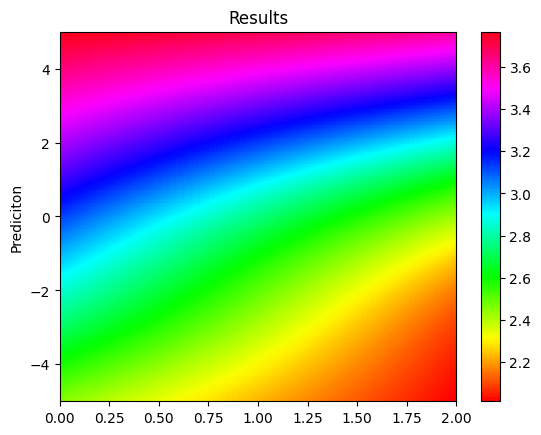

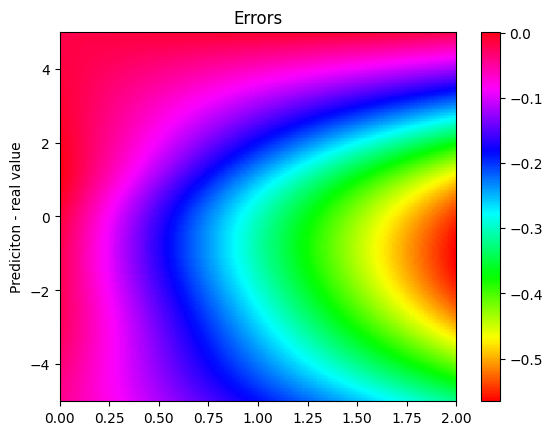


 m =  0.175 

 ####################################################


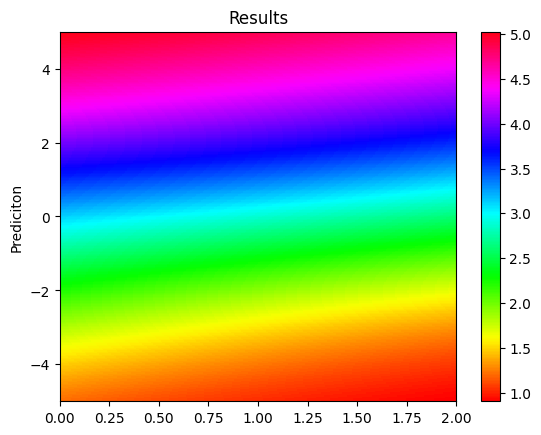

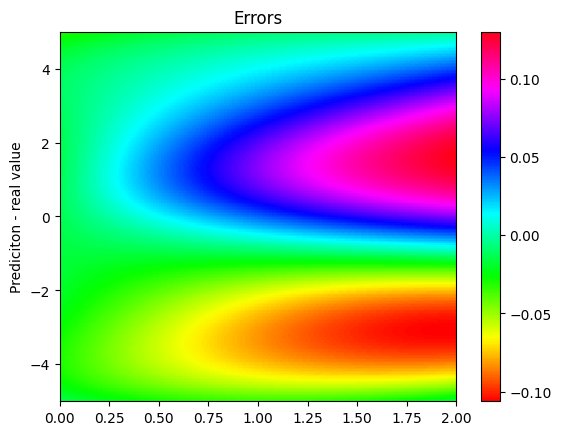


 m =  0.3 

 ####################################################


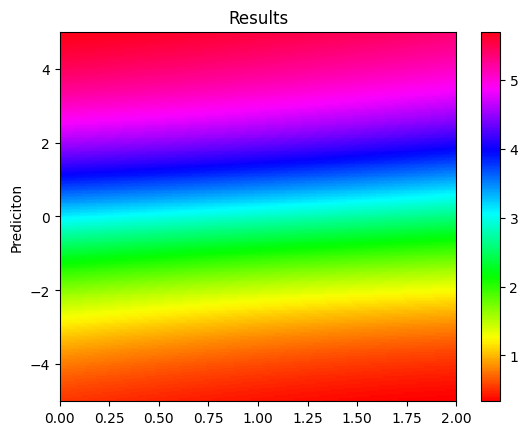

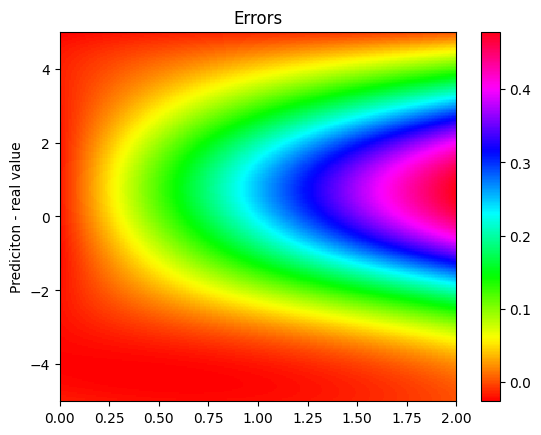


 m =  0.425 

 ####################################################


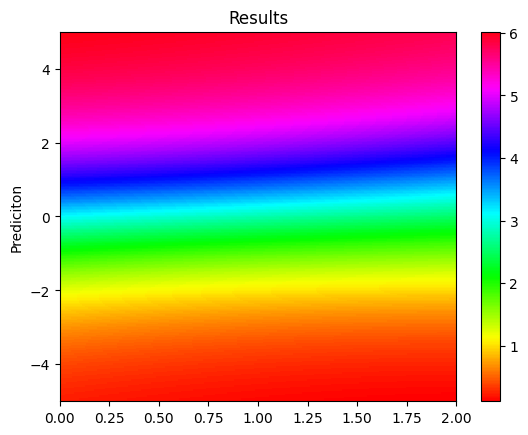

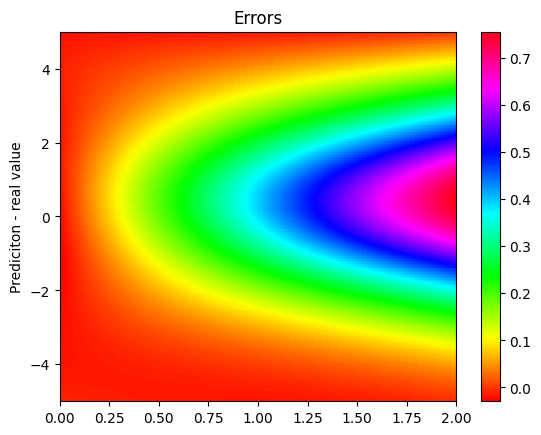


 m =  0.55 

 ####################################################


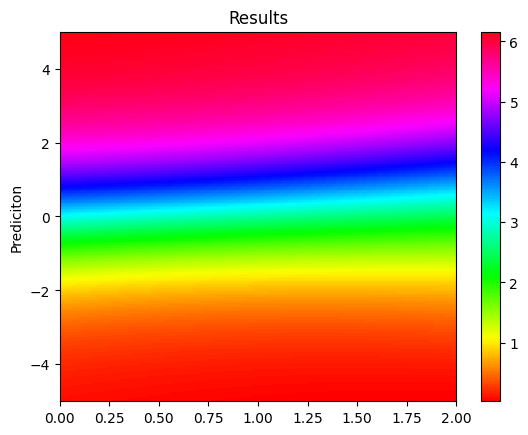

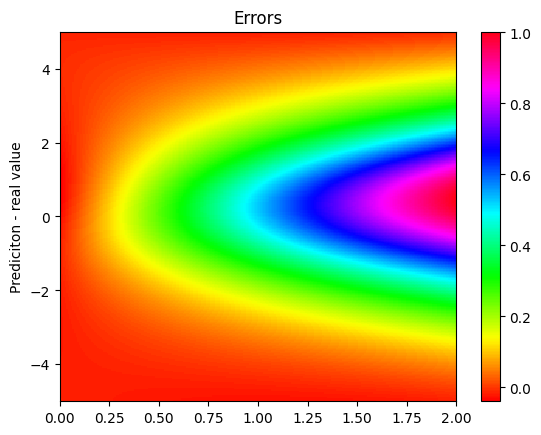

L2:  0.07603195 at variation:  5 ,  55 

L2_list=  [0.05155152 0.05042901 0.05060152 0.05597228 0.03927689 0.05889826
 0.06673191 0.07043135 0.06481729 0.07471923 0.06993256 0.09809513
 0.07051634 0.06758372 0.08921126 0.07850236 0.07970221 0.05736257
 0.05483101 0.0879201  0.07603195]  at identifier:  22 



In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

upper=45#centésimos
botton=15
identifier=11
#L2_list=np.array([])
#L2=0
while (botton>4):


    #Boundary points
    sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
    sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
    n_rand=256
    sample = sampler.random(n_rand)
    sample2 = sampler2.random(n_rand)
    #print(sample)
    #sample.sort
    #print(np.array(sample))
    #boundary condition sample:
    x1 = np.vstack(np.ones(int(n_rand/2))*5)
    x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
    m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
    t0 = sample*2

    X_anchors=np.concatenate((x1,m,t0), axis=1)



    timedomain = dde.geometry.TimeDomain(0, 2)
    geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

    geomtime = dde.geometry.GeometryXTime(geom, timedomain)



    # Define sine function
    if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
        from deepxde.backend import tf

        cos = tf.cos
        sin = tf.sin
    elif dde.backend.backend_name == "paddle":
        import paddle

        cos = paddle.cos
        sin = paddle.sin


    def pde(x, y):
        alpha = -1
        v=0.65

        dy_tt = dde.grad.hessian(y, x, i=2, j=2)
        dy_xx = dde.grad.hessian(y, x, i=0, j=0)
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        return (
            dy_tt
            + alpha * dy_xx
            + m**2*sin(y)
        )

    def func(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

        v = 0.65
        gamma = np.sqrt(1/(1-v**2))
        delt=0


        return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
        #return x[:, 0:1] * np.cos(x[:, 1:2])

    def deriv(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        v = 0.65
        gamma = tf.sqrt(1/(1-v**2))
        delt=0

        return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


    def boundary(x,_):
        return np.isclose(x[2],0)

    def boundary_up(x,_):
        return np.isclose(x[0],5.0)
    def boundary_down(x,_):
        return np.isclose(x[0],-5.0)


    bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
    bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
    #ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
    ic_1 = dde.icbc.IC(geomtime, func, boundary)
    ic_2 = dde.icbc.OperatorBC(
        geomtime,
        lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
        boundary,
    )

    data = dde.data.TimePDE(
        geomtime,
        pde,
        [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
        num_domain=2000,
        num_boundary=0,
        num_initial=128,
        solution=func,
        num_test=None,
        anchors=X_anchors
    )

    layer_size = [3] + [200] * 6 + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)

    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )
    losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")

    for i in np.linspace(botton/100,upper/100, 5):
        print("\n m = ",i,"\n\n ####################################################")
        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        m= np.ones(65536)*i
        #m=m.reshape(-1,1)
        m=np.vstack(m)

        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        x1,t1=np.split(X_star, 2, axis=1)
        X_star_m= np.concatenate((x1,m,t1), axis=1)

        prediction = model.predict(X_star_m, operator=None)

        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Results")
        ax.set_ylabel("Prediciton")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()

        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        prediction = model.predict(X_star_m, operator=None)
        real=func(X_star_m)
        prediction=prediction-real
        #prediction=np.sqrt(prediction*prediction)


        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Errors")
        ax.set_ylabel("Prediciton - real value")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()


    L2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
    print("L2: ",L2,"at variation: ",botton, ", ",upper,"\n")

    upper+=1
    botton-=1
    identifier+=1

    L2_list=np.append(L2_list,L2)
    print("L2_list= ", L2_list, " at identifier: ",identifier , "\n")

    np.save('/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/L2_errors_'+str(np.shape(L2_list)[0])+'.npy',L2_list)





In [ ]:
l2_a /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/L2_errors_21.npy

L2_errors_10.npy  L2_errors_15.npy  L2_errors_1.npy   L2_errors_4.npy  L2_errors_9.npy
L2_errors_11.npy  L2_errors_16.npy  L2_errors_20.npy  L2_errors_5.npy  models/
L2_errors_12.npy  L2_errors_17.npy  L2_errors_21.npy  L2_errors_6.npy
L2_errors_13.npy  L2_errors_18.npy  L2_errors_2.npy   L2_errors_7.npy
L2_errors_14.npy  L2_errors_19.npy  L2_errors_3.npy   L2_errors_8.npy


#Automatizando lbfgs

In [ ]:
mkdir /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors

In [ ]:
identifier = 22
print("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")

/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/22/model.ckpt


In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/

Compiling model...
Building feed-forward neural network...
'build' took 0.140947 s

'compile' took 1.776806 s

Training model...

0         [2.25e-04, 1.30e+01, 3.16e+01, 3.45e-01]    [2.25e-04, 1.30e+01, 3.16e+01, 3.45e-01]    [1.03e+00]    
1000      [1.13e-04, 8.20e-04, 2.34e-05, 1.12e-04]    [1.13e-04, 8.20e-04, 2.34e-05, 1.12e-04]    [2.64e-02]    
2000      [4.30e-05, 6.89e-04, 1.48e-05, 5.21e-05]    [4.30e-05, 6.89e-04, 1.48e-05, 5.21e-05]    [2.77e-02]    
3000      [3.21e-05, 6.37e-04, 1.26e-05, 3.98e-05]    [3.21e-05, 6.37e-04, 1.26e-05, 3.98e-05]    [2.89e-02]    
4000      [2.07e-05, 6.21e-04, 1.28e-05, 2.86e-05]    [2.07e-05, 6.21e-04, 1.28e-05, 2.86e-05]    [2.78e-02]    
5000      [1.53e-05, 6.64e-04, 3.16e-05, 2.29e-05]    [1.53e-05, 6.64e-04, 3.16e-05, 2.29e-05]    [2.75e-02]    
6000      [1.76e-05, 5.55e-04, 1.05e-05, 2.34e-05]    [1.76e-05, 5.55e-04, 1.05e-05, 2.34e-05]    [3.13e-02]    
7000      [1.50e-05, 8.16e-04, 2.01e-04, 3.56e-04]    [1.50e-05, 8.16e-04, 2.01

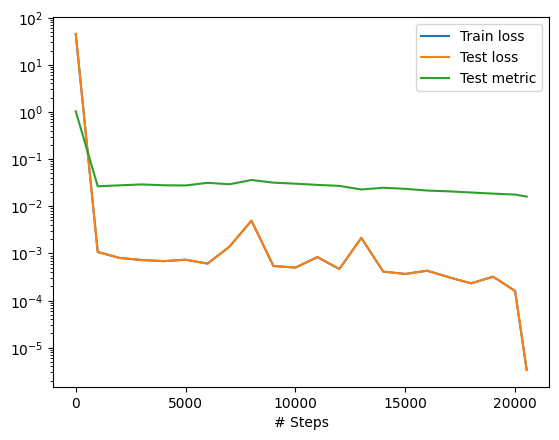


 m =  0.29 

 ####################################################


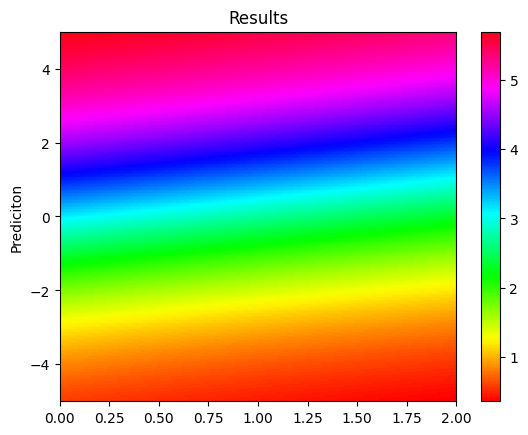

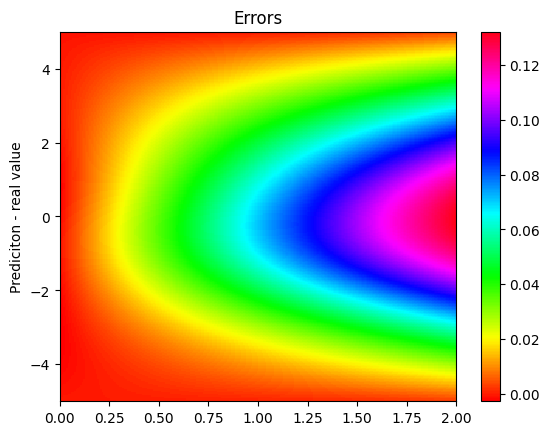


 m =  0.295 

 ####################################################


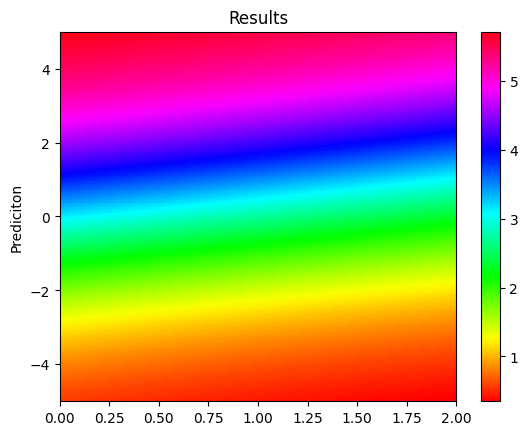

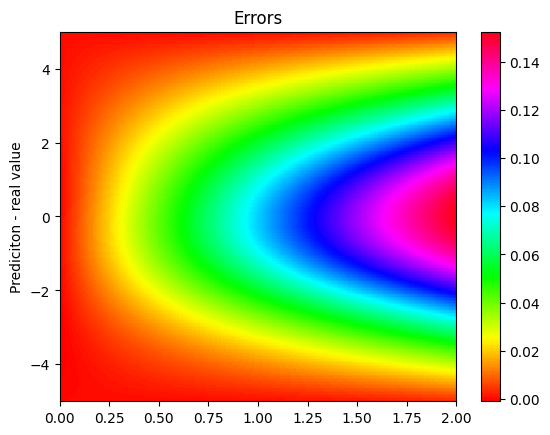


 m =  0.3 

 ####################################################


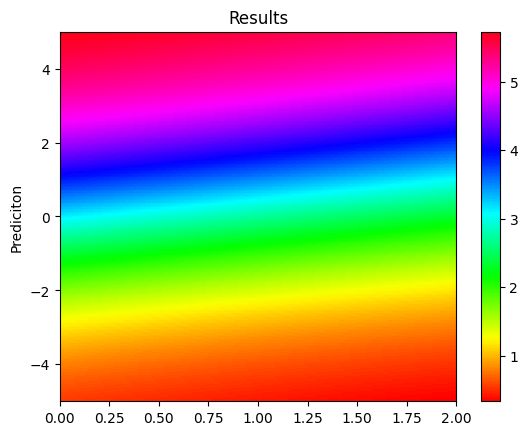

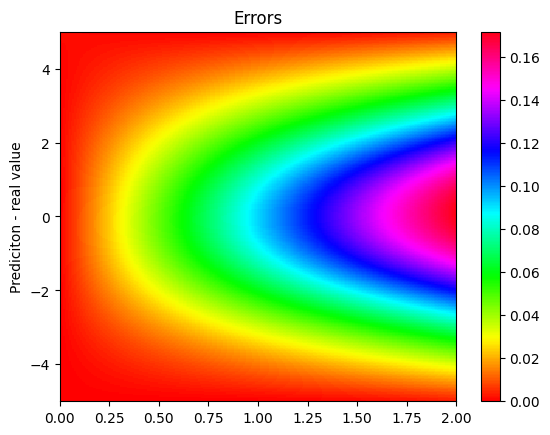


 m =  0.305 

 ####################################################


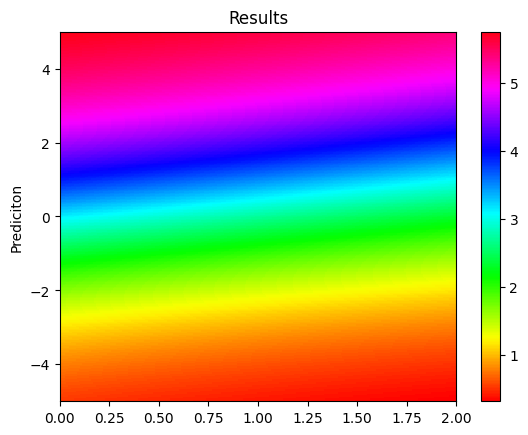

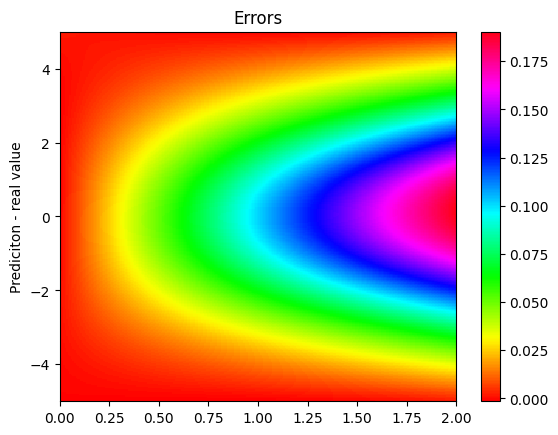


 m =  0.31 

 ####################################################


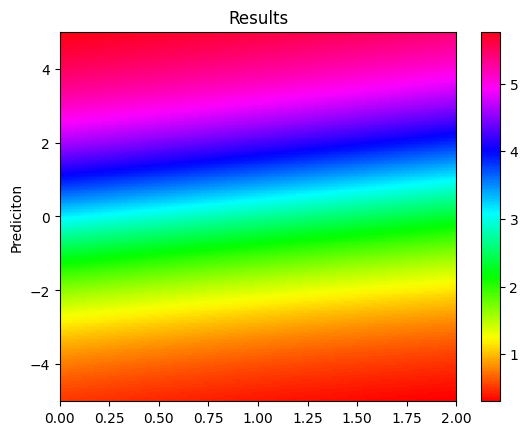

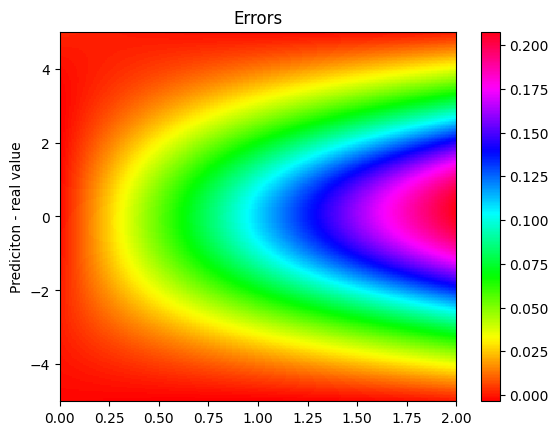

L2:  0.019078484 at variation:  29 ,  31 

L2_list=  [0.01907848]  at identifier:  23 

Compiling model...
Building feed-forward neural network...
'build' took 0.129447 s

'compile' took 1.551804 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [5.80e-05, 1.28e+01, 2.93e+01, 2.34e-01]    [5.80e-05, 1.28e+01, 2.93e+01, 2.34e-01]    [9.75e-01]    
1000      [1.04e-04, 2.56e-03, 3.59e-05, 3.00e-04]    [1.04e-04, 2.56e-03, 3.59e-05, 3.00e-04]    [2.17e-02]    
2000      [7.04e-05, 2.07e-03, 2.66e-05, 1.55e-04]    [7.04e-05, 2.07e-03, 2.66e-05, 1.55e-04]    [2.65e-02]    
3000      [5.33e-05, 1.76e-03, 1.88e-05, 1.09e-04]    [5.33e-05, 1.76e-03, 1.88e-05, 1.09e-04]    [3.17e-02]    
4000      [4.47e-05, 1.62e-03, 1.62e-05, 8.94e-05]    [4.47e-05, 1.62e-03, 1.62e-05, 8.94e-05]    [3.29e-02]    
5000      [4.71e-05, 1.38e-03, 1.30e-05, 5.66e-05]    [4.71e-05, 1.38e-03, 1.30e-05, 5.66e-05]    [3.23e

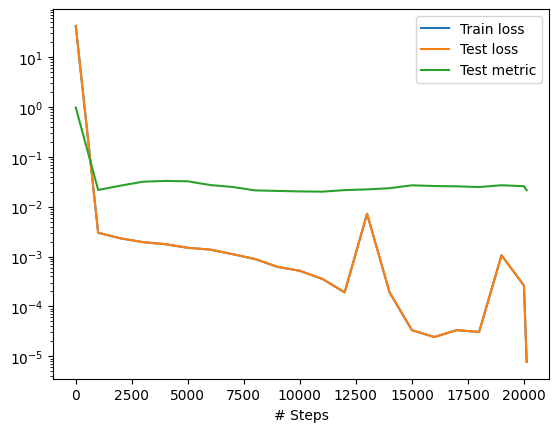


 m =  0.28 

 ####################################################


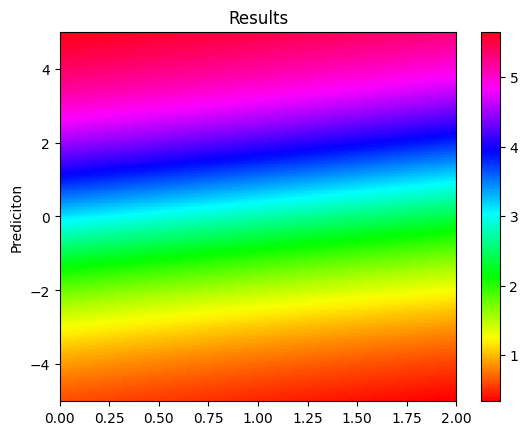

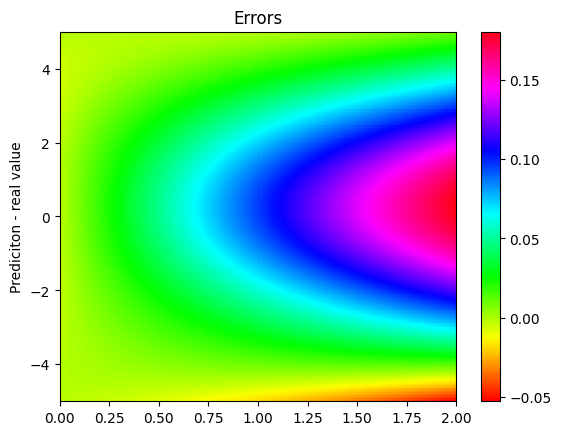


 m =  0.29000000000000004 

 ####################################################


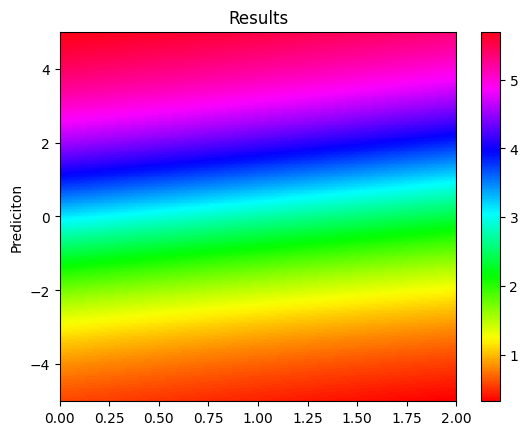

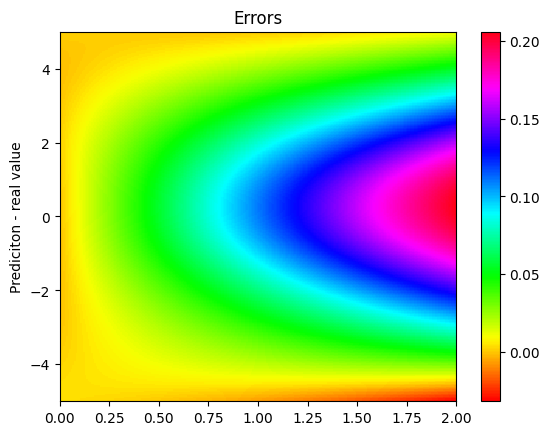


 m =  0.30000000000000004 

 ####################################################


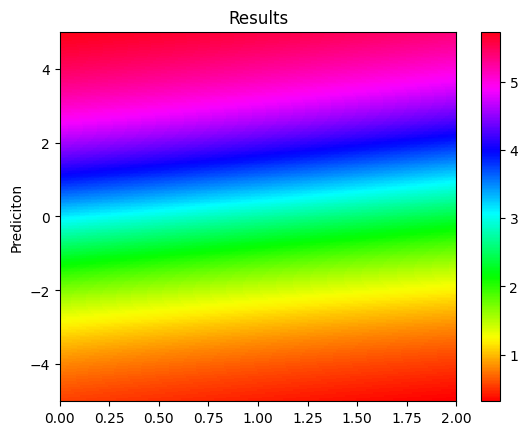

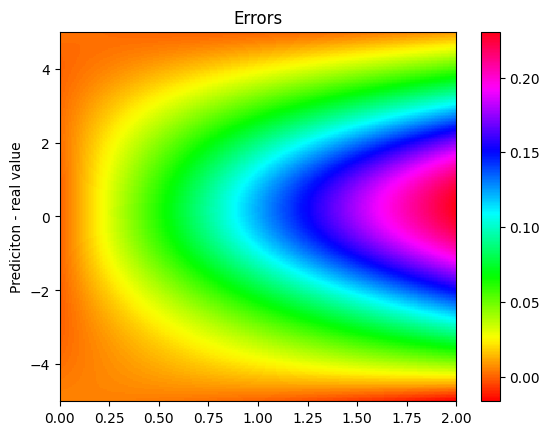


 m =  0.31 

 ####################################################


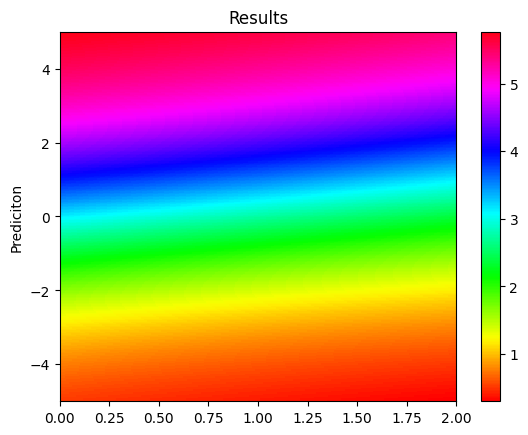

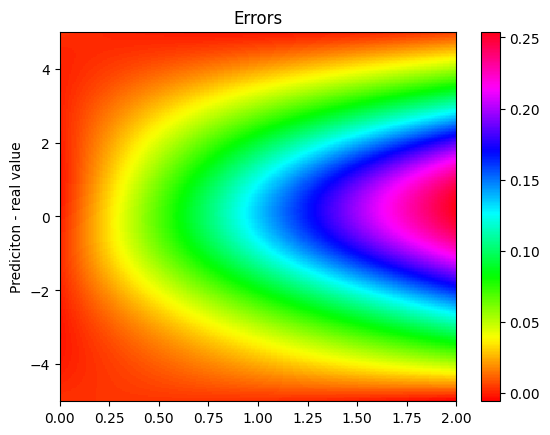


 m =  0.32 

 ####################################################


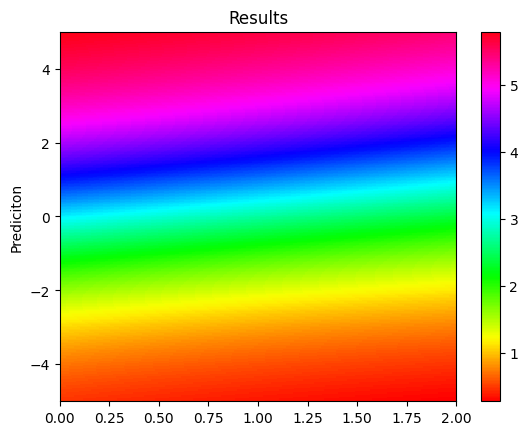

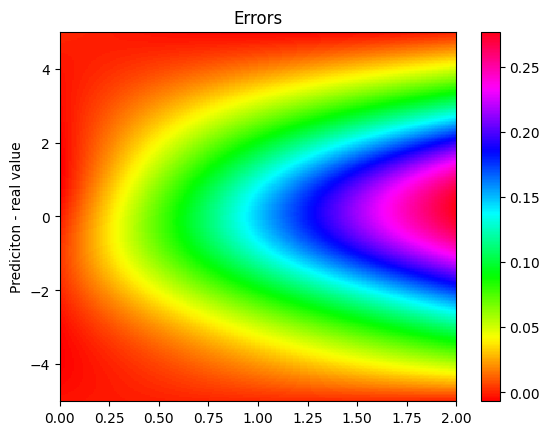

L2:  0.023935389 at variation:  28 ,  32 

L2_list=  [0.01907848 0.02393539]  at identifier:  24 

Compiling model...
Building feed-forward neural network...
'build' took 0.091559 s

'compile' took 1.111127 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [7.02e-04, 1.32e+01, 3.02e+01, 1.40e-01]    [7.02e-04, 1.32e+01, 3.02e+01, 1.40e-01]    [9.77e-01]    
1000      [1.37e-04, 4.54e-03, 3.28e-05, 4.91e-04]    [1.37e-04, 4.54e-03, 3.28e-05, 4.91e-04]    [3.95e-02]    
2000      [1.07e-04, 3.31e-03, 3.47e-05, 2.02e-04]    [1.07e-04, 3.31e-03, 3.47e-05, 2.02e-04]    [4.69e-02]    
3000      [1.14e-04, 3.68e-03, 2.10e-03, 9.28e-04]    [1.14e-04, 3.68e-03, 2.10e-03, 9.28e-04]    [4.45e-02]    
4000      [6.50e-05, 1.67e-03, 1.28e-04, 3.21e-05]    [6.50e-05, 1.67e-03, 1.28e-04, 3.21e-05]    [4.38e-02]    
5000      [6.32e-05, 1.05e-03, 1.32e-05, 2.54e-05]    [6.32e-05, 1.05e-03, 1.32e-05, 2.54e-05

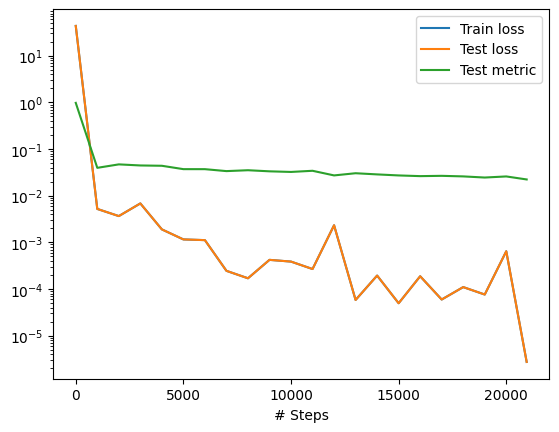


 m =  0.27 

 ####################################################


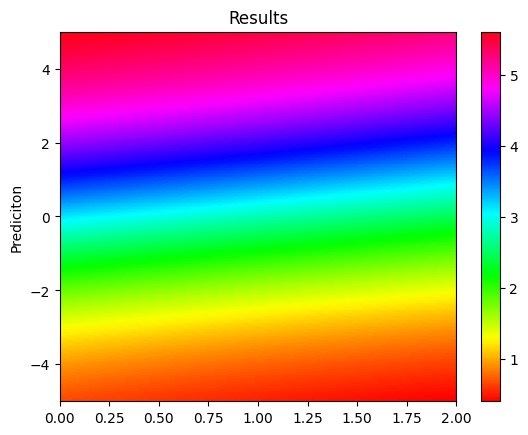

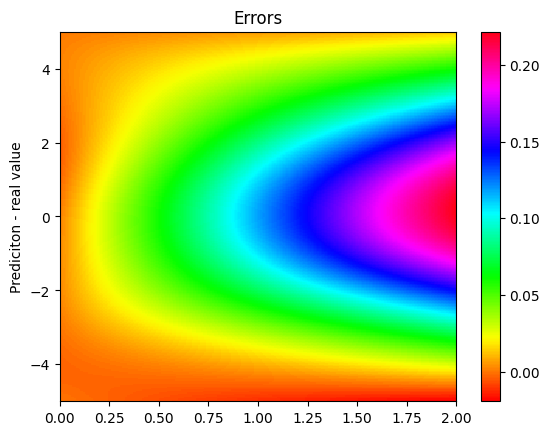


 m =  0.28500000000000003 

 ####################################################


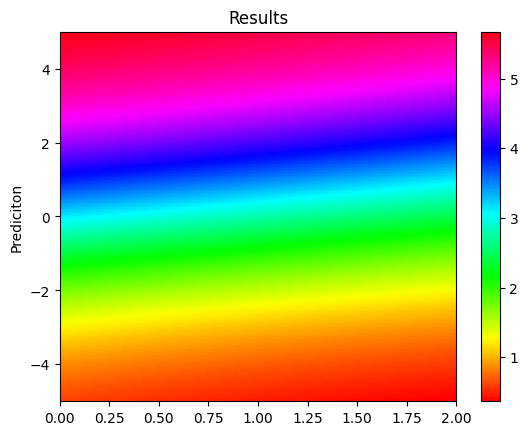

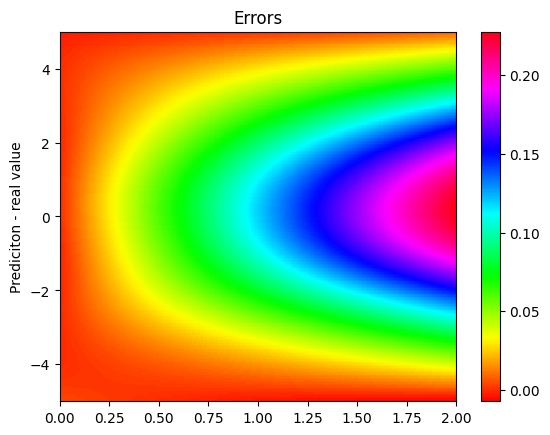


 m =  0.30000000000000004 

 ####################################################


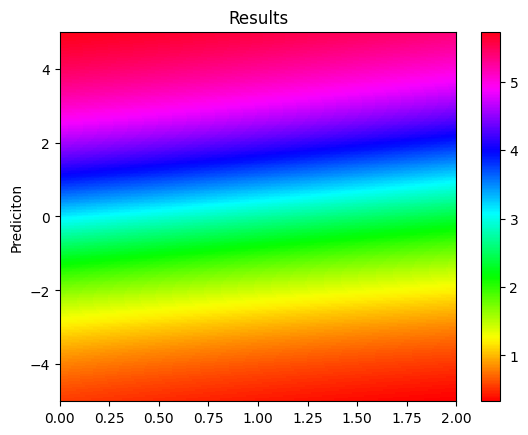

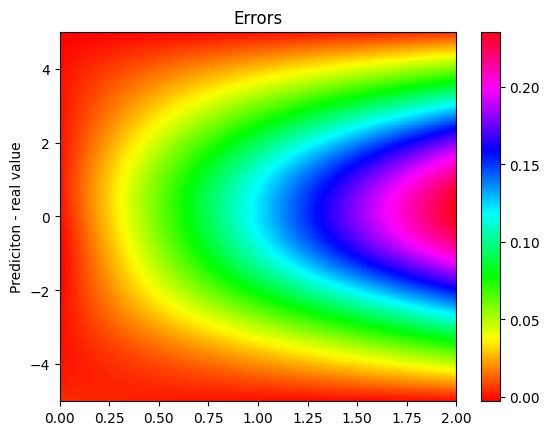


 m =  0.315 

 ####################################################


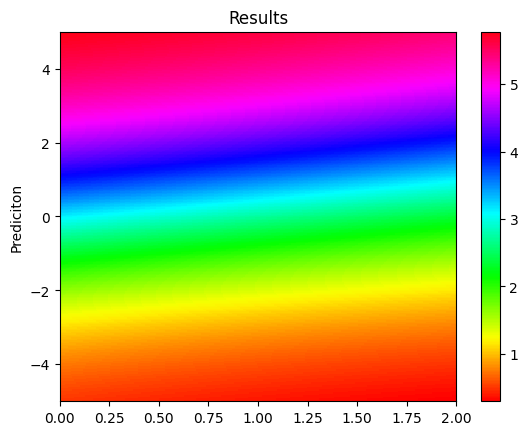

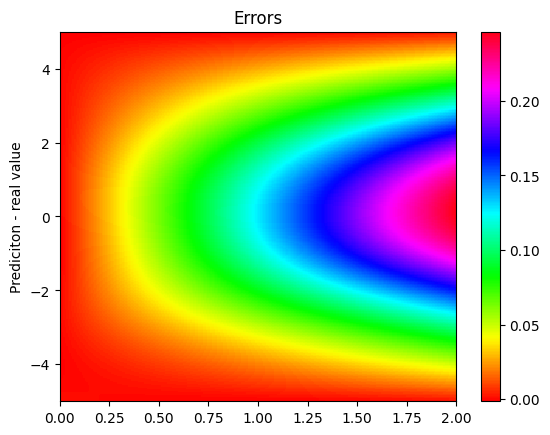


 m =  0.33 

 ####################################################


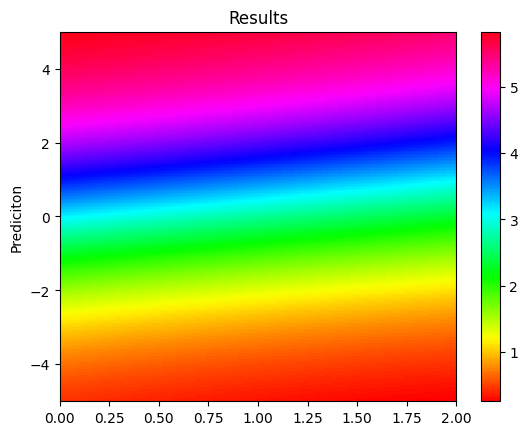

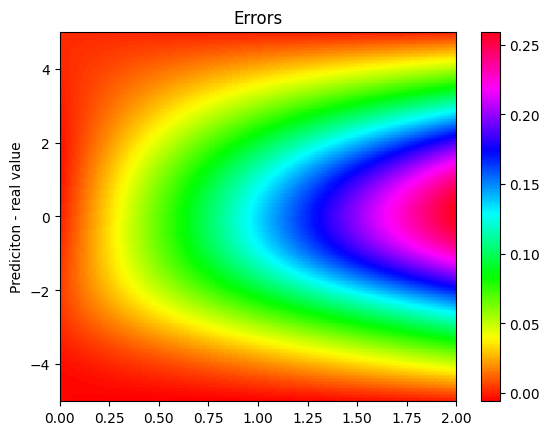

L2:  0.02770672 at variation:  27 ,  33 

L2_list=  [0.01907848 0.02393539 0.02770672]  at identifier:  25 

Compiling model...
Building feed-forward neural network...
'build' took 0.091301 s

'compile' took 1.107380 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.06e-03, 1.24e+01, 2.72e+01, 5.32e-01]    [1.06e-03, 1.24e+01, 2.72e+01, 5.32e-01]    [9.56e-01]    
1000      [2.32e-04, 6.71e-03, 1.14e-03, 1.54e-03]    [2.32e-04, 6.71e-03, 1.14e-03, 1.54e-03]    [5.15e-02]    
2000      [1.65e-04, 3.46e-03, 1.71e-05, 1.28e-04]    [1.65e-04, 3.46e-03, 1.71e-05, 1.28e-04]    [5.98e-02]    
3000      [1.27e-04, 1.99e-03, 2.57e-05, 5.69e-05]    [1.27e-04, 1.99e-03, 2.57e-05, 5.69e-05]    [3.25e-02]    
4000      [7.43e-05, 7.49e-04, 1.95e-05, 3.35e-05]    [7.43e-05, 7.49e-04, 1.95e-05, 3.35e-05]    [2.58e-02]    
5000      [6.98e-05, 1.40e-04, 7.44e-06, 2.86e-05]    [6.98e-05, 1.40e-04, 7.44e-06

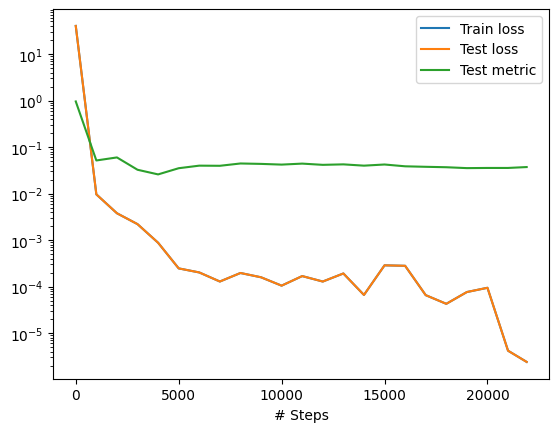


 m =  0.26 

 ####################################################


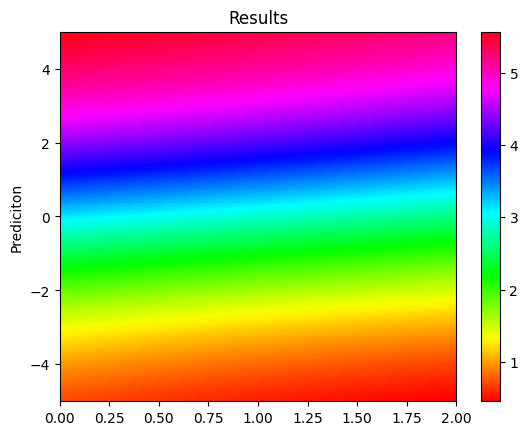

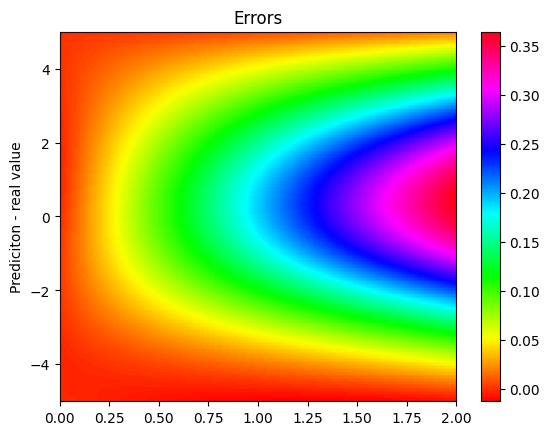


 m =  0.28 

 ####################################################


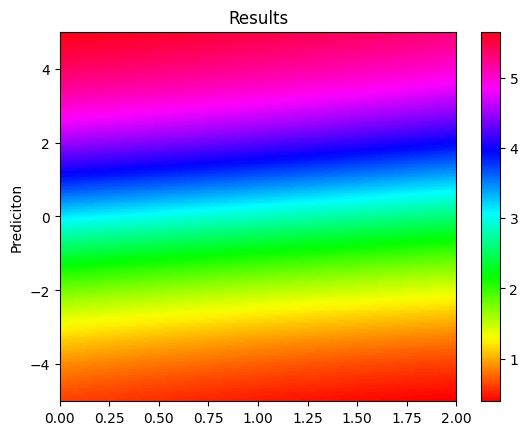

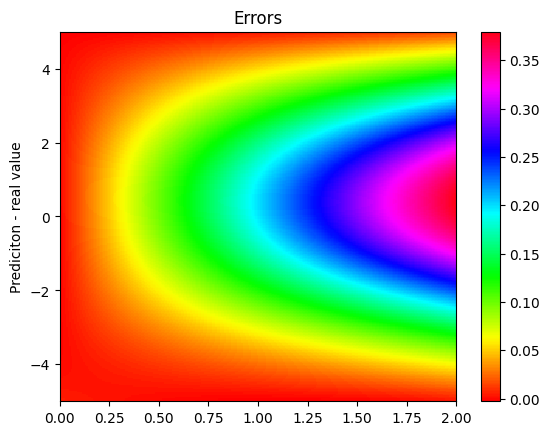


 m =  0.30000000000000004 

 ####################################################


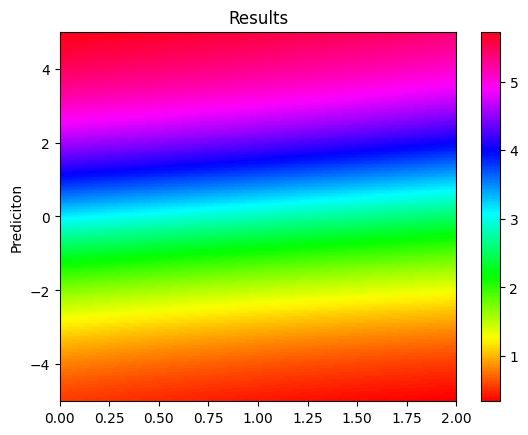

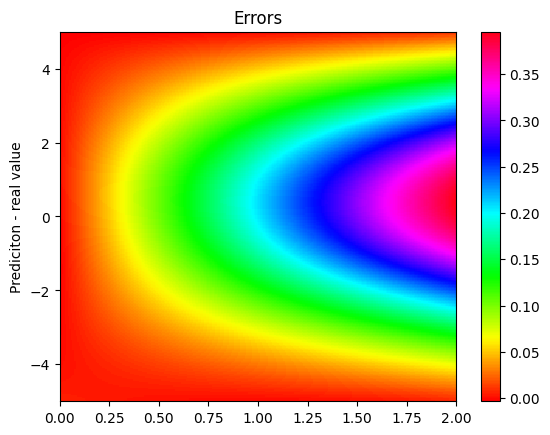


 m =  0.32 

 ####################################################


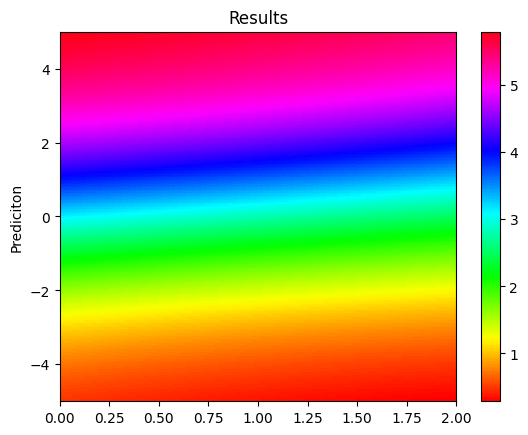

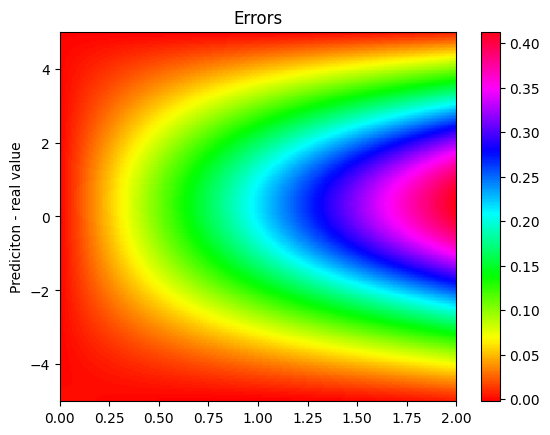


 m =  0.34 

 ####################################################


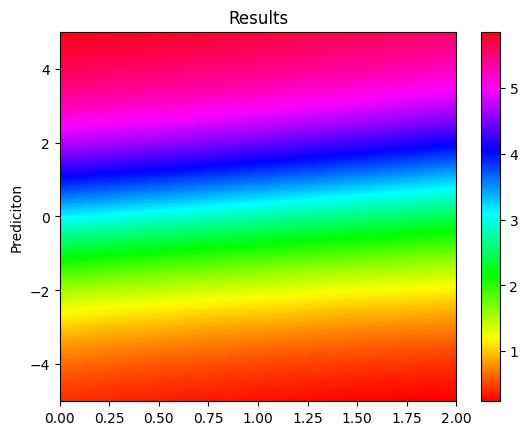

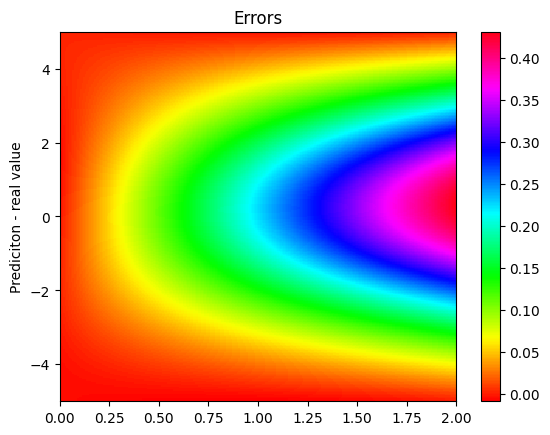

L2:  0.049987424 at variation:  26 ,  34 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742]  at identifier:  26 

Compiling model...
Building feed-forward neural network...
'build' took 0.095813 s

'compile' took 1.165133 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [5.27e-04, 1.32e+01, 3.16e+01, 1.28e-01]    [5.27e-04, 1.32e+01, 3.16e+01, 1.28e-01]    [1.00e+00]    
1000      [2.13e-04, 8.03e-03, 4.43e-05, 5.29e-04]    [2.13e-04, 8.03e-03, 4.43e-05, 5.29e-04]    [3.65e-02]    
2000      [1.29e-04, 1.99e-03, 1.66e-05, 7.21e-05]    [1.29e-04, 1.99e-03, 1.66e-05, 7.21e-05]    [2.61e-02]    
3000      [8.58e-05, 4.66e-04, 7.15e-06, 7.15e-05]    [8.58e-05, 4.66e-04, 7.15e-06, 7.15e-05]    [1.67e-02]    
4000      [1.07e-04, 1.45e-03, 4.73e-03, 3.69e-04]    [1.07e-04, 1.45e-03, 4.73e-03, 3.69e-04]    [2.06e-02]    
5000      [6.97e-05, 8.67e-05, 1.01e-05, 2.00e-05]    [6.97e-05, 8.67e-

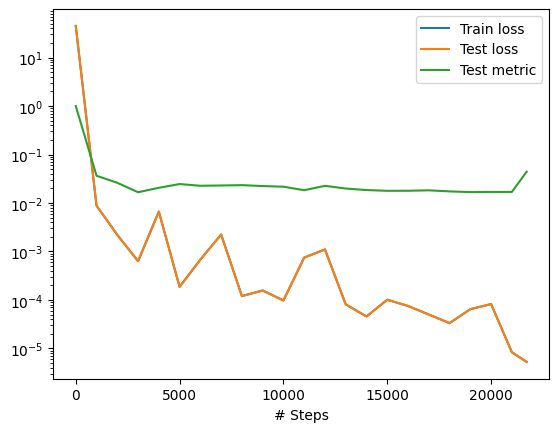


 m =  0.25 

 ####################################################


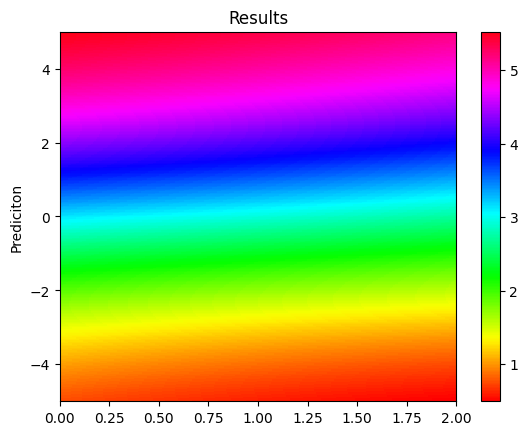

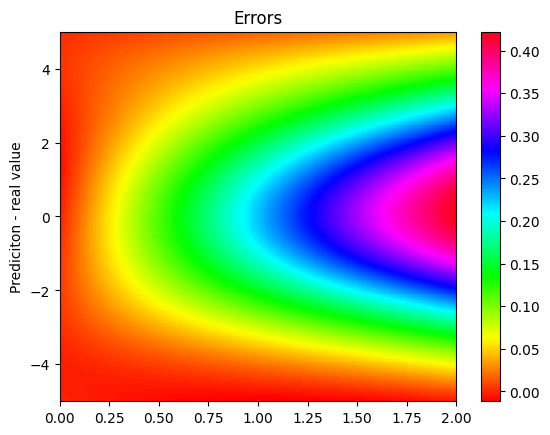


 m =  0.275 

 ####################################################


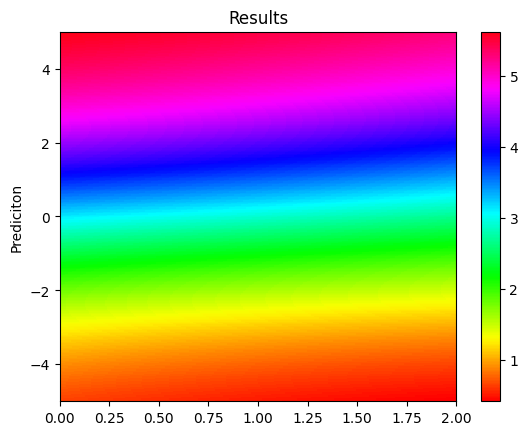

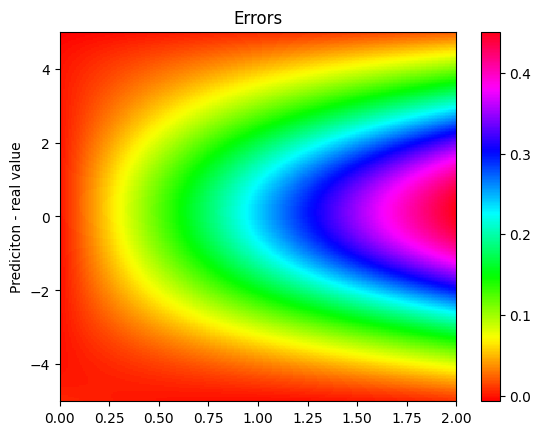


 m =  0.3 

 ####################################################


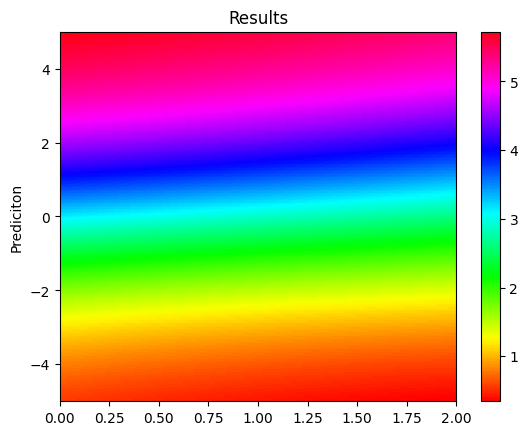

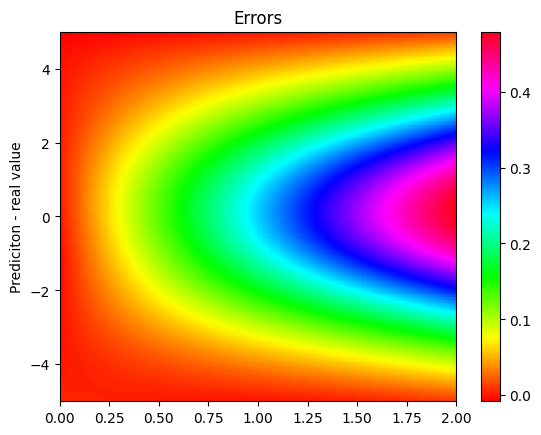


 m =  0.32499999999999996 

 ####################################################


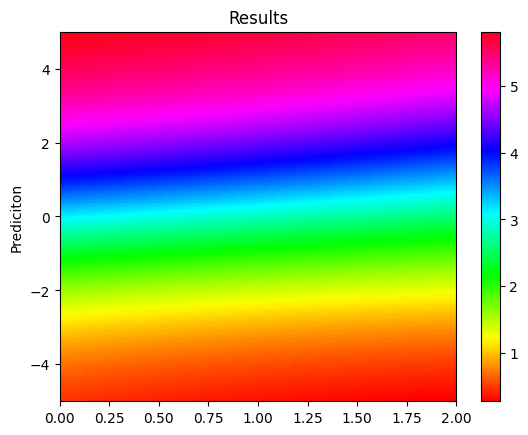

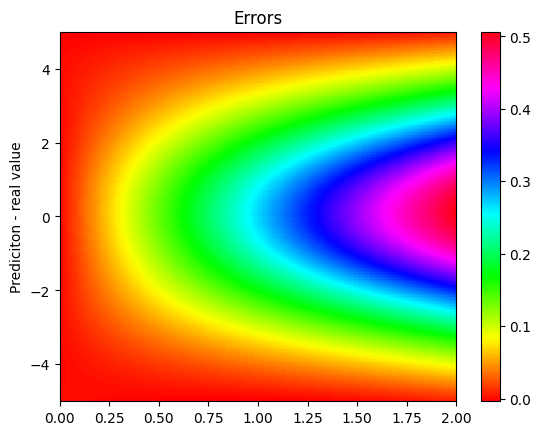


 m =  0.35 

 ####################################################


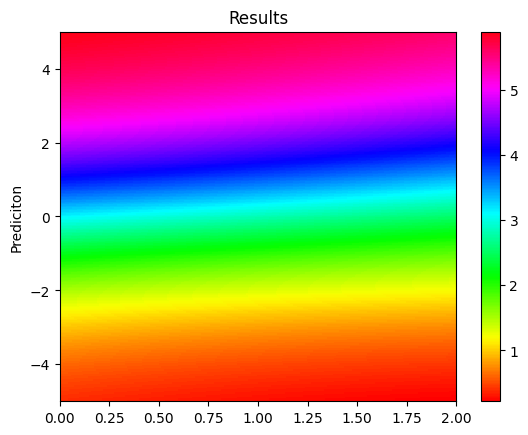

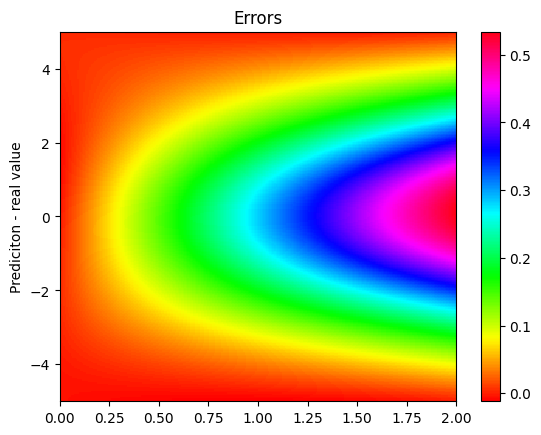

L2:  0.05994061 at variation:  25 ,  35 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061]  at identifier:  27 

Compiling model...
Building feed-forward neural network...
'build' took 0.092356 s

'compile' took 1.207034 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.08e-03, 1.51e+01, 4.12e+01, 3.76e-02]    [2.08e-03, 1.51e+01, 4.12e+01, 3.76e-02]    [1.13e+00]    
1000      [2.62e-04, 1.08e-02, 3.02e-05, 6.18e-04]    [2.62e-04, 1.08e-02, 3.02e-05, 6.18e-04]    [6.53e-02]    
2000      [1.84e-04, 2.32e-03, 2.59e-05, 7.88e-05]    [1.84e-04, 2.32e-03, 2.59e-05, 7.88e-05]    [4.28e-02]    
3000      [1.50e-04, 7.59e-03, 3.87e-03, 1.95e-02]    [1.50e-04, 7.59e-03, 3.87e-03, 1.95e-02]    [4.65e-02]    
4000      [9.21e-05, 3.76e-04, 8.11e-05, 3.58e-05]    [9.21e-05, 3.76e-04, 8.11e-05, 3.58e-05]    [5.49e-02]    
5000      [7.21e-05, 2.89e-04, 1.00e-05, 5.63e-05]    [7.21e-

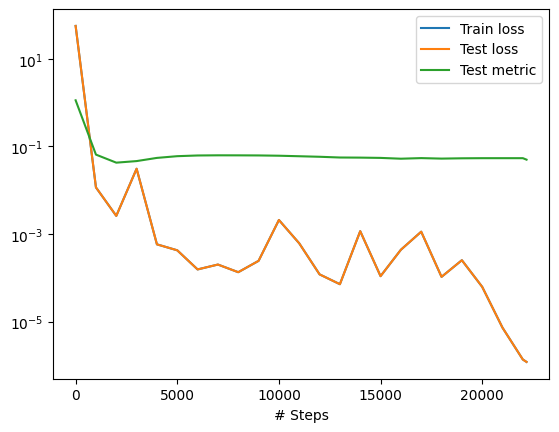


 m =  0.24 

 ####################################################


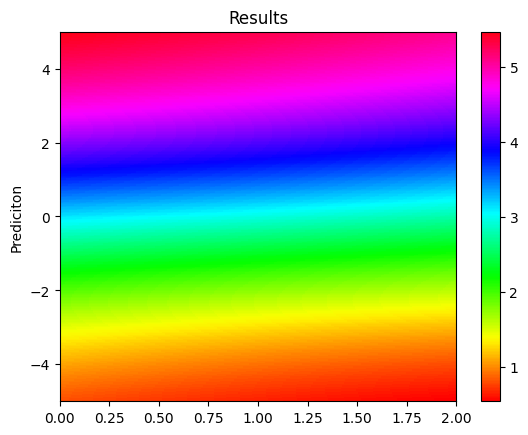

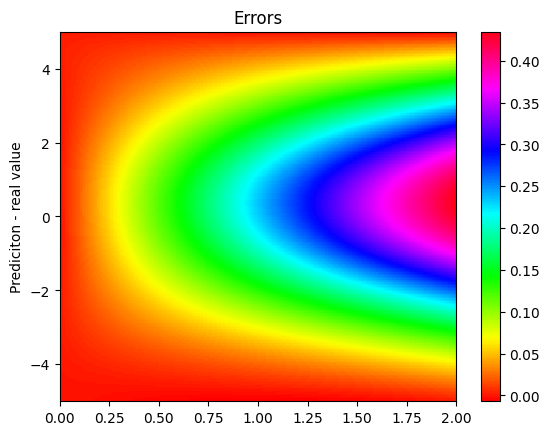


 m =  0.27 

 ####################################################


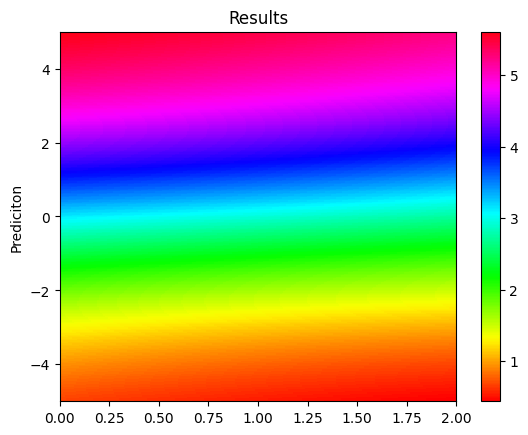

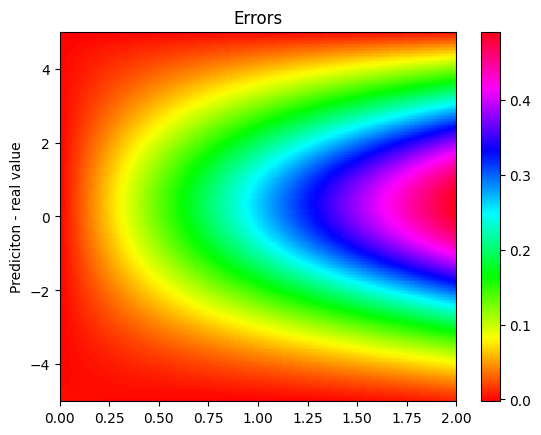


 m =  0.3 

 ####################################################


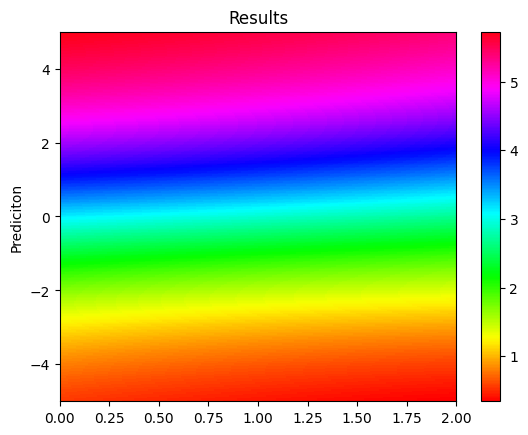

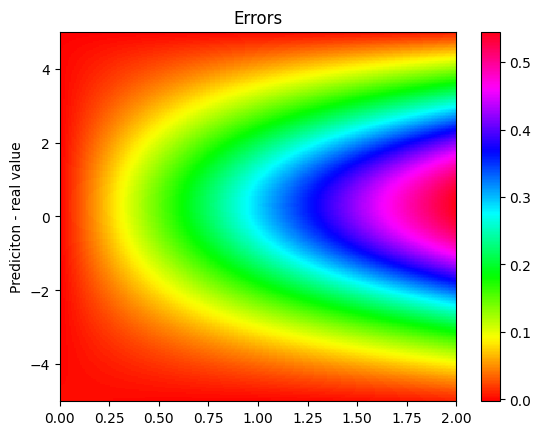


 m =  0.32999999999999996 

 ####################################################


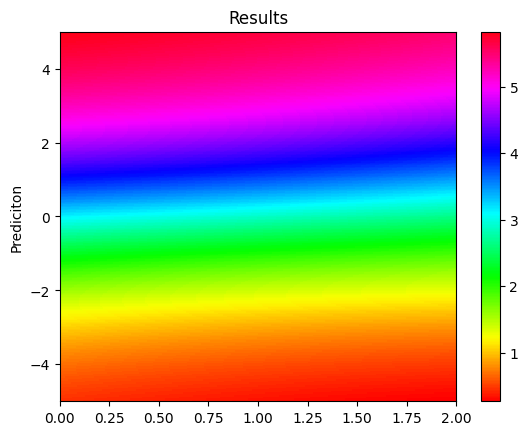

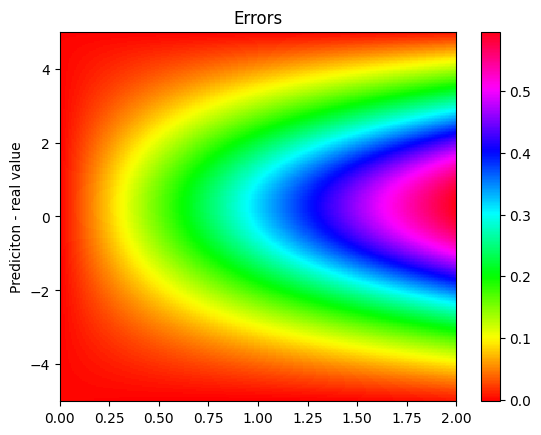


 m =  0.36 

 ####################################################


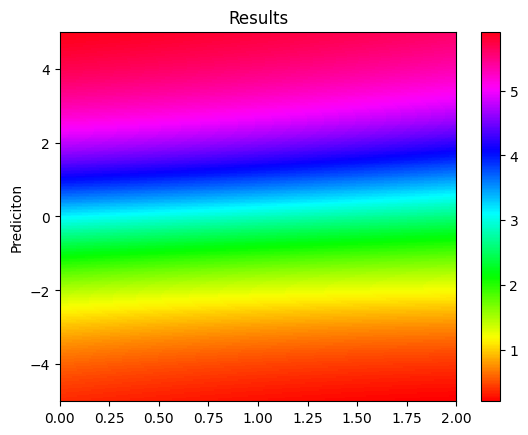

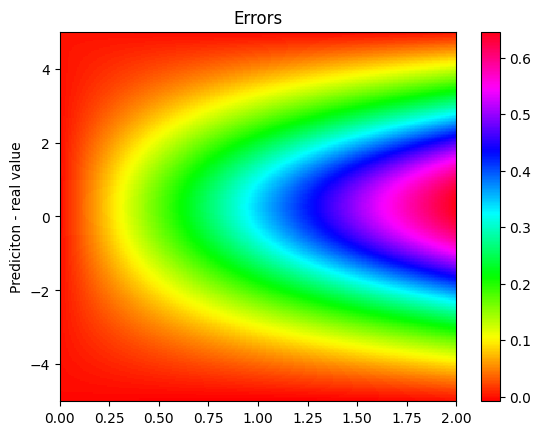

L2:  0.06446929 at variation:  24 ,  36 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929]  at identifier:  28 

Compiling model...
Building feed-forward neural network...
'build' took 0.125409 s

'compile' took 1.832090 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.19e-04, 1.31e+01, 3.18e+01, 1.39e-01]    [3.19e-04, 1.31e+01, 3.18e+01, 1.39e-01]    [1.00e+00]    
1000      [5.38e-04, 6.83e-03, 4.82e-05, 2.56e-04]    [5.38e-04, 6.83e-03, 4.82e-05, 2.56e-04]    [6.86e-02]    
2000      [3.57e-04, 4.45e-03, 1.02e-04, 3.90e-03]    [3.57e-04, 4.45e-03, 1.02e-04, 3.90e-03]    [6.51e-02]    
3000      [1.71e-04, 3.59e-04, 1.87e-05, 2.51e-04]    [1.71e-04, 3.59e-04, 1.87e-05, 2.51e-04]    [6.96e-02]    
4000      [9.93e-05, 1.32e-04, 1.01e-05, 1.54e-05]    [9.93e-05, 1.32e-04, 1.01e-05, 1.54e-05]    [6.70e-02]    
5000      [1.06e-04, 3.23e-04, 1.45e-05, 2.32e-04]

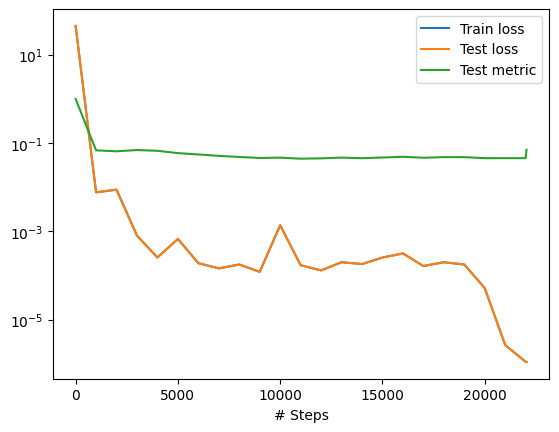


 m =  0.23 

 ####################################################


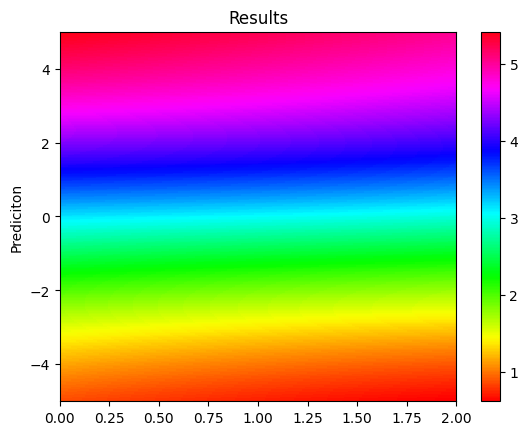

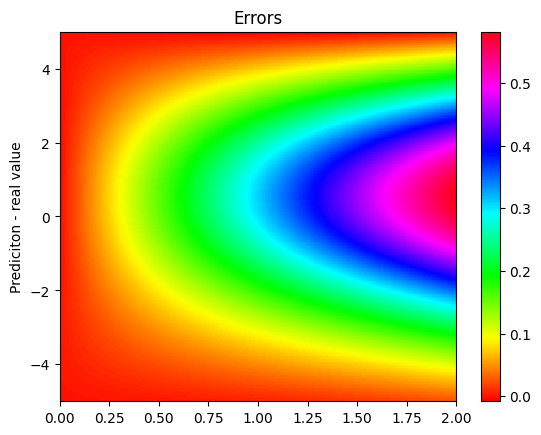


 m =  0.265 

 ####################################################


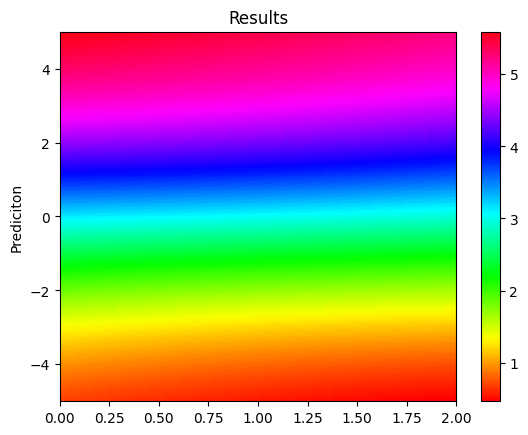

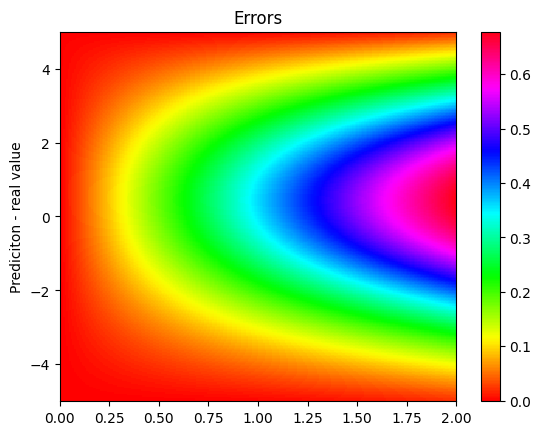


 m =  0.3 

 ####################################################


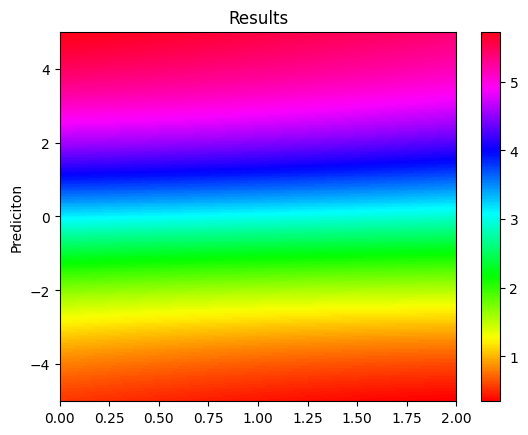

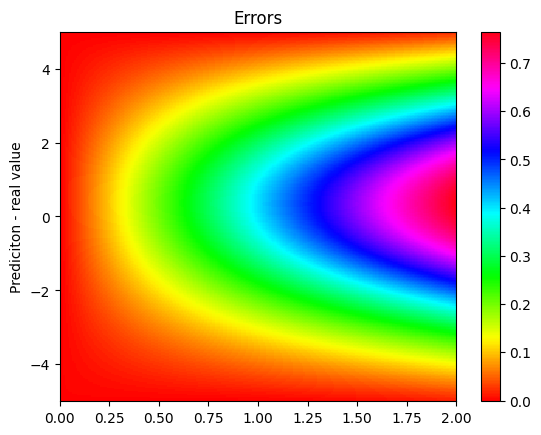


 m =  0.33499999999999996 

 ####################################################


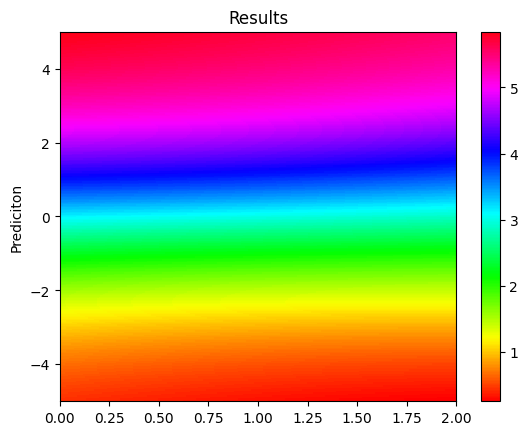

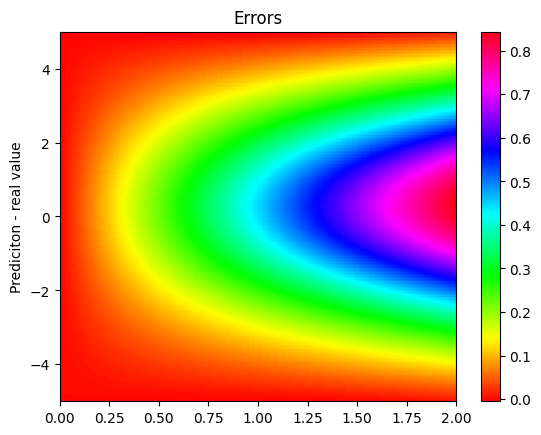


 m =  0.37 

 ####################################################


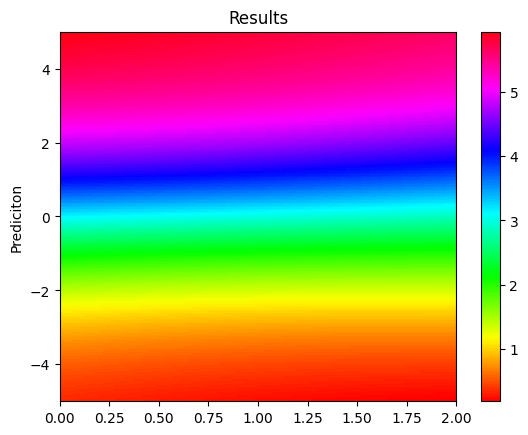

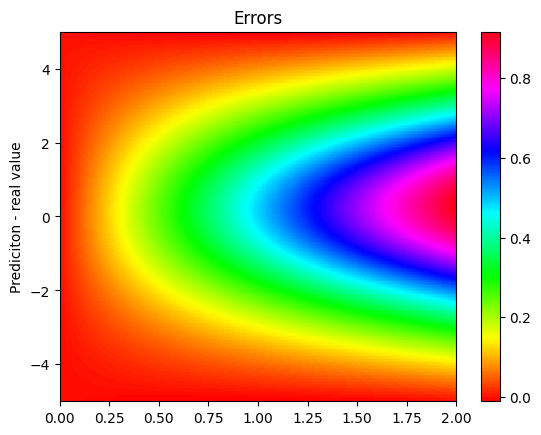

L2:  0.08758008 at variation:  23 ,  37 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008]  at identifier:  29 

Compiling model...
Building feed-forward neural network...
'build' took 0.127449 s

'compile' took 1.891360 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [4.10e-03, 1.44e+01, 3.74e+01, 4.42e-02]    [4.10e-03, 1.44e+01, 3.74e+01, 4.42e-02]    [1.07e+00]    
1000      [4.77e-04, 1.06e-02, 2.62e-05, 6.16e-04]    [4.77e-04, 1.06e-02, 2.62e-05, 6.16e-04]    [5.83e-02]    
2000      [1.81e-04, 5.35e-04, 2.35e-05, 2.16e-04]    [1.81e-04, 5.35e-04, 2.35e-05, 2.16e-04]    [5.80e-02]    
3000      [1.33e-04, 3.10e-04, 3.81e-05, 1.87e-04]    [1.33e-04, 3.10e-04, 3.81e-05, 1.87e-04]    [6.39e-02]    
4000      [8.97e-05, 2.18e-04, 9.45e-05, 3.31e-05]    [8.97e-05, 2.18e-04, 9.45e-05, 3.31e-05]    [6.47e-02]    
5000      [8.41e-05, 1.67e-04, 1.09e-0

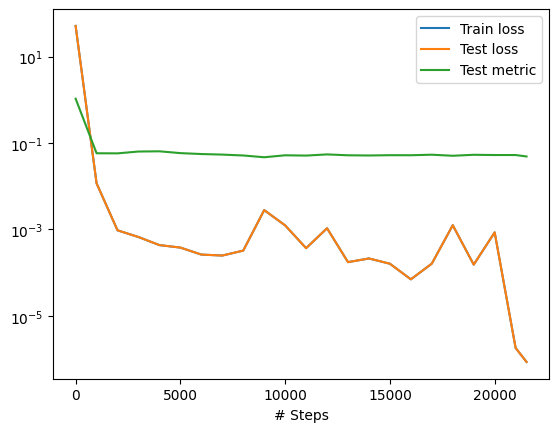


 m =  0.22 

 ####################################################


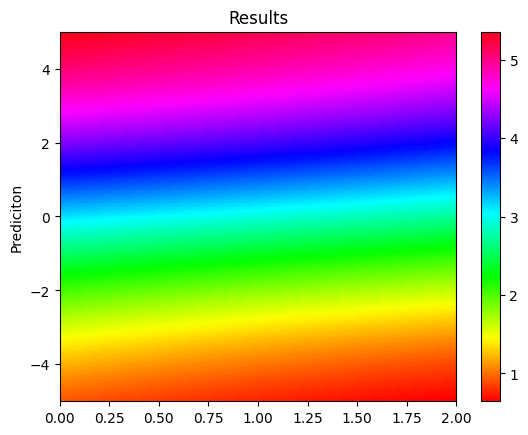

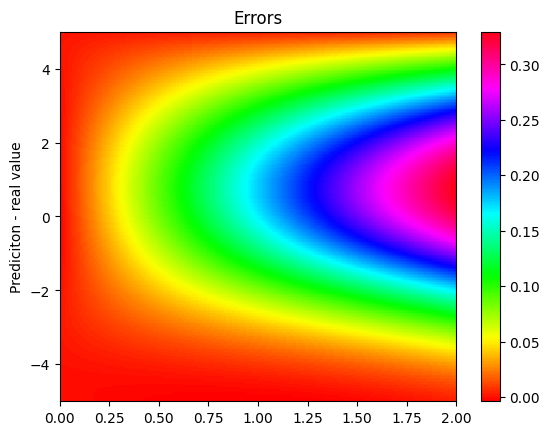


 m =  0.26 

 ####################################################


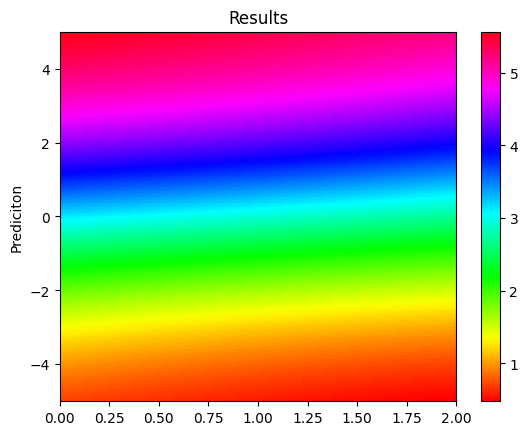

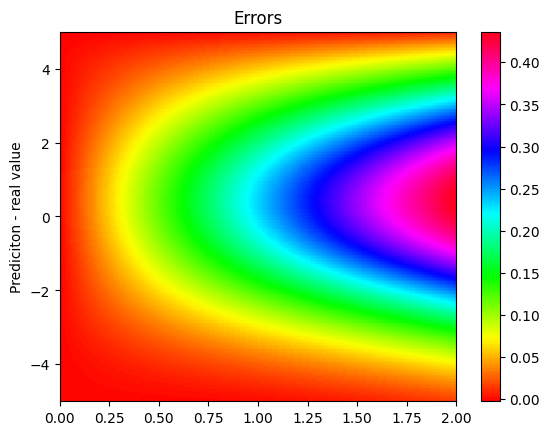


 m =  0.3 

 ####################################################


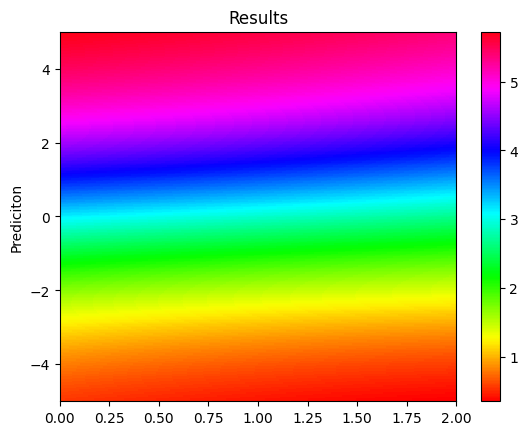

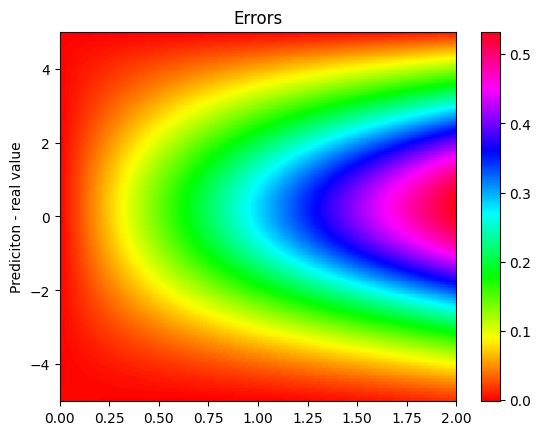


 m =  0.33999999999999997 

 ####################################################


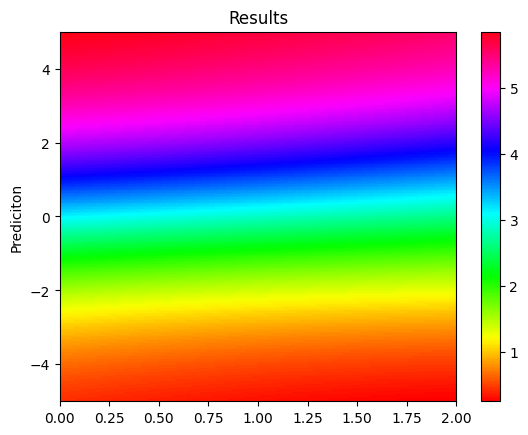

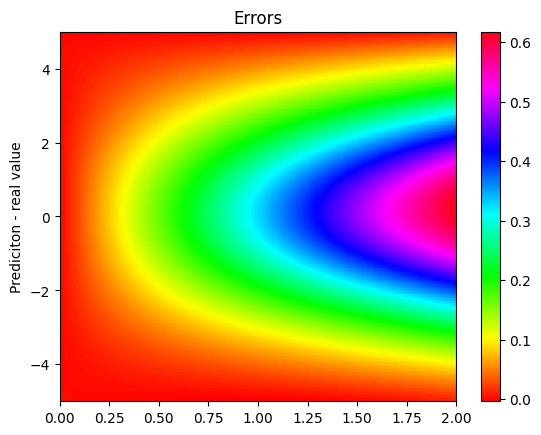


 m =  0.38 

 ####################################################


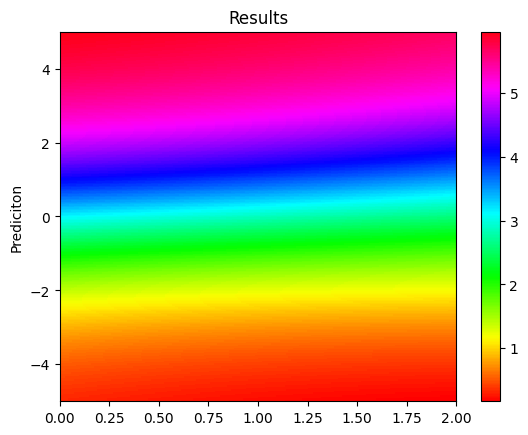

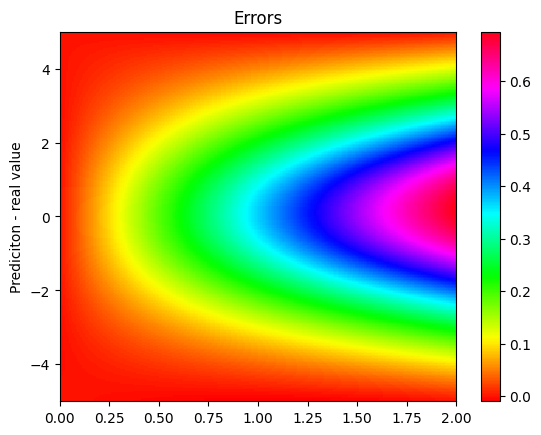

L2:  0.06205007 at variation:  22 ,  38 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007]  at identifier:  30 

Compiling model...
Building feed-forward neural network...
'build' took 0.092734 s

'compile' took 1.371149 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.95e-04, 1.25e+01, 2.99e+01, 5.40e-01]    [3.95e-04, 1.25e+01, 2.99e+01, 5.40e-01]    [1.00e+00]    
1000      [5.50e-04, 5.29e-03, 6.19e-04, 8.44e-04]    [5.50e-04, 5.29e-03, 6.19e-04, 8.44e-04]    [4.12e-02]    
2000      [2.45e-04, 3.49e-04, 1.15e-05, 1.47e-04]    [2.45e-04, 3.49e-04, 1.15e-05, 1.47e-04]    [6.74e-02]    
3000      [2.04e-04, 3.66e-04, 6.85e-05, 5.39e-05]    [2.04e-04, 3.66e-04, 6.85e-05, 5.39e-05]    [7.94e-02]    
4000      [1.18e-04, 2.12e-04, 4.95e-06, 3.11e-05]    [1.18e-04, 2.12e-04, 4.95e-06, 3.11e-05]    [8.33e-02]    
5000      [1.26e-04, 3.94e-

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

upper=31#centésimos
botton=29
identifier=22
L2_list=np.array([])
L2=0
while (botton>0):


    #Boundary points
    sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
    sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
    n_rand=256
    sample = sampler.random(n_rand)
    sample2 = sampler2.random(n_rand)
    #print(sample)
    #sample.sort
    #print(np.array(sample))
    #boundary condition sample:
    x1 = np.vstack(np.ones(int(n_rand/2))*5)
    x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
    m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
    t0 = sample*2

    X_anchors=np.concatenate((x1,m,t0), axis=1)



    timedomain = dde.geometry.TimeDomain(0, 2)
    geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

    geomtime = dde.geometry.GeometryXTime(geom, timedomain)



    # Define sine function
    if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
        from deepxde.backend import tf

        cos = tf.cos
        sin = tf.sin
    elif dde.backend.backend_name == "paddle":
        import paddle

        cos = paddle.cos
        sin = paddle.sin


    def pde(x, y):
        alpha = -1
        v=0.65

        dy_tt = dde.grad.hessian(y, x, i=2, j=2)
        dy_xx = dde.grad.hessian(y, x, i=0, j=0)
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        return (
            dy_tt
            + alpha * dy_xx
            + m**2*sin(y)
        )

    def func(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

        v = 0.65
        gamma = np.sqrt(1/(1-v**2))
        delt=0


        return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
        #return x[:, 0:1] * np.cos(x[:, 1:2])

    def deriv(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        v = 0.65
        gamma = tf.sqrt(1/(1-v**2))
        delt=0

        return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


    def boundary(x,_):
        return np.isclose(x[2],0)

    def boundary_up(x,_):
        return np.isclose(x[0],5.0)
    def boundary_down(x,_):
        return np.isclose(x[0],-5.0)


    bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
    bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
    #ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
    ic_1 = dde.icbc.IC(geomtime, func, boundary)
    ic_2 = dde.icbc.OperatorBC(
        geomtime,
        lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
        boundary,
    )

    data = dde.data.TimePDE(
        geomtime,
        pde,
        [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
        num_domain=2000,
        num_boundary=0,
        num_initial=128,
        solution=func,
        num_test=None,
        anchors=X_anchors
    )

    layer_size = [3] + [200] * 6 + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)

    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )
    losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")
    dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
    )
    model.compile("L-BFGS", metrics=["l2 relative error"])
    losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
    dde.saveplot(losshistory, train_state, issave=True, isplot=True)
    for i in np.linspace(botton/100,upper/100, 5):
        print("\n m = ",i,"\n\n ####################################################")
        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        m= np.ones(65536)*i
        #m=m.reshape(-1,1)
        m=np.vstack(m)

        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        x1,t1=np.split(X_star, 2, axis=1)
        X_star_m= np.concatenate((x1,m,t1), axis=1)

        prediction = model.predict(X_star_m, operator=None)

        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Results")
        ax.set_ylabel("Prediciton")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()

        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        prediction = model.predict(X_star_m, operator=None)
        real=func(X_star_m)
        prediction=prediction-real
        #prediction=np.sqrt(prediction*prediction)


        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Errors")
        ax.set_ylabel("Prediciton - real value")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()


    L2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
    print("L2: ",L2,"at variation: ",botton, ", ",upper,"\n")

    upper+=1
    botton-=1
    identifier+=1

    L2_list=np.append(L2_list,L2)
    print("L2_list= ", L2_list, " at identifier: ",identifier , "\n")

    np.save('/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_'+str(np.shape(L2_list)[0])+'.npy',L2_list)





In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_8.npy


L2_errors_lbfgs_1.npy  L2_errors_lbfgs_3.npy  L2_errors_lbfgs_5.npy  L2_errors_lbfgs_7.npy
L2_errors_lbfgs_2.npy  L2_errors_lbfgs_4.npy  L2_errors_lbfgs_6.npy  L2_errors_lbfgs_8.npy


#COntinuacao Automatizando lbfgs

In [ ]:
identifier = 31
print("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")

/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/31/model.ckpt


In [ ]:
#ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/30
L2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_8.npy")

In [ ]:
L2_list

array([0.01907848, 0.02393539, 0.02770672, 0.04998742, 0.05994061,
       0.06446929, 0.08758008, 0.06205007])

Compiling model...
Building feed-forward neural network...


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'build' took 0.298842 s

'compile' took 2.707846 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [4.58e-05, 1.29e+01, 3.07e+01, 4.40e-01]    [4.58e-05, 1.29e+01, 3.07e+01, 4.40e-01]    [1.01e+00]    
1000      [4.71e-04, 3.56e-03, 6.06e-05, 5.72e-04]    [4.71e-04, 3.56e-03, 6.06e-05, 5.72e-04]    [3.81e-02]    
2000      [2.48e-04, 5.96e-04, 1.01e-04, 1.62e-04]    [2.48e-04, 5.96e-04, 1.01e-04, 1.62e-04]    [5.61e-02]    
3000      [1.86e-04, 2.21e-04, 1.56e-05, 3.95e-05]    [1.86e-04, 2.21e-04, 1.56e-05, 3.95e-05]    [5.89e-02]    
4000      [1.42e-04, 5.57e-04, 1.16e-03, 3.54e-05]    [1.42e-04, 5.57e-04, 1.16e-03, 3.54e-05]    [5.15e-02]    
5000      [1.09e-04, 3.90e-04, 5.81e-04, 8.42e-06]    [1.09e-04, 3.90e-04, 5.81e-04, 8.42e-06]    [5.06e-02]    
6000      [1.33e-04, 4.58e-04, 2.14e-04, 2.92e-04]    [1.33e-04, 4.58e-04, 2.14e-04, 2.92e-04]    [4.55e-02]    
7000      [8.62e-05, 1.41

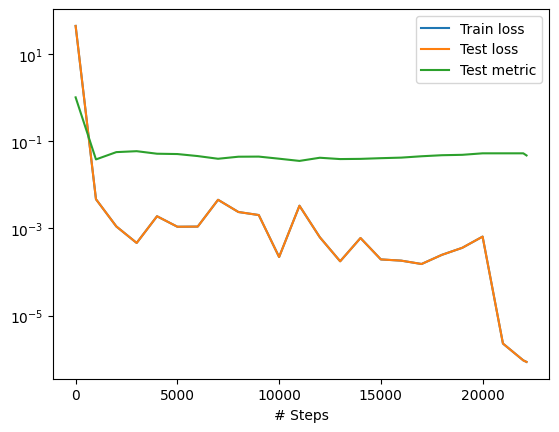


 m =  0.21 

 ####################################################


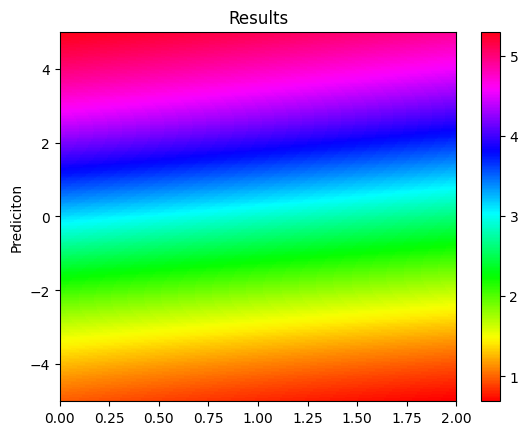

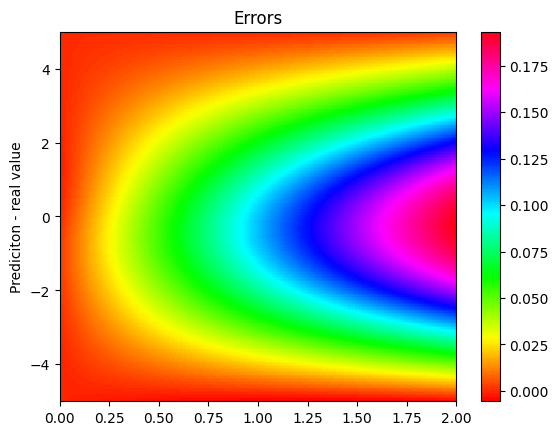


 m =  0.255 

 ####################################################


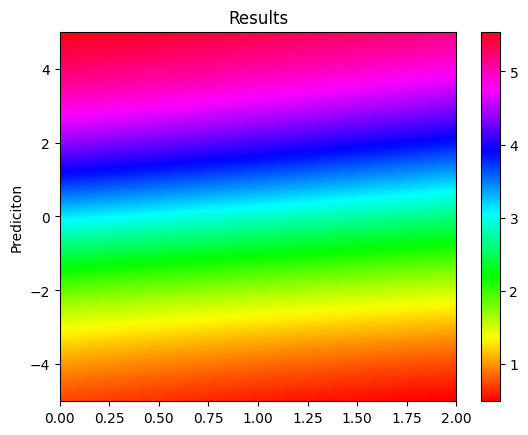

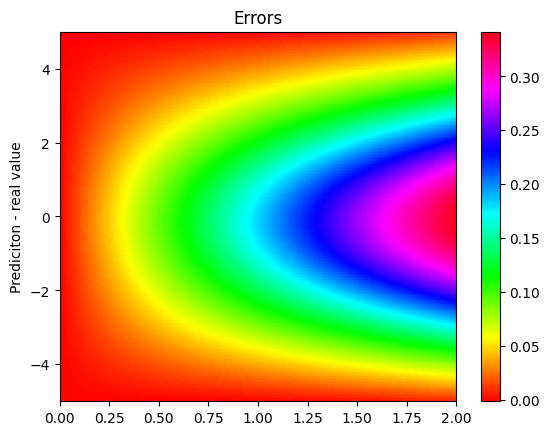


 m =  0.3 

 ####################################################


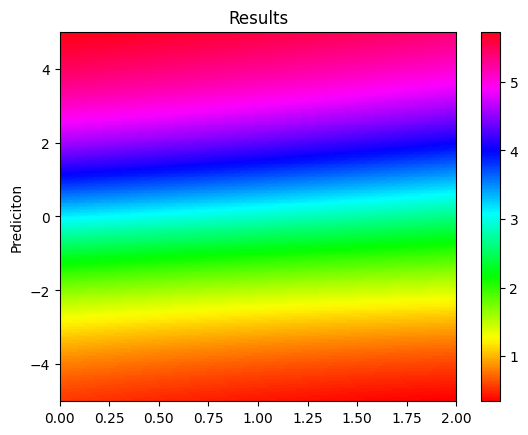

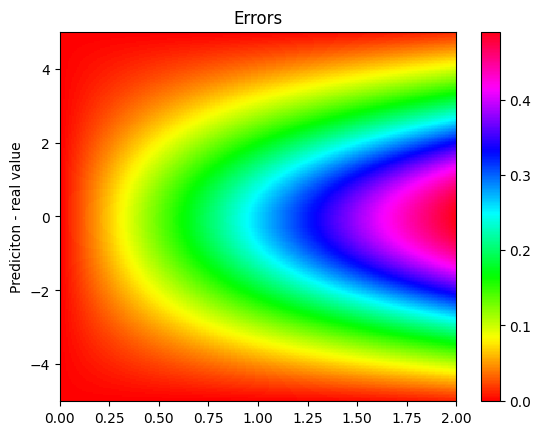


 m =  0.345 

 ####################################################


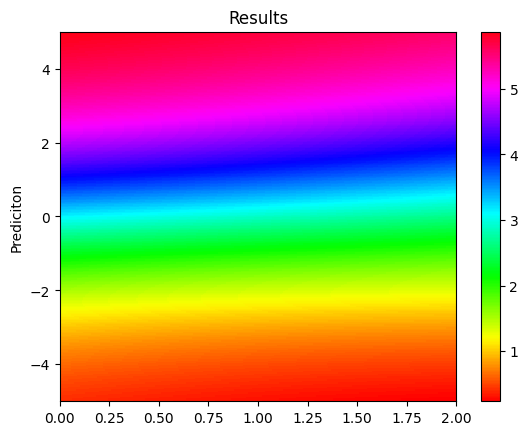

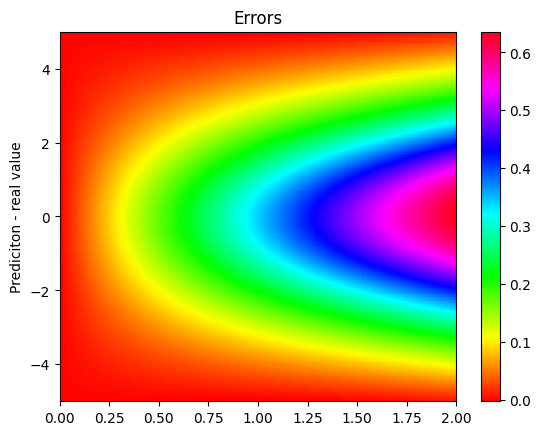


 m =  0.39 

 ####################################################


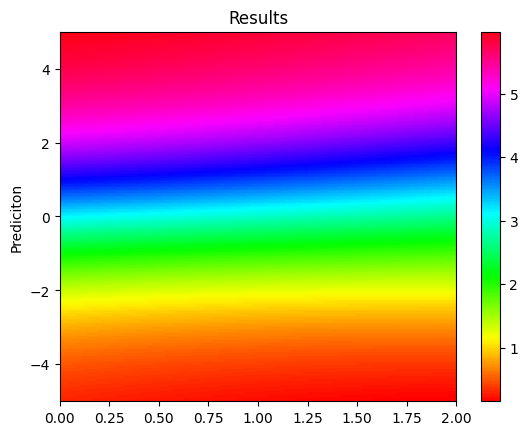

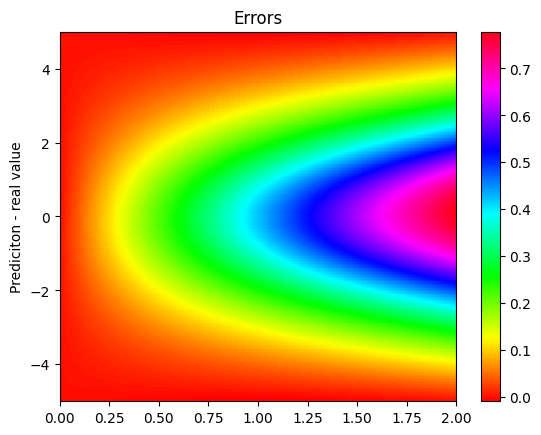

L2:  0.06390987 at variation:  21 ,  39 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987]  at identifier:  32 

Compiling model...
Building feed-forward neural network...
'build' took 0.152974 s

'compile' took 1.704878 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [4.15e-03, 1.12e+01, 2.55e+01, 1.61e+00]    [4.15e-03, 1.12e+01, 2.55e+01, 1.61e+00]    [9.60e-01]    
1000      [5.96e-04, 3.02e-03, 1.07e-04, 7.78e-04]    [5.96e-04, 3.02e-03, 1.07e-04, 7.78e-04]    [5.30e-02]    
2000      [3.09e-04, 5.22e-04, 4.47e-05, 3.39e-04]    [3.09e-04, 5.22e-04, 4.47e-05, 3.39e-04]    [6.39e-02]    
3000      [1.74e-04, 8.77e-04, 1.88e-03, 3.62e-05]    [1.74e-04, 8.77e-04, 1.88e-03, 3.62e-05]    [6.90e-02]    
4000      [1.42e-04, 6.91e-04, 8.03e-04, 5.49e-04]    [1.42e-04, 6.91e-04, 8.03e-04, 5.49e-04]    [5.71e-02]    
5000      [1.01e

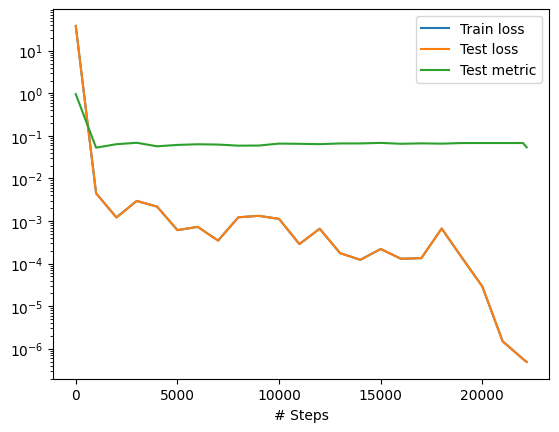


 m =  0.2 

 ####################################################


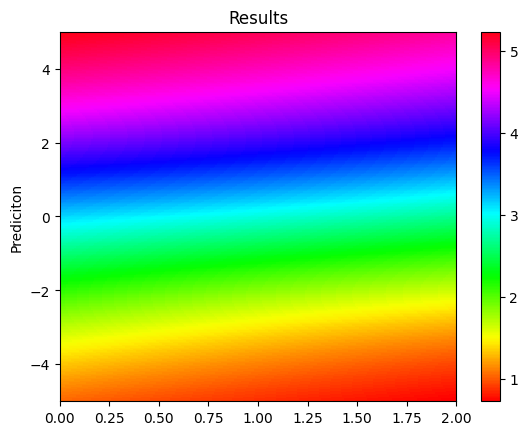

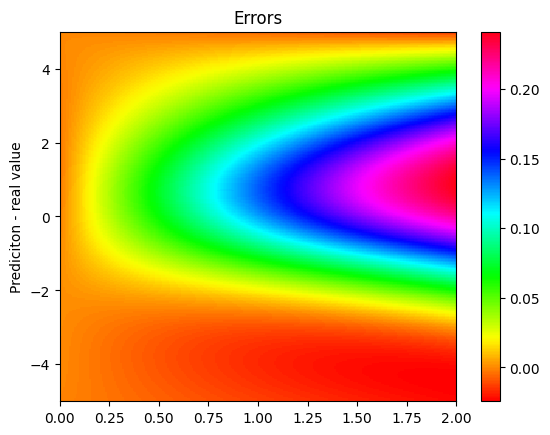


 m =  0.25 

 ####################################################


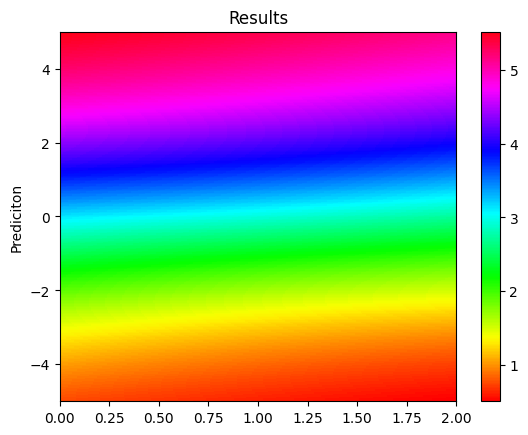

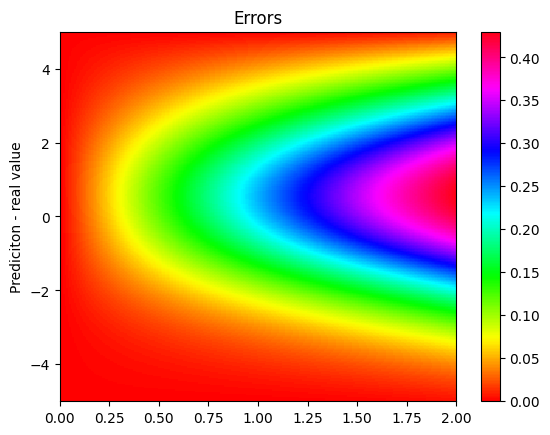


 m =  0.30000000000000004 

 ####################################################


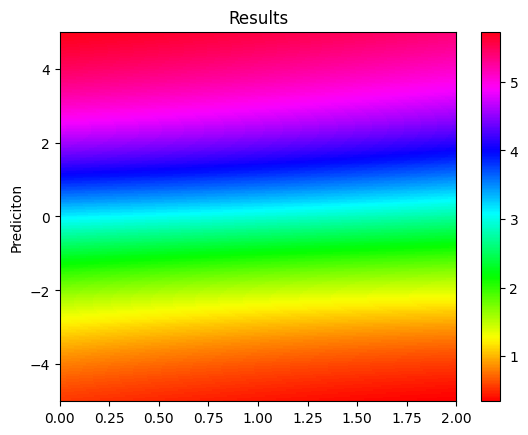

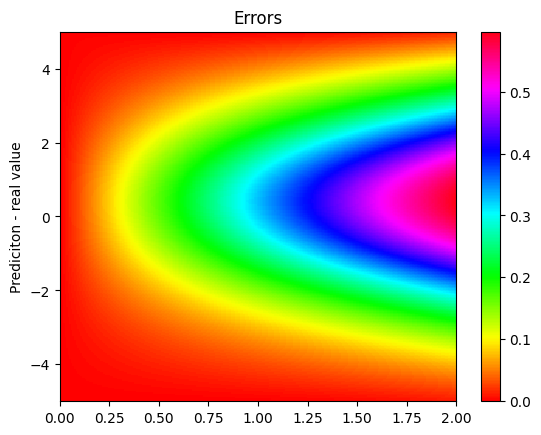


 m =  0.35000000000000003 

 ####################################################


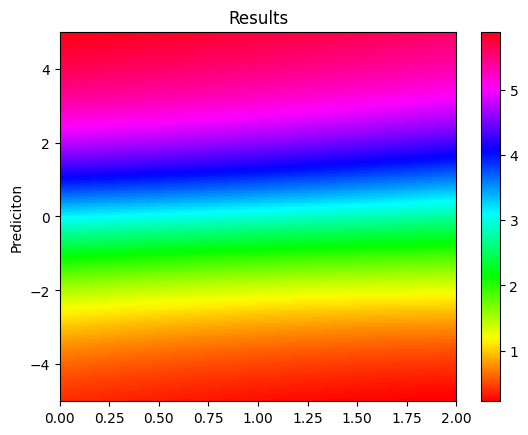

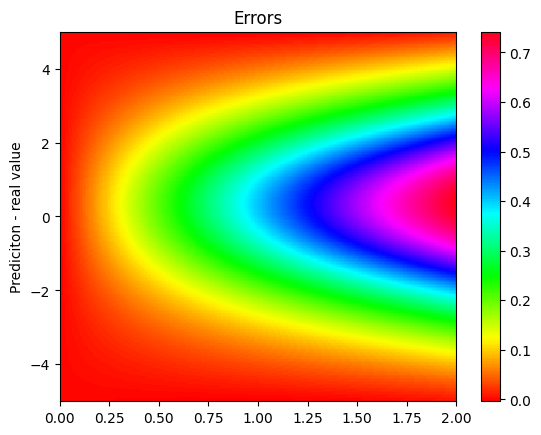


 m =  0.4 

 ####################################################


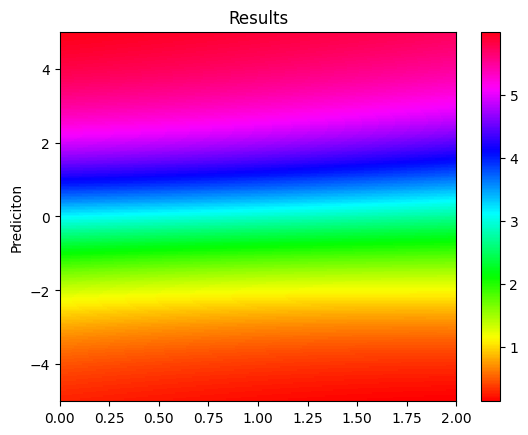

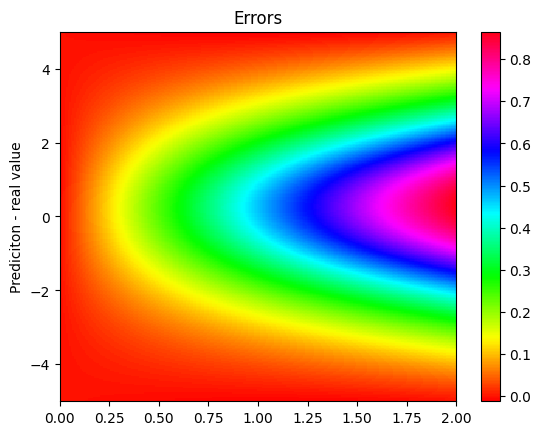

L2:  0.062887825 at variation:  20 ,  40 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783]  at identifier:  33 

Compiling model...
Building feed-forward neural network...
'build' took 0.120078 s

'compile' took 1.199904 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [9.50e-04, 1.25e+01, 2.78e+01, 6.61e-01]    [9.50e-04, 1.25e+01, 2.78e+01, 6.61e-01]    [9.75e-01]    
1000      [5.23e-04, 4.34e-03, 3.84e-04, 8.57e-04]    [5.23e-04, 4.34e-03, 3.84e-04, 8.57e-04]    [6.16e-02]    
2000      [2.78e-04, 8.14e-04, 2.08e-04, 4.20e-04]    [2.78e-04, 8.14e-04, 2.08e-04, 4.20e-04]    [7.36e-02]    
3000      [1.60e-04, 4.35e-04, 1.65e-05, 1.30e-04]    [1.60e-04, 4.35e-04, 1.65e-05, 1.30e-04]    [6.23e-02]    
4000      [1.18e-04, 3.81e-04, 9.54e-05, 2.99e-05]    [1.18e-04, 3.81e-04, 9.54e-05, 2.99e-05]    [5.36e-02]    
5000

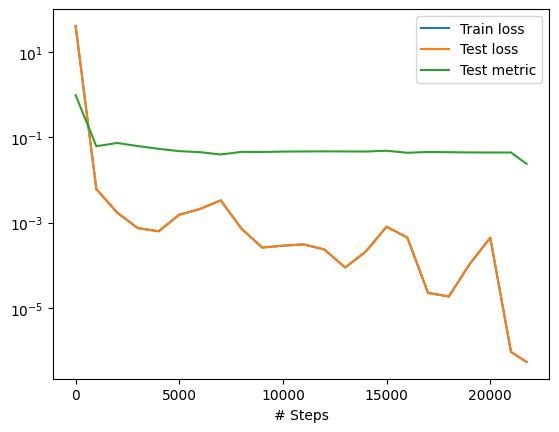


 m =  0.19 

 ####################################################


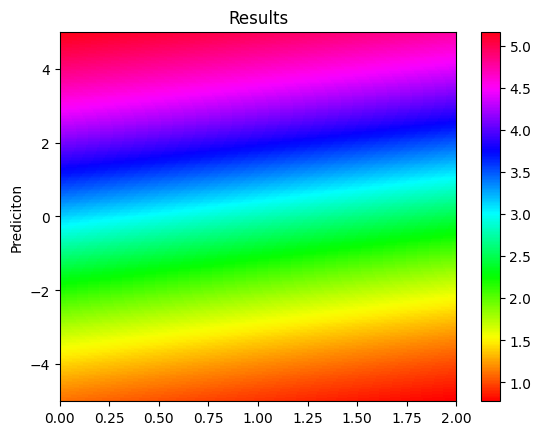

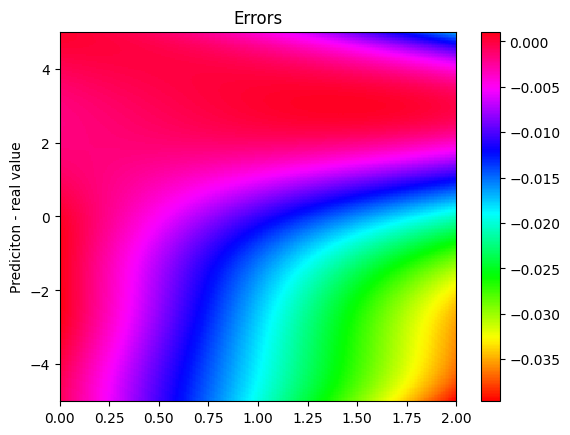


 m =  0.245 

 ####################################################


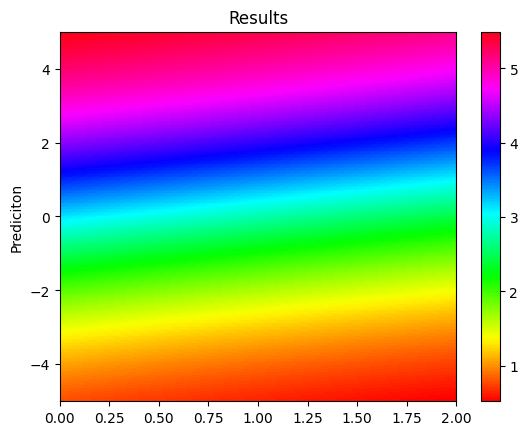

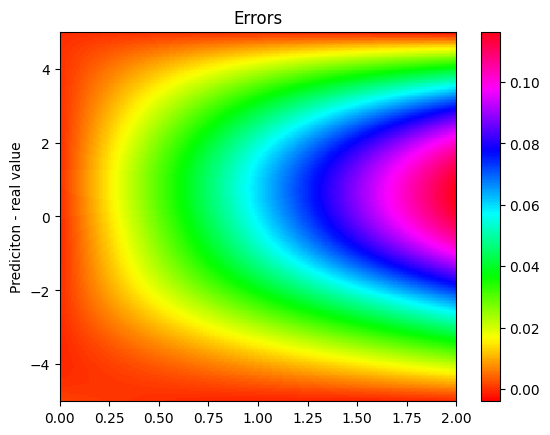


 m =  0.3 

 ####################################################


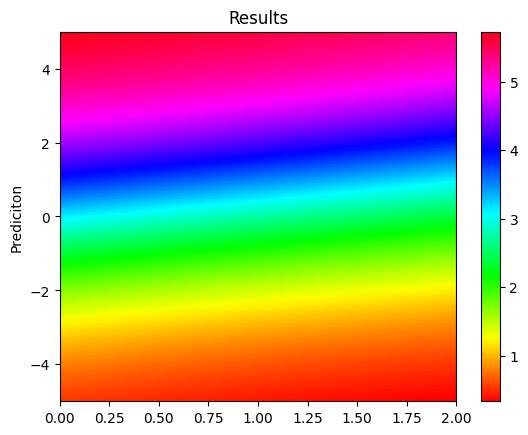

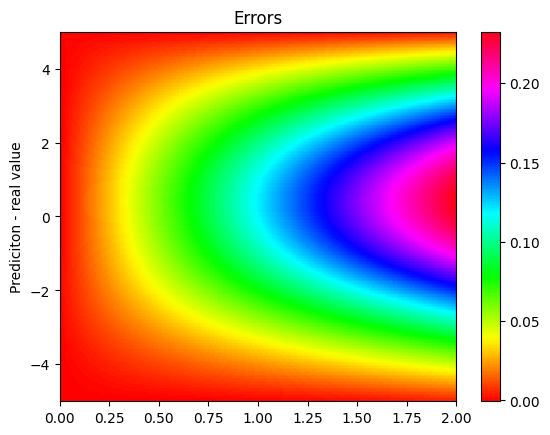


 m =  0.355 

 ####################################################


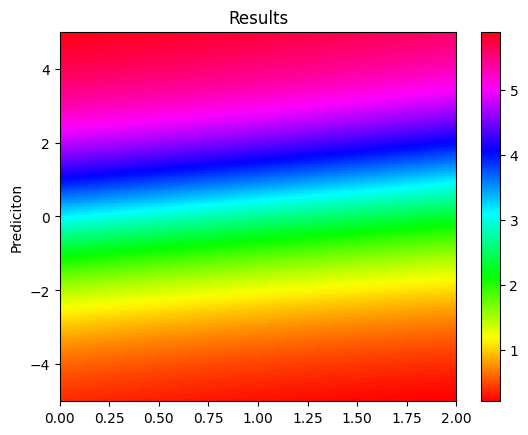

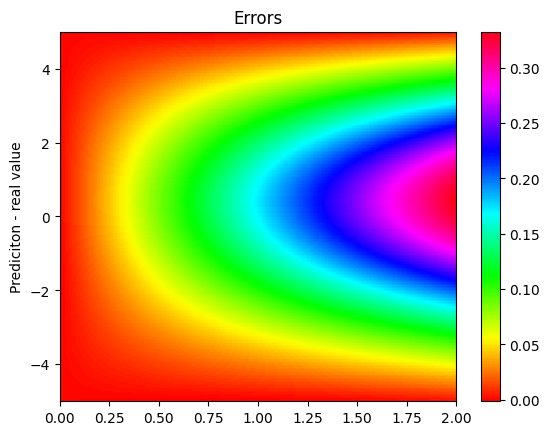


 m =  0.41 

 ####################################################


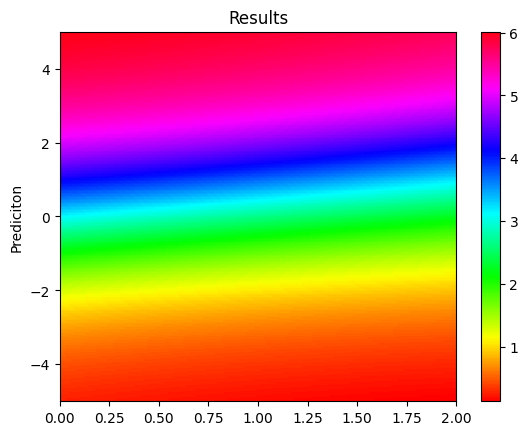

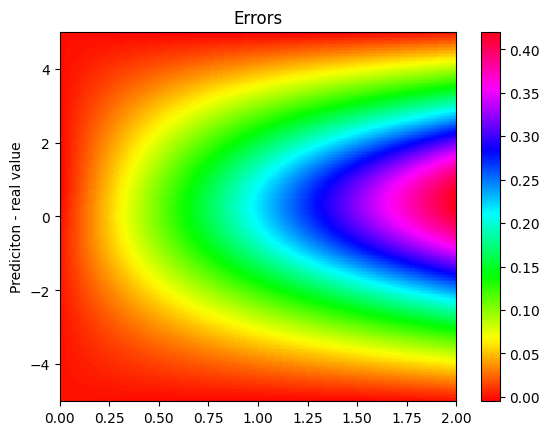

L2:  0.03502875 at variation:  19 ,  41 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875]  at identifier:  34 

Compiling model...
Building feed-forward neural network...
'build' took 0.137688 s

'compile' took 1.704599 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [6.72e-04, 1.32e+01, 3.20e+01, 2.45e-01]    [6.72e-04, 1.32e+01, 3.20e+01, 2.45e-01]    [1.02e+00]    
1000      [6.26e-04, 2.22e-03, 1.42e-04, 7.30e-04]    [6.26e-04, 2.22e-03, 1.42e-04, 7.30e-04]    [8.41e-02]    
2000      [2.27e-04, 5.46e-04, 1.71e-05, 5.10e-05]    [2.27e-04, 5.46e-04, 1.71e-05, 5.10e-05]    [8.35e-02]    
3000      [1.96e-04, 1.06e-03, 4.24e-04, 1.07e-03]    [1.96e-04, 1.06e-03, 4.24e-04, 1.07e-03]    [7.07e-02]    
4000      [1.41e-04, 4.75e-04, 7.29e-06, 1.73e-04]    [1.41e-04, 4.75e-04, 7.29e-06, 1.73e-04]    [7.19e-02

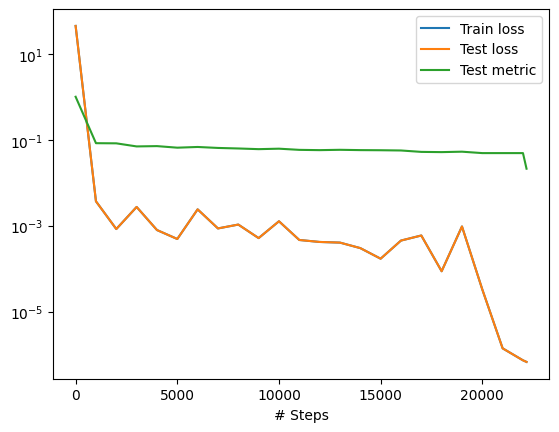


 m =  0.18 

 ####################################################


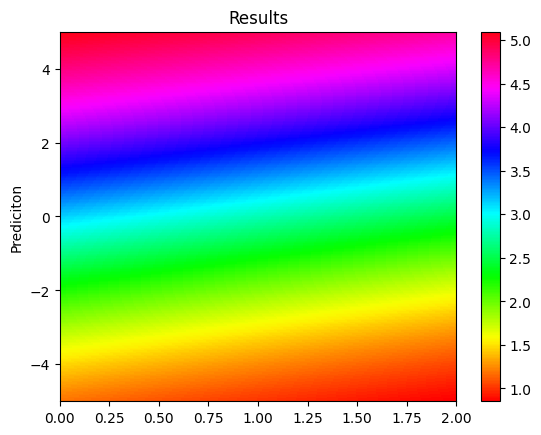

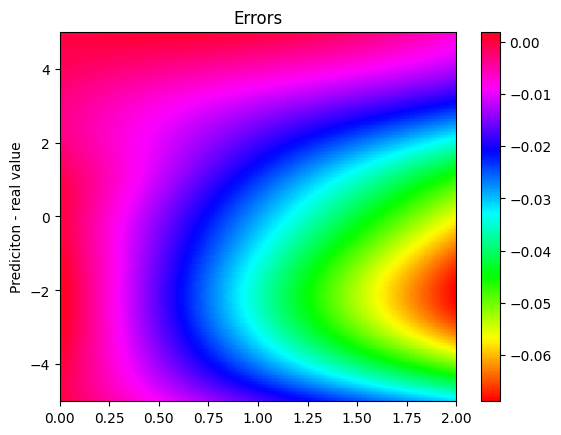


 m =  0.24 

 ####################################################


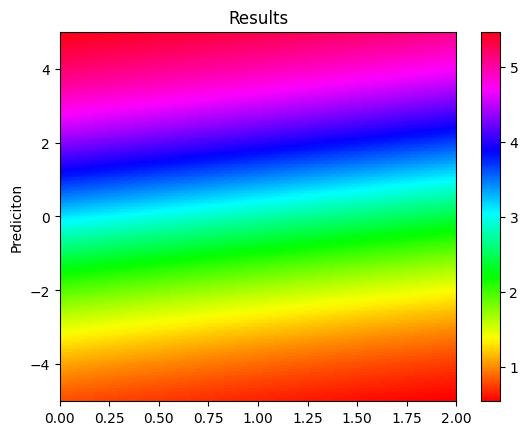

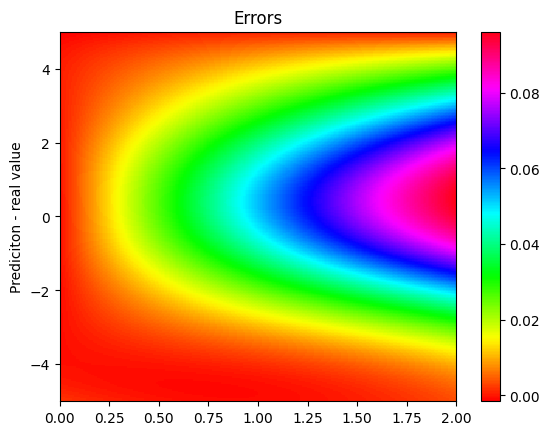


 m =  0.3 

 ####################################################


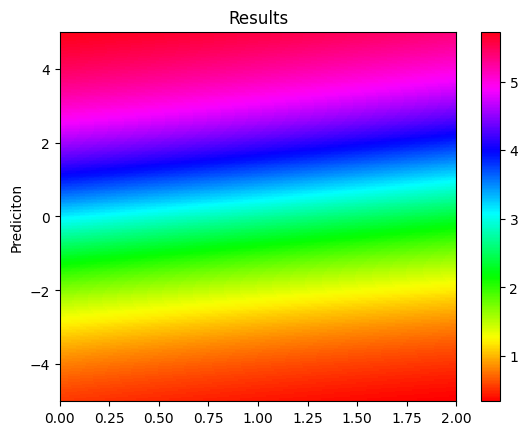

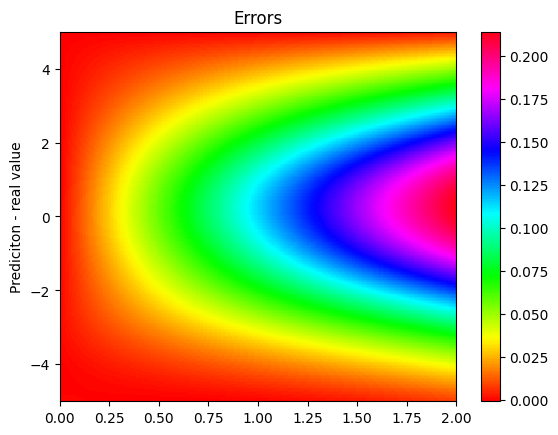


 m =  0.36 

 ####################################################


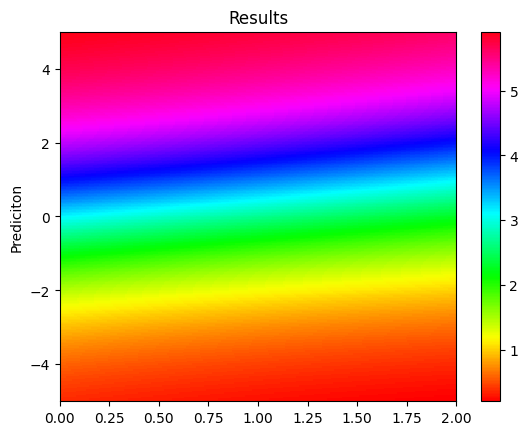

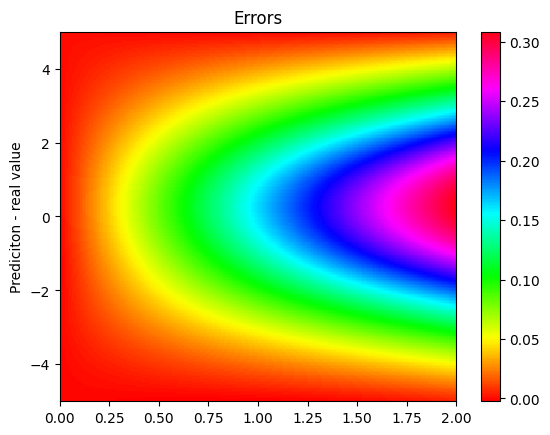


 m =  0.42 

 ####################################################


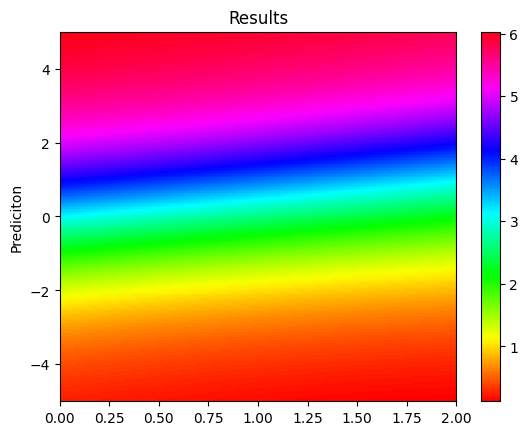

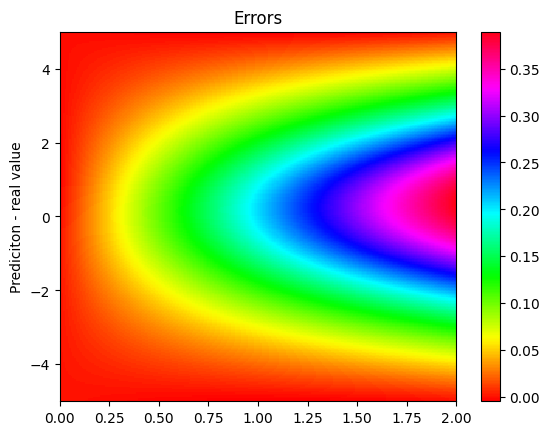

L2:  0.033911042 at variation:  18 ,  42 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104]  at identifier:  35 

Compiling model...
Building feed-forward neural network...
'build' took 0.111627 s

'compile' took 1.249373 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.03e-03, 1.19e+01, 2.69e+01, 7.98e-01]    [1.03e-03, 1.19e+01, 2.69e+01, 7.98e-01]    [9.58e-01]    
1000      [7.22e-04, 2.93e-03, 1.59e-04, 5.00e-04]    [7.22e-04, 2.93e-03, 1.59e-04, 5.00e-04]    [6.77e-02]    
2000      [2.74e-04, 6.50e-04, 2.16e-05, 3.65e-05]    [2.74e-04, 6.50e-04, 2.16e-05, 3.65e-05]    [6.94e-02]    
3000      [2.25e-04, 8.40e-04, 3.97e-04, 7.39e-04]    [2.25e-04, 8.40e-04, 3.97e-04, 7.39e-04]    [5.93e-02]    
4000      [1.82e-04, 5.23e-04, 2.99e-05, 2.80e-05]    [1.82e-04, 5.23e-04, 2.99e-05, 2.80e-05] 

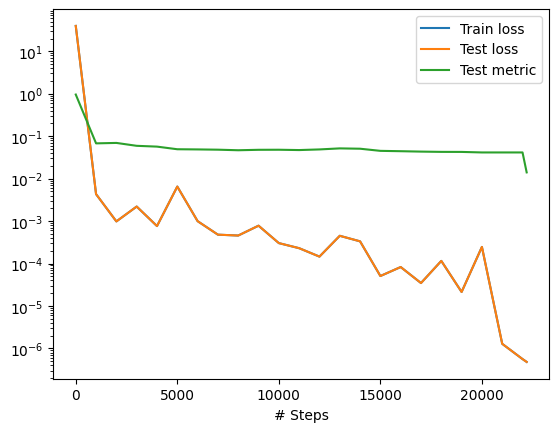


 m =  0.17 

 ####################################################


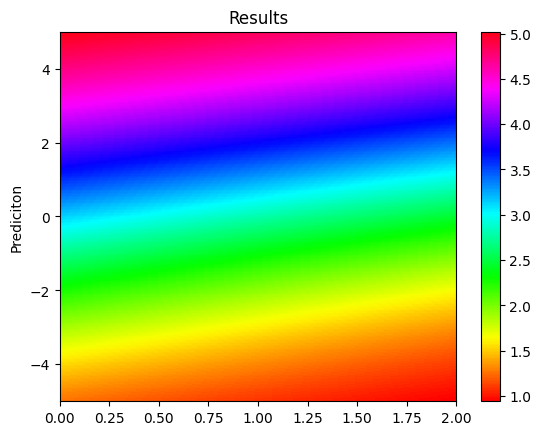

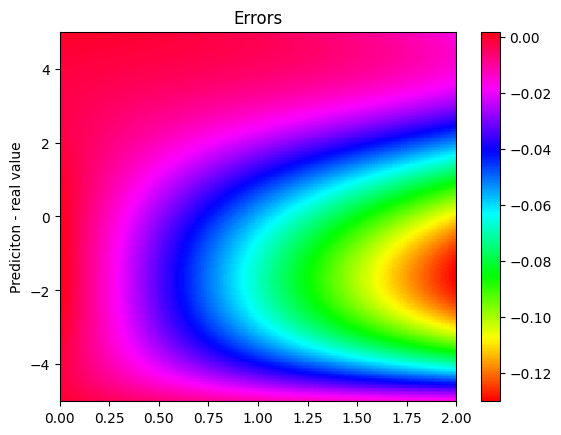


 m =  0.23500000000000001 

 ####################################################


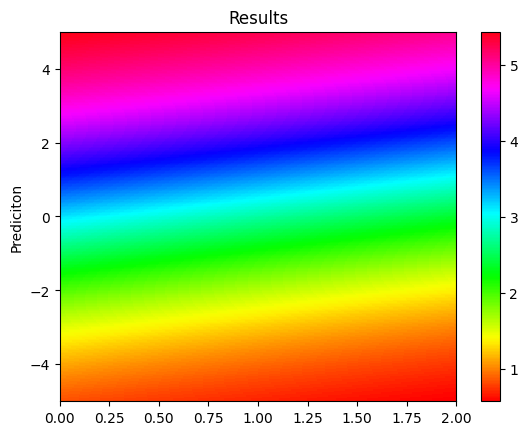

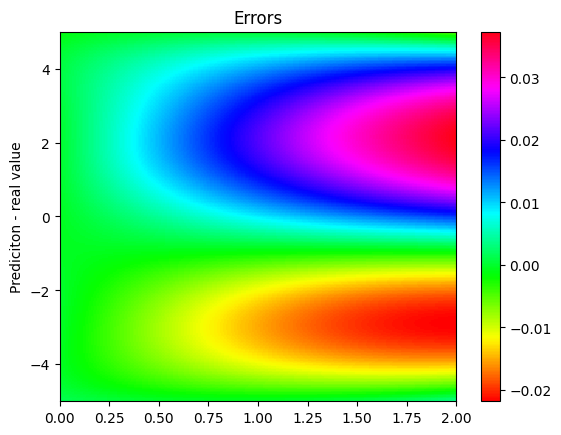


 m =  0.30000000000000004 

 ####################################################


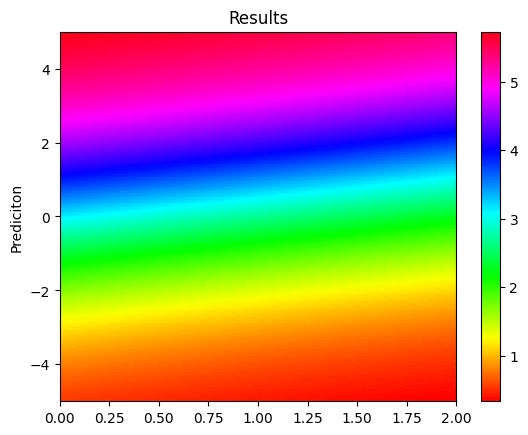

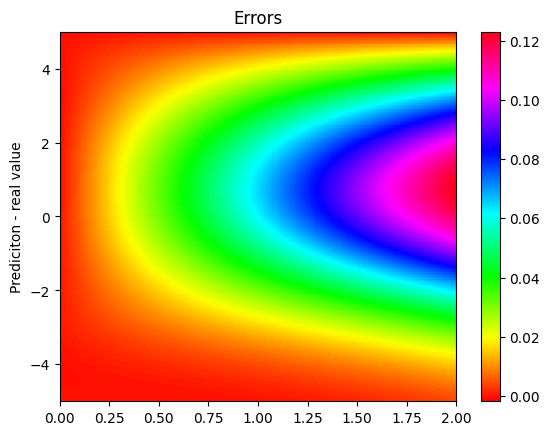


 m =  0.365 

 ####################################################


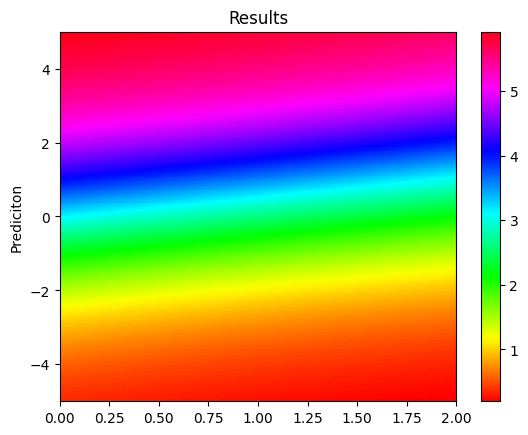

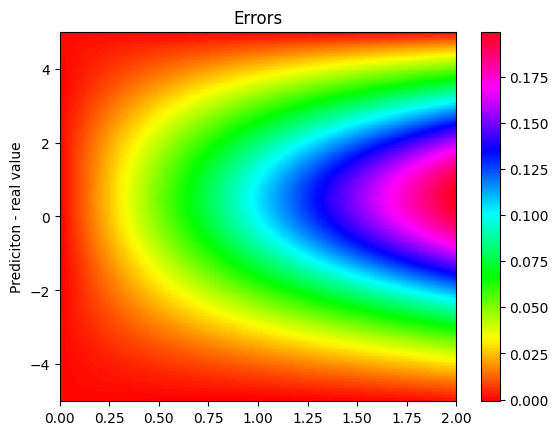


 m =  0.43 

 ####################################################


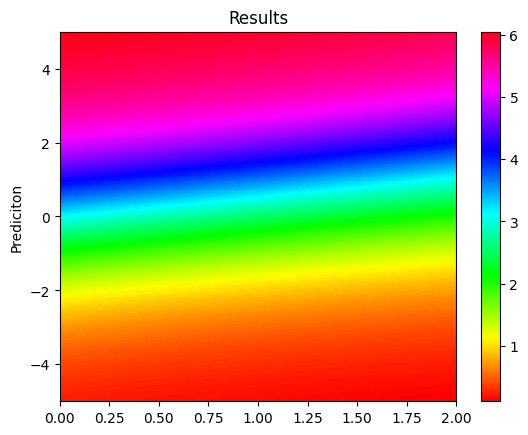

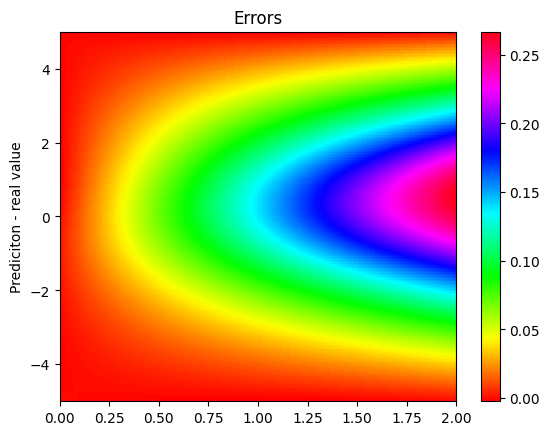

L2:  0.02576944 at variation:  17 ,  43 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944]  at identifier:  36 

Compiling model...
Building feed-forward neural network...
'build' took 0.109609 s

'compile' took 1.339919 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [6.81e-05, 1.27e+01, 2.97e+01, 4.87e-01]    [6.81e-05, 1.27e+01, 2.97e+01, 4.87e-01]    [9.98e-01]    
1000      [8.58e-04, 1.56e-03, 5.25e-05, 5.16e-04]    [8.58e-04, 1.56e-03, 5.25e-05, 5.16e-04]    [6.56e-02]    
2000      [2.87e-04, 9.97e-04, 3.38e-04, 3.32e-04]    [2.87e-04, 9.97e-04, 3.38e-04, 3.32e-04]    [7.85e-02]    
3000      [1.81e-04, 7.84e-04, 1.91e-04, 6.46e-04]    [1.81e-04, 7.84e-04, 1.91e-04, 6.46e-04]    [7.56e-02]    
4000      [1.43e-04, 7.80e-04, 8.20e-04, 2.00e-04]    [1.43e-04, 7.80e-04, 8.20e-04,

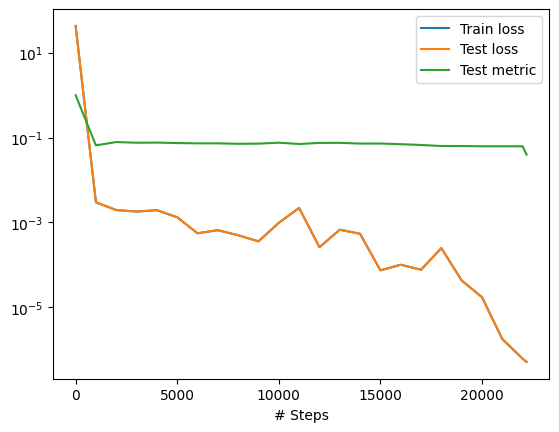


 m =  0.16 

 ####################################################


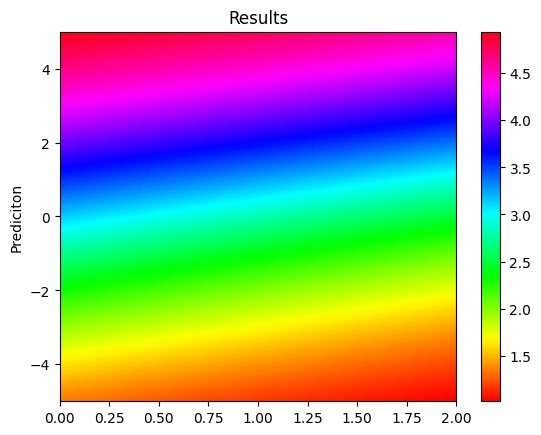

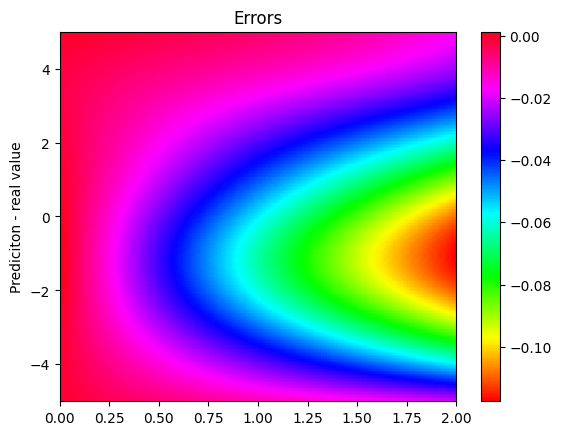


 m =  0.23 

 ####################################################


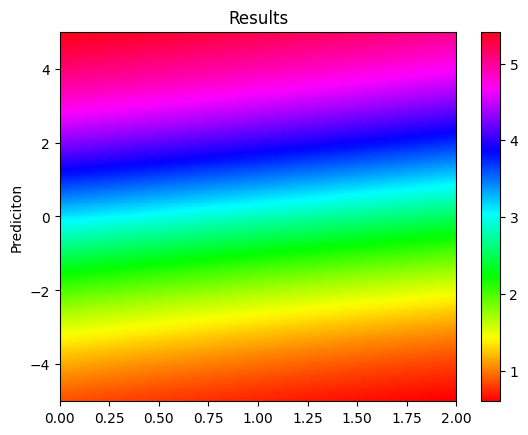

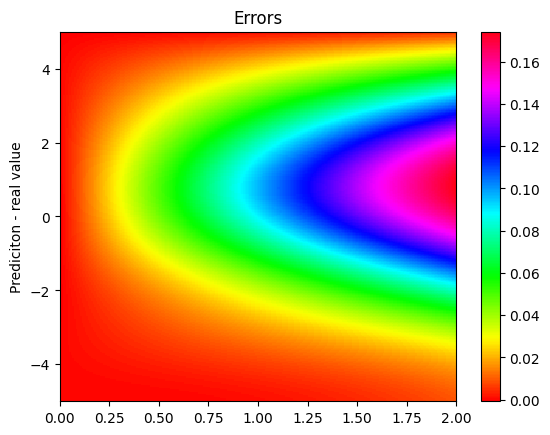


 m =  0.30000000000000004 

 ####################################################


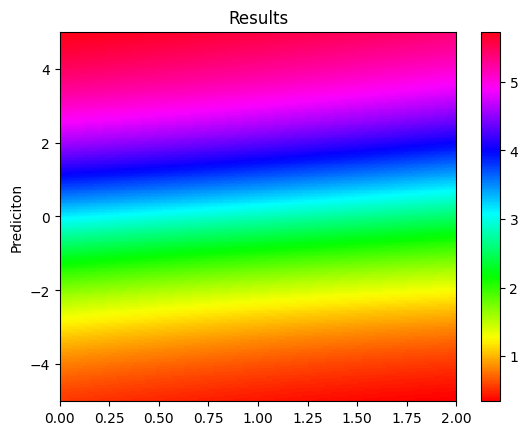

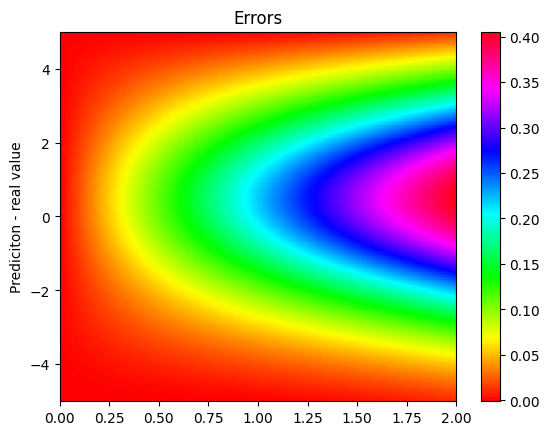


 m =  0.37 

 ####################################################


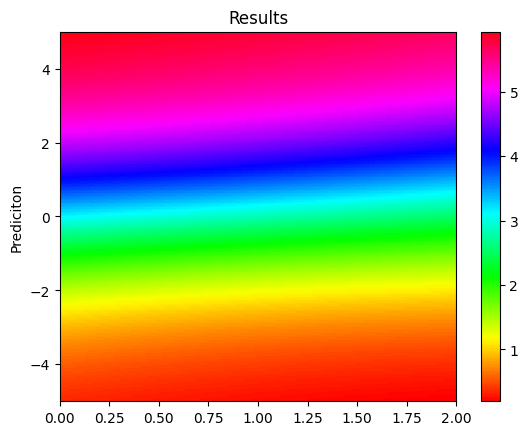

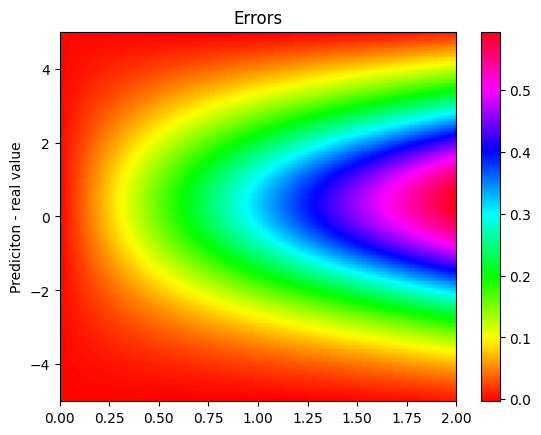


 m =  0.44 

 ####################################################


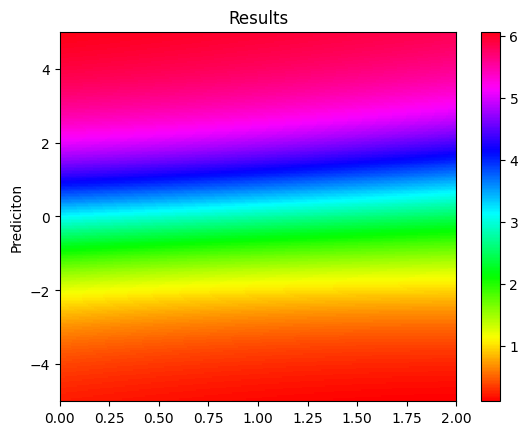

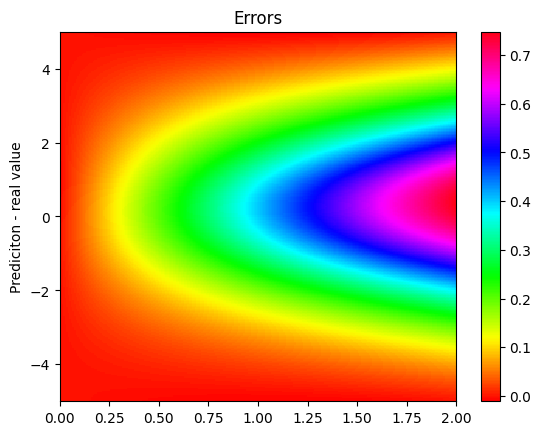

L2:  0.053407103 at variation:  16 ,  44 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071 ]  at identifier:  37 

Compiling model...
Building feed-forward neural network...
'build' took 0.497828 s

'compile' took 1.753049 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [3.25e-04, 1.32e+01, 3.25e+01, 2.74e-01]    [3.25e-04, 1.32e+01, 3.25e+01, 2.74e-01]    [1.02e+00]    
1000      [6.42e-04, 2.69e-03, 1.46e-04, 5.77e-04]    [6.42e-04, 2.69e-03, 1.46e-04, 5.77e-04]    [6.59e-02]    
2000      [4.68e-04, 8.05e-03, 2.03e-03, 2.06e-02]    [4.68e-04, 8.05e-03, 2.03e-03, 2.06e-02]    [6.33e-02]    
3000      [2.85e-04, 4.94e-03, 4.53e-03, 6.34e-03]    [2.85e-04, 4.94e-03, 4.53e-03, 6.34e-03]    [7.60e-02]    
4000      [2.02e-04, 6.64e-04, 6.22e-05, 1.05e-05]    [2.02e-04, 6.64e-0

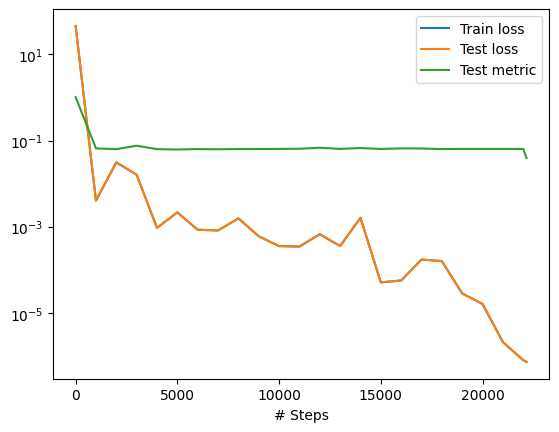


 m =  0.15 

 ####################################################


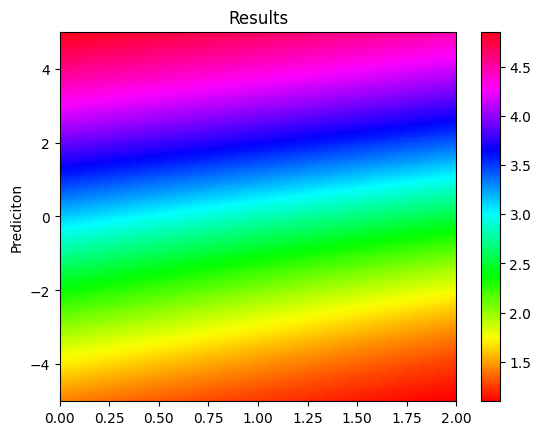

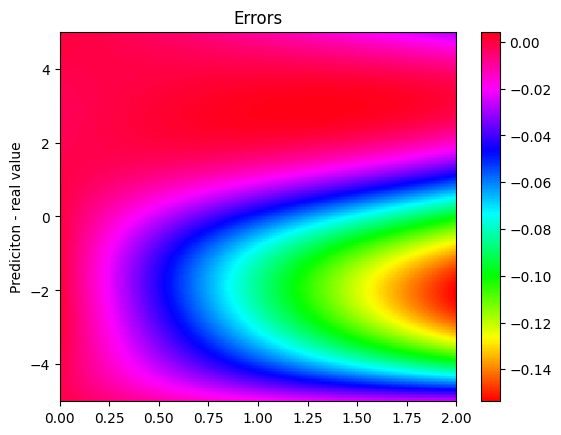


 m =  0.225 

 ####################################################


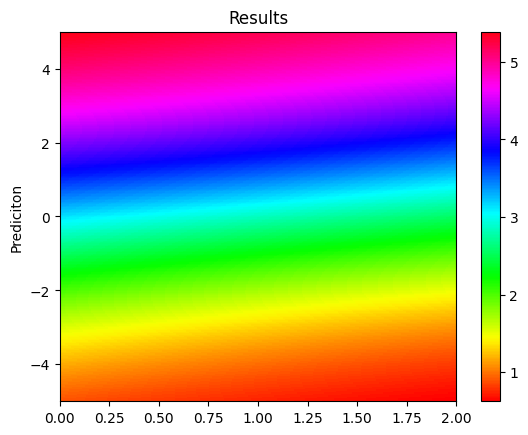

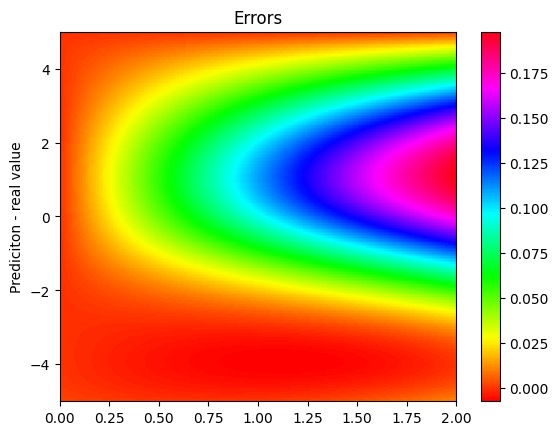


 m =  0.30000000000000004 

 ####################################################


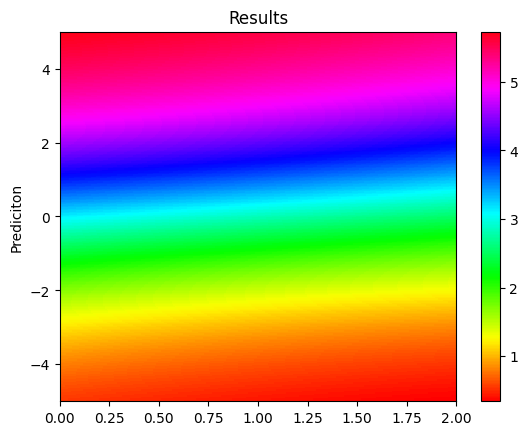

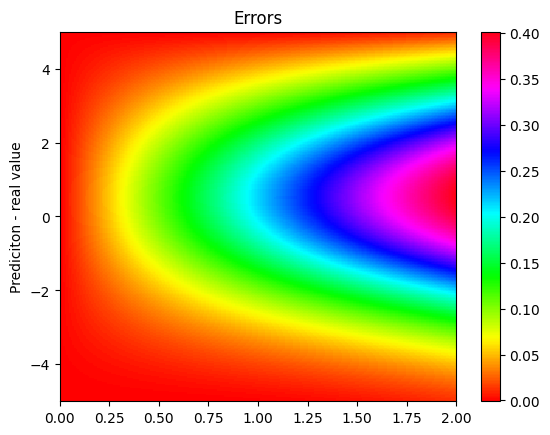


 m =  0.375 

 ####################################################


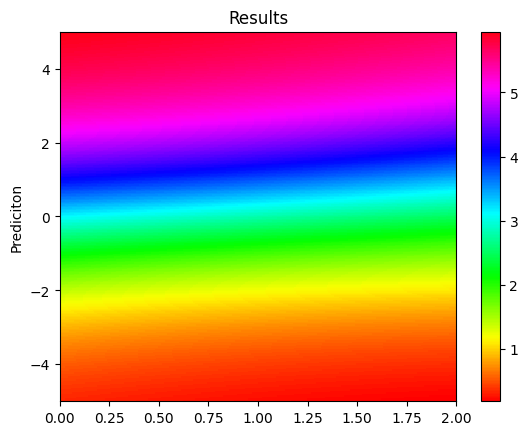

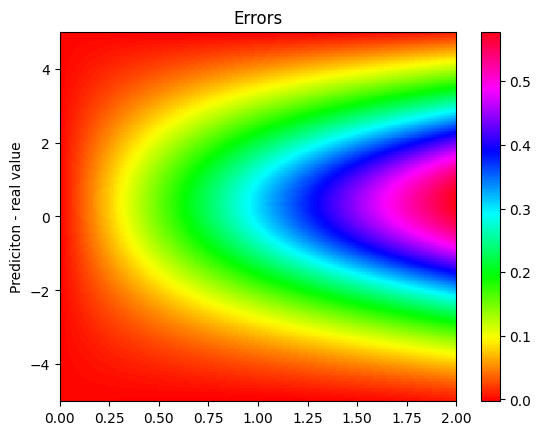


 m =  0.45 

 ####################################################


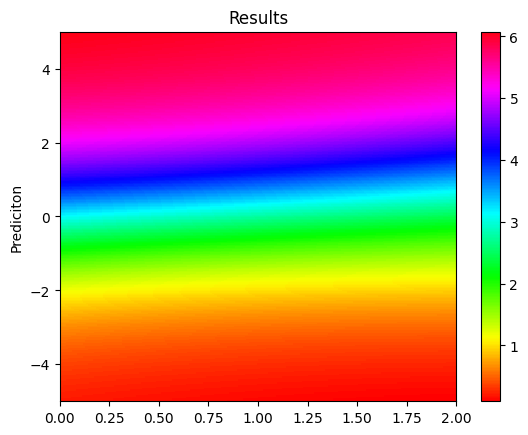

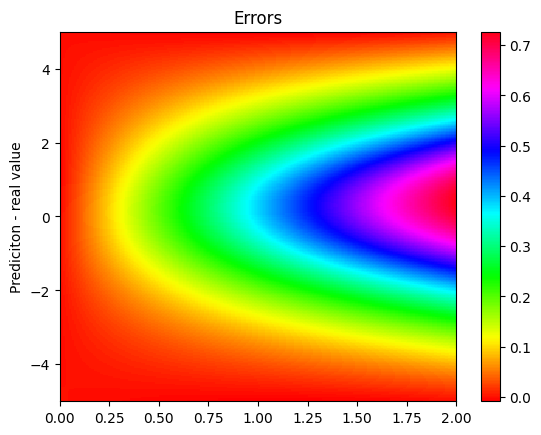

L2:  0.052677732 at variation:  15 ,  45 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773]  at identifier:  38 

Compiling model...
Building feed-forward neural network...
'build' took 0.108438 s

'compile' took 1.419117 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.43e-04, 1.33e+01, 3.17e+01, 2.61e-01]    [2.43e-04, 1.33e+01, 3.17e+01, 2.61e-01]    [1.00e+00]    
1000      [7.97e-04, 1.58e-03, 6.06e-05, 3.52e-04]    [7.97e-04, 1.58e-03, 6.06e-05, 3.52e-04]    [6.38e-02]    
2000      [3.60e-04, 9.62e-04, 1.97e-04, 5.73e-05]    [3.60e-04, 9.62e-04, 1.97e-04, 5.73e-05]    [7.71e-02]    


KeyboardInterrupt: 

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

upper=39#centésimos
botton=21
identifier=31
#L2_list=np.array([])
L2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_8.npy")
L2=0
while (botton>0):


    #Boundary points
    sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
    sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
    n_rand=256
    sample = sampler.random(n_rand)
    sample2 = sampler2.random(n_rand)
    #print(sample)
    #sample.sort
    #print(np.array(sample))
    #boundary condition sample:
    x1 = np.vstack(np.ones(int(n_rand/2))*5)
    x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
    m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
    t0 = sample*2

    X_anchors=np.concatenate((x1,m,t0), axis=1)



    timedomain = dde.geometry.TimeDomain(0, 2)
    geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

    geomtime = dde.geometry.GeometryXTime(geom, timedomain)



    # Define sine function
    if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
        from deepxde.backend import tf

        cos = tf.cos
        sin = tf.sin
    elif dde.backend.backend_name == "paddle":
        import paddle

        cos = paddle.cos
        sin = paddle.sin


    def pde(x, y):
        alpha = -1
        v=0.65

        dy_tt = dde.grad.hessian(y, x, i=2, j=2)
        dy_xx = dde.grad.hessian(y, x, i=0, j=0)
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        return (
            dy_tt
            + alpha * dy_xx
            + m**2*sin(y)
        )

    def func(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

        v = 0.65
        gamma = np.sqrt(1/(1-v**2))
        delt=0


        return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
        #return x[:, 0:1] * np.cos(x[:, 1:2])

    def deriv(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        v = 0.65
        gamma = tf.sqrt(1/(1-v**2))
        delt=0

        return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


    def boundary(x,_):
        return np.isclose(x[2],0)

    def boundary_up(x,_):
        return np.isclose(x[0],5.0)
    def boundary_down(x,_):
        return np.isclose(x[0],-5.0)


    bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
    bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
    #ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
    ic_1 = dde.icbc.IC(geomtime, func, boundary)
    ic_2 = dde.icbc.OperatorBC(
        geomtime,
        lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
        boundary,
    )

    data = dde.data.TimePDE(
        geomtime,
        pde,
        [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
        num_domain=2000,
        num_boundary=0,
        num_initial=128,
        solution=func,
        num_test=None,
        anchors=X_anchors
    )

    layer_size = [3] + [200] * 6 + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)

    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )
    losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")
    dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
    )
    model.compile("L-BFGS", metrics=["l2 relative error"])
    losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
    dde.saveplot(losshistory, train_state, issave=True, isplot=True)
    for i in np.linspace(botton/100,upper/100, 5):
        print("\n m = ",i,"\n\n ####################################################")
        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        m= np.ones(65536)*i
        #m=m.reshape(-1,1)
        m=np.vstack(m)

        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        x1,t1=np.split(X_star, 2, axis=1)
        X_star_m= np.concatenate((x1,m,t1), axis=1)

        prediction = model.predict(X_star_m, operator=None)

        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Results")
        ax.set_ylabel("Prediciton")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()

        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        prediction = model.predict(X_star_m, operator=None)
        real=func(X_star_m)
        prediction=prediction-real
        #prediction=np.sqrt(prediction*prediction)


        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Errors")
        ax.set_ylabel("Prediciton - real value")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()


    L2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
    print("L2: ",L2,"at variation: ",botton, ", ",upper,"\n")

    upper+=1
    botton-=1
    identifier+=1

    L2_list=np.append(L2_list,L2)
    print("L2_list= ", L2_list, " at identifier: ",identifier , "\n")

    np.save('/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_'+str(np.shape(L2_list)[0])+'.npy',L2_list)





In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_8.npy


L2_errors_lbfgs_1.npy  L2_errors_lbfgs_3.npy  L2_errors_lbfgs_5.npy  L2_errors_lbfgs_7.npy
L2_errors_lbfgs_2.npy  L2_errors_lbfgs_4.npy  L2_errors_lbfgs_6.npy  L2_errors_lbfgs_8.npy


#Continuacao Automatizando lbfgs 2

In [ ]:
identifier = 38
print("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")

/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/31/model.ckpt


In [ ]:
#ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/30
L2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_15")

In [ ]:
L2_list

array([0.01907848, 0.02393539, 0.02770672, 0.04998742, 0.05994061,
       0.06446929, 0.08758008, 0.06205007, 0.06390987, 0.06288783,
       0.03502875, 0.03391104, 0.02576944, 0.0534071 , 0.05267773])

Compiling model...
Building feed-forward neural network...


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'build' took 0.271060 s

'compile' took 2.435297 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.79e-03, 1.25e+01, 2.58e+01, 1.25e+00]    [1.79e-03, 1.25e+01, 2.58e+01, 1.25e+00]    [9.65e-01]    
1000      [5.97e-04, 1.76e-03, 6.97e-05, 3.85e-04]    [5.97e-04, 1.76e-03, 6.97e-05, 3.85e-04]    [5.24e-02]    
2000      [4.22e-04, 1.00e-03, 1.67e-04, 1.17e-04]    [4.22e-04, 1.00e-03, 1.67e-04, 1.17e-04]    [6.60e-02]    
3000      [2.93e-04, 2.89e-03, 5.80e-03, 2.47e-03]    [2.93e-04, 2.89e-03, 5.80e-03, 2.47e-03]    [7.78e-02]    
4000      [2.41e-04, 7.84e-04, 8.65e-05, 5.41e-05]    [2.41e-04, 7.84e-04, 8.65e-05, 5.41e-05]    [7.60e-02]    
5000      [2.65e-04, 2.78e-03, 2.70e-03, 2.56e-03]    [2.65e-04, 2.78e-03, 2.70e-03, 2.56e-03]    [7.39e-02]    
6000      [1.51e-04, 1.60e-03, 1.38e-03, 1.33e-03]    [1.51e-04, 1.60e-03, 1.38e-03, 1.33e-03]    [8.80e-02]    
7000      [1.05e-04, 5.08

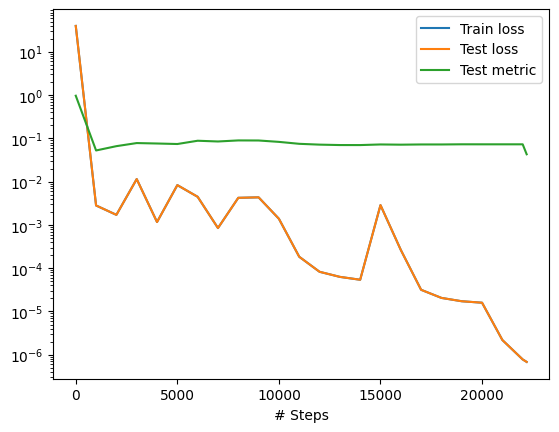


 m =  0.14 

 ####################################################


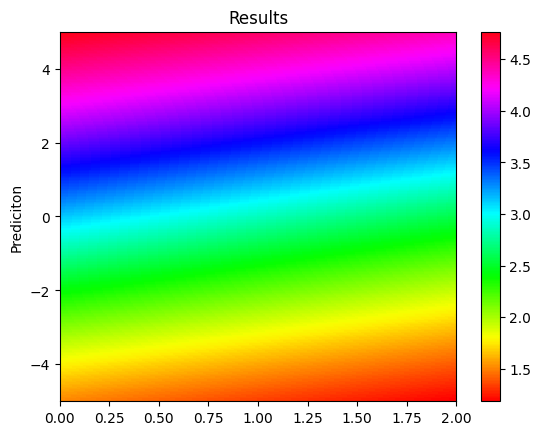

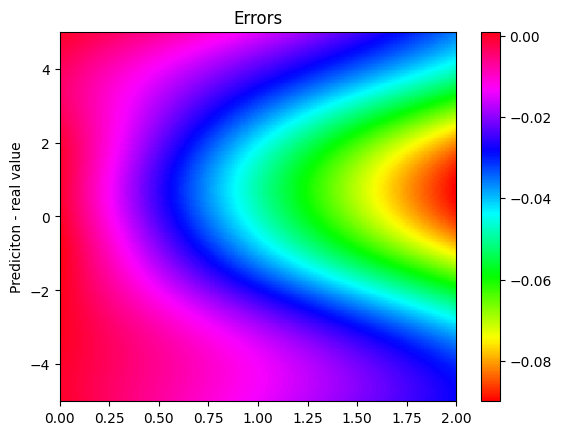


 m =  0.22000000000000003 

 ####################################################


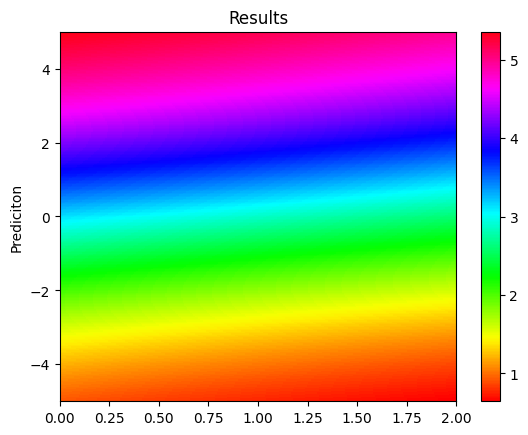

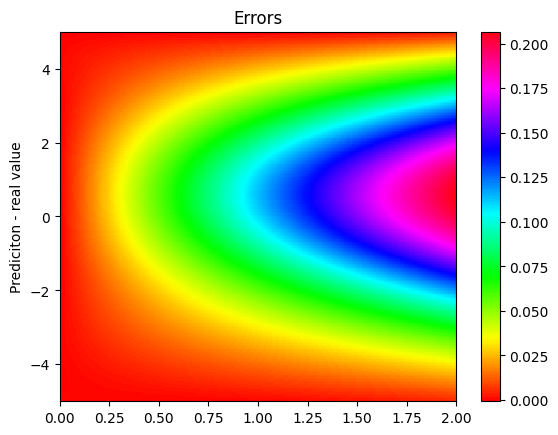


 m =  0.30000000000000004 

 ####################################################


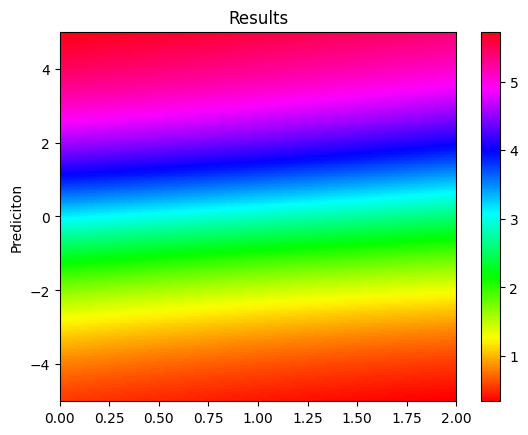

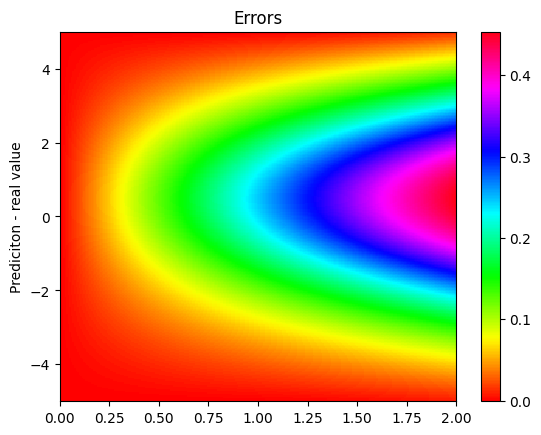


 m =  0.38 

 ####################################################


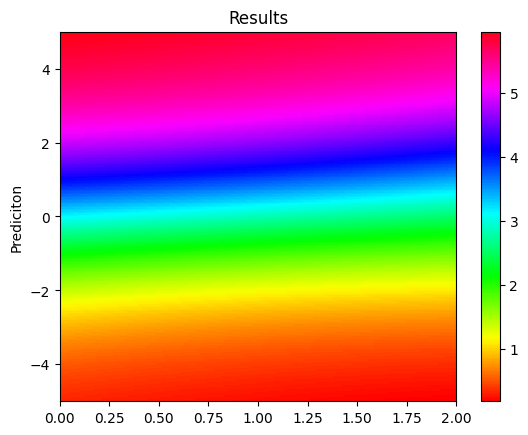

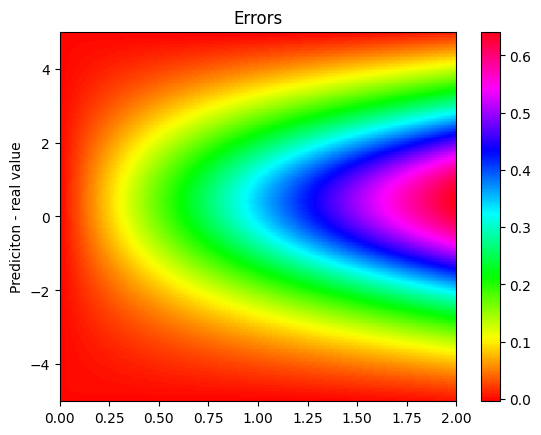


 m =  0.46 

 ####################################################


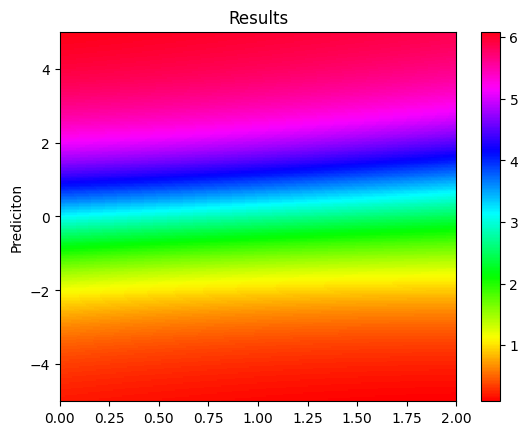

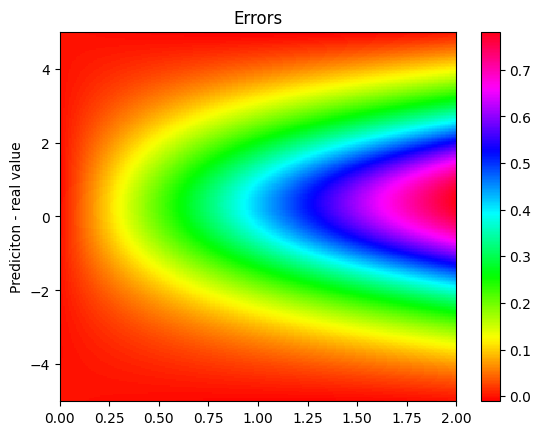

L2:  0.05444127 at variation:  14 ,  46 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127]  at identifier:  39 

Compiling model...
Building feed-forward neural network...
'build' took 0.133073 s

'compile' took 1.954046 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.95e-03, 1.43e+01, 3.57e+01, 2.18e-01]    [1.95e-03, 1.43e+01, 3.57e+01, 2.18e-01]    [1.08e+00]    
1000      [5.94e-04, 1.39e-03, 5.39e-05, 7.93e-05]    [5.94e-04, 1.39e-03, 5.39e-05, 7.93e-05]    [9.30e-02]    
2000      [3.60e-04, 1.06e-03, 3.50e-05, 6.28e-05]    [3.60e-04, 1.06e-03, 3.50e-05, 6.28e-05]    [7.36e-02]    
3000      [2.83e-04, 9.33e-04, 1.74e-04, 2.96e-05]    [2.83e-04, 9.33e-04, 1.74e-04, 2.96e-05]    [6.80e-02]    
4000      [2.15e-04, 7.60e-04, 1.95e-05, 2.10e-05] 

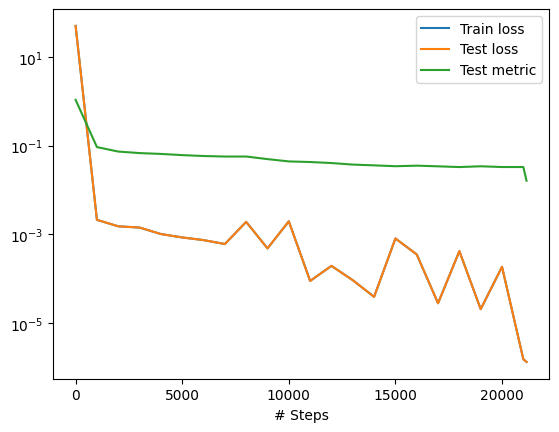


 m =  0.13 

 ####################################################


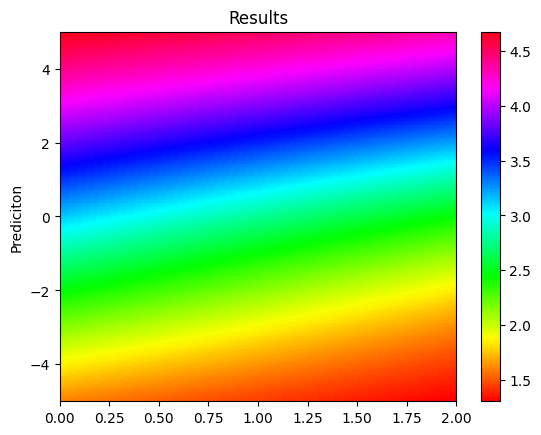

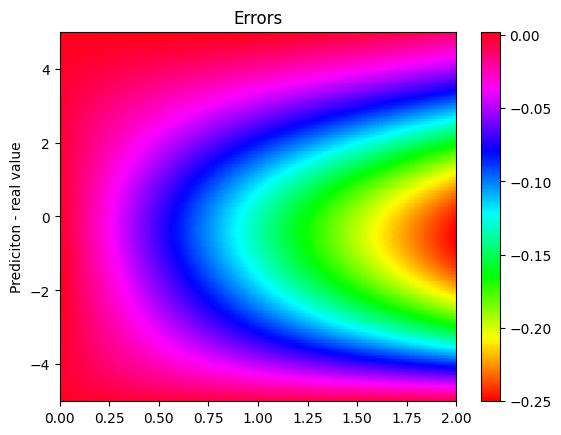


 m =  0.215 

 ####################################################


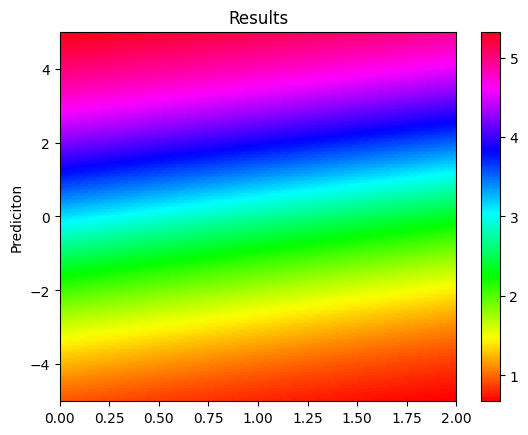

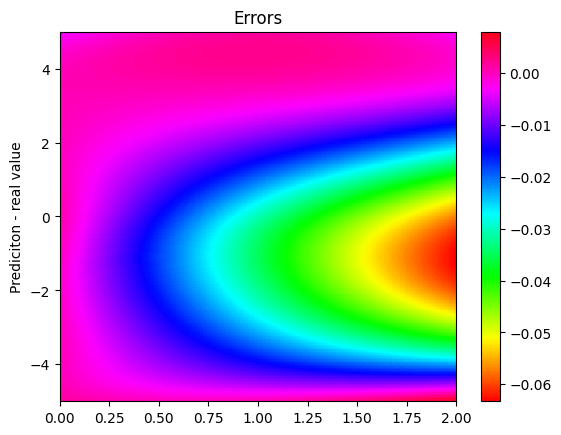


 m =  0.3 

 ####################################################


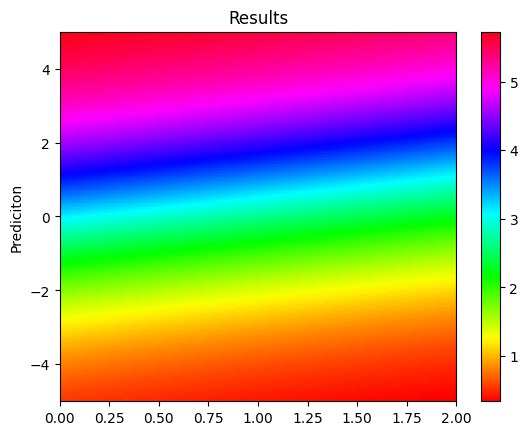

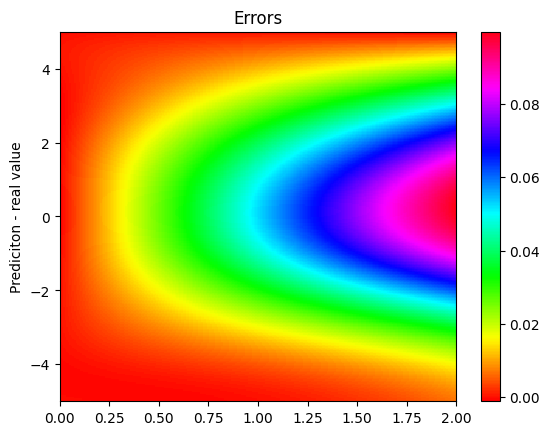


 m =  0.385 

 ####################################################


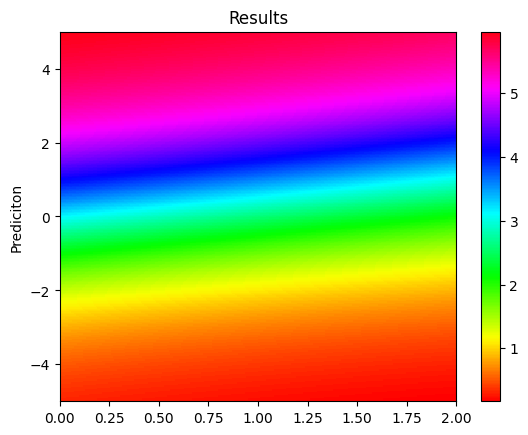

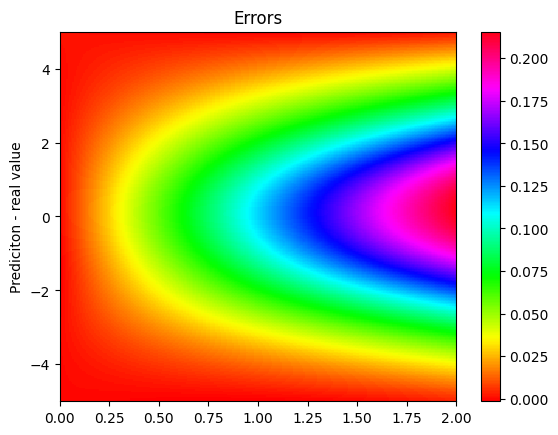


 m =  0.47 

 ####################################################


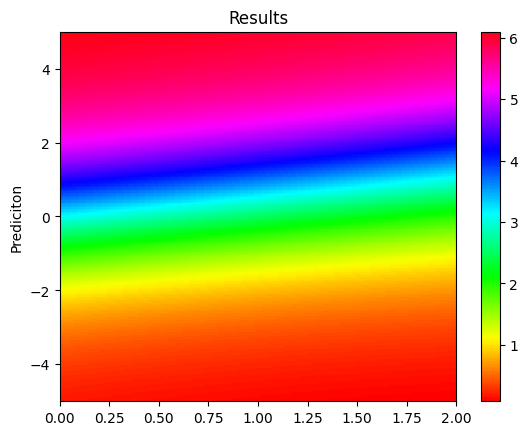

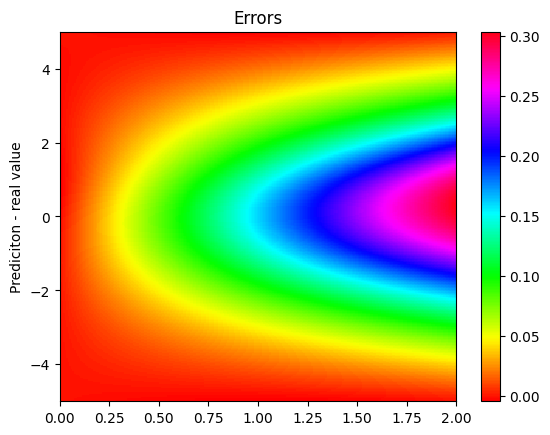

L2:  0.029478934 at variation:  13 ,  47 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893]  at identifier:  40 

Compiling model...
Building feed-forward neural network...
'build' took 0.089692 s

'compile' took 1.049868 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.19e-03, 1.40e+01, 3.53e+01, 2.66e-01]    [1.19e-03, 1.40e+01, 3.53e+01, 2.66e-01]    [1.07e+00]    
1000      [7.44e-04, 2.01e-03, 1.08e-04, 1.56e-04]    [7.44e-04, 2.01e-03, 1.08e-04, 1.56e-04]    [8.30e-02]    
2000      [4.99e-04, 1.41e-03, 7.32e-05, 3.11e-05]    [4.99e-04, 1.41e-03, 7.32e-05, 3.11e-05]    [7.33e-02]    
3000      [4.04e-04, 1.28e-03, 7.55e-05, 4.12e-04]    [4.04e-04, 1.28e-03, 7.55e-05, 4.12e-04]    [6.69e-02]    
4000      [3.06e-04, 1.30e-03, 6.36e-04

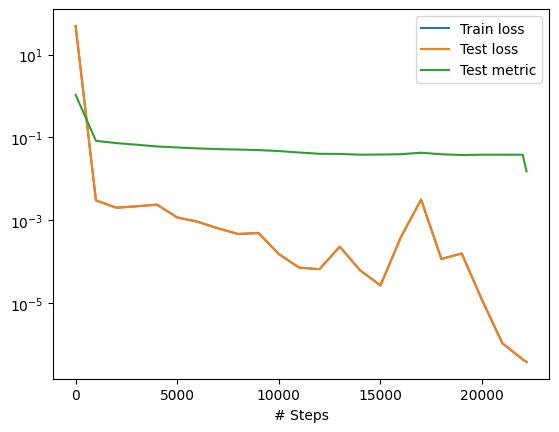


 m =  0.12 

 ####################################################


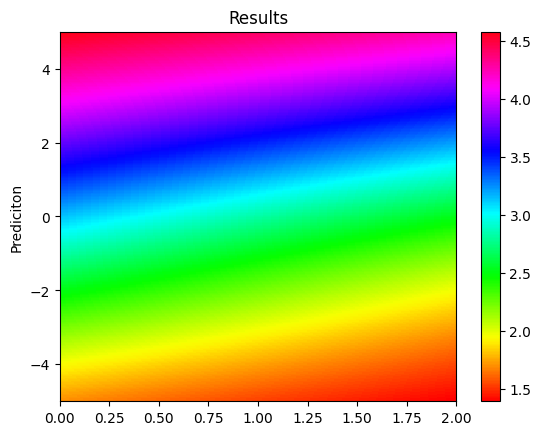

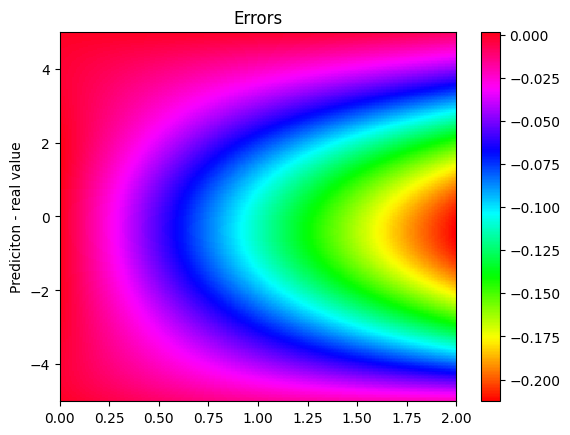


 m =  0.21 

 ####################################################


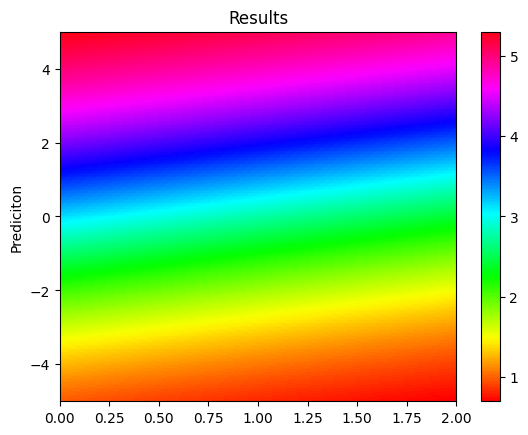

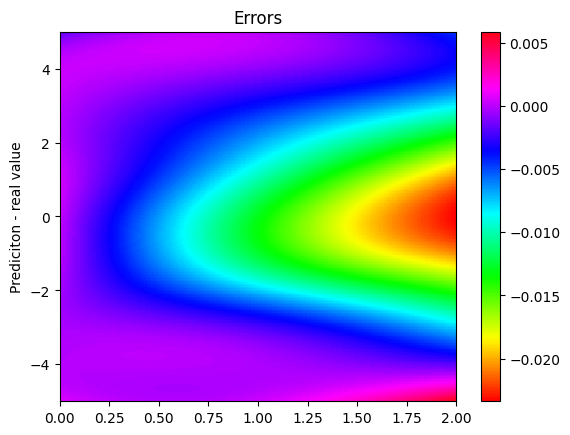


 m =  0.3 

 ####################################################


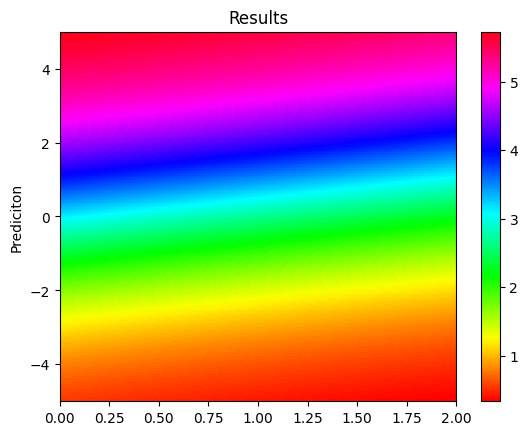

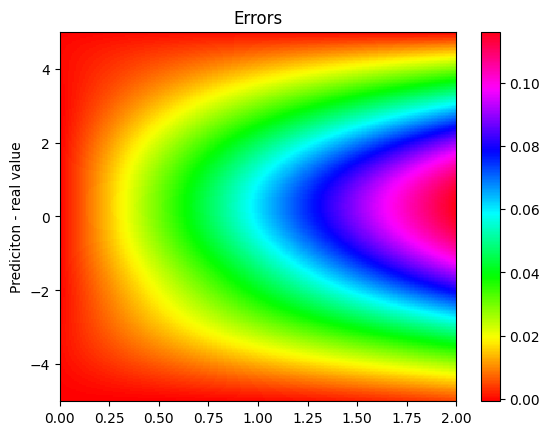


 m =  0.39 

 ####################################################


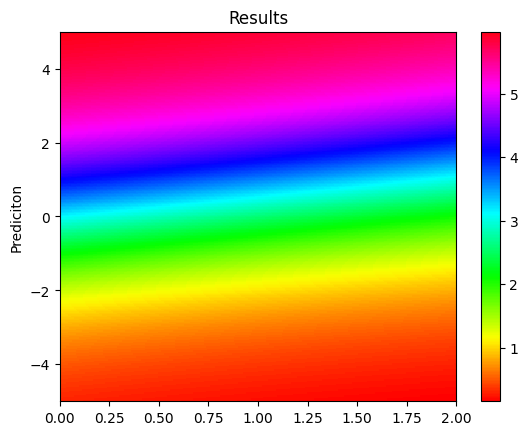

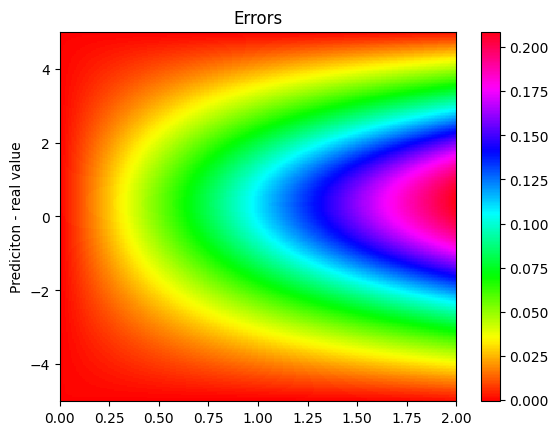


 m =  0.48 

 ####################################################


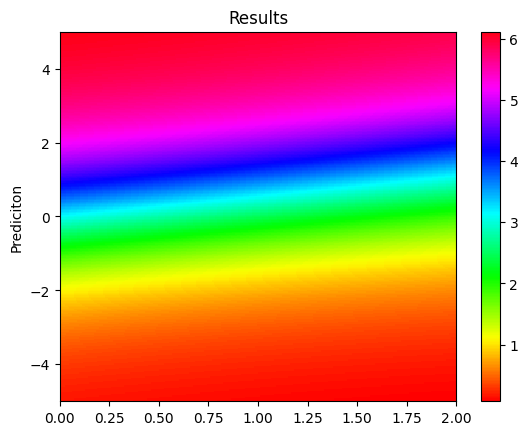

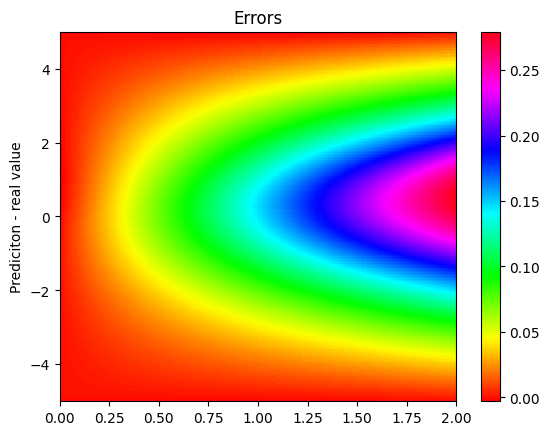

L2:  0.028229833 at variation:  12 ,  48 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983]  at identifier:  41 

Compiling model...
Building feed-forward neural network...
'build' took 0.097779 s

'compile' took 1.114294 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.49e-03, 1.39e+01, 3.52e+01, 2.67e-01]    [2.49e-03, 1.39e+01, 3.52e+01, 2.67e-01]    [1.04e+00]    
1000      [1.01e-03, 2.32e-03, 2.43e-04, 5.37e-04]    [1.01e-03, 2.32e-03, 2.43e-04, 5.37e-04]    [6.41e-02]    
2000      [4.88e-04, 1.57e-03, 3.39e-05, 3.74e-05]    [4.88e-04, 1.57e-03, 3.39e-05, 3.74e-05]    [6.96e-02]    
3000      [3.98e-04, 1.64e-03, 5.07e-04, 3.93e-04]    [3.98e-04, 1.64e-03, 5.07e-04, 3.93e-04]    [7.52e-02]    
4000      [3.09e-04, 1.31e-0

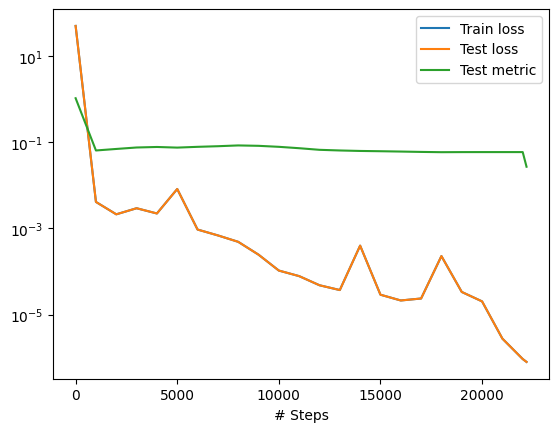


 m =  0.11 

 ####################################################


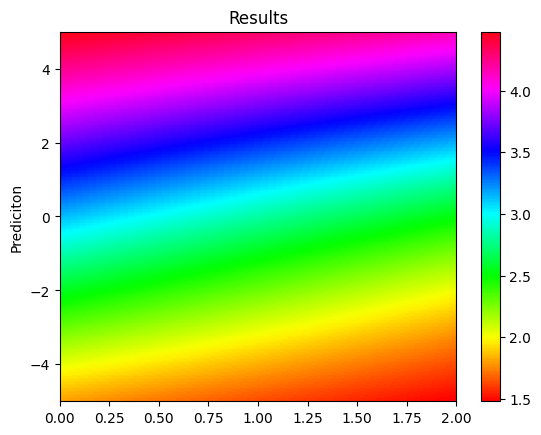

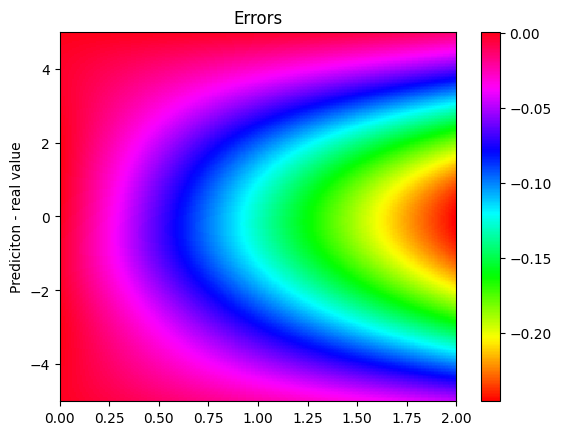


 m =  0.20500000000000002 

 ####################################################


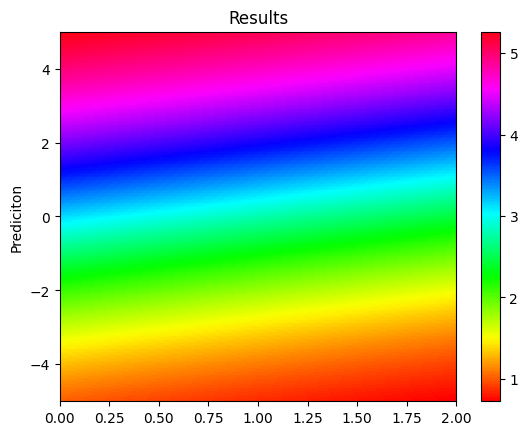

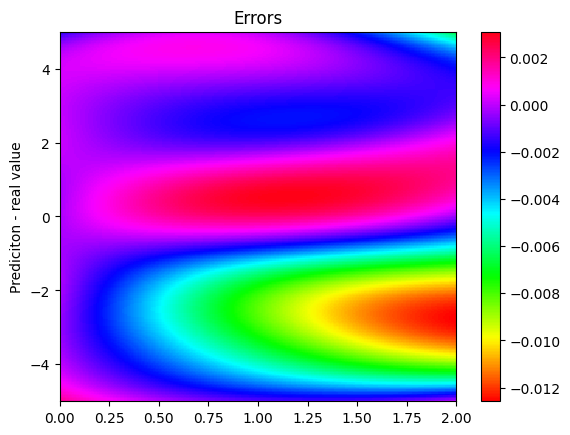


 m =  0.3 

 ####################################################


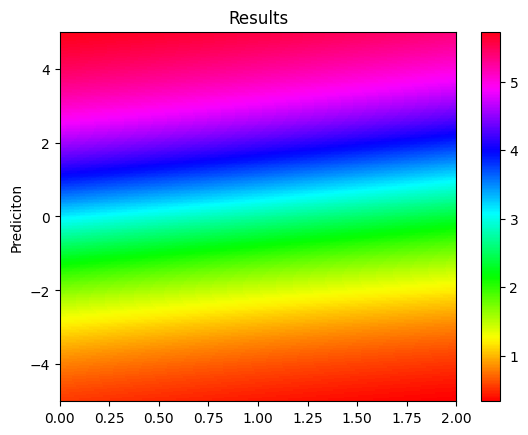

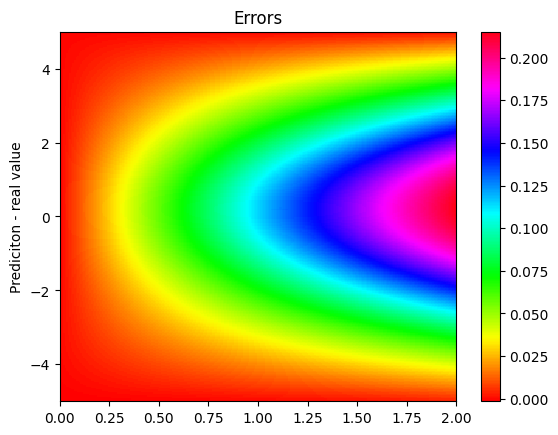


 m =  0.395 

 ####################################################


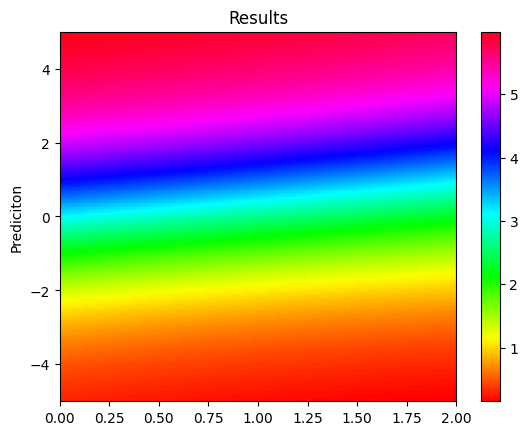

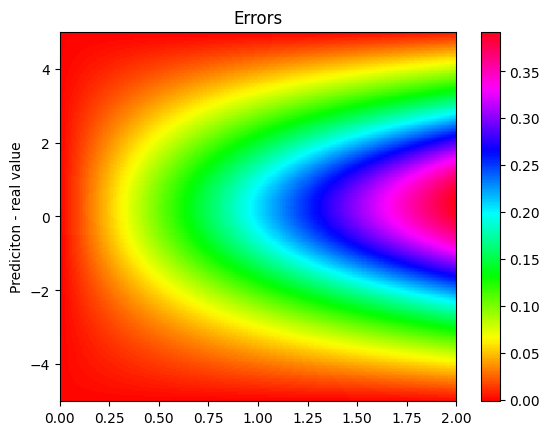


 m =  0.49 

 ####################################################


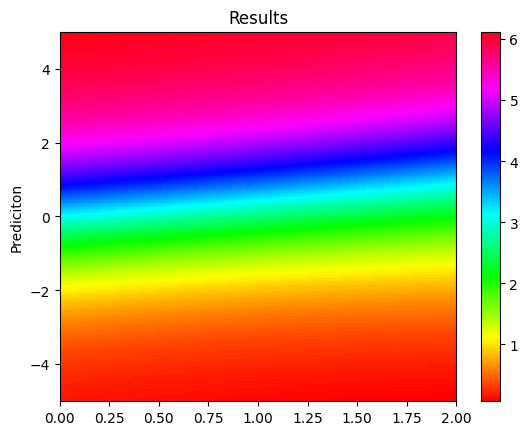

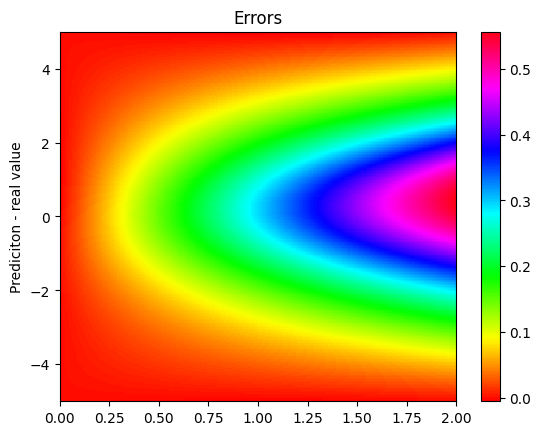

L2:  0.045807436 at variation:  11 ,  49 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
 0.04580744]  at identifier:  42 

Compiling model...
Building feed-forward neural network...
'build' took 0.128050 s

'compile' took 1.355569 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [9.98e-04, 1.32e+01, 3.24e+01, 3.79e-01]    [9.98e-04, 1.32e+01, 3.24e+01, 3.79e-01]    [1.02e+00]    
1000      [8.84e-04, 2.37e-03, 1.29e-04, 4.91e-04]    [8.84e-04, 2.37e-03, 1.29e-04, 4.91e-04]    [8.57e-02]    
2000      [5.23e-04, 1.69e-03, 4.44e-05, 2.81e-05]    [5.23e-04, 1.69e-03, 4.44e-05, 2.81e-05]    [8.55e-02]    
3000      [4.07e-04, 3.70e-03, 4.94e-03, 1.68e-03]    [4.07e-04, 3.70e-03, 4.94e-03, 1.68e-03]    [9.48e-02]    
4000      [3.79e

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

upper=46#centésimos
botton=14
identifier = 38
#L2_list=np.array([])
L2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_15.npy")
L2=0
while (botton>0):


    #Boundary points
    sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
    sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
    n_rand=256
    sample = sampler.random(n_rand)
    sample2 = sampler2.random(n_rand)
    #print(sample)
    #sample.sort
    #print(np.array(sample))
    #boundary condition sample:
    x1 = np.vstack(np.ones(int(n_rand/2))*5)
    x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
    m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
    t0 = sample*2

    X_anchors=np.concatenate((x1,m,t0), axis=1)



    timedomain = dde.geometry.TimeDomain(0, 2)
    geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

    geomtime = dde.geometry.GeometryXTime(geom, timedomain)



    # Define sine function
    if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
        from deepxde.backend import tf

        cos = tf.cos
        sin = tf.sin
    elif dde.backend.backend_name == "paddle":
        import paddle

        cos = paddle.cos
        sin = paddle.sin


    def pde(x, y):
        alpha = -1
        v=0.65

        dy_tt = dde.grad.hessian(y, x, i=2, j=2)
        dy_xx = dde.grad.hessian(y, x, i=0, j=0)
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        return (
            dy_tt
            + alpha * dy_xx
            + m**2*sin(y)
        )

    def func(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

        v = 0.65
        gamma = np.sqrt(1/(1-v**2))
        delt=0


        return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
        #return x[:, 0:1] * np.cos(x[:, 1:2])

    def deriv(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        v = 0.65
        gamma = tf.sqrt(1/(1-v**2))
        delt=0

        return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


    def boundary(x,_):
        return np.isclose(x[2],0)

    def boundary_up(x,_):
        return np.isclose(x[0],5.0)
    def boundary_down(x,_):
        return np.isclose(x[0],-5.0)


    bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
    bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
    #ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
    ic_1 = dde.icbc.IC(geomtime, func, boundary)
    ic_2 = dde.icbc.OperatorBC(
        geomtime,
        lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
        boundary,
    )

    data = dde.data.TimePDE(
        geomtime,
        pde,
        [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
        num_domain=2000,
        num_boundary=0,
        num_initial=128,
        solution=func,
        num_test=None,
        anchors=X_anchors
    )

    layer_size = [3] + [200] * 6 + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)

    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )
    losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")
    dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
    )
    model.compile("L-BFGS", metrics=["l2 relative error"])
    losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
    dde.saveplot(losshistory, train_state, issave=True, isplot=True)
    for i in np.linspace(botton/100,upper/100, 5):
        print("\n m = ",i,"\n\n ####################################################")
        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        m= np.ones(65536)*i
        #m=m.reshape(-1,1)
        m=np.vstack(m)

        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        x1,t1=np.split(X_star, 2, axis=1)
        X_star_m= np.concatenate((x1,m,t1), axis=1)

        prediction = model.predict(X_star_m, operator=None)

        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Results")
        ax.set_ylabel("Prediciton")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()

        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        prediction = model.predict(X_star_m, operator=None)
        real=func(X_star_m)
        prediction=prediction-real
        #prediction=np.sqrt(prediction*prediction)


        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Errors")
        ax.set_ylabel("Prediciton - real value")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()


    L2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
    print("L2: ",L2,"at variation: ",botton, ", ",upper,"\n")

    upper+=1
    botton-=1
    identifier+=1

    L2_list=np.append(L2_list,L2)
    print("L2_list= ", L2_list, " at identifier: ",identifier , "\n")

    np.save('/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_'+str(np.shape(L2_list)[0])+'.npy',L2_list)





In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/


L2_errors_lbfgs_10.npy  L2_errors_lbfgs_15.npy  L2_errors_lbfgs_1.npy  L2_errors_lbfgs_6.npy
L2_errors_lbfgs_11.npy  L2_errors_lbfgs_16.npy  L2_errors_lbfgs_2.npy  L2_errors_lbfgs_7.npy
L2_errors_lbfgs_12.npy  L2_errors_lbfgs_17.npy  L2_errors_lbfgs_3.npy  L2_errors_lbfgs_8.npy
L2_errors_lbfgs_13.npy  L2_errors_lbfgs_18.npy  L2_errors_lbfgs_4.npy  L2_errors_lbfgs_9.npy
L2_errors_lbfgs_14.npy  L2_errors_lbfgs_19.npy  L2_errors_lbfgs_5.npy


In [ ]:
#11 ,  49

#L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
# 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
# 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
# 0.04580744]  at identifier:  42

#Continuacao Automatizando lbfgs 3

In [ ]:
identifier = 38
print("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")

/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/31/model.ckpt


In [ ]:
#ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/30
L2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_15")

In [ ]:
L2_list

array([0.01907848, 0.02393539, 0.02770672, 0.04998742, 0.05994061,
       0.06446929, 0.08758008, 0.06205007, 0.06390987, 0.06288783,
       0.03502875, 0.03391104, 0.02576944, 0.0534071 , 0.05267773])

Compiling model...
Building feed-forward neural network...
'build' took 0.148882 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.679093 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.06e-04, 1.31e+01, 3.04e+01, 5.11e-01]    [2.06e-04, 1.31e+01, 3.04e+01, 5.11e-01]    [9.99e-01]    
1000      [9.72e-04, 2.36e-03, 3.19e-04, 5.82e-04]    [9.72e-04, 2.36e-03, 3.19e-04, 5.82e-04]    [8.12e-02]    
2000      [5.80e-04, 1.58e-03, 7.09e-05, 1.65e-05]    [5.80e-04, 1.58e-03, 7.09e-05, 1.65e-05]    [7.44e-02]    
3000      [4.09e-04, 1.32e-03, 4.52e-05, 4.99e-05]    [4.09e-04, 1.32e-03, 4.52e-05, 4.99e-05]    [7.61e-02]    
4000      [2.92e-04, 1.01e-03, 1.53e-05, 5.02e-05]    [2.92e-04, 1.01e-03, 1.53e-05, 5.02e-05]    [8.09e-02]    
5000      [2.12e-04, 1.35e-03, 7.26e-04, 8.73e-04]    [2.12e-04, 1.35e-03, 7.26e-04, 8.73e-04]    [8.41e-02]    
6000      [1.29e-04, 1.43e-03, 2.96e-03, 2.95e-04]    [1.29e-04, 1.43e-03, 2.96e-03, 2.95e-04]    [9.82e-02]    
7000      [8.44e-05, 4.89e-04, 1.44e-04, 2.77e-04]

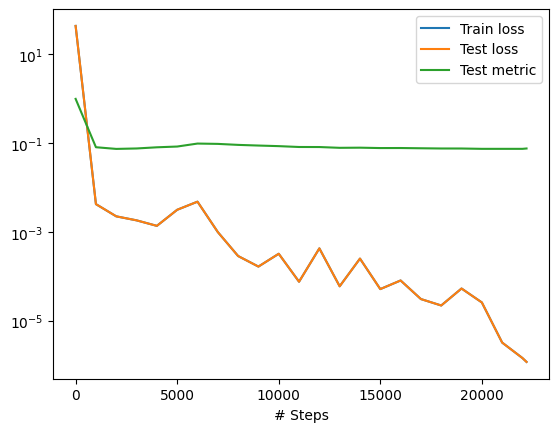


 m =  0.1 

 ####################################################


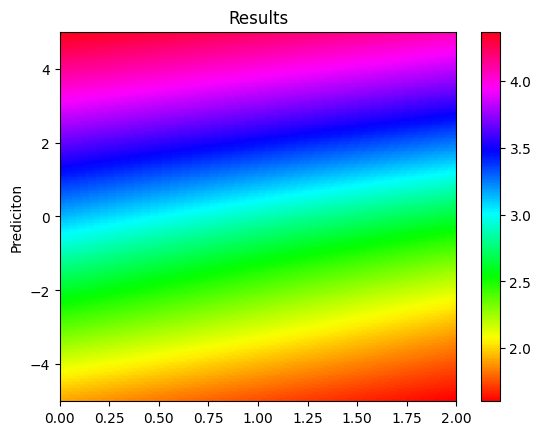

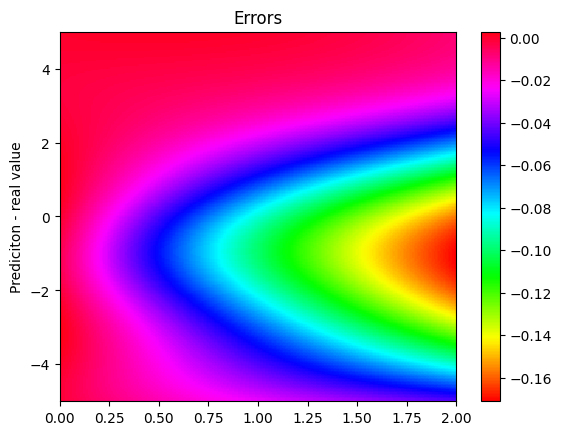


 m =  0.2 

 ####################################################


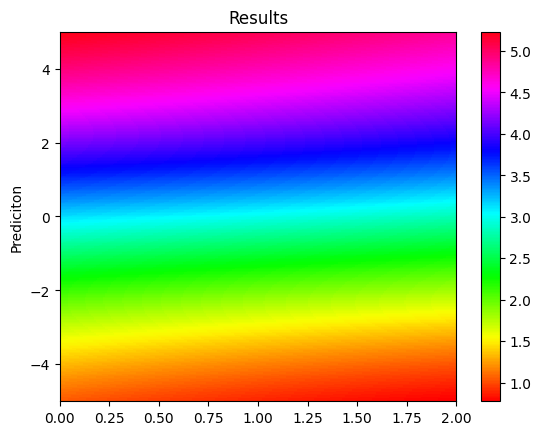

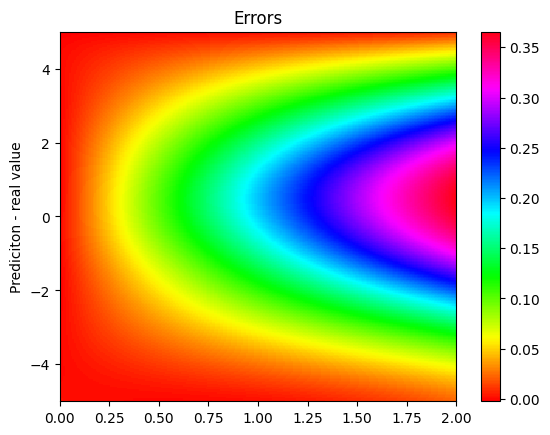


 m =  0.30000000000000004 

 ####################################################


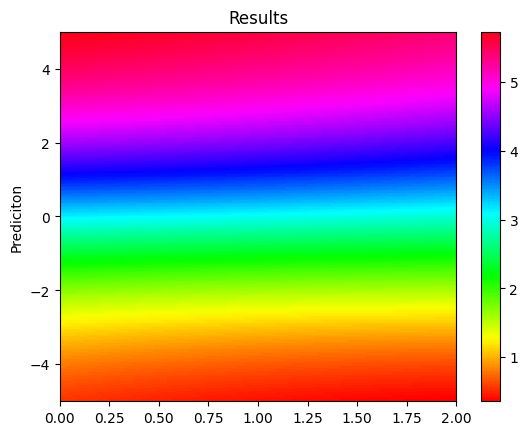

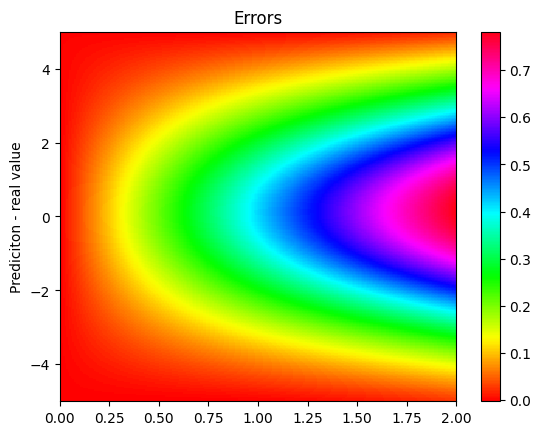


 m =  0.4 

 ####################################################


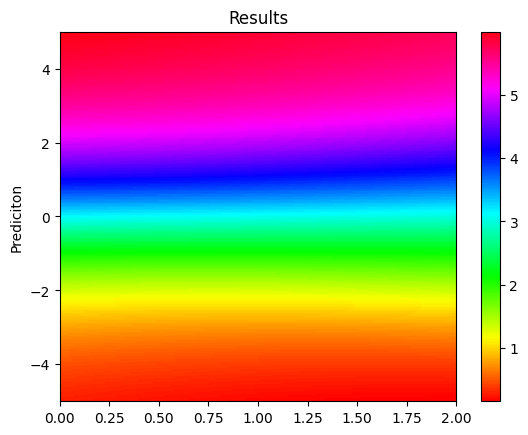

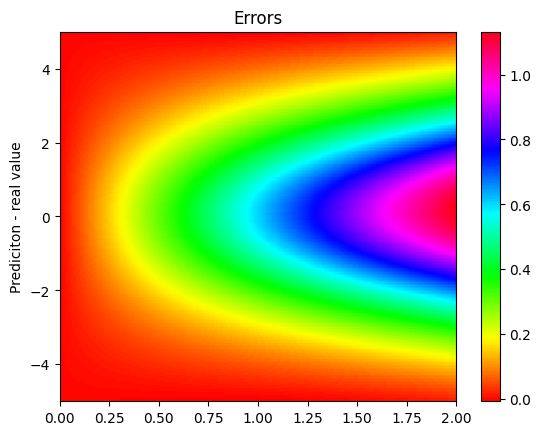


 m =  0.5 

 ####################################################


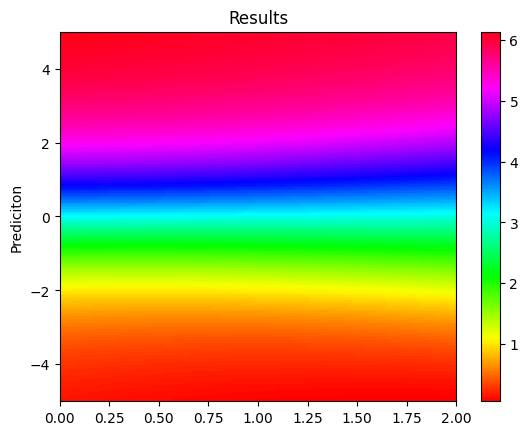

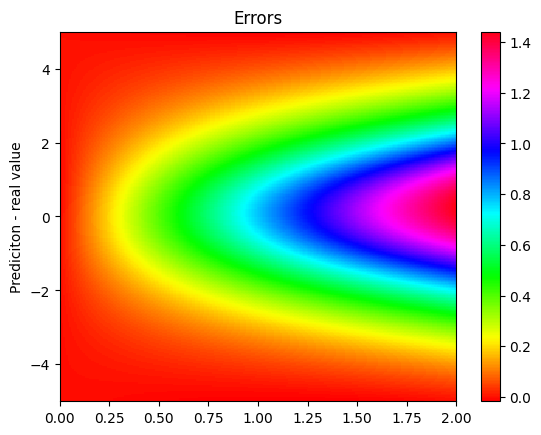

L2:  0.09354486 at variation:  10 ,  50 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
 0.04580744 0.09354486]  at identifier:  43 

Compiling model...
Building feed-forward neural network...
'build' took 0.147164 s

'compile' took 2.007565 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.87e-03, 1.39e+01, 3.17e+01, 4.79e-01]    [1.87e-03, 1.39e+01, 3.17e+01, 4.79e-01]    [1.02e+00]    
1000      [9.21e-04, 2.43e-03, 1.94e-04, 9.58e-05]    [9.21e-04, 2.43e-03, 1.94e-04, 9.58e-05]    [8.69e-02]    
2000      [6.39e-04, 2.34e-03, 1.25e-04, 3.04e-04]    [6.39e-04, 2.34e-03, 1.25e-04, 3.04e-04]    [9.15e-02]    
3000      [4.36e-04, 2.54e-03, 4.09e-04, 2.03e-03]    [4.36e-04, 2.54e-03, 4.09e-04, 2.03e-03]    [9.21e-02]    
4000  

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

upper=50#centésimos
botton=10
identifier = 42
#L2_list=np.array([])
L2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_19.npy")
L2=0
while (botton>0):


    #Boundary points
    sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
    sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
    n_rand=256
    sample = sampler.random(n_rand)
    sample2 = sampler2.random(n_rand)
    #print(sample)
    #sample.sort
    #print(np.array(sample))
    #boundary condition sample:
    x1 = np.vstack(np.ones(int(n_rand/2))*5)
    x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
    m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
    t0 = sample*2

    X_anchors=np.concatenate((x1,m,t0), axis=1)



    timedomain = dde.geometry.TimeDomain(0, 2)
    geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

    geomtime = dde.geometry.GeometryXTime(geom, timedomain)



    # Define sine function
    if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
        from deepxde.backend import tf

        cos = tf.cos
        sin = tf.sin
    elif dde.backend.backend_name == "paddle":
        import paddle

        cos = paddle.cos
        sin = paddle.sin


    def pde(x, y):
        alpha = -1
        v=0.65

        dy_tt = dde.grad.hessian(y, x, i=2, j=2)
        dy_xx = dde.grad.hessian(y, x, i=0, j=0)
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        return (
            dy_tt
            + alpha * dy_xx
            + m**2*sin(y)
        )

    def func(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

        v = 0.65
        gamma = np.sqrt(1/(1-v**2))
        delt=0


        return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
        #return x[:, 0:1] * np.cos(x[:, 1:2])

    def deriv(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        v = 0.65
        gamma = tf.sqrt(1/(1-v**2))
        delt=0

        return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


    def boundary(x,_):
        return np.isclose(x[2],0)

    def boundary_up(x,_):
        return np.isclose(x[0],5.0)
    def boundary_down(x,_):
        return np.isclose(x[0],-5.0)


    bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
    bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
    #ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
    ic_1 = dde.icbc.IC(geomtime, func, boundary)
    ic_2 = dde.icbc.OperatorBC(
        geomtime,
        lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
        boundary,
    )

    data = dde.data.TimePDE(
        geomtime,
        pde,
        [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
        num_domain=2000,
        num_boundary=0,
        num_initial=128,
        solution=func,
        num_test=None,
        anchors=X_anchors
    )

    layer_size = [3] + [200] * 6 + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)

    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )
    losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")
    dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
    )
    model.compile("L-BFGS", metrics=["l2 relative error"])
    losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
    dde.saveplot(losshistory, train_state, issave=True, isplot=True)
    for i in np.linspace(botton/100,upper/100, 5):
        print("\n m = ",i,"\n\n ####################################################")
        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        m= np.ones(65536)*i
        #m=m.reshape(-1,1)
        m=np.vstack(m)

        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        x1,t1=np.split(X_star, 2, axis=1)
        X_star_m= np.concatenate((x1,m,t1), axis=1)

        prediction = model.predict(X_star_m, operator=None)

        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Results")
        ax.set_ylabel("Prediciton")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()

        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        prediction = model.predict(X_star_m, operator=None)
        real=func(X_star_m)
        prediction=prediction-real
        #prediction=np.sqrt(prediction*prediction)


        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Errors")
        ax.set_ylabel("Prediciton - real value")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()


    L2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
    print("L2: ",L2,"at variation: ",botton, ", ",upper,"\n")

    upper+=1
    botton-=1
    identifier+=1

    L2_list=np.append(L2_list,L2)
    print("L2_list= ", L2_list, " at identifier: ",identifier , "\n")

    np.save('/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_'+str(np.shape(L2_list)[0])+'.npy',L2_list)





In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/


L2_errors_lbfgs_10.npy  L2_errors_lbfgs_14.npy  L2_errors_lbfgs_3.npy  L2_errors_lbfgs_7.npy
L2_errors_lbfgs_11.npy  L2_errors_lbfgs_15.npy  L2_errors_lbfgs_4.npy  L2_errors_lbfgs_8.npy
L2_errors_lbfgs_12.npy  L2_errors_lbfgs_1.npy   L2_errors_lbfgs_5.npy  L2_errors_lbfgs_9.npy
L2_errors_lbfgs_13.npy  L2_errors_lbfgs_2.npy   L2_errors_lbfgs_6.npy


In [ ]:
#11 ,  49

#L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
# 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
# 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
# 0.04580744]  at identifier:  42

#Continuacao Automatizando lbfgs 4

In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/44/

In [ ]:
identifier = 43
print("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")

/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/43/model.ckpt


In [ ]:
#ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/30
L2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_15")

In [ ]:
30+22


52

Compiling model...
Building feed-forward neural network...
'build' took 0.145478 s



/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'compile' took 1.744607 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.93e-03, 1.24e+01, 2.63e+01, 9.74e-01]    [1.93e-03, 1.24e+01, 2.63e+01, 9.74e-01]    [9.49e-01]    
1000      [9.02e-04, 2.83e-03, 9.63e-05, 7.52e-05]    [9.02e-04, 2.83e-03, 9.63e-05, 7.52e-05]    [8.58e-02]    
2000      [6.73e-04, 2.29e-03, 7.28e-05, 2.91e-05]    [6.73e-04, 2.29e-03, 7.28e-05, 2.91e-05]    [9.50e-02]    
3000      [5.45e-04, 4.59e-03, 2.70e-03, 5.11e-03]    [5.45e-04, 4.59e-03, 2.70e-03, 5.11e-03]    [8.89e-02]    
4000      [3.87e-04, 1.41e-03, 9.70e-06, 4.29e-05]    [3.87e-04, 1.41e-03, 9.70e-06, 4.29e-05]    [9.25e-02]    
5000      [2.67e-04, 1.04e-03, 1.28e-05, 5.26e-05]    [2.67e-04, 1.04e-03, 1.28e-05, 5.26e-05]    [9.27e-02]    
6000      [1.57e-04, 6.64e-04, 1.20e-06, 4.39e-05]    [1.57e-04, 6.64e-04, 1.20e-06, 4.39e-05]    [9.39e-02]    
7000      [8.83e-05, 4.39e-04, 1.25e-04, 8.39e-05]

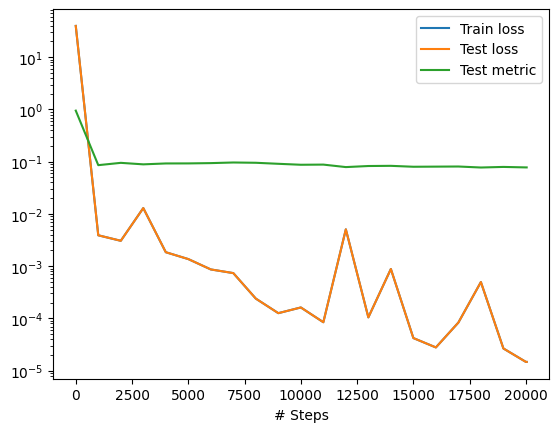


 m =  0.08 

 ####################################################


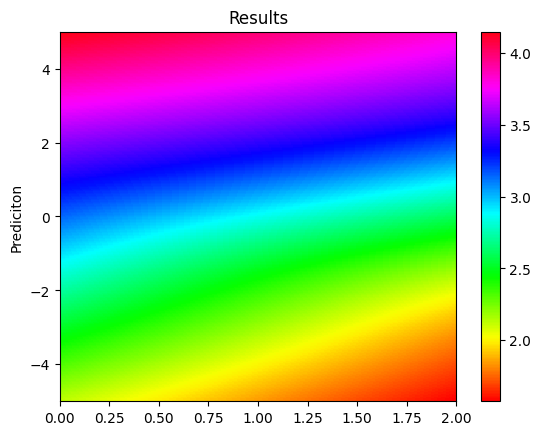

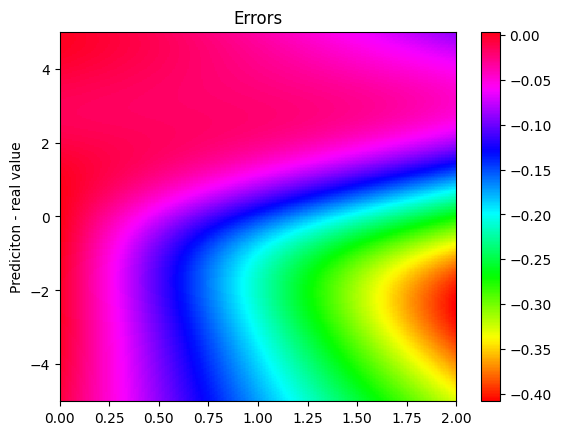


 m =  0.19 

 ####################################################


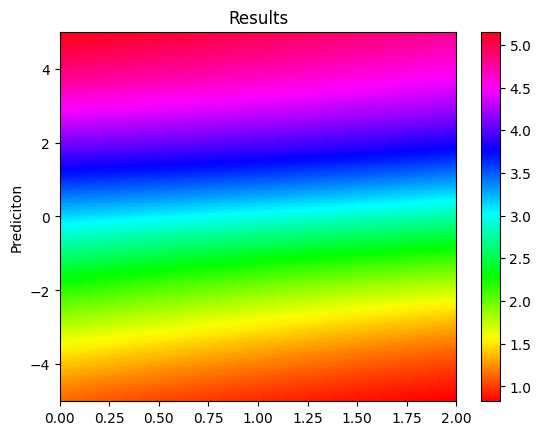

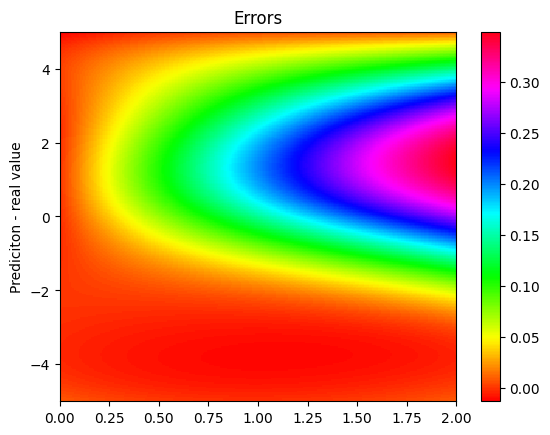


 m =  0.3 

 ####################################################


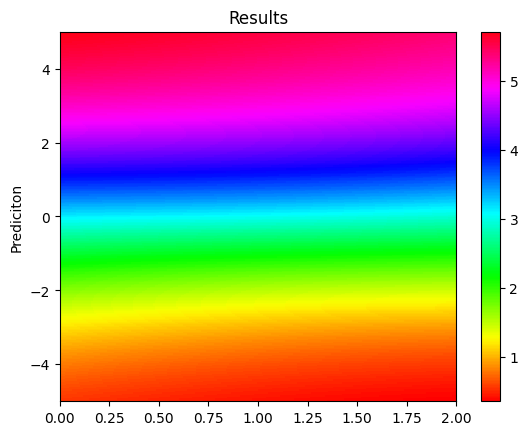

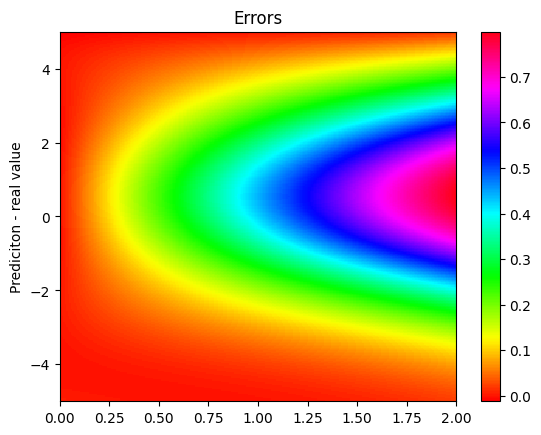


 m =  0.41000000000000003 

 ####################################################


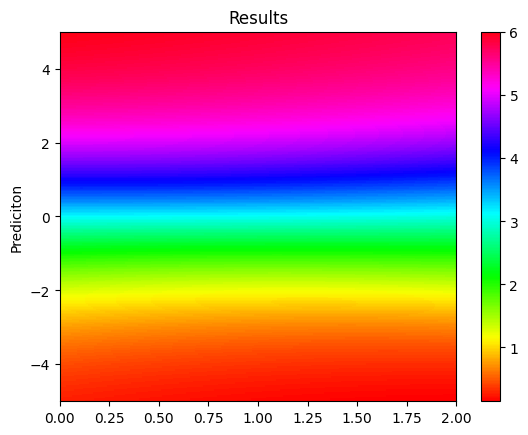

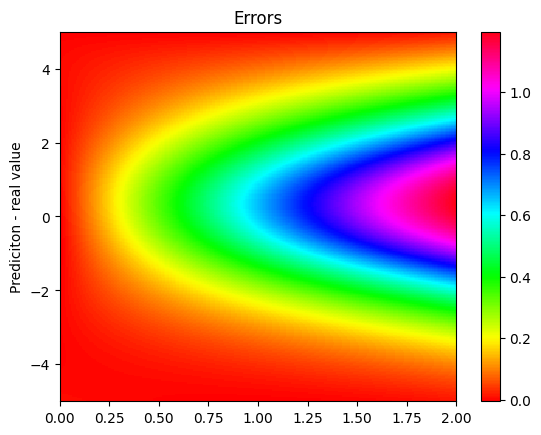


 m =  0.52 

 ####################################################


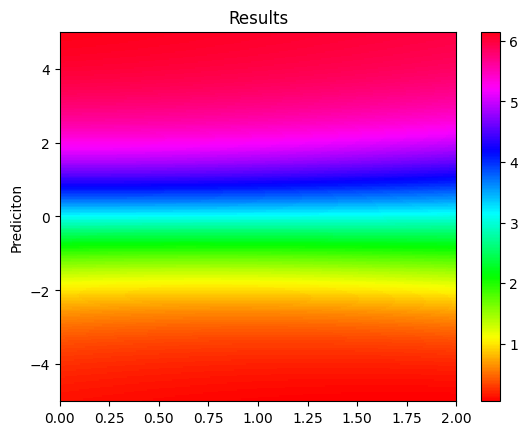

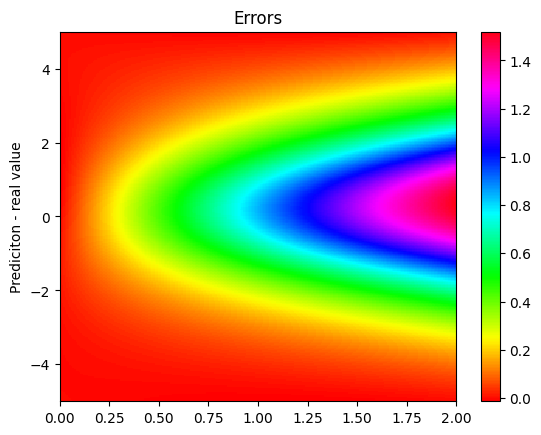

L2:  0.090241805 at variation:  8 ,  52 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
 0.04580744 0.09354486 0.06191031 0.0902418 ]  at identifier:  45 

Compiling model...
Building feed-forward neural network...
'build' took 0.128554 s

'compile' took 1.519670 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.71e-04, 1.29e+01, 3.00e+01, 7.72e-01]    [1.71e-04, 1.29e+01, 3.00e+01, 7.72e-01]    [1.01e+00]    
1000      [1.06e-03, 2.99e-03, 8.48e-05, 7.10e-05]    [1.06e-03, 2.99e-03, 8.48e-05, 7.10e-05]    [7.87e-02]    
2000      [7.70e-04, 2.35e-03, 8.06e-05, 6.14e-05]    [7.70e-04, 2.35e-03, 8.06e-05, 6.14e-05]    [8.27e-02]    
3000      [5.51e-04, 1.84e-03, 1.83e-04, 3.93e-05]    [5.51e-04, 1.84e-03, 1.83e-04, 3.93e-05]   

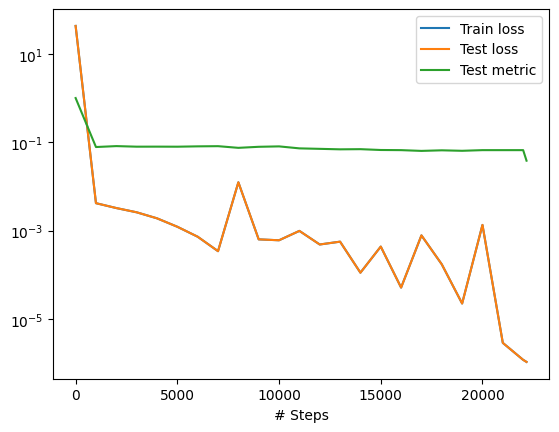


 m =  0.07 

 ####################################################


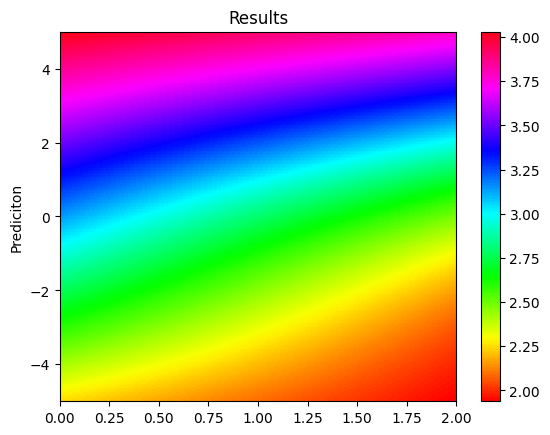

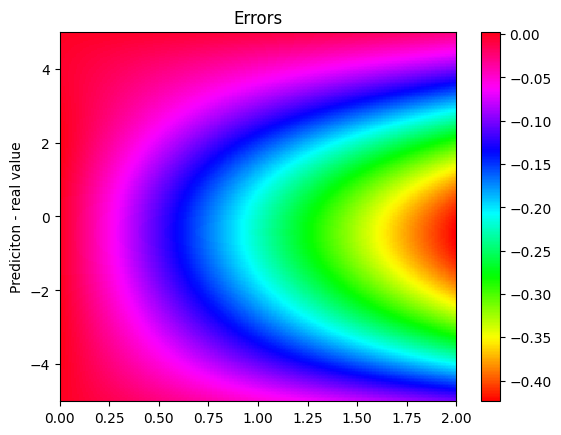


 m =  0.185 

 ####################################################


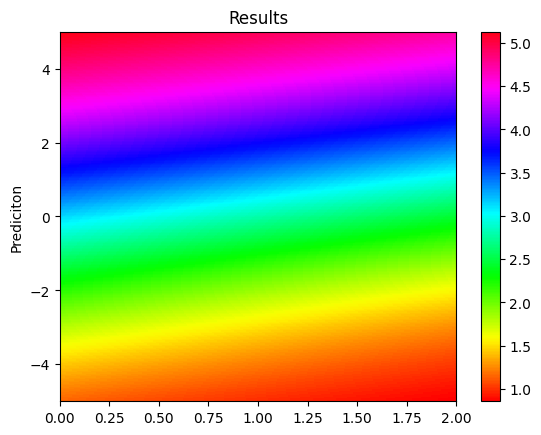

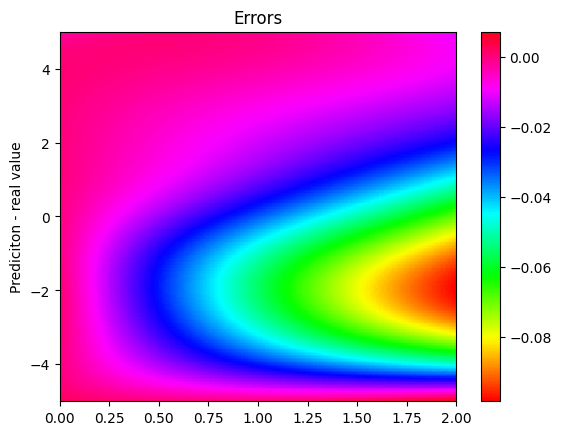


 m =  0.30000000000000004 

 ####################################################


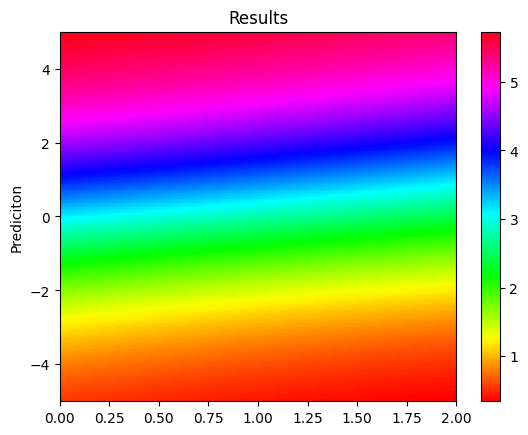

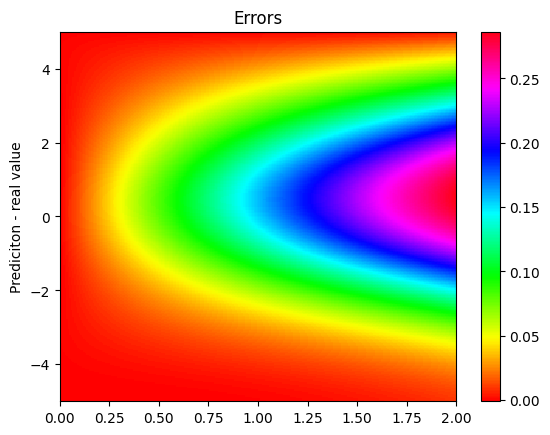


 m =  0.41500000000000004 

 ####################################################


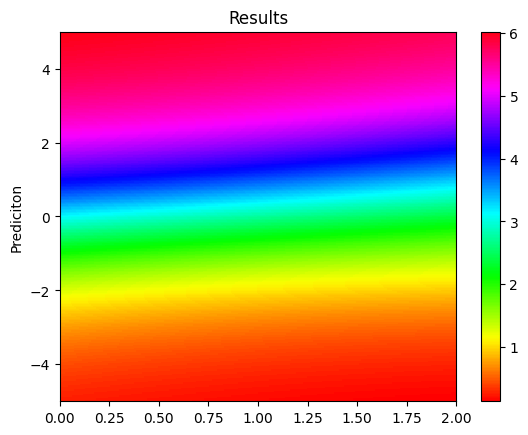

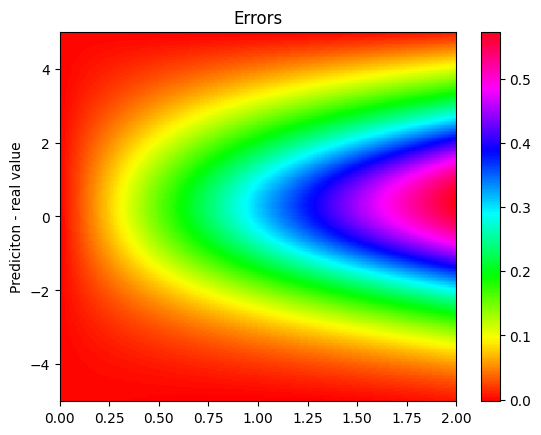


 m =  0.53 

 ####################################################


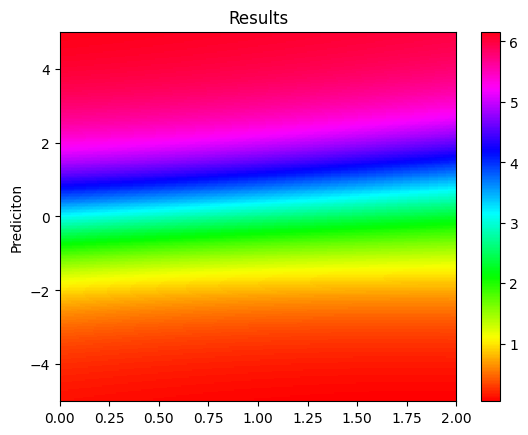

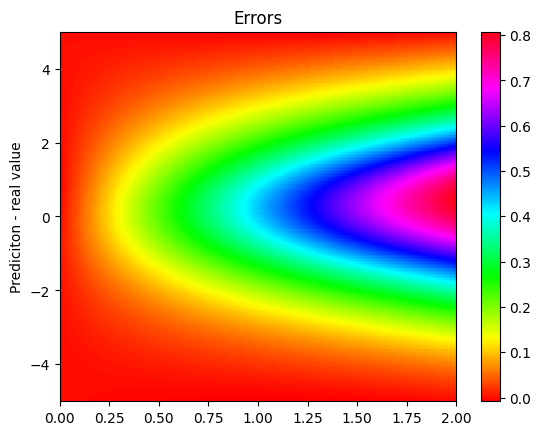

L2:  0.05774836 at variation:  7 ,  53 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
 0.04580744 0.09354486 0.06191031 0.0902418  0.05774836]  at identifier:  46 

Compiling model...
Building feed-forward neural network...
'build' took 0.084916 s

'compile' took 1.041560 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.33e-04, 1.27e+01, 2.86e+01, 1.03e+00]    [1.33e-04, 1.27e+01, 2.86e+01, 1.03e+00]    [9.93e-01]    
1000      [9.27e-04, 3.19e-03, 9.67e-05, 3.65e-05]    [9.27e-04, 3.19e-03, 9.67e-05, 3.65e-05]    [7.72e-02]    
2000      [7.26e-04, 2.37e-03, 3.22e-05, 4.19e-05]    [7.26e-04, 2.37e-03, 3.22e-05, 4.19e-05]    [7.33e-02]    
3000      [4.97e-04, 1.75e-03, 1.69e-04, 7.22e-05]    [4.97e-04, 1.75e-03, 1.69e-04, 7.

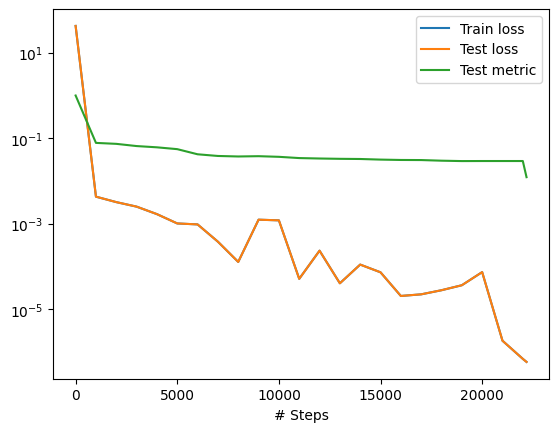


 m =  0.06 

 ####################################################


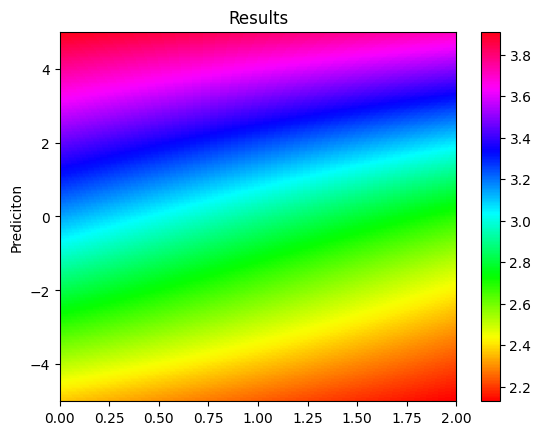

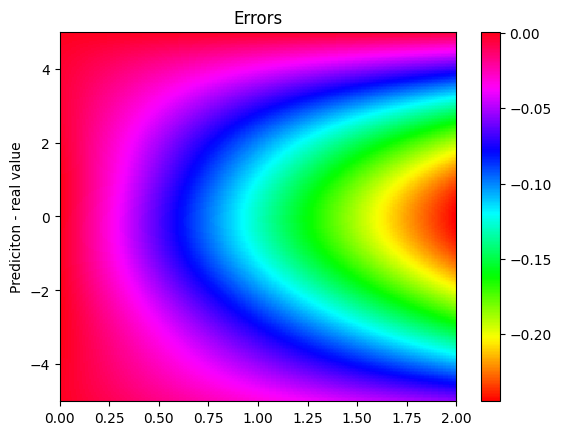


 m =  0.18 

 ####################################################


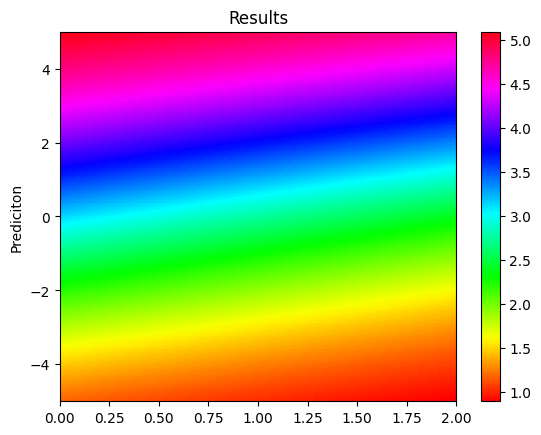

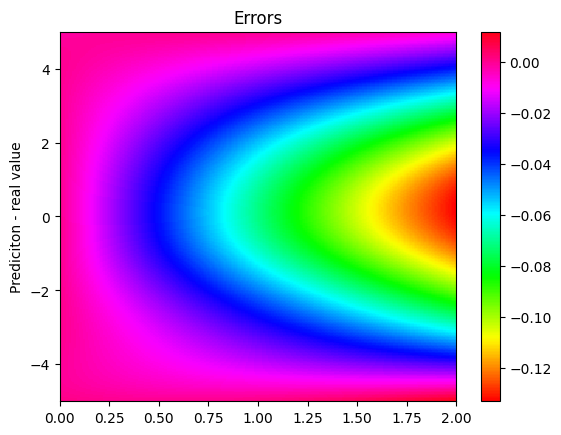


 m =  0.30000000000000004 

 ####################################################


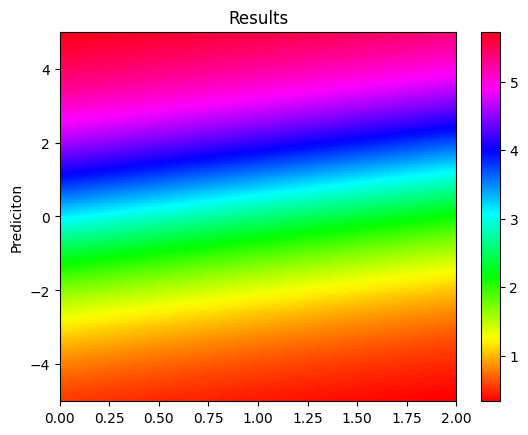

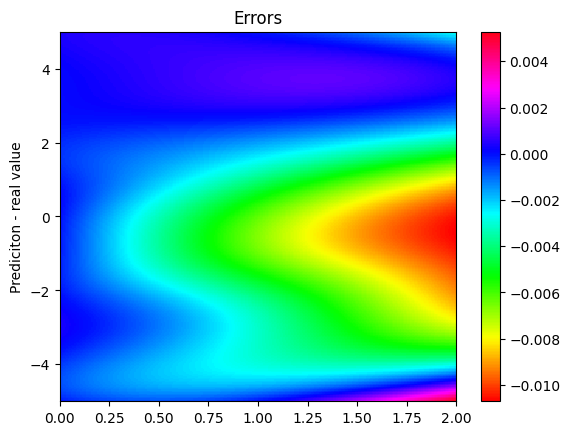


 m =  0.42000000000000004 

 ####################################################


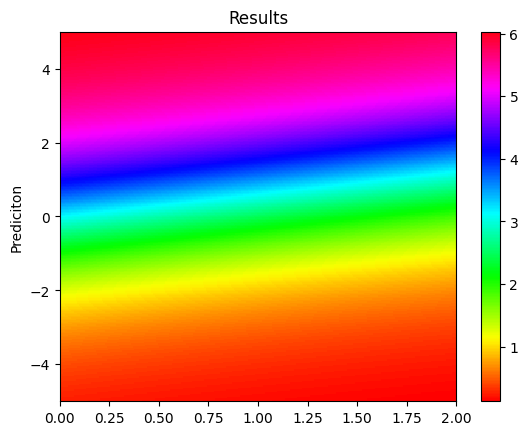

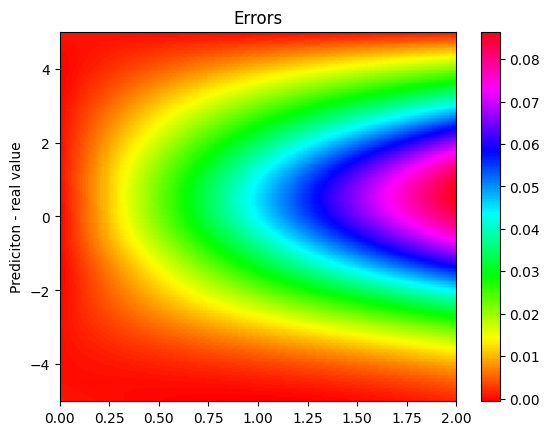


 m =  0.54 

 ####################################################


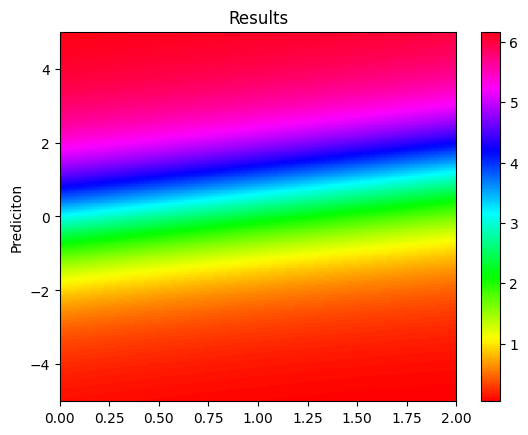

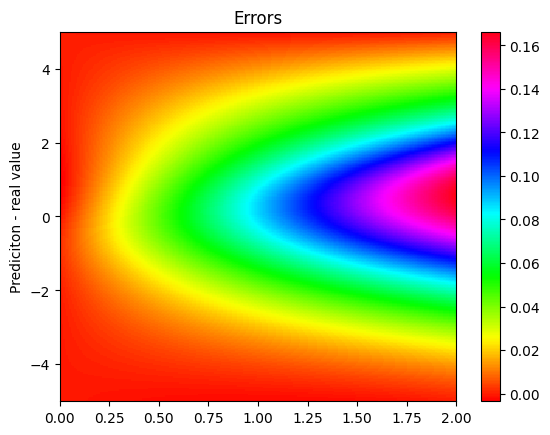

L2:  0.018833963 at variation:  6 ,  54 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
 0.04580744 0.09354486 0.06191031 0.0902418  0.05774836 0.01883396]  at identifier:  47 

Compiling model...
Building feed-forward neural network...
'build' took 0.089477 s

'compile' took 1.482241 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [1.92e-03, 1.38e+01, 3.18e+01, 6.81e-01]    [1.92e-03, 1.38e+01, 3.18e+01, 6.81e-01]    [1.04e+00]    
1000      [1.23e-03, 4.40e-03, 1.07e-04, 1.48e-04]    [1.23e-03, 4.40e-03, 1.07e-04, 1.48e-04]    [9.25e-02]    
2000      [9.90e-04, 6.43e-03, 2.56e-04, 7.64e-03]    [9.90e-04, 6.43e-03, 2.56e-04, 7.64e-03]    [1.11e-01]    
3000      [5.59e-04, 2.07e-03, 9.03e-06, 4.40e-05]    [5.59e-04, 2.07e-03, 

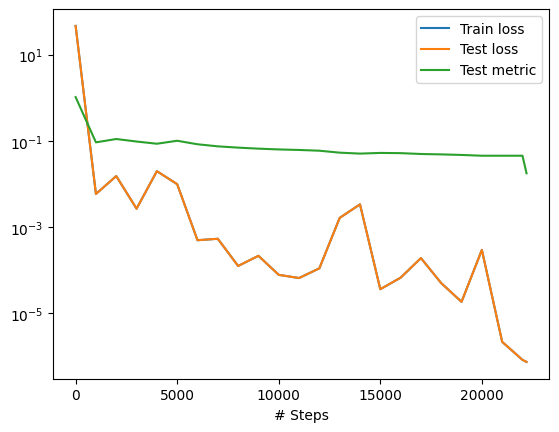


 m =  0.05 

 ####################################################


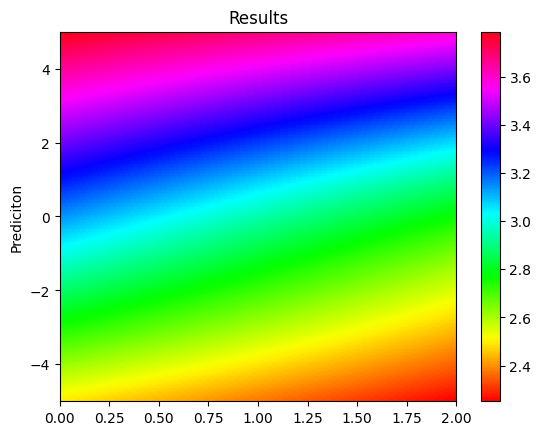

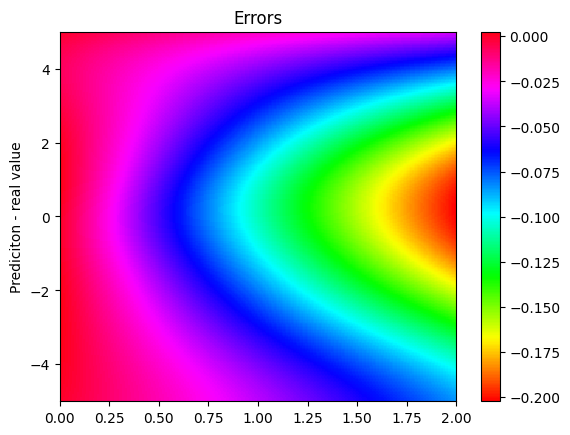


 m =  0.175 

 ####################################################


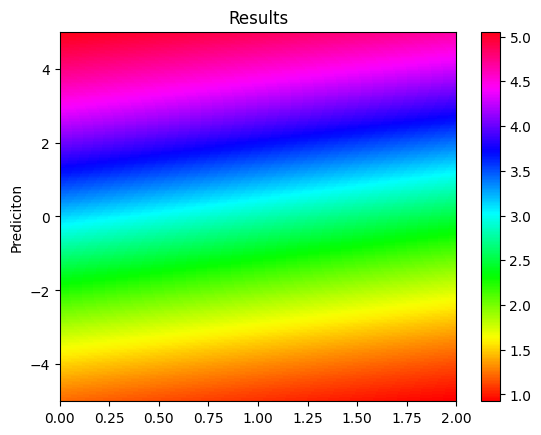

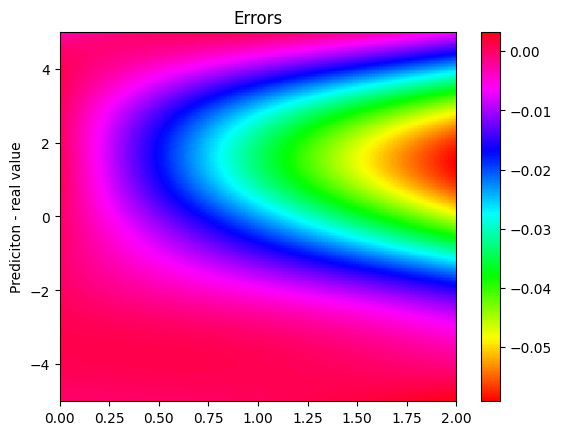


 m =  0.3 

 ####################################################


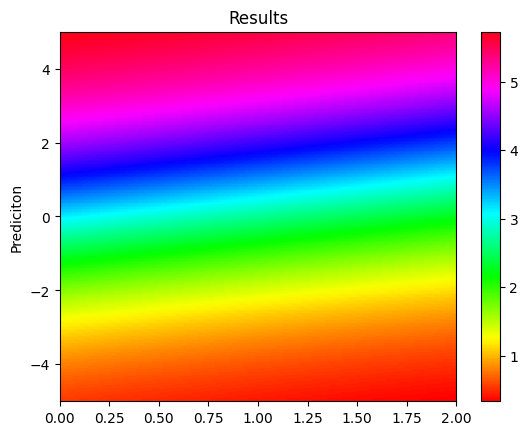

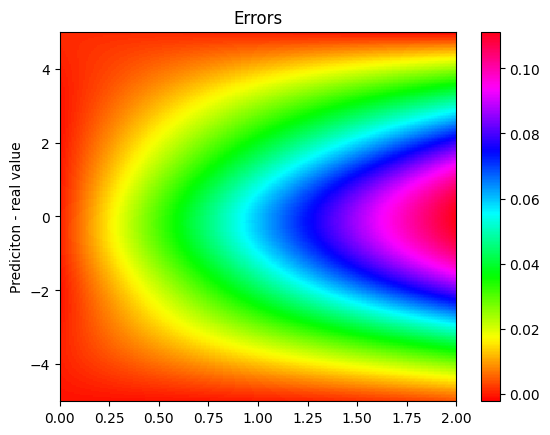


 m =  0.425 

 ####################################################


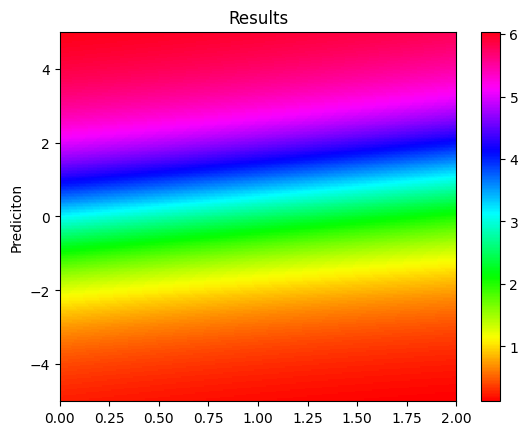

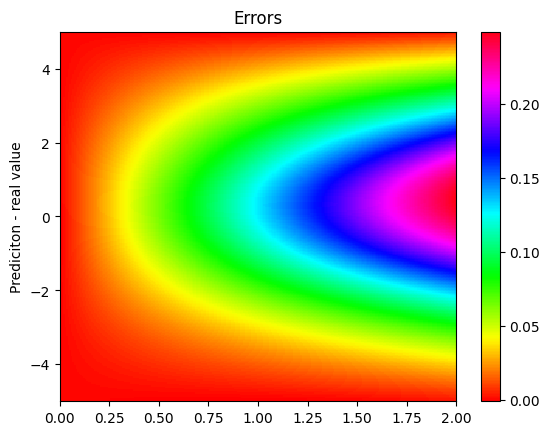


 m =  0.55 

 ####################################################


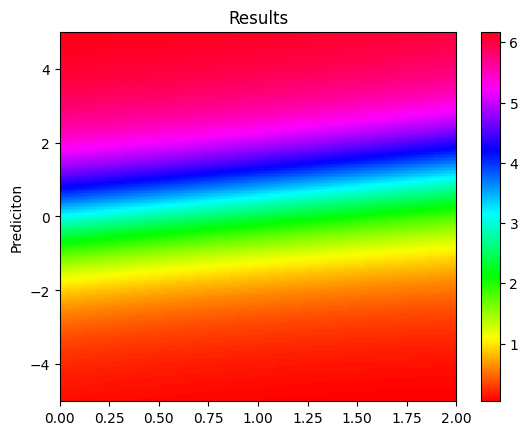

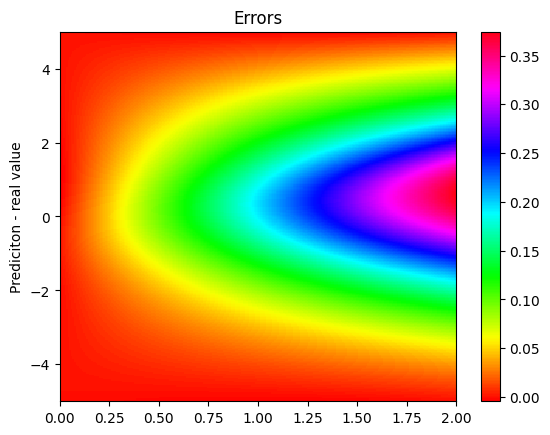

L2:  0.031801432 at variation:  5 ,  55 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
 0.04580744 0.09354486 0.06191031 0.0902418  0.05774836 0.01883396
 0.03180143]  at identifier:  48 

Compiling model...
Building feed-forward neural network...
'build' took 0.133725 s

'compile' took 1.187880 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.90e-03, 1.19e+01, 2.51e+01, 2.04e+00]    [2.90e-03, 1.19e+01, 2.51e+01, 2.04e+00]    [9.77e-01]    
1000      [1.11e-03, 4.49e-03, 3.30e-04, 2.14e-03]    [1.11e-03, 4.49e-03, 3.30e-04, 2.14e-03]    [9.25e-02]    
2000      [1.07e-03, 1.30e-02, 1.41e-02, 1.82e-02]    [1.07e-03, 1.30e-02, 1.41e-02, 1.82e-02]    [8.03e-02]    
3000      [5.55e-04, 2.33e-03, 1.70e-03, 2.10e-04]    [5.55e-04

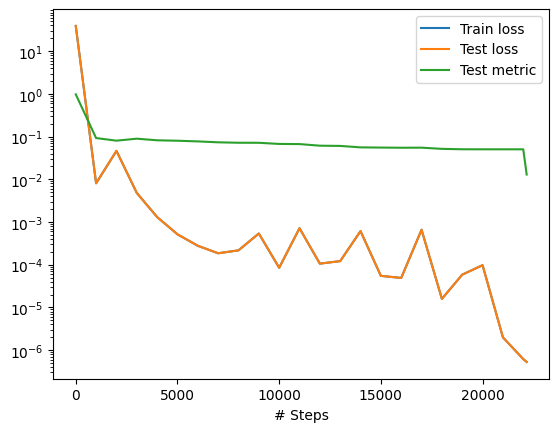


 m =  0.04 

 ####################################################


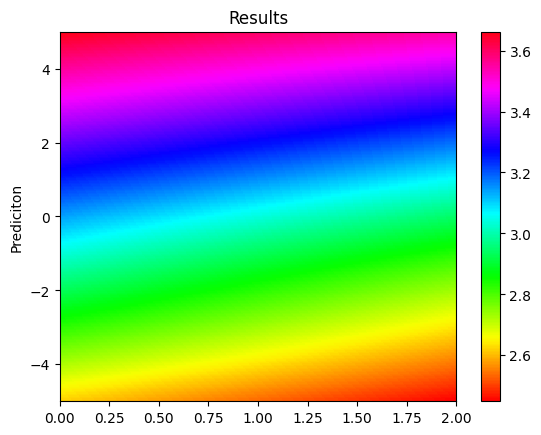

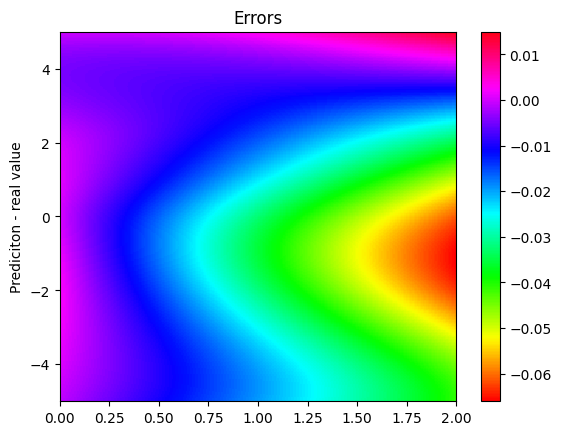


 m =  0.17 

 ####################################################


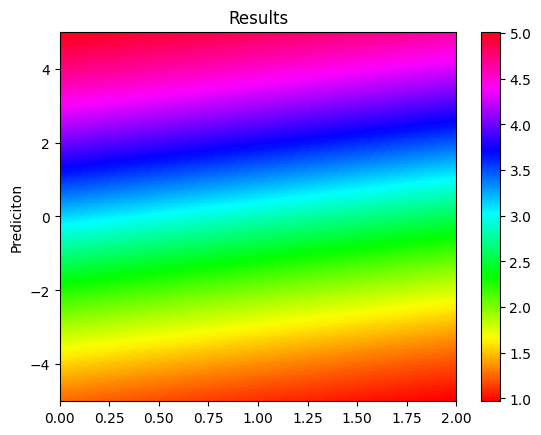

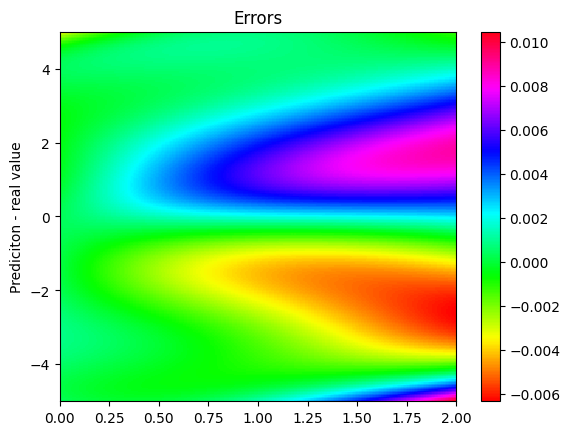


 m =  0.3 

 ####################################################


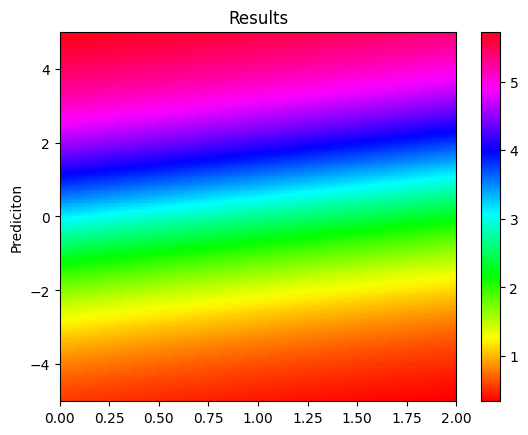

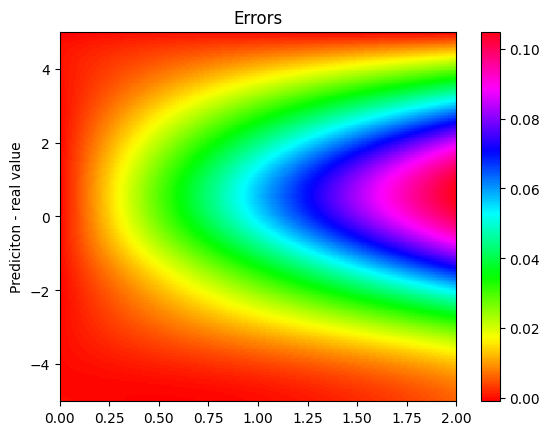


 m =  0.43 

 ####################################################


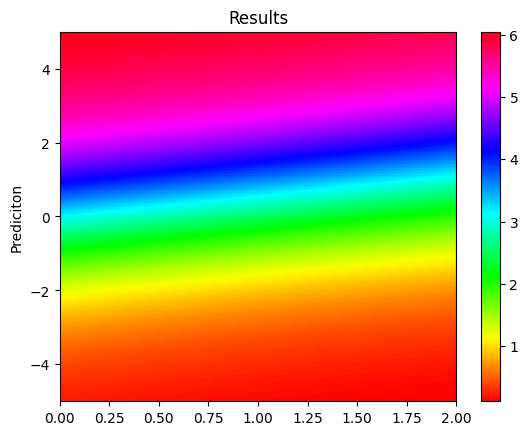

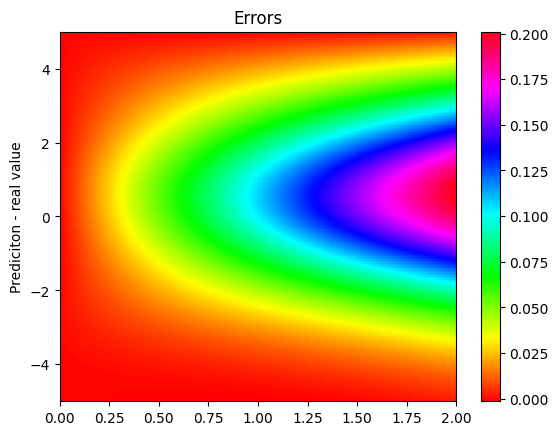


 m =  0.56 

 ####################################################


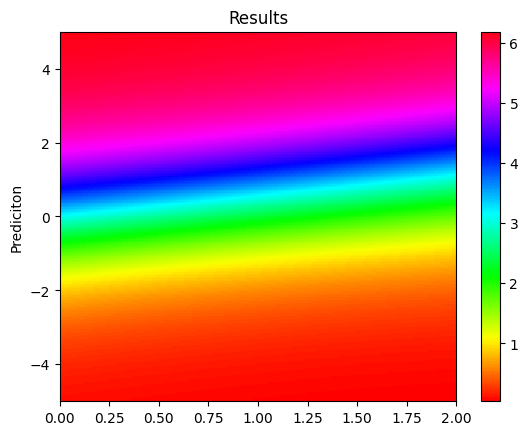

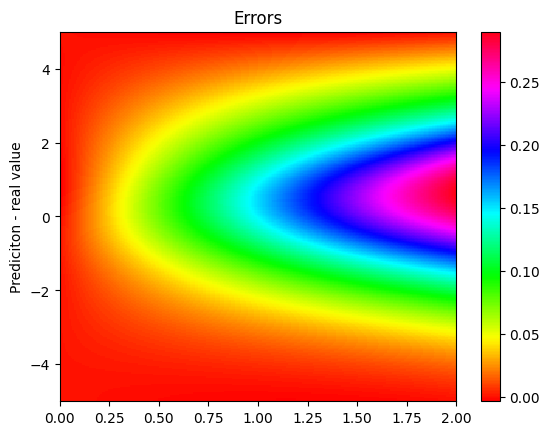

L2:  0.019771779 at variation:  4 ,  56 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
 0.04580744 0.09354486 0.06191031 0.0902418  0.05774836 0.01883396
 0.03180143 0.01977178]  at identifier:  49 

Compiling model...
Building feed-forward neural network...
'build' took 0.090911 s

'compile' took 1.295187 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [2.10e-03, 1.35e+01, 3.24e+01, 7.40e-01]    [2.10e-03, 1.35e+01, 3.24e+01, 7.40e-01]    [1.04e+00]    
1000      [1.39e-03, 4.81e-03, 1.58e-04, 1.02e-04]    [1.39e-03, 4.81e-03, 1.58e-04, 1.02e-04]    [1.07e-01]    
2000      [9.38e-04, 3.02e-03, 2.37e-05, 6.74e-05]    [9.38e-04, 3.02e-03, 2.37e-05, 6.74e-05]    [1.11e-01]    
3000      [6.41e-04, 2.80e-03, 1.92e-03, 2.80e-04]  

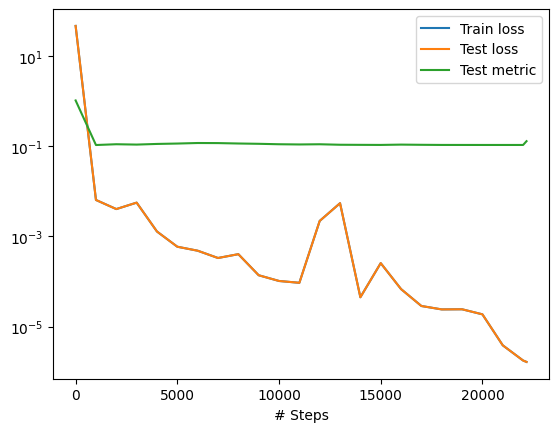


 m =  0.03 

 ####################################################


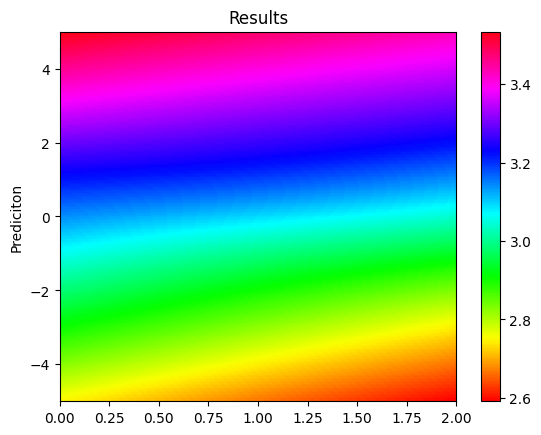

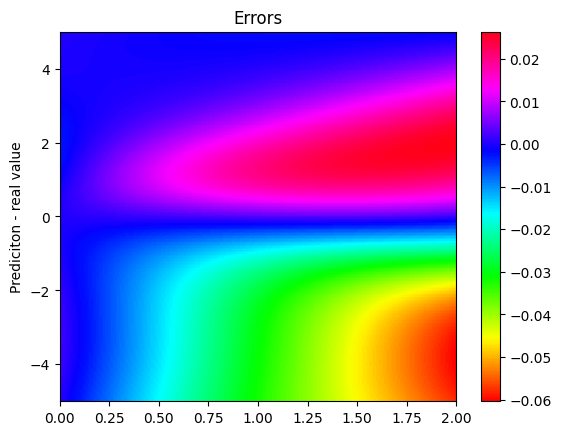


 m =  0.16499999999999998 

 ####################################################


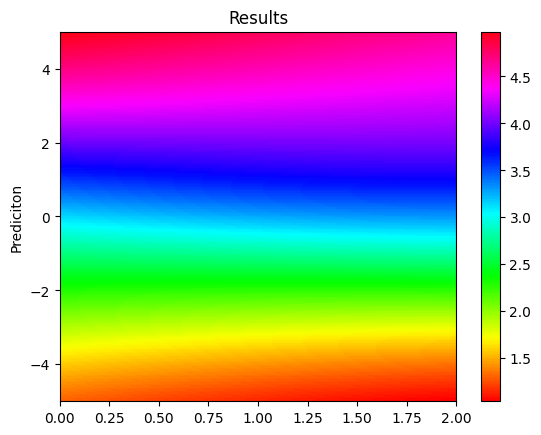

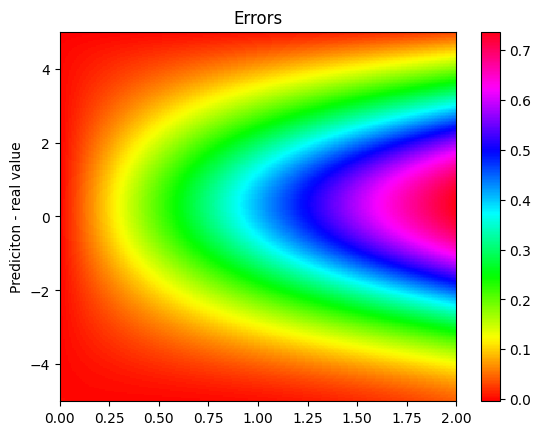


 m =  0.29999999999999993 

 ####################################################


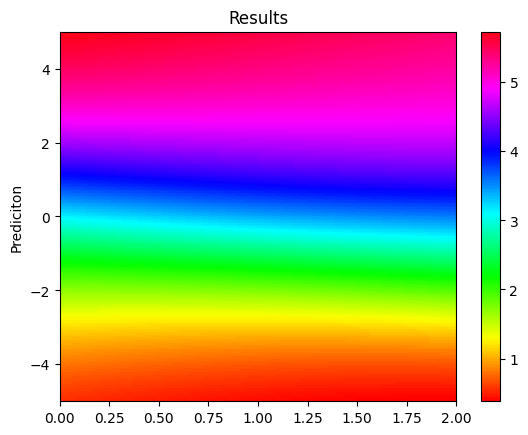

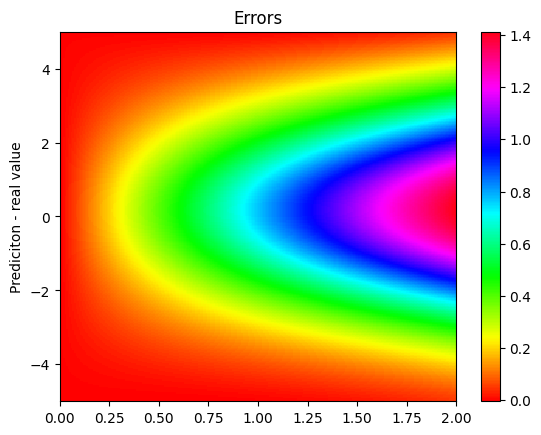


 m =  0.43499999999999994 

 ####################################################


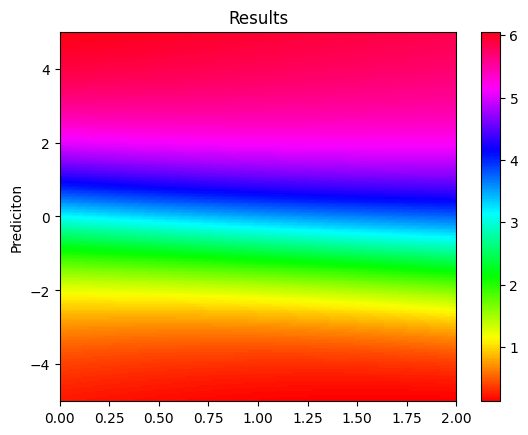

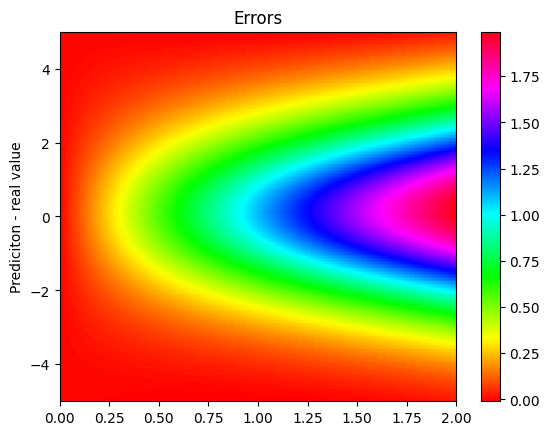


 m =  0.57 

 ####################################################


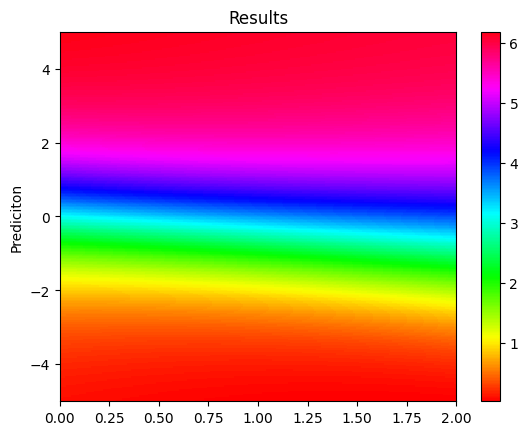

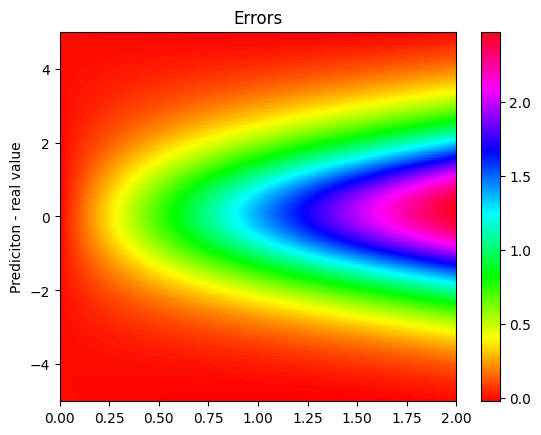

L2:  0.12700306 at variation:  3 ,  57 

L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
 0.04580744 0.09354486 0.06191031 0.0902418  0.05774836 0.01883396
 0.03180143 0.01977178 0.12700306]  at identifier:  50 

Compiling model...
Building feed-forward neural network...
'build' took 0.093849 s

'compile' took 1.216116 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
0         [4.37e-03, 1.40e+01, 3.47e+01, 7.81e-01]    [4.37e-03, 1.40e+01, 3.47e+01, 7.81e-01]    [1.08e+00]    
1000      [1.36e-03, 5.09e-03, 9.80e-05, 1.82e-04]    [1.36e-03, 5.09e-03, 9.80e-05, 1.82e-04]    [8.76e-02]    
2000      [9.88e-04, 3.26e-03, 1.72e-04, 2.23e-04]    [9.88e-04, 3.26e-03, 1.72e-04, 2.23e-04]    [8.61e-02]    
3000      [5.56e-04, 2.59e-03, 1.58e-03, 7

In [ ]:
"""Backend supported: tensorflow.compat.v1, tensorflow, paddle"""
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

upper=52#centésimos
botton=8
identifier = 44
#L2_list=np.array([])
L2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_21.npy")
L2=0
while (botton>0):


    #Boundary points
    sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
    sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
    n_rand=256
    sample = sampler.random(n_rand)
    sample2 = sampler2.random(n_rand)
    #print(sample)
    #sample.sort
    #print(np.array(sample))
    #boundary condition sample:
    x1 = np.vstack(np.ones(int(n_rand/2))*5)
    x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
    m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
    t0 = sample*2

    X_anchors=np.concatenate((x1,m,t0), axis=1)



    timedomain = dde.geometry.TimeDomain(0, 2)
    geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

    geomtime = dde.geometry.GeometryXTime(geom, timedomain)



    # Define sine function
    if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
        from deepxde.backend import tf

        cos = tf.cos
        sin = tf.sin
    elif dde.backend.backend_name == "paddle":
        import paddle

        cos = paddle.cos
        sin = paddle.sin


    def pde(x, y):
        alpha = -1
        v=0.65

        dy_tt = dde.grad.hessian(y, x, i=2, j=2)
        dy_xx = dde.grad.hessian(y, x, i=0, j=0)
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        return (
            dy_tt
            + alpha * dy_xx
            + m**2*sin(y)
        )

    def func(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

        v = 0.65
        gamma = np.sqrt(1/(1-v**2))
        delt=0


        return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
        #return x[:, 0:1] * np.cos(x[:, 1:2])

    def deriv(x):
        x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
        v = 0.65
        gamma = tf.sqrt(1/(1-v**2))
        delt=0

        return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


    def boundary(x,_):
        return np.isclose(x[2],0)

    def boundary_up(x,_):
        return np.isclose(x[0],5.0)
    def boundary_down(x,_):
        return np.isclose(x[0],-5.0)


    bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
    bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
    #ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
    ic_1 = dde.icbc.IC(geomtime, func, boundary)
    ic_2 = dde.icbc.OperatorBC(
        geomtime,
        lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
        boundary,
    )

    data = dde.data.TimePDE(
        geomtime,
        pde,
        [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
        num_domain=2000,
        num_boundary=0,
        num_initial=128,
        solution=func,
        num_test=None,
        anchors=X_anchors
    )

    layer_size = [3] + [200] * 6 + [1]
    activation = "tanh"
    initializer = "Glorot uniform"
    net = dde.nn.FNN(layer_size, activation, initializer)

    model = dde.Model(data, net)

    model.compile(
        "adam", lr=0.001, metrics=["l2 relative error"], decay=("inverse time", 3000, 0.9)
    )
    losshistory, train_state = model.train(epochs=20000, model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model.ckpt")
    dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
    )
    model.compile("L-BFGS", metrics=["l2 relative error"])
    losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/"+str(identifier)+"/model_lbfgs.ckpt")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
    dde.saveplot(losshistory, train_state, issave=True, isplot=True)
    for i in np.linspace(botton/100,upper/100, 5):
        print("\n m = ",i,"\n\n ####################################################")
        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        m= np.ones(65536)*i
        #m=m.reshape(-1,1)
        m=np.vstack(m)

        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        x1,t1=np.split(X_star, 2, axis=1)
        X_star_m= np.concatenate((x1,m,t1), axis=1)

        prediction = model.predict(X_star_m, operator=None)

        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Results")
        ax.set_ylabel("Prediciton")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()

        x = np.linspace(-5, 5, 256)
        t = np.linspace(0, 2, 256)
        X, T = np.meshgrid(x, t)

        X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
        prediction = model.predict(X_star_m, operator=None)
        real=func(X_star_m)
        prediction=prediction-real
        #prediction=np.sqrt(prediction*prediction)


        v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

        fig, ax = plt.subplots()
        ax.set_title("Errors")
        ax.set_ylabel("Prediciton - real value")
        ax.imshow(
            v.T,
            interpolation="nearest",
            cmap="hsv",
            extent=[0, 2, -5, 5],
            origin="lower",
            aspect="auto",
        )
        fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
        plt.show()


    L2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
    print("L2: ",L2,"at variation: ",botton, ", ",upper,"\n")

    upper+=1
    botton-=1
    identifier+=1

    L2_list=np.append(L2_list,L2)
    print("L2_list= ", L2_list, " at identifier: ",identifier , "\n")

    np.save('/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_'+str(np.shape(L2_list)[0])+'.npy',L2_list)





In [ ]:
l2_list=np.load("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_27.npy")

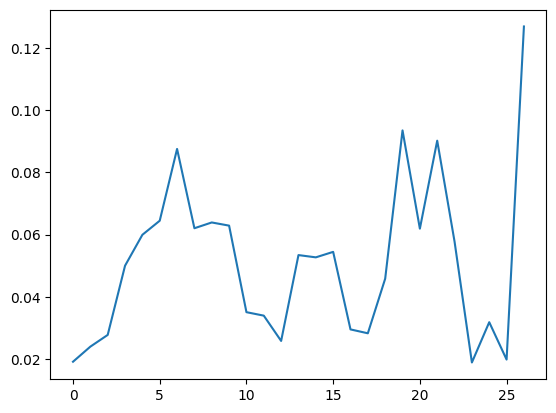

In [ ]:
plt.plot(l2_list)

In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/lbfgs_errors/L2_errors_lbfgs_27.npy


L2_errors_lbfgs_10.npy  L2_errors_lbfgs_17.npy  L2_errors_lbfgs_23.npy  L2_errors_lbfgs_4.npy
L2_errors_lbfgs_11.npy  L2_errors_lbfgs_18.npy  L2_errors_lbfgs_24.npy  L2_errors_lbfgs_5.npy
L2_errors_lbfgs_12.npy  L2_errors_lbfgs_19.npy  L2_errors_lbfgs_25.npy  L2_errors_lbfgs_6.npy
L2_errors_lbfgs_13.npy  L2_errors_lbfgs_1.npy   L2_errors_lbfgs_26.npy  L2_errors_lbfgs_7.npy
L2_errors_lbfgs_14.npy  L2_errors_lbfgs_20.npy  L2_errors_lbfgs_27.npy  L2_errors_lbfgs_8.npy
L2_errors_lbfgs_15.npy  L2_errors_lbfgs_21.npy  L2_errors_lbfgs_2.npy   L2_errors_lbfgs_9.npy
L2_errors_lbfgs_16.npy  L2_errors_lbfgs_22.npy  L2_errors_lbfgs_3.npy


In [ ]:
#11 ,  49

#L2_list=  [0.01907848 0.02393539 0.02770672 0.04998742 0.05994061 0.06446929
# 0.08758008 0.06205007 0.06390987 0.06288783 0.03502875 0.03391104
# 0.02576944 0.0534071  0.05267773 0.05444127 0.02947893 0.02822983
# 0.04580744]  at identifier:  42

#Plot t fixo

In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/100

In [ ]:
np.load("/content/data/L2_errors_5.npy")

array([ 5.02798033, 15.1514082 ,  4.52231789, 23.12783241,  6.98214817])

In [ ]:
pip install deepxde

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 179.8/179.8 kB 2.3 MB/s eta 0:00:00
     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 100.3/100.3 kB 8.8 MB/s eta 0:00:00


In [ ]:
import deepxde as dde
import matplotlib.pyplot as plt
import numpy as np
from scipy.interpolate import griddata
import scipy as sp
import numpy as np

In [ ]:
botton=5
upper=55

In [ ]:
sampler = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42)
sampler2 = sp.stats.qmc.Sobol(d=1,scramble=False, seed=42**2)
n_rand=256
sample = sampler.random(n_rand)
sample2 = sampler2.random(n_rand)
#print(sample)
#sample.sort
#print(np.array(sample))
#boundary condition sample:
x1 = np.vstack(np.ones(int(n_rand/2))*5)
x1 =np.concatenate((x1,np.vstack(np.ones(int(n_rand/2))*(-5))))#array de tamanho n_rand, com metade dos pontos no limite inferior, e metade no limite superior de x
m= (sample2*(upper-botton)+botton)/100#m entre (upper/100,botton/100)
t0 = sample*2

X_anchors=np.concatenate((x1,m,t0), axis=1)



timedomain = dde.geometry.TimeDomain(0, 2)
geom = dde.geometry.Rectangle([-5, botton/100], [5, upper/100])

geomtime = dde.geometry.GeometryXTime(geom, timedomain)



# Define sine function
if dde.backend.backend_name in ["tensorflow.compat.v1", "tensorflow"]:
    from deepxde.backend import tf

    cos = tf.cos
    sin = tf.sin
elif dde.backend.backend_name == "paddle":
    import paddle

    cos = paddle.cos
    sin = paddle.sin


def pde(x, y):
    alpha = -1
    v=0.65

    dy_tt = dde.grad.hessian(y, x, i=2, j=2)
    dy_xx = dde.grad.hessian(y, x, i=0, j=0)
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    return (
        dy_tt
        + alpha * dy_xx
        + m**2*sin(y)
    )

def func(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]

    v = 0.65
    gamma = np.sqrt(1/(1-v**2))
    delt=0


    return 4* np.arctan(np.exp(m*gamma*(x-v*t)+ delt))
    #return x[:, 0:1] * np.cos(x[:, 1:2])

def deriv(x):
    x, m, t = x[:, 0:1], x[:, 1:2], x[:, 2:3]
    v = 0.65
    gamma = tf.sqrt(1/(1-v**2))
    delt=0

    return (-1)*(4*(tf.exp((-t*v+x)*m*gamma)*m*v*gamma)/(1+tf.exp(2*m*(-t*v+x)*gamma)))


def boundary(x,_):
    return np.isclose(x[2],0)

def boundary_up(x,_):
    return np.isclose(x[0],5.0)
def boundary_down(x,_):
    return np.isclose(x[0],-5.0)


bc_up = dde.icbc.DirichletBC(geomtime, func, boundary_up)
bc_down = dde.icbc.DirichletBC(geomtime, func, boundary_down)
#ic_1 = dde.icbc.IC(geomtime, func, lambda _, on_initial: on_initial)
ic_1 = dde.icbc.IC(geomtime, func, boundary)
ic_2 = dde.icbc.OperatorBC(
    geomtime,
    lambda x, y, _: dde.grad.jacobian(y, x, i=0, j=2) - deriv(x),
    boundary,
)

data = dde.data.TimePDE(
    geomtime,
    pde,
    [ic_1, bc_up, bc_down],#[bc, ic_1, ic_2]
    num_domain=2000,
    num_boundary=0,
    num_initial=128,
    solution=func,
    num_test=None,
    anchors=X_anchors
)

layer_size = [3] + [200] * 6 + [1]
activation = "tanh"
initializer = "Glorot uniform"
net = dde.nn.FNN(layer_size, activation, initializer)

model = dde.Model(data, net)

model.compile("adam", lr=0.001)
#losshistory, train_state = model.train(iterations=10, model_restore_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/21/model.ckpt-20000.ckpt")

Compiling model...
Building feed-forward neural network...


/usr/local/lib/python3.10/dist-packages/deepxde/nn/tensorflow_compat_v1/fnn.py:116: UserWarning: `tf.layers.dense` is deprecated and will be removed in a future version. Please use `tf.keras.layers.Dense` instead.
  return tf.layers.dense(


'build' took 0.412736 s

'compile' took 4.579875 s



In [ ]:
losshistory, train_state = model.train(iterations=100)#, model_restore_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/21/model.ckpt-20000.ckpt")

In [ ]:
mkdir /content/tmp

In [ ]:
model.restore('/content/tmp/modeltest.ckpt-10.ckpt')

NotFoundError: Restoring from checkpoint failed. This is most likely due to a Variable name or other graph key that is missing from the checkpoint. Please ensure that you have not altered the graph expected based on the checkpoint. Original error:

Graph execution error:

Detected at node 'save_5/RestoreV2' defined at (most recent call last):
    File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main
    File "/usr/lib/python3.10/runpy.py", line 86, in _run_code
    File "/usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py", line 37, in <module>
    File "/usr/local/lib/python3.10/dist-packages/traitlets/config/application.py", line 992, in launch_instance
    File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelapp.py", line 619, in start
    File "/usr/local/lib/python3.10/dist-packages/tornado/platform/asyncio.py", line 195, in start
    File "/usr/lib/python3.10/asyncio/base_events.py", line 603, in run_forever
    File "/usr/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once
    File "/usr/lib/python3.10/asyncio/events.py", line 80, in _run
    File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 685, in <lambda>
    File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 738, in _run_callback
    File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 825, in inner
    File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 786, in run
    File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 361, in process_one
    File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper
    File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 261, in dispatch_shell
    File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper
    File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 539, in execute_request
    File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper
    File "/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py", line 302, in do_execute
    File "/usr/local/lib/python3.10/dist-packages/ipykernel/zmqshell.py", line 539, in run_cell
    File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2975, in run_cell
    File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3030, in _run_cell
    File "/usr/local/lib/python3.10/dist-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner
    File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3257, in run_cell_async
    File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3473, in run_ast_nodes
    File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
    File "<ipython-input-30-436ea9fbc7b5>", line 110, in <cell line: 110>
    File "/usr/local/lib/python3.10/dist-packages/deepxde/utils/internal.py", line 22, in wrapper
    File "/usr/local/lib/python3.10/dist-packages/deepxde/model.py", line 137, in compile
    File "/usr/local/lib/python3.10/dist-packages/deepxde/model.py", line 168, in _compile_tensorflow_compat_v1
Node: 'save_5/RestoreV2'
Key beta1_power_3 not found in checkpoint
	 [[{{node save_5/RestoreV2}}]]

Original stack trace for 'save_5/RestoreV2':
  File "/usr/lib/python3.10/runpy.py", line 196, in _run_module_as_main
  File "/usr/lib/python3.10/runpy.py", line 86, in _run_code
  File "/usr/local/lib/python3.10/dist-packages/colab_kernel_launcher.py", line 37, in <module>
  File "/usr/local/lib/python3.10/dist-packages/traitlets/config/application.py", line 992, in launch_instance
  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelapp.py", line 619, in start
  File "/usr/local/lib/python3.10/dist-packages/tornado/platform/asyncio.py", line 195, in start
  File "/usr/lib/python3.10/asyncio/base_events.py", line 603, in run_forever
  File "/usr/lib/python3.10/asyncio/base_events.py", line 1909, in _run_once
  File "/usr/lib/python3.10/asyncio/events.py", line 80, in _run
  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 685, in <lambda>
  File "/usr/local/lib/python3.10/dist-packages/tornado/ioloop.py", line 738, in _run_callback
  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 825, in inner
  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 786, in run
  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 361, in process_one
  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper
  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 261, in dispatch_shell
  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper
  File "/usr/local/lib/python3.10/dist-packages/ipykernel/kernelbase.py", line 539, in execute_request
  File "/usr/local/lib/python3.10/dist-packages/tornado/gen.py", line 234, in wrapper
  File "/usr/local/lib/python3.10/dist-packages/ipykernel/ipkernel.py", line 302, in do_execute
  File "/usr/local/lib/python3.10/dist-packages/ipykernel/zmqshell.py", line 539, in run_cell
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 2975, in run_cell
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3030, in _run_cell
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/async_helpers.py", line 78, in _pseudo_sync_runner
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3257, in run_cell_async
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3473, in run_ast_nodes
  File "/usr/local/lib/python3.10/dist-packages/IPython/core/interactiveshell.py", line 3553, in run_code
  File "<ipython-input-30-436ea9fbc7b5>", line 110, in <cell line: 110>
  File "/usr/local/lib/python3.10/dist-packages/deepxde/utils/internal.py", line 22, in wrapper
  File "/usr/local/lib/python3.10/dist-packages/deepxde/model.py", line 137, in compile
  File "/usr/local/lib/python3.10/dist-packages/deepxde/model.py", line 168, in _compile_tensorflow_compat_v1
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/training/saver.py", line 934, in __init__
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/training/saver.py", line 946, in build
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/training/saver.py", line 974, in _build
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/training/saver.py", line 543, in _build_internal
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/training/saver.py", line 360, in _AddRestoreOps
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/training/saver.py", line 611, in bulk_restore
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/ops/gen_io_ops.py", line 1522, in restore_v2
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/framework/op_def_library.py", line 796, in _apply_op_helper
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/framework/ops.py", line 2652, in _create_op_internal
  File "/usr/local/lib/python3.10/dist-packages/tensorflow/python/framework/ops.py", line 1160, in from_node_def


In [ ]:
model.save("/content/tmp/modeltest.ckpt")

'/content/tmp/modeltest.ckpt-10.ckpt'

In [ ]:
ls /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/21/

checkpoint                                 model.ckpt-20000.ckpt.index
model.ckpt-20000.ckpt.data-00000-of-00001  model.ckpt-20000.ckpt.meta


In [ ]:
!cat /content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/21/checkpoint

model_checkpoint_path: "/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/21/model.ckpt-20000.ckpt"
all_model_checkpoint_paths: "/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/21/model.ckpt-20000.ckpt"


In [ ]:
losshistory, train_state = model.train(epochs=10000)#, model_restore_path="/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/12/model.ckpt-20000.ckpt")
#model.restore("/content/drive/MyDrive/trained_models/sine-gordon_benchmark/variable/data/models/12/model.ckpt-20000.ckpt", verbose=1)

Training model...

Step      Train loss                                  Test loss                                   Test metric
0         [4.96e-04, 1.22e+01, 2.62e+01, 1.49e+00]    [4.96e-04, 1.22e+01, 2.62e+01, 1.49e+00]    []  
1000      [1.11e-03, 4.86e-03, 1.17e-04, 2.63e-04]    [1.11e-03, 4.86e-03, 1.17e-04, 2.63e-04]    []  
2000      [8.58e-04, 2.82e-03, 1.03e-05, 1.09e-04]    [8.58e-04, 2.82e-03, 1.03e-05, 1.09e-04]    []  
3000      [4.20e-04, 2.64e-03, 2.17e-03, 9.98e-04]    [4.20e-04, 2.64e-03, 2.17e-03, 9.98e-04]    []  
4000      [1.42e-04, 7.85e-04, 1.09e-03, 7.36e-05]    [1.42e-04, 7.85e-04, 1.09e-03, 7.36e-05]    []  
5000      [1.86e-04, 1.03e-02, 6.63e-03, 1.22e-02]    [1.86e-04, 1.03e-02, 6.63e-03, 1.22e-02]    []  
6000      [6.25e-05, 1.69e-04, 4.82e-06, 2.99e-05]    [6.25e-05, 1.69e-04, 4.82e-06, 2.99e-05]    []  
7000      [4.54e-05, 2.09e-04, 1.55e-04, 6.40e-05]    [4.54e-05, 2.09e-04, 1.55e-04, 6.40e-05]    []  
8000      [7.23e-04, 9.27e-04, 8.61e-05, 1.98e-

In [ ]:
#n foi usando um restore para o ponto ótimo do treinamento anterior
dde.optimizers.config.set_LBFGS_options(
    maxcor=50,
    ftol=1.0 * np.finfo(float).eps,
    gtol=1e-10,
    maxiter=2000,
    maxfun=10000,
    maxls=50,
)
model.compile("L-BFGS", metrics=["l2 relative error"])
!mkdir /content/drive/MyDrive/trained_models/why_not_working
!mkdir /content/drive/MyDrive/trained_models/why_not_working/1

losshistory, train_state = model.train(model_save_path="/content/drive/MyDrive/trained_models/why_not_working/1/testing-model")#model_save_path="/content/drive/MyDrive/trained_models_personal/Kdv_2s_seeded.ckpt-29000.ckpt-lbfgs.ckpt")
dde.saveplot(losshistory, train_state, issave=True, isplot=True)

Compiling model...
'compile' took 0.668520 s

Training model...

Step      Train loss                                  Test loss                                   Test metric   
12157     [2.28e-07, 1.01e-07, 6.85e-09, 2.04e-09]    [2.28e-07, 1.01e-07, 6.85e-09, 2.04e-09]    [4.49e-03]    
12411     [1.93e-07, 7.99e-08, 5.68e-09, 2.29e-09]    [1.93e-07, 7.99e-08, 5.68e-09, 2.29e-09]    [4.49e-03]    

Best model at step 12411:
  train loss: 2.81e-07
  test loss: 2.81e-07
  test metric: [4.49e-03]

Epoch 12411: saving model to /content/drive/MyDrive/trained_models/why_not_working/1/testing-model-12411.ckpt ...

'train' took 43.889467 s

Saving loss history to /content/loss.dat ...


ValueError: setting an array element with a sequence. The requested array has an inhomogeneous shape after 1 dimensions. The detected shape was (17,) + inhomogeneous part.

In [ ]:
model.restore("/content/drive/MyDrive/trained_models/why_not_working/1/testing-model-12411.ckpt")

In [ ]:
L2 = dde.metrics.mean_l2_relative_error(model.predict(geomtime.uniform_points(65536, boundary=True)), func(geomtime.uniform_points(65536, boundary=True)))
print("L2: ",L2,"at variation: ",botton, ", ",upper,"\n")

L2:  0.0071322387 at variation:  5 ,  55 



In [ ]:
import matplotlib


 m =  0.05 

 ####################################################


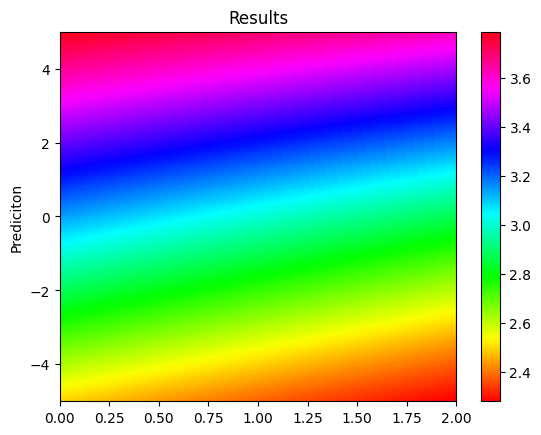

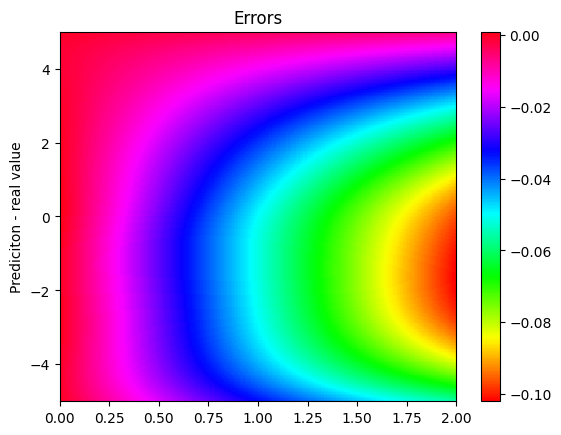


 m =  0.175 

 ####################################################


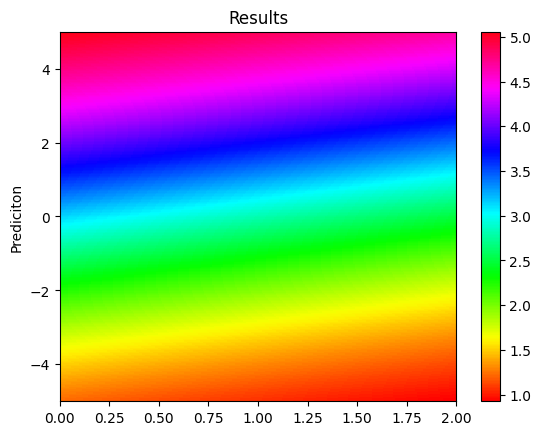

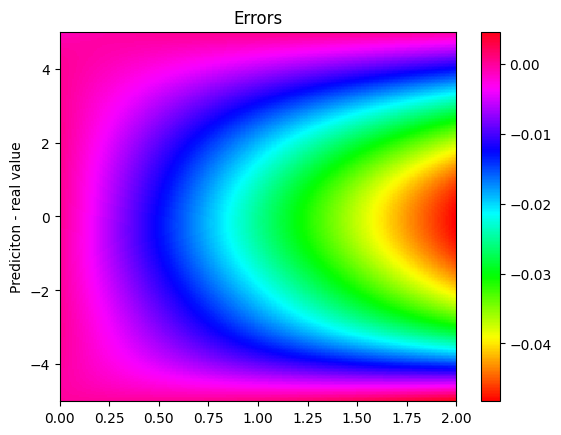


 m =  0.3 

 ####################################################


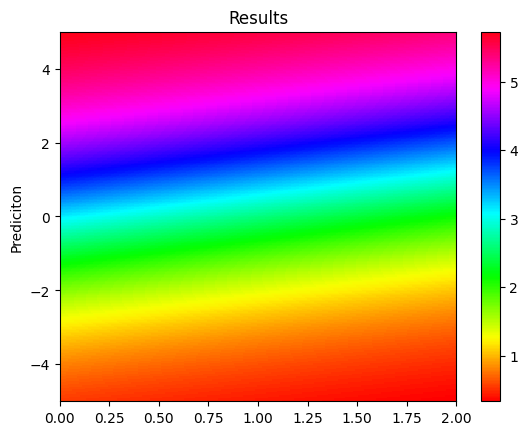

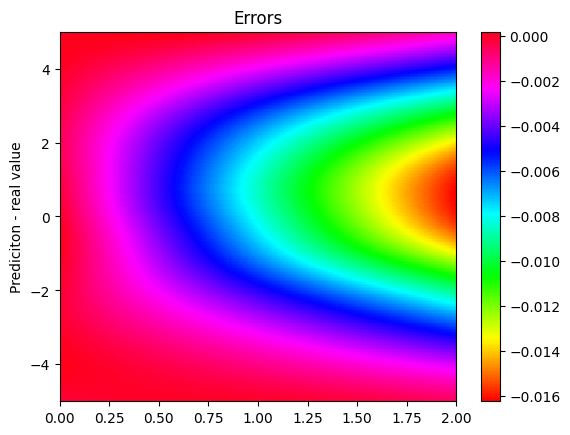


 m =  0.425 

 ####################################################


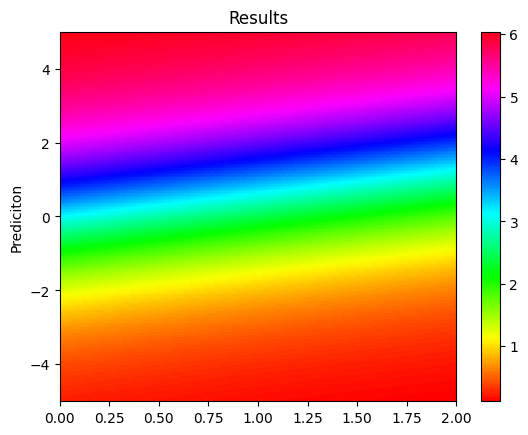

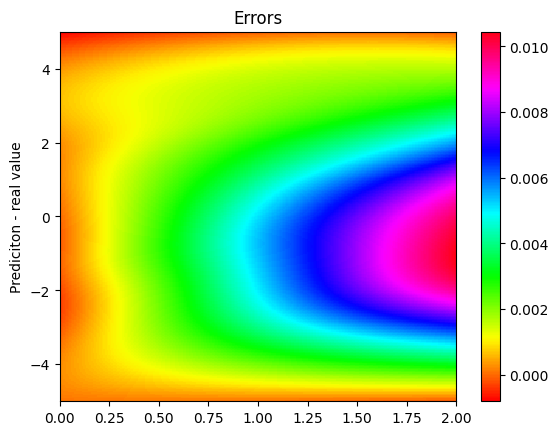


 m =  0.55 

 ####################################################


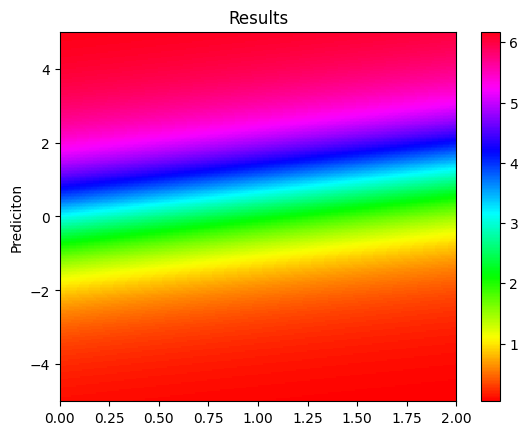

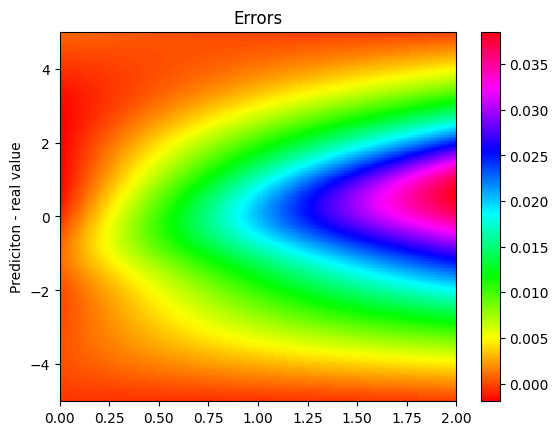

In [ ]:
for i in np.linspace(botton/100,upper/100, 5):
    print("\n m = ",i,"\n\n ####################################################")
    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    m= np.ones(65536)*i
    #m=m.reshape(-1,1)
    m=np.vstack(m)

    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    x1,t1=np.split(X_star, 2, axis=1)
    X_star_m= np.concatenate((x1,m,t1), axis=1)

    prediction = model.predict(X_star_m, operator=None)

    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Results")
    ax.set_ylabel("Prediciton")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

    x = np.linspace(-5, 5, 256)
    t = np.linspace(0, 2, 256)
    X, T = np.meshgrid(x, t)

    X_star = np.hstack((X.flatten()[:, None], T.flatten()[:, None]))
    prediction = model.predict(X_star_m, operator=None)
    real=func(X_star_m)
    prediction=prediction-real
    #prediction=np.sqrt(prediction*prediction)


    v = griddata(X_star, prediction[:, 0], (X, T), method="cubic")

    fig, ax = plt.subplots()
    ax.set_title("Errors")
    ax.set_ylabel("Prediciton - real value")
    ax.imshow(
        v.T,
        interpolation="nearest",
        cmap="hsv",
        extent=[0, 2, -5, 5],
        origin="lower",
        aspect="auto",
    )
    fig.colorbar(plt.cm.ScalarMappable(matplotlib.colors.Normalize(prediction.min(),prediction.max()), cmap="hsv"), ax=ax)
    plt.show()

In [ ]:
np.ones(256)*m_value

array([0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55,
       0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.55, 0.

In [ ]:
t

array([0.        , 0.00784314, 0.01568627, 0.02352941, 0.03137255,
       0.03921569, 0.04705882, 0.05490196, 0.0627451 , 0.07058824,
       0.07843137, 0.08627451, 0.09411765, 0.10196078, 0.10980392,
       0.11764706, 0.1254902 , 0.13333333, 0.14117647, 0.14901961,
       0.15686275, 0.16470588, 0.17254902, 0.18039216, 0.18823529,
       0.19607843, 0.20392157, 0.21176471, 0.21960784, 0.22745098,
       0.23529412, 0.24313725, 0.25098039, 0.25882353, 0.26666667,
       0.2745098 , 0.28235294, 0.29019608, 0.29803922, 0.30588235,
       0.31372549, 0.32156863, 0.32941176, 0.3372549 , 0.34509804,
       0.35294118, 0.36078431, 0.36862745, 0.37647059, 0.38431373,
       0.39215686, 0.4       , 0.40784314, 0.41568627, 0.42352941,
       0.43137255, 0.43921569, 0.44705882, 0.45490196, 0.4627451 ,
       0.47058824, 0.47843137, 0.48627451, 0.49411765, 0.50196078,
       0.50980392, 0.51764706, 0.5254902 , 0.53333333, 0.54117647,
       0.54901961, 0.55686275, 0.56470588, 0.57254902, 0.58039

In [ ]:
m_value=0.55
t_value=0.3
X_star_m[2][0]
X_star_2d=np.concatenate((np.vstack(x),np.vstack(np.ones(256)*m_value),np.vstack(np.ones(256)*t_value)),axis=1)

In [ ]:
np.shape(X_star_m)[0]

65536

In [ ]:
X_star_2d

array([[-5.        ,  0.55      ,  0.3       ],
       [-4.96078431,  0.55      ,  0.3       ],
       [-4.92156863,  0.55      ,  0.3       ],
       [-4.88235294,  0.55      ,  0.3       ],
       [-4.84313725,  0.55      ,  0.3       ],
       [-4.80392157,  0.55      ,  0.3       ],
       [-4.76470588,  0.55      ,  0.3       ],
       [-4.7254902 ,  0.55      ,  0.3       ],
       [-4.68627451,  0.55      ,  0.3       ],
       [-4.64705882,  0.55      ,  0.3       ],
       [-4.60784314,  0.55      ,  0.3       ],
       [-4.56862745,  0.55      ,  0.3       ],
       [-4.52941176,  0.55      ,  0.3       ],
       [-4.49019608,  0.55      ,  0.3       ],
       [-4.45098039,  0.55      ,  0.3       ],
       [-4.41176471,  0.55      ,  0.3       ],
       [-4.37254902,  0.55      ,  0.3       ],
       [-4.33333333,  0.55      ,  0.3       ],
       [-4.29411765,  0.55      ,  0.3       ],
       [-4.25490196,  0.55      ,  0.3       ],
       [-4.21568627,  0.55      ,  0.3  

In [ ]:
X_star_m[:,0:2]
fixed_time=0.2
t=np.vstack(np.ones(256)*fixed_time)

#np.concat

In [ ]:
X_star_m_new=np.concatenate((X_star_m[:,0:2],t),axis=1)

In [ ]:
X_star_m_new

array([[-5.        ,  0.55      ,  0.2       ],
       [-4.96078431,  0.55      ,  0.2       ],
       [-4.92156863,  0.55      ,  0.2       ],
       ...,
       [ 4.92156863,  0.55      ,  0.2       ],
       [ 4.96078431,  0.55      ,  0.2       ],
       [ 5.        ,  0.55      ,  0.2       ]])

In [ ]:
model.predict(X_star_m_new)

array([[-0.06168762],
       [-0.05451106],
       [-0.0472087 ],
       ...,
       [ 6.2968793 ],
       [ 6.304623  ],
       [ 6.312242  ]], dtype=float32)

In [ ]:
x=X_star_m[:,0]

In [ ]:
X_star_m_new

array([[-5.        ,  0.55      ,  0.2       ],
       [-4.96078431,  0.55      ,  0.2       ],
       [-4.92156863,  0.55      ,  0.2       ],
       ...,
       [ 4.92156863,  0.55      ,  0.2       ],
       [ 4.96078431,  0.55      ,  0.2       ],
       [ 5.        ,  0.55      ,  0.2       ]])

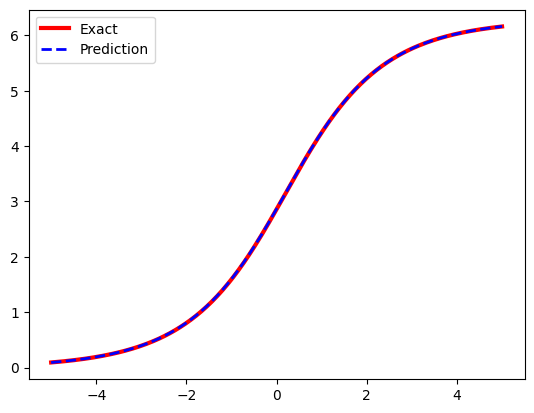

In [ ]:
fig, ax = plt.subplots()
ax.plot(x,func(X_star_2d), 'r-', linewidth = 3, label = 'Exact')
ax.plot(x,model.predict(X_star_2d), 'b--', linewidth = 2, label = 'Prediction')
ax.legend()
plt.show()

In [ ]:
X_star_m[:,]

array([0., 0., 0., ..., 2., 2., 2.])